<div id="container" style="position:relative;">
<div style="float:left"><h1> Model 4 : Facebook Prophet - Weekly Forecast</h1></div>
<div style="position:relative; float:right"><img style="height:65px" src ="https://twomagpiesbakery.co.uk/wp-content/uploads/2020/11/logo-no-site.jpg" />
</div>
</div>

**Steps to calculate the baseline model for a weekly revenue forecast.**

**UPADTE**: Update into

**Evaluation**,
The models will then be evaluated by calculating the:
- Root Mean Sqaured Error (RMSE) -
- Mean Absolute Error (MAE), which calculates the average difference between the predicted values and actual values. 
- Mean Absolute Percentage Error (MAPE) value, which is the percentage of the average absolute values of error between the true revenue values and the predicted ones.

These were selected as the MAE provides a score of how accurate the model is (closer to 0) and the MAPE allows for comparison across models. 

The moving average model for each forecast with the lowest MAE and MAPE values will be selected as the baseline model. 

---

## Importing Libraries

In [1]:
# Main libraries 
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import math
import sklearn.metrics  
import itertools
import datetime as dt
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

from fbprophet import Prophet
from fbprophet.diagnostics import cross_validation
from fbprophet.diagnostics import performance_metrics
from fbprophet.plot import plot_plotly, plot_components_plotly
from fbprophet.plot import plot_cross_validation_metric
import plotly.express as px
import plotly.graph_objects as go
import os

from plotly.subplots import make_subplots
from pandas.tseries.offsets import DateOffset

## Importing Custom Functions

In [2]:
import BakeryFunctions as bakery

## To Get Current Directory

In [3]:
working_directory = os.getcwd()
working_directory

'/Users/abimagnall/Documents/BrainStation/Capstone/Data'

## Importing Preprocessed Dataset

In [4]:
# Importing the dataset
total_rev = pd.read_csv(working_directory+'/5_timeseries_data/total_revenue.csv', index_col=0)
# Converting the index to a datetime index 
total_rev.index = pd.to_datetime(total_rev.index)
# To drop redundant cols
total_rev.drop(columns=['Day', 'TAVG', 'PRCP', 'CPI_Electricity', 'CPI_Food'],inplace=True)
# To validate it imported correctly 
display(total_rev.head())

,Total_Revenue
2020-09-01,9780.76
2020-09-02,10037.55
2020-09-03,9419.30
2020-09-04,10606.15
2020-09-05,12922.00


In [5]:
# Importing the holidays dataset
holidays = pd.read_csv(working_directory+'/5_timeseries_data/school_holidays_fb.csv', index_col=1)
# Converting the index to a datetime index 
holidays.index = pd.to_datetime(holidays.index)
holidays.head()

,School Holiday
Date,
2020-10-24,School Holiday
2020-10-25,School Holiday
2020-10-26,School Holiday
2020-10-27,School Holiday
2020-10-28,School Holiday


First, Prophet expects the data to be in a specific format: a dataframe with two columns, `ds` and `y` for the dates and observations.

# Weekly Revenue Forecast
First the data is split into train and test sets as determined by the business, which is to predict the next 6 weeks of revenue.

*Therefore, anything on or before the date 2022-08-19 is the train dataset and on or post is test dataset.*


In [6]:
# Copy of the data is taken for audit trail purposes
prophet_full_weekly = total_rev.resample('W').sum().round(2).copy()
# Train dataset created 
prophet_full_weekly = prophet_full_weekly.reset_index()
# Columns are renamed to ds and y
prophet_full_weekly.rename(columns={'index': 'ds', 'Total_Revenue': 'y'}, inplace=True)
# To remove the last week which isn't a complete week
prophet_full_weekly = prophet_full_weekly[:-1]
# To validate it is in the correct format
prophet_full_weekly.tail()

,ds,y
103,2022-08-28,118277.59
104,2022-09-04,103478.40
105,2022-09-11,78442.65
106,2022-09-18,86436.14
107,2022-09-25,84465.60


In [7]:
# Train dataset created 
prophet_train_weekly = prophet_full_weekly.loc[prophet_full_weekly.ds <= '2022-08-19']
# To validate it is in the correct format
prophet_train_weekly.tail()

,ds,y
97,2022-07-17,90259.78
98,2022-07-24,98332.00
99,2022-07-31,112021.47
100,2022-08-07,109098.80
101,2022-08-14,106518.19


In [8]:
# Test dataset created 
prophet_test_weekly = prophet_full_weekly.loc[prophet_full_weekly.ds > '2022-08-19']
# To validate it is in the correct format
prophet_test_weekly.head(6)

,ds,y
102,2022-08-21,113387.44
103,2022-08-28,118277.59
104,2022-09-04,103478.40
105,2022-09-11,78442.65
106,2022-09-18,86436.14
107,2022-09-25,84465.60


## Baseline Forecast

In [9]:
model_weekly = Prophet(yearly_seasonality=True, weekly_seasonality=True)
model_weekly.fit(prophet_train_weekly)

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Initial log joint probability = -4.89948


    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       214.627   2.78061e-06       84.3641           1           1      136   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     175       214.869   5.84936e-09       64.5765      0.1733      0.1733      235   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance


In [10]:
future_weekly = model_weekly.make_future_dataframe(periods=6, freq='W', include_history=False)
future_weekly.head(6)

,ds
0,2022-08-21
1,2022-08-28
2,2022-09-04
3,2022-09-11
4,2022-09-18
5,2022-09-25


In [11]:
# Notice we need to provide a dataframe for the predict method, it must also contain a `ds` column
baseline_forecast_weekly = model_weekly.predict(future_weekly)
baseline_forecast_weekly[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()

,ds,yhat,yhat_lower,yhat_upper
1,2022-08-28,110967.887692,100367.311844,121558.632984
2,2022-09-04,105051.016283,94429.852066,115475.987212
3,2022-09-11,100212.514028,90584.280687,110649.943652
4,2022-09-18,95771.685891,85737.070165,105708.432412
5,2022-09-25,90513.408440,79793.595324,100706.730771


In [12]:
fig = plot_plotly(model_weekly, baseline_forecast_weekly) # returns a plotly Figure object
fig.show()

In [16]:
fig = go.Figure()

# Add actual vs forecasted revenue \n",
fig.add_trace(go.Scatter(x=prophet_full_weekly['ds'], y=prophet_full_weekly['y'], mode='lines', name='Train Revenue',
              line={'color' : bakery.light_magpie}))
fig.add_trace(go.Scatter(x=baseline_forecast_weekly['ds'], y=baseline_forecast_weekly['yhat'], mode='lines', 
                         name='Forecasted Revenue',
                         line={'dash': 'dash', 'color': bakery.red_magpie}))

fig.update_xaxes(rangeslider_visible=True)
fig.update_layout(
    yaxis_title='Revenue (£)', 
    xaxis_title='Date',
    legend_title='',
    title='Model 1 - Baseline Weekly Forecast')
# fig.write_image('fbblank.png', scale=2)
fig.show()

In [17]:
bakery.full_accuracy_report(prophet_test_weekly['y'], baseline_forecast_weekly['yhat'], 'weekly forecast')

The RMSE for the weekly forecast is: 10493.47

The MAE between the actual and weekly forecast revenue is 8117.21

The MAPE between the actual and weekly forecast revenue is 9.3%


In [15]:
# reults

## Hyperparameter Tuning
Next, to find the optimal parameters required for the model the **UPDATE** method is used. 

For this the parameters being tuned are: 
- `change_prior_scale` - t determines the flexibility of the trend, and in particular how much the trend changes at the trend changepoints. As described in this documentation, if it is too small, the trend will be underfit and variance that should have been modeled with trend changes will instead end up being handled with the noise term. If it is too large, the trend will overfit and in the most extreme case you can end up with the trend capturing yearly seasonality. 
- `seasonality_prior_scale` - This parameter controls the flexibility of the seasonality. A large value allows the seasonality to fit large fluctuations, a small value shrinks the magnitude of the seasonality.
- `seasonality_mode` - 

The parameters that produce the lowest RMSE then will be selected as the optimal parameters and run in the model. 

In [45]:
# The parameter grid is set up with the values being tested for each parameter 
param_grid = {  
    'changepoint_prior_scale': [0.001, 0.01, 0.1, 0.5],
    'seasonality_prior_scale': [0.01, 0.1, 1.0, 10.0],
    'seasonality_mode': ['additive', 'multiplicative']}

# The zip is used to generate all combinations of parameters
all_params = [dict(zip(param_grid.keys(), v)) for v in itertools.product(*param_grid.values())]

# Store the RMSEs for each params here
rmses = [] 
mdape = []


# Use cross validation to evaluate all parameters
for params in all_params:
    # Fit model with given params
    m = Prophet(**params, yearly_seasonality=True).fit(prophet_train_weekly)
    df_cv = cross_validation(m, horizon='42 days', parallel='processes')
    df_p = performance_metrics(df_cv, rolling_window=1)
    rmses.append(df_p['rmse'].values[0])
    mdape.append(df_p['mdape'].values[0])

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 15 forecasts with cutoffs between 2021-09-12 00:00:00 and 2022-07-03 00:00:00
INFO:fbprophet:Applying in parallel with <concurrent.futures.process.ProcessPoolExecutor object at 0x7fdf305c83a0>


Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
       1      -4.89948             0       104.566       1e-12       0.001       17   
Optimization terminated with error: 
  Line search failed to achieve a sufficient decrease, no more progress can be made

Initial log joint probability = 125.176
Iteration  1. Log joint probability =    72.5709. Improved by -52.6051.
Iteration  2. Log joint probability =    118.065. Improved by 45.4941.
Iteration  3. Log joint probability =    126.289. Improved by 8.22428.
Iteration  4. Log joint probability =    126.918. Improved by 0.629096.
Iteration  5. Log joint probability =    131.885. Improved by 4.96611.
Iteration  6. Log joint probability =    137.721. Improved by 5.83616.
Iteration  7. Log joint probability =    139.427. Improved by 1.70635.
Iteration  8. Log joint probability =    139.511. Improved by 0.0836416.
Iteration  9. Log joint probability =    139.5

Iteration  1. Log joint probability =     47.727. Improved by -111.514.
Iteration 28. Log joint probability =    84.1436. Improved by 4.49352e-06.
Iteration 29. Log joint probability =    84.1436. Improved by 2.00174e-07.
Iteration  3. Log joint probability =    64.7324. Improved by 9.41684.
Iteration  2. Log joint probability =    72.1312. Improved by 24.4042.
Iteration  4. Log joint probability =    70.0177. Improved by 5.28534.
Iteration 30. Log joint probability =    84.1436. Improved by 2.05979e-06.
Iteration  5. Log joint probability =    71.3538. Improved by 1.33613.
Iteration  6. Log joint probability =    72.8806. Improved by 1.52675.

Initial log joint probability = 170.361
Iteration  7. Log joint probability =    77.1874. Improved by 4.3068.
Iteration  3. Log joint probability =    72.5121. Improved by 0.38092.
Iteration 31. Log joint probability =    84.1436. Improved by 6.79614e-07.
Iteration  8. Log joint probability =    77.3694. Improved by 0.182029.
Iteration 32. Log j

Iteration 43. Log joint probability =     77.751. Improved by 1.82948e-05.
Iteration 28. Log joint probability =    73.5403. Improved by 3.56286e-05.
Iteration 18. Log joint probability =    80.9966. Improved by 0.000159352.
Iteration 37. Log joint probability =     64.084. Improved by 0.00124687.
Iteration 29. Log joint probability =    73.5404. Improved by 1.30026e-05.
Iteration 26. Log joint probability =    68.9497. Improved by 0.00012408.
Iteration 44. Log joint probability =    77.7512. Improved by 0.000176206.
Iteration 38. Log joint probability =    64.0846. Improved by 0.000578017.
Iteration 39. Log joint probability =    64.0846. Improved by 3.50252e-06.
Iteration 19. Log joint probability =    80.9972. Improved by 0.000522961.
Iteration 27. Log joint probability =    68.9497. Improved by 9.21444e-06.
Iteration 28. Log joint probability =    68.9497. Improved by 1.46299e-06.
Iteration 40. Log joint probability =    64.0846. Improved by 5.31252e-05.
Iteration 30. Log joint pro

Iteration 72. Log joint probability =    64.0853. Improved by 1.77472e-06.
Iteration 57. Log joint probability =      68.95. Improved by 9.06836e-07.
Iteration 10. Log joint probability =    90.1808. Improved by 0.0117095.
Iteration 73. Log joint probability =    64.0853. Improved by 8.90615e-06.
Iteration 58. Log joint probability =      68.95. Improved by 2.13415e-06.
Iteration 74. Log joint probability =    64.0853. Improved by 1.9695e-06.
Iteration 59. Log joint probability =      68.95. Improved by 1.30566e-07.
Iteration 75. Log joint probability =    64.0853. Improved by 4.3416e-06.
Iteration 11. Log joint probability =    90.2204. Improved by 0.0395845.
Iteration 31. Log joint probability =    80.9979. Improved by 1.63248e-06.
Iteration 60. Log joint probability =      68.95. Improved by 5.93875e-08.
Iteration 61. Log joint probability =      68.95. Improved by 7.16413e-08.
Iteration 62. Log joint probability =      68.95. Improved by 1.41341e-07.
Iteration 63. Log joint probabi

Iteration 85. Log joint probability =    108.099. Improved by 1.67844e-06.
Iteration 27. Log joint probability =    129.933. Improved by 1.04454e-05.
Iteration 35. Log joint probability =    113.425. Improved by 6.10359e-07.
Iteration 86. Log joint probability =    108.099. Improved by 2.52147e-07.
Iteration 28. Log joint probability =    129.933. Improved by 2.10006e-05.
Iteration 87. Log joint probability =    108.099. Improved by 1.69326e-06.
Iteration 29. Log joint probability =    129.933. Improved by 3.791e-06.
Iteration 36. Log joint probability =    113.425. Improved by 1.16762e-06.
Iteration 30. Log joint probability =    129.933. Improved by 3.02761e-05.
Iteration 88. Log joint probability =    108.099. Improved by 2.3732e-07.
Iteration 31. Log joint probability =    129.933. Improved by 0.000667672.
Iteration 89. Log joint probability =    108.099. Improved by 1.70808e-06.
Iteration 37. Log joint probability =    113.425. Improved by 3.91165e-07.
Iteration 90. Log joint prob

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
       1      -4.89948             0       104.283       1e-12       0.001       17   
Optimization terminated with error: 
  Line search failed to achieve a sufficient decrease, no more progress can be made

Initial log joint probability = 125.176
Iteration  1. Log joint probability =     72.315. Improved by -52.8611.
Iteration  2. Log joint probability =    119.094. Improved by 46.7795.
Iteration  3. Log joint probability =    126.255. Improved by 7.16011.
Iteration  4. Log joint probability =    131.665. Improved by 5.41048.
Iteration  5. Log joint probability =    133.951. Improved by 2.28627.
Iteration  6. Log joint probability =     134.01. Improved by 0.0587026.
Iteration  7. Log joint probability =    134.027. Improved by 0.0167294.
Iteration  8. Log joint probability =    134.061. Improved by 0.0344116.
Iteration  9. Log joint probability =    13

rophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  componen


Initial log joint probability = 167.719
Iteration  1. Log joint probability =    37.9203. Improved by -129.799.

Initial log joint probability = 162.172
Iteration  2. Log joint probability =    54.7544. Improved by 16.8341.
Iteration  3. Log joint probability =    61.3205. Improved by 6.56611.
Iteration  1. Log joint probability =    44.2278. Improved by -117.945.
Iteration  4. Log joint probability =    62.4082. Improved by 1.08774.
Iteration  5. Log joint probability =    66.9856. Improved by 4.57741.
Iteration  6. Log joint probability =    67.1119. Improved by 0.126231.
Iteration  2. Log joint probability =    57.3891. Improved by 13.1613.

Initial log joint probability = 164.953
Iteration  7. Log joint probability =    67.1909. Improved by 0.0790489.
Iteration  8. Log joint probability =    67.2506. Improved by 0.0596889.
Iteration  9. Log joint probability =    67.2969. Improved by 0.0462919.
Iteration 10. Log joint probability =    67.3161. Improved by 0.0192193.
Iteration  1. 

Iteration 30. Log joint probability =    62.7333. Improved by 5.21477e-05.
Iteration 33. Log joint probability =    71.6216. Improved by 0.00464437.
Iteration 36. Log joint probability =     76.071. Improved by 9.9449e-07.
Iteration 20. Log joint probability =    85.6488. Improved by 0.000263639.
Iteration 31. Log joint probability =    62.7333. Improved by 1.48894e-05.
Iteration 34. Log joint probability =    71.6226. Improved by 0.00101982.
Iteration 32. Log joint probability =    62.7334. Improved by 1.75144e-05.
Iteration 51. Log joint probability =     67.392. Improved by 1.14016e-07.
Iteration 35. Log joint probability =    71.6247. Improved by 0.00213077.
Iteration 21. Log joint probability =    85.6493. Improved by 0.000448949.
Iteration  1. Log joint probability =    47.6298. Improved by -111.611.
Iteration 37. Log joint probability =     76.071. Improved by 4.31763e-07.
Iteration 52. Log joint probability =     67.392. Improved by 2.13478e-08.
Iteration 22. Log joint probabil

Iteration 11. Log joint probability =    81.9199. Improved by 0.000124709.
Iteration  7. Log joint probability =     87.439. Improved by 2.31517.
Iteration 11. Log joint probability =    78.7775. Improved by 0.0311866.
Iteration 12. Log joint probability =    81.9206. Improved by 0.000686606.
Iteration  8. Log joint probability =     87.475. Improved by 0.0359897.
Iteration 12. Log joint probability =    78.7902. Improved by 0.0127413.
Iteration 13. Log joint probability =    81.9427. Improved by 0.0221193.
Iteration 14. Log joint probability =    81.9498. Improved by 0.00702554.
Iteration  9. Log joint probability =    87.5431. Improved by 0.0681478.
Iteration 13. Log joint probability =     78.807. Improved by 0.0167132.
Iteration 15. Log joint probability =    81.9517. Improved by 0.00189498.
Iteration 14. Log joint probability =    78.8157. Improved by 0.00876316.
Iteration 10. Log joint probability =    87.5507. Improved by 0.00762293.
Iteration 16. Log joint probability =    81.9

Iteration 91. Log joint probability =    78.8309. Improved by 2.43329e-06.
Iteration  5. Log joint probability =    119.442. Improved by 4.78753.
Iteration 92. Log joint probability =    78.8309. Improved by 2.02415e-06.
Iteration  6. Log joint probability =    119.515. Improved by 0.0724833.
Iteration  7. Log joint probability =    119.534. Improved by 0.0190154.
Iteration 93. Log joint probability =    78.8309. Improved by 2.26874e-06.
Iteration  8. Log joint probability =    119.623. Improved by 0.089155.
Iteration 94. Log joint probability =    78.8309. Improved by 2.18862e-06.
Iteration  9. Log joint probability =    119.645. Improved by 0.0223649.
Iteration 10. Log joint probability =    119.651. Improved by 0.00597738.
Iteration 95. Log joint probability =     78.831. Improved by 2.1042e-06.
Iteration 11. Log joint probability =    119.667. Improved by 0.0152991.
Iteration 12. Log joint probability =    119.672. Improved by 0.00553369.
Iteration 13. Log joint probability =    11

Iteration 50. Log joint probability =    124.838. Improved by 0.000131887.
Iteration 51. Log joint probability =    124.838. Improved by 0.000150533.
Iteration 52. Log joint probability =    124.838. Improved by 0.000119974.
Iteration 53. Log joint probability =    124.838. Improved by 0.000162206.
Iteration 54. Log joint probability =    124.838. Improved by 0.000108062.
Iteration 55. Log joint probability =    124.838. Improved by 0.000173878.
Iteration 56. Log joint probability =    124.838. Improved by 9.61489e-05.
Iteration 57. Log joint probability =    124.839. Improved by 0.000185551.
Iteration 58. Log joint probability =    124.839. Improved by 8.42363e-05.
Iteration 59. Log joint probability =    124.839. Improved by 0.000197224.
Iteration 60. Log joint probability =    124.839. Improved by 7.23239e-05.
Iteration 61. Log joint probability =    124.839. Improved by 0.000208897.
Iteration 62. Log joint probability =    124.839. Improved by 6.04117e-05.
Iteration 63. Log joint p

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/sitINFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
e-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-pack

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
       1      -4.89948             0       104.566       1e-12       0.001       17   
Optimization terminated with error: 
  Line search failed to achieve a sufficient decrease, no more progress can be made

Initial log joint probability = 79.1244
Iteration  1. Log joint probability =    66.1098. Improved by -13.0145.
Iteration  2. Log joint probability =    148.578. Improved by 82.4678.
Iteration  3. Log joint probability =    193.568. Improved by 44.9902.
Iteration  4. Log joint probability =     193.67. Improved by 0.102027.
Iteration  5. Log joint probability =    202.643. Improved by 8.97346.
Iteration  6. Log joint probability =    205.917. Improved by 3.27358.
Iteration  7. Log joint probability =    208.241. Improved by 2.32413.
Iteration  8. Log joint probability =    208.524. Improved by 0.282639.
Iteration  9. Log joint probability =    209.17

INFO:fbprophet:Applying in parallel with <concurrent.futures.process.ProcessPoolExecutor object at 0x7fdf2669f4f0>



Initial log joint probability = 124.31
Iteration  1. Log joint probability =    42.7015. Improved by -81.6082.

Initial log joint probability = 118.902
Iteration  2. Log joint probability =    70.6609. Improved by 27.9595.
Iteration  3. Log joint probability =    107.542. Improved by 36.8814.
Iteration  1. Log joint probability =    49.2198. Improved by -69.682.

Initial log joint probability = 121.667
Iteration  4. Log joint probability =    129.335. Improved by 21.7924.
Iteration  2. Log joint probability =    85.2571. Improved by 36.0373.
Iteration  5. Log joint probability =    135.974. Improved by 6.63901.
Iteration  1. Log joint probability =    45.7547. Improved by -75.9126.
Iteration  6. Log joint probability =    137.684. Improved by 1.71068.
Iteration  7. Log joint probability =    142.282. Improved by 4.59744.
Iteration  3. Log joint probability =    105.385. Improved by 20.1283.

Initial log joint probability = 116.121
Iteration  8. Log joint probability =    142.368. Impr

Iteration 45. Log joint probability =    142.676. Improved by 2.59684e-06.
Iteration 17. Log joint probability =    165.686. Improved by 0.0250019.
Iteration 32. Log joint probability =    160.417. Improved by 6.58292e-07.
Iteration 46. Log joint probability =    142.676. Improved by 1.21733e-06.
Iteration 18. Log joint probability =    165.692. Improved by 0.00567035.
Iteration 33. Log joint probability =    160.417. Improved by 5.25972e-06.
Iteration 29. Log joint probability =    151.779. Improved by 6.28478e-05.

Initial log joint probability = 104.614
Iteration  5. Log joint probability =    166.862. Improved by 0.135356.
Iteration 47. Log joint probability =    142.676. Improved by 2.62068e-06.
Iteration 34. Log joint probability =    160.417. Improved by 2.36695e-06.
Iteration  3. Log joint probability =    157.611. Improved by 40.1693.
Iteration  1. Log joint probability =    63.9121. Improved by -43.7.
Iteration 19. Log joint probability =    165.714. Improved by 0.0222929.
It

Iteration 11. Log joint probability =    169.006. Improved by 0.876487.
Iteration 13. Log joint probability =    167.018. Improved by 0.00328463.
Iteration 37. Log joint probability =    165.999. Improved by 0.0948531.
Iteration  9. Log joint probability =    164.949. Improved by 0.0190671.
Iteration 69. Log joint probability =    142.676. Improved by 2.88288e-06.
Iteration 12. Log joint probability =    169.968. Improved by 0.961578.
Iteration 51. Log joint probability =    151.779. Improved by 1.5845e-06.
Iteration 38. Log joint probability =    166.028. Improved by 0.0297756.
Iteration 19. Log joint probability =    174.346. Improved by 0.000142661.
Iteration 52. Log joint probability =    151.779. Improved by 1.10312e-06.
Iteration 20. Log joint probability =    174.346. Improved by 0.000211605.
Iteration 53. Log joint probability =    151.779. Improved by 1.58888e-06.
Iteration 39. Log joint probability =    166.048. Improved by 0.0192816.
Iteration 70. Log joint probability =    

Iteration 78. Log joint probability =    151.779. Improved by 9.83107e-07.
Iteration 41. Log joint probability =    174.346. Improved by 2.74386e-06.
Iteration 65. Log joint probability =    166.068. Improved by 6.30101e-05.
Iteration 23. Log joint probability =    167.047. Improved by 0.00242438.
Iteration 96. Log joint probability =    142.676. Improved by 6.2014e-07.
Iteration 34. Log joint probability =    171.106. Improved by 0.0160212.
Iteration 66. Log joint probability =    166.068. Improved by 1.64082e-06.
Iteration 42. Log joint probability =    174.346. Improved by 2.0154e-05.
Iteration 97. Log joint probability =    142.676. Improved by 3.21659e-06.
Iteration 79. Log joint probability =    151.779. Improved by 1.71509e-06.
Iteration 23. Log joint probability =    164.968. Improved by 5.70553e-06.
Iteration 80. Log joint probability =    151.779. Improved by 9.70192e-07.
Iteration 67. Log joint probability =    166.068. Improved by 6.29225e-05.
Iteration 98. Log joint probab

Iteration 94. Log joint probability =    166.069. Improved by 7.55687e-06.
Iteration 128. Log joint probability =    142.676. Improved by 2.37938e-07.
Iteration 110. Log joint probability =     151.78. Improved by 7.76467e-07.
Iteration 68. Log joint probability =    174.347. Improved by 2.45654e-06.
Iteration 59. Log joint probability =    171.294. Improved by 0.000185244.
Iteration 38. Log joint probability =    164.968. Improved by 5.38471e-08.
Iteration 34. Log joint probability =    167.079. Improved by 0.00397363.
Iteration 69. Log joint probability =    174.347. Improved by 3.4054e-07.
Iteration 95. Log joint probability =    166.069. Improved by 5.71972e-05.
Iteration 60. Log joint probability =    171.299. Improved by 0.00460253.
Iteration 111. Log joint probability =     151.78. Improved by 1.92145e-06.
Iteration 96. Log joint probability =    166.069. Improved by 7.27977e-06.
Iteration 112. Log joint probability =     151.78. Improved by 7.63552e-07.
Iteration 129. Log joint

Iteration 169. Log joint probability =     151.78. Improved by 2.29546e-06.
Iteration 153. Log joint probability =    166.071. Improved by 5.98356e-05.
Iteration 108. Log joint probability =    171.327. Improved by 7.60484e-05.
Iteration 170. Log joint probability =     151.78. Improved by 3.89017e-07.
Iteration 154. Log joint probability =    166.071. Improved by 4.41725e-06.
Iteration 171. Log joint probability =     151.78. Improved by 2.30138e-06.
Iteration  9. Log joint probability =    175.377. Improved by 0.0778144.
Iteration 172. Log joint probability =     151.78. Improved by 3.90105e-07.
Iteration 109. Log joint probability =    171.327. Improved by 6.34864e-05.
Iteration 10. Log joint probability =    175.435. Improved by 0.0582383.
Iteration 57. Log joint probability =    167.139. Improved by 0.00131684.
Iteration 173. Log joint probability =     151.78. Improved by 2.29915e-06.
Iteration 155. Log joint probability =    166.071. Improved by 5.97127e-05.
Iteration 110. Log j

Iteration 78. Log joint probability =     167.19. Improved by 0.00278321.
Iteration 42. Log joint probability =    175.513. Improved by 2.24973e-08.
Iteration 215. Log joint probability =    166.073. Improved by 5.11294e-05.
Iteration 156. Log joint probability =    171.329. Improved by 2.95775e-06.
Iteration 235. Log joint probability =     151.78. Improved by 2.19634e-06.
Iteration 216. Log joint probability =    166.073. Improved by 1.29306e-05.
Iteration 43. Log joint probability =    175.513. Improved by 2.96137e-08.
Iteration  4. Log joint probability =    172.901. Improved by 22.6509.
Iteration 236. Log joint probability =     151.78. Improved by 4.95655e-07.
Iteration 217. Log joint probability =    166.073. Improved by 5.05071e-05.
Iteration 157. Log joint probability =    171.329. Improved by 1.32907e-06.
Iteration 237. Log joint probability =     151.78. Improved by 2.19302e-06.
Iteration 79. Log joint probability =    167.192. Improved by 0.00186613.
Iteration 158. Log join

Iteration 301. Log joint probability =     151.78. Improved by 1.77609e-06.
Iteration 209. Log joint probability =    171.329. Improved by 6.69025e-07.
Iteration 29. Log joint probability =    183.849. Improved by 4.12711e-05.
Iteration 24. Log joint probability =    194.702. Improved by 5.04743e-06.
Iteration 210. Log joint probability =    171.329. Improved by 4.05754e-07.
Iteration 280. Log joint probability =    166.075. Improved by 5.4482e-05.
Iteration 302. Log joint probability =     151.78. Improved by 9.21677e-07.
Iteration 281. Log joint probability =    166.075. Improved by 7.97444e-06.
Iteration 303. Log joint probability =     151.78. Improved by 1.76003e-06.
Iteration 211. Log joint probability =    171.329. Improved by 7.1343e-07.
Iteration 103. Log joint probability =    167.244. Improved by 0.00200176.
Iteration 282. Log joint probability =    166.075. Improved by 5.61451e-05.
Iteration 25. Log joint probability =    194.702. Improved by 2.61468e-06.
Iteration 30. Log 

Iteration 44. Log joint probability =    194.702. Improved by 2.55149e-07.
Iteration 113. Log joint probability =    167.264. Improved by 0.00165483.
Iteration 232. Log joint probability =    171.329. Improved by 2.13593e-07.
Iteration 331. Log joint probability =     151.78. Improved by 1.5352e-06.
Iteration 45. Log joint probability =    194.702. Improved by 1.01314e-06.
Iteration 233. Log joint probability =    171.329. Improved by 6.06178e-08.
Iteration 41. Log joint probability =    183.849. Improved by 5.83753e-08.
Iteration 332. Log joint probability =     151.78. Improved by 1.1623e-06.
Iteration 114. Log joint probability =    167.266. Improved by 0.0023372.
Iteration 333. Log joint probability =     151.78. Improved by 1.51914e-06.
Iteration 46. Log joint probability =    194.702. Improved by 2.13748e-07.
Iteration 234. Log joint probability =    171.329. Improved by 2.13655e-07.
Iteration 47. Log joint probability =    194.702. Improved by 4.96915e-07.
Iteration 235. Log joi

Iteration 29. Log joint probability =    196.801. Improved by 1.48345e-05.
Iteration 11. Log joint probability =    195.669. Improved by 0.0145049.
Iteration 438. Log joint probability =     151.78. Improved by 7.23719e-07.
Iteration  1. Log joint probability =    102.548. Improved by 16.7657.
Iteration 439. Log joint probability =     151.78. Improved by 1.96896e-06.
Iteration 157. Log joint probability =    167.344. Improved by 0.00175825.
Iteration 440. Log joint probability =     151.78. Improved by 7.15391e-07.
Iteration 30. Log joint probability =    196.801. Improved by 8.05259e-07.
Iteration 12. Log joint probability =    195.902. Improved by 0.233718.
Iteration 441. Log joint probability =     151.78. Improved by 1.97726e-06.
Iteration  2. Log joint probability =     157.79. Improved by 55.2418.
Iteration 158. Log joint probability =    167.345. Improved by 0.00151625.
Iteration 442. Log joint probability =     151.78. Improved by 7.07064e-07.
Iteration 443. Log joint probabil

Iteration 32. Log joint probability =    196.326. Improved by 0.0015007.
Iteration 500. Log joint probability =     151.78. Improved by 4.65563e-07.
Iteration 21. Log joint probability =    202.012. Improved by 0.000147379.
Iteration 181. Log joint probability =    167.382. Improved by 0.0027145.
Iteration 501. Log joint probability =     151.78. Improved by 2.22655e-06.
Iteration 33. Log joint probability =    196.337. Improved by 0.0105074.
Iteration 502. Log joint probability =     151.78. Improved by 4.57236e-07.
Iteration 22. Log joint probability =    202.012. Improved by 0.000106653.
Iteration 503. Log joint probability =     151.78. Improved by 2.23486e-06.
Iteration 182. Log joint probability =    167.382. Improved by 0.000227285.
Iteration 504. Log joint probability =     151.78. Improved by 4.48908e-07.
Iteration 34. Log joint probability =    196.339. Improved by 0.00169051.
Iteration 505. Log joint probability =     151.78. Improved by 2.24317e-06.
Iteration 506. Log joint

Iteration 565. Log joint probability =     151.78. Improved by 2.49246e-06.
Iteration 43. Log joint probability =    202.012. Improved by 4.44682e-07.
Iteration 566. Log joint probability =     151.78. Improved by 1.90754e-07.
Iteration 567. Log joint probability =     151.78. Improved by 2.50077e-06.
Iteration 207. Log joint probability =     167.41. Improved by 0.000159164.
Iteration 568. Log joint probability =     151.78. Improved by 1.82426e-07.
Iteration 56. Log joint probability =    196.467. Improved by 0.00598124.
Iteration 569. Log joint probability =     151.78. Improved by 2.50908e-06.
Iteration 44. Log joint probability =    202.012. Improved by 5.6867e-07.
Iteration 208. Log joint probability =     167.41. Improved by 0.000202031.
Iteration 570. Log joint probability =     151.78. Improved by 1.74098e-07.
Iteration 57. Log joint probability =    196.472. Improved by 0.00459486.
Iteration 571. Log joint probability =     151.78. Improved by 2.51739e-06.
Iteration 45. Log j

Iteration 638. Log joint probability =     151.78. Improved by 5.50271e-08.
Iteration 81. Log joint probability =    196.573. Improved by 0.00192081.
Iteration 67. Log joint probability =    202.012. Improved by 8.60766e-07.
Iteration 639. Log joint probability =     151.78. Improved by 2.63009e-06.
Iteration 236. Log joint probability =    167.415. Improved by 6.93631e-06.
Iteration 82. Log joint probability =    196.574. Improved by 0.000614827.
Iteration 68. Log joint probability =    202.012. Improved by 3.03617e-07.
Iteration 640. Log joint probability =     151.78. Improved by 5.82135e-08.
Iteration 237. Log joint probability =    167.415. Improved by 0.000355588.
Iteration 641. Log joint probability =     151.78. Improved by 2.62689e-06.
Iteration 83. Log joint probability =    196.576. Improved by 0.00192575.
Iteration 642. Log joint probability =     151.78. Improved by 6.13997e-08.
Iteration 643. Log joint probability =     151.78. Improved by 2.62369e-06.
Iteration 69. Log j

Iteration 108. Log joint probability =    196.606. Improved by 0.000757204.
Iteration 710. Log joint probability =     151.78. Improved by 5.13173e-08.
Iteration 711. Log joint probability =     151.78. Improved by 2.64577e-06.
Iteration 712. Log joint probability =     151.78. Improved by 2.92804e-08.
Iteration 265. Log joint probability =    167.419. Improved by 0.000152805.
Iteration 109. Log joint probability =    196.608. Improved by 0.00173409.
Iteration 713. Log joint probability =     151.78. Improved by 2.66779e-06.
Iteration 266. Log joint probability =    167.419. Improved by 8.1238e-05.
Iteration 714. Log joint probability =     151.78. Improved by 7.24327e-09.
Iteration 110. Log joint probability =    196.609. Improved by 0.000707055.
Iteration 267. Log joint probability =    167.419. Improved by 3.87498e-05.
Iteration 111. Log joint probability =    196.611. Improved by 0.00178.
Iteration 268. Log joint probability =    167.419. Improved by 1.3849e-05.
Iteration 112. Log 

Iteration 183. Log joint probability =    196.695. Improved by 0.00087538.
Iteration 184. Log joint probability =    196.697. Improved by 0.0014635.
Iteration 185. Log joint probability =    196.698. Improved by 0.000754704.
Iteration 186. Log joint probability =    196.699. Improved by 0.0015675.
Iteration 187. Log joint probability =      196.7. Improved by 0.000658182.
Iteration 188. Log joint probability =    196.701. Improved by 0.0016585.
Iteration 189. Log joint probability =    196.702. Improved by 0.000565021.
Iteration 190. Log joint probability =    196.704. Improved by 0.00174691.
Iteration 191. Log joint probability =    196.704. Improved by 0.00047187.
Iteration 192. Log joint probability =    196.706. Improved by 0.00183532.
Iteration 193. Log joint probability =    196.706. Improved by 0.0003644.
Iteration 194. Log joint probability =    196.708. Improved by 0.00195243.
Iteration 195. Log joint probability =    196.709. Improved by 0.000233176.
Iteration 196. Log joint 

Iteration 295. Log joint probability =    196.734. Improved by 0.000133423.
Iteration 296. Log joint probability =    196.734. Improved by 0.000151992.
Iteration 297. Log joint probability =    196.734. Improved by 4.32181e-05.
Iteration 298. Log joint probability =    196.734. Improved by 2.72972e-05.
Iteration 299. Log joint probability =    196.734. Improved by 4.00519e-05.
Iteration 300. Log joint probability =    196.734. Improved by 2.99998e-05.
Iteration 301. Log joint probability =    196.734. Improved by 3.80479e-05.
Iteration 302. Log joint probability =    196.734. Improved by 3.16791e-05.
Iteration 303. Log joint probability =    196.734. Improved by 3.67001e-05.
Iteration 304. Log joint probability =    196.734. Improved by 3.30224e-05.
Iteration 305. Log joint probability =    196.734. Improved by 3.53524e-05.
Iteration 306. Log joint probability =    196.734. Improved by 3.40457e-05.
Iteration 307. Log joint probability =    196.734. Improved by 3.46441e-05.
Iteration 30

Iteration 407. Log joint probability =    196.737. Improved by 2.3493e-05.
Iteration 408. Log joint probability =    196.737. Improved by 1.09299e-05.
Iteration 409. Log joint probability =    196.737. Improved by 2.3507e-05.
Iteration 410. Log joint probability =    196.737. Improved by 1.09148e-05.
Iteration 411. Log joint probability =    196.737. Improved by 2.3521e-05.
Iteration 412. Log joint probability =    196.737. Improved by 1.08997e-05.
Iteration 413. Log joint probability =    196.737. Improved by 2.35349e-05.
Iteration 414. Log joint probability =    196.737. Improved by 1.08846e-05.
Iteration 415. Log joint probability =    196.737. Improved by 2.35489e-05.
Iteration 416. Log joint probability =    196.737. Improved by 1.08695e-05.
Iteration 417. Log joint probability =    196.737. Improved by 2.35552e-05.
Iteration 418. Log joint probability =    196.737. Improved by 1.08208e-05.
Iteration 419. Log joint probability =    196.737. Improved by 2.33906e-05.
Iteration 420. 

Iteration 523. Log joint probability =    196.739. Improved by 1.97114e-06.
Iteration 524. Log joint probability =    196.739. Improved by 2.30979e-06.
Iteration 525. Log joint probability =    196.739. Improved by 2.00396e-06.
Iteration 526. Log joint probability =    196.739. Improved by 2.24874e-06.
Iteration 527. Log joint probability =    196.739. Improved by 2.09369e-06.
Iteration 528. Log joint probability =    196.739. Improved by 2.12381e-06.
Iteration 529. Log joint probability =    196.739. Improved by 2.25411e-06.
Iteration 530. Log joint probability =    196.739. Improved by 1.95634e-06.
Iteration 531. Log joint probability =    196.739. Improved by 2.42777e-06.
Iteration 532. Log joint probability =    196.739. Improved by 1.78267e-06.
Iteration 533. Log joint probability =    196.739. Improved by 2.60143e-06.
Iteration 534. Log joint probability =    196.739. Improved by 1.60899e-06.
Iteration 535. Log joint probability =    196.739. Improved by 2.72468e-06.
Iteration 53

Iteration 643. Log joint probability =    196.739. Improved by 1.19783e-07.
Iteration 644. Log joint probability =    196.739. Improved by 1.42618e-07.
Iteration 645. Log joint probability =    196.739. Improved by 1.29503e-07.
Iteration 646. Log joint probability =    196.739. Improved by 1.35301e-07.
Iteration 647. Log joint probability =    196.739. Improved by 1.36747e-07.
Iteration 648. Log joint probability =    196.739. Improved by 1.28265e-07.
Iteration 649. Log joint probability =    196.739. Improved by 1.43784e-07.
Iteration 650. Log joint probability =    196.739. Improved by 1.21229e-07.
Iteration 651. Log joint probability =    196.739. Improved by 1.5082e-07.
Iteration 652. Log joint probability =    196.739. Improved by 1.14193e-07.
Iteration 653. Log joint probability =    196.739. Improved by 1.57856e-07.
Iteration 654. Log joint probability =    196.739. Improved by 1.07157e-07.
Iteration 655. Log joint probability =    196.739. Improved by 1.64892e-07.
Iteration 656

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

INFO:fbprophet:Making 15 forecasts with cutoffs between 2021-09-12 00:00:00 and 2022-07-03 00:00:00
INFO:fbprophet:Applying in parallel with <concurrent.futures.process.ProcessPoolExecutor object at 0x7fdf305aebe0>


Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
       1      -4.89948             0       104.283       1e-12       0.001       17   
Optimization terminated with error: 
  Line search failed to achieve a sufficient decrease, no more progress can be made

Initial log joint probability = 79.1244
Iteration  1. Log joint probability =    80.7604. Improved by 1.63603.
Iteration  2. Log joint probability =     131.72. Improved by 50.9595.
Iteration  3. Log joint probability =    178.743. Improved by 47.0227.
Iteration  4. Log joint probability =     181.34. Improved by 2.59753.
Iteration  5. Log joint probability =    186.816. Improved by 5.47633.
Iteration  6. Log joint probability =    187.886. Improved by 1.06914.
Iteration  7. Log joint probability =    189.252. Improved by 1.36614.
Iteration  8. Log joint probability =    189.457. Improved by 0.205327.
Iteration  9. Log joint probability =    189.534.

Iteration 11. Log joint probability =    140.562. Improved by 0.0259609.
Iteration 13. Log joint probability =      149.1. Improved by 0.0130602.
Iteration  4. Log joint probability =    136.662. Improved by 3.65613.
Iteration  5. Log joint probability =    140.092. Improved by 3.43054.
Iteration 14. Log joint probability =    149.115. Improved by 0.0146111.
Iteration  5. Log joint probability =    148.381. Improved by 3.99042.
Iteration  2. Log joint probability =    106.558. Improved by 49.5308.
Iteration  6. Log joint probability =    141.778. Improved by 1.68604.
Iteration  9. Log joint probability =    157.387. Improved by 0.04697.
Iteration  7. Log joint probability =    149.992. Improved by 8.21326.
Iteration  8. Log joint probability =    131.074. Improved by 0.000538059.
Iteration 12. Log joint probability =    140.587. Improved by 0.0246558.
Iteration 15. Log joint probability =    149.123. Improved by 0.00845178.
Iteration  8. Log joint probability =    150.781. Improved by 

Iteration 24. Log joint probability =    149.918. Improved by 0.0759885.
Iteration 29. Log joint probability =     147.72. Improved by 2.99046e-06.
Iteration 46. Log joint probability =     151.15. Improved by 3.13392e-09.
Iteration 31. Log joint probability =    157.688. Improved by 1.83914e-06.
Iteration 35. Log joint probability =    149.134. Improved by 7.06007e-07.
Iteration 33. Log joint probability =     152.01. Improved by 0.00675099.
Iteration 25. Log joint probability =    149.931. Improved by 0.0133018.
Iteration 32. Log joint probability =    157.688. Improved by 8.42292e-06.
Iteration 30. Log joint probability =     147.72. Improved by 9.22082e-06.
Iteration 36. Log joint probability =    149.134. Improved by 4.44289e-07.
Iteration 31. Log joint probability =     147.72. Improved by 3.77586e-06.
Iteration 33. Log joint probability =    157.688. Improved by 1.22875e-06.
Iteration 34. Log joint probability =    152.012. Improved by 0.00194313.
Iteration 26. Log joint probabi

Iteration 69. Log joint probability =    152.122. Improved by 0.000702928.
Iteration 58. Log joint probability =    150.056. Improved by 2.59939e-06.
Iteration 70. Log joint probability =    152.123. Improved by 0.00124813.
Iteration 59. Log joint probability =    150.056. Improved by 2.85889e-06.
Iteration 60. Log joint probability =    150.056. Improved by 2.98387e-06.
Iteration 71. Log joint probability =    152.124. Improved by 0.000778611.
Iteration 61. Log joint probability =    150.056. Improved by 2.47432e-06.
Iteration 72. Log joint probability =    152.125. Improved by 0.00118075.
Iteration 62. Log joint probability =    150.056. Improved by 3.36835e-06.
Iteration 73. Log joint probability =    152.126. Improved by 0.000843557.

Initial log joint probability = 102.258
Iteration 63. Log joint probability =    150.056. Improved by 2.08975e-06.
Iteration 74. Log joint probability =    152.127. Improved by 0.00111163.

Initial log joint probability = 99.3914
Iteration 75. Log joi

Iteration 81. Log joint probability =    150.056. Improved by 1.91131e-06.
Iteration 29. Log joint probability =     152.65. Improved by 1.2e-06.
Iteration  1. Log joint probability =    84.4613. Improved by -4.09863.
Iteration 94. Log joint probability =    152.146. Improved by 0.000411047.
Iteration 22. Log joint probability =    159.546. Improved by 0.00251736.
Iteration  3. Log joint probability =    162.494. Improved by 50.7463.
Iteration 10. Log joint probability =    165.894. Improved by 1.94939.
Iteration 23. Log joint probability =    159.547. Improved by 0.000987683.
Iteration 30. Log joint probability =     152.65. Improved by 7.43542e-07.
Iteration 95. Log joint probability =    152.148. Improved by 0.00156963.
Iteration 24. Log joint probability =    159.547. Improved by 0.000181175.
Iteration 31. Log joint probability =     152.65. Improved by 4.29238e-06.
Iteration 82. Log joint probability =    150.056. Improved by 3.59498e-06.
Iteration  3. Log joint probability =    1

Iteration 23. Log joint probability =    175.101. Improved by 1.94257e-05.
Iteration 116. Log joint probability =    152.165. Improved by 0.00010235.
Iteration 34. Log joint probability =    177.386. Improved by 0.00115216.
Iteration 25. Log joint probability =    166.495. Improved by 0.000169778.
Iteration 35. Log joint probability =    177.388. Improved by 0.00149021.
Iteration 26. Log joint probability =    171.203. Improved by 1.68951e-05.
Iteration 24. Log joint probability =    175.101. Improved by 0.000141941.
Iteration 96. Log joint probability =    150.056. Improved by 2.68625e-06.
Iteration 36. Log joint probability =    177.389. Improved by 0.0010589.
Iteration 25. Log joint probability =    175.101. Improved by 1.60272e-05.
Iteration 26. Log joint probability =    166.496. Improved by 0.00127778.
Iteration 27. Log joint probability =    171.204. Improved by 0.00038198.
Iteration 117. Log joint probability =    152.166. Improved by 0.000873791.
Iteration 97. Log joint probab

Iteration 144. Log joint probability =    152.174. Improved by 0.000387558.
Iteration 119. Log joint probability =    150.056. Improved by 8.06076e-07.
Iteration 80. Log joint probability =    177.435. Improved by 0.000301951.
Iteration 81. Log joint probability =    177.436. Improved by 0.000950334.
Iteration 82. Log joint probability =    177.436. Improved by 0.000316134.
Iteration 120. Log joint probability =    150.056. Improved by 6.32092e-07.
Iteration 145. Log joint probability =    152.174. Improved by 8.93302e-05.
Iteration 146. Log joint probability =    152.175. Improved by 0.000379802.
Iteration 121. Log joint probability =    150.056. Improved by 3.75675e-07.
Iteration 83. Log joint probability =    177.437. Improved by 0.000935108.
Iteration 122. Log joint probability =    150.056. Improved by 5.91486e-08.
Iteration 84. Log joint probability =    177.438. Improved by 0.000330317.
Iteration 147. Log joint probability =    152.175. Improved by 9.8423e-05.
Iteration 85. Log 

Iteration 129. Log joint probability =    177.466. Improved by 0.000888355.
Iteration 30. Log joint probability =    183.951. Improved by 1.62388e-05.
Iteration 176. Log joint probability =    152.182. Improved by 0.00024902.
Iteration 130. Log joint probability =    177.466. Improved by 0.000343731.
Iteration 31. Log joint probability =    183.951. Improved by 8.13454e-05.
Iteration 131. Log joint probability =    177.467. Improved by 0.000889442.
Iteration 177. Log joint probability =    152.182. Improved by 0.000224342.
Iteration 32. Log joint probability =    183.951. Improved by 3.99707e-05.
Iteration 132. Log joint probability =    177.468. Improved by 0.000344374.
Iteration 33. Log joint probability =    183.951. Improved by 4.84861e-06.
Iteration 178. Log joint probability =    152.182. Improved by 0.000237423.
Iteration 133. Log joint probability =    177.469. Improved by 0.000881218.
Iteration 34. Log joint probability =    183.951. Improved by 4.83322e-06.
Iteration 179. Log

Iteration 218. Log joint probability =    152.192. Improved by 0.000109081.
Iteration 199. Log joint probability =    177.508. Improved by 0.000300821.
Iteration 200. Log joint probability =    177.509. Improved by 0.000902721.
Iteration 219. Log joint probability =    152.192. Improved by 0.000353357.
Iteration 201. Log joint probability =     177.51. Improved by 0.000287763.
Iteration 220. Log joint probability =    152.192. Improved by 0.000113706.
Iteration 202. Log joint probability =     177.51. Improved by 0.000918265.
Iteration 203. Log joint probability =    177.511. Improved by 0.000271225.
Iteration 221. Log joint probability =    152.192. Improved by 0.000345663.
Iteration 204. Log joint probability =    177.512. Improved by 0.000933809.
Iteration 205. Log joint probability =    177.512. Improved by 0.000252088.
Iteration 222. Log joint probability =    152.192. Improved by 0.000123978.
Iteration 206. Log joint probability =    177.513. Improved by 0.000954504.
Iteration 22

Iteration 283. Log joint probability =    177.532. Improved by 2.32181e-05.
Iteration 271. Log joint probability =    152.204. Improved by 0.000273904.
Iteration 284. Log joint probability =    177.532. Improved by 1.33474e-05.
Iteration 272. Log joint probability =    152.204. Improved by 0.00018745.
Iteration 285. Log joint probability =    177.532. Improved by 2.3799e-05.
Iteration 286. Log joint probability =    177.532. Improved by 1.28894e-05.
Iteration 273. Log joint probability =    152.204. Improved by 0.000267962.
Iteration 287. Log joint probability =    177.532. Improved by 2.41015e-05.
Iteration 274. Log joint probability =    152.204. Improved by 0.00019016.
Iteration 288. Log joint probability =    177.532. Improved by 1.27451e-05.
Iteration 289. Log joint probability =    177.532. Improved by 2.42448e-05.
Iteration 275. Log joint probability =    152.205. Improved by 0.000268006.
Iteration 290. Log joint probability =    177.532. Improved by 1.26009e-05.
Iteration 291. 

Iteration 324. Log joint probability =    152.216. Improved by 0.000163064.
Iteration 367. Log joint probability =    177.533. Improved by 1.7973e-05.
Iteration 368. Log joint probability =    177.533. Improved by 4.00765e-07.
Iteration 325. Log joint probability =    152.216. Improved by 0.000293329.
Iteration 369. Log joint probability =    177.533. Improved by 1.8111e-05.
Iteration 326. Log joint probability =    152.216. Improved by 0.000154505.
Iteration 370. Log joint probability =    177.533. Improved by 2.62479e-07.
Iteration 371. Log joint probability =    177.533. Improved by 1.81933e-05.
Iteration 327. Log joint probability =    152.217. Improved by 0.000301653.
Iteration 372. Log joint probability =    177.533. Improved by 2.34563e-07.
Iteration 328. Log joint probability =    152.217. Improved by 0.000145947.
Iteration 373. Log joint probability =    177.533. Improved by 1.82186e-05.
Iteration 374. Log joint probability =    177.533. Improved by 2.1262e-07.
Iteration 329. 

Iteration 378. Log joint probability =    152.228. Improved by 8.6247e-05.
Iteration 451. Log joint probability =    177.534. Improved by 5.74479e-07.
Iteration 452. Log joint probability =    177.534. Improved by 4.1015e-06.
Iteration 379. Log joint probability =    152.228. Improved by 0.000357586.
Iteration 453. Log joint probability =    177.534. Improved by 4.20166e-07.
Iteration 380. Log joint probability =    152.228. Improved by 9.02235e-05.
Iteration 454. Log joint probability =    177.534. Improved by 4.27691e-06.
Iteration 455. Log joint probability =    177.534. Improved by 2.3746e-07.
Iteration 381. Log joint probability =    152.229. Improved by 0.000353378.
Iteration 456. Log joint probability =    177.534. Improved by 4.46706e-06.
Iteration 382. Log joint probability =    152.229. Improved by 9.42e-05.
Iteration 457. Log joint probability =    177.534. Improved by 4.73001e-08.
Iteration 458. Log joint probability =    177.534. Improved by 4.65721e-06.
Iteration 383. Log

Iteration 534. Log joint probability =    177.534. Improved by 1.83216e-06.
Iteration 432. Log joint probability =     152.24. Improved by 0.000173354.
Iteration 535. Log joint probability =    177.534. Improved by 4.83742e-07.
Iteration 536. Log joint probability =    177.534. Improved by 1.8095e-06.
Iteration 433. Log joint probability =     152.24. Improved by 0.000261599.
Iteration 537. Log joint probability =    177.534. Improved by 5.06397e-07.
Iteration 434. Log joint probability =     152.24. Improved by 0.000182696.
Iteration 538. Log joint probability =    177.534. Improved by 1.78684e-06.
Iteration 539. Log joint probability =    177.534. Improved by 5.29053e-07.
Iteration 435. Log joint probability =    152.241. Improved by 0.000252028.
Iteration 540. Log joint probability =    177.534. Improved by 1.76418e-06.
Iteration 436. Log joint probability =    152.241. Improved by 0.000192039.
Iteration 541. Log joint probability =    177.534. Improved by 5.51708e-07.
Iteration 542

Iteration 618. Log joint probability =    177.534. Improved by 5.97183e-07.
Iteration 486. Log joint probability =    152.252. Improved by 0.00041005.
Iteration 619. Log joint probability =    177.534. Improved by 1.71015e-06.
Iteration 487. Log joint probability =    152.252. Improved by 1.74477e-05.
Iteration 620. Log joint probability =    177.534. Improved by 5.91338e-07.
Iteration 621. Log joint probability =    177.534. Improved by 1.71599e-06.
Iteration 488. Log joint probability =    152.252. Improved by 0.000422093.
Iteration 622. Log joint probability =    177.534. Improved by 5.85495e-07.
Iteration 623. Log joint probability =    177.534. Improved by 1.72183e-06.
Iteration 489. Log joint probability =    152.252. Improved by 5.18107e-06.
Iteration 624. Log joint probability =    177.534. Improved by 5.7965e-07.
Iteration 490. Log joint probability =    152.253. Improved by 0.000434135.
Iteration 625. Log joint probability =    177.534. Improved by 1.72767e-06.
Iteration 626.

Iteration 700. Log joint probability =    177.534. Improved by 8.11773e-07.
Iteration 539. Log joint probability =    152.258. Improved by 4.45471e-05.
Iteration 701. Log joint probability =    177.534. Improved by 1.47865e-06.
Iteration 702. Log joint probability =    177.534. Improved by 8.39434e-07.
Iteration 540. Log joint probability =    152.258. Improved by 9.44108e-06.
Iteration 703. Log joint probability =    177.534. Improved by 1.45099e-06.
Iteration 541. Log joint probability =    152.258. Improved by 4.4313e-05.
Iteration 704. Log joint probability =    177.534. Improved by 8.67094e-07.
Iteration 705. Log joint probability =    177.534. Improved by 1.42332e-06.
Iteration 542. Log joint probability =    152.258. Improved by 9.67163e-06.
Iteration 706. Log joint probability =    177.534. Improved by 8.94756e-07.
Iteration 543. Log joint probability =    152.258. Improved by 4.4079e-05.
Iteration 707. Log joint probability =    177.534. Improved by 1.39566e-06.
Iteration 708.

Iteration 782. Log joint probability =    177.534. Improved by 4.3127e-07.
Iteration 591. Log joint probability =    152.259. Improved by 4.38713e-05.
Iteration 783. Log joint probability =    177.534. Improved by 1.8802e-06.
Iteration 592. Log joint probability =    152.259. Improved by 9.90343e-06.
Iteration 784. Log joint probability =    177.534. Improved by 4.14155e-07.
Iteration 785. Log joint probability =    177.534. Improved by 1.89969e-06.
Iteration 593. Log joint probability =    152.259. Improved by 4.38831e-05.
Iteration 786. Log joint probability =    177.534. Improved by 3.94662e-07.
Iteration 594. Log joint probability =    152.259. Improved by 9.88819e-06.
Iteration 787. Log joint probability =    177.534. Improved by 1.91918e-06.
Iteration 788. Log joint probability =    177.534. Improved by 3.75169e-07.
Iteration 595. Log joint probability =    152.259. Improved by 4.38948e-05.
Iteration 789. Log joint probability =    177.534. Improved by 1.93867e-06.
Iteration 596.

Iteration 661. Log joint probability =    152.261. Improved by 4.25414e-05.
Iteration 662. Log joint probability =    152.261. Improved by 1.12685e-05.
Iteration 663. Log joint probability =    152.261. Improved by 4.21417e-05.
Iteration 664. Log joint probability =    152.261. Improved by 1.17627e-05.
Iteration 665. Log joint probability =    152.261. Improved by 4.1644e-05.
Iteration 666. Log joint probability =    152.261. Improved by 1.2257e-05.
Iteration 667. Log joint probability =    152.261. Improved by 4.11463e-05.
Iteration 668. Log joint probability =    152.261. Improved by 1.27512e-05.
Iteration 669. Log joint probability =    152.261. Improved by 4.06486e-05.
Iteration 670. Log joint probability =    152.261. Improved by 1.32454e-05.
Iteration 671. Log joint probability =    152.261. Improved by 3.9897e-05.
Iteration 672. Log joint probability =    152.261. Improved by 1.42505e-05.
Iteration 673. Log joint probability =    152.261. Improved by 3.86961e-05.
Iteration 674. 

Iteration 771. Log joint probability =    152.264. Improved by 3.64754e-06.
Iteration 772. Log joint probability =    152.264. Improved by 5.02663e-05.
Iteration 773. Log joint probability =    152.264. Improved by 2.75725e-06.
Iteration 774. Log joint probability =    152.264. Improved by 5.11531e-05.
Iteration 775. Log joint probability =    152.264. Improved by 1.86696e-06.
Iteration 776. Log joint probability =    152.264. Improved by 5.20399e-05.
Iteration 777. Log joint probability =    152.264. Improved by 9.76673e-07.
Iteration 778. Log joint probability =    152.264. Improved by 5.29268e-05.
Iteration 779. Log joint probability =    152.264. Improved by 8.63857e-08.
Iteration 780. Log joint probability =    152.264. Improved by 5.38136e-05.
Iteration 781. Log joint probability =    152.264. Improved by 7.26825e-05.
Iteration 782. Log joint probability =    152.264. Improved by 2.33274e-05.
Iteration 783. Log joint probability =    152.264. Improved by 3.50759e-06.
Iteration 78

Iteration 879. Log joint probability =    152.266. Improved by 4.11231e-05.
Iteration 880. Log joint probability =    152.266. Improved by 2.32502e-06.
Iteration 881. Log joint probability =    152.266. Improved by 1.09261e-05.
Iteration 882. Log joint probability =    152.266. Improved by 2.50673e-06.
Iteration 883. Log joint probability =    152.266. Improved by 1.07442e-05.
Iteration 884. Log joint probability =    152.266. Improved by 2.68843e-06.
Iteration 885. Log joint probability =    152.266. Improved by 1.05623e-05.
Iteration 886. Log joint probability =    152.266. Improved by 2.87014e-06.
Iteration 887. Log joint probability =    152.266. Improved by 1.03804e-05.
Iteration 888. Log joint probability =    152.266. Improved by 3.05185e-06.
Iteration 889. Log joint probability =    152.266. Improved by 1.01984e-05.
Iteration 890. Log joint probability =    152.266. Improved by 3.23023e-06.
Iteration 891. Log joint probability =    152.266. Improved by 1.00232e-05.
Iteration 89

Iteration 988. Log joint probability =    152.266. Improved by 4.62382e-06.
Iteration 989. Log joint probability =    152.266. Improved by 8.90433e-06.
Iteration 990. Log joint probability =    152.266. Improved by 4.16464e-06.
Iteration 991. Log joint probability =    152.266. Improved by 9.4269e-06.
Iteration 992. Log joint probability =    152.266. Improved by 3.64186e-06.
Iteration 993. Log joint probability =    152.266. Improved by 9.94946e-06.
Iteration 994. Log joint probability =    152.266. Improved by 3.11908e-06.
Iteration 995. Log joint probability =    152.266. Improved by 1.0472e-05.
Iteration 996. Log joint probability =    152.266. Improved by 2.5963e-06.
Iteration 997. Log joint probability =    152.266. Improved by 1.09946e-05.
Iteration 998. Log joint probability =    152.266. Improved by 2.07352e-06.
Iteration 999. Log joint probability =    152.266. Improved by 1.15172e-05.
Iteration 1000. Log joint probability =    152.266. Improved by 1.55074e-06.
Iteration 1001

Iteration 1096. Log joint probability =    152.267. Improved by 1.27491e-07.
Iteration 1097. Log joint probability =    152.267. Improved by 7.03337e-07.
Iteration 1098. Log joint probability =    152.267. Improved by 1.31497e-07.
Iteration 1099. Log joint probability =    152.267. Improved by 6.91632e-07.
Iteration 1100. Log joint probability =    152.267. Improved by 1.5092e-07.
Iteration 1101. Log joint probability =    152.267. Improved by 6.72048e-07.
Iteration 1102. Log joint probability =    152.267. Improved by 1.70625e-07.
Iteration 1103. Log joint probability =    152.267. Improved by 6.52343e-07.
Iteration 1104. Log joint probability =    152.267. Improved by 1.90331e-07.
Iteration 1105. Log joint probability =    152.267. Improved by 6.32637e-07.
Iteration 1106. Log joint probability =    152.267. Improved by 2.10035e-07.
Iteration 1107. Log joint probability =    152.267. Improved by 6.12931e-07.
Iteration 1108. Log joint probability =    152.267. Improved by 2.29741e-07.


Iteration 1204. Log joint probability =    152.267. Improved by 7.3041e-07.
Iteration 1205. Log joint probability =    152.267. Improved by 9.59729e-08.
Iteration 1206. Log joint probability =    152.267. Improved by 7.36478e-07.
Iteration 1207. Log joint probability =    152.267. Improved by 9.56493e-08.
Iteration 1208. Log joint probability =    152.267. Improved by 7.37461e-07.
Iteration 1209. Log joint probability =    152.267. Improved by 9.15571e-08.
Iteration 1210. Log joint probability =    152.267. Improved by 7.44977e-07.
Iteration 1211. Log joint probability =    152.267. Improved by 8.4041e-08.
Iteration 1212. Log joint probability =    152.267. Improved by 7.49723e-07.
Iteration 1213. Log joint probability =    152.267. Improved by 8.20429e-08.
Iteration 1214. Log joint probability =    152.267. Improved by 7.47661e-07.
Iteration 1215. Log joint probability =    152.267. Improved by 8.81828e-08.
Iteration 1216. Log joint probability =    152.267. Improved by 7.4152e-07.
It

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
       1      -4.89948             0       104.566       1e-12       0.001       17   
Optimization terminated with error: 
  Line search failed to achieve a sufficient decrease, no more progress can be made

Initial log joint probability = 33.0727
Iteration  1. Log joint probability =    76.3233. Improved by 43.2506.
Iteration  2. Log joint probability =    139.555. Improved by 63.2313.
Iteration  3. Log joint probability =    147.623. Improved by 8.06846.
Iteration  4. Log joint probability =    179.499. Improved by 31.8759.
Iteration  5. Log joint probability =    187.646. Improved by 8.14744.
Iteration  6. Log joint probability =    190.851. Improved by 3.20464.
Iteration  7. Log joint probability =    210.069. Improved by 19.2177.
Iteration  8. Log joint probability =    211.008. Improved by 0.939625.
Iteration  9. Log joint probability =     211.22.

rophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  componen


Initial log joint probability = 78.2579
Iteration  1. Log joint probability =    10.1385. Improved by -68.1194.

Initial log joint probability = 70.0689
Iteration  2. Log joint probability =     58.402. Improved by 48.2635.
Iteration  1. Log joint probability =    44.3978. Improved by -25.6712.
Iteration  3. Log joint probability =    95.5282. Improved by 37.1262.

Initial log joint probability = 72.8501
Iteration  2. Log joint probability =    85.3901. Improved by 40.9923.
Iteration  1. Log joint probability =    45.7953. Improved by -27.0548.
Iteration  4. Log joint probability =    122.596. Improved by 27.0679.
Iteration  3. Log joint probability =    128.175. Improved by 42.7851.

Initial log joint probability = 58.5626
Iteration  2. Log joint probability =    82.7451. Improved by 36.9499.
Iteration  5. Log joint probability =    132.593. Improved by 9.99639.
Iteration  6. Log joint probability =    138.097. Improved by 5.50457.
Iteration  4. Log joint probability =    162.738. Im

Iteration 24. Log joint probability =    170.609. Improved by 6.36403e-05.
Iteration 10. Log joint probability =    170.007. Improved by 0.420301.
Iteration  7. Log joint probability =     178.01. Improved by 0.414786.
Iteration 21. Log joint probability =    164.954. Improved by 4.28994e-05.
Iteration 12. Log joint probability =    174.849. Improved by 0.00967199.
Iteration  5. Log joint probability =    150.641. Improved by 11.0246.
Iteration 25. Log joint probability =    170.609. Improved by 0.000268048.
Iteration 22. Log joint probability =    164.954. Improved by 0.000288688.
Iteration  4. Log joint probability =    164.385. Improved by 24.399.
Iteration  8. Log joint probability =    178.066. Improved by 0.0556325.
Iteration 13. Log joint probability =    174.876. Improved by 0.0268099.
Iteration  6. Log joint probability =    151.656. Improved by 1.01552.
Iteration 26. Log joint probability =    170.609. Improved by 3.52888e-05.
Iteration 11. Log joint probability =    170.056.

Iteration 29. Log joint probability =    156.436. Improved by 6.10616e-06.
Iteration 42. Log joint probability =    166.638. Improved by 0.0196177.
Iteration 28. Log joint probability =     178.71. Improved by 3.75366e-05.
Iteration 26. Log joint probability =    170.641. Improved by 0.0242052.
Iteration 43. Log joint probability =    166.647. Improved by 0.00922459.
Iteration 30. Log joint probability =    175.091. Improved by 0.000249409.
Iteration 30. Log joint probability =    156.436. Improved by 1.84936e-06.
Iteration 44. Log joint probability =    166.665. Improved by 0.0182712.
Iteration 29. Log joint probability =     178.71. Improved by 1.8881e-05.
Iteration 27. Log joint probability =    170.653. Improved by 0.0119341.
Iteration 31. Log joint probability =    156.436. Improved by 3.50299e-06.
Iteration 45. Log joint probability =    166.675. Improved by 0.0102142.
Iteration 31. Log joint probability =    175.111. Improved by 0.0199821.
Iteration 32. Log joint probability =  

Iteration  8. Log joint probability =    178.241. Improved by 4.24425.
Iteration 55. Log joint probability =    171.048. Improved by 0.00237399.
Iteration 108. Log joint probability =    167.174. Improved by 0.00281509.
Iteration 109. Log joint probability =    167.177. Improved by 0.00255565.
Iteration 58. Log joint probability =     175.31. Improved by 0.000148889.
Iteration  9. Log joint probability =    178.308. Improved by 0.0662224.
Iteration 110. Log joint probability =     167.18. Improved by 0.00291912.
Iteration 111. Log joint probability =    167.182. Improved by 0.00243413.
Iteration 10. Log joint probability =    178.655. Improved by 0.347815.
Iteration 56. Log joint probability =    171.068. Improved by 0.0198442.
Iteration 59. Log joint probability =     175.31. Improved by 5.18321e-05.
Iteration 112. Log joint probability =    167.185. Improved by 0.00302317.
Iteration 11. Log joint probability =    178.764. Improved by 0.108451.
Iteration 113. Log joint probability =  

Iteration 79. Log joint probability =    171.252. Improved by 0.00483152.
Iteration 21. Log joint probability =     194.45. Improved by 0.0118097.
Iteration 32. Log joint probability =      187.2. Improved by 1.44362e-06.
Iteration 171. Log joint probability =    167.336. Improved by 0.00225144.
Iteration 81. Log joint probability =    175.313. Improved by 2.72308e-06.
Iteration 22. Log joint probability =    194.452. Improved by 0.00194442.
Iteration 33. Log joint probability =      187.2. Improved by 2.72624e-07.
Iteration 172. Log joint probability =    167.339. Improved by 0.00261338.
Iteration 23. Log joint probability =    194.455. Improved by 0.00351072.
Iteration 80. Log joint probability =    171.256. Improved by 0.00364171.
Iteration  3. Log joint probability =    154.806. Improved by 94.4814.
Iteration 34. Log joint probability =      187.2. Improved by 1.39808e-06.
Iteration 173. Log joint probability =    167.341. Improved by 0.00231539.
Iteration 82. Log joint probability

Iteration 40. Log joint probability =    198.112. Improved by 1.78725e-06.
Iteration 215. Log joint probability =    167.441. Improved by 0.00362763.
Iteration 28. Log joint probability =    199.881. Improved by 1.44479e-05.
Iteration 61. Log joint probability =    194.468. Improved by 2.69563e-05.
Iteration 41. Log joint probability =    198.112. Improved by 1.21776e-06.
Iteration 29. Log joint probability =    199.881. Improved by 4.807e-06.
Iteration 216. Log joint probability =    167.442. Improved by 0.000963019.
Iteration 30. Log joint probability =    199.881. Improved by 1.42002e-05.
Iteration 62. Log joint probability =    194.468. Improved by 6.47864e-05.
Iteration 99. Log joint probability =     171.33. Improved by 0.00502423.
Iteration 63. Log joint probability =    194.468. Improved by 1.99524e-05.
Iteration 42. Log joint probability =    198.112. Improved by 4.28306e-07.
Iteration 217. Log joint probability =    167.446. Improved by 0.00356291.
Iteration 31. Log joint pro

Iteration 278. Log joint probability =    167.577. Improved by 0.00297721.
Iteration 114. Log joint probability =    194.469. Improved by 1.97232e-06.
Iteration 77. Log joint probability =    199.882. Improved by 1.0909e-06.
Iteration 279. Log joint probability =    167.578. Improved by 0.00108025.
Iteration 10. Log joint probability =    200.592. Improved by 0.0196676.
Iteration 130. Log joint probability =    171.426. Improved by 0.000667948.
Iteration 115. Log joint probability =    194.469. Improved by 6.82062e-07.
Iteration 280. Log joint probability =    167.582. Improved by 0.00308602.
Iteration 116. Log joint probability =    194.469. Improved by 2.07448e-06.

Initial log joint probability = 39.7303
Iteration 78. Log joint probability =    199.882. Improved by 3.51126e-06.
Iteration 281. Log joint probability =    167.582. Improved by 0.00095795.
Iteration 11. Log joint probability =      200.6. Improved by 0.00835176.
Iteration 131. Log joint probability =    171.431. Improved

Iteration 25. Log joint probability =    200.622. Improved by 6.99609e-05.
Iteration 312. Log joint probability =    167.635. Improved by 0.00166384.
Iteration 144. Log joint probability =    171.482. Improved by 0.0200317.
Iteration 141. Log joint probability =    194.469. Improved by 4.65574e-07.
Iteration 313. Log joint probability =    167.635. Improved by 0.000311686.
Iteration 101. Log joint probability =    199.882. Improved by 2.79846e-06.
Iteration 16. Log joint probability =    205.025. Improved by 0.00344035.
Iteration 142. Log joint probability =    194.469. Improved by 2.14052e-07.
Iteration 102. Log joint probability =    199.882. Improved by 1.0275e-05.
Iteration 17. Log joint probability =     205.03. Improved by 0.00420323.
Iteration 26. Log joint probability =    200.622. Improved by 4.33528e-05.
Iteration 314. Log joint probability =    167.636. Improved by 0.00164706.
Iteration 103. Log joint probability =    199.882. Improved by 4.42032e-06.
Iteration 143. Log join

Iteration 335. Log joint probability =    167.656. Improved by 6.04556e-06.
Iteration 163. Log joint probability =    194.469. Improved by 3.92293e-07.
Iteration 38. Log joint probability =    200.622. Improved by 2.7312e-08.
Iteration 123. Log joint probability =    199.882. Improved by 3.88392e-07.
Iteration 155. Log joint probability =    171.495. Improved by 0.000391657.
Iteration 336. Log joint probability =    167.656. Improved by 0.000116856.
Iteration 34. Log joint probability =    205.036. Improved by 1.63007e-07.
Iteration 164. Log joint probability =    194.469. Improved by 3.01085e-07.
Iteration 35. Log joint probability =    205.036. Improved by 1.63677e-06.
Iteration 337. Log joint probability =    167.656. Improved by 3.02438e-06.
Iteration 124. Log joint probability =    199.882. Improved by 1.91724e-07.
Iteration 156. Log joint probability =    171.497. Improved by 0.0020049.
Iteration 39. Log joint probability =    200.622. Improved by 1.4813e-07.
Iteration 165. Log j

Iteration 180. Log joint probability =    171.524. Improved by 0.00162188.
Iteration 382. Log joint probability =    167.658. Improved by 5.36973e-05.
Iteration 383. Log joint probability =    167.658. Improved by 7.30984e-06.
Iteration 181. Log joint probability =    171.525. Improved by 0.000541192.
Iteration 384. Log joint probability =    167.658. Improved by 5.29148e-05.
Iteration 385. Log joint probability =    167.658. Improved by 8.08916e-06.
Iteration 182. Log joint probability =    171.526. Improved by 0.00159255.
Iteration 386. Log joint probability =    167.658. Improved by 5.21324e-05.
Iteration 387. Log joint probability =    167.658. Improved by 8.62177e-06.
Iteration 183. Log joint probability =    171.527. Improved by 0.00055342.
Iteration 388. Log joint probability =    167.658. Improved by 5.18433e-05.
Iteration 389. Log joint probability =    167.658. Improved by 8.49741e-06.
Iteration 390. Log joint probability =    167.658. Improved by 5.2375e-05.
Iteration 184. L

Iteration 215. Log joint probability =    171.559. Improved by 0.00108236.
Iteration 457. Log joint probability =     167.66. Improved by 1.45499e-05.
Iteration 458. Log joint probability =     167.66. Improved by 1.5802e-05.
Iteration 216. Log joint probability =     171.56. Improved by 0.000779246.
Iteration 459. Log joint probability =     167.66. Improved by 1.43658e-05.
Iteration 460. Log joint probability =     167.66. Improved by 1.59723e-05.
Iteration 217. Log joint probability =    171.561. Improved by 0.00109746.
Iteration 461. Log joint probability =     167.66. Improved by 1.39534e-05.
Iteration 462. Log joint probability =     167.66. Improved by 1.63256e-05.
Iteration 463. Log joint probability =     167.66. Improved by 1.38402e-05.
Iteration 218. Log joint probability =    171.562. Improved by 0.000749341.
Iteration 464. Log joint probability =     167.66. Improved by 1.65096e-05.
Iteration 465. Log joint probability =     167.66. Improved by 1.36554e-05.
Iteration 219. 

Iteration 556. Log joint probability =    167.661. Improved by 4.6838e-06.
Iteration 263. Log joint probability =      171.6. Improved by 0.000554086.
Iteration 557. Log joint probability =    167.661. Improved by 2.64199e-05.
Iteration 558. Log joint probability =    167.661. Improved by 2.91903e-06.
Iteration 264. Log joint probability =    171.601. Improved by 0.00105188.
Iteration 559. Log joint probability =    167.661. Improved by 2.78763e-05.
Iteration 560. Log joint probability =    167.661. Improved by 1.76607e-06.
Iteration 265. Log joint probability =    171.601. Improved by 0.000433804.
Iteration 561. Log joint probability =    167.661. Improved by 2.86844e-05.
Iteration 562. Log joint probability =    167.661. Improved by 1.3046e-06.
Iteration 266. Log joint probability =    171.602. Improved by 0.00112846.
Iteration 563. Log joint probability =    167.661. Improved by 2.91451e-05.
Iteration 564. Log joint probability =    167.662. Improved by 8.43139e-07.
Iteration 267. L

Iteration 655. Log joint probability =    167.662. Improved by 2.98646e-06.
Iteration 656. Log joint probability =    167.662. Improved by 8.34272e-07.
Iteration 657. Log joint probability =    167.662. Improved by 2.84016e-06.
Iteration 658. Log joint probability =    167.662. Improved by 9.98787e-07.
Iteration 659. Log joint probability =    167.662. Improved by 2.68865e-06.
Iteration 660. Log joint probability =    167.662. Improved by 1.17302e-06.
Iteration 661. Log joint probability =    167.662. Improved by 2.5167e-06.
Iteration 662. Log joint probability =    167.662. Improved by 1.34496e-06.
Iteration 663. Log joint probability =    167.662. Improved by 2.34475e-06.
Iteration 664. Log joint probability =    167.662. Improved by 1.5169e-06.
Iteration 665. Log joint probability =    167.662. Improved by 2.1728e-06.
Iteration 666. Log joint probability =    167.662. Improved by 1.68884e-06.
Iteration 667. Log joint probability =    167.662. Improved by 1.99441e-06.
Iteration 668. 

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-pa

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
       1      -4.89948             0       104.283       1e-12       0.001       17   
Optimization terminated with error: 
  Line search failed to achieve a sufficient decrease, no more progress can be made

Initial log joint probability = 33.0727
Iteration  1. Log joint probability =    96.2161. Improved by 63.1434.
Iteration  2. Log joint probability =    152.332. Improved by 56.1159.
Iteration  3. Log joint probability =    169.531. Improved by 17.1994.
Iteration  4. Log joint probability =    181.901. Improved by 12.3696.
Iteration  5. Log joint probability =    187.593. Improved by 5.69246.
Iteration  6. Log joint probability =     195.08. Improved by 7.48652.
Iteration  7. Log joint probability =    195.391. Improved by 0.311246.
Iteration  8. Log joint probability =    195.944. Improved by 0.552576.
Iteration  9. Log joint probability =    196.015

ad.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The fr

 Log joint probability =    196.294. Improved by 6.64815e-07.
Iteration 42. Log joint probability =    196.294. Improved by 1.16425e-07.
Iteration 43. Log joint probability =    196.294. Improved by 1.33767e-07.
Iteration 44. Log joint probability =    196.294. Improved by 9.97655e-08.
Iteration 45. Log joint probability =    196.294. Improved by 7.47644e-08.
Iteration 46. Log joint probability =    196.294. Improved by 2.60343e-08.
Iteration 47. Log joint probability =    196.294. Improved by 8.97569e-09.

Initial log joint probability = 75.6155
Iteration  1. Log joint probability =    45.2379. Improved by -30.3777.
Iteration  2. Log joint probability =    66.4319. Improved by 21.194.
Iteration  3. Log joint probability =    98.6226. Improved by 32.1907.

Initial log joint probability = 78.2579
Iteration  4. Log joint probability =    128.067. Improved by 29.4441.
Iteration  5. Log joint probability =    151.589. Improved by 23.5226.
Iteration  1. Log joint probability =    39.0918. I

Iteration 35. Log joint probability =    163.995. Improved by 0.000361049.
Iteration 38. Log joint probability =    156.147. Improved by 0.0248401.
Iteration 19. Log joint probability =    158.782. Improved by 0.00374199.
Iteration 51. Log joint probability =    146.795. Improved by 0.00367608.
Iteration 22. Log joint probability =    171.554. Improved by 6.31352e-05.
Iteration 52. Log joint probability =    146.798. Improved by 0.0023331.
Iteration 12. Log joint probability =    165.373. Improved by 0.0152176.
Iteration 10. Log joint probability =    161.002. Improved by 0.0367666.
Iteration 36. Log joint probability =    163.995. Improved by 1.39764e-07.
Iteration 53. Log joint probability =    146.801. Improved by 0.00364249.
Iteration 20. Log joint probability =    158.782. Improved by 0.000207824.
Iteration 39. Log joint probability =    156.161. Improved by 0.0135321.
Iteration 24. Log joint probability =    168.756. Improved by 9.92725e-05.
Iteration 37. Log joint probability = 

Iteration 54. Log joint probability =    163.998. Improved by 4.88119e-06.
Iteration 35. Log joint probability =    168.757. Improved by 5.64437e-07.
Iteration 78. Log joint probability =    146.869. Improved by 0.00176018.
Iteration 21. Log joint probability =    165.396. Improved by 0.00041227.
Iteration 55. Log joint probability =    156.619. Improved by 0.0173186.
Iteration 55. Log joint probability =    163.998. Improved by 6.39547e-06.
Iteration 40. Log joint probability =    171.555. Improved by 5.25945e-07.
Iteration 79. Log joint probability =    146.872. Improved by 0.00325076.
Iteration 37. Log joint probability =    158.809. Improved by 3.14025e-05.
Iteration 56. Log joint probability =    156.619. Improved by 0.000208289.
Iteration 41. Log joint probability =    171.555. Improved by 9.13611e-08.
Iteration 56. Log joint probability =    163.998. Improved by 5.77526e-06.
Iteration 36. Log joint probability =    168.757. Improved by 2.62114e-07.
Iteration 38. Log joint probab

Iteration 71. Log joint probability =    158.809. Improved by 1.9544e-07.
Iteration 119. Log joint probability =    146.959. Improved by 0.0026482.
Iteration 120. Log joint probability =     146.96. Improved by 0.00113569.
Iteration 35. Log joint probability =      161.1. Improved by 6.43977e-07.
Iteration 94. Log joint probability =    156.647. Improved by 0.00936217.
Iteration 72. Log joint probability =    158.809. Improved by 4.6726e-08.
Iteration 95. Log joint probability =    156.649. Improved by 0.00146252.
Iteration 37. Log joint probability =    165.396. Improved by 1.73889e-07.
Iteration 121. Log joint probability =    146.963. Improved by 0.00261974.
Iteration 73. Log joint probability =    158.809. Improved by 1.94853e-07.
Iteration 96. Log joint probability =    156.653. Improved by 0.00413369.
Iteration 36. Log joint probability =      161.1. Improved by 2.25248e-07.
Iteration 122. Log joint probability =    146.964. Improved by 0.00111245.
Iteration 123. Log joint probab

Iteration 138. Log joint probability =    158.809. Improved by 4.913e-08.
Iteration 174. Log joint probability =    156.659. Improved by 8.20527e-06.
Iteration 207. Log joint probability =    147.089. Improved by 0.0010213.
Iteration 70. Log joint probability =    165.396. Improved by 1.74609e-07.
Iteration 139. Log joint probability =    158.809. Improved by 1.91826e-07.
Iteration 175. Log joint probability =    156.659. Improved by 2.08245e-05.
Iteration 140. Log joint probability =    158.809. Improved by 5.61647e-08.
Iteration 176. Log joint probability =    156.659. Improved by 7.90637e-06.
Iteration 208. Log joint probability =     147.09. Improved by 8.28729e-05.
Iteration  3. Log joint probability =    148.141. Improved by 63.1027.
Iteration 209. Log joint probability =    147.091. Improved by 0.00105439.
Iteration 71. Log joint probability =    165.396. Improved by 1.51352e-07.
Iteration 141. Log joint probability =    158.809. Improved by 1.8607e-07.
Iteration 210. Log joint 

Iteration 29. Log joint probability =    161.178. Improved by 1.13776e-06.
Iteration 10. Log joint probability =     174.21. Improved by 0.183454.
Iteration 30. Log joint probability =    161.178. Improved by 4.03443e-06.
Iteration 210. Log joint probability =     156.66. Improved by 2.82503e-06.
Iteration 85. Log joint probability =    165.396. Improved by 1.0939e-07.
Iteration  6. Log joint probability =    166.657. Improved by 0.196689.
Iteration 11. Log joint probability =    174.247. Improved by 0.037639.
Iteration 31. Log joint probability =    161.178. Improved by 5.67414e-07.
Iteration 211. Log joint probability =     156.66. Improved by 2.60845e-05.
Iteration 212. Log joint probability =     156.66. Improved by 2.52613e-06.
Iteration 32. Log joint probability =    161.178. Improved by 2.1954e-06.
Iteration  7. Log joint probability =    166.689. Improved by 0.0325085.
Iteration 86. Log joint probability =    165.396. Improved by 2.19953e-07.
Iteration 213. Log joint probabilit

Iteration 262. Log joint probability =     156.66. Improved by 1.02719e-06.
Iteration 105. Log joint probability =    165.396. Improved by 8.01727e-08.
Iteration 17. Log joint probability =    178.908. Improved by 0.00352908.
Iteration 263. Log joint probability =     156.66. Improved by 6.19484e-06.
Iteration 25. Log joint probability =    166.797. Improved by 0.00142237.
Iteration 18. Log joint probability =    178.908. Improved by 0.000895886.
Iteration 264. Log joint probability =     156.66. Improved by 9.17734e-07.
Iteration 106. Log joint probability =    165.396. Improved by 2.43874e-07.
Iteration 265. Log joint probability =     156.66. Improved by 6.30388e-06.
Iteration 266. Log joint probability =     156.66. Improved by 8.08279e-07.
Iteration 107. Log joint probability =    165.396. Improved by 8.67775e-08.
Iteration 267. Log joint probability =     156.66. Improved by 6.41292e-06.
Iteration 19. Log joint probability =    178.911. Improved by 0.00203263.
Iteration 26. Log j

Iteration 317. Log joint probability =    156.661. Improved by 1.67485e-08.
Iteration 46. Log joint probability =    166.803. Improved by 0.000147886.
Iteration  5. Log joint probability =    177.383. Improved by 0.40884.
Iteration 131. Log joint probability =    165.396. Improved by 2.13297e-07.
Iteration  6. Log joint probability =    178.077. Improved by 0.693954.
Iteration 318. Log joint probability =    156.661. Improved by 3.95638e-08.
Iteration 40. Log joint probability =    178.913. Improved by 1.52116e-06.
Iteration 319. Log joint probability =    156.661. Improved by 1.60454e-08.
Iteration  7. Log joint probability =    182.555. Improved by 4.47793.
Iteration 320. Log joint probability =    156.661. Improved by 4.02671e-08.
Iteration 132. Log joint probability =    165.396. Improved by 1.10981e-07.
Iteration 47. Log joint probability =    166.803. Improved by 3.31131e-05.
Iteration  8. Log joint probability =    182.693. Improved by 0.138253.
Iteration 41. Log joint probabili

Iteration 85. Log joint probability =    166.804. Improved by 3.61543e-06.
Iteration 35. Log joint probability =    191.379. Improved by 7.65011e-07.
Iteration 86. Log joint probability =    166.804. Improved by 1.68296e-05.
Iteration 36. Log joint probability =    191.379. Improved by 4.87246e-07.
Iteration 37. Log joint probability =    191.379. Improved by 1.23567e-06.
Iteration 87. Log joint probability =    166.804. Improved by 4.34784e-06.
Iteration 88. Log joint probability =    166.804. Improved by 1.60483e-05.
Iteration 38. Log joint probability =    191.379. Improved by 1.93172e-08.
Iteration 89. Log joint probability =    166.804. Improved by 5.38978e-06.
Iteration 90. Log joint probability =    166.804. Improved by 1.51096e-05.
Iteration 39. Log joint probability =    191.379. Improved by 1.70358e-06.
Iteration 40. Log joint probability =    191.379. Improved by 9.52292e-06.
Iteration 91. Log joint probability =    166.804. Improved by 6.32773e-06.
Iteration 92. Log joint p

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/sitINFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
e-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:fbprophet:Making 15 forecasts with cutoffs between 2021-09-12 00:00:00 and 2022-07-03 00:00:00


Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
       1      -4.89948             0       104.566       1e-12       0.001       17   
Optimization terminated with error: 
  Line search failed to achieve a sufficient decrease, no more progress can be made

Initial log joint probability = -12.979
Iteration  1. Log joint probability =    17.5371. Improved by 30.5161.
Iteration  2. Log joint probability =    102.495. Improved by 84.9583.
Iteration  3. Log joint probability =    168.012. Improved by 65.5163.
Iteration  4. Log joint probability =    192.081. Improved by 24.069.
Iteration  5. Log joint probability =    198.975. Improved by 6.89476.
Iteration  6. Log joint probability =    204.073. Improved by 5.09761.
Iteration  7. Log joint probability =    209.205. Improved by 5.13239.
Iteration  8. Log joint probability =    209.642. Improved by 0.437022.
Iteration  9. Log joint probability =    210.557. 

INFO:fbprophet:Applying in parallel with <concurrent.futures.process.ProcessPoolExecutor object at 0x7fdf411d7d00>



Initial log joint probability = 26.7984
Iteration  1. Log joint probability =    15.1927. Improved by -11.6057.

Initial log joint probability = 21.0855
Iteration  2. Log joint probability =    73.2648. Improved by 58.0721.
Iteration  1. Log joint probability =    38.4147. Improved by 17.3293.

Initial log joint probability = 29.5638
Iteration  2. Log joint probability =    81.1208. Improved by 42.706.
Iteration  3. Log joint probability =    108.158. Improved by 34.8934.
Iteration  4. Log joint probability =    148.564. Improved by 40.4056.
Iteration  3. Log joint probability =    133.448. Improved by 52.3277.
Iteration  1. Log joint probability =    25.3872. Improved by -4.17663.

Initial log joint probability = 24.0172
Iteration  5. Log joint probability =    152.843. Improved by 4.27899.
Iteration  2. Log joint probability =    56.0739. Improved by 30.6867.
Iteration  6. Log joint probability =    155.183. Improved by 2.34065.
Iteration  4. Log joint probability =    134.499. Impr

Iteration 15. Log joint probability =    170.067. Improved by 0.000424823.
Iteration 23. Log joint probability =    156.181. Improved by 0.00122004.
Iteration  6. Log joint probability =    151.248. Improved by 1.26105.
Iteration 36. Log joint probability =    165.006. Improved by 1.42929e-08.
Iteration 24. Log joint probability =    156.181. Improved by 4.88539e-06.
Iteration 11. Log joint probability =    178.844. Improved by 0.00102627.
Iteration 37. Log joint probability =    165.006. Improved by 3.02386e-07.
Iteration  7. Log joint probability =    157.657. Improved by 6.40889.
Iteration 16. Log joint probability =    170.069. Improved by 0.00170193.
Iteration 30. Log joint probability =    171.857. Improved by 8.66051e-05.
Iteration 25. Log joint probability =    156.182. Improved by 0.00122042.
Iteration 12. Log joint probability =    178.856. Improved by 0.0118592.
Iteration 17. Log joint probability =    170.069. Improved by 0.000390353.
Iteration 31. Log joint probability =  

Iteration 30. Log joint probability =    168.825. Improved by 9.11019e-05.
Iteration 16. Log joint probability =    147.109. Improved by 0.00246392.
Iteration 33. Log joint probability =    178.892. Improved by 6.64219e-07.
Iteration 51. Log joint probability =    156.193. Improved by 0.000242276.
Iteration 42. Log joint probability =    170.102. Improved by 0.00248691.
Iteration 34. Log joint probability =    178.892. Improved by 3.95069e-08.
Iteration 52. Log joint probability =    156.193. Improved by 5.90555e-05.
Iteration 43. Log joint probability =    170.103. Improved by 0.00146932.
Iteration 31. Log joint probability =    168.825. Improved by 2.05334e-05.
Iteration 53. Log joint probability =    156.194. Improved by 0.000242199.
Iteration 32. Log joint probability =    168.825. Improved by 2.28536e-05.
Iteration  8. Log joint probability =    175.383. Improved by 0.148656.
Iteration 17. Log joint probability =     147.11. Improved by 0.00075993.
Iteration 44. Log joint probabil

Iteration 108. Log joint probability =    156.202. Improved by 8.20519e-05.
Iteration 109. Log joint probability =    156.202. Improved by 0.000210525.
Iteration 36. Log joint probability =     147.11. Improved by 1.98935e-06.
Iteration 81. Log joint probability =    170.104. Improved by 5.86891e-06.
Iteration 110. Log joint probability =    156.202. Improved by 8.37123e-05.
Iteration 111. Log joint probability =    156.202. Improved by 0.000208591.
Iteration 27. Log joint probability =    175.553. Improved by 7.1177e-06.
Iteration 82. Log joint probability =    170.104. Improved by 2.03209e-06.
Iteration 112. Log joint probability =    156.202. Improved by 8.53729e-05.
Iteration 37. Log joint probability =     147.11. Improved by 1.36365e-05.
Iteration 113. Log joint probability =    156.203. Improved by 0.000206658.
Iteration 83. Log joint probability =    170.104. Improved by 5.85292e-06.
Iteration 114. Log joint probability =    156.203. Improved by 8.70336e-05.
Iteration 84. Log j

Iteration  5. Log joint probability =    189.323. Improved by 0.383231.
Iteration 195. Log joint probability =    156.214. Improved by 7.58584e-05.
Iteration 159. Log joint probability =    170.105. Improved by 5.24564e-06.
Iteration 28. Log joint probability =    178.955. Improved by 0.000134465.
Iteration  6. Log joint probability =    189.979. Improved by 0.65608.
Iteration 160. Log joint probability =    170.105. Improved by 2.64024e-06.
Iteration 26. Log joint probability =    185.953. Improved by 0.00336978.
Iteration 196. Log joint probability =    156.215. Improved by 0.000207089.
Iteration 27. Log joint probability =    185.954. Improved by 0.00127935.
Iteration 29. Log joint probability =    178.955. Improved by 7.34503e-05.
Iteration 197. Log joint probability =    156.215. Improved by 7.35077e-05.
Iteration  7. Log joint probability =    190.364. Improved by 0.385155.
Iteration 28. Log joint probability =    185.957. Improved by 0.00309979.
Iteration 161. Log joint probabil

Iteration 45. Log joint probability =    185.994. Improved by 0.00207094.
Iteration 219. Log joint probability =    156.218. Improved by 3.45058e-05.
Iteration 19. Log joint probability =    198.145. Improved by 0.00388442.
Iteration 25. Log joint probability =    193.341. Improved by 0.0136497.
Iteration 46. Log joint probability =    178.955. Improved by 5.82976e-08.
Iteration 46. Log joint probability =    185.997. Improved by 0.00216971.
Iteration 181. Log joint probability =    170.105. Improved by 5.38839e-06.
Iteration 182. Log joint probability =    170.105. Improved by 2.49267e-06.
Iteration 47. Log joint probability =    178.955. Improved by 3.21768e-07.
Iteration 26. Log joint probability =    193.353. Improved by 0.0125168.
Iteration 220. Log joint probability =    156.218. Improved by 0.000245251.
Iteration 20. Log joint probability =    198.146. Improved by 0.0002408.
Iteration 183. Log joint probability =    170.105. Improved by 5.40204e-06.
Iteration 221. Log joint prob

Iteration 40. Log joint probability =     198.15. Improved by 7.47991e-07.
Iteration 69. Log joint probability =    186.046. Improved by 0.00176827.
Iteration 248. Log joint probability =    156.223. Improved by 4.61306e-05.
Iteration 208. Log joint probability =    170.105. Improved by 2.31391e-06.
Iteration 47. Log joint probability =    193.603. Improved by 0.00967243.
Iteration 249. Log joint probability =    156.223. Improved by 2.2418e-05.
Iteration 41. Log joint probability =     198.15. Improved by 5.34251e-07.
Iteration 250. Log joint probability =    156.223. Improved by 4.66628e-05.
Iteration 209. Log joint probability =    170.105. Improved by 5.57946e-06.
Iteration 70. Log joint probability =    186.049. Improved by 0.00264112.
Iteration 210. Log joint probability =    170.105. Improved by 2.30016e-06.
Iteration 48. Log joint probability =    193.616. Improved by 0.012655.
Iteration 42. Log joint probability =     198.15. Improved by 7.32444e-08.
Iteration 251. Log joint p

Iteration 318. Log joint probability =    156.226. Improved by 5.1567e-05.
Iteration 319. Log joint probability =    156.226. Improved by 1.68288e-05.
Iteration  9. Log joint probability =    200.057. Improved by 0.0488714.
Iteration 43. Log joint probability =    199.757. Improved by 0.00065295.
Iteration 89. Log joint probability =    194.017. Improved by 0.0149866.
Iteration 320. Log joint probability =    156.226. Improved by 5.12901e-05.
Iteration 270. Log joint probability =    170.105. Improved by 1.89209e-06.
Iteration 271. Log joint probability =    170.105. Improved by 5.99509e-06.
Iteration 90. Log joint probability =    194.019. Improved by 0.00236363.
Iteration 44. Log joint probability =    199.758. Improved by 0.000250262.
Iteration 321. Log joint probability =    156.226. Improved by 1.70899e-05.
Iteration 125. Log joint probability =    186.149. Improved by 0.000894939.
Iteration 272. Log joint probability =    170.105. Improved by 1.88438e-06.
Iteration 322. Log joint

Iteration 11. Log joint probability =    204.484. Improved by 0.196303.
Iteration 44. Log joint probability =    200.671. Improved by 2.36604e-08.
Iteration 380. Log joint probability =    156.228. Improved by 4.29842e-05.
Iteration 133. Log joint probability =    194.337. Improved by 0.00399777.
Iteration 162. Log joint probability =    186.179. Improved by 0.000735925.
Iteration 86. Log joint probability =    199.758. Improved by 5.56452e-06.
Iteration 328. Log joint probability =    170.105. Improved by 1.66834e-06.
Iteration 45. Log joint probability =    200.671. Improved by 2.75986e-08.
Iteration 12. Log joint probability =    204.791. Improved by 0.307001.
Iteration 381. Log joint probability =    156.228. Improved by 2.49218e-05.
Iteration 134. Log joint probability =    194.346. Improved by 0.00896928.
Iteration 163. Log joint probability =    186.179. Improved by 0.000218906.
Iteration 329. Log joint probability =    170.105. Improved by 6.21587e-06.
Iteration 87. Log joint p

Iteration 104. Log joint probability =    199.758. Improved by 7.203e-06.
Iteration 352. Log joint probability =    170.105. Improved by 1.57576e-06.
Iteration 406. Log joint probability =    156.229. Improved by 3.93857e-05.
Iteration 152. Log joint probability =    194.453. Improved by 0.00853826.
Iteration 181. Log joint probability =    186.188. Improved by 0.000522986.
Iteration 31. Log joint probability =    205.062. Improved by 1.29708e-05.
Iteration 153. Log joint probability =    194.456. Improved by 0.00246339.
Iteration 105. Log joint probability =    199.758. Improved by 6.44904e-06.
Iteration 407. Log joint probability =    156.229. Improved by 2.8316e-05.
Iteration 182. Log joint probability =    186.189. Improved by 0.000421055.
Iteration 32. Log joint probability =    205.062. Improved by 7.27227e-06.
Iteration 353. Log joint probability =    170.105. Improved by 6.30722e-06.
Iteration 106. Log joint probability =    199.758. Improved by 7.52134e-06.
Iteration 183. Log 

Iteration 460. Log joint probability =     156.23. Improved by 1.61285e-05.
Iteration 403. Log joint probability =    170.106. Improved by 6.54212e-06.
Iteration 192. Log joint probability =    194.586. Improved by 8.55735e-05.
Iteration 461. Log joint probability =    156.231. Improved by 5.1313e-05.
Iteration 222. Log joint probability =    186.207. Improved by 0.0007613.
Iteration 462. Log joint probability =    156.231. Improved by 1.55271e-05.
Iteration 139. Log joint probability =    199.759. Improved by 2.04957e-06.
Iteration 193. Log joint probability =    194.586. Improved by 7.12238e-05.
Iteration 404. Log joint probability =    170.106. Improved by 1.34185e-06.
Iteration 223. Log joint probability =    186.208. Improved by 0.000146358.
Iteration 463. Log joint probability =    156.231. Improved by 5.18988e-05.
Iteration 140. Log joint probability =    199.759. Improved by 4.96494e-06.
Iteration 464. Log joint probability =    156.231. Improved by 1.49257e-05.
Iteration 194. 

Iteration 488. Log joint probability =    156.231. Improved by 7.70867e-06.
Iteration 158. Log joint probability =    199.759. Improved by 6.8263e-06.
Iteration 426. Log joint probability =    170.106. Improved by 1.49497e-06.
Iteration 242. Log joint probability =    186.215. Improved by 2.44512e-05.
Iteration 427. Log joint probability =    170.106. Improved by 6.38338e-06.
Iteration 215. Log joint probability =    194.587. Improved by 6.09969e-05.
Iteration 159. Log joint probability =    199.759. Improved by 2.2672e-05.
Iteration 489. Log joint probability =    156.231. Improved by 5.95149e-05.
Iteration 428. Log joint probability =    170.106. Improved by 1.48811e-06.
Iteration 216. Log joint probability =    194.587. Improved by 0.000102404.
Iteration 490. Log joint probability =    156.231. Improved by 7.10728e-06.
Iteration 243. Log joint probability =    186.215. Improved by 3.23412e-05.
Iteration 160. Log joint probability =    199.759. Improved by 7.91635e-06.
Iteration 491.

Iteration 519. Log joint probability =    156.233. Improved by 2.89547e-05.
Iteration 238. Log joint probability =    194.589. Improved by 4.82178e-06.
Iteration 456. Log joint probability =    170.106. Improved by 1.40191e-06.
Iteration 520. Log joint probability =    156.233. Improved by 7.14173e-06.
Iteration 265. Log joint probability =    186.216. Improved by 2.15928e-05.
Iteration 457. Log joint probability =    170.106. Improved by 6.4682e-06.
Iteration 521. Log joint probability =    156.233. Improved by 2.17619e-05.
Iteration 239. Log joint probability =    194.589. Improved by 3.2818e-05.
Iteration 266. Log joint probability =    186.216. Improved by 3.5552e-05.
Iteration 458. Log joint probability =    170.106. Improved by 1.40929e-06.
Iteration 522. Log joint probability =    156.233. Improved by 9.01411e-06.
Iteration 240. Log joint probability =    194.589. Improved by 7.45189e-06.
Iteration 459. Log joint probability =    170.106. Improved by 6.46072e-06.
Iteration 523. 

Iteration 278. Log joint probability =    194.589. Improved by 1.09879e-06.
Iteration 312. Log joint probability =    186.217. Improved by 3.7582e-05.
Iteration 512. Log joint probability =    170.106. Improved by 1.77721e-06.
Iteration 279. Log joint probability =    194.589. Improved by 3.65205e-06.
Iteration 513. Log joint probability =    170.106. Improved by 6.0815e-06.
Iteration 313. Log joint probability =    186.217. Improved by 2.02331e-05.
Iteration 280. Log joint probability =    194.589. Improved by 1.32967e-06.
Iteration 514. Log joint probability =    170.106. Improved by 1.80167e-06.
Iteration 281. Log joint probability =    194.589. Improved by 3.42114e-06.
Iteration 314. Log joint probability =    186.217. Improved by 3.69889e-05.
Iteration 515. Log joint probability =    170.106. Improved by 6.05694e-06.
Iteration 282. Log joint probability =    194.589. Improved by 1.56055e-06.
Iteration 315. Log joint probability =    186.217. Improved by 2.08717e-05.
Iteration 516.

Iteration 358. Log joint probability =    186.218. Improved by 2.09942e-05.
Iteration 570. Log joint probability =    170.106. Improved by 2.4865e-06.
Iteration 323. Log joint probability =     194.59. Improved by 2.33176e-06.
Iteration 359. Log joint probability =    186.219. Improved by 3.61091e-05.
Iteration 571. Log joint probability =    170.106. Improved by 5.36925e-06.
Iteration 324. Log joint probability =     194.59. Improved by 5.49738e-08.
Iteration 572. Log joint probability =    170.106. Improved by 2.51096e-06.
Iteration 360. Log joint probability =    186.219. Improved by 2.18673e-05.
Iteration 573. Log joint probability =    170.106. Improved by 5.33986e-06.
Iteration 325. Log joint probability =     194.59. Improved by 2.31978e-06.
Iteration 361. Log joint probability =    186.219. Improved by 3.50237e-05.
Iteration 574. Log joint probability =    170.106. Improved by 2.54484e-06.
Iteration 326. Log joint probability =     194.59. Improved by 1.71166e-07.
Iteration 362

Iteration 644. Log joint probability =    170.107. Improved by 4.05131e-06.
Iteration 380. Log joint probability =     194.59. Improved by 1.66914e-06.
Iteration 645. Log joint probability =    170.107. Improved by 3.80213e-06.
Iteration 420. Log joint probability =     186.22. Improved by 3.01113e-05.
Iteration 381. Log joint probability =     194.59. Improved by 8.07243e-07.
Iteration 646. Log joint probability =    170.107. Improved by 4.07282e-06.
Iteration 421. Log joint probability =     186.22. Improved by 2.93132e-05.
Iteration 647. Log joint probability =    170.107. Improved by 3.78052e-06.
Iteration 382. Log joint probability =     194.59. Improved by 1.56796e-06.
Iteration 422. Log joint probability =     186.22. Improved by 2.70338e-05.
Iteration 648. Log joint probability =    170.107. Improved by 4.09433e-06.
Iteration 383. Log joint probability =     194.59. Improved by 9.22046e-07.
Iteration 423. Log joint probability =     186.22. Improved by 3.15724e-05.
Iteration 64

Iteration 718. Log joint probability =    170.107. Improved by 3.90904e-06.
Iteration 480. Log joint probability =    186.221. Improved by 2.93924e-06.
Iteration 437. Log joint probability =     194.59. Improved by 2.55352e-07.
Iteration 719. Log joint probability =    170.107. Improved by 3.97728e-06.
Iteration 481. Log joint probability =    186.221. Improved by 4.32521e-06.
Iteration 438. Log joint probability =     194.59. Improved by 2.31131e-06.
Iteration 720. Log joint probability =    170.107. Improved by 3.85382e-06.
Iteration 482. Log joint probability =    186.221. Improved by 2.80311e-06.
Iteration 721. Log joint probability =    170.107. Improved by 4.02549e-06.
Iteration 439. Log joint probability =     194.59. Improved by 5.5836e-06.
Iteration 483. Log joint probability =    186.221. Improved by 4.40512e-06.
Iteration 722. Log joint probability =    170.107. Improved by 3.81582e-06.
Iteration 440. Log joint probability =     194.59. Improved by 1.56403e-06.
Iteration 723

Iteration 791. Log joint probability =    170.107. Improved by 4.72566e-06.
Iteration 540. Log joint probability =    186.221. Improved by 6.32416e-07.
Iteration 792. Log joint probability =    170.107. Improved by 3.12957e-06.
Iteration 541. Log joint probability =    186.221. Improved by 6.77989e-06.
Iteration 793. Log joint probability =    170.107. Improved by 4.72324e-06.
Iteration 542. Log joint probability =    186.221. Improved by 1.73559e-07.
Iteration 794. Log joint probability =    170.107. Improved by 3.13722e-06.
Iteration 543. Log joint probability =    186.221. Improved by 7.05065e-06.
Iteration 795. Log joint probability =    170.107. Improved by 4.7155e-06.
Iteration 544. Log joint probability =    186.221. Improved by 1.84885e-07.
Iteration 796. Log joint probability =    170.107. Improved by 3.14486e-06.
Iteration 797. Log joint probability =    170.107. Improved by 4.70775e-06.
Iteration 545. Log joint probability =    186.221. Improved by 6.98306e-06.
Iteration 798

Iteration 864. Log joint probability =    170.107. Improved by 2.58066e-06.
Iteration 601. Log joint probability =    186.222. Improved by 1.13564e-06.
Iteration 865. Log joint probability =    170.107. Improved by 5.2716e-06.
Iteration 866. Log joint probability =    170.107. Improved by 2.58208e-06.
Iteration 602. Log joint probability =    186.222. Improved by 2.31467e-06.
Iteration 867. Log joint probability =    170.107. Improved by 5.26748e-06.
Iteration 603. Log joint probability =    186.222. Improved by 1.46413e-06.
Iteration 868. Log joint probability =    170.107. Improved by 2.58868e-06.
Iteration 604. Log joint probability =    186.222. Improved by 1.94975e-06.
Iteration 869. Log joint probability =    170.107. Improved by 5.26078e-06.
Iteration 605. Log joint probability =    186.222. Improved by 1.86583e-06.
Iteration 870. Log joint probability =    170.107. Improved by 2.59528e-06.
Iteration 871. Log joint probability =    170.107. Improved by 5.25407e-06.
Iteration 606

Iteration 662. Log joint probability =    186.222. Improved by 6.15097e-07.
Iteration 941. Log joint probability =    170.108. Improved by 5.01935e-06.
Iteration 663. Log joint probability =    186.222. Improved by 2.96269e-07.
Iteration 942. Log joint probability =    170.108. Improved by 2.83304e-06.
Iteration 664. Log joint probability =    186.222. Improved by 5.99561e-07.
Iteration 943. Log joint probability =    170.108. Improved by 5.01264e-06.
Iteration 944. Log joint probability =    170.108. Improved by 2.83965e-06.
Iteration 665. Log joint probability =    186.222. Improved by 3.11805e-07.
Iteration 945. Log joint probability =    170.108. Improved by 5.00593e-06.
Iteration 666. Log joint probability =    186.222. Improved by 5.80791e-07.
Iteration 946. Log joint probability =    170.108. Improved by 2.84625e-06.
Iteration 667. Log joint probability =    186.222. Improved by 3.22851e-07.
Iteration 947. Log joint probability =    170.108. Improved by 4.99923e-06.
Iteration 66

Iteration 724. Log joint probability =    186.222. Improved by 2.38935e-07.
Iteration 1018. Log joint probability =    170.108. Improved by 3.72118e-06.
Iteration 725. Log joint probability =    186.222. Improved by 1.98932e-07.
Iteration 1019. Log joint probability =    170.108. Improved by 4.09469e-06.
Iteration 1020. Log joint probability =    170.108. Improved by 3.77966e-06.
Iteration 726. Log joint probability =    186.222. Improved by 2.66814e-07.
Iteration 1021. Log joint probability =    170.108. Improved by 4.03611e-06.
Iteration 727. Log joint probability =    186.222. Improved by 1.63649e-07.
Iteration 1022. Log joint probability =    170.108. Improved by 3.83814e-06.
Iteration 728. Log joint probability =    186.222. Improved by 2.92994e-07.
Iteration 1023. Log joint probability =    170.108. Improved by 3.97752e-06.
Iteration 729. Log joint probability =    186.222. Improved by 1.51894e-07.
Iteration 1024. Log joint probability =    170.108. Improved by 3.89663e-06.
Itera

Iteration 1093. Log joint probability =    170.108. Improved by 2.46493e-06.
Iteration 1094. Log joint probability =    170.108. Improved by 5.38323e-06.
Iteration 1095. Log joint probability =    170.108. Improved by 2.45118e-06.
Iteration 1096. Log joint probability =    170.108. Improved by 5.39688e-06.
Iteration 1097. Log joint probability =    170.108. Improved by 2.43743e-06.
Iteration 1098. Log joint probability =    170.108. Improved by 5.41052e-06.
Iteration 1099. Log joint probability =    170.108. Improved by 2.42368e-06.
Iteration 1100. Log joint probability =    170.108. Improved by 5.42417e-06.
Iteration 1101. Log joint probability =    170.108. Improved by 2.40993e-06.
Iteration 1102. Log joint probability =    170.108. Improved by 5.43782e-06.
Iteration 1103. Log joint probability =    170.108. Improved by 2.39619e-06.
Iteration 1104. Log joint probability =    170.108. Improved by 5.45147e-06.
Iteration 1105. Log joint probability =    170.108. Improved by 2.38244e-06.

Iteration 1207. Log joint probability =    170.109. Improved by 2.10687e-06.
Iteration 1208. Log joint probability =    170.109. Improved by 5.72183e-06.
Iteration 1209. Log joint probability =    170.109. Improved by 2.12044e-06.
Iteration 1210. Log joint probability =    170.109. Improved by 5.70816e-06.
Iteration 1211. Log joint probability =    170.109. Improved by 2.134e-06.
Iteration 1212. Log joint probability =    170.109. Improved by 5.69449e-06.
Iteration 1213. Log joint probability =    170.109. Improved by 2.14757e-06.
Iteration 1214. Log joint probability =    170.109. Improved by 5.68082e-06.
Iteration 1215. Log joint probability =    170.109. Improved by 2.16114e-06.
Iteration 1216. Log joint probability =    170.109. Improved by 5.66715e-06.
Iteration 1217. Log joint probability =    170.109. Improved by 2.1747e-06.
Iteration 1218. Log joint probability =    170.109. Improved by 5.65349e-06.
Iteration 1219. Log joint probability =    170.109. Improved by 2.18827e-06.
It

Iteration 1322. Log joint probability =    170.109. Improved by 4.68471e-06.
Iteration 1323. Log joint probability =    170.109. Improved by 3.16529e-06.
Iteration 1324. Log joint probability =    170.109. Improved by 4.64397e-06.
Iteration 1325. Log joint probability =    170.109. Improved by 3.20592e-06.
Iteration 1326. Log joint probability =    170.109. Improved by 4.60324e-06.
Iteration 1327. Log joint probability =    170.109. Improved by 3.24656e-06.
Iteration 1328. Log joint probability =    170.109. Improved by 4.5625e-06.
Iteration 1329. Log joint probability =    170.109. Improved by 3.28719e-06.
Iteration 1330. Log joint probability =    170.109. Improved by 4.52176e-06.
Iteration 1331. Log joint probability =    170.109. Improved by 3.32783e-06.
Iteration 1332. Log joint probability =    170.109. Improved by 4.48103e-06.
Iteration 1333. Log joint probability =    170.109. Improved by 3.36846e-06.
Iteration 1334. Log joint probability =    170.109. Improved by 4.44029e-06.


Iteration 1440. Log joint probability =     170.11. Improved by 2.53239e-06.
Iteration 1441. Log joint probability =     170.11. Improved by 5.31123e-06.
Iteration 1442. Log joint probability =     170.11. Improved by 2.49241e-06.
Iteration 1443. Log joint probability =     170.11. Improved by 5.35111e-06.
Iteration 1444. Log joint probability =     170.11. Improved by 2.45243e-06.
Iteration 1445. Log joint probability =     170.11. Improved by 5.38885e-06.
Iteration 1446. Log joint probability =     170.11. Improved by 2.41681e-06.
Iteration 1447. Log joint probability =     170.11. Improved by 5.41488e-06.
Iteration 1448. Log joint probability =     170.11. Improved by 2.40008e-06.
Iteration 1449. Log joint probability =     170.11. Improved by 5.4315e-06.
Iteration 1450. Log joint probability =     170.11. Improved by 2.38335e-06.
Iteration 1451. Log joint probability =     170.11. Improved by 5.44813e-06.
Iteration 1452. Log joint probability =     170.11. Improved by 2.36663e-06.


Iteration 1557. Log joint probability =     170.11. Improved by 4.69515e-06.
Iteration 1558. Log joint probability =     170.11. Improved by 3.14954e-06.
Iteration 1559. Log joint probability =     170.11. Improved by 4.64114e-06.
Iteration 1560. Log joint probability =     170.11. Improved by 3.20345e-06.
Iteration 1561. Log joint probability =     170.11. Improved by 4.58713e-06.
Iteration 1562. Log joint probability =     170.11. Improved by 3.25736e-06.
Iteration 1563. Log joint probability =     170.11. Improved by 4.53312e-06.
Iteration 1564. Log joint probability =     170.11. Improved by 3.31127e-06.
Iteration 1565. Log joint probability =     170.11. Improved by 4.47911e-06.
Iteration 1566. Log joint probability =     170.11. Improved by 3.36517e-06.
Iteration 1567. Log joint probability =     170.11. Improved by 4.42509e-06.
Iteration 1568. Log joint probability =     170.11. Improved by 3.41908e-06.
Iteration 1569. Log joint probability =     170.11. Improved by 4.37108e-06.

Iteration 1676. Log joint probability =    170.111. Improved by 7.13832e-06.
Iteration 1677. Log joint probability =    170.111. Improved by 6.31489e-07.
Iteration 1678. Log joint probability =    170.111. Improved by 7.22198e-06.
Iteration 1679. Log joint probability =    170.111. Improved by 5.47717e-07.
Iteration 1680. Log joint probability =    170.111. Improved by 7.30565e-06.
Iteration 1681. Log joint probability =    170.111. Improved by 4.63945e-07.
Iteration 1682. Log joint probability =    170.111. Improved by 7.38933e-06.
Iteration 1683. Log joint probability =    170.111. Improved by 3.80174e-07.
Iteration 1684. Log joint probability =    170.111. Improved by 7.47299e-06.
Iteration 1685. Log joint probability =    170.111. Improved by 2.96403e-07.
Iteration 1686. Log joint probability =    170.111. Improved by 7.55667e-06.
Iteration 1687. Log joint probability =    170.111. Improved by 2.12631e-07.
Iteration 1688. Log joint probability =    170.111. Improved by 7.64033e-06.

Iteration 1790. Log joint probability =    170.111. Improved by 4.04828e-07.
Iteration 1791. Log joint probability =    170.111. Improved by 8.11167e-08.
Iteration 1792. Log joint probability =    170.111. Improved by 4.09247e-07.
Iteration 1793. Log joint probability =    170.111. Improved by 7.66983e-08.
Iteration 1794. Log joint probability =    170.111. Improved by 4.13665e-07.
Iteration 1795. Log joint probability =    170.111. Improved by 7.22799e-08.
Iteration 1796. Log joint probability =    170.111. Improved by 4.18083e-07.
Iteration 1797. Log joint probability =    170.111. Improved by 6.7861e-08.
Iteration 1798. Log joint probability =    170.111. Improved by 4.22501e-07.
Iteration 1799. Log joint probability =    170.111. Improved by 6.34423e-08.
Iteration 1800. Log joint probability =    170.111. Improved by 4.2692e-07.
Iteration 1801. Log joint probability =    170.111. Improved by 5.90232e-08.
Iteration 1802. Log joint probability =    170.111. Improved by 4.31339e-07.
I

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
       1      -4.89948             0       104.283       1e-12       0.001       17   
Optimization terminated with error: 
  Line search failed to achieve a sufficient decrease, no more progress can be made

Initial log joint probability = -12.979
Iteration  1. Log joint probability =    98.6751. Improved by 111.654.
Iteration  2. Log joint probability =    154.372. Improved by 55.6964.
Iteration  3. Log joint probability =    154.753. Improved by 0.381114.
Iteration  4. Log joint probability =    168.378. Improved by 13.6256.
Iteration  5. Log joint probability =    173.265. Improved by 4.88644.
Iteration  6. Log joint probability =    173.793. Improved by 0.52841.
Iteration  7. Log joint probability =    175.534. Improved by 1.7412.
Iteration  8. Log joint probability =    193.705. Improved by 18.171.
Iteration  9. Log joint probability =    194.057. I

ts = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append met


Initial log joint probability = 29.5638
Iteration  1. Log joint probability =    48.3946. Improved by 18.8308.

Initial log joint probability = 24.0172
Iteration  2. Log joint probability =    90.6064. Improved by 42.2117.
Iteration  1. Log joint probability =    37.6239. Improved by 13.6066.
Iteration  3. Log joint probability =    128.919. Improved by 38.3127.
Iteration  2. Log joint probability =    72.3975. Improved by 34.7737.

Initial log joint probability = 26.7984
Iteration  4. Log joint probability =    153.922. Improved by 25.0032.
Iteration  3. Log joint probability =    119.268. Improved by 46.8708.

Initial log joint probability = 12.5109
Iteration  1. Log joint probability =    53.9319. Improved by 27.1335.
Iteration  4. Log joint probability =    153.939. Improved by 34.6702.
Iteration  5. Log joint probability =    154.024. Improved by 0.101458.
Iteration  5. Log joint probability =    162.887. Improved by 8.94859.
Iteration  1. Log joint probability =    39.6719. Impr

Iteration 42. Log joint probability =    168.885. Improved by 1.61672e-08.
Iteration 32. Log joint probability =     155.71. Improved by 0.0465068.
Iteration 71. Log joint probability =    165.439. Improved by 9.68098e-06.
Iteration 44. Log joint probability =    147.368. Improved by 0.000179629.
Iteration 45. Log joint probability =    147.368. Improved by 0.000242541.
Iteration 72. Log joint probability =    165.439. Improved by 6.40835e-06.
Iteration 20. Log joint probability =    170.592. Improved by 0.023811.
Iteration 73. Log joint probability =    165.439. Improved by 1.03259e-05.
Iteration 74. Log joint probability =    165.439. Improved by 5.76255e-06.
Iteration 30. Log joint probability =    160.314. Improved by 0.00564593.
Iteration 33. Log joint probability =    155.736. Improved by 0.0258526.
Iteration 75. Log joint probability =    165.439. Improved by 1.08175e-05.
Iteration 46. Log joint probability =    147.368. Improved by 0.000134919.
Iteration 43. Log joint probabili

Iteration 196. Log joint probability =     165.44. Improved by 9.13007e-06.
Iteration  6. Log joint probability =    158.327. Improved by 4.21436.
Iteration 165. Log joint probability =    147.368. Improved by 3.98876e-08.
Iteration 63. Log joint probability =    170.969. Improved by 0.00228699.
Iteration 71. Log joint probability =    160.401. Improved by 0.000523776.
Iteration  1. Log joint probability =     69.847. Improved by 65.523.
Iteration 166. Log joint probability =    147.368. Improved by 1.8849e-07.
Iteration 197. Log joint probability =     165.44. Improved by 7.43701e-06.
Iteration 167. Log joint probability =    147.368. Improved by 3.54884e-08.
Iteration 77. Log joint probability =    156.457. Improved by 0.00121238.
Iteration 198. Log joint probability =     165.44. Improved by 8.60523e-06.
Iteration  7. Log joint probability =    166.035. Improved by 7.70847.
Iteration 199. Log joint probability =     165.44. Improved by 7.89684e-06.
Iteration  6. Log joint probabilit

Iteration 19. Log joint probability =    174.308. Improved by 0.000106472.
Iteration 29. Log joint probability =    167.521. Improved by 8.64754e-05.
Iteration 225. Log joint probability =    165.441. Improved by 1.38734e-05.
Iteration 83. Log joint probability =    160.412. Improved by 0.0001351.
Iteration 73. Log joint probability =    170.997. Improved by 0.00263354.
Iteration 226. Log joint probability =    165.441. Improved by 2.1627e-06.
Iteration 30. Log joint probability =    167.521. Improved by 3.57289e-05.
Iteration 20. Log joint probability =    174.308. Improved by 9.4369e-05.
Iteration 88. Log joint probability =    156.478. Improved by 0.00251199.
Iteration 16. Log joint probability =    159.412. Improved by 0.000208868.
Iteration 227. Log joint probability =    165.441. Improved by 1.44897e-05.
Iteration 31. Log joint probability =    167.521. Improved by 1.34501e-05.
Iteration 21. Log joint probability =    174.308. Improved by 0.000186828.
Iteration 74. Log joint prob

Iteration 92. Log joint probability =    171.048. Improved by 0.0032914.
Iteration 279. Log joint probability =    165.441. Improved by 4.59167e-07.
Iteration 109. Log joint probability =    156.513. Improved by 0.000907941.
Iteration 103. Log joint probability =    160.421. Improved by 0.000179022.
Iteration 36. Log joint probability =     159.57. Improved by 0.00622839.
Iteration 280. Log joint probability =    165.441. Improved by 2.44971e-08.
Iteration 93. Log joint probability =     171.05. Improved by 0.00166938.
Iteration 281. Log joint probability =    165.441. Improved by 5.12694e-07.
Iteration 37. Log joint probability =    159.578. Improved by 0.00788008.
Iteration 282. Log joint probability =    165.441. Improved by 2.00773e-06.
Iteration 110. Log joint probability =    156.516. Improved by 0.00240425.
Iteration 283. Log joint probability =    165.441. Improved by 9.68551e-07.
Iteration 104. Log joint probability =    160.422. Improved by 0.000225973.
Iteration 94. Log join

Iteration 212. Log joint probability =     171.14. Improved by 1.70045e-05.
Iteration 180. Log joint probability =    177.876. Improved by 0.000121959.
Iteration 181. Log joint probability =    177.876. Improved by 1.00948e-05.
Iteration 151. Log joint probability =    159.988. Improved by 0.00415664.
Iteration 182. Log joint probability =    177.876. Improved by 0.000123511.
Iteration 213. Log joint probability =     171.14. Improved by 2.97272e-05.
Iteration 241. Log joint probability =    156.676. Improved by 0.000361977.
Iteration 183. Log joint probability =    177.877. Improved by 9.06733e-06.
Iteration 152. Log joint probability =    159.989. Improved by 0.00116007.
Iteration 242. Log joint probability =    156.676. Improved by 0.000164484.
Iteration 184. Log joint probability =    177.877. Improved by 0.000124714.
Iteration 214. Log joint probability =     171.14. Improved by 2.30273e-05.
Iteration 185. Log joint probability =    177.877. Improved by 8.56421e-06.
Iteration 153.

Iteration 243. Log joint probability =     171.14. Improved by 1.15211e-07.
Iteration 241. Log joint probability =    177.879. Improved by 6.24113e-06.
Iteration 182. Log joint probability =    160.068. Improved by 0.00195864.
Iteration 242. Log joint probability =    177.879. Improved by 2.34733e-06.
Iteration 274. Log joint probability =    156.685. Improved by 0.000125435.
Iteration 244. Log joint probability =     171.14. Improved by 2.1076e-06.
Iteration 243. Log joint probability =    177.879. Improved by 5.74089e-06.
Iteration 275. Log joint probability =    156.685. Improved by 0.000386171.
Iteration 183. Log joint probability =    160.071. Improved by 0.0031355.
Iteration 245. Log joint probability =     171.14. Improved by 4.92028e-08.
Iteration 276. Log joint probability =    156.685. Improved by 0.000121978.
Iteration 244. Log joint probability =    177.879. Improved by 2.79278e-06.
Iteration 184. Log joint probability =    160.073. Improved by 0.00175485.
Iteration 245. Lo

Iteration 207. Log joint probability =     160.13. Improved by 0.00341595.
Iteration 288. Log joint probability =    177.879. Improved by 7.83066e-07.
Iteration 289. Log joint probability =    177.879. Improved by 3.40724e-06.
Iteration 208. Log joint probability =    160.131. Improved by 0.00131312.
Iteration 302. Log joint probability =    156.692. Improved by 7.71311e-05.
Iteration 267. Log joint probability =     171.14. Improved by 1.85685e-08.
Iteration 290. Log joint probability =    177.879. Improved by 7.33506e-07.
Iteration 291. Log joint probability =    177.879. Improved by 3.45678e-06.
Iteration 209. Log joint probability =    160.135. Improved by 0.00347917.
Iteration 303. Log joint probability =    156.692. Improved by 0.000420349.
Iteration 268. Log joint probability =     171.14. Improved by 2.54771e-07.
Iteration 292. Log joint probability =    177.879. Improved by 6.27339e-07.
Iteration 210. Log joint probability =    160.136. Improved by 0.00118423.
Iteration 269. L

Iteration 335. Log joint probability =    177.879. Improved by 1.49271e-06.
Iteration 336. Log joint probability =    177.879. Improved by 5.6628e-07.
Iteration 330. Log joint probability =    156.698. Improved by 5.45016e-05.
Iteration 337. Log joint probability =    177.879. Improved by 1.54006e-06.
Iteration 233. Log joint probability =     160.19. Improved by 0.00321365.
Iteration 338. Log joint probability =    177.879. Improved by 4.98742e-07.
Iteration 331. Log joint probability =    156.699. Improved by 0.000427793.
Iteration 339. Log joint probability =    177.879. Improved by 1.62778e-06.
Iteration 234. Log joint probability =    160.192. Improved by 0.0014505.
Iteration 340. Log joint probability =    177.879. Improved by 4.11013e-07.
Iteration 332. Log joint probability =    156.699. Improved by 5.40031e-05.
Iteration 341. Log joint probability =    177.879. Improved by 1.71551e-06.
Iteration 235. Log joint probability =    160.194. Improved by 0.00279738.
Iteration 342. Lo

Iteration 374. Log joint probability =    156.709. Improved by 1.45819e-05.
Iteration 411. Log joint probability =    177.879. Improved by 1.31617e-07.
Iteration 273. Log joint probability =    160.275. Improved by 0.000772563.
Iteration 412. Log joint probability =    177.879. Improved by 1.31593e-07.
Iteration 375. Log joint probability =    156.709. Improved by 0.000448637.
Iteration 274. Log joint probability =    160.278. Improved by 0.00322531.
Iteration 413. Log joint probability =    177.879. Improved by 1.24185e-07.
Iteration 376. Log joint probability =    156.709. Improved by 1.07141e-05.
Iteration 414. Log joint probability =    177.879. Improved by 1.40682e-07.
Iteration 275. Log joint probability =    160.279. Improved by 0.00100585.
Iteration 415. Log joint probability =    177.879. Improved by 1.15095e-07.
Iteration 377. Log joint probability =     156.71. Improved by 0.000451583.
Iteration 416. Log joint probability =    177.879. Improved by 1.49771e-07.
Iteration 276.

Iteration 302. Log joint probability =    160.333. Improved by 0.00115371.
Iteration 464. Log joint probability =    177.879. Improved by 1.05427e-07.
Iteration 406. Log joint probability =    156.716. Improved by 1.99644e-05.
Iteration 465. Log joint probability =    177.879. Improved by 2.84882e-08.
Iteration 303. Log joint probability =    160.336. Improved by 0.00277325.
Iteration 407. Log joint probability =    156.716. Improved by 8.7258e-06.
Iteration 466. Log joint probability =    177.879. Improved by 9.67003e-08.
Iteration 467. Log joint probability =    177.879. Improved by 3.79791e-08.
Iteration 304. Log joint probability =    160.337. Improved by 0.00097735.
Iteration 408. Log joint probability =    156.716. Improved by 1.96872e-05.
Iteration 468. Log joint probability =    177.879. Improved by 8.76592e-08.
Iteration 469. Log joint probability =    177.879. Improved by 4.63425e-08.
Iteration 409. Log joint probability =    156.716. Improved by 8.99949e-06.
Iteration 305. L

Iteration 438. Log joint probability =    156.716. Improved by 1.46877e-05.
Iteration 518. Log joint probability =    177.879. Improved by 1.02504e-07.
Iteration 332. Log joint probability =    160.389. Improved by 0.000474848.
Iteration 519. Log joint probability =    177.879. Improved by 1.96764e-08.
Iteration 439. Log joint probability =    156.716. Improved by 1.40735e-05.
Iteration 520. Log joint probability =    177.879. Improved by 1.18463e-07.
Iteration 333. Log joint probability =    160.392. Improved by 0.00314495.
Iteration 521. Log joint probability =    177.879. Improved by 3.71739e-09.
Iteration 440. Log joint probability =    156.716. Improved by 1.41546e-05.
Iteration 334. Log joint probability =    160.392. Improved by 0.000478177.
Iteration 441. Log joint probability =    156.716. Improved by 1.4603e-05.
Iteration 335. Log joint probability =    160.395. Improved by 0.00312582.
Iteration 442. Log joint probability =    156.716. Improved by 1.36215e-05.
Iteration 336. 

Iteration 504. Log joint probability =    156.717. Improved by 1.83703e-06.
Iteration 393. Log joint probability =    160.493. Improved by 0.00191919.
Iteration 505. Log joint probability =    156.717. Improved by 1.70764e-06.
Iteration 506. Log joint probability =    156.717. Improved by 1.84601e-06.
Iteration 394. Log joint probability =    160.494. Improved by 0.00125935.
Iteration 507. Log joint probability =    156.717. Improved by 1.69861e-06.
Iteration 395. Log joint probability =    160.496. Improved by 0.00190141.
Iteration 508. Log joint probability =    156.717. Improved by 1.855e-06.
Iteration 396. Log joint probability =    160.497. Improved by 0.00126933.
Iteration 509. Log joint probability =    156.717. Improved by 1.68957e-06.
Iteration 397. Log joint probability =    160.499. Improved by 0.00182378.
Iteration 510. Log joint probability =    156.717. Improved by 1.86398e-06.
Iteration 398. Log joint probability =      160.5. Improved by 0.00138734.
Iteration 511. Log j

Iteration 571. Log joint probability =    156.718. Improved by 1.78386e-06.
Iteration 454. Log joint probability =    160.582. Improved by 0.000248617.
Iteration 572. Log joint probability =    156.718. Improved by 1.75295e-06.
Iteration 455. Log joint probability =    160.582. Improved by 8.83935e-05.
Iteration 573. Log joint probability =    156.718. Improved by 1.80486e-06.
Iteration 456. Log joint probability =    160.582. Improved by 0.000274972.
Iteration 574. Log joint probability =    156.718. Improved by 1.73189e-06.
Iteration 457. Log joint probability =    160.582. Improved by 5.68087e-05.
Iteration 575. Log joint probability =    156.718. Improved by 1.82586e-06.
Iteration 458. Log joint probability =    160.583. Improved by 0.000311101.
Iteration 576. Log joint probability =    156.718. Improved by 1.71084e-06.
Iteration 459. Log joint probability =    160.583. Improved by 2.69374e-05.
Iteration 577. Log joint probability =    156.718. Improved by 1.84686e-06.
Iteration 46

Iteration 514. Log joint probability =    160.589. Improved by 1.75241e-05.
Iteration 637. Log joint probability =    156.718. Improved by 2.7112e-06.
Iteration 515. Log joint probability =    160.589. Improved by 3.12699e-06.
Iteration 638. Log joint probability =    156.718. Improved by 8.17865e-07.
Iteration 516. Log joint probability =    160.589. Improved by 1.92621e-05.
Iteration 639. Log joint probability =    156.718. Improved by 2.74404e-06.
Iteration 517. Log joint probability =    160.589. Improved by 2.13338e-06.
Iteration 640. Log joint probability =    156.718. Improved by 7.84969e-07.
Iteration 641. Log joint probability =    156.718. Improved by 2.77688e-06.
Iteration 518. Log joint probability =    160.589. Improved by 1.94645e-05.
Iteration 642. Log joint probability =    156.718. Improved by 7.52072e-07.
Iteration 519. Log joint probability =    160.589. Improved by 2.72125e-06.
Iteration 643. Log joint probability =    156.718. Improved by 2.80972e-06.
Iteration 520

Iteration 703. Log joint probability =    156.718. Improved by 8.17657e-07.
Iteration 574. Log joint probability =    160.589. Improved by 3.73637e-07.
Iteration 704. Log joint probability =    156.718. Improved by 9.48733e-07.
Iteration 575. Log joint probability =    160.589. Improved by 3.32308e-07.
Iteration 705. Log joint probability =    156.718. Improved by 8.28788e-07.
Iteration 576. Log joint probability =    160.589. Improved by 2.87926e-07.
Iteration 706. Log joint probability =    156.718. Improved by 9.33827e-07.
Iteration 577. Log joint probability =    160.589. Improved by 4.44492e-07.
Iteration 707. Log joint probability =    156.718. Improved by 8.47413e-07.
Iteration 578. Log joint probability =    160.589. Improved by 1.85625e-07.
Iteration 708. Log joint probability =    156.718. Improved by 9.15188e-07.
Iteration 579. Log joint probability =    160.589. Improved by 5.46772e-07.
Iteration 709. Log joint probability =    156.718. Improved by 8.66039e-07.
Iteration 58

Iteration 805. Log joint probability =    156.718. Improved by 1.31203e-06.
Iteration 806. Log joint probability =    156.718. Improved by 4.56805e-07.
Iteration 807. Log joint probability =    156.718. Improved by 1.31684e-06.
Iteration 808. Log joint probability =    156.718. Improved by 4.51978e-07.
Iteration 809. Log joint probability =    156.718. Improved by 1.32165e-06.
Iteration 810. Log joint probability =    156.718. Improved by 4.47151e-07.
Iteration 811. Log joint probability =    156.718. Improved by 1.32646e-06.
Iteration 812. Log joint probability =    156.718. Improved by 4.42325e-07.
Iteration 813. Log joint probability =    156.718. Improved by 1.33128e-06.
Iteration 814. Log joint probability =    156.718. Improved by 4.37499e-07.
Iteration 815. Log joint probability =    156.718. Improved by 1.33609e-06.
Iteration 816. Log joint probability =    156.718. Improved by 4.32672e-07.
Iteration 817. Log joint probability =    156.718. Improved by 1.3409e-06.
Iteration 818

Iteration 924. Log joint probability =    156.718. Improved by 6.13985e-07.
Iteration 925. Log joint probability =    156.718. Improved by 1.15298e-06.
Iteration 926. Log joint probability =    156.718. Improved by 6.20893e-07.
Iteration 927. Log joint probability =    156.718. Improved by 1.14605e-06.
Iteration 928. Log joint probability =    156.718. Improved by 6.27801e-07.
Iteration 929. Log joint probability =    156.718. Improved by 1.13913e-06.
Iteration 930. Log joint probability =    156.718. Improved by 6.34709e-07.
Iteration 931. Log joint probability =    156.718. Improved by 1.13221e-06.
Iteration 932. Log joint probability =    156.718. Improved by 6.41617e-07.
Iteration 933. Log joint probability =    156.718. Improved by 1.12529e-06.
Iteration 934. Log joint probability =    156.718. Improved by 6.48525e-07.
Iteration 935. Log joint probability =    156.718. Improved by 1.11837e-06.
Iteration 936. Log joint probability =    156.718. Improved by 6.55433e-07.
Iteration 93

Iteration 1043. Log joint probability =    156.718. Improved by 4.83832e-07.
Iteration 1044. Log joint probability =    156.718. Improved by 1.29395e-06.
Iteration 1045. Log joint probability =    156.718. Improved by 4.67447e-07.
Iteration 1046. Log joint probability =    156.718. Improved by 1.31032e-06.
Iteration 1047. Log joint probability =    156.718. Improved by 4.51061e-07.
Iteration 1048. Log joint probability =    156.718. Improved by 1.3267e-06.
Iteration 1049. Log joint probability =    156.718. Improved by 4.34676e-07.
Iteration 1050. Log joint probability =    156.718. Improved by 1.34242e-06.
Iteration 1051. Log joint probability =    156.718. Improved by 4.1957e-07.
Iteration 1052. Log joint probability =    156.718. Improved by 1.35572e-06.
Iteration 1053. Log joint probability =    156.718. Improved by 4.08059e-07.
Iteration 1054. Log joint probability =    156.718. Improved by 1.36722e-06.
Iteration 1055. Log joint probability =    156.718. Improved by 3.96548e-07.
I

Iteration 1163. Log joint probability =    156.718. Improved by 2.03515e-07.
Iteration 1164. Log joint probability =    156.718. Improved by 1.56528e-06.
Iteration 1165. Log joint probability =    156.718. Improved by 2.03447e-07.
Iteration 1166. Log joint probability =    156.718. Improved by 1.56534e-06.
Iteration 1167. Log joint probability =    156.718. Improved by 2.03378e-07.
Iteration 1168. Log joint probability =    156.718. Improved by 1.56539e-06.
Iteration 1169. Log joint probability =    156.718. Improved by 2.0331e-07.
Iteration 1170. Log joint probability =    156.718. Improved by 1.56545e-06.
Iteration 1171. Log joint probability =    156.718. Improved by 2.03241e-07.
Iteration 1172. Log joint probability =    156.718. Improved by 1.5655e-06.
Iteration 1173. Log joint probability =    156.718. Improved by 2.03172e-07.
Iteration 1174. Log joint probability =    156.718. Improved by 1.56556e-06.
Iteration 1175. Log joint probability =    156.718. Improved by 2.03103e-07.
I

Iteration 1282. Log joint probability =    156.718. Improved by 1.60208e-06.
Iteration 1283. Log joint probability =    156.718. Improved by 1.65433e-07.
Iteration 1284. Log joint probability =    156.718. Improved by 1.60294e-06.
Iteration 1285. Log joint probability =    156.718. Improved by 1.64561e-07.
Iteration 1286. Log joint probability =    156.718. Improved by 1.6038e-06.
Iteration 1287. Log joint probability =    156.718. Improved by 1.63689e-07.
Iteration 1288. Log joint probability =    156.718. Improved by 1.60466e-06.
Iteration 1289. Log joint probability =    156.718. Improved by 1.62817e-07.
Iteration 1290. Log joint probability =    156.718. Improved by 1.60551e-06.
Iteration 1291. Log joint probability =    156.718. Improved by 1.61945e-07.
Iteration 1292. Log joint probability =    156.718. Improved by 1.60637e-06.
Iteration 1293. Log joint probability =    156.718. Improved by 1.61073e-07.
Iteration 1294. Log joint probability =    156.718. Improved by 1.60641e-06.


Iteration 1401. Log joint probability =    156.718. Improved by 4.86031e-07.
Iteration 1402. Log joint probability =    156.718. Improved by 1.27803e-06.
Iteration 1403. Log joint probability =    156.718. Improved by 4.92148e-07.
Iteration 1404. Log joint probability =    156.718. Improved by 1.2719e-06.
Iteration 1405. Log joint probability =    156.718. Improved by 4.98264e-07.
Iteration 1406. Log joint probability =    156.718. Improved by 1.26577e-06.
Iteration 1407. Log joint probability =    156.718. Improved by 5.04381e-07.
Iteration 1408. Log joint probability =    156.718. Improved by 1.25964e-06.
Iteration 1409. Log joint probability =    156.718. Improved by 5.10497e-07.
Iteration 1410. Log joint probability =    156.718. Improved by 1.25351e-06.
Iteration 1411. Log joint probability =    156.718. Improved by 5.16614e-07.
Iteration 1412. Log joint probability =    156.718. Improved by 1.24738e-06.
Iteration 1413. Log joint probability =    156.718. Improved by 5.2273e-07.
I

Iteration 1509. Log joint probability =    156.719. Improved by 8.16321e-07.
Iteration 1510. Log joint probability =    156.719. Improved by 9.46998e-07.
Iteration 1511. Log joint probability =    156.719. Improved by 8.22438e-07.
Iteration 1512. Log joint probability =    156.719. Improved by 9.40868e-07.
Iteration 1513. Log joint probability =    156.719. Improved by 8.28554e-07.
Iteration 1514. Log joint probability =    156.719. Improved by 9.34738e-07.
Iteration 1515. Log joint probability =    156.719. Improved by 8.34671e-07.
Iteration 1516. Log joint probability =    156.719. Improved by 9.28608e-07.
Iteration 1517. Log joint probability =    156.719. Improved by 8.40787e-07.
Iteration 1518. Log joint probability =    156.719. Improved by 9.22478e-07.
Iteration 1519. Log joint probability =    156.719. Improved by 8.46904e-07.
Iteration 1520. Log joint probability =    156.719. Improved by 9.16347e-07.
Iteration 1521. Log joint probability =    156.719. Improved by 8.5302e-07.


Iteration 1632. Log joint probability =    156.719. Improved by 4.57207e-07.
Iteration 1633. Log joint probability =    156.719. Improved by 1.3245e-06.
Iteration 1634. Log joint probability =    156.719. Improved by 4.24857e-07.
Iteration 1635. Log joint probability =    156.719. Improved by 1.35683e-06.
Iteration 1636. Log joint probability =    156.719. Improved by 3.92507e-07.
Iteration 1637. Log joint probability =    156.719. Improved by 1.38917e-06.
Iteration 1638. Log joint probability =    156.719. Improved by 3.60157e-07.
Iteration 1639. Log joint probability =    156.719. Improved by 1.42151e-06.
Iteration 1640. Log joint probability =    156.719. Improved by 3.27807e-07.
Iteration 1641. Log joint probability =    156.719. Improved by 1.45384e-06.
Iteration 1642. Log joint probability =    156.719. Improved by 2.95457e-07.
Iteration 1643. Log joint probability =    156.719. Improved by 1.48618e-06.
Iteration 1644. Log joint probability =    156.719. Improved by 2.63107e-07.


/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948


e-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat inste

    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      83       138.012    3.9703e-09         483.5      0.2293      0.2293      108   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance

Initial log joint probability = 112.797
Iteration  1. Log joint probability =    35.7641. Improved by -77.0326.

Initial log joint probability = 104.608
Iteration  2. Log joint probability =    44.2861. Improved by 8.52203.
Iteration  1. Log joint probability =    44.3087. Improved by -60.299.
Iteration  3. Log joint probability =    57.1081. Improved by 12.822.
Iteration  4. Log joint probability =    60.0292. Improved by 2.92106.

Initial log joint probability = 110.154
Iteration  5. Log joint probability =    61.9612. Improved by 1.93209.
Iteration  2. Log joint probability =    59.9023. Improved by 15.5936.
Iteration  1. Log joint probability =    37.9919. Improved by -72.1624.
Iteration  6. Log joint 

Iteration 25. Log joint probability =    73.5957. Improved by 0.000172875.
Iteration 43. Log joint probability =    81.1666. Improved by 2.04299e-08.
Iteration 30. Log joint probability =     84.192. Improved by 5.26231e-05.
Iteration 31. Log joint probability =     84.192. Improved by 2.95958e-05.
Iteration 44. Log joint probability =    81.1666. Improved by 9.64161e-09.
Iteration 37. Log joint probability =    77.9066. Improved by 1.12674e-05.
Iteration 26. Log joint probability =    73.5967. Improved by 0.000965953.
Iteration 32. Log joint probability =     84.192. Improved by 1.12875e-05.
Iteration 27. Log joint probability =    73.5971. Improved by 0.000421809.
Iteration 38. Log joint probability =    77.9066. Improved by 3.2675e-06.
Iteration 33. Log joint probability =     84.192. Improved by 1.98973e-06.
Iteration 28. Log joint probability =    73.5972. Improved by 4.39934e-05.
Iteration 39. Log joint probability =    77.9066. Improved by 4.96768e-06.
Iteration 34. Log joint pr

Iteration 31. Log joint probability =     99.038. Improved by 8.21075e-05.
Iteration 15. Log joint probability =    113.451. Improved by 0.0602601.
Iteration 46. Log joint probability =    95.1032. Improved by 4.19935e-06.
Iteration  9. Log joint probability =    83.0766. Improved by 0.331416.
Iteration 16. Log joint probability =    113.458. Improved by 0.00766826.
Iteration  2. Log joint probability =    111.983. Improved by 34.8979.
Iteration 32. Log joint probability =    99.0381. Improved by 0.000107499.
Iteration 47. Log joint probability =    95.1032. Improved by 1.80611e-06.
Iteration 13. Log joint probability =    101.139. Improved by 0.17227.
Iteration  1. Log joint probability =    81.9774. Improved by 7.70829.
Iteration 17. Log joint probability =    113.487. Improved by 0.0290125.
Iteration 33. Log joint probability =    99.0383. Improved by 0.000187164.
Iteration 48. Log joint probability =    95.1032. Improved by 6.99524e-07.
Iteration 18. Log joint probability =    113.

Iteration 71. Log joint probability =    99.0401. Improved by 2.0222e-09.
Iteration 39. Log joint probability =    124.402. Improved by 1.30325e-07.
Iteration 39. Log joint probability =    104.133. Improved by 0.000270785.
Iteration 33. Log joint probability =    129.997. Improved by 6.40235e-05.
Iteration 54. Log joint probability =    113.518. Improved by 6.85117e-07.
Iteration 34. Log joint probability =    129.997. Improved by 2.25665e-05.
Iteration 55. Log joint probability =    113.518. Improved by 3.01469e-07.
Iteration 40. Log joint probability =    124.402. Improved by 4.57141e-07.
Iteration 40. Log joint probability =    104.133. Improved by 6.29434e-05.
Iteration 41. Log joint probability =    124.402. Improved by 2.4113e-07.
Iteration 35. Log joint probability =    129.997. Improved by 1.88238e-05.
Iteration 34. Log joint probability =    103.944. Improved by 0.187887.
Iteration 56. Log joint probability =    113.518. Improved by 3.6671e-07.
Iteration 41. Log joint probabi

Iteration 98. Log joint probability =    108.646. Improved by 3.90312e-08.
Iteration 99. Log joint probability =    108.646. Improved by 1.02652e-07.
Iteration 100. Log joint probability =    108.646. Improved by 2.22628e-08.
Iteration 101. Log joint probability =    108.646. Improved by 6.73411e-08.
Iteration 102. Log joint probability =    108.646. Improved by 2.25883e-08.
Iteration 103. Log joint probability =    108.646. Improved by 9.80071e-09.


/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      81       132.503   9.42477e-07       478.974   1.881e-09       0.001      138  LS failed, Hessian reset 
      99       132.504   2.67274e-07       465.065      0.3269      0.9511      159   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     113       132.504    1.9611e-07       516.029   3.792e-10       0.001      223  LS failed, Hessian reset 
     125       132.504   7.89145e-09       482.322       0.387           1      243   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance


oved from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/sit


Initial log joint probability = 112.797
Iteration  1. Log joint probability =    35.6941. Improved by -77.1026.

Initial log joint probability = 104.608
Iteration  2. Log joint probability =      47.39. Improved by 11.696.
Iteration  3. Log joint probability =    57.8397. Improved by 10.4497.
Iteration  4. Log joint probability =    58.9315. Improved by 1.09184.
Iteration  1. Log joint probability =    44.2282. Improved by -60.3795.

Initial log joint probability = 110.154
Iteration  5. Log joint probability =    60.5428. Improved by 1.61125.
Iteration  1. Log joint probability =    37.9209. Improved by -72.2334.
Iteration  2. Log joint probability =    61.9791. Improved by 17.7509.
Iteration  6. Log joint probability =    62.2752. Improved by 1.73246.
Iteration  7. Log joint probability =    62.3183. Improved by 0.0430882.
Iteration  3. Log joint probability =    72.5987. Improved by 10.6196.
Iteration  8. Log joint probability =    62.5587. Improved by 0.24034.
Iteration  4. Log joi

Iteration 19. Log joint probability =    71.9655. Improved by 0.00355626.
Iteration 44. Log joint probability =    62.8018. Improved by 2.29132e-07.
Iteration 11. Log joint probability =    79.0774. Improved by 0.0165503.
Iteration  2. Log joint probability =    68.7541. Improved by 16.2719.
Iteration 21. Log joint probability =    87.8787. Improved by 0.000228329.
Iteration 36. Log joint probability =    76.1223. Improved by 2.11113e-07.
Iteration 12. Log joint probability =    79.0958. Improved by 0.018347.
Iteration 20. Log joint probability =    71.9664. Improved by 0.00090687.
Iteration 34. Log joint probability =    67.5556. Improved by 2.18229e-05.
Iteration 22. Log joint probability =    87.8787. Improved by 6.32047e-06.
Iteration 45. Log joint probability =    62.8018. Improved by 2.49769e-07.
Iteration 37. Log joint probability =    76.1223. Improved by 4.02271e-07.
Iteration 35. Log joint probability =    67.5556. Improved by 2.00038e-07.
Iteration 13. Log joint probability 

Iteration 39. Log joint probability =    71.9691. Improved by 4.29903e-07.
Iteration 31. Log joint probability =    79.1192. Improved by 1.42128e-05.
Iteration 17. Log joint probability =    85.7135. Improved by 0.00512582.
Iteration 40. Log joint probability =    71.9691. Improved by 8.95038e-07.
Iteration 32. Log joint probability =    79.1192. Improved by 4.29141e-06.
Iteration 39. Log joint probability =     87.879. Improved by 5.46428e-08.
Iteration 18. Log joint probability =    85.7196. Improved by 0.00604148.
Iteration 40. Log joint probability =     87.879. Improved by 5.89716e-08.
Iteration 19. Log joint probability =    85.7235. Improved by 0.00392169.
Iteration 33. Log joint probability =    79.1192. Improved by 1.18706e-06.
Iteration 41. Log joint probability =    71.9691. Improved by 1.76615e-06.
Iteration 24. Log joint probability =    81.9869. Improved by 9.75133e-05.
Iteration 34. Log joint probability =    79.1192. Improved by 3.1317e-06.
Iteration 42. Log joint proba

Iteration 12. Log joint probability =    109.619. Improved by 0.118638.
Iteration 26. Log joint probability =    95.0289. Improved by 0.603013.
Iteration  8. Log joint probability =    118.634. Improved by 0.183811.
Iteration 15. Log joint probability =    100.586. Improved by 0.0252015.
Iteration 24. Log joint probability =      92.15. Improved by 3.83911e-05.
Iteration 16. Log joint probability =    100.639. Improved by 0.0522723.
Iteration 10. Log joint probability =    74.9118. Improved by 1.16572.
Iteration 13. Log joint probability =    109.641. Improved by 0.021942.
Iteration  9. Log joint probability =    119.048. Improved by 0.413529.
Iteration 17. Log joint probability =    100.676. Improved by 0.036797.
Iteration 14. Log joint probability =    109.649. Improved by 0.0078745.
Iteration  3. Log joint probability =    117.404. Improved by 4.6876.
Iteration 10. Log joint probability =    119.177. Improved by 0.129244.
Iteration 25. Log joint probability =      92.15. Improved by

Iteration 39. Log joint probability =    92.1501. Improved by 9.2671e-09.
Iteration 35. Log joint probability =    109.783. Improved by 4.42124e-06.
Iteration 46. Log joint probability =    95.8954. Improved by 0.000246415.
Iteration 39. Log joint probability =    100.703. Improved by 2.92055e-06.
Iteration 19. Log joint probability =    125.127. Improved by 0.013908.
Iteration 31. Log joint probability =    119.796. Improved by 2.13527e-05.
Iteration 47. Log joint probability =    95.8955. Improved by 9.0642e-05.
Iteration 40. Log joint probability =    100.703. Improved by 7.37408e-06.
Iteration 20. Log joint probability =    125.129. Improved by 0.00231932.
Iteration 32. Log joint probability =    119.796. Improved by 4.33045e-05.
Iteration 36. Log joint probability =    109.783. Improved by 3.9306e-06.
Iteration 20. Log joint probability =    87.0884. Improved by 1.05861.
Iteration 48. Log joint probability =    95.8955. Improved by 2.18803e-05.
Iteration 33. Log joint probability 

Iteration 40. Log joint probability =    101.271. Improved by 0.287558.
Iteration 41. Log joint probability =    101.338. Improved by 0.067119.
Iteration 42. Log joint probability =    101.684. Improved by 0.346005.
Iteration 43. Log joint probability =    103.651. Improved by 1.96665.
Iteration 44. Log joint probability =    104.027. Improved by 0.37623.
Iteration 45. Log joint probability =    104.478. Improved by 0.451132.
Iteration 46. Log joint probability =    104.678. Improved by 0.199864.
Iteration 47. Log joint probability =    104.745. Improved by 0.0671761.
Iteration 48. Log joint probability =    104.777. Improved by 0.0320992.
Iteration 49. Log joint probability =     104.78. Improved by 0.00262725.
Iteration 50. Log joint probability =    104.823. Improved by 0.043108.
Iteration 51. Log joint probability =    104.908. Improved by 0.0849798.
Iteration 52. Log joint probability =    104.935. Improved by 0.02706.
Iteration 53. Log joint probability =    104.981. Improved by 

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       208.862   1.84393e-06       506.207           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     130       208.865   5.31085e-09       428.604      0.7455      0.7455      170   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance


e-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat inste


Initial log joint probability = 61.3372
Iteration  1. Log joint probability =    49.2201. Improved by -12.1171.

Initial log joint probability = 64.1026
Iteration  2. Log joint probability =    89.8442. Improved by 40.6242.
Iteration  3. Log joint probability =    110.057. Improved by 20.2128.
Iteration  1. Log joint probability =     45.755. Improved by -18.3476.

Initial log joint probability = 53.0046
Iteration  4. Log joint probability =    134.734. Improved by 24.6773.
Iteration  2. Log joint probability =    72.9613. Improved by 27.2063.
Iteration  1. Log joint probability =    60.5234. Improved by 7.51872.
Iteration  5. Log joint probability =    143.256. Improved by 8.52193.
Iteration  6. Log joint probability =    156.609. Improved by 13.353.
Iteration  3. Log joint probability =    123.235. Improved by 50.2733.

Initial log joint probability = 66.745
Iteration  7. Log joint probability =    158.982. Improved by 2.3724.
Iteration  2. Log joint probability =    122.039. Improv

Iteration 36. Log joint probability =    160.548. Improved by 3.65709e-06.
Iteration 26. Log joint probability =    166.345. Improved by 3.90885e-05.
Iteration 17. Log joint probability =    164.988. Improved by 0.0444311.
Iteration 27. Log joint probability =    166.345. Improved by 0.000108727.
Iteration 27. Log joint probability =    171.979. Improved by 0.000210432.
Iteration 21. Log joint probability =    167.748. Improved by 0.000764973.
Iteration 37. Log joint probability =    160.548. Improved by 1.43988e-06.
Iteration 28. Log joint probability =    166.345. Improved by 5.36664e-06.
Iteration 28. Log joint probability =    171.979. Improved by 3.3098e-05.
Iteration 29. Log joint probability =    166.345. Improved by 6.19934e-05.
Iteration 18. Log joint probability =    165.012. Improved by 0.0238693.
Iteration 29. Log joint probability =    171.979. Improved by 0.000101981.
Iteration 30. Log joint probability =    171.979. Improved by 3.64368e-05.
Iteration 30. Log joint probab

Iteration 45. Log joint probability =     167.75. Improved by 5.47137e-08.
Iteration 51. Log joint probability =    165.049. Improved by 8.08748e-07.
Iteration 46. Log joint probability =     167.75. Improved by 1.94649e-07.
Iteration 52. Log joint probability =    165.049. Improved by 2.63215e-07.
Iteration 53. Log joint probability =    165.049. Improved by 2.12717e-07.
Iteration 47. Log joint probability =     167.75. Improved by 9.58236e-07.
Iteration 54. Log joint probability =    165.049. Improved by 1.81842e-07.
Iteration 55. Log joint probability =    165.049. Improved by 7.35571e-09.
Iteration 48. Log joint probability =     167.75. Improved by 9.51386e-08.
Iteration 49. Log joint probability =     167.75. Improved by 3.08545e-08.
Iteration 50. Log joint probability =     167.75. Improved by 1.02591e-07.
Iteration 51. Log joint probability =     167.75. Improved by 4.72666e-07.
Iteration 52. Log joint probability =     167.75. Improved by 4.66705e-08.
Iteration 53. Log joint p

Iteration 27. Log joint probability =    191.883. Improved by 0.0010417.
Iteration 23. Log joint probability =    183.899. Improved by 0.00253275.
Iteration  7. Log joint probability =    196.788. Improved by 0.0759096.
Iteration  2. Log joint probability =    164.532. Improved by 66.1755.
Iteration 36. Log joint probability =    175.533. Improved by 7.02944e-05.
Iteration 28. Log joint probability =    191.885. Improved by 0.0010951.
Iteration 13. Log joint probability =    194.689. Improved by 0.00537956.
Iteration  8. Log joint probability =    196.824. Improved by 0.0358204.
Iteration 14. Log joint probability =    194.694. Improved by 0.00498472.
Iteration 37. Log joint probability =    175.533. Improved by 4.39307e-05.
Iteration 24. Log joint probability =    183.899. Improved by 0.000143684.
Iteration 29. Log joint probability =    191.885. Improved by 0.000788709.
Iteration  9. Log joint probability =    196.826. Improved by 0.00170874.
Iteration 15. Log joint probability =    

Iteration 37. Log joint probability =    196.888. Improved by 1.69118e-07.
Iteration 43. Log joint probability =    194.728. Improved by 5.76966e-06.
Iteration 58. Log joint probability =    191.886. Improved by 4.20553e-09.
Iteration 10. Log joint probability =    202.233. Improved by 0.0133278.
Iteration 38. Log joint probability =    196.888. Improved by 6.84744e-08.
Iteration 44. Log joint probability =    194.728. Improved by 1.54287e-05.
Iteration 27. Log joint probability =    197.844. Improved by 7.83251e-06.
Iteration 11. Log joint probability =    202.249. Improved by 0.016305.
Iteration 28. Log joint probability =    197.844. Improved by 5.36157e-06.
Iteration 39. Log joint probability =    196.888. Improved by 6.72966e-08.
Iteration 45. Log joint probability =    194.728. Improved by 5.26152e-06.
Iteration 12. Log joint probability =    202.254. Improved by 0.00520834.
Iteration 46. Log joint probability =    194.728. Improved by 2.35112e-06.
Iteration 40. Log joint probabi

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      82       189.105   0.000311404       516.827   5.956e-07       0.001      149  LS failed, Hessian reset 
      99       189.218   2.49432e-06       455.739           1           1      171   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     124        189.22   9.41535e-09       495.975       0.212      0.8686      202   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance


oved from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/sit


Initial log joint probability = 55.6242
Iteration  1. Log joint probability =    50.6598. Improved by -4.96446.
Iteration  2. Log joint probability =    92.4799. Improved by 41.8201.

Initial log joint probability = 61.3372
Iteration  3. Log joint probability =    126.786. Improved by 34.3062.
Iteration  1. Log joint probability =     43.519. Improved by -17.8181.
Iteration  4. Log joint probability =    147.857. Improved by 21.0708.

Initial log joint probability = 66.745
Iteration  5. Log joint probability =     148.93. Improved by 1.0735.
Iteration  6. Log joint probability =    149.661. Improved by 0.73021.
Iteration  2. Log joint probability =    78.8704. Improved by 35.3514.
Iteration  7. Log joint probability =    149.947. Improved by 0.28634.

Initial log joint probability = 58.556
Iteration  8. Log joint probability =    150.163. Improved by 0.215807.
Iteration  1. Log joint probability =    37.6903. Improved by -29.0547.
Iteration  9. Log joint probability =    150.253. Impr

Iteration 39. Log joint probability =    153.127. Improved by 8.60567e-05.
Iteration 31. Log joint probability =    140.691. Improved by 2.23754e-05.
Iteration 22. Log joint probability =    157.684. Improved by 0.000619261.
Iteration 47. Log joint probability =    131.263. Improved by 5.07626e-05.
Iteration 19. Log joint probability =    151.125. Improved by 0.0104009.
Iteration 48. Log joint probability =    131.263. Improved by 2.00306e-06.
Iteration 32. Log joint probability =    140.691. Improved by 6.10572e-06.
Iteration 40. Log joint probability =    153.127. Improved by 2.01795e-05.
Iteration 27. Log joint probability =    147.786. Improved by 3.15807e-05.
Iteration 33. Log joint probability =    140.691. Improved by 1.31216e-05.
Iteration 23. Log joint probability =    157.684. Improved by 0.000191429.
Iteration 49. Log joint probability =    131.263. Improved by 1.03211e-06.
Iteration 28. Log joint probability =    147.786. Improved by 6.05541e-05.
Iteration 41. Log joint pro

Iteration 53. Log joint probability =    157.697. Improved by 9.39053e-10.

Initial log joint probability = 44.6938
Iteration  1. Log joint probability =     12.642. Improved by -32.0517.
Iteration  2. Log joint probability =    78.4661. Improved by 65.8241.
Iteration  3. Log joint probability =    139.748. Improved by 61.2824.

Initial log joint probability = 41.8267
Iteration  4. Log joint probability =    152.064. Improved by 12.316.
Iteration  5. Log joint probability =    152.144. Improved by 0.0799597.
Iteration  1. Log joint probability =    65.4992. Improved by 23.6724.
Iteration  6. Log joint probability =    152.258. Improved by 0.113111.
Iteration  7. Log joint probability =     152.45. Improved by 0.192919.
Iteration  8. Log joint probability =    152.537. Improved by 0.0864539.
Iteration  9. Log joint probability =    152.572. Improved by 0.0350319.
Iteration 10. Log joint probability =    152.621. Improved by 0.0495217.
Iteration  2. Log joint probability =    106.441. Im

Iteration 36. Log joint probability =    159.545. Improved by 0.000924472.
Iteration 16. Log joint probability =    175.138. Improved by 0.000845148.
Iteration  2. Log joint probability =    134.272. Improved by 44.8001.
Iteration 11. Log joint probability =    164.471. Improved by 0.222579.
Iteration 12. Log joint probability =    178.893. Improved by 0.0083031.
Iteration 13. Log joint probability =    171.046. Improved by 0.100383.
Iteration 37. Log joint probability =    159.545. Improved by 0.000240607.
Iteration 12. Log joint probability =    164.946. Improved by 0.475276.
Iteration 38. Log joint probability =    159.546. Improved by 0.000264538.
Iteration 17. Log joint probability =    175.145. Improved by 0.00699304.
Iteration 14. Log joint probability =    171.069. Improved by 0.0225284.
Iteration 13. Log joint probability =    165.094. Improved by 0.147779.
Iteration 13. Log joint probability =    178.894. Improved by 0.00102758.
Iteration 39. Log joint probability =    159.54

Iteration 55. Log joint probability =     166.64. Improved by 2.03406e-07.
Iteration 24. Log joint probability =    159.712. Improved by 0.219984.
Iteration 56. Log joint probability =     166.64. Improved by 5.93045e-08.
Iteration 57. Log joint probability =     166.64. Improved by 3.08284e-07.
Iteration 58. Log joint probability =     166.64. Improved by 8.33565e-07.
Iteration 25. Log joint probability =    160.044. Improved by 0.332135.
Iteration 59. Log joint probability =     166.64. Improved by 3.18641e-07.
Iteration 60. Log joint probability =     166.64. Improved by 1.75927e-07.
Iteration 61. Log joint probability =     166.64. Improved by 6.36988e-08.
Iteration 26. Log joint probability =    160.175. Improved by 0.131208.
Iteration 62. Log joint probability =     166.64. Improved by 1.02439e-07.
Iteration 63. Log joint probability =     166.64. Improved by 6.22699e-08.
Iteration 27. Log joint probability =    160.313. Improved by 0.138349.
Iteration 64. Log joint probability =

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-pa

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       208.721    2.3136e-08       443.429      0.2747           1      137   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     111       209.518   0.000593564       482.798   1.201e-06       0.001      202  LS failed, Hessian reset 
     159       209.852   6.55455e-09       456.234      0.2334      0.2334      266   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance


oved from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/sit


Initial log joint probability = 3.99576
Iteration  1. Log joint probability =    55.0544. Improved by 51.0586.

Initial log joint probability = 18.0509
Iteration  2. Log joint probability =    108.933. Improved by 53.8782.
Iteration  1. Log joint probability =     44.223. Improved by 26.1721.
Iteration  3. Log joint probability =    141.315. Improved by 32.3825.

Initial log joint probability = 12.5043
Iteration  2. Log joint probability =    78.5722. Improved by 34.3492.
Iteration  4. Log joint probability =    161.746. Improved by 20.4309.
Iteration  5. Log joint probability =    164.082. Improved by 2.33641.
Iteration  3. Log joint probability =    110.902. Improved by 32.3301.
Iteration  1. Log joint probability =    44.3978. Improved by 31.8934.
Iteration  6. Log joint probability =    164.533. Improved by 0.450444.
Iteration  4. Log joint probability =    144.242. Improved by 33.3396.
Iteration  2. Log joint probability =    94.6125. Improved by 50.2147.
Iteration  7. Log joint 

Iteration 12. Log joint probability =    145.966. Improved by 0.2907.
Iteration 28. Log joint probability =    171.819. Improved by 4.35699e-06.
Iteration 11. Log joint probability =    164.932. Improved by 0.0241122.
Iteration 29. Log joint probability =    171.819. Improved by 1.67777e-05.
Iteration 12. Log joint probability =    164.948. Improved by 0.0164189.
Iteration 30. Log joint probability =    171.819. Improved by 5.84891e-06.
Iteration 10. Log joint probability =    125.895. Improved by 0.0420001.
Iteration 31. Log joint probability =    171.819. Improved by 3.16897e-07.
Iteration 13. Log joint probability =    146.479. Improved by 0.512667.
Iteration 13. Log joint probability =    164.955. Improved by 0.00700476.
Iteration 10. Log joint probability =    114.265. Improved by 0.0376304.
Iteration 32. Log joint probability =    171.819. Improved by 1.47496e-06.
Iteration 33. Log joint probability =    171.819. Improved by 3.72698e-06.
Iteration 14. Log joint probability =    1

Iteration 41. Log joint probability =    178.844. Improved by 0.00234821.
Iteration 38. Log joint probability =    175.151. Improved by 0.217792.
Iteration 39. Log joint probability =    175.293. Improved by 0.142197.
Iteration 42. Log joint probability =    178.846. Improved by 0.00205095.
Iteration 40. Log joint probability =    175.325. Improved by 0.0322777.
Iteration 43. Log joint probability =    178.848. Improved by 0.00188502.
Iteration 44. Log joint probability =    178.849. Improved by 0.00079029.
Iteration 41. Log joint probability =    175.474. Improved by 0.148788.
Iteration 42. Log joint probability =    175.484. Improved by 0.00954007.
Iteration 45. Log joint probability =    178.849. Improved by 0.000560685.
Iteration 43. Log joint probability =    175.518. Improved by 0.0347763.
Iteration 46. Log joint probability =     178.85. Improved by 0.000612745.
Iteration 47. Log joint probability =     178.85. Improved by 0.000200123.
Iteration 44. Log joint probability =    17

Iteration 20. Log joint probability =    187.267. Improved by 0.00013257.
Iteration 27. Log joint probability =    178.919. Improved by 0.000789495.
Iteration 21. Log joint probability =     187.27. Improved by 0.00297027.
Iteration 20. Log joint probability =    195.266. Improved by 0.00167595.
Iteration 28. Log joint probability =    178.919. Improved by 0.000322801.
Iteration 21. Log joint probability =    195.266. Improved by 0.000223003.
Iteration 22. Log joint probability =    187.271. Improved by 0.000946862.
Iteration  5. Log joint probability =    162.215. Improved by 0.114197.
Iteration 29. Log joint probability =    178.919. Improved by 0.000300839.
Iteration 23. Log joint probability =    187.273. Improved by 0.00166828.
Iteration 22. Log joint probability =    195.267. Improved by 0.000791708.
Iteration 30. Log joint probability =     178.92. Improved by 0.000166266.
Iteration 23. Log joint probability =    195.268. Improved by 0.0012469.
Iteration 24. Log joint probabilit

Iteration 13. Log joint probability =    198.958. Improved by 0.280549.
Iteration 16. Log joint probability =    178.426. Improved by 7.27926.
Iteration 56. Log joint probability =    195.271. Improved by 7.47379e-08.
Iteration  6. Log joint probability =    200.493. Improved by 0.0808198.
Iteration 14. Log joint probability =    199.318. Improved by 0.3604.
Iteration 57. Log joint probability =    195.271. Improved by 8.31284e-08.
Iteration 58. Log joint probability =    195.271. Improved by 1.46797e-07.
Iteration 15. Log joint probability =    199.573. Improved by 0.25485.
Iteration  7. Log joint probability =    200.524. Improved by 0.0309661.
Iteration 17. Log joint probability =    185.819. Improved by 7.39208.
Iteration 59. Log joint probability =    195.271. Improved by 3.15921e-08.
Iteration 60. Log joint probability =    195.271. Improved by 8.61196e-08.
Iteration 16. Log joint probability =    199.937. Improved by 0.363725.
Iteration  8. Log joint probability =    200.578. Im

Iteration 52. Log joint probability =    198.115. Improved by 3.12854e-06.
Iteration 29. Log joint probability =    205.036. Improved by 2.83696e-05.
Iteration 30. Log joint probability =    205.036. Improved by 5.52693e-06.
Iteration 53. Log joint probability =    198.115. Improved by 2.82472e-07.
Iteration 31. Log joint probability =    205.036. Improved by 2.91152e-05.
Iteration 54. Log joint probability =    198.115. Improved by 8.56582e-07.
Iteration 32. Log joint probability =    205.036. Improved by 7.33757e-06.
Iteration 55. Log joint probability =    198.115. Improved by 1.34916e-06.
Iteration 33. Log joint probability =    205.036. Improved by 9.16724e-06.
Iteration 34. Log joint probability =    205.036. Improved by 3.38155e-06.
Iteration 56. Log joint probability =    198.115. Improved by 7.40065e-08.
Iteration 35. Log joint probability =    205.036. Improved by 3.64693e-06.
Iteration 57. Log joint probability =    198.115. Improved by 2.5055e-08.
Iteration 36. Log joint pr

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-pa

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       195.194   7.53871e-05       444.934       0.803       0.803      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     103       195.221   3.83165e-05       477.939    7.14e-08       0.001      181  LS failed, Hessian reset 
     155       195.248    5.0141e-09       474.318      0.3612      0.3612      248   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance


ame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagn


Initial log joint probability = 18.0509
Iteration  1. Log joint probability =    45.2379. Improved by 27.187.
Iteration  2. Log joint probability =    66.9929. Improved by 21.755.

Initial log joint probability = 15.2855
Iteration  3. Log joint probability =    70.7145. Improved by 3.72163.
Iteration  1. Log joint probability =    7.69548. Improved by -7.58998.
Iteration  4. Log joint probability =    150.266. Improved by 79.5515.

Initial log joint probability = 12.5043
Iteration  5. Log joint probability =    156.277. Improved by 6.01069.
Iteration  2. Log joint probability =    86.8648. Improved by 79.1693.
Iteration  6. Log joint probability =    156.578. Improved by 0.300966.
Iteration  1. Log joint probability =    40.7269. Improved by 28.2226.
Iteration  3. Log joint probability =    107.719. Improved by 20.8542.
Iteration  7. Log joint probability =    156.651. Improved by 0.0732924.
Iteration  4. Log joint probability =     107.84. Improved by 0.121215.

Initial log joint pro

Iteration 31. Log joint probability =    161.145. Improved by 2.24239e-05.
Iteration 29. Log joint probability =    168.753. Improved by 0.000743499.
Iteration 39. Log joint probability =    147.266. Improved by 1.87902e-06.
Iteration 30. Log joint probability =    159.388. Improved by 0.00048642.
Iteration 40. Log joint probability =    147.266. Improved by 1.0946e-07.
Iteration 23. Log joint probability =     164.43. Improved by 0.00109488.
Iteration 30. Log joint probability =    168.753. Improved by 0.000553281.
Iteration 41. Log joint probability =    147.266. Improved by 9.69021e-07.
Iteration 31. Log joint probability =    159.388. Improved by 0.000144286.
Iteration 24. Log joint probability =     164.43. Improved by 0.000429407.
Iteration 42. Log joint probability =    147.266. Improved by 4.64975e-07.
Iteration 18. Log joint probability =    171.541. Improved by 0.00125956.
Iteration 28. Log joint probability =     163.08. Improved by 9.72045.
Iteration 32. Log joint probabili

Iteration 38. Log joint probability =    171.556. Improved by 2.01389e-07.
Iteration 43. Log joint probability =    156.759. Improved by 1.5583e-05.
Iteration 53. Log joint probability =    159.388. Improved by 7.03974e-09.
Iteration 52. Log joint probability =    161.145. Improved by 5.84032e-09.
Iteration 48. Log joint probability =    165.568. Improved by 0.000103504.
Iteration 46. Log joint probability =    164.431. Improved by 5.38768e-08.
Iteration 39. Log joint probability =    171.556. Improved by 2.36118e-06.
Iteration 47. Log joint probability =    168.754. Improved by 1.49916e-07.
Iteration 49. Log joint probability =    165.568. Improved by 0.000435152.
Iteration 47. Log joint probability =    164.431. Improved by 2.81955e-08.
Iteration 50. Log joint probability =    165.568. Improved by 2.79676e-05.
Iteration 44. Log joint probability =    156.759. Improved by 7.97185e-06.
Iteration 48. Log joint probability =    168.754. Improved by 7.10109e-08.
Iteration 40. Log joint pr

Iteration  6. Log joint probability =    166.951. Improved by 0.264707.
Iteration 25. Log joint probability =    161.182. Improved by 0.000493339.
Iteration  5. Log joint probability =    179.247. Improved by 5.1106.
Iteration 26. Log joint probability =    161.182. Improved by 0.00048505.
Iteration  4. Log joint probability =    181.585. Improved by 3.56489.
Iteration  5. Log joint probability =    173.829. Improved by 0.652129.
Iteration 27. Log joint probability =    161.182. Improved by 0.000269919.

Initial log joint probability = -17.8343
Iteration  4. Log joint probability =    175.737. Improved by 4.57618.
Iteration  7. Log joint probability =    167.162. Improved by 0.211557.
Iteration 108. Log joint probability =     156.76. Improved by 4.98211e-06.
Iteration  5. Log joint probability =    176.737. Improved by 1.00001.
Iteration  5. Log joint probability =    183.128. Improved by 1.54312.
Iteration  6. Log joint probability =    174.018. Improved by 0.189026.
Iteration  6. Lo

Iteration 39. Log joint probability =    186.553. Improved by 9.28926e-07.
Iteration 44. Log joint probability =    174.358. Improved by 8.05924e-07.
Iteration 32. Log joint probability =    167.427. Improved by 5.87586e-05.
Iteration 29. Log joint probability =    191.576. Improved by 1.47952e-05.
Iteration 28. Log joint probability =    179.014. Improved by 0.00685606.
Iteration 40. Log joint probability =    186.553. Improved by 4.0374e-06.
Iteration 41. Log joint probability =    182.994. Improved by 7.58368e-06.
Iteration 45. Log joint probability =    174.358. Improved by 5.18147e-07.
Iteration 42. Log joint probability =    182.994. Improved by 3.41577e-06.
Iteration 133. Log joint probability =     156.76. Improved by 1.51383e-06.
Iteration 30. Log joint probability =    191.576. Improved by 5.84035e-06.
Iteration 33. Log joint probability =    167.427. Improved by 1.37197e-05.
Iteration 41. Log joint probability =    186.553. Improved by 1.70318e-06.
Iteration 29. Log joint pr

Iteration 168. Log joint probability =     156.76. Improved by 1.3446e-05.
Iteration 64. Log joint probability =    179.027. Improved by 9.39485e-07.
Iteration 65. Log joint probability =    179.027. Improved by 1.68168e-07.
Iteration 169. Log joint probability =     156.76. Improved by 8.93266e-06.
Iteration 66. Log joint probability =    179.027. Improved by 1.11463e-06.
Iteration 170. Log joint probability =     156.76. Improved by 2.36009e-06.
Iteration 67. Log joint probability =    179.027. Improved by 2.70433e-06.
Iteration 171. Log joint probability =     156.76. Improved by 1.16434e-06.
Iteration 172. Log joint probability =     156.76. Improved by 1.29275e-06.
Iteration 68. Log joint probability =    179.027. Improved by 1.36285e-06.
Iteration 69. Log joint probability =    179.027. Improved by 1.04544e-06.
Iteration 173. Log joint probability =     156.76. Improved by 5.96977e-07.
Iteration 70. Log joint probability =    179.027. Improved by 7.58746e-07.
Iteration 174. Log j

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-pa

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       209.521   2.52972e-07       448.021           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     114       210.198    0.00116102       478.041   2.299e-06       0.001      203  LS failed, Hessian reset 
     137       210.658   0.000131091       507.414     2.6e-07       0.001      270  LS failed, Hessian reset 
     169        210.73   7.66474e-06       481.954    1.37e-08       0.001      346  LS failed, Hessian reset 
     195       210.735   2.32019e-06       489.641   4.787e-09       0.001      418  LS failed, Hessian reset 
     199       210.736   9.33559e-07       489.091      0.7576      0.7576      422   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     216       210.737   1.80602e-07       520.583   3.446e-10   

ame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagn


Initial log joint probability = -42.0559
Iteration  1. Log joint probability =     55.238. Improved by 97.294.

Initial log joint probability = -28.0008
Iteration  2. Log joint probability =    101.106. Improved by 45.8683.
Iteration  1. Log joint probability =    25.3872. Improved by 53.388.
Iteration  3. Log joint probability =    117.718. Improved by 16.6119.
Iteration  2. Log joint probability =     74.462. Improved by 49.0748.

Initial log joint probability = -25.3584
Iteration  4. Log joint probability =    130.898. Improved by 13.1797.
Iteration  3. Log joint probability =    111.987. Improved by 37.5255.
Iteration  1. Log joint probability =    40.2346. Improved by 65.593.
Iteration  4. Log joint probability =    144.974. Improved by 32.9864.
Iteration  5. Log joint probability =    151.633. Improved by 20.7354.

Initial log joint probability = -33.5474
Iteration  2. Log joint probability =    74.3874. Improved by 34.1528.
Iteration  6. Log joint probability =    164.192. Impr

Iteration 32. Log joint probability =    178.892. Improved by 2.33581e-06.
Iteration 34. Log joint probability =    165.018. Improved by 9.90102e-07.
Iteration 42. Log joint probability =    170.691. Improved by 1.11779e-07.
Iteration 18. Log joint probability =    175.598. Improved by 0.000793078.
Iteration 33. Log joint probability =    178.892. Improved by 1.09625e-06.
Iteration 19. Log joint probability =    175.599. Improved by 0.0014341.
Iteration 35. Log joint probability =    165.018. Improved by 3.59964e-07.
Iteration 38. Log joint probability =    168.825. Improved by 3.76699e-06.
Iteration 43. Log joint probability =    170.691. Improved by 4.35833e-08.
Iteration 34. Log joint probability =    178.892. Improved by 3.57536e-07.
Iteration 44. Log joint probability =    170.691. Improved by 2.07572e-09.
Iteration 20. Log joint probability =      175.6. Improved by 0.000533441.
Iteration 36. Log joint probability =    165.018. Improved by 1.26424e-07.
Iteration 39. Log joint pro

Iteration 65. Log joint probability =     171.86. Improved by 1.92037e-06.
Iteration 66. Log joint probability =     171.86. Improved by 1.1178e-05.
Iteration 67. Log joint probability =     171.86. Improved by 2.19702e-06.
Iteration  4. Log joint probability =    180.513. Improved by 24.5996.
Iteration  5. Log joint probability =    145.189. Improved by 0.298082.
Iteration 68. Log joint probability =     171.86. Improved by 9.15217e-06.
Iteration  5. Log joint probability =    182.959. Improved by 2.44567.
Iteration 69. Log joint probability =     171.86. Improved by 1.71794e-05.
Iteration 70. Log joint probability =     171.86. Improved by 4.47633e-06.
Iteration 71. Log joint probability =     171.86. Improved by 2.71739e-06.
Iteration  6. Log joint probability =    183.853. Improved by 0.894399.
Iteration  6. Log joint probability =    145.477. Improved by 0.28798.
Iteration 72. Log joint probability =     171.86. Improved by 2.26211e-06.

Initial log joint probability = -53.2406
It

Iteration 14. Log joint probability =    200.117. Improved by 0.11617.
Iteration 17. Log joint probability =    195.294. Improved by 0.00444835.
Iteration 35. Log joint probability =    187.309. Improved by 6.44217e-05.
Iteration 15. Log joint probability =    200.148. Improved by 0.030085.
Iteration 11. Log joint probability =    195.849. Improved by 0.173458.
Iteration 16. Log joint probability =    200.189. Improved by 0.0414257.
Iteration 22. Log joint probability =    176.121. Improved by 0.0167303.
Iteration  6. Log joint probability =     197.48. Improved by 1.72764.
Iteration 18. Log joint probability =    195.296. Improved by 0.00160448.
Iteration 17. Log joint probability =    200.205. Improved by 0.0163172.
Iteration  4. Log joint probability =    191.431. Improved by 8.32613.
Iteration 12. Log joint probability =     196.87. Improved by 1.02117.
Iteration 36. Log joint probability =    187.309. Improved by 0.000414179.
Iteration 18. Log joint probability =    200.233. Impro

Iteration 35. Log joint probability =    198.145. Improved by 5.5615e-05.
Iteration 37. Log joint probability =     200.67. Improved by 2.87565e-05.
Iteration 48. Log joint probability =    178.941. Improved by 0.000828728.
Iteration 42. Log joint probability =    195.303. Improved by 1.80043e-07.
Iteration 49. Log joint probability =    178.941. Improved by 0.000671219.
Iteration 36. Log joint probability =    198.145. Improved by 2.40363e-05.
Iteration 38. Log joint probability =     200.67. Improved by 1.49158e-06.
Iteration 25. Log joint probability =    205.051. Improved by 0.00226036.
Iteration 43. Log joint probability =    195.303. Improved by 2.34892e-07.
Iteration 39. Log joint probability =     200.67. Improved by 6.43407e-07.
Iteration 37. Log joint probability =    198.145. Improved by 6.48393e-06.
Iteration 50. Log joint probability =    178.941. Improved by 0.000155597.
Iteration 26. Log joint probability =    205.053. Improved by 0.00172408.
Iteration 51. Log joint prob

Iteration 90. Log joint probability =    178.943. Improved by 2.20523e-07.
Iteration 53. Log joint probability =    205.055. Improved by 1.19538e-07.
Iteration 91. Log joint probability =    178.943. Improved by 4.38949e-08.
Iteration 92. Log joint probability =    178.943. Improved by 1.35755e-07.
Iteration 54. Log joint probability =    205.055. Improved by 5.25835e-08.
Iteration 93. Log joint probability =    178.943. Improved by 1.43729e-07.
Iteration 94. Log joint probability =    178.943. Improved by 1.04528e-07.
Iteration 55. Log joint probability =    205.055. Improved by 2.90072e-08.
Iteration 95. Log joint probability =    178.943. Improved by 6.46647e-08.
Iteration 56. Log joint probability =    205.055. Improved by 1.08137e-08.
Iteration 96. Log joint probability =    178.943. Improved by 1.16622e-08.
Iteration 97. Log joint probability =    178.943. Improved by 5.14589e-09.
Iteration 57. Log joint probability =    205.055. Improved by 2.82841e-09.


INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-pa

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       195.416   1.30069e-07       440.555           1           1      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     112       195.416     8.267e-09       419.808      0.6247      0.6247      143   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance


oved from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/sit


Initial log joint probability = -25.3584
Iteration  1. Log joint probability =    35.8234. Improved by 61.1818.

Initial log joint probability = -30.7662
Iteration  2. Log joint probability =    54.5262. Improved by 18.7028.
Iteration  1. Log joint probability =    53.9319. Improved by 84.6981.
Iteration  3. Log joint probability =    60.4162. Improved by 5.89002.
Iteration  4. Log joint probability =    67.6867. Improved by 7.27048.
Iteration  2. Log joint probability =    104.672. Improved by 50.7398.

Initial log joint probability = -28.0008
Iteration  5. Log joint probability =    79.1293. Improved by 11.4426.
Iteration  3. Log joint probability =    140.402. Improved by 35.7305.
Iteration  6. Log joint probability =    93.0302. Improved by 13.9009.
Iteration  1. Log joint probability =    48.3946. Improved by 76.3954.
Iteration  4. Log joint probability =    158.316. Improved by 17.9137.

Initial log joint probability = -33.5474
Iteration  2. Log joint probability =    95.2104. I

Iteration 29. Log joint probability =    159.513. Improved by 0.000235801.
Iteration 14. Log joint probability =    161.228. Improved by 0.00281159.
Iteration 38. Log joint probability =    164.577. Improved by 1.58113e-07.
Iteration 30. Log joint probability =    159.513. Improved by 6.98332e-05.
Iteration 13. Log joint probability =    170.689. Improved by 0.277822.
Iteration 15. Log joint probability =    161.229. Improved by 0.000696418.
Iteration 14. Log joint probability =    170.898. Improved by 0.209294.
Iteration 26. Log joint probability =    168.912. Improved by 5.61287e-05.
Iteration 39. Log joint probability =    164.577. Improved by 3.31056e-08.
Iteration 31. Log joint probability =    159.513. Improved by 3.84019e-05.
Iteration 16. Log joint probability =    161.232. Improved by 0.00349626.
Iteration 17. Log joint probability =    161.235. Improved by 0.00212808.
Iteration 27. Log joint probability =    168.912. Improved by 2.60367e-05.
Iteration 32. Log joint probabilit

Iteration 41. Log joint probability =    171.692. Improved by 2.21941e-05.
Iteration 42. Log joint probability =    171.692. Improved by 5.53368e-05.
Iteration 43. Log joint probability =    171.692. Improved by 2.87371e-05.
Iteration 44. Log joint probability =    171.692. Improved by 1.63317e-05.
Iteration 45. Log joint probability =    171.692. Improved by 4.94013e-06.
Iteration 46. Log joint probability =    171.692. Improved by 2.86428e-07.
Iteration 47. Log joint probability =    171.692. Improved by 6.22509e-07.
Iteration 48. Log joint probability =    171.692. Improved by 4.12635e-06.
Iteration 49. Log joint probability =    171.692. Improved by 1.36573e-06.
Iteration 50. Log joint probability =    171.692. Improved by 7.1731e-08.
Iteration 51. Log joint probability =    171.692. Improved by 1.18234e-07.
Iteration 52. Log joint probability =    171.692. Improved by 8.90171e-07.
Iteration 53. Log joint probability =    171.692. Improved by 4.372e-07.
Iteration 54. Log joint prob

Iteration 72. Log joint probability =    167.534. Improved by 9.15889e-07.
Iteration 33. Log joint probability =    191.641. Improved by 1.41175e-05.
Iteration 28. Log joint probability =    183.062. Improved by 8.99689e-07.
Iteration 73. Log joint probability =    167.534. Improved by 7.3809e-07.
Iteration 34. Log joint probability =    191.641. Improved by 3.07073e-05.
Iteration 74. Log joint probability =    167.534. Improved by 1.86195e-06.
Iteration 75. Log joint probability =    167.534. Improved by 1.74663e-06.
Iteration 35. Log joint probability =    191.641. Improved by 1.35091e-05.
Iteration 76. Log joint probability =    167.534. Improved by 1.9139e-06.
Iteration 29. Log joint probability =    183.062. Improved by 0.000212161.
Iteration 36. Log joint probability =    191.641. Improved by 6.33652e-06.
Iteration 77. Log joint probability =    167.534. Improved by 1.44448e-06.
Iteration 30. Log joint probability =    183.063. Improved by 0.000235785.
Iteration 37. Log joint pro

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-pa

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      76       139.757   0.000198671       49.2289   5.974e-06       0.001      143  LS failed, Hessian reset 
      99       139.766   7.99642e-07       37.5863      0.5959      0.5959      175   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       140.104   6.25214e-06       32.2786      0.3446      0.3446      307   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     227       140.106   3.54739e-05       44.4071   8.311e-07       0.001      383  LS failed, Hessian reset 
     259       140.107   7.40214e-09       33.8913      0.3105      0.3105      425   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance


oved from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/sit


Initial log joint probability = 52.5897

Initial log joint probability = 44.1113
Iteration  1. Log joint probability =    37.9985. Improved by -14.5912.
Iteration  2. Log joint probability =    59.1353. Improved by 21.1368.
Iteration  1. Log joint probability =    47.7298. Improved by 3.61846.

Initial log joint probability = 55.2321
Iteration  3. Log joint probability =     67.917. Improved by 8.78175.
Iteration  4. Log joint probability =    68.4462. Improved by 0.529179.
Iteration  2. Log joint probability =     74.666. Improved by 26.9362.
Iteration  1. Log joint probability =    35.7719. Improved by -19.4602.
Iteration  5. Log joint probability =    68.4662. Improved by 0.0200018.

Initial log joint probability = 49.8242
Iteration  6. Log joint probability =    68.4783. Improved by 0.0121414.
Iteration  3. Log joint probability =    79.4743. Improved by 4.80823.
Iteration  2. Log joint probability =    44.2503. Improved by 8.47841.
Iteration  4. Log joint probability =    80.6409

Iteration 17. Log joint probability =    73.1763. Improved by 0.0358558.
Iteration 32. Log joint probability =    90.5615. Improved by 2.40218e-05.
Iteration 22. Log joint probability =     83.518. Improved by 0.0130246.
Iteration 39. Log joint probability =    82.1146. Improved by 0.00179048.
Iteration 16. Log joint probability =    80.6561. Improved by 0.076945.
Iteration 33. Log joint probability =    90.5618. Improved by 0.000297419.
Iteration 15. Log joint probability =     87.566. Improved by 1.01776.
Iteration 17. Log joint probability =    80.6675. Improved by 0.011372.
Iteration 23. Log joint probability =    71.3066. Improved by 0.738403.
Iteration 40. Log joint probability =    82.1149. Improved by 0.000265381.
Iteration 25. Log joint probability =    60.3429. Improved by 0.00767173.
Iteration 34. Log joint probability =     90.562. Improved by 0.00020532.
Iteration 18. Log joint probability =    80.6731. Improved by 0.00567496.
Iteration 23. Log joint probability =      83.

Iteration 60. Log joint probability =    81.5213. Improved by 1.9288e-06.
Iteration 45. Log joint probability =    88.1025. Improved by 1.71889e-05.
Iteration 74. Log joint probability =     90.563. Improved by 1.08189e-06.
Iteration 61. Log joint probability =    81.5214. Improved by 1.07263e-06.
Iteration 44. Log joint probability =    84.1992. Improved by 0.000950487.
Iteration 39. Log joint probability =    83.2196. Improved by 0.777727.
Iteration 46. Log joint probability =    88.1027. Improved by 0.000129435.
Iteration 34. Log joint probability =     80.354. Improved by 0.0069235.
Iteration 45. Log joint probability =    84.2017. Improved by 0.00248201.
Iteration 75. Log joint probability =     90.563. Improved by 8.64622e-07.
Iteration 40. Log joint probability =    83.2584. Improved by 0.0387458.
Iteration 35. Log joint probability =    80.3556. Improved by 0.00159964.
Iteration 62. Log joint probability =    81.5214. Improved by 2.11669e-06.
Iteration 46. Log joint probability

Iteration 100. Log joint probability =    104.935. Improved by 3.70092e-06.
Iteration 63. Log joint probability =    108.906. Improved by 0.0435547.
Iteration 92. Log joint probability =    99.1943. Improved by 0.00177349.
Iteration 101. Log joint probability =    104.935. Improved by 4.52573e-06.
Iteration 90. Log joint probability =    114.957. Improved by 2.55619e-07.
Iteration 80. Log joint probability =    109.021. Improved by 0.0691988.
Iteration 91. Log joint probability =    114.957. Improved by 1.52815e-07.
Iteration 93. Log joint probability =    99.1951. Improved by 0.000759114.
Iteration 102. Log joint probability =    104.935. Improved by 4.09523e-06.
Iteration 94. Log joint probability =    99.1958. Improved by 0.000725217.
Iteration 92. Log joint probability =    114.957. Improved by 2.11404e-08.
Iteration 103. Log joint probability =    104.935. Improved by 6.96781e-07.
Iteration 95. Log joint probability =    99.1962. Improved by 0.000351673.
Iteration 64. Log joint pr

Iteration 106. Log joint probability =    109.053. Improved by 7.29263e-06.
Iteration 94. Log joint probability =    109.486. Improved by 0.0001996.
Iteration 95. Log joint probability =    109.486. Improved by 0.0001114.
Iteration 107. Log joint probability =    109.053. Improved by 4.5214e-05.
Iteration 96. Log joint probability =    109.486. Improved by 0.000186453.
Iteration 97. Log joint probability =    109.486. Improved by 0.000140442.
Iteration 108. Log joint probability =    109.053. Improved by 3.74447e-06.
Iteration 98. Log joint probability =    109.486. Improved by 0.000109699.
Iteration 109. Log joint probability =    109.053. Improved by 1.66931e-05.
Iteration 99. Log joint probability =    109.486. Improved by 0.000102696.
Iteration 100. Log joint probability =    109.486. Improved by 2.58119e-05.
Iteration 110. Log joint probability =    109.053. Improved by 3.70195e-05.
Iteration 101. Log joint probability =    109.486. Improved by 4.44775e-05.
Iteration 102. Log join

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948


e-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat inste

    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      84       133.966   0.000312702       45.1519   6.921e-06       0.001      148  LS failed, Hessian reset 
      99       133.974   1.25462e-05       34.3746      0.2819       0.821      170   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     149       133.975   8.84271e-09       38.0244      0.5325      0.5325      233   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance

Initial log joint probability = 41.4917
Iteration  1. Log joint probability =    47.7682. Improved by 6.27652.

Initial log joint probability = 47.0431
Iteration  2. Log joint probability =     77.078. Improved by 29.3097.
Iteration  1. Log joint probability =    44.2322. Improved by -2.81091.
Iteration  3. Log joint probability =    79.7016. Improved by 2.62364.
Iteration  4. Log joint probability =    80.6363. Improved 

Iteration 39. Log joint probability =    87.8787. Improved by 8.49145e-05.
Iteration 17. Log joint probability =    85.7085. Improved by 0.00228298.
Iteration 46. Log joint probability =    82.0006. Improved by 0.000105894.
Iteration 63. Log joint probability =    79.1488. Improved by 1.49586e-06.
Iteration 47. Log joint probability =    82.0007. Improved by 6.19068e-05.
Iteration 25. Log joint probability =    61.2565. Improved by 0.101146.
Iteration 64. Log joint probability =    79.1488. Improved by 3.86551e-07.
Iteration 18. Log joint probability =    85.7095. Improved by 0.00101124.
Iteration 48. Log joint probability =    82.0007. Improved by 2.05065e-05.
Iteration 65. Log joint probability =    79.1488. Improved by 9.95284e-07.
Iteration  9. Log joint probability =    78.3042. Improved by 0.0729009.
Iteration 40. Log joint probability =    87.8788. Improved by 9.43338e-05.
Iteration 19. Log joint probability =    85.7105. Improved by 0.00106761.
Iteration 41. Log joint probabili

Iteration 32. Log joint probability =    77.0329. Improved by 0.106314.
Iteration 19. Log joint probability =    79.0709. Improved by 0.0137053.
Iteration 42. Log joint probability =    85.7232. Improved by 2.92625e-05.
Iteration 71. Log joint probability =    82.0011. Improved by 8.15915e-06.
Iteration 33. Log joint probability =    77.3046. Improved by 0.271658.
Iteration 32. Log joint probability =    61.8453. Improved by 0.0424518.
Iteration 21. Log joint probability =    77.4394. Improved by 0.00528073.
Iteration 43. Log joint probability =    85.7232. Improved by 1.4779e-05.
Iteration 72. Log joint probability =    82.0011. Improved by 5.41235e-07.
Iteration 34. Log joint probability =    78.0714. Improved by 0.766776.
Iteration 22. Log joint probability =     77.526. Improved by 0.0865973.
Iteration 44. Log joint probability =    85.7232. Improved by 3.39796e-05.
Iteration 73. Log joint probability =    82.0011. Improved by 1.58762e-06.
Iteration 20. Log joint probability =    7

Iteration 33. Log joint probability =    79.7362. Improved by 0.00395963.
Iteration 45. Log joint probability =    79.9314. Improved by 0.0868038.
Iteration 36. Log joint probability =    78.1882. Improved by 0.00679148.
Iteration 68. Log joint probability =    87.8792. Improved by 9.35224e-08.
Iteration 67. Log joint probability =    85.7233. Improved by 7.35862e-08.
Iteration 96. Log joint probability =    82.0011. Improved by 1.62989e-07.
Iteration 34. Log joint probability =    79.7368. Improved by 0.000534116.
Iteration 42. Log joint probability =    63.3414. Improved by 0.173243.
Iteration 69. Log joint probability =    87.8792. Improved by 2.83582e-07.
Iteration 97. Log joint probability =    82.0011. Improved by 2.76286e-07.
Iteration 35. Log joint probability =    79.7413. Improved by 0.00458013.
Iteration 68. Log joint probability =    85.7233. Improved by 3.10148e-09.
Iteration 46. Log joint probability =    79.9509. Improved by 0.0195301.
Iteration 37. Log joint probability

Iteration 58. Log joint probability =    78.2172. Improved by 6.95451e-05.
Iteration 75. Log joint probability =    80.3347. Improved by 2.82917e-05.
Iteration 65. Log joint probability =    79.7456. Improved by 7.14374e-07.
Iteration 59. Log joint probability =    78.2172. Improved by 4.40065e-06.
Iteration 76. Log joint probability =    80.3347. Improved by 1.15515e-05.
Iteration 66. Log joint probability =    79.7456. Improved by 1.72412e-06.
Iteration 77. Log joint probability =    80.3347. Improved by 1.58882e-05.
Iteration 60. Log joint probability =    78.2172. Improved by 4.32912e-05.
Iteration 67. Log joint probability =    79.7456. Improved by 1.95935e-06.
Iteration 78. Log joint probability =    80.3348. Improved by 2.33607e-05.
Iteration 61. Log joint probability =    78.2172. Improved by 1.34696e-05.
Iteration 68. Log joint probability =    79.7456. Improved by 1.9079e-06.
Iteration 79. Log joint probability =    80.3348. Improved by 2.41747e-05.
Iteration 80. Log joint pr

Iteration  9. Log joint probability =    80.2148. Improved by 0.00170367.
Iteration 75. Log joint probability =    85.7218. Improved by 0.0225891.
Iteration 10. Log joint probability =     80.234. Improved by 0.0191135.
Iteration 11. Log joint probability =    80.3618. Improved by 0.127793.
Iteration 76. Log joint probability =    85.7333. Improved by 0.0114372.
Iteration 77. Log joint probability =    85.7399. Improved by 0.00659894.
Iteration 78. Log joint probability =    85.7466. Improved by 0.00674847.

Initial log joint probability = 30.3138
Iteration 79. Log joint probability =     85.748. Improved by 0.00139025.
Iteration 12. Log joint probability =    80.3804. Improved by 0.0185973.
Iteration 80. Log joint probability =    85.7483. Improved by 0.00028425.

Initial log joint probability = 27.3498
Iteration 81. Log joint probability =     85.749. Improved by 0.000708392.
Iteration  1. Log joint probability =    4.18647. Improved by -26.1274.
Iteration 13. Log joint probability =

Iteration  7. Log joint probability =    118.305. Improved by 0.111571.
Iteration 26. Log joint probability =     96.734. Improved by 0.055376.
Iteration 23. Log joint probability =    21.0263. Improved by 0.0139959.
Iteration 27. Log joint probability =    88.0717. Improved by 0.016731.
Iteration 40. Log joint probability =    84.9146. Improved by 0.0593726.
Iteration 28. Log joint probability =    88.0904. Improved by 0.018746.
Iteration  8. Log joint probability =    108.994. Improved by 0.0359007.
Iteration 29. Log joint probability =    89.9122. Improved by 1.82182.
Iteration 27. Log joint probability =    96.7974. Improved by 0.0633763.
Iteration  8. Log joint probability =    118.345. Improved by 0.040275.
Iteration 24. Log joint probability =    21.0393. Improved by 0.0129837.
Iteration 41. Log joint probability =    84.9561. Improved by 0.0414613.
Iteration  9. Log joint probability =    109.042. Improved by 0.047559.
Iteration 30. Log joint probability =    90.0781. Improved 

Iteration 35. Log joint probability =    110.802. Improved by 0.000780761.
Iteration 29. Log joint probability =    120.378. Improved by 0.00206849.
Iteration 47. Log joint probability =    100.581. Improved by 0.318221.
Iteration 56. Log joint probability =    98.3226. Improved by 0.228261.
Iteration 36. Log joint probability =    110.803. Improved by 0.000309299.
Iteration 30. Log joint probability =    120.433. Improved by 0.0550172.
Iteration 48. Log joint probability =    100.582. Improved by 0.00174353.
Iteration 10. Log joint probability =     122.84. Improved by 0.118045.
Iteration 57. Log joint probability =    91.0599. Improved by 0.0336281.
Iteration 38. Log joint probability =    23.3187. Improved by 0.293563.
Iteration 37. Log joint probability =    110.804. Improved by 0.00178304.
Iteration 49. Log joint probability =    100.632. Improved by 0.0497706.
Iteration 57. Log joint probability =    98.3584. Improved by 0.0357972.
Iteration 38. Log joint probability =    110.806

Iteration 71. Log joint probability =    101.649. Improved by 0.000192219.
Iteration 47. Log joint probability =     120.64. Improved by 0.00184711.
Iteration 73. Log joint probability =    99.2752. Improved by 0.00150065.
Iteration 56. Log joint probability =     110.81. Improved by 9.03088e-06.
Iteration 71. Log joint probability =    91.7104. Improved by 0.0024312.
Iteration 57. Log joint probability =     110.81. Improved by 3.70403e-06.
Iteration 19. Log joint probability =    124.139. Improved by 0.168505.
Iteration 72. Log joint probability =    91.7348. Improved by 0.0243402.
Iteration 48. Log joint probability =    29.3241. Improved by 0.163338.
Iteration 72. Log joint probability =    101.649. Improved by 8.81414e-05.
Iteration 74. Log joint probability =    99.2756. Improved by 0.000398394.
Iteration 48. Log joint probability =    120.641. Improved by 0.000382882.
Iteration 73. Log joint probability =    101.649. Improved by 0.000127891.
Iteration 75. Log joint probability =

Iteration 34. Log joint probability =    125.417. Improved by 0.0109214.
Iteration 78. Log joint probability =    110.811. Improved by 1.32846e-06.
Iteration 95. Log joint probability =     101.65. Improved by 3.42057e-06.
Iteration 86. Log joint probability =    92.3393. Improved by 0.110159.
Iteration 97. Log joint probability =    99.2793. Improved by 1.95773e-05.
Iteration 60. Log joint probability =    56.8746. Improved by 0.819406.
Iteration 68. Log joint probability =    120.642. Improved by 1.97061e-06.
Iteration 98. Log joint probability =    99.2793. Improved by 7.63133e-06.
Iteration 35. Log joint probability =    125.449. Improved by 0.0318886.
Iteration 69. Log joint probability =    120.642. Improved by 7.63705e-07.
Iteration 96. Log joint probability =     101.65. Improved by 8.07959e-07.
Iteration 79. Log joint probability =    110.811. Improved by 3.74078e-07.
Iteration 61. Log joint probability =    57.1915. Improved by 0.316856.
Iteration 97. Log joint probability = 

Iteration 126. Log joint probability =    92.6148. Improved by 7.08361e-06.
Iteration 70. Log joint probability =    126.083. Improved by 3.60802e-05.
Iteration 127. Log joint probability =    92.6148. Improved by 3.04403e-06.
Iteration 128. Log joint probability =    92.6148. Improved by 5.95631e-06.
Iteration 71. Log joint probability =    126.083. Improved by 3.95476e-06.
Iteration 129. Log joint probability =    92.6148. Improved by 6.1722e-06.
Iteration 72. Log joint probability =    126.083. Improved by 3.05122e-05.
Iteration 91. Log joint probability =    77.9969. Improved by 2.13416.
Iteration 130. Log joint probability =    92.6148. Improved by 7.93078e-07.
Iteration 73. Log joint probability =    126.083. Improved by 1.27759e-05.
Iteration 92. Log joint probability =    80.0471. Improved by 2.05018.
Iteration 74. Log joint probability =    126.083. Improved by 2.92629e-05.
Iteration 131. Log joint probability =    92.6148. Improved by 2.51588e-06.
Iteration 132. Log joint pro

Iteration 136. Log joint probability =    105.189. Improved by 0.0347168.
Iteration 137. Log joint probability =    105.207. Improved by 0.0182105.
Iteration 138. Log joint probability =    105.215. Improved by 0.00810439.
Iteration 139. Log joint probability =    105.259. Improved by 0.0439102.
Iteration 140. Log joint probability =    105.325. Improved by 0.0652985.
Iteration 141. Log joint probability =    105.346. Improved by 0.0213829.
Iteration 142. Log joint probability =    105.358. Improved by 0.0119084.
Iteration 143. Log joint probability =    105.419. Improved by 0.0608266.
Iteration 144. Log joint probability =    105.504. Improved by 0.0857079.
Iteration 145. Log joint probability =     105.52. Improved by 0.0155611.
Iteration 146. Log joint probability =    105.528. Improved by 0.00770779.
Iteration 147. Log joint probability =    105.533. Improved by 0.00495416.
Iteration 148. Log joint probability =    105.535. Improved by 0.00247553.
Iteration 149. Log joint probabili

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      80       218.165    0.00107695       46.2466   2.193e-05       0.001      159  LS failed, Hessian reset 
      99       218.296    3.3801e-05       34.6815      0.6445      0.6445      182   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     156       218.318   9.54555e-05        38.649   2.598e-06       0.001      290  LS failed, Hessian reset 
     199       218.341   6.70985e-06       39.3215      0.5031      0.5031      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     213       218.342   1.76886e-05       37.1288   4.329e-07       0.001      400  LS failed, Hessian reset 
     273       218.351   3.39165e-05       41.3718   8.567e-07       0.001      524  LS failed, Hessian reset 
     296       218.352   7.32532e-09       36.6274     0.07166   

oved from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/sit

ated normally: 
  Convergence detected: absolute parameter change was below tolerance


e-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat inste


Initial log joint probability = 0.991388
Iteration  1. Log joint probability =    53.0868. Improved by 52.0954.
Iteration  2. Log joint probability =    106.338. Improved by 53.2508.

Initial log joint probability = -1.94038
Iteration  1. Log joint probability =    56.3649. Improved by 58.3053.
Iteration  3. Log joint probability =    145.289. Improved by 38.9509.

Initial log joint probability = 6.53799
Iteration  2. Log joint probability =    113.644. Improved by 57.2789.
Iteration  1. Log joint probability =    45.7589. Improved by 39.2209.
Iteration  4. Log joint probability =     146.14. Improved by 0.85189.

Initial log joint probability = -4.55999
Iteration  5. Log joint probability =    149.769. Improved by 3.6282.
Iteration  6. Log joint probability =     156.45. Improved by 6.68153.
Iteration  7. Log joint probability =     156.46. Improved by 0.00934769.
Iteration  2. Log joint probability =     73.174. Improved by 27.4151.
Iteration  3. Log joint probability =    113.664. 

Iteration 26. Log joint probability =    174.756. Improved by 0.000660111.
Iteration 16. Log joint probability =    144.722. Improved by 0.207602.
Iteration 27. Log joint probability =    174.757. Improved by 0.000916614.
Iteration 17. Log joint probability =    115.624. Improved by 1.36879.
Iteration 16. Log joint probability =    142.426. Improved by 0.0702323.
Iteration  9. Log joint probability =     120.29. Improved by 0.767577.
Iteration 14. Log joint probability =     108.75. Improved by 0.111436.
Iteration 17. Log joint probability =    142.451. Improved by 0.0243712.
Iteration 28. Log joint probability =    174.757. Improved by 0.000189455.
Iteration  9. Log joint probability =    116.233. Improved by 0.1405.
Iteration 32. Log joint probability =    159.456. Improved by 0.0069266.
Iteration 29. Log joint probability =    174.757. Improved by 0.000151844.
Iteration 33. Log joint probability =     160.75. Improved by 1.29451.
Iteration 34. Log joint probability =    160.787. Imp

Iteration 67. Log joint probability =    165.479. Improved by 7.27942e-06.
Iteration 93. Log joint probability =    172.921. Improved by 3.26942e-07.
Iteration  2. Log joint probability =     141.46. Improved by 63.194.
Iteration 106. Log joint probability =    167.779. Improved by 5.86431e-07.
Iteration 68. Log joint probability =    165.481. Improved by 0.00142062.
Iteration  5. Log joint probability =    171.603. Improved by 0.00613466.
Iteration 94. Log joint probability =    172.921. Improved by 1.03087e-07.
Iteration 107. Log joint probability =    167.779. Improved by 6.71789e-06.
Iteration 69. Log joint probability =    165.482. Improved by 0.00119404.
Iteration 108. Log joint probability =    167.779. Improved by 2.69181e-06.
Iteration 70. Log joint probability =    165.483. Improved by 0.000579578.
Iteration 95. Log joint probability =    172.921. Improved by 8.44321e-07.
Iteration 96. Log joint probability =    172.921. Improved by 2.17939e-07.
Iteration 109. Log joint proba

Iteration 108. Log joint probability =    165.486. Improved by 6.66433e-08.
Iteration  1. Log joint probability =    87.4941. Improved by 108.721.
Iteration 147. Log joint probability =    167.779. Improved by 1.28738e-07.
Iteration 18. Log joint probability =    172.925. Improved by 0.389825.
Iteration 16. Log joint probability =    180.307. Improved by 1.37976.
Iteration 148. Log joint probability =    167.779. Improved by 7.92992e-08.
Iteration 11. Log joint probability =    126.949. Improved by 0.19124.
Iteration 109. Log joint probability =    165.486. Improved by 8.83353e-08.
Iteration 149. Log joint probability =    167.779. Improved by 5.18663e-08.
Iteration 110. Log joint probability =    165.486. Improved by 4.29434e-08.
Iteration 19. Log joint probability =    173.506. Improved by 0.58049.
Iteration  2. Log joint probability =    146.139. Improved by 58.6445.
Iteration 150. Log joint probability =    167.779. Improved by 7.32937e-08.
Iteration 17. Log joint probability =    

Iteration 47. Log joint probability =    195.637. Improved by 0.000105875.
Iteration  2. Log joint probability =    164.836. Improved by 66.477.
Iteration 48. Log joint probability =    195.637. Improved by 2.31872e-05.
Iteration 38. Log joint probability =    157.149. Improved by 0.339781.
Iteration 47. Log joint probability =    186.109. Improved by 0.00810004.
Iteration 49. Log joint probability =    195.637. Improved by 0.000124642.
Iteration  6. Log joint probability =    192.724. Improved by 0.0585004.
Iteration 50. Log joint probability =    195.637. Improved by 6.50099e-05.
Iteration  3. Log joint probability =    191.457. Improved by 26.6214.
Iteration 51. Log joint probability =    195.637. Improved by 4.17825e-05.
Iteration 39. Log joint probability =    157.419. Improved by 0.26992.
Iteration 48. Log joint probability =    186.134. Improved by 0.0245051.
Iteration 52. Log joint probability =    195.637. Improved by 1.60517e-05.
Iteration  7. Log joint probability =    192.7

Iteration 44. Log joint probability =    196.407. Improved by 0.106801.
Iteration 69. Log joint probability =    184.026. Improved by 0.0137859.
Iteration 119. Log joint probability =    186.778. Improved by 7.18883e-08.
Iteration 33. Log joint probability =    195.389. Improved by 0.214039.
Iteration 45. Log joint probability =    196.425. Improved by 0.0176467.
Iteration 120. Log joint probability =    186.778. Improved by 1.02328e-07.
Iteration 24. Log joint probability =    201.727. Improved by 0.30195.
Iteration 70. Log joint probability =    184.058. Improved by 0.0319687.
Iteration 121. Log joint probability =    186.778. Improved by 8.59114e-08.
Iteration 25. Log joint probability =    201.755. Improved by 0.0276433.
Iteration 122. Log joint probability =    186.778. Improved by 1.77226e-07.
Iteration 46. Log joint probability =    196.454. Improved by 0.0289942.
Iteration 34. Log joint probability =    195.441. Improved by 0.0516291.
Iteration 123. Log joint probability =    1

Iteration 97. Log joint probability =    192.777. Improved by 0.0138581.
Iteration 47. Log joint probability =    204.472. Improved by 0.0248488.
Iteration 78. Log joint probability =     196.89. Improved by 0.000157828.
Iteration 59. Log joint probability =    197.908. Improved by 0.0453892.
Iteration 98. Log joint probability =    192.785. Improved by 0.00750287.
Iteration 48. Log joint probability =    204.481. Improved by 0.00973932.
Iteration 79. Log joint probability =     196.89. Improved by 0.000667427.
Iteration 60. Log joint probability =    197.914. Improved by 0.00676517.
Iteration 49. Log joint probability =    204.485. Improved by 0.00354366.
Iteration 99. Log joint probability =    192.797. Improved by 0.0118743.
Iteration 61. Log joint probability =    197.992. Improved by 0.0771922.
Iteration 80. Log joint probability =    196.891. Improved by 0.000362171.
Iteration 100. Log joint probability =    193.814. Improved by 1.017.
Iteration 50. Log joint probability =    204

Iteration 99. Log joint probability =    198.455. Improved by 3.57931e-06.
Iteration 143. Log joint probability =    194.351. Improved by 2.18076e-06.
Iteration 77. Log joint probability =    205.163. Improved by 9.84096e-05.
Iteration 112. Log joint probability =    196.896. Improved by 2.91317e-05.
Iteration 100. Log joint probability =    198.455. Improved by 1.83443e-06.
Iteration 78. Log joint probability =    205.164. Improved by 8.22681e-05.
Iteration 113. Log joint probability =    196.896. Improved by 2.4174e-06.
Iteration 101. Log joint probability =    198.455. Improved by 7.29167e-07.
Iteration 144. Log joint probability =    194.351. Improved by 1.11175e-06.
Iteration 79. Log joint probability =    205.164. Improved by 2.98375e-05.
Iteration 145. Log joint probability =    194.351. Improved by 4.04594e-06.
Iteration 102. Log joint probability =    198.455. Improved by 3.6175e-06.
Iteration 146. Log joint probability =    194.351. Improved by 9.53518e-07.
Iteration 114. Log

Iteration 115. Log joint probability =    205.164. Improved by 1.53386e-07.
Iteration 149. Log joint probability =    196.896. Improved by 2.8045e-07.
Iteration 116. Log joint probability =    205.164. Improved by 6.50964e-08.
Iteration 117. Log joint probability =    205.164. Improved by 1.0276e-08.
Iteration 150. Log joint probability =    196.896. Improved by 4.94183e-07.
Iteration 118. Log joint probability =    205.164. Improved by 1.78034e-07.
Iteration 151. Log joint probability =    196.896. Improved by 5.40683e-07.
Iteration 119. Log joint probability =    205.164. Improved by 1.42012e-07.
Iteration 152. Log joint probability =    196.896. Improved by 2.0435e-07.
Iteration 120. Log joint probability =    205.164. Improved by 1.11784e-07.
Iteration 153. Log joint probability =    196.896. Improved by 1.01915e-07.
Iteration 121. Log joint probability =    205.164. Improved by 1.73588e-09.
Iteration 154. Log joint probability =    196.896. Improved by 3.43391e-08.
Iteration 155. 

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      70        196.98   0.000415215       25.4671   1.207e-05       0.001      130  LS failed, Hessian reset 
      99       196.991   3.28262e-06       38.0541      0.6033      0.6033      172   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     106       196.992   2.41617e-05       31.5147   6.005e-07       0.001      224  LS failed, Hessian reset 
     149       196.993   6.80931e-07       36.1682   2.093e-08       0.001      318  LS failed, Hessian reset 
     163       196.993   9.69559e-09       37.0765      0.2135           1      341   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance


oved from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/sit


Initial log joint probability = 0.991388
Iteration  1. Log joint probability =    46.9408. Improved by 45.9494.

Initial log joint probability = 6.53799
Iteration  2. Log joint probability =    82.4781. Improved by 35.5373.
Iteration  1. Log joint probability =    40.1836. Improved by 33.6456.

Initial log joint probability = 9.18038
Iteration  3. Log joint probability =    123.354. Improved by 40.8763.
Iteration  2. Log joint probability =    72.6611. Improved by 32.4775.

Initial log joint probability = -1.94038
Iteration  1. Log joint probability =    37.6968. Improved by 28.5164.
Iteration  4. Log joint probability =    131.933. Improved by 8.57857.
Iteration  5. Log joint probability =    138.978. Improved by 7.04479.
Iteration  3. Log joint probability =    109.706. Improved by 37.0452.
Iteration  6. Log joint probability =    138.983. Improved by 0.0051272.
Iteration  2. Log joint probability =    69.2001. Improved by 31.5033.
Iteration  1. Log joint probability =    50.6619. I

Iteration 24. Log joint probability =    140.627. Improved by 0.0140771.
Iteration  5. Log joint probability =    132.827. Improved by 0.0778839.
Iteration 22. Log joint probability =    149.178. Improved by 0.000157867.
Iteration 25. Log joint probability =    140.645. Improved by 0.01858.
Iteration 28. Log joint probability =    142.712. Improved by 0.0930619.
Iteration 10. Log joint probability =    148.001. Improved by 0.00178618.
Iteration 26. Log joint probability =    140.651. Improved by 0.00614072.
Iteration 29. Log joint probability =    142.724. Improved by 0.0117703.
Iteration 13. Log joint probability =    128.342. Improved by 0.12046.
Iteration 14. Log joint probability =    111.518. Improved by 0.017888.
Iteration 23. Log joint probability =    149.178. Improved by 0.000166551.
Iteration 27. Log joint probability =    140.661. Improved by 0.00939393.
Iteration 24. Log joint probability =    131.216. Improved by 0.0294879.
Iteration 24. Log joint probability =    149.178.

Iteration 32. Log joint probability =    152.621. Improved by 0.00126001.
Iteration 63. Log joint probability =    140.689. Improved by 9.8053e-07.
Iteration 17. Log joint probability =        141. Improved by 0.393869.
Iteration 33. Log joint probability =    152.622. Improved by 0.000583634.
Iteration 46. Log joint probability =    151.293. Improved by 0.030342.
Iteration 64. Log joint probability =    140.689. Improved by 1.68251e-06.
Iteration 62. Log joint probability =     131.27. Improved by 5.30446e-06.
Iteration 18. Log joint probability =    141.317. Improved by 0.317331.
Iteration 63. Log joint probability =     131.27. Improved by 8.25834e-07.
Iteration 47. Log joint probability =    151.302. Improved by 0.00918389.
Iteration 65. Log joint probability =    140.689. Improved by 5.00936e-07.
Iteration 34. Log joint probability =    152.622. Improved by 0.000254168.
Iteration 64. Log joint probability =     131.27. Improved by 7.32228e-06.
Iteration 30. Log joint probability =

Iteration 46. Log joint probability =    144.196. Improved by 0.0863336.
Iteration 71. Log joint probability =    152.624. Improved by 5.43638e-07.
Iteration 32. Log joint probability =    143.553. Improved by 0.194542.
Iteration 56. Log joint probability =    157.388. Improved by 0.865233.
Iteration 89. Log joint probability =    153.122. Improved by 2.57263e-07.
Iteration 33. Log joint probability =    143.651. Improved by 0.0983873.
Iteration 90. Log joint probability =    153.122. Improved by 2.31248e-06.
Iteration 72. Log joint probability =    152.624. Improved by 6.55548e-08.
Iteration 47. Log joint probability =    144.309. Improved by 0.112739.
Iteration 73. Log joint probability =    152.624. Improved by 6.92981e-07.
Iteration 91. Log joint probability =    153.122. Improved by 1.85839e-06.
Iteration 74. Log joint probability =    152.624. Improved by 1.71726e-07.
Iteration 57. Log joint probability =    157.431. Improved by 0.0434125.
Iteration 92. Log joint probability =   

Iteration  2. Log joint probability =    107.914. Improved by 36.1906.
Iteration 14. Log joint probability =    110.343. Improved by 6.62224.
Iteration 127. Log joint probability =    158.312. Improved by 1.2949e-07.
Iteration 76. Log joint probability =    158.207. Improved by 0.550897.
Iteration  6. Log joint probability =    156.258. Improved by 0.035837.
Iteration 128. Log joint probability =    158.312. Improved by 1.38711e-07.
Iteration 77. Log joint probability =    158.287. Improved by 0.0801219.
Iteration  3. Log joint probability =    158.347. Improved by 50.433.
Iteration 129. Log joint probability =    158.312. Improved by 5.02232e-08.
Iteration 78. Log joint probability =    158.306. Improved by 0.0188296.
Iteration 130. Log joint probability =    158.312. Improved by 5.43832e-08.
Iteration  7. Log joint probability =     156.29. Improved by 0.0326512.
Iteration 15. Log joint probability =    110.395. Improved by 0.0518393.
Iteration 131. Log joint probability =    158.312

Iteration 20. Log joint probability =    173.834. Improved by 0.0128641.
Iteration  8. Log joint probability =    175.322. Improved by 0.0216643.
Iteration 121. Log joint probability =    158.391. Improved by 3.85775e-07.
Iteration 27. Log joint probability =    111.029. Improved by 0.0422729.
Iteration 122. Log joint probability =    158.391. Improved by 9.12116e-08.
Iteration  9. Log joint probability =    169.582. Improved by 0.0365132.
Iteration 24. Log joint probability =    157.589. Improved by 0.133294.
Iteration 123. Log joint probability =    158.391. Improved by 3.40876e-07.
Iteration 25. Log joint probability =    157.623. Improved by 0.0335417.
Iteration 21. Log joint probability =    173.848. Improved by 0.0142904.
Iteration 124. Log joint probability =    158.391. Improved by 3.49058e-08.
Iteration  9. Log joint probability =    175.337. Improved by 0.0157043.
Iteration 125. Log joint probability =    158.391. Improved by 3.47621e-07.
Iteration 10. Log joint probability =

Iteration 52. Log joint probability =    177.463. Improved by 0.0188814.
Iteration 42. Log joint probability =    111.839. Improved by 0.0706319.
Iteration 33. Log joint probability =    173.229. Improved by 0.0363927.
Iteration 34. Log joint probability =    176.896. Improved by 0.000917332.
Iteration 47. Log joint probability =    159.528. Improved by 0.867883.
Iteration  8. Log joint probability =     178.59. Improved by 0.0100385.
Iteration  1. Log joint probability =    89.4758. Improved by 118.823.
Iteration 53. Log joint probability =    177.481. Improved by 0.0178956.
Iteration 34. Log joint probability =    173.285. Improved by 0.0552845.
Iteration 35. Log joint probability =    176.896. Improved by 0.000416429.
Iteration 48. Log joint probability =    159.529. Improved by 0.00173832.
Iteration  9. Log joint probability =    178.636. Improved by 0.045358.
Iteration 43. Log joint probability =    111.874. Improved by 0.0348857.
Iteration 35. Log joint probability =    173.321. 

Iteration 91. Log joint probability =    177.641. Improved by 2.64332e-07.
Iteration 14. Log joint probability =     151.65. Improved by 0.0283.
Iteration 55. Log joint probability =    112.507. Improved by 0.0332722.
Iteration 72. Log joint probability =    176.899. Improved by 1.22147e-07.
Iteration 46. Log joint probability =    178.911. Improved by 3.25368e-07.
Iteration 76. Log joint probability =    176.066. Improved by 8.39156e-07.
Iteration 92. Log joint probability =    177.641. Improved by 8.10445e-07.
Iteration 73. Log joint probability =    176.899. Improved by 9.11831e-07.
Iteration 93. Log joint probability =    177.641. Improved by 1.31559e-07.
Iteration 77. Log joint probability =    176.066. Improved by 2.27565e-07.
Iteration 47. Log joint probability =    178.911. Improved by 2.40155e-06.
Iteration 74. Log joint probability =    176.899. Improved by 6.42122e-07.
Iteration 63. Log joint probability =    163.343. Improved by 0.043583.
Iteration 48. Log joint probability

Iteration 85. Log joint probability =    171.417. Improved by 0.0788743.
Iteration 86. Log joint probability =    178.911. Improved by 1.32302e-08.
Iteration 87. Log joint probability =    178.911. Improved by 7.95058e-09.
Iteration 31. Log joint probability =    154.473. Improved by 0.040552.
Iteration 86. Log joint probability =    171.442. Improved by 0.0255185.
Iteration 69. Log joint probability =    113.244. Improved by 0.0355343.
Iteration 87. Log joint probability =    171.449. Improved by 0.00711421.
Iteration 32. Log joint probability =    155.076. Improved by 0.602123.
Iteration 70. Log joint probability =    113.313. Improved by 0.0690473.
Iteration 88. Log joint probability =    171.453. Improved by 0.0035484.
Iteration 89. Log joint probability =    171.574. Improved by 0.121462.
Iteration 90. Log joint probability =    171.592. Improved by 0.0176743.
Iteration 33. Log joint probability =    155.174. Improved by 0.0983037.
Iteration 71. Log joint probability =    113.349.

Iteration 151. Log joint probability =    172.109. Improved by 6.52367e-08.
Iteration 59. Log joint probability =    172.878. Improved by 0.0432093.
Iteration 152. Log joint probability =    172.109. Improved by 1.07788e-07.
Iteration 153. Log joint probability =    172.109. Improved by 1.04695e-07.
Iteration 154. Log joint probability =    172.109. Improved by 2.38872e-07.
Iteration 60. Log joint probability =    172.879. Improved by 0.000684431.
Iteration 91. Log joint probability =    114.401. Improved by 0.0478424.
Iteration 155. Log joint probability =    172.109. Improved by 2.09022e-08.
Iteration 156. Log joint probability =    172.109. Improved by 9.86287e-09.
Iteration 92. Log joint probability =    114.456. Improved by 0.0555924.
Iteration 61. Log joint probability =    174.521. Improved by 1.64212.
Iteration 62. Log joint probability =    175.295. Improved by 0.773331.
Iteration 93. Log joint probability =    114.506. Improved by 0.0494795.
Iteration 63. Log joint probabilit

Iteration 155. Log joint probability =    185.211. Improved by 4.74485e-08.
Iteration 156. Log joint probability =    185.211. Improved by 1.68552e-07.
Iteration 129. Log joint probability =    126.046. Improved by 0.731064.
Iteration 157. Log joint probability =    185.211. Improved by 3.3438e-07.
Iteration 158. Log joint probability =    185.211. Improved by 7.17787e-08.
Iteration 159. Log joint probability =    185.211. Improved by 6.08876e-08.
Iteration 130. Log joint probability =    132.011. Improved by 5.96475.
Iteration 160. Log joint probability =    185.211. Improved by 9.43925e-08.
Iteration 161. Log joint probability =    185.211. Improved by 9.2198e-08.
Iteration 162. Log joint probability =    185.211. Improved by 5.99812e-10.
Iteration 131. Log joint probability =    133.661. Improved by 1.65056.
Iteration 132. Log joint probability =    145.123. Improved by 11.4614.
Iteration 133. Log joint probability =    145.688. Improved by 0.565615.
Iteration 134. Log joint probabi

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-pa

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      69       220.831    0.00120609       53.9713   2.108e-05       0.001      124  LS failed, Hessian reset 
      99       220.895   2.10124e-06       31.0869      0.1484      0.4128      162   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     159       221.205    0.00178401       44.7615   4.608e-05       0.001      290  LS failed, Hessian reset 
     199       221.312   0.000127937       32.4367      0.2314           1      338   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        221.33   0.000142426       41.4859           1           1      468   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     372       221.418   1.58414e-05       37.9779   4.539e-07       0.001      590  LS failed, Hessian rese

e-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat inste


Initial log joint probability = -45.0603
Iteration  1. Log joint probability =    44.3976. Improved by 89.458.
Iteration  2. Log joint probability =    95.7822. Improved by 51.3846.

Initial log joint probability = -39.5137
Iteration  3. Log joint probability =    140.179. Improved by 44.3971.
Iteration  1. Log joint probability =     44.223. Improved by 83.7367.
Iteration  4. Log joint probability =    164.201. Improved by 24.0222.

Initial log joint probability = -50.6117
Iteration  2. Log joint probability =    79.5124. Improved by 35.2894.
Iteration  5. Log joint probability =    164.227. Improved by 0.0256615.
Iteration  3. Log joint probability =    111.086. Improved by 31.5731.
Iteration  6. Log joint probability =    164.244. Improved by 0.0172477.

Initial log joint probability = -36.8713
Iteration  1. Log joint probability =     40.311. Improved by 90.9227.
Iteration  4. Log joint probability =     144.55. Improved by 33.4642.
Iteration  7. Log joint probability =    164.281

Iteration 26. Log joint probability =    169.113. Improved by 0.010815.
Iteration 33. Log joint probability =    147.127. Improved by 0.00564764.
Iteration 33. Log joint probability =    164.973. Improved by 0.000303711.
Iteration 21. Log joint probability =    161.397. Improved by 0.00115914.
Iteration 16. Log joint probability =    49.4338. Improved by 0.0631427.
Iteration 27. Log joint probability =    169.115. Improved by 0.00164844.
Iteration 46. Log joint probability =    170.647. Improved by 3.93983e-05.
Iteration 34. Log joint probability =    147.127. Improved by 0.000529428.
Iteration 27. Log joint probability =    142.114. Improved by 2.49486.
Iteration 47. Log joint probability =    170.647. Improved by 4.21253e-06.
Iteration 34. Log joint probability =    164.973. Improved by 4.67333e-05.
Iteration 35. Log joint probability =     147.13. Improved by 0.00265136.
Iteration 35. Log joint probability =    164.974. Improved by 0.000325062.
Iteration 28. Log joint probability = 

Iteration 91. Log joint probability =    171.818. Improved by 4.71014e-06.
Iteration 66. Log joint probability =    175.909. Improved by 0.0275139.
Iteration 41. Log joint probability =    116.281. Improved by 0.334615.
Iteration 92. Log joint probability =    171.818. Improved by 2.20723e-06.
Iteration 93. Log joint probability =    171.818. Improved by 4.31696e-06.
Iteration 67. Log joint probability =    175.948. Improved by 0.038955.
Iteration 94. Log joint probability =    171.818. Improved by 7.46144e-06.
Iteration 95. Log joint probability =    171.818. Improved by 1.42311e-06.
Iteration 96. Log joint probability =    171.818. Improved by 2.46399e-06.
Iteration 68. Log joint probability =    177.171. Improved by 1.22298.
Iteration 42. Log joint probability =    116.346. Improved by 0.0647683.
Iteration 97. Log joint probability =    171.818. Improved by 2.17894e-06.
Iteration 98. Log joint probability =    171.818. Improved by 1.8013e-06.
Iteration 69. Log joint probability =   

Iteration 116. Log joint probability =     178.85. Improved by 6.29962e-07.
Iteration 15. Log joint probability =    168.804. Improved by 0.0139092.
Iteration 21. Log joint probability =    119.014. Improved by 0.00893216.
Iteration 65. Log joint probability =    151.499. Improved by 0.116066.
Iteration  8. Log joint probability =    83.1112. Improved by 0.00622147.
Iteration  6. Log joint probability =    124.153. Improved by 0.0223345.
Iteration 117. Log joint probability =     178.85. Improved by 3.5742e-07.
Iteration 12. Log joint probability =    196.773. Improved by 0.0261492.
Iteration 118. Log joint probability =     178.85. Improved by 2.26345e-07.
Iteration 22. Log joint probability =    119.035. Improved by 0.0214639.
Iteration 16. Log joint probability =    169.064. Improved by 0.260127.
Iteration 66. Log joint probability =    151.809. Improved by 0.310367.
Iteration  9. Log joint probability =    83.1344. Improved by 0.023145.
Iteration  7. Log joint probability =    124.

Iteration 47. Log joint probability =    190.165. Improved by 1.46826e-05.
Iteration 81. Log joint probability =     165.85. Improved by 2.3364.
Iteration  8. Log joint probability =    200.638. Improved by 0.00528693.
Iteration 30. Log joint probability =    196.914. Improved by 0.00835305.
Iteration 25. Log joint probability =    84.6254. Improved by 0.0984142.
Iteration 20. Log joint probability =    164.358. Improved by 1.34223.
Iteration 82. Log joint probability =    165.917. Improved by 0.0663459.
Iteration 26. Log joint probability =    84.7014. Improved by 0.0759421.
Iteration 48. Log joint probability =    190.165. Improved by 3.91925e-06.
Iteration 21. Log joint probability =    165.182. Improved by 0.823702.
Iteration 36. Log joint probability =    132.432. Improved by 0.144523.
Iteration 83. Log joint probability =    167.042. Improved by 1.12523.
Iteration 49. Log joint probability =    190.165. Improved by 5.73139e-06.
Iteration  9. Log joint probability =    200.639. Im

Iteration 56. Log joint probability =    197.916. Improved by 0.000244971.
Iteration 57. Log joint probability =    197.917. Improved by 0.000165206.
Iteration 38. Log joint probability =    201.241. Improved by 3.77051e-06.
Iteration 39. Log joint probability =    90.7058. Improved by 0.0452829.
Iteration 50. Log joint probability =    150.805. Improved by 0.711632.
Iteration 103. Log joint probability =    176.092. Improved by 0.0093156.
Iteration 51. Log joint probability =     153.15. Improved by 2.34469.
Iteration 39. Log joint probability =    201.241. Improved by 2.20062e-05.
Iteration 58. Log joint probability =    197.917. Improved by 0.000317785.
Iteration 36. Log joint probability =    173.343. Improved by 0.394208.
Iteration 59. Log joint probability =    197.917. Improved by 2.34932e-05.
Iteration 40. Log joint probability =    201.241. Improved by 2.38813e-05.
Iteration 37. Log joint probability =    173.403. Improved by 0.0604803.
Iteration 40. Log joint probability =   

Iteration 89. Log joint probability =    161.893. Improved by 0.777139.
Iteration 77. Log joint probability =    164.838. Improved by 0.410181.
Iteration 78. Log joint probability =    166.864. Improved by 2.0254.
Iteration 80. Log joint probability =    183.379. Improved by 0.431358.
Iteration 30. Log joint probability =     206.89. Improved by 0.0666772.
Iteration 90. Log joint probability =    166.439. Improved by 4.54571.
Iteration 81. Log joint probability =    183.385. Improved by 0.00570205.
Iteration 79. Log joint probability =    167.068. Improved by 0.204447.
Iteration 31. Log joint probability =    207.019. Improved by 0.128644.
Iteration 91. Log joint probability =    166.961. Improved by 0.522094.
Iteration 80. Log joint probability =    168.278. Improved by 1.20961.
Iteration 82. Log joint probability =    183.492. Improved by 0.107059.
Iteration 32. Log joint probability =    207.034. Improved by 0.0156293.
Iteration 92. Log joint probability =    176.501. Improved by 9.

Iteration 124. Log joint probability =    182.554. Improved by 1.27457e-05.
Iteration 102. Log joint probability =    174.569. Improved by 0.155649.
Iteration 104. Log joint probability =    198.449. Improved by 1.4902.
Iteration 67. Log joint probability =    207.945. Improved by 2.68644e-05.
Iteration 125. Log joint probability =    182.554. Improved by 1.36138e-05.
Iteration 68. Log joint probability =    207.946. Improved by 9.99769e-05.
Iteration 103. Log joint probability =    174.711. Improved by 0.142145.
Iteration 126. Log joint probability =    182.554. Improved by 2.47908e-06.
Iteration 69. Log joint probability =    207.946. Improved by 6.43586e-06.
Iteration 127. Log joint probability =    182.554. Improved by 6.77392e-06.
Iteration 105. Log joint probability =    199.397. Improved by 0.948286.
Iteration 128. Log joint probability =    182.554. Improved by 5.94126e-06.
Iteration 70. Log joint probability =    207.946. Improved by 3.60823e-05.
Iteration 129. Log joint proba

Iteration 143. Log joint probability =    200.228. Improved by 3.10774e-06.
Iteration 127. Log joint probability =    187.933. Improved by 0.541678.
Iteration 144. Log joint probability =    200.228. Improved by 4.70772e-06.
Iteration 128. Log joint probability =     188.19. Improved by 0.257545.
Iteration 145. Log joint probability =    200.228. Improved by 1.13709e-06.
Iteration 146. Log joint probability =    200.228. Improved by 2.98926e-06.
Iteration 147. Log joint probability =    200.228. Improved by 8.44677e-07.
Iteration 129. Log joint probability =    188.509. Improved by 0.319293.
Iteration 148. Log joint probability =    200.228. Improved by 3.29213e-07.
Iteration 149. Log joint probability =    200.228. Improved by 4.72129e-07.
Iteration 130. Log joint probability =    188.753. Improved by 0.244021.
Iteration 150. Log joint probability =    200.228. Improved by 9.9332e-07.
Iteration 151. Log joint probability =    200.228. Improved by 1.46696e-06.
Iteration 131. Log joint 

Iteration 235. Log joint probability =    198.987. Improved by 6.77399e-06.
Iteration 236. Log joint probability =    198.987. Improved by 1.22592e-05.
Iteration 237. Log joint probability =    198.987. Improved by 6.91788e-06.
Iteration 238. Log joint probability =    198.987. Improved by 2.57191e-06.
Iteration 239. Log joint probability =    198.987. Improved by 6.83748e-06.
Iteration 240. Log joint probability =    198.987. Improved by 3.72838e-06.
Iteration 241. Log joint probability =    198.987. Improved by 3.55053e-06.
Iteration 242. Log joint probability =    198.987. Improved by 2.07664e-06.
Iteration 243. Log joint probability =    198.987. Improved by 4.83465e-07.
Iteration 244. Log joint probability =    198.987. Improved by 1.40972e-06.
Iteration 245. Log joint probability =    198.987. Improved by 5.50023e-07.
Iteration 246. Log joint probability =    198.987. Improved by 5.83769e-07.
Iteration 247. Log joint probability =    198.987. Improved by 1.37393e-06.
Iteration 24

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      66       203.824   0.000905008        37.432   2.213e-05       0.001      124  LS failed, Hessian reset 
      99       203.876    0.00115655       38.0963      0.2502      0.8934      163   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       205.129   2.91474e-05       38.5818           1           1      290   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       205.235   4.80687e-05       32.0338      0.3062           1      408   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     332       205.236   1.71447e-06       37.0043    4.72e-08       0.001      489  LS failed, Hessian reset 
     350       205.236   8.53097e-09       28.1293      0.2386           1      515   
Optimization terminat

e-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat inste


Initial log joint probability = -47.9921
Iteration  1. Log joint probability =    37.4093. Improved by 85.4014.

Initial log joint probability = -42.2792
Iteration  1. Log joint probability =    7.69444. Improved by 49.9736.
Iteration  2. Log joint probability =    83.9963. Improved by 46.5871.

Initial log joint probability = -39.5137
Iteration  2. Log joint probability =    85.7191. Improved by 78.0247.
Iteration  3. Log joint probability =    125.708. Improved by 41.7112.
Iteration  1. Log joint probability =    45.2379. Improved by 84.7516.
Iteration  3. Log joint probability =    85.7232. Improved by 0.00406532.

Initial log joint probability = -56.5667
Iteration  2. Log joint probability =    66.8966. Improved by 21.6587.
Iteration  4. Log joint probability =    149.889. Improved by 24.1813.
Iteration  4. Log joint probability =    85.7373. Improved by 0.0141128.
Iteration  5. Log joint probability =    161.002. Improved by 11.113.

Initial log joint probability = -36.8713
Itera

Iteration 49. Log joint probability =    164.433. Improved by 3.83344e-08.
Iteration 19. Log joint probability =    114.526. Improved by 0.0108086.
Iteration 20. Log joint probability =    161.858. Improved by 0.0380866.
Iteration 21. Log joint probability =    149.462. Improved by 0.334506.
Iteration 21. Log joint probability =    161.922. Improved by 0.0644487.
Iteration 24. Log joint probability =    90.5899. Improved by 1.05194.
Iteration 50. Log joint probability =    164.433. Improved by 4.90808e-08.
Iteration 21. Log joint probability =     152.94. Improved by 0.00944045.
Iteration 16. Log joint probability =    168.552. Improved by 0.314783.
Iteration 25. Log joint probability =    91.3114. Improved by 0.721513.
Iteration 51. Log joint probability =    164.433. Improved by 1.2457e-07.
Iteration 17. Log joint probability =    168.568. Improved by 0.0167113.
Iteration 22. Log joint probability =    152.944. Improved by 0.00364902.
Iteration 52. Log joint probability =    164.433.

Iteration 55. Log joint probability =    156.757. Improved by 0.0143711.
Iteration 57. Log joint probability =    100.748. Improved by 0.322378.
Iteration 56. Log joint probability =     156.76. Improved by 0.00267016.
Iteration 77. Log joint probability =    171.675. Improved by 0.00013844.
Iteration 49. Log joint probability =    136.551. Improved by 0.0170197.
Iteration 57. Log joint probability =    156.772. Improved by 0.012417.
Iteration 78. Log joint probability =    171.675. Improved by 0.000125705.
Iteration 50. Log joint probability =    136.858. Improved by 0.307691.
Iteration 47. Log joint probability =    167.506. Improved by 0.800077.
Iteration 58. Log joint probability =    156.778. Improved by 0.00627321.
Iteration 79. Log joint probability =    171.675. Improved by 0.000204122.
Iteration 34. Log joint probability =    56.6652. Improved by 0.0256198.
Iteration 48. Log joint probability =    167.539. Improved by 0.0332438.
Iteration 59. Log joint probability =    156.781

Iteration 94. Log joint probability =    147.266. Improved by 5.40771e-06.
Iteration 95. Log joint probability =     167.57. Improved by 1.27806e-05.
Iteration 77. Log joint probability =     163.93. Improved by 3.3269.
Iteration 95. Log joint probability =    147.266. Improved by 5.12636e-07.
Iteration 78. Log joint probability =    164.404. Improved by 0.473657.
Iteration  6. Log joint probability =    158.117. Improved by 0.236141.
Iteration 96. Log joint probability =     167.57. Improved by 7.10178e-06.
Iteration 96. Log joint probability =    147.266. Improved by 2.59158e-06.
Iteration 97. Log joint probability =     167.57. Improved by 5.26801e-06.
Iteration 50. Log joint probability =    134.534. Improved by 0.00832529.
Iteration  7. Log joint probability =     158.14. Improved by 0.0223793.
Iteration 51. Log joint probability =    134.536. Improved by 0.00213866.
Iteration 98. Log joint probability =     167.57. Improved by 6.12304e-06.
Iteration 79. Log joint probability =   

Iteration 120. Log joint probability =    165.568. Improved by 0.000226992.
Iteration 70. Log joint probability =    159.149. Improved by 0.548645.
Iteration 39. Log joint probability =    172.559. Improved by 0.00065331.
Iteration 71. Log joint probability =    159.382. Improved by 0.233412.
Iteration 121. Log joint probability =    165.569. Improved by 4.4749e-05.
Iteration 122. Log joint probability =    165.569. Improved by 0.000115534.
Iteration 40. Log joint probability =    172.559. Improved by 0.000364911.
Iteration 41. Log joint probability =     172.56. Improved by 0.000783668.
Iteration 123. Log joint probability =    165.569. Improved by 4.27708e-05.
Iteration 42. Log joint probability =     172.56. Improved by 0.000252771.
Iteration 72. Log joint probability =     159.41. Improved by 0.0277844.
Iteration 43. Log joint probability =     172.56. Improved by 7.33534e-05.
Iteration  3. Log joint probability =    148.704. Improved by 39.0148.
Iteration 73. Log joint probability

Iteration 30. Log joint probability =    166.488. Improved by 0.0625156.
Iteration 16. Log joint probability =     180.34. Improved by 0.186069.
Iteration  4. Log joint probability =    172.067. Improved by 0.0446004.
Iteration 20. Log joint probability =    182.242. Improved by 0.170111.
Iteration 31. Log joint probability =     166.61. Improved by 0.122573.
Iteration 17. Log joint probability =    180.408. Improved by 0.067122.
Iteration  5. Log joint probability =    172.103. Improved by 0.0357178.
Iteration 21. Log joint probability =    182.373. Improved by 0.131258.
Iteration 18. Log joint probability =     180.45. Improved by 0.0420636.
Iteration 32. Log joint probability =    166.778. Improved by 0.16794.
Iteration  6. Log joint probability =    178.469. Improved by 6.36573.
Iteration 22. Log joint probability =     182.57. Improved by 0.19738.
Iteration 19. Log joint probability =     180.46. Improved by 0.0102206.
Iteration 33. Log joint probability =    166.878. Improved by 

Iteration 16. Log joint probability =    182.682. Improved by 0.0187279.
Iteration 43. Log joint probability =    185.533. Improved by 0.11673.
Iteration 27. Log joint probability =    183.683. Improved by 0.000935749.
Iteration 52. Log joint probability =    184.352. Improved by 4.35111e-05.
Iteration 17. Log joint probability =     183.15. Improved by 0.46713.
Iteration  2. Log joint probability =     156.08. Improved by 69.238.
Iteration 53. Log joint probability =    184.352. Improved by 0.000155476.
Iteration 51. Log joint probability =    172.837. Improved by 0.0578458.
Iteration 18. Log joint probability =    183.161. Improved by 0.0115215.
Iteration 54. Log joint probability =    184.352. Improved by 0.000128118.
Iteration 44. Log joint probability =    185.639. Improved by 0.10651.
Iteration 28. Log joint probability =    183.692. Improved by 0.00993027.
Iteration 55. Log joint probability =    184.352. Improved by 5.10717e-05.
Iteration 29. Log joint probability =    183.718.

Iteration 78. Log joint probability =    186.212. Improved by 4.9085e-06.
Iteration 62. Log joint probability =    184.785. Improved by 0.00052768.
Iteration 77. Log joint probability =    180.979. Improved by 0.00268897.
Iteration 49. Log joint probability =    186.609. Improved by 0.0001253.
Iteration 79. Log joint probability =    186.212. Improved by 2.5105e-05.
Iteration 63. Log joint probability =    184.786. Improved by 0.000460877.
Iteration 78. Log joint probability =     180.98. Improved by 0.00162381.
Iteration 80. Log joint probability =    186.212. Improved by 1.15161e-05.
Iteration 21. Log joint probability =    190.696. Improved by 0.0879095.
Iteration 50. Log joint probability =    186.609. Improved by 6.20938e-05.
Iteration 64. Log joint probability =    184.786. Improved by 8.6487e-05.
Iteration 79. Log joint probability =     180.98. Improved by 0.000181099.
Iteration 51. Log joint probability =    186.609. Improved by 0.000533482.
Iteration 80. Log joint probability

Iteration 126. Log joint probability =    180.998. Improved by 9.83442e-07.
Iteration 47. Log joint probability =    191.851. Improved by 0.277121.
Iteration 127. Log joint probability =    180.998. Improved by 6.88355e-07.
Iteration 48. Log joint probability =    191.851. Improved by 0.000857477.
Iteration 128. Log joint probability =    180.998. Improved by 3.79405e-07.
Iteration 49. Log joint probability =    191.854. Improved by 0.00296579.
Iteration 129. Log joint probability =    180.998. Improved by 4.48948e-07.
Iteration 130. Log joint probability =    180.998. Improved by 1.5278e-07.
Iteration 131. Log joint probability =    180.998. Improved by 5.21532e-07.
Iteration 50. Log joint probability =    191.858. Improved by 0.00387037.
Iteration 132. Log joint probability =    180.998. Improved by 1.37505e-07.
Iteration 133. Log joint probability =    180.998. Improved by 2.29608e-07.
Iteration 51. Log joint probability =    192.101. Improved by 0.243005.
Iteration 134. Log joint p

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      84       220.774    0.00157001       37.4383   4.213e-05       0.001      162  LS failed, Hessian reset 
      99       220.893   7.64172e-05       38.0717      0.3223      0.3223      180   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       220.915   8.27094e-06       29.8027           1           1      315   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     282       221.289   0.000410314        45.112   9.103e-06       0.001      464  LS failed, Hessian reset 
     299        221.31   4.52241e-05       43.5006           1           1      484   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       221.464   0.000122523       34.2271      0.3763           1      606   
    Iter      log pro

as in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbp


Initial log joint probability = -94.0438
Iteration  1. Log joint probability =    38.4142. Improved by 132.458.
Iteration  2. Log joint probability =    48.0785. Improved by 9.66434.

Initial log joint probability = -99.6206
Iteration  3. Log joint probability =    48.1009. Improved by 0.0223458.
Iteration  4. Log joint probability =    48.1171. Improved by 0.0162071.
Iteration  1. Log joint probability =    55.2374. Improved by 154.858.

Initial log joint probability = -85.5654
Iteration  5. Log joint probability =    48.1392. Improved by 0.0220793.
Iteration  2. Log joint probability =    102.193. Improved by 46.9556.
Iteration  6. Log joint probability =    48.1499. Improved by 0.0107174.

Initial log joint probability = -82.923
Iteration  3. Log joint probability =    102.198. Improved by 0.00526575.
Iteration  7. Log joint probability =    48.1542. Improved by 0.00434062.
Iteration  1. Log joint probability =    25.3872. Improved by 110.953.
Iteration  1. Log joint probability = 

Iteration 41. Log joint probability =    147.176. Improved by 8.75362e-07.
Iteration 23. Log joint probability =    167.869. Improved by 0.151646.
Iteration 15. Log joint probability =    170.161. Improved by 0.183234.
Iteration 20. Log joint probability =    113.619. Improved by 0.452649.
Iteration 42. Log joint probability =    147.176. Improved by 1.04542e-06.
Iteration 25. Log joint probability =     72.524. Improved by 0.160324.
Iteration 24. Log joint probability =    167.924. Improved by 0.0552705.
Iteration 15. Log joint probability =    178.312. Improved by 0.0328051.
Iteration 16. Log joint probability =    170.165. Improved by 0.00438619.
Iteration 12. Log joint probability =    159.897. Improved by 0.00947927.
Iteration 19. Log joint probability =    163.876. Improved by 0.147657.
Iteration 43. Log joint probability =    147.176. Improved by 4.26318e-07.
Iteration 21. Log joint probability =    113.717. Improved by 0.097892.
Iteration 44. Log joint probability =    147.176.

Iteration 54. Log joint probability =    165.019. Improved by 0.000296318.
Iteration 43. Log joint probability =     170.69. Improved by 4.65851e-05.
Iteration 58. Log joint probability =    169.119. Improved by 5.3799e-07.
Iteration 47. Log joint probability =    178.892. Improved by 3.26536e-05.
Iteration 55. Log joint probability =    165.019. Improved by 0.000111644.
Iteration 48. Log joint probability =    178.892. Improved by 2.06241e-05.
Iteration 56. Log joint probability =    165.019. Improved by 3.9833e-05.
Iteration 59. Log joint probability =    169.119. Improved by 3.51194e-07.
Iteration 44. Log joint probability =     170.69. Improved by 8.64216e-05.
Iteration 35. Log joint probability =    154.443. Improved by 2.49567.
Iteration 28. Log joint probability =     172.78. Improved by 0.31974.
Iteration 60. Log joint probability =    169.119. Improved by 3.18218e-07.
Iteration 36. Log joint probability =    154.893. Improved by 0.450233.
Iteration 57. Log joint probability = 

Iteration 77. Log joint probability =    156.521. Improved by 2.13602e-08.
Iteration 78. Log joint probability =    156.521. Improved by 8.74209e-09.
Iteration 46. Log joint probability =    175.231. Improved by 0.0544762.
Iteration 53. Log joint probability =    102.602. Improved by 0.274298.
Iteration 54. Log joint probability =    109.473. Improved by 6.87099.
Iteration 47. Log joint probability =    176.165. Improved by 0.934551.
Iteration 48. Log joint probability =    176.257. Improved by 0.0914216.
Iteration 55. Log joint probability =    109.786. Improved by 0.313455.
Iteration 49. Log joint probability =     176.28. Improved by 0.023096.
Iteration 56. Log joint probability =     110.64. Improved by 0.854214.
Iteration 50. Log joint probability =    176.291. Improved by 0.0113324.
Iteration 57. Log joint probability =    113.349. Improved by 2.70884.
Iteration 51. Log joint probability =    176.294. Improved by 0.00279388.
Iteration 58. Log joint probability =    115.767. Impro

Iteration 94. Log joint probability =    170.553. Improved by 0.418161.
Iteration 28. Log joint probability =    70.8738. Improved by 0.606665.
Iteration  2. Log joint probability =    131.767. Improved by 67.2368.
Iteration 15. Log joint probability =    188.098. Improved by 0.0115716.
Iteration  4. Log joint probability =    187.139. Improved by 11.1094.
Iteration  7. Log joint probability =    196.023. Improved by 0.332486.
Iteration  2. Log joint probability =    142.754. Improved by 63.198.
Iteration 29. Log joint probability =    146.116. Improved by 75.2418.
Iteration 95. Log joint probability =    170.594. Improved by 0.0408523.
Iteration  3. Log joint probability =    172.929. Improved by 41.1627.
Iteration  5. Log joint probability =    187.172. Improved by 0.0325848.
Iteration 16. Log joint probability =    188.109. Improved by 0.0112384.
Iteration 96. Log joint probability =    170.647. Improved by 0.0530958.
Iteration 97. Log joint probability =    170.649. Improved by 0.0

Iteration 43. Log joint probability =    147.959. Improved by 0.25633.
Iteration 130. Log joint probability =    171.858. Improved by 0.000494697.
Iteration 19. Log joint probability =    196.516. Improved by 0.626951.
Iteration 39. Log joint probability =    190.072. Improved by 0.255198.
Iteration 22. Log joint probability =    196.184. Improved by 0.00183648.
Iteration 44. Log joint probability =     148.12. Improved by 0.160908.
Iteration 24. Log joint probability =    188.629. Improved by 0.0781402.
Iteration 40. Log joint probability =    190.082. Improved by 0.0100156.
Iteration 131. Log joint probability =    171.858. Improved by 8.21796e-05.
Iteration 19. Log joint probability =    198.624. Improved by 0.0114999.
Iteration 132. Log joint probability =    171.859. Improved by 0.000566013.
Iteration 23. Log joint probability =     196.27. Improved by 0.0852356.
Iteration 41. Log joint probability =    190.154. Improved by 0.0722125.
Iteration 25. Log joint probability =    188.9

Iteration 58. Log joint probability =    201.249. Improved by 0.00520938.
Iteration 75. Log joint probability =    182.364. Improved by 1.00689.
Iteration 83. Log joint probability =    199.021. Improved by 4.11485e-07.
Iteration 18. Log joint probability =    192.656. Improved by 0.0431161.
Iteration 86. Log joint probability =    197.953. Improved by 4.68139e-06.
Iteration 76. Log joint probability =    182.366. Improved by 0.00267812.
Iteration 59. Log joint probability =     201.25. Improved by 0.00101431.
Iteration 87. Log joint probability =    197.953. Improved by 8.74846e-07.
Iteration 84. Log joint probability =    199.021. Improved by 4.03659e-09.
Iteration 77. Log joint probability =    182.385. Improved by 0.0186068.
Iteration 60. Log joint probability =    201.253. Improved by 0.00275845.
Iteration 62. Log joint probability =    199.614. Improved by 0.330811.
Iteration 78. Log joint probability =    182.402. Improved by 0.017488.
Iteration 88. Log joint probability =    19

Iteration 131. Log joint probability =    200.272. Improved by 7.68514e-07.
Iteration 62. Log joint probability =    207.214. Improved by 0.00397694.
Iteration 132. Log joint probability =    200.272. Improved by 2.40828e-06.
Iteration 133. Log joint probability =    200.272. Improved by 3.56285e-07.
Iteration 134. Log joint probability =    200.272. Improved by 7.65822e-08.
Iteration 63. Log joint probability =    207.299. Improved by 0.0843804.
Iteration 135. Log joint probability =    200.272. Improved by 7.64643e-08.
Iteration 64. Log joint probability =    207.309. Improved by 0.0101339.
Iteration 136. Log joint probability =    200.272. Improved by 5.55075e-08.
Iteration 137. Log joint probability =    200.272. Improved by 1.61397e-07.
Iteration 138. Log joint probability =    200.272. Improved by 4.04625e-07.
Iteration 65. Log joint probability =    207.314. Improved by 0.00505969.
Iteration 139. Log joint probability =    200.272. Improved by 7.561e-08.
Iteration 66. Log joint 

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      60        203.89    0.00159518       66.8998   3.755e-05       0.001      116  LS failed, Hessian reset 
      99       203.975   0.000220075       36.5207      0.2992           1      168   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     158       204.233    0.00134692       49.4678   2.099e-05       0.001      275  LS failed, Hessian reset 
     199       204.326   4.76316e-05        30.377           1           1      333   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     266       204.995     0.0100843        55.853   0.0002175       0.001      446  LS failed, Hessian reset 
     299       205.196   5.42157e-05       38.7714      0.5186      0.5186      488   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

ame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagn

|grad||       alpha      alpha0  # evals  Notes 
     462       205.309   5.63421e-06       36.2108   1.671e-07       0.001      746  LS failed, Hessian reset 
     490        205.31   7.09946e-07       42.6344   1.857e-08       0.001      821  LS failed, Hessian reset 
     499        205.31   6.92365e-08       26.9164           1           1      832   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     504        205.31   3.33189e-08       35.7096       0.727       0.727      837   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance


all/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pand


Initial log joint probability = -94.0438
Iteration  1. Log joint probability =    11.9482. Improved by 105.992.

Initial log joint probability = -96.6634
Iteration  2. Log joint probability =    82.1072. Improved by 70.159.

Initial log joint probability = -91.112
Iteration  1. Log joint probability =    44.3912. Improved by 141.055.
Iteration  3. Log joint probability =    82.1185. Improved by 0.0112928.
Iteration  4. Log joint probability =    82.1347. Improved by 0.0162219.
Iteration  1. Log joint probability =    37.6223. Improved by 128.734.
Iteration  2. Log joint probability =    83.5957. Improved by 39.2045.
Iteration  3. Log joint probability =    122.307. Improved by 38.7112.
Iteration  5. Log joint probability =     82.152. Improved by 0.0172806.

Initial log joint probability = -85.5654
Iteration  2. Log joint probability =    81.7393. Improved by 44.1169.
Iteration  1. Log joint probability =    48.3945. Improved by 133.96.
Iteration  4. Log joint probability =    165.011

Iteration 14. Log joint probability =     165.09. Improved by 0.0018383.
Iteration 25. Log joint probability =    156.831. Improved by 0.00176207.
Iteration 10. Log joint probability =    164.109. Improved by 0.00958956.
Iteration 23. Log joint probability =    164.075. Improved by 0.0241347.
Iteration 18. Log joint probability =    95.7601. Improved by 0.295203.
Iteration 26. Log joint probability =    156.859. Improved by 0.0281933.
Iteration 34. Log joint probability =    171.816. Improved by 0.000276726.
Iteration 24. Log joint probability =    164.466. Improved by 0.39069.
Iteration 12. Log joint probability =    89.2127. Improved by 6.83197.
Iteration 35. Log joint probability =    171.816. Improved by 0.00013866.
Iteration 15. Log joint probability =    165.266. Improved by 0.176078.
Iteration 36. Log joint probability =    171.817. Improved by 0.0011487.
Iteration 25. Log joint probability =    164.508. Improved by 0.0420326.
Iteration 27. Log joint probability =    156.879. Im

Iteration 66. Log joint probability =    168.535. Improved by 0.17625.
Iteration 54. Log joint probability =    165.738. Improved by 1.24663e-05.
Iteration 71. Log joint probability =    171.819. Improved by 2.15441e-08.
Iteration 55. Log joint probability =    165.738. Improved by 6.68046e-06.
Iteration 72. Log joint probability =    171.819. Improved by 3.13747e-08.
Iteration 67. Log joint probability =    168.611. Improved by 0.0765941.
Iteration 29. Log joint probability =     167.62. Improved by 0.0462011.
Iteration 68. Log joint probability =    168.697. Improved by 0.0856191.
Iteration 49. Log joint probability =    164.619. Improved by 0.000140241.
Iteration 25. Log joint probability =    159.838. Improved by 0.392695.
Iteration 50. Log joint probability =    164.619. Improved by 3.39412e-05.
Iteration 73. Log joint probability =    171.819. Improved by 3.61199e-08.
Iteration 32. Log joint probability =     103.47. Improved by 0.0149758.
Iteration 51. Log joint probability =   

Iteration 70. Log joint probability =    167.667. Improved by 9.24529e-07.
Iteration 54. Log joint probability =    163.232. Improved by 0.000247814.
Iteration 121. Log joint probability =    168.923. Improved by 2.17714e-07.
Iteration 55. Log joint probability =    163.232. Improved by 8.68848e-06.
Iteration 46. Log joint probability =    104.141. Improved by 0.0116063.
Iteration 122. Log joint probability =    168.923. Improved by 1.05057e-07.
Iteration 71. Log joint probability =    167.667. Improved by 1.12212e-05.
Iteration 72. Log joint probability =    167.667. Improved by 9.77381e-06.
Iteration 123. Log joint probability =    168.923. Improved by 8.73467e-09.
Iteration 56. Log joint probability =    163.232. Improved by 0.000146515.
Iteration 73. Log joint probability =    167.667. Improved by 3.00236e-06.
Iteration 57. Log joint probability =    163.232. Improved by 0.000103495.
Iteration 47. Log joint probability =    119.298. Improved by 15.1561.
Iteration 74. Log joint prob

Iteration 88. Log joint probability =    147.432. Improved by 4.74026e-07.
Iteration 92. Log joint probability =    163.233. Improved by 1.55864e-07.
Iteration 89. Log joint probability =    147.432. Improved by 5.70729e-07.
Iteration  2. Log joint probability =    82.1858. Improved by 28.2865.
Iteration 93. Log joint probability =    163.233. Improved by 5.141e-07.
Iteration 90. Log joint probability =    147.432. Improved by 2.51094e-07.
Iteration 94. Log joint probability =    163.233. Improved by 1.99596e-07.
Iteration 91. Log joint probability =    147.432. Improved by 1.51081e-07.

Initial log joint probability = -107.841
Iteration 95. Log joint probability =    163.233. Improved by 4.29148e-08.
Iteration 92. Log joint probability =    147.432. Improved by 1.55415e-07.
Iteration  3. Log joint probability =    151.008. Improved by 68.8218.
Iteration 93. Log joint probability =    147.432. Improved by 3.85655e-08.
Iteration 96. Log joint probability =    163.233. Improved by 2.6460

Iteration 37. Log joint probability =    171.733. Improved by 0.276046.
Iteration 31. Log joint probability =    184.662. Improved by 0.013737.
Iteration 52. Log joint probability =    173.109. Improved by 0.000188864.
Iteration  6. Log joint probability =     186.11. Improved by 0.0174306.
Iteration 21. Log joint probability =    183.224. Improved by 0.0386655.
Iteration 53. Log joint probability =     173.11. Improved by 0.000730502.
Iteration  2. Log joint probability =    162.471. Improved by 108.018.
Iteration 54. Log joint probability =     173.11. Improved by 0.000182106.
Iteration 22. Log joint probability =     183.25. Improved by 0.0259886.
Iteration 38. Log joint probability =    171.828. Improved by 0.0949328.
Iteration 32. Log joint probability =    184.704. Improved by 0.0412295.
Iteration 28. Log joint probability =    177.013. Improved by 0.0076271.
Iteration 55. Log joint probability =    173.111. Improved by 0.00034941.
Iteration 23. Log joint probability =    183.295

Iteration 88. Log joint probability =    173.112. Improved by 4.76978e-07.
Iteration 51. Log joint probability =     186.27. Improved by 0.0206991.
Iteration 53. Log joint probability =    180.494. Improved by 0.00280629.
Iteration 89. Log joint probability =    173.112. Improved by 2.50973e-07.
Iteration 37. Log joint probability =    184.893. Improved by 0.0169041.
Iteration 14. Log joint probability =    182.584. Improved by 0.178598.
Iteration 23. Log joint probability =    186.656. Improved by 0.00382307.
Iteration 54. Log joint probability =    180.513. Improved by 0.0186927.
Iteration 52. Log joint probability =    186.277. Improved by 0.00685428.
Iteration 90. Log joint probability =    173.112. Improved by 2.58605e-08.
Iteration 53. Log joint probability =    186.282. Improved by 0.00531509.
Iteration 46. Log joint probability =     179.87. Improved by 0.0594819.
Iteration 91. Log joint probability =    173.112. Improved by 1.38287e-07.
Iteration 38. Log joint probability =   

Iteration 56. Log joint probability =    185.035. Improved by 0.000424897.
Iteration 74. Log joint probability =    181.086. Improved by 3.57084e-05.
Iteration 43. Log joint probability =    186.706. Improved by 0.000147159.
Iteration 55. Log joint probability =    182.144. Improved by 0.0207739.
Iteration 76. Log joint probability =      186.3. Improved by 3.93616e-05.
Iteration 75. Log joint probability =    181.086. Improved by 0.00042883.
Iteration 57. Log joint probability =    185.037. Improved by 0.00162772.
Iteration 77. Log joint probability =      186.3. Improved by 6.09578e-06.
Iteration 23. Log joint probability =    186.031. Improved by 0.0331498.
Iteration 44. Log joint probability =    186.706. Improved by 0.000132494.
Iteration 76. Log joint probability =    181.087. Improved by 0.00037616.
Iteration 58. Log joint probability =    185.037. Improved by 2.18859e-05.
Iteration 45. Log joint probability =    186.706. Improved by 2.09641e-05.
Iteration 77. Log joint probabil

Iteration 105. Log joint probability =      186.3. Improved by 1.7195e-07.
Iteration 85. Log joint probability =    185.039. Improved by 1.84143e-06.
Iteration 70. Log joint probability =    186.706. Improved by 2.52056e-06.
Iteration 106. Log joint probability =    181.089. Improved by 1.70263e-06.
Iteration 106. Log joint probability =      186.3. Improved by 1.46044e-07.
Iteration 77. Log joint probability =    184.435. Improved by 0.000174343.
Iteration 36. Log joint probability =    190.876. Improved by 0.00131028.
Iteration 86. Log joint probability =    185.039. Improved by 6.69328e-07.
Iteration 71. Log joint probability =    186.706. Improved by 4.83938e-06.
Iteration 107. Log joint probability =    181.089. Improved by 2.53559e-06.
Iteration 78. Log joint probability =    184.435. Improved by 0.000205337.
Iteration 107. Log joint probability =      186.3. Improved by 1.07006e-07.
Iteration 87. Log joint probability =    185.039. Improved by 2.1557e-07.
Iteration 108. Log join

Iteration 61. Log joint probability =    192.405. Improved by 0.00262664.
Iteration 62. Log joint probability =    192.406. Improved by 0.00114701.
Iteration 63. Log joint probability =     192.41. Improved by 0.00444289.
Iteration 64. Log joint probability =    192.411. Improved by 0.00102378.
Iteration 65. Log joint probability =    192.413. Improved by 0.00104959.
Iteration 66. Log joint probability =    192.413. Improved by 0.000658361.
Iteration 67. Log joint probability =    192.414. Improved by 0.000782786.
Iteration 68. Log joint probability =    192.415. Improved by 0.000761626.
Iteration 69. Log joint probability =    192.415. Improved by 0.000628481.
Iteration 70. Log joint probability =    192.416. Improved by 0.000455326.
Iteration 71. Log joint probability =    192.416. Improved by 6.57298e-05.
Iteration 72. Log joint probability =    192.416. Improved by 0.000501671.
Iteration 73. Log joint probability =    192.417. Improved by 0.000117227.
Iteration 74. Log joint probab

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-pa

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       186.412     0.0248416       38.1502      0.3838      0.3838      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       189.708     0.0175266       17.7677           1           1      240   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       191.151    0.00669028       10.7937      0.3731           1      358   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     331       191.731   0.000858415       19.0129   1.285e-05       0.001      442  LS failed, Hessian reset 
     399       192.116   0.000135004       5.70769      0.2989      0.7767      529   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       192.319    0.00246833    

all/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pand


Initial log joint probability = 6.80714
Iteration  1. Log joint probability =    44.3304. Improved by 37.5233.

Initial log joint probability = -1.70141
Iteration  2. Log joint probability =    59.6531. Improved by 15.3226.
Iteration  3. Log joint probability =     75.771. Improved by 16.1179.
Iteration  1. Log joint probability =    52.6172. Improved by 54.3186.
Iteration  4. Log joint probability =    76.5864. Improved by 0.815455.
Iteration  2. Log joint probability =     63.532. Improved by 10.9148.
Iteration  5. Log joint probability =    77.4864. Improved by 0.899964.
Iteration  3. Log joint probability =    80.3842. Improved by 16.8522.
Iteration  6. Log joint probability =    77.4998. Improved by 0.0133522.
Iteration  7. Log joint probability =    78.1622. Improved by 0.662472.
Iteration  4. Log joint probability =    80.4086. Improved by 0.0244344.
Iteration  5. Log joint probability =    80.4367. Improved by 0.0280925.
Iteration  8. Log joint probability =    79.3002. Improv

Iteration 38. Log joint probability =    122.016. Improved by 0.101841.
Iteration 49. Log joint probability =    69.5595. Improved by 0.27283.
Iteration 53. Log joint probability =     136.37. Improved by 0.0369662.
Iteration 42. Log joint probability =    79.2448. Improved by 0.00609995.
Iteration 39. Log joint probability =    122.345. Improved by 0.328627.
Iteration 55. Log joint probability =    86.4717. Improved by 0.0293018.
Iteration 41. Log joint probability =    111.097. Improved by 0.376663.
Iteration 54. Log joint probability =    136.438. Improved by 0.067932.
Iteration 37. Log joint probability =    130.704. Improved by 0.0727563.
Iteration 49. Log joint probability =    98.0382. Improved by 0.0248829.
Iteration 50. Log joint probability =    69.6014. Improved by 0.0418868.
Iteration 55. Log joint probability =    136.442. Improved by 0.00471992.
Iteration 43. Log joint probability =    79.3318. Improved by 0.0870019.
Iteration 40. Log joint probability =     122.61. Impro

Iteration 97. Log joint probability =    123.064. Improved by 0.0259621.
Iteration 83. Log joint probability =    128.953. Improved by 0.0219385.
Iteration 98. Log joint probability =    123.076. Improved by 0.0115715.
Iteration 99. Log joint probability =    123.087. Improved by 0.0114349.
Iteration 114. Log joint probability =    145.745. Improved by 0.0282133.
Iteration 69. Log joint probability =    87.7841. Improved by 0.597742.
Iteration 70. Log joint probability =    133.571. Improved by 0.0501706.
Iteration 84. Log joint probability =     129.01. Improved by 0.0569071.
Iteration 84. Log joint probability =    91.2771. Improved by 0.147534.
Iteration 71. Log joint probability =    124.982. Improved by 0.00532977.
Iteration 85. Log joint probability =    129.371. Improved by 0.361257.
Iteration 115. Log joint probability =    145.759. Improved by 0.0140727.
Iteration 100. Log joint probability =    123.142. Improved by 0.0545304.
Iteration 71. Log joint probability =    133.719. 

Iteration 149. Log joint probability =    137.827. Improved by 1.05745.
Iteration 112. Log joint probability =    96.3451. Improved by 0.254515.
Iteration 111. Log joint probability =    141.364. Improved by 0.0331785.
Iteration 139. Log joint probability =    128.948. Improved by 0.0882577.
Iteration 114. Log joint probability =    108.132. Improved by 0.0952499.
Iteration 112. Log joint probability =    141.675. Improved by 0.310974.
Iteration 117. Log joint probability =    138.219. Improved by 0.00643244.
Iteration 176. Log joint probability =    126.042. Improved by 0.000780492.
Iteration 177. Log joint probability =    126.043. Improved by 0.000696569.
Iteration 140. Log joint probability =    129.106. Improved by 0.158665.
Iteration 115. Log joint probability =    108.148. Improved by 0.0153354.
Iteration 178. Log joint probability =    126.043. Improved by 0.000171774.
Iteration 141. Log joint probability =    129.199. Improved by 0.0926717.
Iteration 150. Log joint probability

Iteration 152. Log joint probability =    138.949. Improved by 3.96047e-05.
Iteration 132. Log joint probability =    98.4279. Improved by 0.101651.
Iteration 138. Log joint probability =    110.337. Improved by 0.00799918.
Iteration 225. Log joint probability =    126.045. Improved by 1.96502e-08.
Iteration 191. Log joint probability =    139.311. Improved by 3.00407e-06.
Iteration 168. Log joint probability =    132.527. Improved by 0.152982.
Iteration 153. Log joint probability =    138.949. Improved by 2.56194e-05.
Iteration 192. Log joint probability =    139.311. Improved by 3.53608e-06.
Iteration 169. Log joint probability =    132.529. Improved by 0.00206798.
Iteration 226. Log joint probability =    126.045. Improved by 5.49492e-08.
Iteration 170. Log joint probability =    132.536. Improved by 0.00661671.
Iteration 154. Log joint probability =    138.949. Improved by 3.11379e-05.
Iteration 227. Log joint probability =    126.045. Improved by 3.76662e-08.
Iteration 133. Log jo

Iteration 179. Log joint probability =    146.852. Improved by 9.96565e-07.
Iteration 200. Log joint probability =    112.037. Improved by 5.84209e-06.
Iteration 180. Log joint probability =    146.852. Improved by 8.91231e-07.
Iteration 201. Log joint probability =    112.037. Improved by 1.09789e-06.
Iteration 165. Log joint probability =    104.738. Improved by 0.0498605.
Iteration  7. Log joint probability =    86.6623. Improved by 0.0231218.
Iteration 181. Log joint probability =    146.852. Improved by 4.06781e-07.
Iteration 202. Log joint probability =    112.037. Improved by 3.50739e-06.
Iteration 203. Log joint probability =    112.037. Improved by 1.7774e-06.
Iteration 182. Log joint probability =    146.852. Improved by 6.1063e-07.
Iteration 166. Log joint probability =    104.825. Improved by 0.0875938.
Iteration 204. Log joint probability =    112.037. Improved by 2.07145e-06.
Iteration 183. Log joint probability =    146.852. Improved by 2.08373e-07.
Iteration 205. Log jo

Iteration  7. Log joint probability =     86.964. Improved by 0.511322.
Iteration  8. Log joint probability =    87.3953. Improved by 0.431318.
Iteration 27. Log joint probability =    89.1179. Improved by 0.021574.
Iteration  7. Log joint probability =    72.3544. Improved by 0.114079.
Iteration 200. Log joint probability =    109.354. Improved by 0.656668.
Iteration  3. Log joint probability =     91.418. Improved by 0.0422585.
Iteration  8. Log joint probability =    72.6712. Improved by 0.316773.
Iteration  9. Log joint probability =    87.4469. Improved by 0.0515345.
Iteration 201. Log joint probability =    109.506. Improved by 0.151831.
Iteration 10. Log joint probability =    87.5557. Improved by 0.108803.
Iteration  4. Log joint probability =    91.4543. Improved by 0.0362502.
Iteration 28. Log joint probability =    89.1855. Improved by 0.0676298.
Iteration  9. Log joint probability =    72.7155. Improved by 0.0443592.
Iteration 202. Log joint probability =    109.909. Improv

Iteration 56. Log joint probability =    111.402. Improved by 0.0523014.
Iteration 13. Log joint probability =    128.372. Improved by 0.199544.
Iteration 31. Log joint probability =     160.02. Improved by 0.328991.
Iteration 274. Log joint probability =    111.811. Improved by 1.42031e-06.
Iteration 38. Log joint probability =    92.4982. Improved by 0.220513.
Iteration 10. Log joint probability =    129.363. Improved by 0.240694.
Iteration 275. Log joint probability =    111.811. Improved by 2.87645e-06.
Iteration 33. Log joint probability =    96.3096. Improved by 0.0697401.
Iteration 276. Log joint probability =    111.811. Improved by 7.01144e-07.
Iteration 43. Log joint probability =    92.0106. Improved by 0.41226.
Iteration 277. Log joint probability =    111.811. Improved by 8.55328e-07.
Iteration 57. Log joint probability =    116.403. Improved by 5.00124.
Iteration 39. Log joint probability =    93.3201. Improved by 0.821934.
Iteration 278. Log joint probability =    111.81

Iteration 77. Log joint probability =    140.664. Improved by 0.0254671.
Iteration 23. Log joint probability =    131.231. Improved by 0.366656.
Iteration 56. Log joint probability =    161.204. Improved by 0.0857222.
Iteration 60. Log joint probability =    99.6745. Improved by 0.93282.
Iteration 53. Log joint probability =    95.3705. Improved by 0.175103.
Iteration 78. Log joint probability =    140.715. Improved by 0.0515582.
Iteration 57. Log joint probability =    161.387. Improved by 0.182477.
Iteration 27. Log joint probability =    131.544. Improved by 0.32259.
Iteration 24. Log joint probability =    131.395. Improved by 0.163649.
Iteration 48. Log joint probability =    101.456. Improved by 0.275434.
Iteration 58. Log joint probability =    161.395. Improved by 0.00865651.
Iteration 79. Log joint probability =    140.791. Improved by 0.0759904.
Iteration 61. Log joint probability =    100.097. Improved by 0.422834.
Iteration 54. Log joint probability =    95.3985. Improved b

Iteration 127. Log joint probability =    145.539. Improved by 0.00922038.
Iteration 75. Log joint probability =    108.092. Improved by 0.366929.
Iteration 81. Log joint probability =    131.757. Improved by 0.717072.
Iteration 50. Log joint probability =    165.106. Improved by 0.604645.
Iteration 82. Log joint probability =    132.058. Improved by 0.300335.
Iteration 87. Log joint probability =    122.971. Improved by 0.524268.
Iteration 106. Log joint probability =    167.965. Improved by 0.033882.
Iteration 51. Log joint probability =    166.104. Improved by 0.998191.
Iteration 53. Log joint probability =    157.894. Improved by 0.264823.
Iteration 128. Log joint probability =    145.545. Improved by 0.00566917.
Iteration 52. Log joint probability =    166.504. Improved by 0.399778.
Iteration 54. Log joint probability =     158.09. Improved by 0.195801.
Iteration 76. Log joint probability =     108.42. Improved by 0.32853.
Iteration 107. Log joint probability =     168.05. Improve

Iteration 183. Log joint probability =    149.351. Improved by 0.00804237.
Iteration 173. Log joint probability =    170.314. Improved by 5.29758e-06.
Iteration 92. Log joint probability =    170.489. Improved by 0.0431532.
Iteration 122. Log joint probability =    147.093. Improved by 0.0164183.
Iteration 150. Log joint probability =    155.701. Improved by 0.0828263.
Iteration 128. Log joint probability =    151.573. Improved by 0.107455.
Iteration 174. Log joint probability =    170.314. Improved by 9.54042e-06.
Iteration 151. Log joint probability =    155.946. Improved by 0.245559.
Iteration 129. Log joint probability =    151.626. Improved by 0.0534585.
Iteration 175. Log joint probability =    170.314. Improved by 5.91307e-06.
Iteration 123. Log joint probability =    147.379. Improved by 0.286151.
Iteration 93. Log joint probability =     170.53. Improved by 0.0404906.
Iteration 176. Log joint probability =    170.314. Improved by 6.19762e-06.
Iteration 184. Log joint probabili

Iteration 175. Log joint probability =    156.425. Improved by 0.00448805.
Iteration 251. Log joint probability =    149.773. Improved by 7.11904e-08.
Iteration 157. Log joint probability =     150.21. Improved by 0.0204609.
Iteration 218. Log joint probability =    157.552. Improved by 1.56706e-06.
Iteration 219. Log joint probability =    157.552. Improved by 4.96674e-07.
Iteration 252. Log joint probability =    149.773. Improved by 3.69792e-08.
Iteration 113. Log joint probability =    163.255. Improved by 0.0475018.
Iteration 176. Log joint probability =    156.444. Improved by 0.0186717.
Iteration 220. Log joint probability =    157.552. Improved by 8.26932e-07.
Iteration 129. Log joint probability =    180.086. Improved by 0.0621381.
Iteration 253. Log joint probability =    149.773. Improved by 1.21594e-08.
Iteration 158. Log joint probability =    150.215. Improved by 0.00484959.
Iteration 254. Log joint probability =    149.773. Improved by 1.74924e-07.
Iteration 130. Log joi

Iteration 206. Log joint probability =    163.023. Improved by 0.00227488.
Iteration 223. Log joint probability =     158.51. Improved by 0.0183089.
Iteration 143. Log joint probability =    167.604. Improved by 0.0553729.
Iteration 207. Log joint probability =     163.03. Improved by 0.00634335.
Iteration 171. Log joint probability =    182.802. Improved by 0.0107104.
Iteration 144. Log joint probability =    168.021. Improved by 0.417927.
Iteration 172. Log joint probability =    182.806. Improved by 0.00422946.
Iteration 224. Log joint probability =    158.513. Improved by 0.00283953.
Iteration 208. Log joint probability =    163.034. Improved by 0.00461604.
Iteration 209. Log joint probability =    163.035. Improved by 0.000656439.
Iteration 145. Log joint probability =    168.306. Improved by 0.284223.
Iteration 210. Log joint probability =    163.035. Improved by 3.88369e-05.
Iteration 225. Log joint probability =    158.534. Improved by 0.0214609.
Iteration 173. Log joint probab

Iteration 170. Log joint probability =    170.026. Improved by 0.00543751.
Iteration 211. Log joint probability =    182.939. Improved by 1.59999e-06.
Iteration 257. Log joint probability =    163.037. Improved by 9.80798e-08.
Iteration 258. Log joint probability =    163.037. Improved by 6.48977e-08.
Iteration 212. Log joint probability =    182.939. Improved by 2.36742e-05.
Iteration 250. Log joint probability =    162.502. Improved by 0.0201163.
Iteration 259. Log joint probability =    163.037. Improved by 1.26402e-07.
Iteration 213. Log joint probability =    182.939. Improved by 2.54227e-06.
Iteration 171. Log joint probability =    170.029. Improved by 0.00286809.
Iteration 260. Log joint probability =    163.037. Improved by 6.62871e-08.
Iteration 251. Log joint probability =    162.503. Improved by 0.000781947.
Iteration 261. Log joint probability =    163.037. Improved by 1.00741e-07.
Iteration 214. Log joint probability =    182.939. Improved by 1.17185e-05.
Iteration 172. L

Iteration 296. Log joint probability =    163.094. Improved by 3.53045e-06.
Iteration 208. Log joint probability =    175.309. Improved by 0.000448616.
Iteration 297. Log joint probability =    163.094. Improved by 2.37677e-06.
Iteration 298. Log joint probability =    163.094. Improved by 5.93569e-07.
Iteration 209. Log joint probability =    175.309. Improved by 8.42417e-06.
Iteration 299. Log joint probability =    163.094. Improved by 2.59221e-06.
Iteration 210. Log joint probability =    175.309. Improved by 8.11415e-05.
Iteration 300. Log joint probability =    163.094. Improved by 8.29496e-07.
Iteration 211. Log joint probability =    175.309. Improved by 2.37473e-05.
Iteration 212. Log joint probability =    175.309. Improved by 4.08838e-05.
Iteration 301. Log joint probability =    163.094. Improved by 2.25588e-06.
Iteration 213. Log joint probability =    175.309. Improved by 4.22796e-06.
Iteration 302. Log joint probability =    163.094. Improved by 1.79904e-06.
Iteration 21

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948


ad.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The fr

    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       176.259     0.0194577       28.4512           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     187       180.407   0.000414326       11.1458   2.542e-05       0.001      244  LS failed, Hessian reset 
     199       180.873    0.00533681       20.8094       0.685       0.685      258   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     247       181.359   0.000489756       12.4262   6.277e-05       0.001      358  LS failed, Hessian reset 
     293        182.22   0.000515654       14.6839    2.69e-05       0.001      466  LS failed, Hessian reset 
     299       182.427    0.00114694       16.1327      0.3033      0.3033      474   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     371       182.754   0.000358302  

all/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pand


Initial log joint probability = 3.87537
Iteration  1. Log joint probability =     47.644. Improved by 43.7687.
Iteration  2. Log joint probability =    73.5798. Improved by 25.9358.

Initial log joint probability = 12.3537
Iteration  3. Log joint probability =    76.0269. Improved by 2.44708.
Iteration  1. Log joint probability =    37.9566. Improved by 25.6028.
Iteration  4. Log joint probability =    76.0269. Improved by 5.23995e-06.

Initial log joint probability = 9.58829
Iteration  2. Log joint probability =      59.54. Improved by 21.5834.
Iteration  5. Log joint probability =    76.0358. Improved by 0.00892492.
Iteration  6. Log joint probability =    76.0384. Improved by 0.00258342.
Iteration  3. Log joint probability =    62.2608. Improved by 2.72086.
Iteration  1. Log joint probability =    41.1509. Improved by 31.5626.

Initial log joint probability = 6.80714
Iteration  7. Log joint probability =    76.0633. Improved by 0.0248956.
Iteration  4. Log joint probability =    65

Iteration 28. Log joint probability =    75.2966. Improved by 0.0905278.
Iteration 17. Log joint probability =    78.1972. Improved by 0.0368762.
Iteration  7. Log joint probability =    83.3733. Improved by 0.0051464.
Iteration  7. Log joint probability =    78.4845. Improved by 0.0117495.
Iteration  6. Log joint probability =    88.0363. Improved by 0.0332268.
Iteration 21. Log joint probability =    67.6077. Improved by 0.00329786.
Iteration 24. Log joint probability =    96.8607. Improved by 2.00514.
Iteration 15. Log joint probability =    79.5103. Improved by 0.0145092.
Iteration 18. Log joint probability =    78.2464. Improved by 0.0491958.
Iteration  8. Log joint probability =    83.4109. Improved by 0.0375973.
Iteration 29. Log joint probability =     75.423. Improved by 0.12633.
Iteration  8. Log joint probability =    78.4982. Improved by 0.0136286.
Iteration  7. Log joint probability =    88.1345. Improved by 0.0982543.
Iteration 22. Log joint probability =    67.7461. Impr

Iteration 38. Log joint probability =    108.231. Improved by 0.123237.
Iteration 21. Log joint probability =    85.5867. Improved by 0.0800557.
Iteration 49. Log joint probability =    70.5964. Improved by 0.0575346.
Iteration 26. Log joint probability =    106.022. Improved by 0.289648.
Iteration 56. Log joint probability =    98.7311. Improved by 0.140662.
Iteration 27. Log joint probability =    97.8669. Improved by 0.215956.
Iteration 57. Log joint probability =    98.7709. Improved by 0.0398874.
Iteration 34. Log joint probability =    87.5052. Improved by 0.589885.
Iteration 39. Log joint probability =    108.776. Improved by 0.54471.
Iteration 50. Log joint probability =    70.6224. Improved by 0.0259033.
Iteration 22. Log joint probability =    85.6893. Improved by 0.102552.
Iteration 58. Log joint probability =    99.0208. Improved by 0.24982.
Iteration 28. Log joint probability =    97.9936. Improved by 0.126748.
Iteration 35. Log joint probability =    88.4546. Improved by 

Iteration 55. Log joint probability =    111.188. Improved by 0.00668824.
Iteration 98. Log joint probability =    105.797. Improved by 0.00399809.
Iteration 99. Log joint probability =    105.855. Improved by 0.0583271.
Iteration 45. Log joint probability =    134.637. Improved by 0.0338292.
Iteration 35. Log joint probability =    89.7817. Improved by 0.200089.
Iteration 100. Log joint probability =    105.872. Improved by 0.0165634.
Iteration 40. Log joint probability =    99.8413. Improved by 0.21273.
Iteration 68. Log joint probability =    98.7368. Improved by 0.462354.
Iteration 69. Log joint probability =    99.2639. Improved by 0.527032.
Iteration 54. Log joint probability =    110.764. Improved by 0.00983126.
Iteration 56. Log joint probability =    120.425. Improved by 0.00701255.
Iteration 101. Log joint probability =    105.879. Improved by 0.00677679.
Iteration 56. Log joint probability =    111.765. Improved by 0.577526.
Iteration 55. Log joint probability =     111.13. 

Iteration 67. Log joint probability =    121.074. Improved by 0.159992.
Iteration 134. Log joint probability =    105.883. Improved by 1.02436e-06.
Iteration 68. Log joint probability =      121.1. Improved by 0.0268244.
Iteration 49. Log joint probability =    102.802. Improved by 0.623033.
Iteration 82. Log joint probability =    101.243. Improved by 0.0744354.
Iteration 135. Log joint probability =    105.883. Improved by 1.37569e-07.
Iteration 45. Log joint probability =    91.7816. Improved by 0.648306.
Iteration 83. Log joint probability =    101.306. Improved by 0.0621003.
Iteration 136. Log joint probability =    105.883. Improved by 5.21821e-07.
Iteration 58. Log joint probability =    135.081. Improved by 0.0843029.
Iteration 72. Log joint probability =    113.276. Improved by 0.360073.
Iteration 68. Log joint probability =    113.974. Improved by 0.00134136.
Iteration 137. Log joint probability =    105.883. Improved by 1.3666e-07.
Iteration 59. Log joint probability =    13

Iteration 107. Log joint probability =    120.787. Improved by 0.0365258.
Iteration 144. Log joint probability =    105.837. Improved by 1.33905e-06.
Iteration 127. Log joint probability =    117.221. Improved by 1.32147e-05.
Iteration 145. Log joint probability =    105.837. Improved by 1.98225e-06.
Iteration 128. Log joint probability =    117.221. Improved by 1.67798e-05.
Iteration 97. Log joint probability =    123.861. Improved by 0.0532143.
Iteration 108. Log joint probability =    120.835. Improved by 0.0488482.
Iteration 146. Log joint probability =    105.837. Improved by 1.36992e-06.
Iteration 129. Log joint probability =    117.221. Improved by 3.23435e-05.
Iteration 98. Log joint probability =    123.877. Improved by 0.0163798.
Iteration 89. Log joint probability =    138.833. Improved by 0.299664.
Iteration 74. Log joint probability =    128.423. Improved by 0.628721.
Iteration 90. Log joint probability =    139.098. Improved by 0.265137.
Iteration 147. Log joint probabili

Iteration 105. Log joint probability =    140.099. Improved by 0.0333001.
Iteration 106. Log joint probability =     140.12. Improved by 0.0209182.
Iteration 125. Log joint probability =    122.957. Improved by 0.202434.
Iteration 88. Log joint probability =    133.063. Improved by 0.771587.
Iteration 110. Log joint probability =    124.952. Improved by 0.0593368.
Iteration 126. Log joint probability =    122.968. Improved by 0.0108641.
Iteration 107. Log joint probability =    140.122. Improved by 0.00120914.
Iteration 127. Log joint probability =    123.413. Improved by 0.445203.
Iteration 80. Log joint probability =    120.227. Improved by 0.00672943.
Iteration 108. Log joint probability =    140.151. Improved by 0.0291634.
Iteration 81. Log joint probability =     120.28. Improved by 0.0530024.
Iteration 128. Log joint probability =    123.435. Improved by 0.0219528.
Iteration 89. Log joint probability =    133.095. Improved by 0.0317961.
Iteration 111. Log joint probability =    1

Iteration 132. Log joint probability =    125.674. Improved by 0.00412391.
Iteration 150. Log joint probability =    140.293. Improved by 2.282e-05.
Iteration 111. Log joint probability =    134.418. Improved by 0.303718.
Iteration 112. Log joint probability =    134.695. Improved by 0.277722.
Iteration 151. Log joint probability =    140.293. Improved by 1.37291e-05.
Iteration 11. Log joint probability =    78.4071. Improved by 0.0886884.
Iteration 100. Log joint probability =     122.45. Improved by 0.00537211.
Iteration 152. Log joint probability =    140.293. Improved by 9.39221e-06.
Iteration 133. Log joint probability =    125.683. Improved by 0.00928625.
Iteration 101. Log joint probability =    122.487. Improved by 0.0376726.
Iteration 113. Log joint probability =     134.83. Improved by 0.134237.
Iteration 153. Log joint probability =    140.293. Improved by 3.53332e-06.
Iteration 134. Log joint probability =    126.182. Improved by 0.498928.
Iteration 154. Log joint probabili

Iteration 139. Log joint probability =    136.458. Improved by 0.0241998.
Iteration  6. Log joint probability =    47.8063. Improved by 0.27223.
Iteration 164. Log joint probability =    130.821. Improved by 7.95882e-05.
Iteration 26. Log joint probability =    79.6887. Improved by 0.00666662.
Iteration 127. Log joint probability =    125.156. Improved by 0.0480325.
Iteration 165. Log joint probability =    130.821. Improved by 0.000195204.
Iteration 128. Log joint probability =    125.206. Improved by 0.049193.
Iteration 140. Log joint probability =    136.765. Improved by 0.307596.
Iteration 166. Log joint probability =    130.821. Improved by 0.00048619.
Iteration  4. Log joint probability =    94.0071. Improved by 0.0267872.
Iteration 167. Log joint probability =    130.822. Improved by 0.000150946.
Iteration  7. Log joint probability =    47.8821. Improved by 0.0757386.
Iteration 141. Log joint probability =     137.01. Improved by 0.244474.
Iteration 168. Log joint probability = 

Iteration 175. Log joint probability =    133.477. Improved by 0.000699893.
Iteration  7. Log joint probability =     86.164. Improved by 0.0176919.
Iteration 191. Log joint probability =    137.387. Improved by 7.71278e-08.
Iteration 29. Log joint probability =    63.4013. Improved by 0.00725347.
Iteration 176. Log joint probability =    133.477. Improved by 0.000206028.
Iteration 47. Log joint probability =    81.3874. Improved by 0.0394144.
Iteration 192. Log joint probability =    137.387. Improved by 5.45088e-08.
Iteration 177. Log joint probability =    133.477. Improved by 0.00024399.
Iteration 23. Log joint probability =    97.6552. Improved by 0.0341233.
Iteration 193. Log joint probability =    137.387. Improved by 3.59863e-08.
Iteration 194. Log joint probability =    137.387. Improved by 8.274e-08.

Initial log joint probability = -18.181
Iteration 30. Log joint probability =    63.8267. Improved by 0.425351.
Iteration 178. Log joint probability =    133.477. Improved by 0.

Iteration 74. Log joint probability =    74.3293. Improved by 0.254388.
Iteration 57. Log joint probability =    105.643. Improved by 1.2239.
Iteration  7. Log joint probability =    124.318. Improved by 0.0370664.
Iteration 75. Log joint probability =    74.4845. Improved by 0.155126.
Iteration 41. Log joint probability =    105.552. Improved by 0.991763.
Iteration  2. Log joint probability =    113.007. Improved by 31.2385.
Iteration 33. Log joint probability =    118.958. Improved by 0.0467356.
Iteration 80. Log joint probability =     120.04. Improved by 12.6789.
Iteration 76. Log joint probability =    74.7444. Improved by 0.259915.
Iteration 81. Log joint probability =    122.938. Improved by 2.89799.
Iteration  8. Log joint probability =    124.337. Improved by 0.0185773.
Iteration 58. Log joint probability =     107.39. Improved by 1.74769.
Iteration  3. Log joint probability =    113.014. Improved by 0.00667439.
Iteration 82. Log joint probability =    126.936. Improved by 3.9

Iteration 76. Log joint probability =    125.799. Improved by 6.04987.
Iteration 120. Log joint probability =    136.172. Improved by 0.226661.
Iteration 26. Log joint probability =     165.24. Improved by 0.135059.
Iteration 121. Log joint probability =    136.428. Improved by 0.25645.
Iteration 29. Log joint probability =    153.783. Improved by 5.82959.
Iteration 62. Log joint probability =    120.675. Improved by 1.30142.
Iteration 27. Log joint probability =    165.252. Improved by 0.0116555.
Iteration 30. Log joint probability =    156.516. Improved by 2.73259.
Iteration 102. Log joint probability =    94.1142. Improved by 1.71062.
Iteration 122. Log joint probability =    136.434. Improved by 0.00537543.
Iteration 77. Log joint probability =    126.267. Improved by 0.468464.
Iteration 58. Log joint probability =    152.146. Improved by 0.373575.
Iteration 123. Log joint probability =    136.435. Improved by 0.00111991.
Iteration 59. Log joint probability =     152.18. Improved b

Iteration 165. Log joint probability =    142.335. Improved by 0.0775719.
Iteration 55. Log joint probability =    172.868. Improved by 0.0719002.
Iteration 130. Log joint probability =    131.067. Improved by 0.45334.
Iteration 98. Log joint probability =    142.928. Improved by 0.0310689.
Iteration 80. Log joint probability =    129.739. Improved by 0.00509495.
Iteration 54. Log joint probability =     159.83. Improved by 0.00465775.
Iteration 166. Log joint probability =    142.388. Improved by 0.0522797.
Iteration 80. Log joint probability =    154.819. Improved by 0.483997.
Iteration 56. Log joint probability =    172.923. Improved by 0.0541543.
Iteration 167. Log joint probability =    142.456. Improved by 0.0677893.
Iteration 99. Log joint probability =    143.083. Improved by 0.154973.
Iteration 55. Log joint probability =     160.03. Improved by 0.200096.
Iteration 57. Log joint probability =    172.923. Improved by 0.000240412.
Iteration 56. Log joint probability =      160.4

Iteration 86. Log joint probability =     164.04. Improved by 0.0644129.
Iteration 93. Log joint probability =    173.985. Improved by 0.000117321.
Iteration 126. Log joint probability =    143.931. Improved by 0.0456063.
Iteration 87. Log joint probability =    164.404. Improved by 0.363784.
Iteration 202. Log joint probability =    143.269. Improved by 0.000136513.
Iteration 164. Log joint probability =     143.42. Improved by 0.225467.
Iteration 102. Log joint probability =    133.014. Improved by 0.0562326.
Iteration 94. Log joint probability =    173.985. Improved by 2.09961e-05.
Iteration 165. Log joint probability =    143.467. Improved by 0.0469039.
Iteration 102. Log joint probability =    160.155. Improved by 0.0255753.
Iteration 203. Log joint probability =    143.269. Improved by 5.03454e-05.
Iteration 88. Log joint probability =    164.452. Improved by 0.0478476.
Iteration 95. Log joint probability =    173.985. Improved by 8.65328e-05.
Iteration 166. Log joint probability

Iteration 134. Log joint probability =    173.986. Improved by 7.94196e-08.
Iteration 202. Log joint probability =    150.595. Improved by 0.194713.
Iteration 125. Log joint probability =    167.006. Improved by 9.37179e-05.
Iteration 135. Log joint probability =    161.173. Improved by 1.55696e-05.
Iteration 203. Log joint probability =    150.599. Improved by 0.00341547.
Iteration 126. Log joint probability =    167.006. Improved by 0.000265673.
Iteration 158. Log joint probability =    145.561. Improved by 0.00296004.
Iteration 136. Log joint probability =    161.173. Improved by 7.93618e-05.
Iteration 135. Log joint probability =    173.986. Improved by 1.31178e-09.
Iteration 247. Log joint probability =    143.269. Improved by 4.46442e-07.
Iteration 159. Log joint probability =    146.533. Improved by 0.971899.
Iteration 131. Log joint probability =    147.499. Improved by 0.0307576.
Iteration 204. Log joint probability =    150.862. Improved by 0.26329.
Iteration 248. Log joint p

Iteration 161. Log joint probability =    161.174. Improved by 6.45147e-08.
Iteration 150. Log joint probability =    167.007. Improved by 3.76333e-07.
Iteration 231. Log joint probability =    151.162. Improved by 9.54033e-06.
Iteration 162. Log joint probability =    161.174. Improved by 1.84031e-05.
Iteration 151. Log joint probability =    167.007. Improved by 2.13099e-07.
Iteration 149. Log joint probability =    148.834. Improved by 0.0108056.
Iteration 178. Log joint probability =    150.973. Improved by 0.0560884.
Iteration 150. Log joint probability =    148.867. Improved by 0.0337647.
Iteration 232. Log joint probability =    151.162. Improved by 2.09566e-05.
Iteration 163. Log joint probability =    161.174. Improved by 2.34704e-05.
Iteration 152. Log joint probability =    167.007. Improved by 2.97191e-06.
Iteration 233. Log joint probability =    151.162. Improved by 4.20573e-05.
Iteration 179. Log joint probability =    151.224. Improved by 0.250835.
Iteration 164. Log jo

Iteration 205. Log joint probability =    161.174. Improved by 5.02946e-08.
Iteration 184. Log joint probability =    150.832. Improved by 0.00792978.
Iteration 210. Log joint probability =    154.544. Improved by 0.00171393.
Iteration 211. Log joint probability =    154.692. Improved by 0.147731.
Iteration 206. Log joint probability =    161.174. Improved by 8.02178e-08.
Iteration 185. Log joint probability =     150.92. Improved by 0.0879772.
Iteration 207. Log joint probability =    161.174. Improved by 1.82037e-08.
Iteration 186. Log joint probability =    150.928. Improved by 0.00827972.
Iteration 212. Log joint probability =     154.74. Improved by 0.0482399.
Iteration 213. Log joint probability =    154.759. Improved by 0.0192731.
Iteration 208. Log joint probability =    161.174. Improved by 1.16814e-07.
Iteration 187. Log joint probability =    150.938. Improved by 0.0102575.
Iteration 214. Log joint probability =    154.768. Improved by 0.00872979.
Iteration 209. Log joint pr

Iteration 256. Log joint probability =    153.918. Improved by 1.75738e-06.
Iteration 257. Log joint probability =    153.918. Improved by 5.13907e-08.
Iteration 258. Log joint probability =    153.918. Improved by 1.88336e-06.
Iteration 259. Log joint probability =    153.918. Improved by 7.36427e-07.
Iteration 260. Log joint probability =    153.918. Improved by 6.42196e-07.
Iteration 261. Log joint probability =    153.918. Improved by 3.3384e-07.
Iteration 262. Log joint probability =    153.918. Improved by 3.88116e-07.
Iteration 263. Log joint probability =    153.918. Improved by 1.45571e-07.
Iteration 264. Log joint probability =    153.918. Improved by 9.74197e-07.
Iteration 265. Log joint probability =    153.918. Improved by 2.15251e-07.
Iteration 266. Log joint probability =    153.918. Improved by 4.70145e-07.
Iteration 267. Log joint probability =    153.918. Improved by 3.12152e-07.
Iteration 268. Log joint probability =    153.918. Improved by 8.91244e-08.
Iteration 269

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 


ad.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The fr

      99       230.594    0.00139569       11.7632      0.1257      0.1257      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       231.218   0.000279842       7.78874      0.1995           1      254   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     288        231.36   0.000800375       22.4729   6.412e-05       0.001      417  LS failed, Hessian reset 
     299       231.376   0.000190183       5.18292      0.3117      0.8192      429   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     352       231.387   0.000223128       8.29856   3.254e-05       0.001      539  LS failed, Hessian reset 
     397       231.388   2.18377e-07       6.53908           1           1      600   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance


ame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagn


Initial log joint probability = -47.7531
Iteration  1. Log joint probability =    63.9154. Improved by 111.669.
Iteration  2. Log joint probability =    109.894. Improved by 45.9781.

Initial log joint probability = -33.698
Iteration  3. Log joint probability =    109.946. Improved by 0.0522806.
Iteration  1. Log joint probability =    45.7761. Improved by 79.474.
Iteration  4. Log joint probability =    109.973. Improved by 0.0271644.
Iteration  2. Log joint probability =    72.1339. Improved by 26.3578.
Iteration  5. Log joint probability =    109.991. Improved by 0.0183842.

Initial log joint probability = -39.2446
Iteration  3. Log joint probability =    72.1413. Improved by 0.00739603.
Iteration  4. Log joint probability =    72.2226. Improved by 0.0813038.
Iteration  6. Log joint probability =    110.036. Improved by 0.0447219.
Iteration  1. Log joint probability =    53.0964. Improved by 92.3409.
Iteration  5. Log joint probability =    72.2513. Improved by 0.028751.

Initial l

Iteration 24. Log joint probability =     92.338. Improved by 9.87661.
Iteration 16. Log joint probability =    107.468. Improved by 0.0147467.
Iteration  9. Log joint probability =    105.313. Improved by 2.38666.

Initial log joint probability = -42.1763
Iteration 14. Log joint probability =     120.76. Improved by 0.1781.
Iteration 18. Log joint probability =    165.332. Improved by 1.37076.
Iteration 12. Log joint probability =    119.723. Improved by 1.59832.
Iteration 19. Log joint probability =    168.089. Improved by 2.75687.
Iteration 25. Log joint probability =    113.877. Improved by 0.169603.
Iteration 13. Log joint probability =    121.653. Improved by 1.93015.
Iteration 10. Log joint probability =    110.528. Improved by 5.21528.
Iteration 17. Log joint probability =     107.51. Improved by 0.042056.
Iteration  1. Log joint probability =     56.368. Improved by 98.5443.
Iteration 15. Log joint probability =    120.823. Improved by 0.0633168.
Iteration 25. Log joint probab

Iteration 28. Log joint probability =    108.846. Improved by 0.0863296.
Iteration 39. Log joint probability =    115.571. Improved by 0.0288345.
Iteration 43. Log joint probability =    120.462. Improved by 0.0802056.
Iteration 17. Log joint probability =    114.642. Improved by 2.45801.
Iteration 44. Log joint probability =    120.638. Improved by 0.175867.
Iteration 18. Log joint probability =    116.376. Improved by 1.73403.
Iteration 30. Log joint probability =    151.598. Improved by 0.383727.
Iteration 31. Log joint probability =    152.056. Improved by 0.457205.
Iteration 19. Log joint probability =     117.31. Improved by 0.933853.
Iteration 44. Log joint probability =     169.83. Improved by 0.00292094.
Iteration 25. Log joint probability =    120.558. Improved by 0.0530407.
Iteration 29. Log joint probability =    109.623. Improved by 0.77734.
Iteration 45. Log joint probability =    169.837. Improved by 0.00688057.
Iteration 40. Log joint probability =    115.606. Improved 

Iteration 54. Log joint probability =    123.413. Improved by 0.0370021.
Iteration 60. Log joint probability =    162.416. Improved by 0.905102.
Iteration 58. Log joint probability =    155.863. Improved by 0.0304373.
Iteration 45. Log joint probability =    121.337. Improved by 0.0277153.
Iteration 57. Log joint probability =     138.32. Improved by 0.227159.
Iteration 93. Log joint probability =    174.847. Improved by 0.00207975.
Iteration 82. Log joint probability =    138.487. Improved by 0.384213.
Iteration 61. Log joint probability =    162.504. Improved by 0.0872782.
Iteration 70. Log joint probability =    145.782. Improved by 0.101203.
Iteration 55. Log joint probability =    123.541. Improved by 0.127377.
Iteration 94. Log joint probability =    174.857. Improved by 0.0105763.
Iteration 58. Log joint probability =    138.373. Improved by 0.0529847.
Iteration 46. Log joint probability =    122.104. Improved by 0.76747.
Iteration 56. Log joint probability =    123.606. Improve

Iteration 77. Log joint probability =     155.98. Improved by 0.176417.
Iteration 109. Log joint probability =    161.121. Improved by 0.0416207.
Iteration 124. Log joint probability =    166.352. Improved by 0.00153414.
Iteration 94. Log joint probability =    129.336. Improved by 0.657555.
Iteration 94. Log joint probability =    159.418. Improved by 0.00316384.
Iteration 127. Log joint probability =    145.328. Improved by 0.0704858.
Iteration 92. Log joint probability =    165.344. Improved by 0.0522301.
Iteration 95. Log joint probability =    130.028. Improved by 0.692708.
Iteration 125. Log joint probability =    166.354. Improved by 0.00246296.
Iteration 78. Log joint probability =    156.029. Improved by 0.048718.
Iteration 110. Log joint probability =    161.162. Improved by 0.0410325.
Iteration 95. Log joint probability =    159.419. Improved by 0.000797808.
Iteration 93. Log joint probability =     165.38. Improved by 0.0352521.
Iteration 126. Log joint probability =    166

Iteration 132. Log joint probability =    166.042. Improved by 0.0443243.
Iteration 114. Log joint probability =    170.683. Improved by 0.126267.
Iteration 164. Log joint probability =    152.171. Improved by 1.40079e-06.
Iteration 185. Log joint probability =    166.373. Improved by 3.31062e-09.
Iteration 127. Log joint probability =    161.284. Improved by 0.00463839.
Iteration 165. Log joint probability =    152.171. Improved by 5.66364e-05.
Iteration 166. Log joint probability =    152.171. Improved by 3.55029e-05.
Iteration 128. Log joint probability =    161.285. Improved by 0.00105223.
Iteration 115. Log joint probability =    171.272. Improved by 0.589124.
Iteration 99. Log joint probability =    165.284. Improved by 0.325346.
Iteration  5. Log joint probability =    103.115. Improved by 16.9676.
Iteration 167. Log joint probability =    152.171. Improved by 9.20583e-06.
Iteration 129. Log joint probability =    161.287. Improved by 0.00216347.
Iteration 133. Log joint probabi

Iteration 169. Log joint probability =     169.01. Improved by 1.86664e-06.
Iteration  5. Log joint probability =     179.98. Improved by 3.00679.
Iteration 194. Log joint probability =    142.954. Improved by 5.09527e-07.
Iteration 192. Log joint probability =    168.855. Improved by 2.92129e-05.
Iteration 163. Log joint probability =    176.743. Improved by 0.0124632.
Iteration 170. Log joint probability =     169.01. Improved by 1.96248e-06.
Iteration 193. Log joint probability =    168.855. Improved by 2.28499e-05.
Iteration 195. Log joint probability =    142.954. Improved by 7.04835e-07.
Iteration 171. Log joint probability =     169.01. Improved by 7.71882e-07.
Iteration 35. Log joint probability =    134.889. Improved by 2.47278.
Iteration 196. Log joint probability =    142.954. Improved by 1.26456e-06.
Iteration 172. Log joint probability =     169.01. Improved by 1.43543e-07.
Iteration 164. Log joint probability =    176.744. Improved by 0.000558165.
Iteration 194. Log joint

Iteration 26. Log joint probability =    182.971. Improved by 0.010415.
Iteration 211. Log joint probability =    176.773. Improved by 7.49144e-07.
Iteration 13. Log joint probability =    193.244. Improved by 1.71358.
Iteration 212. Log joint probability =    176.773. Improved by 1.01796e-06.
Iteration 54. Log joint probability =    145.425. Improved by 0.0142244.
Iteration 14. Log joint probability =    166.404. Improved by 0.869257.
Iteration 213. Log joint probability =    176.773. Improved by 7.25608e-07.
Iteration 27. Log joint probability =    182.993. Improved by 0.0218786.
Iteration 55. Log joint probability =    145.475. Improved by 0.0506875.
Iteration 214. Log joint probability =    176.773. Improved by 9.70686e-07.
Iteration 215. Log joint probability =    176.773. Improved by 3.17982e-07.
Iteration 14. Log joint probability =    193.339. Improved by 0.0952623.
Iteration 15. Log joint probability =    193.378. Improved by 0.0380764.
Iteration 216. Log joint probability =  

Iteration 51. Log joint probability =     184.64. Improved by 0.0573865.
Iteration  4. Log joint probability =    176.167. Improved by 0.761891.
Iteration  3. Log joint probability =    170.801. Improved by 6.03388.
Iteration 52. Log joint probability =      184.8. Improved by 0.15945.
Iteration 81. Log joint probability =    153.667. Improved by 1.10439.
Iteration  3. Log joint probability =    179.143. Improved by 15.2355.
Iteration  5. Log joint probability =    182.945. Improved by 6.7775.
Iteration 36. Log joint probability =    170.788. Improved by 0.00314455.
Iteration 39. Log joint probability =    196.371. Improved by 0.147742.
Iteration 53. Log joint probability =    184.895. Improved by 0.094979.
Iteration 82. Log joint probability =    153.994. Improved by 0.327663.
Iteration 54. Log joint probability =    184.923. Improved by 0.0281205.
Iteration  4. Log joint probability =     178.65. Improved by 7.84897.
Iteration 40. Log joint probability =    196.378. Improved by 0.007

Iteration 21. Log joint probability =    202.099. Improved by 0.105014.
Iteration 50. Log joint probability =    172.755. Improved by 0.0286364.
Iteration 23. Log joint probability =    194.505. Improved by 0.00204533.
Iteration 72. Log joint probability =    186.763. Improved by 0.0708569.
Iteration 22. Log joint probability =    202.146. Improved by 0.0469134.
Iteration 98. Log joint probability =     156.75. Improved by 0.762553.
Iteration 17. Log joint probability =    197.469. Improved by 0.033337.
Iteration 58. Log joint probability =    197.742. Improved by 0.149794.
Iteration 18. Log joint probability =    197.899. Improved by 0.430502.
Iteration 51. Log joint probability =     173.28. Improved by 0.524271.
Iteration 73. Log joint probability =    186.779. Improved by 0.0159955.
Iteration 24. Log joint probability =    194.514. Improved by 0.00834689.
Iteration 99. Log joint probability =    156.798. Improved by 0.0485806.
Iteration 59. Log joint probability =    197.758. Impro

Iteration 116. Log joint probability =    168.326. Improved by 0.525263.
Iteration 92. Log joint probability =    190.548. Improved by 0.00969247.
Iteration 66. Log joint probability =    175.391. Improved by 0.121054.
Iteration 36. Log joint probability =    199.852. Improved by 0.158654.
Iteration 81. Log joint probability =    200.097. Improved by 0.0117895.
Iteration 41. Log joint probability =      203.6. Improved by 0.0308109.
Iteration 93. Log joint probability =    190.554. Improved by 0.00664317.
Iteration 42. Log joint probability =    195.477. Improved by 0.131675.
Iteration 117. Log joint probability =    168.365. Improved by 0.0387306.
Iteration 37. Log joint probability =    199.881. Improved by 0.0288262.
Iteration 67. Log joint probability =    175.468. Improved by 0.0769584.
Iteration 82. Log joint probability =    200.107. Improved by 0.00990554.
Iteration 94. Log joint probability =    190.588. Improved by 0.0336629.
Iteration 83. Log joint probability =    200.112. 

Iteration 144. Log joint probability =    190.853. Improved by 2.15129e-07.
Iteration 87. Log joint probability =    183.505. Improved by 0.24207.
Iteration 145. Log joint probability =    190.853. Improved by 3.433e-07.
Iteration 62. Log joint probability =    201.289. Improved by 0.0186614.
Iteration 141. Log joint probability =    174.504. Improved by 0.305211.
Iteration 65. Log joint probability =    207.726. Improved by 0.150876.
Iteration 64. Log joint probability =    197.991. Improved by 0.564869.
Iteration 146. Log joint probability =    190.853. Improved by 8.60835e-08.
Iteration 147. Log joint probability =    190.853. Improved by 5.61161e-08.
Iteration 88. Log joint probability =    183.685. Improved by 0.179229.
Iteration 63. Log joint probability =    201.295. Improved by 0.00606883.
Iteration 142. Log joint probability =     174.61. Improved by 0.105316.
Iteration 148. Log joint probability =    190.853. Improved by 3.86402e-08.
Iteration 66. Log joint probability =    2

Iteration 81. Log joint probability =    204.062. Improved by 0.200729.
Iteration 166. Log joint probability =    179.551. Improved by 0.0019995.
Iteration 105. Log joint probability =    192.731. Improved by 0.296884.
Iteration 82. Log joint probability =    202.015. Improved by 0.109459.
Iteration 83. Log joint probability =    211.697. Improved by 0.682768.
Iteration 167. Log joint probability =    179.755. Improved by 0.204274.
Iteration 82. Log joint probability =    204.599. Improved by 0.536681.
Iteration 106. Log joint probability =    193.044. Improved by 0.31236.
Iteration 168. Log joint probability =     180.15. Improved by 0.394987.
Iteration 169. Log joint probability =    180.157. Improved by 0.00677027.
Iteration 107. Log joint probability =    193.413. Improved by 0.369715.
Iteration 84. Log joint probability =    212.232. Improved by 0.5346.
Iteration 83. Log joint probability =    202.117. Improved by 0.101603.
Iteration 83. Log joint probability =    204.731. Improve

Iteration 205. Log joint probability =    183.396. Improved by 0.00151106.
Iteration 111. Log joint probability =    216.732. Improved by 0.0050785.
Iteration 99. Log joint probability =      203.3. Improved by 0.18753.
Iteration 206. Log joint probability =    183.483. Improved by 0.0867281.
Iteration 127. Log joint probability =    196.552. Improved by 0.109562.
Iteration 112. Log joint probability =    216.842. Improved by 0.10985.
Iteration 103. Log joint probability =    207.311. Improved by 0.0324009.
Iteration 100. Log joint probability =    203.583. Improved by 0.283103.
Iteration 207. Log joint probability =    183.488. Improved by 0.00582992.
Iteration 208. Log joint probability =    183.492. Improved by 0.00348174.
Iteration 209. Log joint probability =    183.494. Improved by 0.00174039.
Iteration 104. Log joint probability =    207.427. Improved by 0.116141.
Iteration 113. Log joint probability =    216.989. Improved by 0.146974.
Iteration 101. Log joint probability =    2

Iteration 154. Log joint probability =    217.003. Improved by 7.86619e-07.
Iteration 149. Log joint probability =    197.969. Improved by 0.111752.
Iteration 155. Log joint probability =    217.003. Improved by 7.58255e-07.
Iteration 121. Log joint probability =    204.687. Improved by 0.0128879.
Iteration 136. Log joint probability =    208.757. Improved by 0.00831918.
Iteration 156. Log joint probability =    217.003. Improved by 1.73445e-07.
Iteration 137. Log joint probability =    208.768. Improved by 0.0110363.
Iteration 150. Log joint probability =    198.175. Improved by 0.205498.
Iteration 122. Log joint probability =    204.772. Improved by 0.0851913.
Iteration 151. Log joint probability =    198.185. Improved by 0.0100166.
Iteration 138. Log joint probability =    208.774. Improved by 0.00538095.
Iteration 157. Log joint probability =    217.003. Improved by 5.03215e-07.
Iteration 158. Log joint probability =    217.003. Improved by 3.20675e-07.
Iteration 152. Log joint pro

Iteration 180. Log joint probability =    208.811. Improved by 5.97494e-08.
Iteration 196. Log joint probability =    198.562. Improved by 9.7137e-07.
Iteration 144. Log joint probability =    205.549. Improved by 0.00612069.
Iteration 197. Log joint probability =    198.562. Improved by 2.0234e-07.
Iteration 181. Log joint probability =    208.811. Improved by 5.27334e-09.
Iteration 145. Log joint probability =    205.551. Improved by 0.0025362.
Iteration 198. Log joint probability =    198.562. Improved by 1.00926e-06.
Iteration 146. Log joint probability =    205.553. Improved by 0.00164943.
Iteration 199. Log joint probability =    198.562. Improved by 8.16666e-07.
Iteration 147. Log joint probability =    205.553. Improved by 0.000284833.
Iteration 200. Log joint probability =    198.562. Improved by 3.98004e-07.
Iteration 148. Log joint probability =    205.856. Improved by 0.303036.
Iteration 201. Log joint probability =    198.562. Improved by 3.28897e-08.
Iteration 149. Log jo

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       221.363    0.00944532       16.1937           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       223.603      0.001204       13.4573      0.2437           1      262   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     281       224.171   0.000206234       11.0331   1.139e-05       0.001      410  LS failed, Hessian reset 
     299        224.32   0.000773512       11.6814           1           1      430   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     350        224.41   0.000218787       11.9118   1.759e-05       0.001      524  LS failed, Hessian reset 
     399       224.449   2.21704e-05       7.73664      0.6188      0.6188      595   
    Iter      log pro

e-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat inste


Initial log joint probability = -36.4634
Iteration  1. Log joint probability =     43.542. Improved by 80.0054.

Initial log joint probability = -33.698
Iteration  2. Log joint probability =    78.5389. Improved by 34.9969.
Iteration  1. Log joint probability =    40.2083. Improved by 73.9063.
Iteration  3. Log joint probability =    83.8047. Improved by 5.26581.
Iteration  2. Log joint probability =    71.8053. Improved by 31.597.

Initial log joint probability = -31.0556
Iteration  4. Log joint probability =    83.8161. Improved by 0.0114347.
Iteration  3. Log joint probability =    110.408. Improved by 38.6024.
Iteration  1. Log joint probability =    37.7256. Improved by 68.7811.
Iteration  4. Log joint probability =    110.435. Improved by 0.0272985.

Initial log joint probability = -44.7959
Iteration  5. Log joint probability =    83.8317. Improved by 0.0156131.
Iteration  2. Log joint probability =    69.0642. Improved by 31.3387.
Iteration  5. Log joint probability =    110.44

Iteration 21. Log joint probability =     123.85. Improved by 5.84368.
Iteration 12. Log joint probability =    109.659. Improved by 0.00187673.
Iteration 12. Log joint probability =    118.067. Improved by 0.0338829.
Iteration 14. Log joint probability =    103.877. Improved by 3.32934.
Iteration 21. Log joint probability =    86.4319. Improved by 0.0857772.
Iteration 21. Log joint probability =    136.678. Improved by 0.271199.
Iteration 19. Log joint probability =    148.297. Improved by 0.290546.
Iteration 19. Log joint probability =    122.193. Improved by 0.0146003.
Iteration 20. Log joint probability =    148.641. Improved by 0.343932.
Iteration 20. Log joint probability =    122.203. Improved by 0.0100366.
Iteration 22. Log joint probability =     123.86. Improved by 0.00971319.
Iteration 22. Log joint probability =    136.686. Improved by 0.00824565.
Iteration 13. Log joint probability =    109.676. Improved by 0.016455.
Iteration 21. Log joint probability =    148.668. Improv

Iteration 53. Log joint probability =    141.636. Improved by 0.16155.
Iteration 94. Log joint probability =    157.737. Improved by 9.78577e-06.
Iteration 50. Log joint probability =     145.92. Improved by 0.184669.
Iteration 95. Log joint probability =    157.737. Improved by 1.39743e-05.
Iteration 54. Log joint probability =    141.682. Improved by 0.0462343.
Iteration 51. Log joint probability =     146.38. Improved by 0.459806.
Iteration 61. Log joint probability =    157.145. Improved by 0.27848.
Iteration 49. Log joint probability =    146.038. Improved by 0.0435742.
Iteration 96. Log joint probability =    157.737. Improved by 7.38686e-06.
Iteration 60. Log joint probability =    136.726. Improved by 3.83033.
Iteration 45. Log joint probability =    162.274. Improved by 0.00776157.
Iteration 97. Log joint probability =    157.737. Improved by 3.70637e-06.
Iteration 58. Log joint probability =    123.655. Improved by 0.193701.
Iteration 55. Log joint probability =    141.717. I

Iteration 75. Log joint probability =    152.441. Improved by 0.0839788.
Iteration 63. Log joint probability =    165.638. Improved by 0.0575646.
Iteration 98. Log joint probability =    163.246. Improved by 0.000613417.
Iteration 76. Log joint probability =    152.722. Improved by 0.281364.
Iteration 88. Log joint probability =    149.545. Improved by 1.25181.
Iteration 76. Log joint probability =    125.821. Improved by 0.000373546.
Iteration 66. Log joint probability =    146.803. Improved by 0.0351864.
Iteration 79. Log joint probability =    143.124. Improved by 0.17054.
Iteration 99. Log joint probability =    163.269. Improved by 0.0232043.
Iteration 100. Log joint probability =    163.274. Improved by 0.00471795.
Iteration 89. Log joint probability =     149.69. Improved by 0.145325.
Iteration 64. Log joint probability =    165.825. Improved by 0.187688.
Iteration 90. Log joint probability =    149.842. Improved by 0.151713.
Iteration 77. Log joint probability =     153.31. Imp

Iteration 94. Log joint probability =    133.145. Improved by 0.236044.
Iteration 83. Log joint probability =    147.685. Improved by 0.000835493.
Iteration 146. Log joint probability =     163.28. Improved by 4.06738e-07.
Iteration 126. Log joint probability =    153.581. Improved by 7.02814e-05.

Initial log joint probability = -53.1068
Iteration 127. Log joint probability =    153.582. Improved by 0.0012614.
Iteration 147. Log joint probability =     163.28. Improved by 6.58197e-07.
Iteration 99. Log joint probability =    158.093. Improved by 0.264517.
Iteration 104. Log joint probability =     144.36. Improved by 0.00237913.
Iteration 128. Log joint probability =    153.583. Improved by 0.00068986.
Iteration 105. Log joint probability =    144.365. Improved by 0.00540125.
Iteration 85. Log joint probability =     166.98. Improved by 0.00760005.
Iteration 95. Log joint probability =     133.42. Improved by 0.275104.
Iteration 148. Log joint probability =     163.28. Improved by 6.2

Iteration 123. Log joint probability =    168.754. Improved by 2.32015e-05.
Iteration 20. Log joint probability =    20.8657. Improved by 0.0333997.
Iteration 177. Log joint probability =    153.585. Improved by 2.17426e-08.
Iteration 120. Log joint probability =    138.061. Improved by 0.00171187.
Iteration 178. Log joint probability =    153.585. Improved by 2.51909e-08.
Iteration 125. Log joint probability =    160.164. Improved by 0.00548547.
Iteration 147. Log joint probability =     145.19. Improved by 1.02242e-06.
Iteration 124. Log joint probability =    168.755. Improved by 0.000269434.
Iteration 121. Log joint probability =    138.069. Improved by 0.00768307.
Iteration 179. Log joint probability =    153.585. Improved by 1.93577e-08.
Iteration 125. Log joint probability =    168.755. Improved by 0.000413966.
Iteration 100. Log joint probability =    151.583. Improved by 0.0255964.
Iteration 148. Log joint probability =     145.19. Improved by 9.3682e-07.
Iteration 122. Log jo

Iteration 37. Log joint probability =    27.8533. Improved by 0.170944.
Iteration 118. Log joint probability =    154.395. Improved by 0.0961127.
Iteration 167. Log joint probability =    138.332. Improved by 9.63496e-07.
Iteration 152. Log joint probability =     161.18. Improved by 0.0217368.
Iteration 168. Log joint probability =    138.332. Improved by 7.22552e-07.
Iteration 153. Log joint probability =    161.197. Improved by 0.0166751.
Iteration 169. Log joint probability =    138.332. Improved by 3.70167e-07.
Iteration 154. Log joint probability =    161.222. Improved by 0.0247539.
Iteration 38. Log joint probability =     30.897. Improved by 3.04366.
Iteration 170. Log joint probability =    138.332. Improved by 7.47572e-07.
Iteration 155. Log joint probability =    161.225. Improved by 0.0035874.
Iteration 171. Log joint probability =    138.332. Improved by 8.97894e-07.
Iteration 156. Log joint probability =    161.238. Improved by 0.0128338.
Iteration 172. Log joint probabil

Iteration 167. Log joint probability =    157.543. Improved by 9.10525e-06.
Iteration 58. Log joint probability =      54.36. Improved by 0.714515.
Iteration 207. Log joint probability =    161.902. Improved by 2.13791e-05.
Iteration 208. Log joint probability =    161.903. Improved by 3.26833e-06.
Iteration 168. Log joint probability =    157.543. Improved by 1.07311e-05.
Iteration  6. Log joint probability =    166.897. Improved by 0.0264977.
Iteration 169. Log joint probability =    157.543. Improved by 1.86831e-06.
Iteration 209. Log joint probability =    161.903. Improved by 7.86576e-06.
Iteration  7. Log joint probability =    149.364. Improved by 0.318328.
Iteration 59. Log joint probability =    54.6451. Improved by 0.285136.
Iteration 210. Log joint probability =    161.903. Improved by 2.79411e-05.
Iteration 23. Log joint probability =    158.726. Improved by 0.0280326.
Iteration 170. Log joint probability =    157.543. Improved by 5.54927e-06.
Iteration 211. Log joint proba

Iteration 116. Log joint probability =    62.9526. Improved by 0.061051.
Iteration 45. Log joint probability =    181.072. Improved by 0.0160875.
Iteration 67. Log joint probability =    190.503. Improved by 0.138801.
Iteration 70. Log joint probability =    201.489. Improved by 0.0763194.
Iteration 74. Log joint probability =    178.785. Improved by 0.00559041.
Iteration 97. Log joint probability =    181.032. Improved by 0.00416144.
Iteration 46. Log joint probability =    181.112. Improved by 0.0401724.
Iteration 68. Log joint probability =    190.928. Improved by 0.42524.
Iteration 13. Log joint probability =    134.904. Improved by 0.0991048.
Iteration 117. Log joint probability =    62.9632. Improved by 0.0106633.
Iteration 71. Log joint probability =    201.606. Improved by 0.11655.
Iteration 98. Log joint probability =    181.039. Improved by 0.00765108.
Iteration 75. Log joint probability =    178.789. Improved by 0.00401615.
Iteration 69. Log joint probability =    191.332. I

Iteration 102. Log joint probability =    202.293. Improved by 9.09498e-05.
Iteration 133. Log joint probability =    63.5243. Improved by 0.0158944.
Iteration 93. Log joint probability =    178.941. Improved by 0.00501524.
Iteration 67. Log joint probability =    182.895. Improved by 0.0720508.
Iteration 103. Log joint probability =    202.293. Improved by 2.90345e-05.
Iteration 92. Log joint probability =     192.52. Improved by 0.00146128.
Iteration 123. Log joint probability =     182.96. Improved by 0.00533334.
Iteration 93. Log joint probability =    192.525. Improved by 0.00519096.
Iteration 104. Log joint probability =    202.293. Improved by 6.02643e-05.
Iteration 124. Log joint probability =    182.988. Improved by 0.0278884.
Iteration 134. Log joint probability =    63.5626. Improved by 0.0382523.
Iteration 28. Log joint probability =    161.929. Improved by 6.67414.
Iteration 105. Log joint probability =    202.293. Improved by 7.32559e-06.
Iteration 94. Log joint probabili

Iteration 151. Log joint probability =    69.8995. Improved by 0.163568.
Iteration 168. Log joint probability =     183.55. Improved by 3.9561e-06.
Iteration 169. Log joint probability =     183.55. Improved by 5.38045e-06.
Iteration 88. Log joint probability =    195.994. Improved by 0.0697807.
Iteration 89. Log joint probability =    196.691. Improved by 0.697564.
Iteration 48. Log joint probability =    197.561. Improved by 0.397432.
Iteration 170. Log joint probability =     183.55. Improved by 4.88228e-06.
Iteration 113. Log joint probability =    179.364. Improved by 0.0621456.
Iteration 125. Log joint probability =    195.262. Improved by 0.0313166.
Iteration 152. Log joint probability =    70.2945. Improved by 0.395056.
Iteration 171. Log joint probability =     183.55. Improved by 5.45425e-06.
Iteration 90. Log joint probability =    196.784. Improved by 0.0924153.
Iteration 49. Log joint probability =    197.582. Improved by 0.0209192.
Iteration 172. Log joint probability =  

Iteration 104. Log joint probability =    207.637. Improved by 0.140905.
Iteration 158. Log joint probability =    189.418. Improved by 0.0209318.
Iteration 161. Log joint probability =    204.059. Improved by 3.79526e-05.
Iteration 162. Log joint probability =    204.059. Improved by 1.91712e-05.
Iteration 105. Log joint probability =    208.064. Improved by 0.42732.
Iteration 190. Log joint probability =    96.0789. Improved by 1.51101.
Iteration 159. Log joint probability =    189.488. Improved by 0.0703969.
Iteration 106. Log joint probability =    208.315. Improved by 0.251166.
Iteration 163. Log joint probability =    204.059. Improved by 1.28962e-05.
Iteration 164. Log joint probability =    204.059. Improved by 3.31331e-05.
Iteration 160. Log joint probability =    189.496. Improved by 0.00757488.
Iteration 107. Log joint probability =    208.818. Improved by 0.502253.
Iteration 191. Log joint probability =    96.5379. Improved by 0.459.
Iteration 161. Log joint probability =  

Iteration 207. Log joint probability =     190.95. Improved by 1.36865e-07.
Iteration 208. Log joint probability =     190.95. Improved by 1.84767e-07.
Iteration 147. Log joint probability =    209.366. Improved by 0.00405553.
Iteration 209. Log joint probability =     190.95. Improved by 3.77958e-08.
Iteration 213. Log joint probability =    104.536. Improved by 0.00959275.
Iteration 148. Log joint probability =    210.005. Improved by 0.638988.
Iteration 214. Log joint probability =     104.55. Improved by 0.0134629.
Iteration 210. Log joint probability =     190.95. Improved by 5.19686e-08.
Iteration 211. Log joint probability =     190.95. Improved by 6.05947e-08.
Iteration 149. Log joint probability =    210.028. Improved by 0.022609.
Iteration 212. Log joint probability =     190.95. Improved by 4.50118e-08.
Iteration 213. Log joint probability =     190.95. Improved by 6.91483e-09.
Iteration 215. Log joint probability =     104.55. Improved by 0.000168925.
Iteration 150. Log joi

Iteration 234. Log joint probability =    210.953. Improved by 1.50432e-08.
Iteration 260. Log joint probability =    140.643. Improved by 0.0211552.
Iteration 261. Log joint probability =    140.807. Improved by 0.16403.
Iteration 235. Log joint probability =    210.953. Improved by 1.59501e-08.
Iteration 236. Log joint probability =    210.953. Improved by 7.63736e-08.
Iteration 237. Log joint probability =    210.953. Improved by 1.06702e-08.
Iteration 262. Log joint probability =    142.548. Improved by 1.74162.
Iteration 238. Log joint probability =    210.953. Improved by 3.68121e-08.
Iteration 239. Log joint probability =    210.953. Improved by 1.07051e-08.
Iteration 263. Log joint probability =    142.912. Improved by 0.363927.
Iteration 240. Log joint probability =    210.953. Improved by 1.79658e-08.
Iteration 241. Log joint probability =    210.953. Improved by 7.74497e-09.
Iteration 264. Log joint probability =    144.378. Improved by 1.46553.
Iteration 265. Log joint prob

Iteration 369. Log joint probability =     174.06. Improved by 0.056864.
Iteration 370. Log joint probability =    174.078. Improved by 0.0186004.
Iteration 371. Log joint probability =    174.253. Improved by 0.175051.
Iteration 372. Log joint probability =    174.315. Improved by 0.0615894.
Iteration 373. Log joint probability =    174.402. Improved by 0.086629.
Iteration 374. Log joint probability =    174.402. Improved by 0.000370962.
Iteration 375. Log joint probability =    174.438. Improved by 0.0359064.
Iteration 376. Log joint probability =    174.444. Improved by 0.00593079.
Iteration 377. Log joint probability =    174.456. Improved by 0.0120225.
Iteration 378. Log joint probability =    174.461. Improved by 0.00473599.
Iteration 379. Log joint probability =    174.474. Improved by 0.0129659.
Iteration 380. Log joint probability =    174.477. Improved by 0.00354068.
Iteration 381. Log joint probability =    174.491. Improved by 0.0140016.
Iteration 382. Log joint probability

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      82        233.28   0.000519095       19.5695   3.955e-05       0.001      151  LS failed, Hessian reset 
      99       233.535    0.00732843       20.9768      0.3126           1      172   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     157       233.877   0.000238623       11.8613   1.696e-05       0.001      273  LS failed, Hessian reset 
     187       233.955    0.00057636       18.6456   6.363e-05       0.001      347  LS failed, Hessian reset 
     199       233.971   0.000248399       7.16634      0.7272      0.7272      359   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     228       234.014   0.000778052       11.0786   6.897e-05       0.001      427  LS failed, Hessian reset 
     276       234.054   0.000275591       8.65474   3.714e-05   

e-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat inste


Initial log joint probability = -82.5151

Initial log joint probability = -88.228
Iteration  1. Log joint probability =    45.7951. Improved by 128.31.

Initial log joint probability = -77.1073
Iteration  1. Log joint probability =    51.6315. Improved by 139.859.
Iteration  2. Log joint probability =    93.1287. Improved by 47.3335.
Iteration  1. Log joint probability =    10.1358. Improved by 87.2431.
Iteration  2. Log joint probability =    95.3489. Improved by 43.7174.
Iteration  3. Log joint probability =    93.1299. Improved by 0.0012248.
Iteration  2. Log joint probability =    78.9652. Improved by 68.8294.

Initial log joint probability = -79.7497
Iteration  3. Log joint probability =    95.3555. Improved by 0.00665065.
Iteration  3. Log joint probability =    78.9721. Improved by 0.00689104.
Iteration  4. Log joint probability =    93.1391. Improved by 0.0091892.
Iteration  4. Log joint probability =     95.361. Improved by 0.00550581.
Iteration  1. Log joint probability =   

Iteration 16. Log joint probability =    80.0854. Improved by 0.0255828.
Iteration 11. Log joint probability =    109.712. Improved by 0.0390516.
Iteration 18. Log joint probability =     79.076. Improved by 0.011999.
Iteration 17. Log joint probability =    63.9886. Improved by 0.0021593.
Iteration 10. Log joint probability =    39.3917. Improved by 0.0496875.
Iteration 19. Log joint probability =    93.8414. Improved by 0.141355.
Iteration 18. Log joint probability =    108.976. Improved by 0.0857538.
Iteration 18. Log joint probability =    63.9967. Improved by 0.00810815.
Iteration 11. Log joint probability =    97.1316. Improved by 0.0432296.
Iteration 17. Log joint probability =    80.1065. Improved by 0.0210176.
Iteration 19. Log joint probability =    79.1148. Improved by 0.0387802.
Iteration 11. Log joint probability =    39.4029. Improved by 0.0112958.
Iteration 12. Log joint probability =    109.732. Improved by 0.0204936.
Iteration 19. Log joint probability =    108.984. Im

Iteration 40. Log joint probability =    137.126. Improved by 0.0363224.
Iteration 37. Log joint probability =    158.211. Improved by 0.372641.
Iteration 36. Log joint probability =    94.2437. Improved by 0.00921974.
Iteration 41. Log joint probability =     137.32. Improved by 0.194569.
Iteration 26. Log joint probability =    113.098. Improved by 1.66071.
Iteration 30. Log joint probability =    40.7757. Improved by 0.39757.
Iteration 40. Log joint probability =    65.0966. Improved by 0.0643776.
Iteration 33. Log joint probability =    89.2103. Improved by 0.0694183.
Iteration 42. Log joint probability =     137.36. Improved by 0.0401201.
Iteration 30. Log joint probability =    143.771. Improved by 0.0264668.
Iteration 38. Log joint probability =    158.703. Improved by 0.491972.
Iteration 31. Log joint probability =    144.359. Improved by 0.588063.
Iteration 37. Log joint probability =     94.253. Improved by 0.00934821.
Iteration 39. Log joint probability =    158.773. Improve

Iteration 41. Log joint probability =    158.541. Improved by 1.65046.
Iteration 57. Log joint probability =    166.377. Improved by 0.163051.
Iteration 62. Log joint probability =    138.046. Improved by 0.0358713.
Iteration 60. Log joint probability =    89.2282. Improved by 0.27171.
Iteration 51. Log joint probability =    94.3834. Improved by 0.00449665.
Iteration 58. Log joint probability =    166.553. Improved by 0.176571.
Iteration 51. Log joint probability =    154.049. Improved by 0.395129.
Iteration 48. Log joint probability =    142.369. Improved by 5.77509.
Iteration 46. Log joint probability =    43.4696. Improved by 0.040327.
Iteration 63. Log joint probability =    138.077. Improved by 0.0308479.
Iteration 49. Log joint probability =    148.168. Improved by 5.79949.
Iteration 42. Log joint probability =    158.806. Improved by 0.264986.
Iteration 50. Log joint probability =    149.184. Improved by 1.01519.
Iteration 52. Log joint probability =    94.3983. Improved by 0.0

Iteration 73. Log joint probability =    151.705. Improved by 0.139454.
Iteration 61. Log joint probability =    45.4376. Improved by 0.138651.
Iteration 61. Log joint probability =    166.471. Improved by 0.891345.
Iteration 78. Log joint probability =    170.511. Improved by 0.252436.
Iteration 74. Log joint probability =     151.76. Improved by 0.0552219.
Iteration 79. Log joint probability =    94.2355. Improved by 0.384244.
Iteration 65. Log joint probability =    94.5487. Improved by 0.033655.
Iteration 62. Log joint probability =    166.773. Improved by 0.302041.
Iteration 77. Log joint probability =    169.814. Improved by 0.00215855.
Iteration 80. Log joint probability =    145.301. Improved by 0.0202551.
Iteration 63. Log joint probability =    166.812. Improved by 0.0389823.
Iteration 62. Log joint probability =    45.4463. Improved by 0.00869428.
Iteration 75. Log joint probability =    151.944. Improved by 0.183849.
Iteration 64. Log joint probability =    166.907. Improve

Iteration 40. Log joint probability =    183.014. Improved by 0.14817.
Iteration 192. Log joint probability =    174.955. Improved by 0.0754701.
Iteration 225. Log joint probability =     180.37. Improved by 1.52538e-07.
Iteration 41. Log joint probability =    183.189. Improved by 0.174985.
Iteration 30. Log joint probability =    198.312. Improved by 0.0262147.
Iteration 31. Log joint probability =    198.371. Improved by 0.0591662.
Iteration 226. Log joint probability =     180.37. Improved by 9.58292e-08.
Iteration 193. Log joint probability =    175.089. Improved by 0.134801.
Iteration 10. Log joint probability =    129.066. Improved by 0.0192241.
Iteration 227. Log joint probability =     180.37. Improved by 1.47152e-07.
Iteration 24. Log joint probability =    96.0318. Improved by 3.50237.
Iteration 34. Log joint probability =    142.633. Improved by 0.573673.
Iteration 42. Log joint probability =    183.196. Improved by 0.00691551.
Iteration 228. Log joint probability =     180

Iteration 51. Log joint probability =    149.748. Improved by 0.151219.
Iteration 40. Log joint probability =    121.602. Improved by 0.22161.
Iteration 24. Log joint probability =    187.399. Improved by 18.1366.
Iteration 215. Log joint probability =    175.696. Improved by 0.00582944.
Iteration 25. Log joint probability =    188.057. Improved by 0.658141.
Iteration 61. Log joint probability =    184.648. Improved by 0.0269707.
Iteration 57. Log joint probability =    200.954. Improved by 0.0214989.
Iteration 58. Log joint probability =    200.977. Improved by 0.0229064.
Iteration  5. Log joint probability =    170.516. Improved by 15.4405.
Iteration 216. Log joint probability =     175.72. Improved by 0.0241825.
Iteration 52. Log joint probability =     149.79. Improved by 0.042022.
Iteration 41. Log joint probability =    121.752. Improved by 0.149777.
Iteration 62. Log joint probability =    184.653. Improved by 0.00460192.
Iteration 59. Log joint probability =    200.994. Improve

Iteration 254. Log joint probability =    178.988. Improved by 0.000538611.
Iteration 60. Log joint probability =    125.837. Improved by 0.0448499.
Iteration 112. Log joint probability =    201.883. Improved by 5.72758e-06.
Iteration 73. Log joint probability =    151.901. Improved by 0.093136.
Iteration 255. Log joint probability =    178.989. Improved by 0.000555266.
Iteration 256. Log joint probability =    178.989. Improved by 0.000309863.
Iteration 54. Log joint probability =    201.256. Improved by 1.13318.
Iteration 113. Log joint probability =    201.883. Improved by 7.36464e-07.
Iteration 82. Log joint probability =    188.749. Improved by 0.406777.
Iteration 32. Log joint probability =     182.38. Improved by 0.0824988.
Iteration  6. Log joint probability =    165.631. Improved by 11.9191.
Iteration 257. Log joint probability =    178.989. Improved by 0.000163595.
Iteration 114. Log joint probability =    201.883. Improved by 1.45967e-06.
Iteration 258. Log joint probability

Iteration 100. Log joint probability =    168.193. Improved by 0.477826.
Iteration 28. Log joint probability =    209.342. Improved by 2.61815.
Iteration 81. Log joint probability =    204.415. Improved by 0.0339417.
Iteration 54. Log joint probability =    188.789. Improved by 0.404136.
Iteration 114. Log joint probability =    192.622. Improved by 0.0321281.
Iteration 29. Log joint probability =     210.26. Improved by 0.918504.
Iteration 101. Log joint probability =    168.946. Improved by 0.753142.
Iteration 79. Log joint probability =     139.35. Improved by 0.00883959.
Iteration 82. Log joint probability =    204.421. Improved by 0.00528013.
Iteration 115. Log joint probability =    193.275. Improved by 0.652728.
Iteration 55. Log joint probability =    188.824. Improved by 0.0351391.
Iteration 116. Log joint probability =    193.305. Improved by 0.0305624.
Iteration 30. Log joint probability =    210.262. Improved by 0.00167257.
Iteration 83. Log joint probability =    204.476. 

Iteration 98. Log joint probability =    186.614. Improved by 0.419471.
Iteration 55. Log joint probability =    216.291. Improved by 0.723433.
Iteration 75. Log joint probability =    197.502. Improved by 0.0321226.
Iteration 159. Log joint probability =    194.237. Improved by 3.00458e-06.
Iteration 104. Log joint probability =    205.369. Improved by 0.128317.
Iteration 99. Log joint probability =    186.726. Improved by 0.111936.
Iteration 56. Log joint probability =    216.294. Improved by 0.00345695.
Iteration 160. Log joint probability =    194.237. Improved by 5.04128e-05.
Iteration 100. Log joint probability =    186.794. Improved by 0.0686516.
Iteration 57. Log joint probability =    216.623. Improved by 0.328732.
Iteration 161. Log joint probability =    194.237. Improved by 9.58762e-06.
Iteration 76. Log joint probability =    197.556. Improved by 0.0539754.
Iteration 101. Log joint probability =    186.804. Improved by 0.00999127.
Iteration 162. Log joint probability =    

Iteration 120. Log joint probability =    189.659. Improved by 0.0122761.
Iteration 93. Log joint probability =    203.948. Improved by 0.00975742.
Iteration 86. Log joint probability =    219.064. Improved by 0.00399031.
Iteration 125. Log joint probability =    207.777. Improved by 0.295108.
Iteration 141. Log joint probability =    183.074. Improved by 0.774654.
Iteration 87. Log joint probability =    219.075. Improved by 0.0108651.
Iteration 126. Log joint probability =    207.782. Improved by 0.00488151.
Iteration 94. Log joint probability =    203.949. Improved by 0.00159826.
Iteration 121. Log joint probability =    189.939. Improved by 0.28018.
Iteration 88. Log joint probability =    219.107. Improved by 0.0324436.
Iteration 142. Log joint probability =    183.201. Improved by 0.126844.
Iteration 89. Log joint probability =     219.22. Improved by 0.112626.
Iteration 127. Log joint probability =    208.128. Improved by 0.345521.
Iteration 128. Log joint probability =    208.5

Iteration 165. Log joint probability =    208.966. Improved by 1.43615e-05.
Iteration 169. Log joint probability =    187.473. Improved by 0.000134889.
Iteration 124. Log joint probability =    219.886. Improved by 0.00017058.
Iteration 113. Log joint probability =    204.982. Improved by 0.0173618.
Iteration 139. Log joint probability =    192.787. Improved by 0.0181591.
Iteration 170. Log joint probability =    187.473. Improved by 7.11578e-05.
Iteration 166. Log joint probability =    208.966. Improved by 1.32563e-05.
Iteration 125. Log joint probability =    219.887. Improved by 0.000143899.
Iteration 171. Log joint probability =    187.473. Improved by 7.5951e-05.
Iteration 167. Log joint probability =    208.966. Improved by 9.33675e-06.
Iteration 172. Log joint probability =    187.474. Improved by 0.000173636.
Iteration 114. Log joint probability =    204.984. Improved by 0.00149193.
Iteration 126. Log joint probability =    219.887. Improved by 0.000684692.
Iteration 173. Log 

Iteration 158. Log joint probability =    195.754. Improved by 0.0283302.
Iteration 223. Log joint probability =    187.475. Improved by 2.73606e-07.
Iteration 133. Log joint probability =    205.291. Improved by 0.000249734.
Iteration 224. Log joint probability =    187.475. Improved by 1.01847e-07.
Iteration 225. Log joint probability =    187.475. Improved by 1.65661e-07.
Iteration 159. Log joint probability =    195.866. Improved by 0.112248.
Iteration 226. Log joint probability =    187.475. Improved by 2.30569e-07.
Iteration 134. Log joint probability =    205.299. Improved by 0.00806019.
Iteration 227. Log joint probability =    187.475. Improved by 2.1756e-07.
Iteration 228. Log joint probability =    187.475. Improved by 1.6449e-07.
Iteration 160. Log joint probability =    195.888. Improved by 0.0217975.
Iteration 229. Log joint probability =    187.475. Improved by 1.95816e-08.
Iteration 135. Log joint probability =    205.305. Improved by 0.00628254.
Iteration 230. Log join

Iteration 179. Log joint probability =    206.274. Improved by 0.0131771.
Iteration 210. Log joint probability =    202.713. Improved by 0.0143024.
Iteration 211. Log joint probability =    202.715. Improved by 0.00164822.
Iteration 180. Log joint probability =     206.29. Improved by 0.0151804.
Iteration 212. Log joint probability =    202.732. Improved by 0.0176889.
Iteration 213. Log joint probability =    202.736. Improved by 0.00372688.
Iteration 181. Log joint probability =    208.738. Improved by 2.44855.
Iteration 182. Log joint probability =    208.841. Improved by 0.103175.
Iteration 214. Log joint probability =    202.742. Improved by 0.00591753.
Iteration 215. Log joint probability =    202.764. Improved by 0.0226212.
Iteration 183. Log joint probability =    208.854. Improved by 0.0129354.
Iteration 216. Log joint probability =    202.768. Improved by 0.00329545.
Iteration 184. Log joint probability =    208.886. Improved by 0.032114.
Iteration 217. Log joint probability =

Iteration 250. Log joint probability =    211.791. Improved by 3.69268e-07.
Iteration 251. Log joint probability =    211.791. Improved by 2.10614e-07.
Iteration 252. Log joint probability =    211.791. Improved by 7.98242e-08.
Iteration 253. Log joint probability =    211.791. Improved by 4.49054e-08.
Iteration 254. Log joint probability =    211.791. Improved by 2.08962e-09.


/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       225.796      0.025482        55.063           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     186       227.467   0.000391065       17.6468   4.401e-05       0.001      260  LS failed, Hessian reset 
     199       227.552    0.00123692       24.5893      0.3578      0.3578      275   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       228.203    0.00275513       9.31586           1           1      398   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     376       228.431   0.000272426       9.77689   9.265e-06       0.001      562  LS failed, Hessian reset 
     399       228.599   0.000746054       22.4767      0.6177      0.6177      592   
    Iter      log pro

all/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pand


Initial log joint probability = -88.228
Iteration  1. Log joint probability =    37.4245. Improved by 125.652.
Iteration  2. Log joint probability =    83.8896. Improved by 46.4652.
Iteration  3. Log joint probability =    116.005. Improved by 32.1157.
Iteration  4. Log joint probability =    116.005. Improved by 5.53476e-05.
Iteration  5. Log joint probability =    116.041. Improved by 0.0360348.
Iteration  6. Log joint probability =    116.044. Improved by 0.00233022.
Iteration  7. Log joint probability =    116.191. Improved by 0.147653.

Initial log joint probability = -82.5151
Iteration  8. Log joint probability =    116.335. Improved by 0.143344.
Iteration  1. Log joint probability =    7.68982. Improved by 90.2049.

Initial log joint probability = -85.2963
Iteration  9. Log joint probability =    116.434. Improved by 0.0997199.
Iteration  2. Log joint probability =    60.2707. Improved by 52.5808.
Iteration 10. Log joint probability =    121.266. Improved by 4.83202.
Iteration 

Iteration  9. Log joint probability =    163.138. Improved by 2.37655.
Iteration 18. Log joint probability =    61.6808. Improved by 0.0976578.
Iteration 10. Log joint probability =    96.0976. Improved by 0.11714.
Iteration 15. Log joint probability =    59.7942. Improved by 0.0337014.
Iteration 25. Log joint probability =     157.03. Improved by 0.595136.
Iteration  8. Log joint probability =    68.4355. Improved by 0.0634563.
Iteration 26. Log joint probability =    157.135. Improved by 0.10448.
Iteration 10. Log joint probability =    163.254. Improved by 0.116002.
Iteration 16. Log joint probability =    82.3207. Improved by 0.131635.
Iteration 15. Log joint probability =    118.605. Improved by 0.0136561.
Iteration 19. Log joint probability =    64.8146. Improved by 3.13385.
Iteration 11. Log joint probability =    96.1206. Improved by 0.0230651.
Iteration 11. Log joint probability =    164.997. Improved by 1.74302.
Iteration 16. Log joint probability =    59.7959. Improved by 0.

Iteration 75. Log joint probability =    154.246. Improved by 0.0781712.
Iteration 64. Log joint probability =    123.585. Improved by 1.40619.
Iteration 74. Log joint probability =    171.806. Improved by 0.0482307.
Iteration 76. Log joint probability =    154.267. Improved by 0.0215039.
Iteration 74. Log joint probability =    89.0829. Improved by 0.524633.
Iteration 57. Log joint probability =    123.115. Improved by 1.12275.
Iteration 74. Log joint probability =    91.6718. Improved by 0.00483246.
Iteration 75. Log joint probability =    171.831. Improved by 0.0252502.
Iteration 77. Log joint probability =    154.284. Improved by 0.0161771.
Iteration 65. Log joint probability =    125.231. Improved by 1.64577.
Iteration 75. Log joint probability =    89.5156. Improved by 0.432658.
Iteration 75. Log joint probability =    98.7104. Improved by 7.03855.
Iteration 76. Log joint probability =    171.879. Improved by 0.0478467.
Iteration 58. Log joint probability =    123.846. Improved b

Iteration 134. Log joint probability =    138.199. Improved by 0.0555894.
Iteration 15. Log joint probability =     167.18. Improved by 0.469316.
Iteration 135. Log joint probability =    138.208. Improved by 0.00902106.
Iteration 172. Log joint probability =    176.847. Improved by 2.1103e-05.
Iteration 124. Log joint probability =    162.043. Improved by 0.417734.
Iteration 173. Log joint probability =    176.847. Improved by 5.41883e-05.
Iteration 16. Log joint probability =    167.922. Improved by 0.742247.
Iteration 141. Log joint probability =    114.735. Improved by 0.053589.
Iteration 119. Log joint probability =    165.549. Improved by 0.0411641.
Iteration 125. Log joint probability =     162.22. Improved by 0.177615.
Iteration 136. Log joint probability =    138.231. Improved by 0.0230673.
Iteration 25. Log joint probability =    169.167. Improved by 0.348313.
Iteration 120. Log joint probability =    165.577. Improved by 0.0277499.
Iteration 126. Log joint probability =    1

Iteration 167. Log joint probability =    150.322. Improved by 1.1709.
Iteration 57. Log joint probability =    176.043. Improved by 0.192234.
Iteration 154. Log joint probability =    170.166. Improved by 0.00814018.
Iteration 44. Log joint probability =    171.491. Improved by 0.047057.
Iteration 168. Log joint probability =    140.776. Improved by 0.0426944.
Iteration 159. Log joint probability =    165.532. Improved by 0.0135336.
Iteration 160. Log joint probability =    165.538. Improved by 0.00597206.
Iteration 168. Log joint probability =    150.345. Improved by 0.0236695.
Iteration 155. Log joint probability =    170.168. Improved by 0.00210634.
Iteration 58. Log joint probability =    176.179. Improved by 0.135524.
Iteration 169. Log joint probability =    140.899. Improved by 0.122503.
Iteration 156. Log joint probability =    170.184. Improved by 0.0154669.
Iteration 169. Log joint probability =    150.606. Improved by 0.260896.
Iteration 45. Log joint probability =    171.6

Iteration 252. Log joint probability =    168.967. Improved by 3.98554e-07.
Iteration 234. Log joint probability =    146.945. Improved by 0.0623622.
Iteration 235. Log joint probability =    146.977. Improved by 0.0320945.
Iteration 253. Log joint probability =    168.967. Improved by 2.30429e-08.
Iteration 104. Log joint probability =    181.222. Improved by 0.0122345.
Iteration 219. Log joint probability =    158.102. Improved by 0.0571312.
Iteration 254. Log joint probability =    168.967. Improved by 3.63409e-07.
Iteration 15. Log joint probability =     175.59. Improved by 1.87485.
Iteration 236. Log joint probability =    147.006. Improved by 0.0282983.
Iteration 16. Log joint probability =    175.617. Improved by 0.0272077.
Iteration 88. Log joint probability =    176.155. Improved by 0.0172646.
Iteration 105. Log joint probability =    181.231. Improved by 0.00886177.
Iteration 27. Log joint probability =    164.346. Improved by 0.826366.
Iteration 255. Log joint probability =

Iteration 132. Log joint probability =    183.869. Improved by 0.000253646.
Iteration 41. Log joint probability =    167.647. Improved by 0.00368182.
Iteration 286. Log joint probability =    147.266. Improved by 5.21784e-07.
Iteration 31. Log joint probability =    179.528. Improved by 0.458173.
Iteration 133. Log joint probability =     183.87. Improved by 0.0010762.
Iteration 42. Log joint probability =    167.657. Improved by 0.0104316.
Iteration 287. Log joint probability =    147.266. Improved by 4.25141e-08.
Iteration 241. Log joint probability =    161.427. Improved by 0.12359.
Iteration 105. Log joint probability =    178.418. Improved by 0.0240471.
Iteration 288. Log joint probability =    147.266. Improved by 5.53063e-08.
Iteration 134. Log joint probability =     183.87. Improved by 0.000392054.
Iteration 289. Log joint probability =    147.266. Improved by 1.88787e-07.
Iteration 32. Log joint probability =    179.671. Improved by 0.142925.
Iteration 135. Log joint probabil

Iteration 120. Log joint probability =    182.377. Improved by 0.0929932.
Iteration 261. Log joint probability =    165.242. Improved by 0.0152923.
Iteration 173. Log joint probability =    183.873. Improved by 2.46073e-06.
Iteration 121. Log joint probability =    182.558. Improved by 0.181441.
Iteration 48. Log joint probability =    182.989. Improved by 0.0517366.
Iteration 10. Log joint probability =    136.866. Improved by 0.0667455.
Iteration 57. Log joint probability =    170.569. Improved by 0.0652897.
Iteration 174. Log joint probability =    183.873. Improved by 4.2255e-07.
Iteration 49. Log joint probability =    183.043. Improved by 0.0539698.
Iteration 262. Log joint probability =    165.347. Improved by 0.105136.
Iteration 175. Log joint probability =    183.873. Improved by 2.77738e-06.
Iteration 122. Log joint probability =    182.564. Improved by 0.00564099.
Iteration 50. Log joint probability =    183.049. Improved by 0.00654269.
Iteration 176. Log joint probability =

Iteration 70. Log joint probability =    191.166. Improved by 0.0142108.

Initial log joint probability = -115.635
Iteration 79. Log joint probability =    185.961. Improved by 0.567032.
Iteration 308. Log joint probability =    166.015. Improved by 1.47931e-06.
Iteration 12. Log joint probability =    190.696. Improved by 9.73507.
Iteration 309. Log joint probability =    166.015. Improved by 1.22412e-07.
Iteration 80. Log joint probability =    186.058. Improved by 0.0973066.
Iteration 310. Log joint probability =    166.015. Improved by 2.28921e-06.
Iteration 146. Log joint probability =    188.176. Improved by 0.025927.
Iteration 27. Log joint probability =    140.292. Improved by 0.4798.
Iteration 71. Log joint probability =    191.399. Improved by 0.232963.
Iteration 311. Log joint probability =    166.015. Improved by 7.34929e-08.
Iteration 312. Log joint probability =    166.015. Improved by 5.06323e-07.
Iteration 147. Log joint probability =    188.217. Improved by 0.0408327.


Iteration 27. Log joint probability =    198.453. Improved by 1.28127.
Iteration 98. Log joint probability =    189.049. Improved by 0.0055446.
Iteration 12. Log joint probability =    201.033. Improved by 0.177183.
Iteration 84. Log joint probability =     194.61. Improved by 0.0881171.
Iteration 28. Log joint probability =    200.636. Improved by 2.18277.
Iteration 37. Log joint probability =    148.047. Improved by 1.49528.
Iteration 29. Log joint probability =    201.504. Improved by 0.868018.
Iteration 166. Log joint probability =    191.418. Improved by 0.0101424.
Iteration 99. Log joint probability =    189.068. Improved by 0.0185715.
Iteration 85. Log joint probability =     194.79. Improved by 0.179923.
Iteration 30. Log joint probability =    201.907. Improved by 0.402947.
Iteration 100. Log joint probability =    189.076. Improved by 0.00783316.
Iteration 13. Log joint probability =    202.054. Improved by 1.02097.
Iteration 167. Log joint probability =    191.421. Improved 

Iteration 89. Log joint probability =    204.765. Improved by 0.0344378.
Iteration 88. Log joint probability =    206.902. Improved by 0.000172556.
Iteration 90. Log joint probability =    204.791. Improved by 0.0260977.
Iteration 47. Log joint probability =    207.009. Improved by 0.0090753.
Iteration 89. Log joint probability =    207.364. Improved by 0.462239.
Iteration 48. Log joint probability =     207.01. Improved by 0.00136519.
Iteration 91. Log joint probability =    204.812. Improved by 0.0210778.
Iteration 129. Log joint probability =    197.427. Improved by 0.0132646.
Iteration 90. Log joint probability =     207.44. Improved by 0.0756762.
Iteration 92. Log joint probability =    204.826. Improved by 0.0137668.
Iteration 130. Log joint probability =    197.534. Improved by 0.107049.
Iteration 49. Log joint probability =    207.033. Improved by 0.0227382.
Iteration 91. Log joint probability =    207.448. Improved by 0.00880923.
Iteration 93. Log joint probability =     204.8

Iteration 156. Log joint probability =    198.627. Improved by 0.00050934.
Iteration 130. Log joint probability =     207.86. Improved by 1.12433e-05.
Iteration 133. Log joint probability =     205.18. Improved by 7.59078e-06.
Iteration 157. Log joint probability =    198.627. Improved by 0.000422949.
Iteration 134. Log joint probability =     205.18. Improved by 1.40747e-05.
Iteration 131. Log joint probability =     207.86. Improved by 1.49438e-05.
Iteration 158. Log joint probability =    198.628. Improved by 7.16202e-05.
Iteration 69. Log joint probability =    208.067. Improved by 0.00681108.
Iteration 135. Log joint probability =     205.18. Improved by 3.64107e-06.
Iteration 132. Log joint probability =     207.86. Improved by 4.19927e-05.
Iteration 159. Log joint probability =    198.628. Improved by 0.000316929.
Iteration 136. Log joint probability =     205.18. Improved by 2.31885e-06.
Iteration 133. Log joint probability =     207.86. Improved by 3.33459e-06.
Iteration 160. 

Iteration 92. Log joint probability =    212.839. Improved by 0.00201554.
Iteration 93. Log joint probability =     212.85. Improved by 0.0109475.
Iteration 94. Log joint probability =    212.858. Improved by 0.00727578.
Iteration 95. Log joint probability =    212.864. Improved by 0.00641711.
Iteration 96. Log joint probability =    212.879. Improved by 0.01464.
Iteration 97. Log joint probability =    212.884. Improved by 0.00568081.
Iteration 98. Log joint probability =    212.908. Improved by 0.0234348.
Iteration 99. Log joint probability =    212.909. Improved by 0.00145508.
Iteration 100. Log joint probability =    212.928. Improved by 0.0192212.
Iteration 101. Log joint probability =    212.953. Improved by 0.0242799.
Iteration 102. Log joint probability =    212.959. Improved by 0.00651866.
Iteration 103. Log joint probability =    213.193. Improved by 0.233669.
Iteration 104. Log joint probability =    213.201. Improved by 0.00790983.
Iteration 105. Log joint probability =    

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        233.51     0.0146853       15.8442      0.3883           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     161       233.853     0.0006676       26.1598    3.66e-05       0.001      243  LS failed, Hessian reset 
     199       233.993    0.00146576       9.99472      0.2901           1      290   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     264       234.203   0.000344284       16.8195   1.544e-05       0.001      438  LS failed, Hessian reset 
     299       234.278   2.28289e-05       6.90761      0.4037           1      481   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     357        234.29   0.000104232       9.09761   1.234e-05       0.001      588  LS failed, Hessian rese

ame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagn

gence detected: relative gradient magnitude is below tolerance


all/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pand


Initial log joint probability = -125.801
Iteration  1. Log joint probability =    25.3872. Improved by 151.189.

Initial log joint probability = -139.857
Iteration  2. Log joint probability =    76.2157. Improved by 50.8285.
Iteration  1. Log joint probability =    55.2346. Improved by 195.091.
Iteration  3. Log joint probability =    76.2169. Improved by 0.00117665.

Initial log joint probability = -123.159
Iteration  4. Log joint probability =    76.2214. Improved by 0.00459232.
Iteration  2. Log joint probability =    102.874. Improved by 47.6397.
Iteration  1. Log joint probability =    40.2346. Improved by 163.394.

Initial log joint probability = -142.854
Iteration  5. Log joint probability =    76.2266. Improved by 0.00514526.
Iteration  3. Log joint probability =    102.883. Improved by 0.00913455.
Iteration  6. Log joint probability =    76.2393. Improved by 0.0127567.
Iteration  2. Log joint probability =    74.8735. Improved by 34.6388.
Iteration  4. Log joint probability =

Iteration 16. Log joint probability =    93.8348. Improved by 0.0119664.
Iteration  6. Log joint probability =     170.06. Improved by 2.67958.
Iteration 16. Log joint probability =    45.3731. Improved by 0.0632268.
Iteration 17. Log joint probability =    164.616. Improved by 0.042596.
Iteration 29. Log joint probability =     77.286. Improved by 0.0130549.
Iteration 21. Log joint probability =    142.691. Improved by 0.159235.
Iteration 20. Log joint probability =     138.67. Improved by 0.361399.
Iteration 21. Log joint probability =    138.932. Improved by 0.262496.
Iteration  7. Log joint probability =    170.061. Improved by 0.00106403.
Iteration 17. Log joint probability =    93.9555. Improved by 0.120703.
Iteration 16. Log joint probability =    177.108. Improved by 0.161096.
Iteration 17. Log joint probability =    45.4952. Improved by 0.122094.
Iteration 17. Log joint probability =    177.398. Improved by 0.29007.
Iteration 30. Log joint probability =    77.3569. Improved by

Iteration 46. Log joint probability =     143.45. Improved by 0.239706.
Iteration 65. Log joint probability =    147.175. Improved by 0.000397418.
Iteration 65. Log joint probability =    179.031. Improved by 0.00025606.
Iteration 41. Log joint probability =     165.83. Improved by 0.0127409.
Iteration 48. Log joint probability =    141.968. Improved by 0.0365347.
Iteration 66. Log joint probability =    147.175. Improved by 5.20035e-06.
Iteration 49. Log joint probability =    142.212. Improved by 0.243969.
Iteration 67. Log joint probability =    147.175. Improved by 9.23474e-05.
Iteration 47. Log joint probability =    143.675. Improved by 0.224845.
Iteration 66. Log joint probability =    179.031. Improved by 0.000256449.
Iteration 42. Log joint probability =    46.8839. Improved by 0.0397882.
Iteration 68. Log joint probability =    147.175. Improved by 0.00012042.
Iteration 67. Log joint probability =    179.031. Improved by 4.93741e-05.
Iteration 51. Log joint probability =    1

Iteration 67. Log joint probability =    141.244. Improved by 0.27294.
Iteration 54. Log joint probability =     111.69. Improved by 1.8687.
Iteration 115. Log joint probability =    147.175. Improved by 2.324e-08.
Iteration 116. Log joint probability =    147.175. Improved by 1.16868e-08.
Iteration 65. Log joint probability =    165.124. Improved by 0.00170827.
Iteration 58. Log joint probability =    175.496. Improved by 0.0130202.
Iteration 117. Log joint probability =    147.175. Improved by 7.73767e-08.
Iteration 68. Log joint probability =    142.665. Improved by 1.42126.
Iteration 118. Log joint probability =    147.175. Improved by 1.82975e-08.
Iteration 69. Log joint probability =    150.212. Improved by 0.691713.
Iteration 119. Log joint probability =    147.175. Improved by 4.96783e-08.
Iteration 66. Log joint probability =    165.125. Improved by 0.00192517.
Iteration 59. Log joint probability =    175.741. Improved by 0.244997.
Iteration 70. Log joint probability =    150.

Iteration 90. Log joint probability =    153.201. Improved by 0.00392546.
Iteration 98. Log joint probability =    153.864. Improved by 0.126352.
Iteration 102. Log joint probability =     165.71. Improved by 9.29186e-05.
Iteration 75. Log joint probability =    139.836. Improved by 0.275121.
Iteration 76. Log joint probability =    140.338. Improved by 0.502105.
Iteration 103. Log joint probability =     165.71. Improved by 0.000289665.
Iteration  4. Log joint probability =    72.1327. Improved by 0.0136938.
Iteration 83. Log joint probability =    179.923. Improved by 0.00503405.
Iteration 99. Log joint probability =    153.923. Improved by 0.0588387.
Iteration 84. Log joint probability =    179.928. Improved by 0.00508109.
Iteration 104. Log joint probability =     165.71. Improved by 0.00053969.
Iteration 105. Log joint probability =    165.711. Improved by 0.000206976.
Iteration 91. Log joint probability =    153.234. Improved by 0.0331581.
Iteration 85. Log joint probability =   

Iteration 103. Log joint probability =    180.408. Improved by 0.00160332.

Initial log joint probability = -151.041
Iteration 102. Log joint probability =    154.819. Improved by 0.0705864.
Iteration 128. Log joint probability =    156.519. Improved by 0.000236885.
Iteration 129. Log joint probability =    156.519. Improved by 0.000155582.
Iteration 91. Log joint probability =    143.292. Improved by 0.139437.
Iteration 104. Log joint probability =    180.409. Improved by 0.00125346.
Iteration 143. Log joint probability =    165.712. Improved by 2.33667e-06.
Iteration 130. Log joint probability =    156.519. Improved by 0.000376389.
Iteration 92. Log joint probability =    143.645. Improved by 0.353227.
Iteration 17. Log joint probability =    72.6107. Improved by 0.0167755.
Iteration 105. Log joint probability =    180.409. Improved by 6.18384e-05.
Iteration 144. Log joint probability =    165.712. Improved by 4.11515e-06.
Iteration 106. Log joint probability =     180.41. Improved b

Iteration 147. Log joint probability =    180.412. Improved by 7.12703e-07.
Iteration 125. Log joint probability =    170.307. Improved by 0.0331664.
Iteration 184. Log joint probability =    156.521. Improved by 1.03322e-06.
Iteration 192. Log joint probability =    165.712. Improved by 2.98352e-07.
Iteration 110. Log joint probability =    147.619. Improved by 0.033801.
Iteration 193. Log joint probability =    165.712. Improved by 1.00756e-07.
Iteration 16. Log joint probability =    189.092. Improved by 0.0610023.
Iteration 185. Log joint probability =    156.521. Improved by 1.4089e-06.
Iteration 148. Log joint probability =    180.412. Improved by 1.23773e-06.
Iteration 186. Log joint probability =    156.521. Improved by 8.12281e-07.
Iteration 194. Log joint probability =    165.712. Improved by 2.26055e-08.
Iteration 33. Log joint probability =    99.8035. Improved by 0.426083.
Iteration 126. Log joint probability =    170.346. Improved by 0.0398747.
Iteration 187. Log joint pr

Iteration 127. Log joint probability =    152.981. Improved by 0.841199.
Iteration 162. Log joint probability =    172.714. Improved by 0.000791624.
Iteration 34. Log joint probability =    190.018. Improved by 0.0546148.
Iteration 31. Log joint probability =    168.318. Improved by 0.294608.
Iteration 35. Log joint probability =    190.019. Improved by 0.00153161.
Iteration 163. Log joint probability =    172.714. Improved by 0.000347837.
Iteration 44. Log joint probability =    113.731. Improved by 9.17841.
Iteration 164. Log joint probability =    172.715. Improved by 0.000514662.
Iteration 165. Log joint probability =    172.715. Improved by 0.000155594.
Iteration 32. Log joint probability =    168.441. Improved by 0.123895.
Iteration 128. Log joint probability =    153.418. Improved by 0.436803.
Iteration 36. Log joint probability =    190.026. Improved by 0.00602059.
Iteration 166. Log joint probability =    172.716. Improved by 0.000426415.
Iteration 45. Log joint probability = 

Iteration 52. Log joint probability =    191.714. Improved by 0.0727511.
Iteration 209. Log joint probability =    172.716. Improved by 2.15166e-07.
Iteration 46. Log joint probability =    178.091. Improved by 0.796024.
Iteration 61. Log joint probability =    145.341. Improved by 0.0489555.
Iteration 210. Log joint probability =    172.716. Improved by 1.68603e-07.
Iteration 148. Log joint probability =    169.139. Improved by 2.67988.
Iteration 211. Log joint probability =    172.716. Improved by 1.47678e-08.
Iteration 149. Log joint probability =    169.303. Improved by 0.164006.
Iteration 53. Log joint probability =     191.96. Improved by 0.246249.
Iteration 47. Log joint probability =    186.802. Improved by 8.71097.
Iteration 212. Log joint probability =    172.716. Improved by 5.9975e-08.
Iteration 62. Log joint probability =    145.578. Improved by 0.23756.
Iteration 213. Log joint probability =    172.716. Improved by 6.77296e-08.
Iteration 214. Log joint probability =    17

Iteration 189. Log joint probability =    172.611. Improved by 8.02115e-07.
Iteration 13. Log joint probability =    195.693. Improved by 0.0448933.
Iteration 190. Log joint probability =    172.611. Improved by 6.45505e-07.
Iteration 14. Log joint probability =     195.72. Improved by 0.0275486.
Iteration 191. Log joint probability =    172.611. Improved by 1.97714e-07.
Iteration  3. Log joint probability =    176.129. Improved by 37.6394.
Iteration 192. Log joint probability =    172.611. Improved by 4.75193e-07.
Iteration 64. Log joint probability =    191.616. Improved by 0.68524.
Iteration 79. Log joint probability =    147.526. Improved by 0.205997.
Iteration 193. Log joint probability =    172.611. Improved by 3.5861e-07.
Iteration  3. Log joint probability =    143.341. Improved by 0.00199558.
Iteration 69. Log joint probability =    194.398. Improved by 0.0804041.
Iteration 194. Log joint probability =    172.611. Improved by 3.38422e-07.
Iteration 80. Log joint probability = 

Iteration 17. Log joint probability =    181.632. Improved by 0.660653.
Iteration 95. Log joint probability =    158.175. Improved by 1.15022.
Iteration 19. Log joint probability =    191.857. Improved by 0.390039.
Iteration 36. Log joint probability =    198.889. Improved by 0.047543.
Iteration 87. Log joint probability =    196.567. Improved by 0.315563.
Iteration 20. Log joint probability =     192.81. Improved by 0.952502.
Iteration 83. Log joint probability =    193.743. Improved by 0.000792669.
Iteration 18. Log joint probability =    181.971. Improved by 0.339751.
Iteration 37. Log joint probability =    199.212. Improved by 0.322817.
Iteration 38. Log joint probability =    199.261. Improved by 0.048545.
Iteration 84. Log joint probability =    193.763. Improved by 0.0199265.
Iteration 96. Log joint probability =    158.512. Improved by 0.336496.
Iteration 19. Log joint probability =    182.442. Improved by 0.47023.
Iteration 88. Log joint probability =    196.688. Improved by 

Iteration 37. Log joint probability =    184.726. Improved by 0.035064.
Iteration 117. Log joint probability =    194.272. Improved by 2.37498e-05.
Iteration 40. Log joint probability =    195.854. Improved by 0.00302854.
Iteration 41. Log joint probability =    195.876. Improved by 0.021648.
Iteration 59. Log joint probability =    200.629. Improved by 0.00315174.
Iteration 10. Log joint probability =    175.961. Improved by 28.4231.
Iteration 106. Log joint probability =    199.922. Improved by 0.052611.
Iteration 118. Log joint probability =    194.272. Improved by 5.24356e-05.
Iteration 116. Log joint probability =     164.99. Improved by 0.0577288.
Iteration 119. Log joint probability =    194.272. Improved by 1.74769e-05.
Iteration 107. Log joint probability =    199.943. Improved by 0.0217436.
Iteration 60. Log joint probability =    200.648. Improved by 0.0194516.
Iteration 38. Log joint probability =    184.772. Improved by 0.0457469.
Iteration 42. Log joint probability =    1

Iteration 80. Log joint probability =    202.617. Improved by 0.00558538.
Iteration 126. Log joint probability =    201.594. Improved by 0.00631899.
Iteration 132. Log joint probability =    175.151. Improved by 0.173895.
Iteration 59. Log joint probability =    197.262. Improved by 0.0100057.
Iteration 24. Log joint probability =    195.765. Improved by 0.0201845.
Iteration 51. Log joint probability =    185.956. Improved by 0.142497.
Iteration 25. Log joint probability =    195.787. Improved by 0.0211269.
Iteration 81. Log joint probability =    202.621. Improved by 0.00334376.
Iteration 127. Log joint probability =    201.613. Improved by 0.0188261.
Iteration 60. Log joint probability =    197.301. Improved by 0.0390645.
Iteration 128. Log joint probability =    201.617. Improved by 0.00426628.
Iteration 82. Log joint probability =    202.627. Improved by 0.006732.
Iteration 133. Log joint probability =     175.19. Improved by 0.0390142.
Iteration 52. Log joint probability =    186.

Iteration 131. Log joint probability =    203.187. Improved by 4.75862e-08.
Iteration 83. Log joint probability =    201.127. Improved by 0.338654.
Iteration 155. Log joint probability =    180.304. Improved by 0.735987.
Iteration 172. Log joint probability =    201.916. Improved by 9.5469e-06.
Iteration 50. Log joint probability =    198.296. Improved by 0.170585.
Iteration 84. Log joint probability =    201.276. Improved by 0.148279.
Iteration 132. Log joint probability =    203.187. Improved by 1.47886e-06.
Iteration 73. Log joint probability =    208.026. Improved by 0.103091.
Iteration 173. Log joint probability =    201.916. Improved by 2.90838e-06.
Iteration 133. Log joint probability =    203.187. Improved by 2.53038e-06.
Iteration 51. Log joint probability =    198.361. Improved by 0.064248.
Iteration 156. Log joint probability =    180.402. Improved by 0.0981714.
Iteration 174. Log joint probability =    201.916. Improved by 1.52692e-05.
Iteration 134. Log joint probability =

Iteration 70. Log joint probability =    203.856. Improved by 0.411167.
Iteration 92. Log joint probability =    210.227. Improved by 0.191611.
Iteration 105. Log joint probability =    202.931. Improved by 0.0928937.
Iteration 177. Log joint probability =    187.481. Improved by 0.017336.
Iteration 178. Log joint probability =    187.492. Improved by 0.0116154.
Iteration 179. Log joint probability =    187.497. Improved by 0.00467286.
Iteration 71. Log joint probability =    204.111. Improved by 0.254952.
Iteration 106. Log joint probability =    202.974. Improved by 0.0430341.
Iteration 93. Log joint probability =    210.234. Improved by 0.00673321.
Iteration 180. Log joint probability =    187.501. Improved by 0.00390388.
Iteration 181. Log joint probability =    187.503. Improved by 0.00222681.
Iteration 182. Log joint probability =    187.503. Improved by 4.09727e-05.
Iteration 107. Log joint probability =    203.095. Improved by 0.121053.
Iteration 94. Log joint probability =    

Iteration 227. Log joint probability =    187.507. Improved by 3.9038e-07.
Iteration 87. Log joint probability =    210.771. Improved by 0.921175.
Iteration 130. Log joint probability =    208.258. Improved by 0.0298037.
Iteration 228. Log joint probability =    187.507. Improved by 3.20732e-07.
Iteration 113. Log joint probability =    211.629. Improved by 0.00658431.
Iteration 131. Log joint probability =    208.259. Improved by 0.00126732.
Iteration 229. Log joint probability =    187.507. Improved by 3.13248e-07.
Iteration 88. Log joint probability =    211.779. Improved by 1.00736.
Iteration 230. Log joint probability =    187.507. Improved by 9.47153e-07.
Iteration 114. Log joint probability =    211.637. Improved by 0.00771506.
Iteration 132. Log joint probability =    208.265. Improved by 0.00668664.
Iteration 231. Log joint probability =    187.507. Improved by 3.96709e-07.
Iteration 232. Log joint probability =    187.507. Improved by 1.82513e-07.
Iteration 89. Log joint prob

Iteration 173. Log joint probability =     209.11. Improved by 3.49011e-06.
Iteration 157. Log joint probability =     211.82. Improved by 2.49521e-08.
Iteration 174. Log joint probability =     209.11. Improved by 3.01614e-06.
Iteration 158. Log joint probability =     211.82. Improved by 2.30491e-08.
Iteration 109. Log joint probability =    217.044. Improved by 0.739895.
Iteration 159. Log joint probability =     211.82. Improved by 2.09994e-09.
Iteration 175. Log joint probability =     209.11. Improved by 7.38049e-07.
Iteration 176. Log joint probability =     209.11. Improved by 2.05759e-06.
Iteration 110. Log joint probability =     217.12. Improved by 0.0764016.
Iteration 177. Log joint probability =     209.11. Improved by 2.15424e-07.
Iteration 178. Log joint probability =     209.11. Improved by 1.19275e-06.
Iteration 111. Log joint probability =    217.335. Improved by 0.214807.
Iteration 179. Log joint probability =     209.11. Improved by 7.5317e-08.
Iteration 180. Log jo

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-pa

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       225.626     0.0644944       16.9963           1           1      129   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       227.686    0.00459993       8.43729           1           1      261   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     223       228.008   0.000581337       26.4446   3.982e-05       0.001      358  LS failed, Hessian reset 
     299       228.379   0.000377804       7.98888      0.5366      0.5366      470   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     398       228.721   0.000129657        7.4675   1.816e-05       0.001      625  LS failed, Hessian reset 
     399       228.721   4.35983e-05       5.79024           1           1      626   
    Iter      log pro

e-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat inste

      alpha0  # evals  Notes 
     499       228.759   7.38958e-05       4.58661       5.393      0.5393      757   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     505        228.76   0.000132473        6.8585   2.062e-05       0.001      800  LS failed, Hessian reset 
     599       228.763    0.00129878       7.54269      0.2612           1      915   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     658       228.796   0.000280072       7.88106   4.314e-05       0.001     1016  LS failed, Hessian reset 
     699       228.805   0.000191262       5.29942      0.9646      0.9646     1067   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     799       228.815   1.87595e-05       7.29607         0.4           1     1198   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     807       228.815    1.9263

Iteration 19. Log joint probability =    87.3054. Improved by 6.16974.
Iteration 25. Log joint probability =    164.798. Improved by 0.0441711.
Iteration 12. Log joint probability =     83.959. Improved by 0.00411452.
Iteration 11. Log joint probability =    157.881. Improved by 8.49835.
Iteration 25. Log joint probability =    108.346. Improved by 1.9337.
Iteration 14. Log joint probability =    86.6339. Improved by 0.0275577.
Iteration 15. Log joint probability =    56.3259. Improved by 0.0169137.
Iteration 21. Log joint probability =    121.392. Improved by 0.130527.
Iteration 26. Log joint probability =    164.801. Improved by 0.00262497.
Iteration 13. Log joint probability =    84.0365. Improved by 0.0775546.
Iteration 12. Log joint probability =    159.282. Improved by 1.40037.
Iteration 16. Log joint probability =    56.4082. Improved by 0.082363.
Iteration 13. Log joint probability =    161.893. Improved by 2.61081.
Iteration 20. Log joint probability =    88.3018. Improved by 

Iteration 32. Log joint probability =    154.052. Improved by 0.356923.
Iteration 32. Log joint probability =    88.1392. Improved by 0.300433.
Iteration 46. Log joint probability =    172.541. Improved by 0.18299.
Iteration 56. Log joint probability =    166.188. Improved by 0.00237077.
Iteration 42. Log joint probability =    114.336. Improved by 0.638915.
Iteration 42. Log joint probability =    65.5064. Improved by 0.151322.
Iteration 47. Log joint probability =    172.726. Improved by 0.18455.
Iteration 57. Log joint probability =    166.189. Improved by 0.00157772.
Iteration 58. Log joint probability =    166.189. Improved by 0.000327888.
Iteration 39. Log joint probability =    124.829. Improved by 2.55416.
Iteration 48. Log joint probability =    173.218. Improved by 0.491867.
Iteration 33. Log joint probability =    154.344. Improved by 0.291093.
Iteration 59. Log joint probability =     166.19. Improved by 0.00073798.
Iteration 45. Log joint probability =    132.184. Improved

Iteration 63. Log joint probability =    150.094. Improved by 0.0235431.
Iteration 90. Log joint probability =    176.981. Improved by 0.000136014.
Iteration 91. Log joint probability =    176.982. Improved by 0.000411889.
Iteration 66. Log joint probability =    148.977. Improved by 0.258295.
Iteration 58. Log joint probability =    167.638. Improved by 0.000169127.
Iteration 70. Log joint probability =    92.2198. Improved by 0.014556.
Iteration 60. Log joint probability =     145.25. Improved by 1.64735.
Iteration 52. Log joint probability =    94.3945. Improved by 0.944978.
Iteration 92. Log joint probability =    176.982. Improved by 0.00010785.
Iteration 64. Log joint probability =    150.135. Improved by 0.0415763.
Iteration 59. Log joint probability =    167.653. Improved by 0.0149164.
Iteration 93. Log joint probability =    176.982. Improved by 3.88252e-05.
Iteration 65. Log joint probability =    150.418. Improved by 0.28299.
Iteration 61. Log joint probability =    153.866.

Iteration 85. Log joint probability =    167.699. Improved by 3.17152e-05.
Iteration 76. Log joint probability =    151.915. Improved by 0.101184.
Iteration 72. Log joint probability =    162.853. Improved by 0.0612655.
Iteration 80. Log joint probability =     92.575. Improved by 0.0155153.
Iteration 62. Log joint probability =    100.939. Improved by 0.497608.
Iteration 86. Log joint probability =    167.699. Improved by 1.94473e-05.
Iteration 120. Log joint probability =    176.982. Improved by 2.41459e-06.
Iteration 87. Log joint probability =    167.699. Improved by 2.26974e-05.
Iteration 121. Log joint probability =    176.982. Improved by 5.88045e-07.
Iteration 88. Log joint probability =    167.699. Improved by 8.08051e-06.
Iteration 80. Log joint probability =    151.446. Improved by 0.676511.
Iteration 73. Log joint probability =    163.211. Improved by 0.357662.
Iteration 122. Log joint probability =    176.982. Improved by 4.45299e-07.
Iteration 77. Log joint probability = 

Iteration 100. Log joint probability =    112.157. Improved by 1.43355.
Iteration 96. Log joint probability =    167.003. Improved by 0.115947.
Iteration 108. Log joint probability =    156.892. Improved by 0.034492.
Iteration 84. Log joint probability =    171.899. Improved by 0.387987.
Iteration 109. Log joint probability =      156.9. Improved by 0.00753137.
Iteration 85. Log joint probability =    171.964. Improved by 0.0652192.
Iteration 102. Log joint probability =    153.847. Improved by 0.112921.
Iteration 97. Log joint probability =    167.303. Improved by 0.30011.
Iteration 110. Log joint probability =    156.907. Improved by 0.00754118.
Iteration  6. Log joint probability =     95.168. Improved by 1.39682.
Iteration 101. Log joint probability =    112.203. Improved by 0.0459554.
Iteration 111. Log joint probability =     156.91. Improved by 0.00303152.
Iteration 86. Log joint probability =    172.574. Improved by 0.609928.
Iteration 98. Log joint probability =    167.549. Im

Iteration 136. Log joint probability =    169.121. Improved by 4.12597e-05.
Iteration 23. Log joint probability =    111.838. Improved by 0.86003.
Iteration 125. Log joint probability =    136.819. Improved by 0.176657.
Iteration 126. Log joint probability =    174.503. Improved by 0.00275099.
Iteration 137. Log joint probability =    169.121. Improved by 3.73095e-05.
Iteration  2. Log joint probability =    95.6968. Improved by 52.8143.
Iteration 125. Log joint probability =    166.468. Improved by 0.0797469.
Iteration 127. Log joint probability =    174.504. Improved by 0.000982553.
Iteration 126. Log joint probability =    136.833. Improved by 0.0146066.
Iteration 138. Log joint probability =    169.121. Improved by 4.37053e-05.
Iteration 126. Log joint probability =    166.763. Improved by 0.295008.
Iteration 127. Log joint probability =    136.945. Improved by 0.111377.
Iteration 139. Log joint probability =    169.121. Improved by 2.50803e-05.
Iteration 128. Log joint probability

Iteration 173. Log joint probability =    174.512. Improved by 1.16108e-06.
Iteration  4. Log joint probability =     95.254. Improved by 0.0612827.
Iteration 174. Log joint probability =    174.512. Improved by 1.23302e-06.
Iteration 144. Log joint probability =    168.599. Improved by 0.021685.
Iteration 146. Log joint probability =     138.85. Improved by 0.238112.
Iteration 36. Log joint probability =    118.519. Improved by 1.09766.
Iteration 175. Log joint probability =    174.512. Improved by 2.49496e-06.
Iteration 176. Log joint probability =    174.512. Improved by 6.65185e-07.
Iteration 145. Log joint probability =    168.612. Improved by 0.0134253.
Iteration 147. Log joint probability =    138.913. Improved by 0.0629316.
Iteration  5. Log joint probability =    95.3533. Improved by 0.0993161.
Iteration 177. Log joint probability =    174.512. Improved by 4.2093e-08.
Iteration 148. Log joint probability =    138.968. Improved by 0.0549034.
Iteration 178. Log joint probability

Iteration 31. Log joint probability =     180.69. Improved by 13.5323.
Iteration 182. Log joint probability =    170.269. Improved by 2.85778e-05.
Iteration 32. Log joint probability =    180.694. Improved by 0.00416695.
Iteration 183. Log joint probability =    170.269. Improved by 9.81938e-06.
Iteration 50. Log joint probability =    152.406. Improved by 1.52698.
Iteration 184. Log joint probability =    170.269. Improved by 7.1059e-06.
Iteration 33. Log joint probability =    180.876. Improved by 0.18177.
Iteration 174. Log joint probability =    141.868. Improved by 0.127129.
Iteration 22. Log joint probability =    108.112. Improved by 1.43785.
Iteration  2. Log joint probability =     133.88. Improved by 79.9388.
Iteration 185. Log joint probability =    170.269. Improved by 8.97432e-06.
Iteration 186. Log joint probability =    170.269. Improved by 2.64648e-06.
Iteration 175. Log joint probability =    141.903. Improved by 0.0346233.
Iteration 176. Log joint probability =    141

Iteration 218. Log joint probability =    170.269. Improved by 5.93588e-08.
Iteration 45. Log joint probability =    183.804. Improved by 0.0952985.
Iteration 36. Log joint probability =    123.583. Improved by 0.374263.
Iteration 194. Log joint probability =     143.12. Improved by 0.0123573.
Iteration 219. Log joint probability =    170.269. Improved by 6.75873e-08.
Iteration 66. Log joint probability =    158.737. Improved by 0.0033606.
Iteration 220. Log joint probability =    170.269. Improved by 7.33814e-08.
Iteration  6. Log joint probability =    180.394. Improved by 0.014163.
Iteration 10. Log joint probability =    162.956. Improved by 0.296186.
Iteration 221. Log joint probability =    170.269. Improved by 8.89733e-09.
Iteration 11. Log joint probability =    163.181. Improved by 0.224992.
Iteration 195. Log joint probability =    143.144. Improved by 0.0244181.
Iteration  7. Log joint probability =    181.047. Improved by 0.652925.
Iteration 37. Log joint probability =    1

Iteration 98. Log joint probability =    164.651. Improved by 0.127075.
Iteration 30. Log joint probability =    167.182. Improved by 0.429643.
Iteration 29. Log joint probability =    187.717. Improved by 0.0340531.
Iteration 226. Log joint probability =    144.392. Improved by 0.0218992.
Iteration 99. Log joint probability =    165.043. Improved by 0.392446.
Iteration 10. Log joint probability =    195.553. Improved by 2.06848.
Iteration 69. Log joint probability =    186.348. Improved by 0.0368684.
Iteration 31. Log joint probability =     167.58. Improved by 0.397806.
Iteration 100. Log joint probability =    165.094. Improved by 0.0512582.
Iteration 227. Log joint probability =    144.403. Improved by 0.0109529.
Iteration 57. Log joint probability =    126.626. Improved by 0.194024.
Iteration 30. Log joint probability =    187.782. Improved by 0.065267.
Iteration 70. Log joint probability =    186.398. Improved by 0.049961.
Iteration 101. Log joint probability =    165.542. Improv

Iteration 260. Log joint probability =    147.431. Improved by 0.000170964.
Iteration 45. Log joint probability =    176.983. Improved by 1.08015.
Iteration 84. Log joint probability =    189.166. Improved by 0.0524178.
Iteration 129. Log joint probability =    180.782. Improved by 0.0148096.
Iteration 26. Log joint probability =    197.953. Improved by 0.0327061.
Iteration 261. Log joint probability =    147.432. Improved by 0.000442216.
Iteration 130. Log joint probability =    180.789. Improved by 0.00681439.
Iteration  2. Log joint probability =    161.672. Improved by 107.274.
Iteration 262. Log joint probability =    147.432. Improved by 0.000458976.
Iteration 85. Log joint probability =    189.208. Improved by 0.0420011.
Iteration 263. Log joint probability =    147.432. Improved by 0.000251517.
Iteration 45. Log joint probability =    190.388. Improved by 0.105822.
Iteration 74. Log joint probability =     157.54. Improved by 0.185853.
Iteration 27. Log joint probability =     

Iteration 151. Log joint probability =    183.692. Improved by 0.0787526.
Iteration 55. Log joint probability =    182.989. Improved by 0.0595242.
Iteration 293. Log joint probability =    147.433. Improved by 9.41726e-07.
Iteration  9. Log joint probability =    182.014. Improved by 0.36004.
Iteration 85. Log joint probability =    167.718. Improved by 0.209822.
Iteration 294. Log joint probability =    147.433. Improved by 1.22856e-06.
Iteration 58. Log joint probability =    197.177. Improved by 0.126556.
Iteration 152. Log joint probability =    183.723. Improved by 0.031259.
Iteration 295. Log joint probability =    147.433. Improved by 8.04674e-07.
Iteration 153. Log joint probability =    183.784. Improved by 0.060668.
Iteration 37. Log joint probability =    199.255. Improved by 0.00217358.
Iteration 99. Log joint probability =    191.522. Improved by 0.031614.
Iteration 56. Log joint probability =    183.011. Improved by 0.021893.
Iteration 38. Log joint probability =    199.2

Iteration 86. Log joint probability =     185.55. Improved by 0.163896.
Iteration 117. Log joint probability =    205.842. Improved by 0.00369733.
Iteration 73. Log joint probability =    203.111. Improved by 0.524989.
Iteration 35. Log joint probability =    196.173. Improved by 0.0650363.
Iteration 36. Log joint probability =    196.266. Improved by 0.0938663.
Iteration 124. Log joint probability =    188.066. Improved by 0.19333.
Iteration 118. Log joint probability =    205.845. Improved by 0.00315658.
Iteration 87. Log joint probability =     187.44. Improved by 1.89019.
Iteration 74. Log joint probability =    203.136. Improved by 0.025326.
Iteration 125. Log joint probability =    188.096. Improved by 0.0297393.
Iteration 37. Log joint probability =    196.335. Improved by 0.0683416.
Iteration 119. Log joint probability =    205.846. Improved by 0.00105579.
Iteration 88. Log joint probability =    187.819. Improved by 0.378747.
Iteration 75. Log joint probability =    203.633. I

Iteration 96. Log joint probability =    206.159. Improved by 0.00651061.
Iteration 161. Log joint probability =     205.89. Improved by 1.02805e-06.
Iteration 54. Log joint probability =    198.292. Improved by 0.187561.
Iteration 108. Log joint probability =    197.821. Improved by 0.00165222.
Iteration 153. Log joint probability =    191.154. Improved by 0.0191856.
Iteration 162. Log joint probability =     205.89. Improved by 2.37297e-07.
Iteration 97. Log joint probability =    206.162. Improved by 0.00324128.
Iteration 154. Log joint probability =    191.182. Improved by 0.0275216.
Iteration 163. Log joint probability =     205.89. Improved by 7.24472e-07.
Iteration 109. Log joint probability =    197.864. Improved by 0.0434485.
Iteration 55. Log joint probability =     198.31. Improved by 0.018894.
Iteration 164. Log joint probability =     205.89. Improved by 8.55386e-07.
Iteration 98. Log joint probability =    206.163. Improved by 0.000811028.
Iteration 155. Log joint probabi

Iteration 133. Log joint probability =    207.892. Improved by 2.13593e-05.
Iteration 185. Log joint probability =     196.03. Improved by 0.0117909.
Iteration 142. Log joint probability =    198.661. Improved by 4.47623e-05.
Iteration 134. Log joint probability =    207.894. Improved by 0.00154023.
Iteration 143. Log joint probability =    198.661. Improved by 1.71009e-05.
Iteration 186. Log joint probability =    196.033. Improved by 0.00221677.
Iteration 72. Log joint probability =    198.875. Improved by 0.0362415.
Iteration 144. Log joint probability =    198.661. Improved by 7.81026e-05.
Iteration 187. Log joint probability =    196.033. Improved by 0.000408226.
Iteration 135. Log joint probability =    207.894. Improved by 0.000183145.
Iteration 188. Log joint probability =     196.06. Improved by 0.0267392.
Iteration 136. Log joint probability =    207.895. Improved by 0.000609285.
Iteration 145. Log joint probability =    198.661. Improved by 5.1288e-06.
Iteration 137. Log joi

Iteration 237. Log joint probability =     196.08. Improved by 1.20672e-07.
Iteration 93. Log joint probability =    208.589. Improved by 0.00503283.
Iteration 180. Log joint probability =    207.897. Improved by 1.59679e-08.
Iteration 238. Log joint probability =     196.08. Improved by 4.54256e-07.
Iteration 181. Log joint probability =    207.897. Improved by 2.61659e-08.
Iteration 239. Log joint probability =     196.08. Improved by 1.04534e-07.
Iteration 94. Log joint probability =    208.594. Improved by 0.00496921.
Iteration 182. Log joint probability =    207.897. Improved by 2.51009e-08.
Iteration 240. Log joint probability =     196.08. Improved by 7.44692e-07.
Iteration 183. Log joint probability =    207.897. Improved by 2.44596e-08.
Iteration 241. Log joint probability =     196.08. Improved by 6.04577e-07.
Iteration 184. Log joint probability =    207.897. Improved by 4.73109e-08.
Iteration 242. Log joint probability =     196.08. Improved by 1.16128e-07.
Iteration 95. Lo

Iteration 199. Log joint probability =    214.498. Improved by 4.43416e-08.
Iteration 200. Log joint probability =    214.498. Improved by 8.41863e-08.
Iteration 201. Log joint probability =    214.498. Improved by 1.09038e-07.
Iteration 202. Log joint probability =    214.498. Improved by 1.16716e-07.
Iteration 203. Log joint probability =    214.498. Improved by 1.82103e-07.
Iteration 204. Log joint probability =    214.498. Improved by 1.77411e-07.
Iteration 205. Log joint probability =    214.498. Improved by 6.42419e-08.
Iteration 206. Log joint probability =    214.498. Improved by 1.10665e-08.
Iteration 207. Log joint probability =    214.498. Improved by 1.41738e-08.
Iteration 208. Log joint probability =    214.498. Improved by 2.81493e-08.
Iteration 209. Log joint probability =    214.498. Improved by 2.87113e-09.


/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

In [46]:
# Best hyperparameters
best_params = all_params[np.argmin(rmses)]
print(f'The optimum hyperparameters are: {best_params}')
print('')
best_rmse = np.argmin(rmses)
print(f'The lowest RMSE is: {round(rmses[best_rmse],2)}')

The optimum hyperparameters are: {'changepoint_prior_scale': 0.5, 'seasonality_prior_scale': 0.1, 'seasonality_mode': 'additive'}

The lowest RMSE is: 13627.66


In [47]:
# Best hyperparameters
best_params = all_params[np.argmin(mdape)]
print(f'The optimum hyperparameters are: {best_params}')
print('')
best_mdape = np.argmin(mdape)
print(f'The lowest MDAPE is: {round(mdape[best_mdape],2)}')

The optimum hyperparameters are: {'changepoint_prior_scale': 0.5, 'seasonality_prior_scale': 0.1, 'seasonality_mode': 'additive'}

The lowest MDAPE is: 0.12


Dot show the absolute percent error for each prediciton. The blue line shows the MAPE, where the mean is taken over a rolling window of the dots.

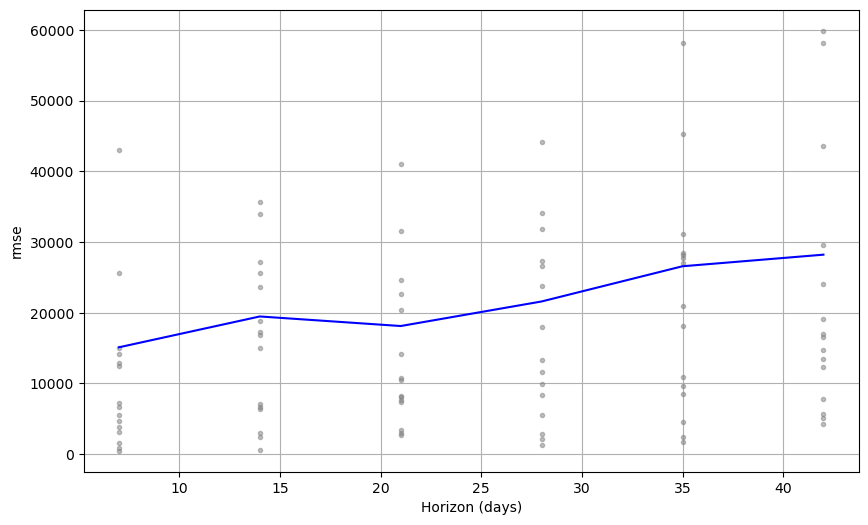

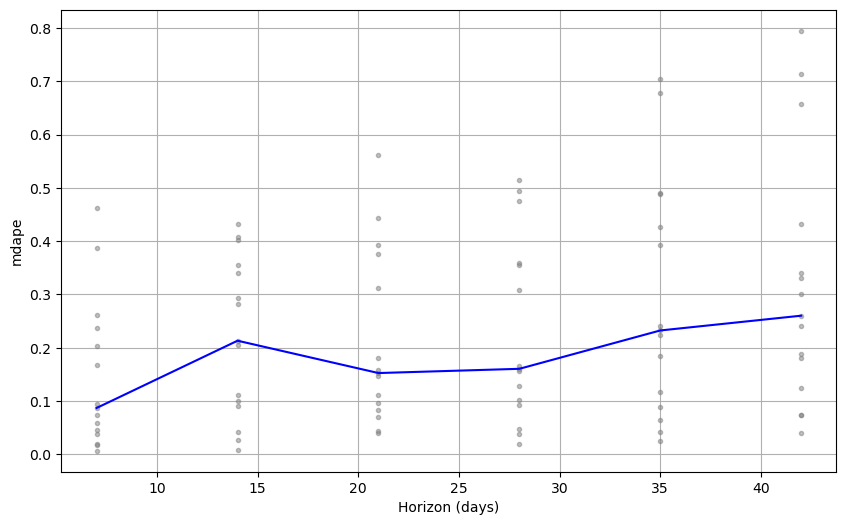

In [77]:
# To plot the RMSE from cross validation 
fig = plot_cross_validation_metric(df_cv, metric='rmse')

# To plot the MDAPE from cross validation 
fig = plot_cross_validation_metric(df_cv, metric='mdape')

## Fitting the Model with the Best Hyperparameters 
Now the best hyperparameters have been determined, the model can be fitted on the train data.

In [19]:
model = Prophet(yearly_seasonality=True,
                      changepoint_prior_scale=0.5,seasonality_prior_scale=0.1)
model.fit(prophet_train_weekly)

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Initial log joint probability = -4.89948


    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       230.594    0.00139569       11.7632      0.1257      0.1257      131   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       231.218   0.000279842       7.78874      0.1995           1      254   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     288        231.36   0.000800375       22.4729   6.412e-05       0.001      417  LS failed, Hessian reset 
     299       231.376   0.000190183       5.18292      0.3117      0.8192      429   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     352       231.387   0.000223128       8.29856   3.254e-05       0.001      539  LS failed, Hessian reset 
     397       231.388   2.18377e-07       6.53908           1           1      600   
Optimization terminated normally: 
  Convergence detected: rel

To generate the test data, the function `Prophet.make_future_dataframe` is used. This generates a dataframe containing the dates required, following on from the train dataset for the length specified by `periods`. 

In [20]:
# Need to provide a dataframe for the predict method, containing a `ds` column
forecast_weekly = model.predict(future_weekly)
forecast_weekly[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()

,ds,yhat,yhat_lower,yhat_upper
1,2022-08-28,93384.322763,84842.651170,102256.431121
2,2022-09-04,84215.555440,74772.440165,92348.327486
3,2022-09-11,77748.698566,69521.088044,86233.728772
4,2022-09-18,72788.802594,63678.500948,82057.816299
5,2022-09-25,67202.775693,58724.197129,76434.050116


In [21]:
fig = plot_plotly(model, forecast_weekly) 
# plt.title('7 Day Forecast')
# plt.ylabel('Revenue (£)')
# plt.xlabel('Date')
fig.show()

In [22]:
fig = go.Figure()

# Add actual vs forecasted revenue 
fig.add_trace(go.Scatter(x=prophet_full_weekly['ds'], y=prophet_full_weekly['y'], mode='lines', name='Train Revenue',
              line={'color' : bakery.light_magpie}))
fig.add_trace(go.Scatter(x=forecast_weekly['ds'], y=forecast_weekly['yhat'], mode='lines', name='Forecasted Revenue',
                         line={'dash': 'dash', 'color': bakery.red_magpie}))

fig.update_xaxes(rangeslider_visible=True)
fig.update_layout(
    yaxis_title='Revenue (£)',
    xaxis_title='Date',
    legend_title='',
    title='Model 2 - Weekly Forecast with Tuned Hyperparameters')
# fig.write_image('fbblank.png', scale=2)
fig.show()

## Visualising the Forecast Components
Now the model has been run with the optimal hyperparamers, the forecast components can be plotted. This cinlucdes the trend, yearly seasonality and weekly seasonality. 

Based on the EDA it is expected for the 7 day forecast heading into September / October from the summer that there will be: 
- A downward trend for the 7 day forecast - due to the summer making the most revenue, and it gradually increase to a low in December 
- Weekly seasonal cycle, with the weekends having a greater revenue 
- Yearly seasonal cycle, with the summer months having a greater revenue 

In [23]:
# To visulaise the forecast components 
fig2 = plot_components_plotly(model, forecast_weekly) 
fig2.show()

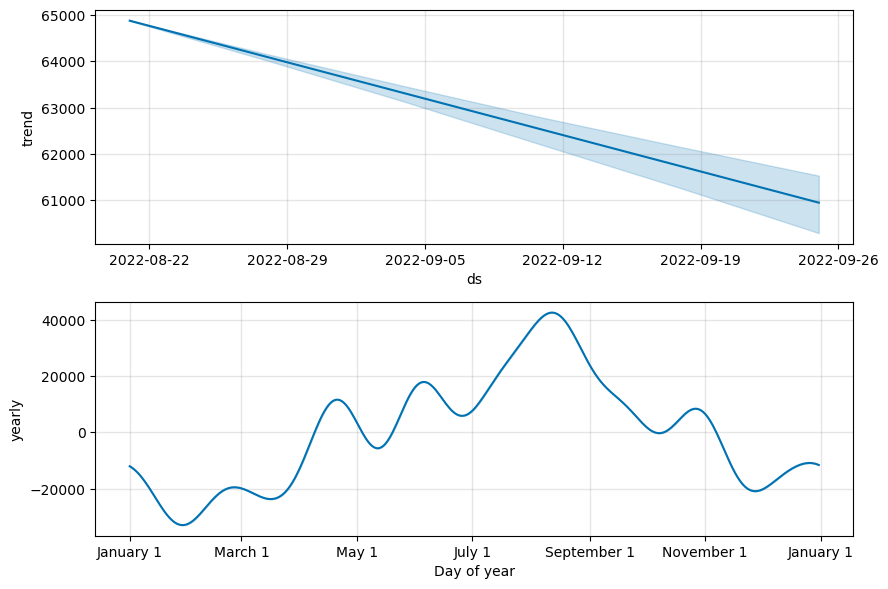

In [24]:
plt2 = model.plot_components(forecast_weekly)

## Observations From Component Plots
The above plot provides interesting insights.

- The first plot shows that the daily revenue across the four bakeries has been linearly increasing over time.

- The second plot highlights the fact that the weekly revenue is at it's lowest on Tuesday and peaks the end of the week and on the weekend.
- The third plot shows that the greatest revenue occurs during the holiday months of July and August. With additional peaks during April, October and June. These are most likely due to the school and bank holidays that generate more revenue than typical weeks. 

## Evaluation of the Model

In [25]:
bakery.full_accuracy_report(prophet_test_weekly[:6]['y'], forecast_weekly['yhat'], 'weekly forecast')

The RMSE for the weekly forecast is: 16267.84

The MAE between the actual and weekly forecast revenue is 14393.58

The MAPE between the actual and weekly forecast revenue is 14.4%


In [31]:
## Best / Append results df

# Weekly Revenue Forecast with Holidays
The above process will now be repeated except with holiday days added (e.g. a column indicating whether it is a school or bank holiday or not). 

This is expected to produce more accurate results as **UPADTE**

In [26]:
# Holiday dataframe is set up correctly 
holidays_train = holidays.reset_index().copy()
holidays_train.rename(columns={'Date': 'ds', 'School Holiday': 'holiday'}, inplace=True)
holidays_train

,ds,holiday
0,2020-10-24,School Holiday
1,2020-10-25,School Holiday
2,2020-10-26,School Holiday
3,2020-10-27,School Holiday
4,2020-10-28,School Holiday
...,...,...
322,2023-08-30,School Holiday
323,2023-08-31,School Holiday
324,2023-09-01,School Holiday
325,2023-09-02,School Holiday


The grid search and cross validation is repeated except with the holiday dataframe added and an additional hyperparameter `holidays_prior_scale` being tuned. This hyperparameter controls flexibility to fit holiday effects.

## Baseline Weekly with Holidays

In [27]:
model_hols = Prophet(yearly_seasonality=True, holidays=holidays_train)
model_hols.fit(prophet_train_weekly)

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Initial log joint probability = -4.89948


    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      83       219.143   0.000177219       72.4185   2.541e-06       0.001      144  LS failed, Hessian reset 
      99       219.155   3.27728e-06        66.557       0.333           1      165   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     111       219.157   1.10457e-05       60.7548   1.285e-07       0.001      224  LS failed, Hessian reset 
     141       219.158   6.00578e-06       70.7776   8.273e-08       0.001      320  LS failed, Hessian reset 
     153       219.158   4.22874e-09       58.8384     0.01753           1      338   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance


In [28]:
# Notice we need to provide a dataframe for the predict method, it must also contain a `ds` column
baseline_forecast_hols = model_hols.predict(future_weekly)
baseline_forecast_hols[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()

,ds,yhat,yhat_lower,yhat_upper
1,2022-08-28,114243.167242,104748.624612,124472.394257
2,2022-09-04,111249.197959,102457.242125,121195.861960
3,2022-09-11,99321.675790,89671.688850,108846.578475
4,2022-09-18,95856.352638,86162.635020,105837.595764
5,2022-09-25,90909.129407,81517.147620,100511.251848


In [29]:
fig = plot_plotly(model_hols, baseline_forecast_hols) # returns a plotly Figure object
fig.show()

In [32]:
fig = go.Figure()

# Add actual vs forecasted revenue \n",
fig.add_trace(go.Scatter(x=prophet_full_weekly['ds'], y=prophet_full_weekly['y'], mode='lines', name='Train Revenue',
              line={'color' : bakery.light_magpie}))
fig.add_trace(go.Scatter(x=baseline_forecast_hols['ds'], y=baseline_forecast_hols['yhat'], mode='lines', 
                         name='Forecasted Revenue',
                         line={'dash': 'dash', 'color': bakery.red_magpie}))

fig.update_xaxes(rangeslider_visible=True)
fig.update_layout(
    yaxis_title='Revenue (£)', 
    xaxis_title='Date',
    legend_title='',
    title='Model 3 - Baseline Weekly Forecast with Special Dates')
# fig.write_image('fbblank.png', scale=2)
fig.show()

In [31]:
bakery.full_accuracy_report(prophet_test_weekly[:6]['y'], baseline_forecast_hols['yhat'], 'weekly forecast')

The RMSE for the weekly forecast is: 10420.7

The MAE between the actual and weekly forecast revenue is 8582.66

The MAPE between the actual and weekly forecast revenue is 9.8%


## Tuning Parameters

In [78]:
# Gird search and cross validation is performed with holidays added 
param_grid = {  
    'changepoint_prior_scale': [0.001, 0.01, 0.1, 0.5],
    'seasonality_prior_scale': [0.01, 0.1, 1.0, 10.0],
#     'seasonality_mode': ['additive', 'multiplicative'],
    'holidays_prior_scale': [0.01, 0.1, 1.0, 10.0]
}

# Generate all combinations of parameters
holiday_all_params = [dict(zip(param_grid.keys(), v)) for v in itertools.product(*param_grid.values())]
holiday_rmses = []  # Store the RMSEs for each params here
holiday_mdape = []

# Use cross validation to evaluate all parameters
for params in holiday_all_params:
    # Fit model with given params
    m = Prophet(**params,holidays=holidays_train,
                yearly_seasonality=True).fit(prophet_train_weekly) 
    df_cv_hol = cross_validation(m, horizon='42 days', parallel='processes')
    df_p = performance_metrics(df_cv_hol, rolling_window=1)
    holiday_rmses.append(df_p['rmse'].values[0])
    holiday_mdape.append(df_p['mdape'].values[0])

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 15 forecasts with cutoffs between 2021-09-12 00:00:00 and 2022-07-03 00:00:00


Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
       1      -4.89948             0       104.614       1e-12       0.001       17   
Optimization terminated with error: 
  Line search failed to achieve a sufficient decrease, no more progress can be made

Initial log joint probability = 136.235
Iteration  1. Log joint probability =    72.5923. Improved by -63.6425.
Iteration  2. Log joint probability =    117.834. Improved by 45.2416.
Iteration  3. Log joint probability =     124.36. Improved by 6.52607.
Iteration  4. Log joint probability =    127.194. Improved by 2.83395.
Iteration  5. Log joint probability =    132.408. Improved by 5.21368.
Iteration  6. Log joint probability =    138.279. Improved by 5.8716.
Iteration  7. Log joint probability =    139.951. Improved by 1.67217.
Iteration  8. Log joint probability =    140.052. Improved by 0.100462.
Iteration  9. Log joint probability =    140.128.

INFO:fbprophet:Applying in parallel with <concurrent.futures.process.ProcessPoolExecutor object at 0x7fa472d8ec10>



Initial log joint probability = 170.299
Iteration  1. Log joint probability =    47.7307. Improved by -122.569.

Initial log joint probability = 173.231
Iteration  2. Log joint probability =    72.1813. Improved by 24.4505.
Iteration  3. Log joint probability =    72.5933. Improved by 0.411994.
Iteration  1. Log joint probability =    44.3109. Improved by -128.92.
Iteration  4. Log joint probability =    78.6102. Improved by 6.01691.

Initial log joint probability = 181.42
Iteration  5. Log joint probability =    80.8917. Improved by 2.28155.
Iteration  2. Log joint probability =    55.2272. Improved by 10.9163.
Iteration  1. Log joint probability =    35.7641. Improved by -145.656.
Iteration  6. Log joint probability =     80.923. Improved by 0.0312952.

Initial log joint probability = 167.68
Iteration  7. Log joint probability =    80.9949. Improved by 0.0718695.
Iteration  3. Log joint probability =      64.19. Improved by 8.96281.
Iteration  4. Log joint probability =    69.8123. 

Iteration 62. Log joint probability =    64.0969. Improved by 1.66842e-08.
Iteration 26. Log joint probability =    84.2136. Improved by 1.07256e-05.
Iteration 27. Log joint probability =    81.0858. Improved by 1.06983e-06.
Iteration 30. Log joint probability =    73.5841. Improved by 1.39187e-05.
Iteration 31. Log joint probability =    73.5841. Improved by 7.6915e-07.
Iteration 36. Log joint probability =    68.9723. Improved by 5.98688e-07.
Iteration 13. Log joint probability =    90.3785. Improved by 0.00912199.
Iteration 24. Log joint probability =    86.6749. Improved by 0.0335776.
Iteration 63. Log joint probability =    64.0969. Improved by 3.22068e-08.
Iteration 37. Log joint probability =    68.9723. Improved by 2.69565e-07.
Iteration 27. Log joint probability =    84.2136. Improved by 3.85018e-06.
Iteration 25. Log joint probability =    86.6811. Improved by 0.00619658.
Iteration 64. Log joint probability =    64.0969. Improved by 3.50317e-09.
Iteration 32. Log joint probab

Iteration 89. Log joint probability =    87.2788. Improved by 0.00228128.
Iteration 59. Log joint probability =    81.0862. Improved by 7.50708e-08.
Iteration 90. Log joint probability =    87.2797. Improved by 0.000934547.
Iteration 45. Log joint probability =    90.3944. Improved by 0.000495047.
Iteration 91. Log joint probability =    87.2818. Improved by 0.00207967.
Iteration 60. Log joint probability =    81.0862. Improved by 5.55064e-07.
Iteration 92. Log joint probability =    87.2829. Improved by 0.00112575.
Iteration 93. Log joint probability =    87.2848. Improved by 0.00187869.
Iteration 46. Log joint probability =    90.3944. Improved by 5.10983e-05.
Iteration 61. Log joint probability =    81.0862. Improved by 7.79619e-08.
Iteration 94. Log joint probability =    87.2861. Improved by 0.00129472.
Iteration 95. Log joint probability =    87.2878. Improved by 0.00168777.
Iteration 62. Log joint probability =    81.0862. Improved by 5.52171e-07.
Iteration 96. Log joint probabi

Iteration  3. Log joint probability =    78.1093. Improved by 30.7009.
Iteration  8. Log joint probability =    103.676. Improved by 0.0655908.
Iteration 20. Log joint probability =    95.2205. Improved by 0.000665231.
Iteration 12. Log joint probability =    99.1907. Improved by 0.033055.
Iteration  4. Log joint probability =    97.0344. Improved by 18.9251.
Iteration 86. Log joint probability =    81.0862. Improved by 1.50416e-06.
Iteration 149. Log joint probability =     87.338. Improved by 0.000661415.
Iteration  9. Log joint probability =    103.957. Improved by 0.280941.
Iteration 13. Log joint probability =     99.198. Improved by 0.00730872.
Iteration 21. Log joint probability =    95.2208. Improved by 0.000298333.
Iteration 150. Log joint probability =    87.3381. Improved by 7.06556e-05.
Iteration 70. Log joint probability =    90.4008. Improved by 1.42525e-07.
Iteration  5. Log joint probability =    99.0533. Improved by 2.01893.
Iteration 10. Log joint probability =    104

Iteration 41. Log joint probability =    104.305. Improved by 7.08481e-08.
Iteration 35. Log joint probability =    108.856. Improved by 3.43641e-06.
Iteration 17. Log joint probability =    113.664. Improved by 0.000696862.
Iteration 187. Log joint probability =    87.3478. Improved by 9.9743e-05.
Iteration 36. Log joint probability =    108.856. Improved by 2.18737e-06.
Iteration 188. Log joint probability =    87.3479. Improved by 8.16025e-05.
Iteration 42. Log joint probability =    104.305. Improved by 2.88498e-08.
Iteration 189. Log joint probability =     87.348. Improved by 0.000102162.
Iteration 18. Log joint probability =    113.665. Improved by 0.00110458.
Iteration 37. Log joint probability =    108.856. Improved by 4.75656e-07.
Iteration 43. Log joint probability =    104.305. Improved by 1.565e-08.
Iteration 190. Log joint probability =     87.348. Improved by 7.91392e-05.
Iteration 38. Log joint probability =    108.856. Improved by 1.16998e-06.
Iteration 44. Log joint p

Iteration 265. Log joint probability =    87.3533. Improved by 6.59595e-06.
Iteration 266. Log joint probability =    87.3533. Improved by 8.60739e-05.
Iteration  2. Log joint probability =    104.376. Improved by 22.3839.
Iteration  3. Log joint probability =    118.765. Improved by 11.4107.
Iteration  4. Log joint probability =    119.617. Improved by 0.851806.
Iteration 267. Log joint probability =    87.3533. Improved by 2.75488e-06.
Iteration  5. Log joint probability =    124.335. Improved by 4.71828.
Iteration 268. Log joint probability =    87.3534. Improved by 8.99057e-05.
Iteration  3. Log joint probability =    120.066. Improved by 15.6901.
Iteration 269. Log joint probability =    87.3536. Improved by 0.000168418.
Iteration  6. Log joint probability =    124.436. Improved by 0.101252.
Iteration 270. Log joint probability =    87.3537. Improved by 7.68351e-05.
Iteration  4. Log joint probability =    123.745. Improved by 3.6787.
Iteration  7. Log joint probability =    124.4

Iteration 44. Log joint probability =    124.625. Improved by 2.54542e-08.
Iteration 319. Log joint probability =    87.3541. Improved by 7.22269e-06.
Iteration 45. Log joint probability =    124.625. Improved by 5.70961e-09.
Iteration 320. Log joint probability =    87.3541. Improved by 3.97129e-06.
Iteration 42. Log joint probability =     130.29. Improved by 5.13291e-06.
Iteration 321. Log joint probability =    87.3541. Improved by 7.5073e-06.
Iteration 322. Log joint probability =    87.3541. Improved by 3.68653e-06.
Iteration 43. Log joint probability =     130.29. Improved by 1.99002e-06.
Iteration 323. Log joint probability =    87.3542. Improved by 7.79191e-06.
Iteration 44. Log joint probability =     130.29. Improved by 7.42199e-07.
Iteration 324. Log joint probability =    87.3542. Improved by 3.40177e-06.
Iteration 325. Log joint probability =    87.3542. Improved by 8.07653e-06.
Iteration 45. Log joint probability =     130.29. Improved by 4.52174e-07.
Iteration 326. Log 

Iteration 413. Log joint probability =    87.3545. Improved by 4.13921e-07.
Iteration 414. Log joint probability =    87.3545. Improved by 2.95967e-07.
Iteration 415. Log joint probability =    87.3545. Improved by 4.06683e-07.
Iteration 416. Log joint probability =    87.3545. Improved by 3.07205e-07.
Iteration 417. Log joint probability =    87.3545. Improved by 3.95444e-07.
Iteration 418. Log joint probability =    87.3545. Improved by 3.18444e-07.
Iteration 419. Log joint probability =    87.3545. Improved by 3.84204e-07.
Iteration 420. Log joint probability =    87.3545. Improved by 3.29682e-07.
Iteration 421. Log joint probability =    87.3545. Improved by 3.72965e-07.
Iteration 422. Log joint probability =    87.3545. Improved by 3.40921e-07.
Iteration 423. Log joint probability =    87.3545. Improved by 3.61726e-07.
Iteration 424. Log joint probability =    87.3545. Improved by 3.5216e-07.
Iteration 425. Log joint probability =    87.3545. Improved by 3.50331e-07.
Iteration 426

Iteration 543. Log joint probability =    87.3545. Improved by 5.48376e-07.
Iteration 544. Log joint probability =    87.3545. Improved by 1.46557e-07.
Iteration 545. Log joint probability =    87.3545. Improved by 5.74973e-07.
Iteration 546. Log joint probability =    87.3545. Improved by 1.1996e-07.
Iteration 547. Log joint probability =    87.3545. Improved by 6.0157e-07.
Iteration 548. Log joint probability =    87.3545. Improved by 9.33625e-08.
Iteration 549. Log joint probability =    87.3545. Improved by 6.28167e-07.
Iteration 550. Log joint probability =    87.3545. Improved by 6.67654e-08.
Iteration 551. Log joint probability =    87.3545. Improved by 6.54764e-07.
Iteration 552. Log joint probability =    87.3545. Improved by 4.01678e-08.
Iteration 553. Log joint probability =    87.3545. Improved by 6.81361e-07.
Iteration 554. Log joint probability =    87.3545. Improved by 1.35704e-08.
Iteration 555. Log joint probability =    87.3545. Improved by 7.07957e-07.
Iteration 556.

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
       1      -4.89948             0       104.614       1e-12       0.001       17   
Optimization terminated with error: 
  Line search failed to achieve a sufficient decrease, no more progress can be made

Initial log joint probability = 129.327
Iteration  1. Log joint probability =    74.2708. Improved by -55.0562.
Iteration  2. Log joint probability =    124.703. Improved by 50.4325.
Iteration  3. Log joint probability =    134.756. Improved by 10.0525.
Iteration  4. Log joint probability =     144.18. Improved by 9.42466.
Iteration  5. Log joint probability =    145.202. Improved by 1.02106.
Iteration  6. Log joint probability =    145.212. Improved by 0.0101402.
Iteration  7. Log joint probability =    145.241. Improved by 0.0295624.
Iteration  8. Log joint probability =    145.316. Improved by 0.0752627.
Iteration  9. Log joint probability =    14

rophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  componen

Improved by 0.00356426.
Iteration 24. Log joint probability =    145.407. Improved by 0.0066864.
Iteration 25. Log joint probability =     145.41. Improved by 0.00231985.
Iteration 26. Log joint probability =    145.418. Improved by 0.00779657.
Iteration 27. Log joint probability =    145.418. Improved by 0.000780861.
Iteration 28. Log joint probability =    145.428. Improved by 0.00918707.
Iteration 29. Log joint probability =    145.469. Improved by 0.0419044.
Iteration 30. Log joint probability =    145.488. Improved by 0.0189703.
Iteration 31. Log joint probability =    145.489. Improved by 0.000702145.
Iteration 32. Log joint probability =    145.491. Improved by 0.00154014.
Iteration 33. Log joint probability =    145.491. Improved by 0.000658564.
Iteration 34. Log joint probability =    145.493. Improved by 0.00156686.
Iteration 35. Log joint probability =    145.494. Improved by 0.000615044.
Iteration 36. Log joint probability =    145.495. Improved by 0.00159364.
Iteration 37.


Initial log joint probability = 169.104
Iteration  1. Log joint probability =    41.3499. Improved by -127.755.
Iteration  2. Log joint probability =    50.9566. Improved by 9.60671.

Initial log joint probability = 174.512
Iteration  3. Log joint probability =    51.0726. Improved by 0.116058.
Iteration  4. Log joint probability =    57.0264. Improved by 5.95373.
Iteration  5. Log joint probability =    68.6499. Improved by 11.6235.
Iteration  1. Log joint probability =    35.8299. Improved by -138.682.
Iteration  6. Log joint probability =    70.2409. Improved by 1.59106.
Iteration  7. Log joint probability =    73.6937. Improved by 3.45276.
Iteration  8. Log joint probability =    73.9858. Improved by 0.292099.
Iteration  2. Log joint probability =    36.6044. Improved by 0.774492.
Iteration  9. Log joint probability =    74.2358. Improved by 0.250032.
Iteration 10. Log joint probability =    74.2701. Improved by 0.0342825.
Iteration 11. Log joint probability =     74.414. Improved

Iteration 39. Log joint probability =    64.7895. Improved by 2.04662e-07.
Iteration 21. Log joint probability =    79.2408. Improved by 0.00236427.
Iteration 40. Log joint probability =    64.7895. Improved by 6.97785e-08.
Iteration  1. Log joint probability =    55.9978. Improved by -98.8191.
Iteration 22. Log joint probability =     79.242. Improved by 0.00119501.
Iteration 26. Log joint probability =    69.4145. Improved by 0.00186629.
Iteration 18. Log joint probability =    85.4823. Improved by 0.00010115.
Iteration  3. Log joint probability =    74.7099. Improved by 0.600163.
Iteration 23. Log joint probability =    79.2426. Improved by 0.00060227.
Iteration 27. Log joint probability =    69.4179. Improved by 0.0034502.
Iteration 41. Log joint probability =    64.7895. Improved by 1.22601e-07.
Iteration 19. Log joint probability =    85.4825. Improved by 0.00024406.
Iteration  6. Log joint probability =    89.5525. Improved by 0.0431865.
Iteration 42. Log joint probability =    

Iteration 41. Log joint probability =    89.7137. Improved by 0.000292862.
Iteration 42. Log joint probability =    89.7163. Improved by 0.00257191.
Iteration 43. Log joint probability =    89.7165. Improved by 0.000283576.
Iteration 44. Log joint probability =    89.7191. Improved by 0.0025382.
Iteration 45. Log joint probability =    89.7193. Improved by 0.000274617.
Iteration 46. Log joint probability =    89.7219. Improved by 0.00250482.
Iteration 47. Log joint probability =    89.7221. Improved by 0.00026598.
Iteration 48. Log joint probability =    89.7245. Improved by 0.00241853.
Iteration 49. Log joint probability =    89.7249. Improved by 0.000325795.
Iteration 50. Log joint probability =    89.7271. Improved by 0.00227921.
Iteration 51. Log joint probability =    89.7276. Improved by 0.000430797.
Iteration 52. Log joint probability =    89.7298. Improved by 0.00220423.
Iteration 53. Log joint probability =    89.7302. Improved by 0.000384694.

Initial log joint probability = 

Iteration 80. Log joint probability =    89.7882. Improved by 6.40695e-06.
Iteration 12. Log joint probability =    111.683. Improved by 0.0759817.
Iteration 81. Log joint probability =    89.7882. Improved by 3.12867e-06.
Iteration 13. Log joint probability =    111.721. Improved by 0.0377325.
Iteration 16. Log joint probability =    106.557. Improved by 0.00063967.

Initial log joint probability = 141.335
Iteration 82. Log joint probability =    89.7882. Improved by 5.68824e-06.
Iteration 14. Log joint probability =    111.739. Improved by 0.0179764.
Iteration 17. Log joint probability =    106.559. Improved by 0.00135591.
Iteration 15. Log joint probability =    111.739. Improved by 0.000603136.
Iteration 83. Log joint probability =    89.7882. Improved by 3.84683e-06.
Iteration 16. Log joint probability =    111.748. Improved by 0.00875984.
Iteration  1. Log joint probability =    70.1644. Improved by -71.1707.
Iteration 17. Log joint probability =    111.751. Improved by 0.0023517

Iteration 106. Log joint probability =    89.7885. Improved by 2.01172e-07.
Iteration 29. Log joint probability =    128.639. Improved by 3.78511e-05.
Iteration 39. Log joint probability =     106.58. Improved by 0.000666497.
Iteration 15. Log joint probability =    134.071. Improved by 0.0173619.
Iteration 27. Log joint probability =    117.018. Improved by 4.50937e-05.
Iteration 30. Log joint probability =    128.639. Improved by 1.41653e-05.
Iteration 40. Log joint probability =    106.581. Improved by 0.00123518.
Iteration 107. Log joint probability =    89.7885. Improved by 2.72303e-07.
Iteration 31. Log joint probability =    128.639. Improved by 5.9902e-06.
Iteration 28. Log joint probability =    117.018. Improved by 1.22168e-05.
Iteration 16. Log joint probability =    134.073. Improved by 0.0020134.
Iteration 32. Log joint probability =    128.639. Improved by 8.26077e-06.
Iteration 108. Log joint probability =    89.7885. Improved by 3.83969e-07.
Iteration 29. Log joint prob

Iteration 38. Log joint probability =    134.258. Improved by 3.3536e-06.
Iteration 69. Log joint probability =    106.621. Improved by 0.000332498.
Iteration 39. Log joint probability =    134.258. Improved by 4.66586e-06.
Iteration 70. Log joint probability =    106.621. Improved by 0.000418782.
Iteration 40. Log joint probability =    134.258. Improved by 5.03282e-06.
Iteration 71. Log joint probability =    106.621. Improved by 0.000214378.
Iteration 41. Log joint probability =    134.258. Improved by 3.19063e-06.
Iteration 72. Log joint probability =    106.622. Improved by 0.000135497.
Iteration 73. Log joint probability =    106.622. Improved by 0.000202024.
Iteration 42. Log joint probability =    134.258. Improved by 6.42477e-06.
Iteration 43. Log joint probability =    134.258. Improved by 1.88324e-06.
Iteration 74. Log joint probability =    106.622. Improved by 4.74799e-05.
Iteration 75. Log joint probability =    106.622. Improved by 4.93263e-05.
Iteration 44. Log joint pr

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
       1      -4.89948             0       104.614       1e-12       0.001       17   
Optimization terminated with error: 
  Line search failed to achieve a sufficient decrease, no more progress can be made

Initial log joint probability = 122.419
Iteration  1. Log joint probability =    78.7586. Improved by -43.6607.
Iteration  2. Log joint probability =    129.286. Improved by 50.5273.
Iteration  3. Log joint probability =    136.332. Improved by 7.04593.
Iteration  4. Log joint probability =    145.004. Improved by 8.67195.
Iteration  5. Log joint probability =     145.96. Improved by 0.956104.
Iteration  6. Log joint probability =    145.982. Improved by 0.0225974.
Iteration  7. Log joint probability =    146.005. Improved by 0.0227777.
Iteration  8. Log joint probability =    146.083. Improved by 0.0775614.
Iteration  9. Log joint probability =    1

INFO:fbprophet:Making 15 forecasts with cutoffs between 2021-09-12 00:00:00 and 2022-07-03 00:00:00
all/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/f

10. Log joint probability =    146.124. Improved by 0.00145014.
Iteration 11. Log joint probability =    146.126. Improved by 0.00169588.
Iteration 12. Log joint probability =    146.127. Improved by 0.00178029.
Iteration 13. Log joint probability =    146.129. Improved by 0.00131578.
Iteration 14. Log joint probability =    146.131. Improved by 0.00211085.
Iteration 15. Log joint probability =    146.132. Improved by 0.000936031.
Iteration 16. Log joint probability =    146.134. Improved by 0.00244181.
Iteration 17. Log joint probability =    146.135. Improved by 0.000556634.
Iteration 18. Log joint probability =    146.138. Improved by 0.00277315.
Iteration 19. Log joint probability =    146.138. Improved by 0.000177582.
Iteration 20. Log joint probability =    146.141. Improved by 0.00310488.
Iteration 21. Log joint probability =    146.163. Improved by 0.0218278.
Iteration 22. Log joint probability =    146.172. Improved by 0.00969053.
Iteration 23. Log joint probability =    146.1

ter.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)



Initial log joint probability = 159.416
Iteration  1. Log joint probability =    45.5892. Improved by -113.826.

Initial log joint probability = 153.864
Iteration  2. Log joint probability =    69.8799. Improved by 24.2907.
Iteration  1. Log joint probability =    49.3328. Improved by -104.531.
Iteration  3. Log joint probability =    70.9162. Improved by 1.03637.
Iteration  2. Log joint probability =    70.1939. Improved by 20.8611.

Initial log joint probability = 162.197
Iteration  4. Log joint probability =    76.9697. Improved by 6.05345.
Iteration  3. Log joint probability =    79.6512. Improved by 9.45736.
Iteration  5. Log joint probability =    79.1269. Improved by 2.15725.
Iteration  4. Log joint probability =    80.5931. Improved by 0.941855.
Iteration  1. Log joint probability =    42.1508. Improved by -120.046.
Iteration  5. Log joint probability =    85.4009. Improved by 4.80782.
Iteration  6. Log joint probability =    79.2117. Improved by 0.084751.
Iteration  6. Log jo

Iteration 18. Log joint probability =    64.7728. Improved by 0.000345391.
Iteration 21. Log joint probability =    74.6693. Improved by 0.000321599.
Iteration 29. Log joint probability =    69.9912. Improved by 1.54691e-05.
Iteration 44. Log joint probability =    85.6612. Improved by 3.55186e-07.
Iteration 30. Log joint probability =    69.9912. Improved by 6.51363e-06.
Iteration  9. Log joint probability =    90.1744. Improved by 0.0299779.
Iteration 12. Log joint probability =    83.2446. Improved by 0.00209454.
Iteration 27. Log joint probability =    79.3857. Improved by 5.27485e-05.
Iteration 45. Log joint probability =    85.6612. Improved by 3.40031e-07.
Iteration 19. Log joint probability =    64.7738. Improved by 0.000932378.
Iteration 31. Log joint probability =    69.9912. Improved by 1.7719e-05.
Iteration 15. Log joint probability =    92.1451. Improved by 0.0168891.
Iteration 22. Log joint probability =    74.6695. Improved by 0.0001536.
Iteration 32. Log joint probabili

Iteration 32. Log joint probability =    83.2849. Improved by 1.04319e-06.
Iteration 40. Log joint probability =    74.6696. Improved by 1.90625e-07.
Iteration 45. Log joint probability =    79.3888. Improved by 1.10159e-06.
Iteration 40. Log joint probability =    64.7942. Improved by 2.22242e-06.
Iteration 32. Log joint probability =    92.2298. Improved by 0.00334212.
Iteration 30. Log joint probability =    90.2142. Improved by 9.00166e-07.
Iteration 33. Log joint probability =    83.2849. Improved by 5.45956e-07.
Iteration 46. Log joint probability =    79.3888. Improved by 1.08014e-07.
Iteration 41. Log joint probability =    64.7942. Improved by 1.77375e-07.
Iteration 41. Log joint probability =    74.6696. Improved by 9.02469e-09.
Iteration 33. Log joint probability =    92.2362. Improved by 0.00644217.
Iteration 31. Log joint probability =    90.2142. Improved by 5.69213e-07.
Iteration 34. Log joint probability =    83.2849. Improved by 3.08112e-07.
Iteration 42. Log joint pro

Iteration 73. Log joint probability =    92.4153. Improved by 0.00401196.
Iteration 92. Log joint probability =    79.3888. Improved by 1.05683e-07.
Iteration 17. Log joint probability =    96.7101. Improved by 0.912208.
Iteration 14. Log joint probability =    101.772. Improved by 4.37914e-05.
Iteration 15. Log joint probability =    101.772. Improved by 0.000419268.
Iteration 18. Log joint probability =    96.8117. Improved by 0.10164.
Iteration 93. Log joint probability =    79.3888. Improved by 4.90254e-07.
Iteration 19. Log joint probability =    96.9259. Improved by 0.114191.
Iteration 74. Log joint probability =    92.4197. Improved by 0.00437205.
Iteration 16. Log joint probability =    101.778. Improved by 0.00524936.
Iteration 20. Log joint probability =    96.9526. Improved by 0.0266402.
Iteration 17. Log joint probability =     101.78. Improved by 0.00207261.
Iteration 94. Log joint probability =    79.3888. Improved by 9.58764e-08.
Iteration 75. Log joint probability =    

Iteration 12. Log joint probability =    117.125. Improved by 0.0136182.
Iteration 16. Log joint probability =    111.931. Improved by 0.00106725.
Iteration 20. Log joint probability =    107.277. Improved by 0.00129285.
Iteration 13. Log joint probability =    117.133. Improved by 0.00841008.
Iteration  3. Log joint probability =    120.302. Improved by 2.88224.
Iteration 17. Log joint probability =    111.941. Improved by 0.0105452.
Iteration 90. Log joint probability =    92.4842. Improved by 0.00566511.
Iteration 52. Log joint probability =    97.1125. Improved by 2.3821e-06.
Iteration 53. Log joint probability =    97.1125. Improved by 5.63578e-07.
Iteration 21. Log joint probability =    107.277. Improved by 0.000453744.
Iteration 14. Log joint probability =    117.141. Improved by 0.00741455.
Iteration 18. Log joint probability =    111.942. Improved by 0.00103245.
Iteration 15. Log joint probability =    117.153. Improved by 0.0125098.
Iteration 54. Log joint probability =    9

Iteration 57. Log joint probability =    112.159. Improved by 3.12948e-05.
Iteration 53. Log joint probability =    117.493. Improved by 2.17313e-08.
Iteration 58. Log joint probability =    112.159. Improved by 8.16916e-06.
Iteration 24. Log joint probability =    128.948. Improved by 0.000931427.
Iteration 54. Log joint probability =    117.493. Improved by 5.49043e-09.
Iteration 59. Log joint probability =     112.16. Improved by 1.96965e-05.
Iteration 25. Log joint probability =    128.948. Improved by 0.000376444.
Iteration 60. Log joint probability =     112.16. Improved by 6.42367e-06.
Iteration 61. Log joint probability =     112.16. Improved by 6.58619e-07.
Iteration 26. Log joint probability =    128.949. Improved by 0.000351995.
Iteration 62. Log joint probability =     112.16. Improved by 5.04613e-06.
Iteration 63. Log joint probability =     112.16. Improved by 2.30805e-06.
Iteration 27. Log joint probability =    128.949. Improved by 0.000282721.
Iteration 64. Log joint p

Iteration 26. Log joint probability =    135.057. Improved by 4.04341e-05.
Iteration 147. Log joint probability =    92.6791. Improved by 0.00255766.
Iteration 27. Log joint probability =    135.058. Improved by 0.000248153.
Iteration 28. Log joint probability =    135.058. Improved by 9.54624e-05.
Iteration 148. Log joint probability =    92.6825. Improved by 0.00347823.
Iteration 29. Log joint probability =    135.058. Improved by 0.000130901.
Iteration 30. Log joint probability =    135.058. Improved by 5.35117e-05.
Iteration 149. Log joint probability =    92.6852. Improved by 0.00268367.
Iteration 31. Log joint probability =    135.058. Improved by 6.86436e-06.
Iteration 150. Log joint probability =    92.6885. Improved by 0.0033028.
Iteration 32. Log joint probability =    135.058. Improved by 3.28307e-05.
Iteration 33. Log joint probability =    135.058. Improved by 5.98225e-06.
Iteration 34. Log joint probability =    135.058. Improved by 1.90919e-05.
Iteration 151. Log joint p

Iteration 238. Log joint probability =     92.912. Improved by 0.00248354.
Iteration 239. Log joint probability =    92.9137. Improved by 0.00174722.
Iteration 240. Log joint probability =    92.9162. Improved by 0.00247997.
Iteration 241. Log joint probability =    92.9179. Improved by 0.00168935.
Iteration 242. Log joint probability =    92.9204. Improved by 0.00253172.
Iteration 243. Log joint probability =     92.922. Improved by 0.00160421.
Iteration 244. Log joint probability =    92.9246. Improved by 0.0025836.
Iteration 245. Log joint probability =    92.9261. Improved by 0.00151921.
Iteration 246. Log joint probability =    92.9287. Improved by 0.00263562.
Iteration 247. Log joint probability =    92.9302. Improved by 0.00143435.
Iteration 248. Log joint probability =    92.9329. Improved by 0.00268776.
Iteration 249. Log joint probability =    92.9342. Improved by 0.00134963.
Iteration 250. Log joint probability =    92.9369. Improved by 0.00272282.
Iteration 251. Log joint p

Iteration 347. Log joint probability =    93.0071. Improved by 2.96408e-06.
Iteration 348. Log joint probability =    93.0071. Improved by 5.24596e-07.
Iteration 349. Log joint probability =    93.0071. Improved by 3.07025e-06.
Iteration 350. Log joint probability =    93.0071. Improved by 4.30782e-07.
Iteration 351. Log joint probability =    93.0071. Improved by 3.12108e-06.
Iteration 352. Log joint probability =    93.0071. Improved by 4.22932e-07.
Iteration 353. Log joint probability =    93.0071. Improved by 3.1289e-06.
Iteration 354. Log joint probability =    93.0071. Improved by 4.15082e-07.
Iteration 355. Log joint probability =    93.0071. Improved by 3.09427e-06.
Iteration 356. Log joint probability =    93.0071. Improved by 4.92171e-07.
Iteration 357. Log joint probability =    93.0071. Improved by 3.00822e-06.
Iteration 358. Log joint probability =    93.0071. Improved by 5.87095e-07.
Iteration 359. Log joint probability =    93.0071. Improved by 2.91327e-06.
Iteration 360

Iteration 467. Log joint probability =    93.0072. Improved by 2.91945e-07.
Iteration 468. Log joint probability =    93.0072. Improved by 1.46541e-07.
Iteration 469. Log joint probability =    93.0072. Improved by 3.01749e-07.
Iteration 470. Log joint probability =    93.0072. Improved by 1.36736e-07.
Iteration 471. Log joint probability =    93.0072. Improved by 3.0358e-07.
Iteration 472. Log joint probability =    93.0072. Improved by 1.42463e-07.
Iteration 473. Log joint probability =    93.0072. Improved by 2.97657e-07.
Iteration 474. Log joint probability =    93.0072. Improved by 1.4733e-07.
Iteration 475. Log joint probability =    93.0072. Improved by 2.92609e-07.
Iteration 476. Log joint probability =    93.0072. Improved by 1.54233e-07.
Iteration 477. Log joint probability =    93.0072. Improved by 2.82844e-07.
Iteration 478. Log joint probability =    93.0072. Improved by 1.66851e-07.
Iteration 479. Log joint probability =    93.0072. Improved by 2.70225e-07.
Iteration 480.

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
       1      -4.89948             0       104.614       1e-12       0.001       17   
Optimization terminated with error: 
  Line search failed to achieve a sufficient decrease, no more progress can be made

Initial log joint probability = 115.512
Iteration  1. Log joint probability =    78.7517. Improved by -36.7598.
Iteration  2. Log joint probability =    128.076. Improved by 49.3239.
Iteration  3. Log joint probability =    134.814. Improved by 6.73871.
Iteration  4. Log joint probability =    135.031. Improved by 0.217084.
Iteration  5. Log joint probability =    137.154. Improved by 2.12227.
Iteration  6. Log joint probability =    145.535. Improved by 8.38145.
Iteration  7. Log joint probability =    145.958. Improved by 0.42266.
Iteration  8. Log joint probability =    146.056. Improved by 0.0986005.
Iteration  9. Log joint probability =    146.0

INFO:fbprophet:Making 15 forecasts with cutoffs between 2021-09-12 00:00:00 and 2022-07-03 00:00:00
ame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a 

og joint probability =    146.238. Improved by 0.153748.
Iteration 11. Log joint probability =    146.308. Improved by 0.0696474.
Iteration 12. Log joint probability =    146.311. Improved by 0.00337375.
Iteration 13. Log joint probability =    146.347. Improved by 0.0350569.
Iteration 14. Log joint probability =    146.353. Improved by 0.00642948.
Iteration 15. Log joint probability =     146.37. Improved by 0.0172419.
Iteration 16. Log joint probability =     146.38. Improved by 0.00996847.
Iteration 17. Log joint probability =    146.385. Improved by 0.00448218.
Iteration 18. Log joint probability =    146.387. Improved by 0.00247548.
Iteration 19. Log joint probability =    146.388. Improved by 0.00127102.
Iteration 20. Log joint probability =    146.389. Improved by 0.000681976.
Iteration 21. Log joint probability =    146.389. Improved by 0.00031295.
Iteration 22. Log joint probability =    146.389. Improved by 5.5858e-05.
Iteration 23. Log joint probability =    146.389. Improve

 version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecas


Initial log joint probability = 160.697
Iteration  1. Log joint probability =    36.2328. Improved by -124.464.

Initial log joint probability = 152.508
Iteration  2. Log joint probability =     55.854. Improved by 19.6212.
Iteration  3. Log joint probability =    56.3086. Improved by 0.454522.
Iteration  1. Log joint probability =    45.6331. Improved by -106.875.
Iteration  4. Log joint probability =    62.4393. Improved by 6.13078.
Iteration  2. Log joint probability =    70.2348. Improved by 24.6017.
Iteration  5. Log joint probability =    64.4292. Improved by 1.98983.
Iteration  3. Log joint probability =    71.0079. Improved by 0.773138.
Iteration  6. Log joint probability =    64.4761. Improved by 0.0469707.
Iteration  7. Log joint probability =    64.6178. Improved by 0.141643.
Iteration  4. Log joint probability =    76.9971. Improved by 5.98921.
Iteration  5. Log joint probability =    79.1445. Improved by 2.1474.
Iteration  8. Log joint probability =    64.6235. Improved b

Iteration  6. Log joint probability =     85.466. Improved by 0.129221.
Iteration 31. Log joint probability =    64.7911. Improved by 6.37132e-06.
Iteration 22. Log joint probability =    68.2782. Improved by 0.0204178.
Iteration 12. Log joint probability =    74.6375. Improved by 0.00522233.
Iteration 23. Log joint probability =    68.3018. Improved by 0.0236358.
Iteration  7. Log joint probability =    85.5109. Improved by 0.044848.
Iteration  7. Log joint probability =    90.5594. Improved by 1.02312.
Iteration  8. Log joint probability =     90.167. Improved by 0.0276742.
Iteration 16. Log joint probability =    83.2982. Improved by 0.0015757.
Iteration  8. Log joint probability =     85.524. Improved by 0.0131371.
Iteration 24. Log joint probability =    68.3197. Improved by 0.0178838.
Iteration 29. Log joint probability =    79.4059. Improved by 2.76654e-05.
Iteration 32. Log joint probability =    64.7912. Improved by 6.56142e-05.
Iteration 25. Log joint probability =    68.3448

Iteration 19. Log joint probability =    92.6658. Improved by 0.0820742.
Iteration 37. Log joint probability =    85.6052. Improved by 8.60831e-05.
Iteration 31. Log joint probability =    83.3039. Improved by 6.44439e-07.
Iteration 58. Log joint probability =    68.7719. Improved by 0.00685592.
Iteration 38. Log joint probability =    85.6052. Improved by 3.05304e-05.
Iteration 46. Log joint probability =    64.7925. Improved by 2.24544e-06.
Iteration 42. Log joint probability =     79.406. Improved by 2.99002e-08.
Iteration 24. Log joint probability =    90.2346. Improved by 1.25074e-05.
Iteration 59. Log joint probability =    68.7807. Improved by 0.0087934.
Iteration 27. Log joint probability =    74.6807. Improved by 0.000656563.
Iteration 39. Log joint probability =    85.6052. Improved by 5.35592e-06.
Iteration 32. Log joint probability =    83.3039. Improved by 2.06573e-06.
Iteration 20. Log joint probability =    92.6725. Improved by 0.00671618.
Iteration 60. Log joint probabi

Iteration 49. Log joint probability =    74.6813. Improved by 1.27804e-08.
Iteration 82. Log joint probability =    85.6053. Improved by 8.78854e-07.
Iteration 83. Log joint probability =    85.6053. Improved by 7.01017e-07.
Iteration 113. Log joint probability =    69.1403. Improved by 0.00844898.
Iteration 114. Log joint probability =    69.1429. Improved by 0.00253223.
Iteration 39. Log joint probability =    92.8596. Improved by 0.00555139.
Iteration 84. Log joint probability =    85.6053. Improved by 8.71041e-07.
Iteration 50. Log joint probability =    74.6813. Improved by 1.71929e-09.
Iteration 115. Log joint probability =    69.1515. Improved by 0.00868166.
Iteration 85. Log joint probability =    85.6053. Improved by 6.99582e-07.
Iteration 116. Log joint probability =    69.1536. Improved by 0.00202968.
Iteration 86. Log joint probability =    85.6053. Improved by 8.81686e-07.
Iteration 117. Log joint probability =    69.1627. Improved by 0.00916882.
Iteration 40. Log joint pr

Iteration 179. Log joint probability =    69.2327. Improved by 7.63349e-06.
Iteration 180. Log joint probability =    69.2327. Improved by 1.81212e-06.
Iteration 61. Log joint probability =    92.9484. Improved by 0.00286164.
Iteration 181. Log joint probability =    69.2327. Improved by 8.86794e-06.
Iteration 182. Log joint probability =    69.2327. Improved by 6.6503e-07.
Iteration 183. Log joint probability =    69.2327. Improved by 1.00073e-05.
Iteration 184. Log joint probability =    69.2327. Improved by 2.02741e-05.
Iteration 62. Log joint probability =    92.9531. Improved by 0.00470614.
Iteration 185. Log joint probability =    69.2327. Improved by 8.9132e-07.
Iteration 186. Log joint probability =    69.2328. Improved by 4.47888e-06.
Iteration 63. Log joint probability =    92.9558. Improved by 0.00268059.
Iteration 187. Log joint probability =    69.2328. Improved by 3.24868e-07.
Iteration 188. Log joint probability =    69.2328. Improved by 5.04375e-06.

Initial log joint p

Iteration 40. Log joint probability =    101.742. Improved by 1.65905e-08.
Iteration  5. Log joint probability =    108.916. Improved by 0.421933.
Iteration 91. Log joint probability =     93.049. Improved by 0.00215938.

Initial log joint probability = 124.947
Iteration 23. Log joint probability =    112.256. Improved by 0.000127798.
Iteration 16. Log joint probability =    107.138. Improved by 0.0369846.
Iteration 41. Log joint probability =    101.742. Improved by 3.69077e-08.
Iteration  6. Log joint probability =    109.509. Improved by 0.593041.
Iteration 24. Log joint probability =    112.256. Improved by 7.89187e-05.
Iteration 92. Log joint probability =    93.0527. Improved by 0.00372133.
Iteration 51. Log joint probability =    97.1915. Improved by 6.52391e-07.
Iteration 42. Log joint probability =    101.742. Improved by 1.37988e-08.
Iteration 52. Log joint probability =    97.1915. Improved by 3.19303e-07.
Iteration 17. Log joint probability =    107.156. Improved by 0.01806

Iteration 131. Log joint probability =    117.176. Improved by 7.03433e-05.
Iteration 158. Log joint probability =    93.1684. Improved by 5.79048e-07.
Iteration 132. Log joint probability =    117.176. Improved by 2.14011e-05.
Iteration 159. Log joint probability =    93.1685. Improved by 1.81364e-05.
Iteration 133. Log joint probability =    117.177. Improved by 7.95683e-05.
Iteration 160. Log joint probability =    93.1685. Improved by 1.4501e-07.
Iteration 134. Log joint probability =    117.177. Improved by 1.21556e-05.
Iteration 135. Log joint probability =    117.177. Improved by 8.85555e-05.
Iteration 136. Log joint probability =    117.177. Improved by 3.40322e-06.
Iteration 161. Log joint probability =    93.1685. Improved by 1.85693e-05.
Iteration 137. Log joint probability =    117.177. Improved by 9.67051e-05.
Iteration 162. Log joint probability =    93.1686. Improved by 9.05034e-05.
Iteration 138. Log joint probability =    117.177. Improved by 0.000270717.
Iteration 139

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
       1      -4.89948             0       104.614       1e-12       0.001       17   
Optimization terminated with error: 
  Line search failed to achieve a sufficient decrease, no more progress can be made

Initial log joint probability = 90.1831
Iteration  1. Log joint probability =    66.0411. Improved by -24.142.
Iteration  2. Log joint probability =    148.616. Improved by 82.575.
Iteration  3. Log joint probability =     193.91. Improved by 45.2942.
Iteration  4. Log joint probability =    206.272. Improved by 12.3618.
Iteration  5. Log joint probability =    207.402. Improved by 1.12963.
Iteration  6. Log joint probability =    209.023. Improved by 1.62171.
Iteration  7. Log joint probability =    209.302. Improved by 0.278954.
Iteration  8. Log joint probability =    209.331. Improved by 0.0286929.
Iteration  9. Log joint probability =    209.534

ts = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append met

 joint probability =    209.566. Improved by 0.0319043.
Iteration 11. Log joint probability =    209.584. Improved by 0.0175977.
Iteration 12. Log joint probability =    209.621. Improved by 0.0372486.
Iteration 13. Log joint probability =    209.621. Improved by 0.000291792.
Iteration 14. Log joint probability =    209.626. Improved by 0.00442266.
Iteration 15. Log joint probability =     209.64. Improved by 0.014894.
Iteration 16. Log joint probability =    209.651. Improved by 0.0105285.
Iteration 17. Log joint probability =    209.657. Improved by 0.00624057.
Iteration 18. Log joint probability =    209.662. Improved by 0.00429413.
Iteration 19. Log joint probability =    209.662. Improved by 0.000876041.
Iteration 20. Log joint probability =    209.665. Improved by 0.00227776.
Iteration 21. Log joint probability =    209.665. Improved by 0.000124983.
Iteration 22. Log joint probability =    209.665. Improved by 0.000180671.
Iteration 23. Log joint probability =    209.665. Improve

Iteration 22. Log joint probability =    143.262. Improved by 3.03438e-05.
Iteration 31. Log joint probability =    161.211. Improved by 0.000648754.
Iteration 23. Log joint probability =    143.263. Improved by 0.000282825.
Iteration 11. Log joint probability =    167.094. Improved by 0.019568.
Iteration  4. Log joint probability =     166.89. Improved by 9.11402.
Iteration 32. Log joint probability =    161.212. Improved by 0.000211524.
Iteration  8. Log joint probability =    151.785. Improved by 0.635809.
Iteration  2. Log joint probability =    110.355. Improved by 46.4402.
Iteration  5. Log joint probability =     171.13. Improved by 4.24011.
Iteration  9. Log joint probability =    152.474. Improved by 0.68856.
Iteration 24. Log joint probability =    143.263. Improved by 3.3462e-05.

Initial log joint probability = 115.673
Iteration  9. Log joint probability =    167.959. Improved by 0.0188245.
Iteration 33. Log joint probability =    161.212. Improved by 0.000175628.
Iteration

Iteration 76. Log joint probability =    143.271. Improved by 0.000114581.
Iteration 82. Log joint probability =    161.212. Improved by 6.74055e-07.
Iteration 27. Log joint probability =    168.017. Improved by 0.0020592.
Iteration 35. Log joint probability =    170.687. Improved by 0.0482396.
Iteration 77. Log joint probability =    143.271. Improved by 0.00019151.
Iteration 83. Log joint probability =    161.212. Improved by 2.35772e-06.
Iteration 49. Log joint probability =    175.456. Improved by 7.64474e-05.
Iteration 33. Log joint probability =    167.134. Improved by 0.00225946.
Iteration 36. Log joint probability =    170.722. Improved by 0.0355763.
Iteration 78. Log joint probability =    143.271. Improved by 0.000117702.
Iteration 84. Log joint probability =    161.212. Improved by 6.66831e-07.
Iteration 28. Log joint probability =    165.393. Improved by 2.12882e-06.
Iteration 50. Log joint probability =    175.456. Improved by 2.14127e-05.
Iteration 37. Log joint probabili

Iteration 57. Log joint probability =    171.417. Improved by 0.0113337.
Iteration 46. Log joint probability =    167.155. Improved by 0.000921456.
Iteration 74. Log joint probability =    175.457. Improved by 5.52198e-06.
Iteration 58. Log joint probability =    171.419. Improved by 0.00176443.
Iteration 108. Log joint probability =    161.212. Improved by 5.80148e-07.
Iteration 106. Log joint probability =    143.275. Improved by 0.000161419.
Iteration 38. Log joint probability =    168.052. Improved by 0.00395896.
Iteration 75. Log joint probability =    175.457. Improved by 9.26867e-05.
Iteration 109. Log joint probability =    161.212. Improved by 2.4511e-06.
Iteration 107. Log joint probability =    143.275. Improved by 0.000140805.
Iteration 108. Log joint probability =    143.276. Improved by 0.000164543.
Iteration 59. Log joint probability =    171.431. Improved by 0.0119625.
Iteration 76. Log joint probability =    175.457. Improved by 5.67307e-06.
Iteration 110. Log joint pr

Iteration 144. Log joint probability =    143.281. Improved by 0.000224845.
Iteration 144. Log joint probability =    161.212. Improved by 5.45422e-07.
Iteration 63. Log joint probability =    167.183. Improved by 0.00225278.
Iteration 89. Log joint probability =    171.556. Improved by 0.00264804.
Iteration 145. Log joint probability =    143.281. Improved by 7.32467e-05.
Iteration 108. Log joint probability =    175.459. Improved by 9.10337e-06.
Iteration 145. Log joint probability =    161.212. Improved by 2.46963e-06.
Iteration 52. Log joint probability =    168.092. Improved by 0.00388257.
Iteration 90. Log joint probability =    171.559. Improved by 0.00329157.
Iteration 146. Log joint probability =    161.212. Improved by 5.69163e-07.
Iteration 109. Log joint probability =    175.459. Improved by 8.92395e-05.
Iteration 147. Log joint probability =    161.212. Improved by 2.41771e-06.
Iteration 146. Log joint probability =    143.281. Improved by 0.000226573.
Iteration 110. Log j

Iteration 185. Log joint probability =    143.287. Improved by 4.35936e-05.
Iteration 184. Log joint probability =    161.212. Improved by 8.83467e-07.
Iteration 68. Log joint probability =    168.136. Improved by 0.0030681.
Iteration 144. Log joint probability =    175.461. Improved by 2.11803e-07.
Iteration 186. Log joint probability =    143.287. Improved by 0.000250792.
Iteration 82. Log joint probability =     167.21. Improved by 0.000456446.
Iteration 122. Log joint probability =    171.621. Improved by 1.02417e-05.
Iteration 145. Log joint probability =    175.461. Improved by 2.50833e-07.
Iteration  2. Log joint probability =    80.4482. Improved by 7.28295.
Iteration 185. Log joint probability =    161.212. Improved by 3.58734e-07.
Iteration 123. Log joint probability =    171.621. Improved by 4.8553e-07.
Iteration 187. Log joint probability =    143.287. Improved by 4.24748e-05.
Iteration 186. Log joint probability =    161.212. Improved by 4.05606e-07.
Iteration 69. Log join

Iteration 257. Log joint probability =    143.297. Improved by 4.80111e-05.
Iteration 114. Log joint probability =    167.251. Improved by 1.73846e-06.
Iteration 17. Log joint probability =    184.288. Improved by 0.00533144.
Iteration 258. Log joint probability =    143.298. Improved by 0.000236794.
Iteration 95. Log joint probability =    168.203. Improved by 0.00234933.
Iteration 259. Log joint probability =    143.298. Improved by 4.84449e-05.
Iteration 18. Log joint probability =    184.289. Improved by 0.00167963.
Iteration 115. Log joint probability =    167.251. Improved by 1.32878e-06.
Iteration 260. Log joint probability =    143.298. Improved by 0.00023612.
Iteration 40. Log joint probability =    175.944. Improved by 6.55999e-08.
Iteration 96. Log joint probability =    168.205. Improved by 0.00241218.
Iteration 19. Log joint probability =    184.289. Improved by 4.40024e-05.
Iteration 261. Log joint probability =    143.298. Improved by 4.88789e-05.
Iteration 41. Log joint

Iteration 305. Log joint probability =    143.304. Improved by 0.000141771.
Iteration 135. Log joint probability =    167.251. Improved by 7.98575e-08.
Iteration 113. Log joint probability =    168.244. Improved by 0.00173936.
Iteration 306. Log joint probability =    143.304. Improved by 0.000134494.
Iteration 36. Log joint probability =    184.292. Improved by 3.40803e-07.
Iteration 307. Log joint probability =    143.305. Improved by 0.000147829.
Iteration 136. Log joint probability =    167.251. Improved by 8.35289e-08.
Iteration 308. Log joint probability =    143.305. Improved by 0.0001282.
Iteration 114. Log joint probability =    168.246. Improved by 0.00263235.
Iteration 37. Log joint probability =    184.292. Improved by 2.99491e-07.
Iteration 309. Log joint probability =    143.305. Improved by 0.000153886.
Iteration 137. Log joint probability =    167.251. Improved by 7.96553e-08.
Iteration 310. Log joint probability =    143.305. Improved by 0.000121906.
Iteration 311. Log

Iteration 17. Log joint probability =    195.069. Improved by 0.00190043.
Iteration 357. Log joint probability =    143.313. Improved by 3.61758e-05.
Iteration 358. Log joint probability =    143.313. Improved by 3.26584e-05.
Iteration 15. Log joint probability =    192.348. Improved by 0.0305434.
Iteration 157. Log joint probability =    167.251. Improved by 7.76324e-08.
Iteration 132. Log joint probability =    168.284. Improved by 0.00228361.
Iteration 18. Log joint probability =     195.07. Improved by 0.00126842.
Iteration 359. Log joint probability =    143.313. Improved by 3.54437e-05.
Iteration 16. Log joint probability =    192.376. Improved by 0.0280844.
Iteration 19. Log joint probability =    195.071. Improved by 0.000684962.
Iteration 360. Log joint probability =    143.313. Improved by 3.33759e-05.
Iteration 361. Log joint probability =    143.313. Improved by 3.47117e-05.
Iteration 17. Log joint probability =    192.391. Improved by 0.0141946.
Iteration 20. Log joint pro

Iteration 151. Log joint probability =    168.322. Improved by 0.00253032.
Iteration 178. Log joint probability =    167.251. Improved by 8.77752e-08.
Iteration 407. Log joint probability =    143.314. Improved by 1.78754e-05.
Iteration  4. Log joint probability =    194.826. Improved by 0.297071.
Iteration 408. Log joint probability =    143.314. Improved by 5.05972e-05.
Iteration 22. Log joint probability =    197.196. Improved by 5.99078e-05.
Iteration 152. Log joint probability =    168.323. Improved by 0.00114454.
Iteration 409. Log joint probability =    143.314. Improved by 1.71434e-05.
Iteration 179. Log joint probability =    167.251. Improved by 7.54073e-08.
Iteration 410. Log joint probability =    143.314. Improved by 5.13147e-05.
Iteration  5. Log joint probability =     194.97. Improved by 0.144667.
Iteration 153. Log joint probability =    168.326. Improved by 0.00268132.
Iteration 411. Log joint probability =    143.314. Improved by 1.64114e-05.
Iteration 23. Log joint 

Iteration 200. Log joint probability =    167.251. Improved by 8.99996e-08.
Iteration 171. Log joint probability =     168.37. Improved by 0.00372696.
Iteration 40. Log joint probability =    197.197. Improved by 8.86548e-06.
Iteration 457. Log joint probability =    143.316. Improved by 8.81809e-06.
Iteration 41. Log joint probability =    197.197. Improved by 4.35211e-07.
Iteration 458. Log joint probability =    143.316. Improved by 5.90063e-05.
Iteration 20. Log joint probability =    196.547. Improved by 0.00175617.
Iteration 172. Log joint probability =    168.371. Improved by 0.00100365.
Iteration 201. Log joint probability =    167.251. Improved by 7.31817e-08.
Iteration 459. Log joint probability =    143.316. Improved by 8.66299e-06.
Iteration 460. Log joint probability =    143.316. Improved by 5.91471e-05.
Iteration  2. Log joint probability =    157.805. Improved by 55.249.
Iteration 173. Log joint probability =    168.374. Improved by 0.00254306.
Iteration 42. Log joint p

Iteration 222. Log joint probability =    167.251. Improved by 9.72741e-08.
Iteration 18. Log joint probability =    202.364. Improved by 0.00959724.
Iteration 509. Log joint probability =    143.318. Improved by 1.01456e-05.
Iteration 192. Log joint probability =    168.378. Improved by 6.42402e-05.
Iteration 510. Log joint probability =    143.318. Improved by 3.46601e-05.
Iteration 223. Log joint probability =    167.251. Improved by 6.51553e-08.
Iteration 511. Log joint probability =    143.318. Improved by 9.05228e-06.
Iteration 38. Log joint probability =    196.669. Improved by 0.00345762.
Iteration 19. Log joint probability =    202.365. Improved by 0.00133107.
Iteration 193. Log joint probability =    168.378. Improved by 1.5063e-05.
Iteration 512. Log joint probability =    143.318. Improved by 1.94628e-05.
Iteration 224. Log joint probability =    167.251. Improved by 9.89787e-08.
Iteration 513. Log joint probability =    143.318. Improved by 5.62644e-06.
Iteration 39. Log j

Iteration 250. Log joint probability =    167.251. Improved by 1.28751e-07.
Iteration 61. Log joint probability =    196.809. Improved by 0.00197964.
Iteration 41. Log joint probability =    202.376. Improved by 3.32072e-06.
Iteration 218. Log joint probability =    168.378. Improved by 7.54668e-08.
Iteration 251. Log joint probability =    167.251. Improved by 3.24497e-08.
Iteration 62. Log joint probability =    196.819. Improved by 0.0100206.
Iteration 252. Log joint probability =    167.251. Improved by 1.32918e-07.
Iteration 42. Log joint probability =    202.376. Improved by 4.27904e-06.
Iteration 253. Log joint probability =    167.251. Improved by 2.76408e-08.
Iteration 63. Log joint probability =     196.82. Improved by 0.0011973.
Iteration 43. Log joint probability =    202.376. Improved by 4.50676e-06.
Iteration 219. Log joint probability =    168.378. Improved by 1.31704e-07.
Iteration 254. Log joint probability =    167.251. Improved by 1.38361e-07.
Iteration 255. Log join

Iteration 104. Log joint probability =    196.918. Improved by 0.000858577.
Iteration 105. Log joint probability =     196.92. Improved by 0.00187468.
Iteration 83. Log joint probability =    202.376. Improved by 1.06389e-07.
Iteration 106. Log joint probability =    196.921. Improved by 0.000806795.
Iteration 84. Log joint probability =    202.376. Improved by 1.28674e-09.
Iteration 107. Log joint probability =    196.923. Improved by 0.00191749.
Iteration 108. Log joint probability =    196.923. Improved by 0.000761229.
Iteration 109. Log joint probability =    196.925. Improved by 0.00194329.
Iteration 110. Log joint probability =    196.926. Improved by 0.000720008.
Iteration 111. Log joint probability =    196.928. Improved by 0.00200292.
Iteration 112. Log joint probability =    196.929. Improved by 0.000654516.
Iteration 113. Log joint probability =    196.931. Improved by 0.00206278.
Iteration 114. Log joint probability =    196.931. Improved by 0.000578804.
Iteration 115. Log 

Iteration 222. Log joint probability =    197.036. Improved by 0.000225347.
Iteration 223. Log joint probability =    197.036. Improved by 0.000376299.
Iteration 224. Log joint probability =    197.036. Improved by 0.00025597.
Iteration 225. Log joint probability =    197.037. Improved by 0.000345352.
Iteration 226. Log joint probability =    197.037. Improved by 0.000283174.
Iteration 227. Log joint probability =    197.037. Improved by 0.000321153.
Iteration 228. Log joint probability =    197.037. Improved by 0.000305104.
Iteration 229. Log joint probability =    197.038. Improved by 0.000300936.
Iteration 230. Log joint probability =    197.038. Improved by 0.000324998.
Iteration 231. Log joint probability =    197.038. Improved by 0.00027826.
Iteration 232. Log joint probability =    197.039. Improved by 0.000349933.
Iteration 233. Log joint probability =    197.039. Improved by 0.000246762.
Iteration 234. Log joint probability =    197.039. Improved by 0.000387313.
Iteration 235.

Iteration 342. Log joint probability =    197.058. Improved by 0.000228589.
Iteration 343. Log joint probability =    197.058. Improved by 7.19014e-05.
Iteration 344. Log joint probability =    197.059. Improved by 0.000231453.
Iteration 345. Log joint probability =    197.059. Improved by 7.05494e-05.
Iteration 346. Log joint probability =    197.059. Improved by 0.000232726.
Iteration 347. Log joint probability =    197.059. Improved by 6.91974e-05.
Iteration 348. Log joint probability =    197.059. Improved by 0.000231282.
Iteration 349. Log joint probability =    197.059. Improved by 7.1521e-05.
Iteration 350. Log joint probability =     197.06. Improved by 0.000230266.
Iteration 351. Log joint probability =     197.06. Improved by 7.24256e-05.
Iteration 352. Log joint probability =     197.06. Improved by 0.000229685.
Iteration 353. Log joint probability =     197.06. Improved by 7.21265e-05.
Iteration 354. Log joint probability =     197.06. Improved by 0.000228341.
Iteration 355

Iteration 462. Log joint probability =    197.076. Improved by 0.000112926.
Iteration 463. Log joint probability =    197.076. Improved by 0.000187531.
Iteration 464. Log joint probability =    197.077. Improved by 0.000108014.
Iteration 465. Log joint probability =    197.077. Improved by 0.000192365.
Iteration 466. Log joint probability =    197.077. Improved by 0.000103101.
Iteration 467. Log joint probability =    197.077. Improved by 0.0001972.
Iteration 468. Log joint probability =    197.077. Improved by 9.8189e-05.
Iteration 469. Log joint probability =    197.077. Improved by 0.000201236.
Iteration 470. Log joint probability =    197.077. Improved by 9.48906e-05.
Iteration 471. Log joint probability =    197.078. Improved by 0.000203207.
Iteration 472. Log joint probability =    197.078. Improved by 9.20795e-05.
Iteration 473. Log joint probability =    197.078. Improved by 0.000207918.
Iteration 474. Log joint probability =    197.078. Improved by 8.7201e-05.
Iteration 475. L

Iteration 582. Log joint probability =    197.088. Improved by 9.334e-06.
Iteration 583. Log joint probability =    197.088. Improved by 0.000136318.
Iteration 584. Log joint probability =    197.088. Improved by 1.29544e-05.
Iteration 585. Log joint probability =    197.089. Improved by 0.000132678.
Iteration 586. Log joint probability =    197.089. Improved by 1.65749e-05.
Iteration 587. Log joint probability =    197.089. Improved by 0.000129038.
Iteration 588. Log joint probability =    197.089. Improved by 2.01953e-05.
Iteration 589. Log joint probability =    197.089. Improved by 0.000125399.
Iteration 590. Log joint probability =    197.089. Improved by 2.38157e-05.
Iteration 591. Log joint probability =    197.089. Improved by 0.000121759.
Iteration 592. Log joint probability =    197.089. Improved by 2.74361e-05.
Iteration 593. Log joint probability =    197.089. Improved by 0.000118119.
Iteration 594. Log joint probability =    197.089. Improved by 3.02994e-05.
Iteration 595.

Iteration 702. Log joint probability =    197.094. Improved by 8.8712e-06.
Iteration 703. Log joint probability =    197.094. Improved by 9.56872e-06.
Iteration 704. Log joint probability =    197.094. Improved by 8.69601e-06.
Iteration 705. Log joint probability =    197.094. Improved by 9.74361e-06.
Iteration 706. Log joint probability =    197.094. Improved by 8.41048e-06.
Iteration 707. Log joint probability =    197.094. Improved by 1.01418e-05.
Iteration 708. Log joint probability =    197.094. Improved by 7.94425e-06.
Iteration 709. Log joint probability =    197.094. Improved by 1.06672e-05.
Iteration 710. Log joint probability =    197.094. Improved by 7.36527e-06.
Iteration 711. Log joint probability =    197.094. Improved by 1.11572e-05.
Iteration 712. Log joint probability =    197.094. Improved by 7.01257e-06.
Iteration 713. Log joint probability =    197.094. Improved by 1.14577e-05.
Iteration 714. Log joint probability =    197.094. Improved by 6.77374e-06.
Iteration 715

Iteration 822. Log joint probability =    197.095. Improved by 1.37529e-05.
Iteration 823. Log joint probability =    197.095. Improved by 4.44358e-06.
Iteration 824. Log joint probability =    197.095. Improved by 1.39119e-05.
Iteration 825. Log joint probability =    197.095. Improved by 4.40023e-06.
Iteration 826. Log joint probability =    197.095. Improved by 1.39444e-05.
Iteration 827. Log joint probability =    197.095. Improved by 4.37873e-06.
Iteration 828. Log joint probability =    197.095. Improved by 1.39656e-05.
Iteration 829. Log joint probability =    197.095. Improved by 4.35723e-06.
Iteration 830. Log joint probability =    197.095. Improved by 1.39868e-05.
Iteration 831. Log joint probability =    197.095. Improved by 4.33572e-06.
Iteration 832. Log joint probability =    197.095. Improved by 1.4008e-05.
Iteration 833. Log joint probability =    197.095. Improved by 4.26712e-06.
Iteration 834. Log joint probability =    197.095. Improved by 1.41242e-05.
Iteration 835

Iteration 942. Log joint probability =    197.095. Improved by 1.00332e-06.
Iteration 943. Log joint probability =    197.095. Improved by 1.53057e-07.
Iteration 944. Log joint probability =    197.095. Improved by 9.80773e-07.
Iteration 945. Log joint probability =    197.095. Improved by 1.75607e-07.
Iteration 946. Log joint probability =    197.095. Improved by 9.58223e-07.
Iteration 947. Log joint probability =    197.095. Improved by 1.98156e-07.
Iteration 948. Log joint probability =    197.095. Improved by 9.35672e-07.
Iteration 949. Log joint probability =    197.095. Improved by 2.20706e-07.
Iteration 950. Log joint probability =    197.095. Improved by 9.1312e-07.
Iteration 951. Log joint probability =    197.095. Improved by 2.43256e-07.
Iteration 952. Log joint probability =    197.095. Improved by 8.9057e-07.
Iteration 953. Log joint probability =    197.095. Improved by 2.65806e-07.
Iteration 954. Log joint probability =    197.095. Improved by 8.68018e-07.
Iteration 955.

Iteration 1062. Log joint probability =    197.096. Improved by 3.22999e-07.
Iteration 1063. Log joint probability =    197.096. Improved by 2.49958e-07.
Iteration 1064. Log joint probability =    197.096. Improved by 3.17888e-07.
Iteration 1065. Log joint probability =    197.096. Improved by 2.5935e-07.
Iteration 1066. Log joint probability =    197.096. Improved by 3.07518e-07.
Iteration 1067. Log joint probability =    197.096. Improved by 2.70671e-07.
Iteration 1068. Log joint probability =    197.096. Improved by 2.96196e-07.
Iteration 1069. Log joint probability =    197.096. Improved by 2.81089e-07.
Iteration 1070. Log joint probability =    197.096. Improved by 2.86647e-07.
Iteration 1071. Log joint probability =    197.096. Improved by 2.87471e-07.
Iteration 1072. Log joint probability =    197.096. Improved by 2.83466e-07.
Iteration 1073. Log joint probability =    197.096. Improved by 2.90651e-07.
Iteration 1074. Log joint probability =    197.096. Improved by 2.80226e-07.


Iteration 1182. Log joint probability =    197.096. Improved by 2.4151e-07.
Iteration 1183. Log joint probability =    197.096. Improved by 3.33928e-07.
Iteration 1184. Log joint probability =    197.096. Improved by 2.32993e-07.
Iteration 1185. Log joint probability =    197.096. Improved by 3.45111e-07.
Iteration 1186. Log joint probability =    197.096. Improved by 2.20524e-07.
Iteration 1187. Log joint probability =    197.096. Improved by 3.52189e-07.
Iteration 1188. Log joint probability =    197.096. Improved by 2.20211e-07.
Iteration 1189. Log joint probability =    197.096. Improved by 3.49183e-07.
Iteration 1190. Log joint probability =    197.096. Improved by 2.23616e-07.
Iteration 1191. Log joint probability =    197.096. Improved by 3.43591e-07.
Iteration 1192. Log joint probability =    197.096. Improved by 2.33426e-07.
Iteration 1193. Log joint probability =    197.096. Improved by 3.33541e-07.
Iteration 1194. Log joint probability =    197.096. Improved by 2.44512e-07.


Iteration 1302. Log joint probability =    197.096. Improved by 7.17167e-08.
Iteration 1303. Log joint probability =    197.096. Improved by 2.11447e-07.
Iteration 1304. Log joint probability =    197.096. Improved by 7.67489e-08.
Iteration 1305. Log joint probability =    197.096. Improved by 2.07552e-07.
Iteration 1306. Log joint probability =    197.096. Improved by 7.9677e-08.
Iteration 1307. Log joint probability =    197.096. Improved by 2.05588e-07.
Iteration 1308. Log joint probability =    197.096. Improved by 8.16412e-08.
Iteration 1309. Log joint probability =    197.096. Improved by 2.03624e-07.
Iteration 1310. Log joint probability =    197.096. Improved by 8.36058e-08.
Iteration 1311. Log joint probability =    197.096. Improved by 2.0166e-07.
Iteration 1312. Log joint probability =    197.096. Improved by 8.55699e-08.
Iteration 1313. Log joint probability =    197.096. Improved by 1.99695e-07.
Iteration 1314. Log joint probability =    197.096. Improved by 8.75337e-08.
I

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
       1      -4.89948             0       104.614       1e-12       0.001       17   
Optimization terminated with error: 
  Line search failed to achieve a sufficient decrease, no more progress can be made

Initial log joint probability = 83.2753
Iteration  1. Log joint probability =    59.2057. Improved by -24.0696.
Iteration  2. Log joint probability =    149.918. Improved by 90.7127.
Iteration  3. Log joint probability =     150.18. Improved by 0.261822.
Iteration  4. Log joint probability =    182.748. Improved by 32.5679.
Iteration  5. Log joint probability =    189.292. Improved by 6.54427.
Iteration  6. Log joint probability =    190.059. Improved by 0.766615.
Iteration  7. Log joint probability =    193.948. Improved by 3.88915.
Iteration  8. Log joint probability =    209.505. Improved by 15.5571.
Iteration  9. Log joint probability =    210.75

rophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  componen

t probability =    212.998. Improved by 2.84226e-06.
Iteration 38. Log joint probability =    212.998. Improved by 1.91743e-07.
Iteration 39. Log joint probability =    212.998. Improved by 3.57174e-07.
Iteration 40. Log joint probability =    212.998. Improved by 3.37407e-07.
Iteration 41. Log joint probability =    212.998. Improved by 1.88993e-07.
Iteration 42. Log joint probability =    212.998. Improved by 2.85561e-07.
Iteration 43. Log joint probability =    212.998. Improved by 6.39061e-08.
Iteration 44. Log joint probability =    212.998. Improved by 4.29283e-08.
Iteration 45. Log joint probability =    212.998. Improved by 4.55746e-08.
Iteration 46. Log joint probability =    212.998. Improved by 1.91027e-08.
Iteration 47. Log joint probability =    212.998. Improved by 2.25087e-08.
Iteration 48. Log joint probability =    212.998. Improved by 1.07956e-08.
Iteration 49. Log joint probability =    212.998. Improved by 1.40308e-08.
Iteration 50. Log joint probability =    212.99

da3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future


Initial log joint probability = 123.053
Iteration  1. Log joint probability =    49.3742. Improved by -73.6785.
Iteration  2. Log joint probability =    86.5587. Improved by 37.1845.

Initial log joint probability = 125.818
Iteration  3. Log joint probability =    98.7559. Improved by 12.1972.
Iteration  1. Log joint probability =    45.8587. Improved by -79.9595.
Iteration  4. Log joint probability =    145.058. Improved by 46.3021.

Initial log joint probability = 120.272
Iteration  2. Log joint probability =    71.1236. Improved by 25.2649.
Iteration  1. Log joint probability =    53.2837. Improved by -66.9879.
Iteration  5. Log joint probability =     160.87. Improved by 15.8123.
Iteration  6. Log joint probability =    161.248. Improved by 0.377943.
Iteration  7. Log joint probability =    161.277. Improved by 0.0283441.
Iteration  3. Log joint probability =    117.503. Improved by 46.3795.
Iteration  8. Log joint probability =    161.642. Improved by 0.365098.

Initial log joint

Iteration 21. Log joint probability =    168.509. Improved by 8.96641e-05.
Iteration 29. Log joint probability =    173.758. Improved by 0.00261894.
Iteration 52. Log joint probability =    163.046. Improved by 0.00386522.
Iteration 17. Log joint probability =    175.361. Improved by 0.00841731.
Iteration 33. Log joint probability =    146.691. Improved by 0.00323309.
Iteration 14. Log joint probability =    180.905. Improved by 0.00759816.
Iteration 37. Log joint probability =    173.064. Improved by 3.00519e-07.
Iteration 34. Log joint probability =    146.695. Improved by 0.00477346.
Iteration 22. Log joint probability =    168.509. Improved by 0.000256086.
Iteration 15. Log joint probability =    180.943. Improved by 0.0380028.
Iteration 53. Log joint probability =    163.074. Improved by 0.0280168.
Iteration 18. Log joint probability =    175.368. Improved by 0.00677002.
Iteration 38. Log joint probability =    173.064. Improved by 4.36641e-07.
Iteration 24. Log joint probability 

Iteration 78. Log joint probability =    146.884. Improved by 2.44819e-05.
Iteration 96. Log joint probability =    163.555. Improved by 0.00648715.
Iteration 52. Log joint probability =    175.553. Improved by 0.000403069.
Iteration 69. Log joint probability =    173.849. Improved by 0.00287589.
Iteration 97. Log joint probability =    163.561. Improved by 0.00647565.
Iteration 79. Log joint probability =    146.884. Improved by 1.31128e-05.
Iteration 70. Log joint probability =    173.855. Improved by 0.00539027.
Iteration 44. Log joint probability =    156.276. Improved by 5.52679e-07.
Iteration 52. Log joint probability =     181.27. Improved by 0.0175637.
Iteration 98. Log joint probability =    163.568. Improved by 0.00647867.
Iteration 80. Log joint probability =    146.884. Improved by 2.44697e-05.
Iteration 53. Log joint probability =    175.553. Improved by 0.000276246.
Iteration 71. Log joint probability =    173.856. Improved by 0.00165855.
Iteration 53. Log joint probabili

Iteration 125. Log joint probability =    146.885. Improved by 2.3465e-05.
Iteration 91. Log joint probability =    181.302. Improved by 1.39701e-06.
Iteration 143. Log joint probability =    163.838. Improved by 0.00433048.
Iteration 66. Log joint probability =    156.276. Improved by 4.94796e-07.
Iteration 92. Log joint probability =    175.569. Improved by 6.92273e-05.
Iteration 144. Log joint probability =    163.845. Improved by 0.00691526.
Iteration 92. Log joint probability =    181.302. Improved by 1.3812e-05.
Iteration 126. Log joint probability =    146.885. Improved by 1.34633e-05.
Iteration 93. Log joint probability =    175.569. Improved by 5.00747e-07.
Iteration 127. Log joint probability =    146.885. Improved by 2.44038e-05.
Iteration 67. Log joint probability =    156.276. Improved by 2.09977e-06.
Iteration 93. Log joint probability =    181.302. Improved by 1.07534e-06.
Iteration 145. Log joint probability =    163.849. Improved by 0.00426521.
Iteration 128. Log joint

Iteration 170. Log joint probability =    146.886. Improved by 3.1057e-08.
Iteration  3. Log joint probability =    162.891. Improved by 66.3445.
Iteration 187. Log joint probability =    164.069. Improved by 0.00310305.
Iteration 188. Log joint probability =    164.076. Improved by 0.00671391.
Iteration 131. Log joint probability =    175.569. Improved by 4.85732e-07.
Iteration 171. Log joint probability =    146.886. Improved by 4.26604e-08.
Iteration 132. Log joint probability =    175.569. Improved by 1.33643e-06.
Iteration 172. Log joint probability =    146.886. Improved by 2.93764e-08.
Iteration 173. Log joint probability =    146.886. Improved by 4.41091e-08.
Iteration  4. Log joint probability =    173.382. Improved by 10.491.
Iteration 133. Log joint probability =    175.569. Improved by 3.88282e-07.
Iteration 189. Log joint probability =    164.079. Improved by 0.00302525.
Iteration 174. Log joint probability =    146.886. Improved by 2.81596e-08.
Iteration  5. Log joint pro

Iteration 222. Log joint probability =    146.886. Improved by 1.1785e-08.
Iteration 237. Log joint probability =    164.295. Improved by 0.00110935.
Iteration 12. Log joint probability =    187.515. Improved by 0.016016.
Iteration 223. Log joint probability =    146.886. Improved by 6.14325e-08.
Iteration 43. Log joint probability =    179.237. Improved by 9.61961e-06.
Iteration 238. Log joint probability =    164.302. Improved by 0.00727537.
Iteration 44. Log joint probability =    179.237. Improved by 5.12564e-06.
Iteration 239. Log joint probability =    164.303. Improved by 0.001049.
Iteration 224. Log joint probability =    146.886. Improved by 1.11027e-08.
Iteration 240. Log joint probability =     164.31. Improved by 0.00728292.
Iteration 225. Log joint probability =    146.886. Improved by 6.21148e-08.
Iteration 45. Log joint probability =    179.237. Improved by 1.91224e-06.
Iteration 13. Log joint probability =    187.533. Improved by 0.0170446.
Iteration 241. Log joint prob

Iteration 297. Log joint probability =     164.52. Improved by 0.00293927.
Iteration 36. Log joint probability =    187.555. Improved by 4.16509e-07.
Iteration 298. Log joint probability =     164.52. Improved by 0.000571098.
Iteration 32. Log joint probability =    195.798. Improved by 5.34522e-08.
Iteration 37. Log joint probability =    187.555. Improved by 3.67052e-07.

Initial log joint probability = 95.2834
Iteration 33. Log joint probability =    195.798. Improved by 2.24735e-06.
Iteration 299. Log joint probability =    164.523. Improved by 0.00292308.
Iteration  2. Log joint probability =    143.114. Improved by 55.0038.
Iteration 300. Log joint probability =    164.524. Improved by 0.000576074.
Iteration 301. Log joint probability =    164.527. Improved by 0.00290692.
Iteration 34. Log joint probability =    195.798. Improved by 4.02432e-07.
Iteration 38. Log joint probability =    187.555. Improved by 1.038e-07.
Iteration 302. Log joint probability =    164.527. Improved by 

Iteration  7. Log joint probability =    205.249. Improved by 0.402541.
Iteration 392. Log joint probability =    164.673. Improved by 0.00018036.
Iteration 25. Log joint probability =    200.302. Improved by 0.00767395.
Iteration 38. Log joint probability =    197.559. Improved by 2.49245e-07.
Iteration 393. Log joint probability =    164.676. Improved by 0.00283437.
Iteration 394. Log joint probability =    164.676. Improved by 0.000162538.
Iteration  8. Log joint probability =    205.363. Improved by 0.114206.
Iteration 395. Log joint probability =    164.679. Improved by 0.00284248.
Iteration 26. Log joint probability =    200.306. Improved by 0.00420103.
Iteration 39. Log joint probability =    197.559. Improved by 8.94838e-08.
Iteration 396. Log joint probability =    164.679. Improved by 0.000144732.
Iteration 397. Log joint probability =    164.682. Improved by 0.0028506.
Iteration  9. Log joint probability =    205.396. Improved by 0.0331717.
Iteration 398. Log joint probabili

Iteration 54. Log joint probability =    200.455. Improved by 0.00369417.
Iteration 473. Log joint probability =    164.788. Improved by 0.00188232.
Iteration 474. Log joint probability =    164.789. Improved by 0.00076385.
Iteration 475. Log joint probability =    164.791. Improved by 0.00186083.
Iteration 55. Log joint probability =    200.457. Improved by 0.00147126.
Iteration 476. Log joint probability =    164.791. Improved by 0.000776757.
Iteration 477. Log joint probability =    164.793. Improved by 0.00183935.
Iteration 478. Log joint probability =    164.794. Improved by 0.000789677.
Iteration 56. Log joint probability =     200.46. Improved by 0.00368707.
Iteration 479. Log joint probability =    164.796. Improved by 0.00181788.
Iteration 480. Log joint probability =    164.797. Improved by 0.000802609.
Iteration 481. Log joint probability =    164.799. Improved by 0.00179643.
Iteration 57. Log joint probability =    200.462. Improved by 0.00149864.
Iteration 482. Log joint p

Iteration 581. Log joint probability =    164.918. Improved by 0.0010058.
Iteration 582. Log joint probability =     164.92. Improved by 0.00120972.
Iteration 93. Log joint probability =    200.552. Improved by 0.00264129.
Iteration 583. Log joint probability =    164.921. Improved by 0.000990777.
Iteration 584. Log joint probability =    164.922. Improved by 0.00121748.
Iteration 585. Log joint probability =    164.923. Improved by 0.000975763.
Iteration 94. Log joint probability =    200.554. Improved by 0.00207357.
Iteration 586. Log joint probability =    164.924. Improved by 0.00122525.
Iteration 587. Log joint probability =    164.925. Improved by 0.000955714.
Iteration 588. Log joint probability =    164.926. Improved by 0.00124321.
Iteration 95. Log joint probability =    200.556. Improved by 0.00271086.
Iteration 589. Log joint probability =    164.927. Improved by 0.000924869.
Iteration 590. Log joint probability =    164.928. Improved by 0.00127245.
Iteration 96. Log joint p

Iteration 133. Log joint probability =    200.643. Improved by 0.00402997.
Iteration 694. Log joint probability =    164.997. Improved by 1.62347e-06.
Iteration 695. Log joint probability =    164.997. Improved by 3.14775e-07.
Iteration 696. Log joint probability =    164.997. Improved by 1.62061e-06.
Iteration 134. Log joint probability =    200.644. Improved by 0.000297034.
Iteration 697. Log joint probability =    164.997. Improved by 3.17636e-07.
Iteration 698. Log joint probability =    164.997. Improved by 1.61774e-06.
Iteration 135. Log joint probability =    200.648. Improved by 0.00406661.
Iteration 699. Log joint probability =    164.997. Improved by 3.20497e-07.
Iteration 700. Log joint probability =    164.997. Improved by 1.61487e-06.
Iteration 701. Log joint probability =    164.997. Improved by 3.23357e-07.
Iteration 136. Log joint probability =    200.648. Improved by 0.000241111.
Iteration 702. Log joint probability =    164.997. Improved by 1.61201e-06.
Iteration 703.

Iteration 174. Log joint probability =    200.728. Improved by 0.00252729.
Iteration 804. Log joint probability =    164.997. Improved by 8.70345e-07.
Iteration 805. Log joint probability =    164.997. Improved by 1.07785e-06.
Iteration 806. Log joint probability =    164.997. Improved by 8.46893e-07.
Iteration 175. Log joint probability =    200.729. Improved by 0.00136932.
Iteration 807. Log joint probability =    164.997. Improved by 1.1013e-06.
Iteration 808. Log joint probability =    164.997. Improved by 8.2344e-07.
Iteration 176. Log joint probability =    200.732. Improved by 0.00267135.
Iteration 809. Log joint probability =    164.997. Improved by 1.12474e-06.
Iteration 810. Log joint probability =    164.997. Improved by 7.99988e-07.
Iteration 811. Log joint probability =    164.997. Improved by 1.14802e-06.
Iteration 177. Log joint probability =    200.733. Improved by 0.0012078.
Iteration 812. Log joint probability =    164.997. Improved by 7.76856e-07.
Iteration 813. Log 

Iteration 215. Log joint probability =    200.797. Improved by 0.000393032.
Iteration 216. Log joint probability =    200.797. Improved by 0.000537951.
Iteration 217. Log joint probability =    200.798. Improved by 0.000380451.
Iteration 218. Log joint probability =    200.798. Improved by 0.000549521.
Iteration 219. Log joint probability =    200.799. Improved by 0.000367871.
Iteration 220. Log joint probability =    200.799. Improved by 0.000561092.
Iteration 221. Log joint probability =      200.8. Improved by 0.000355291.
Iteration 222. Log joint probability =      200.8. Improved by 0.000572663.
Iteration 223. Log joint probability =      200.8. Improved by 0.000342712.
Iteration 224. Log joint probability =    200.801. Improved by 0.000584235.
Iteration 225. Log joint probability =    200.801. Improved by 0.000330134.
Iteration 226. Log joint probability =    200.802. Improved by 0.000595807.
Iteration 227. Log joint probability =    200.802. Improved by 0.000317557.
Iteration 22

Iteration 327. Log joint probability =    200.836. Improved by 0.000170641.
Iteration 328. Log joint probability =    200.836. Improved by 0.000269688.
Iteration 329. Log joint probability =    200.836. Improved by 0.000173557.
Iteration 330. Log joint probability =    200.836. Improved by 0.000266532.
Iteration 331. Log joint probability =    200.837. Improved by 0.000176472.
Iteration 332. Log joint probability =    200.837. Improved by 0.000260033.
Iteration 333. Log joint probability =    200.837. Improved by 0.000186068.
Iteration 334. Log joint probability =    200.837. Improved by 0.000246618.
Iteration 335. Log joint probability =    200.838. Improved by 0.000200297.
Iteration 336. Log joint probability =    200.838. Improved by 0.000233317.
Iteration 337. Log joint probability =    200.838. Improved by 0.00021359.
Iteration 338. Log joint probability =    200.838. Improved by 0.000220916.
Iteration 339. Log joint probability =    200.838. Improved by 0.000225256.
Iteration 340

Iteration 439. Log joint probability =    200.856. Improved by 1.11036e-05.
Iteration 440. Log joint probability =    200.856. Improved by 9.54571e-05.
Iteration 441. Log joint probability =    200.856. Improved by 1.35606e-05.
Iteration 442. Log joint probability =    200.856. Improved by 9.29854e-05.
Iteration 443. Log joint probability =    200.856. Improved by 1.60176e-05.
Iteration 444. Log joint probability =    200.857. Improved by 9.05138e-05.
Iteration 445. Log joint probability =    200.857. Improved by 1.84746e-05.
Iteration 446. Log joint probability =    200.857. Improved by 8.79133e-05.
Iteration 447. Log joint probability =    200.857. Improved by 2.09382e-05.
Iteration 448. Log joint probability =    200.857. Improved by 8.48181e-05.
Iteration 449. Log joint probability =    200.857. Improved by 2.43523e-05.
Iteration 450. Log joint probability =    200.857. Improved by 8.14471e-05.
Iteration 451. Log joint probability =    200.857. Improved by 2.78778e-05.
Iteration 45

Iteration 551. Log joint probability =     200.86. Improved by 6.94388e-08.
Iteration 552. Log joint probability =     200.86. Improved by 1.41938e-07.
Iteration 553. Log joint probability =     200.86. Improved by 6.61602e-08.
Iteration 554. Log joint probability =     200.86. Improved by 1.45216e-07.
Iteration 555. Log joint probability =     200.86. Improved by 6.28818e-08.
Iteration 556. Log joint probability =     200.86. Improved by 1.48494e-07.
Iteration 557. Log joint probability =     200.86. Improved by 5.96031e-08.
Iteration 558. Log joint probability =     200.86. Improved by 1.50157e-07.
Iteration 559. Log joint probability =     200.86. Improved by 5.95732e-08.
Iteration 560. Log joint probability =     200.86. Improved by 1.49688e-07.
Iteration 561. Log joint probability =     200.86. Improved by 6.05239e-08.
Iteration 562. Log joint probability =     200.86. Improved by 1.48736e-07.
Iteration 563. Log joint probability =     200.86. Improved by 6.14775e-08.
Iteration 56

Iteration 663. Log joint probability =     200.86. Improved by 1.05314e-07.
Iteration 664. Log joint probability =     200.86. Improved by 1.06675e-07.
Iteration 665. Log joint probability =     200.86. Improved by 1.00804e-07.
Iteration 666. Log joint probability =     200.86. Improved by 1.11185e-07.
Iteration 667. Log joint probability =     200.86. Improved by 9.58853e-08.
Iteration 668. Log joint probability =     200.86. Improved by 1.13679e-07.
Iteration 669. Log joint probability =     200.86. Improved by 9.46585e-08.
Iteration 670. Log joint probability =     200.86. Improved by 1.15795e-07.
Iteration 671. Log joint probability =     200.86. Improved by 9.32139e-08.
Iteration 672. Log joint probability =     200.86. Improved by 1.15948e-07.
Iteration 673. Log joint probability =     200.86. Improved by 9.43582e-08.
Iteration 674. Log joint probability =     200.86. Improved by 1.14716e-07.
Iteration 675. Log joint probability =     200.86. Improved by 9.56771e-08.
Iteration 67

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
       1      -4.89948             0       104.614       1e-12       0.001       17   
Optimization terminated with error: 
  Line search failed to achieve a sufficient decrease, no more progress can be made

Initial log joint probability = 76.3676
Iteration  1. Log joint probability =    75.2367. Improved by -1.13084.
Iteration  2. Log joint probability =    148.916. Improved by 73.6792.
Iteration  3. Log joint probability =    196.124. Improved by 47.2084.
Iteration  4. Log joint probability =     200.43. Improved by 4.30544.
Iteration  5. Log joint probability =    202.252. Improved by 1.82169.
Iteration  6. Log joint probability =    204.366. Improved by 2.11412.
Iteration  7. Log joint probability =    211.687. Improved by 7.32113.
Iteration  8. Log joint probability =    212.222. Improved by 0.534931.
Iteration  9. Log joint probability =    212.375

INFO:fbprophet:Making 15 forecasts with cutoffs between 2021-09-12 00:00:00 and 2022-07-03 00:00:00
INFO:fbprophet:Applying in parallel with <concurrent.futures.process.ProcessPoolExecutor object at 0x7fa4623b51c0>


177252.
Iteration 28. Log joint probability =    213.314. Improved by 0.000210987.
Iteration 29. Log joint probability =    213.314. Improved by 4.22062e-05.
Iteration 30. Log joint probability =    213.314. Improved by 0.000131426.
Iteration 31. Log joint probability =    213.314. Improved by 5.79199e-06.
Iteration 32. Log joint probability =    213.314. Improved by 6.77415e-05.
Iteration 33. Log joint probability =    213.314. Improved by 1.34825e-05.
Iteration 34. Log joint probability =    213.314. Improved by 3.72588e-05.
Iteration 35. Log joint probability =    213.314. Improved by 1.35536e-05.
Iteration 36. Log joint probability =    213.314. Improved by 8.67942e-07.
Iteration 37. Log joint probability =    213.314. Improved by 9.47364e-06.
Iteration 38. Log joint probability =    213.314. Improved by 5.19083e-06.
Iteration 39. Log joint probability =    213.314. Improved by 2.22647e-06.
Iteration 40. Log joint probability =    213.314. Improved by 9.00465e-07.
Iteration 41. Log

Iteration  4. Log joint probability =    167.834. Improved by 24.693.
Iteration 16. Log joint probability =    174.219. Improved by 0.0189859.
Iteration  7. Log joint probability =    170.407. Improved by 0.382052.
Iteration 15. Log joint probability =    165.434. Improved by 0.0012234.
Iteration 62. Log joint probability =    156.046. Improved by 0.00189251.
Iteration  6. Log joint probability =    147.073. Improved by 0.0315973.
Iteration 25. Log joint probability =    182.161. Improved by 4.27227e-05.
Iteration 63. Log joint probability =    156.056. Improved by 0.0102829.
Iteration 17. Log joint probability =    174.221. Improved by 0.00288617.
Iteration 26. Log joint probability =    182.161. Improved by 1.26736e-05.
Iteration 64. Log joint probability =    156.058. Improved by 0.00165612.
Iteration 16. Log joint probability =    165.438. Improved by 0.00417757.
Iteration  5. Log joint probability =    174.265. Improved by 6.43119.
Iteration  7. Log joint probability =    147.114.

Iteration 37. Log joint probability =    165.445. Improved by 0.000119836.
Iteration 19. Log joint probability =    173.308. Improved by 0.000549602.
Iteration 38. Log joint probability =    165.445. Improved by 3.05581e-05.
Iteration 38. Log joint probability =    174.255. Improved by 0.000924571.
Iteration 87. Log joint probability =    156.225. Improved by 0.000641404.
Iteration 19. Log joint probability =     147.14. Improved by 8.08673e-06.
Iteration 88. Log joint probability =    156.225. Improved by 0.000266609.
Iteration 16. Log joint probability =    176.213. Improved by 0.00140628.
Iteration 39. Log joint probability =    165.445. Improved by 0.000125923.
Iteration 13. Log joint probability =    168.478. Improved by 0.00267803.
Iteration 39. Log joint probability =    174.258. Improved by 0.00230268.
Iteration 40. Log joint probability =    174.259. Improved by 0.000881263.
Iteration 20. Log joint probability =     173.31. Improved by 0.00226632.
Iteration 40. Log joint proba

Iteration 42. Log joint probability =    173.312. Improved by 5.6387e-08.
Iteration 82. Log joint probability =    165.447. Improved by 1.27289e-08.
Iteration 37. Log joint probability =    176.216. Improved by 3.99839e-08.
Iteration 132. Log joint probability =    156.226. Improved by 1.38533e-05.
Iteration 133. Log joint probability =    156.226. Improved by 2.25362e-05.
Iteration 77. Log joint probability =    174.314. Improved by 0.00115887.
Iteration 38. Log joint probability =    176.216. Improved by 3.56094e-07.
Iteration 32. Log joint probability =    168.598. Improved by 0.000608199.
Iteration 134. Log joint probability =    156.226. Improved by 1.4597e-05.
Iteration 83. Log joint probability =    165.447. Improved by 6.24497e-08.
Iteration 135. Log joint probability =    156.226. Improved by 2.17886e-05.
Iteration 43. Log joint probability =    173.312. Improved by 2.46407e-08.
Iteration 78. Log joint probability =    174.316. Improved by 0.00171719.
Iteration 33. Log joint p

Iteration 58. Log joint probability =      168.6. Improved by 5.97752e-05.
Iteration 186. Log joint probability =    156.227. Improved by 3.27343e-05.
Iteration 59. Log joint probability =      168.6. Improved by 2.08177e-05.
Iteration 124. Log joint probability =    174.355. Improved by 2.15723e-06.
Iteration 187. Log joint probability =    156.227. Improved by 3.66957e-06.
Iteration 60. Log joint probability =      168.6. Improved by 3.50815e-05.
Iteration 125. Log joint probability =    174.355. Improved by 5.40606e-07.
Iteration 188. Log joint probability =    156.227. Improved by 3.32373e-05.
Iteration 189. Log joint probability =    156.227. Improved by 3.16262e-06.
Iteration 126. Log joint probability =    174.355. Improved by 1.97377e-06.

Initial log joint probability = 99.5016
Iteration 190. Log joint probability =    156.227. Improved by 3.37403e-05.
Iteration 127. Log joint probability =    174.355. Improved by 7.42176e-07.
Iteration 61. Log joint probability =      168.6. 

Iteration 16. Log joint probability =    179.625. Improved by 0.00362648.
Iteration 158. Log joint probability =    174.355. Improved by 1.35474e-06.
Iteration 231. Log joint probability =    156.228. Improved by 1.43601e-06.
Iteration 159. Log joint probability =    174.355. Improved by 1.17252e-06.
Iteration 232. Log joint probability =    156.228. Improved by 1.67878e-05.
Iteration 17. Log joint probability =    179.626. Improved by 0.00108308.
Iteration 160. Log joint probability =    174.355. Improved by 1.52997e-06.
Iteration 81. Log joint probability =      168.6. Improved by 2.47606e-07.
Iteration 233. Log joint probability =    156.228. Improved by 1.58437e-06.
Iteration 161. Log joint probability =    174.355. Improved by 9.97268e-07.
Iteration 18. Log joint probability =    179.628. Improved by 0.00260341.
Iteration 234. Log joint probability =    156.228. Improved by 1.66384e-05.
Iteration 162. Log joint probability =    174.355. Improved by 1.69708e-06.
Iteration 82. Log j

Iteration 191. Log joint probability =    174.355. Improved by 2.40741e-06.
Iteration 10. Log joint probability =    187.694. Improved by 0.104061.
Iteration  4. Log joint probability =    183.081. Improved by 18.1127.
Iteration 267. Log joint probability =    156.228. Improved by 4.10658e-06.

Initial log joint probability = 88.3757
Iteration 192. Log joint probability =    174.355. Improved by 8.01359e-08.
Iteration  5. Log joint probability =    184.568. Improved by 1.48785.

Initial log joint probability = 91.1452
Iteration 268. Log joint probability =    156.228. Improved by 1.40996e-05.
Iteration 32. Log joint probability =    179.631. Improved by 5.09145e-06.
Iteration 269. Log joint probability =    156.228. Improved by 4.25494e-06.
Iteration  6. Log joint probability =    191.675. Improved by 7.10611.
Iteration 193. Log joint probability =    174.355. Improved by 2.66151e-06.
Iteration 11. Log joint probability =    187.766. Improved by 0.07231.
Iteration  7. Log joint probabi

Iteration 16. Log joint probability =    197.763. Improved by 0.0253712.
Iteration 221. Log joint probability =    174.355. Improved by 9.2015e-08.
Iteration 26. Log joint probability =    187.854. Improved by 0.000134677.
Iteration 301. Log joint probability =    156.229. Improved by 8.38178e-06.
Iteration 19. Log joint probability =    200.518. Improved by 0.00387115.
Iteration 30. Log joint probability =    195.523. Improved by 0.00102634.
Iteration 17. Log joint probability =    197.766. Improved by 0.00368876.
Iteration 302. Log joint probability =    156.229. Improved by 9.74027e-06.
Iteration 222. Log joint probability =    174.355. Improved by 5.55069e-07.
Iteration 46. Log joint probability =    179.631. Improved by 5.42178e-06.
Iteration 303. Log joint probability =    156.229. Improved by 8.66514e-06.
Iteration 27. Log joint probability =    187.854. Improved by 6.4522e-05.
Iteration 20. Log joint probability =    200.518. Improved by 0.00025499.
Iteration 223. Log joint pro

Iteration 331. Log joint probability =    156.229. Improved by 1.26322e-05.
Iteration 38. Log joint probability =    200.523. Improved by 1.0913e-06.
Iteration 49. Log joint probability =    195.529. Improved by 2.645e-05.
Iteration 58. Log joint probability =    179.631. Improved by 5.96965e-06.
Iteration 35. Log joint probability =    197.777. Improved by 2.65275e-06.
Iteration 332. Log joint probability =    156.229. Improved by 5.47522e-06.
Iteration 240. Log joint probability =    174.355. Improved by 4.52961e-07.
Iteration 36. Log joint probability =    197.777. Improved by 1.17771e-06.
Iteration 333. Log joint probability =    156.229. Improved by 1.29155e-05.
Iteration 39. Log joint probability =    200.523. Improved by 7.71812e-07.
Iteration 50. Log joint probability =    195.529. Improved by 3.72395e-05.
Iteration 241. Log joint probability =    174.355. Improved by 2.17928e-07.
Iteration 51. Log joint probability =    195.529. Improved by 1.81843e-05.
Iteration 334. Log join

Iteration 14. Log joint probability =    205.759. Improved by 0.000976819.
Iteration 15. Log joint probability =    205.759. Improved by 0.000356763.
Iteration 16. Log joint probability =    205.761. Improved by 0.00160459.
Iteration 17. Log joint probability =    205.803. Improved by 0.0423661.
Iteration 18. Log joint probability =    205.819. Improved by 0.0152877.
Iteration 19. Log joint probability =    205.823. Improved by 0.00458891.
Iteration 20. Log joint probability =    205.829. Improved by 0.00554163.
Iteration 21. Log joint probability =    205.833. Improved by 0.00452099.
Iteration 22. Log joint probability =    205.837. Improved by 0.00345278.
Iteration 23. Log joint probability =    205.838. Improved by 0.00133247.
Iteration 24. Log joint probability =    205.839. Improved by 0.00113986.
Iteration 25. Log joint probability =     205.84. Improved by 0.000511934.
Iteration 26. Log joint probability =     205.84. Improved by 0.000418544.
Iteration 27. Log joint probability 

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
       1      -4.89948             0       104.614       1e-12       0.001       17   
Optimization terminated with error: 
  Line search failed to achieve a sufficient decrease, no more progress can be made

Initial log joint probability = 69.4598
Iteration  1. Log joint probability =    75.8893. Improved by 6.42946.
Iteration  2. Log joint probability =    145.479. Improved by 69.5897.
Iteration  3. Log joint probability =     196.04. Improved by 50.5611.
Iteration  4. Log joint probability =    202.535. Improved by 6.4952.
Iteration  5. Log joint probability =    202.555. Improved by 0.0193624.
Iteration  6. Log joint probability =    204.173. Improved by 1.61869.
Iteration  7. Log joint probability =    211.876. Improved by 7.70297.
Iteration  8. Log joint probability =     212.27. Improved by 0.394187.
Iteration  9. Log joint probability =      212.3

 version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecas


Initial log joint probability = 109.237

Initial log joint probability = 112.003
Iteration  1. Log joint probability =    50.0192. Improved by -59.218.
Iteration  1. Log joint probability =    46.3885. Improved by -65.6142.
Iteration  2. Log joint probability =    86.8797. Improved by 36.8605.
Iteration  2. Log joint probability =    78.8971. Improved by 32.5086.

Initial log joint probability = 114.645
Iteration  3. Log joint probability =    130.077. Improved by 43.1973.
Iteration  3. Log joint probability =    86.3163. Improved by 7.41914.
Iteration  4. Log joint probability =    140.655. Improved by 54.3389.
Iteration  1. Log joint probability =    42.8682. Improved by -71.7768.
Iteration  4. Log joint probability =    157.929. Improved by 27.8517.

Initial log joint probability = 94.9497
Iteration  2. Log joint probability =    71.7996. Improved by 28.9314.
Iteration  5. Log joint probability =    157.993. Improved by 0.0638176.
Iteration  5. Log joint probability =    147.454. I

Iteration 17. Log joint probability =    182.152. Improved by 0.0036909.
Iteration 12. Log joint probability =    168.793. Improved by 0.0225887.
Iteration 67. Log joint probability =    156.262. Improved by 0.000912432.
Iteration 22. Log joint probability =    174.653. Improved by 0.00411989.
Iteration 18. Log joint probability =    182.153. Improved by 0.00131601.
Iteration 68. Log joint probability =    156.263. Improved by 0.00105471.
Iteration 27. Log joint probability =    165.521. Improved by 0.000213992.
Iteration 23. Log joint probability =    174.656. Improved by 0.00215103.
Iteration 25. Log joint probability =    176.197. Improved by 7.22875e-05.
Iteration 25. Log joint probability =    147.236. Improved by 0.000101547.
Iteration 69. Log joint probability =    156.264. Improved by 0.000920751.
Iteration 17. Log joint probability =    172.138. Improved by 0.00656857.
Iteration 13. Log joint probability =    168.826. Improved by 0.0331601.
Iteration 19. Log joint probability 

Iteration 31. Log joint probability =    168.867. Improved by 3.59478e-06.
Iteration 91. Log joint probability =    156.284. Improved by 0.00101518.
Iteration 37. Log joint probability =    182.157. Improved by 5.23534e-07.
Iteration 32. Log joint probability =    168.867. Improved by 1.72465e-06.
Iteration 92. Log joint probability =    156.285. Improved by 0.000796638.
Iteration 43. Log joint probability =    174.658. Improved by 5.69148e-08.
Iteration 38. Log joint probability =    182.157. Improved by 2.82177e-07.
Iteration 38. Log joint probability =    147.236. Improved by 5.84546e-07.
Iteration 37. Log joint probability =    176.197. Improved by 2.95226e-08.
Iteration 44. Log joint probability =    174.658. Improved by 2.59524e-07.
Iteration 37. Log joint probability =    165.523. Improved by 0.000274669.
Iteration 26. Log joint probability =    172.226. Improved by 0.0123379.
Iteration 93. Log joint probability =    156.286. Improved by 0.00102402.
Iteration 33. Log joint proba

Iteration 143. Log joint probability =    156.328. Improved by 0.00146053.
Iteration 58. Log joint probability =    165.529. Improved by 7.549e-05.
Iteration 144. Log joint probability =    156.328. Improved by 4.66853e-05.
Iteration 145. Log joint probability =     156.33. Improved by 0.00148498.
Iteration 45. Log joint probability =    172.382. Improved by 0.00496181.
Iteration 59. Log joint probability =    165.529. Improved by 0.000442152.
Iteration 146. Log joint probability =     156.33. Improved by 1.17922e-05.
Iteration 147. Log joint probability =    156.331. Improved by 0.00150946.
Iteration 148. Log joint probability =    156.342. Improved by 0.0107786.
Iteration 46. Log joint probability =    172.392. Improved by 0.0102688.
Iteration 149. Log joint probability =    156.347. Improved by 0.0048024.
Iteration 60. Log joint probability =    165.529. Improved by 5.92393e-05.
Iteration 150. Log joint probability =    156.349. Improved by 0.00194235.
Iteration 151. Log joint proba

Iteration 228. Log joint probability =    156.352. Improved by 5.95424e-06.
Iteration 229. Log joint probability =    156.352. Improved by 6.53026e-06.
Iteration 92. Log joint probability =    165.536. Improved by 2.64312e-06.
Iteration 76. Log joint probability =     172.59. Improved by 0.00635746.
Iteration 230. Log joint probability =    156.352. Improved by 2.2957e-06.
Iteration 231. Log joint probability =    156.352. Improved by 3.55084e-06.

Initial log joint probability = 89.7268

Initial log joint probability = 86.7628

Initial log joint probability = 92.5938
Iteration 232. Log joint probability =    156.352. Improved by 1.25907e-06.
Iteration 77. Log joint probability =    172.596. Improved by 0.00530925.
Iteration 93. Log joint probability =    165.536. Improved by 1.35139e-06.
Iteration  1. Log joint probability =    78.7554. Improved by -10.9714.
Iteration 233. Log joint probability =    156.352. Improved by 1.54337e-06.
Iteration  1. Log joint probability =    75.0003. Im

Iteration 25. Log joint probability =    196.829. Improved by 0.0270972.
Iteration 32. Log joint probability =    179.664. Improved by 2.41529e-07.
Iteration 31. Log joint probability =    196.069. Improved by 2.76818e-05.
Iteration 96. Log joint probability =    172.696. Improved by 0.00417449.
Iteration 26. Log joint probability =     196.87. Improved by 0.0400968.
Iteration 33. Log joint probability =    187.895. Improved by 3.96532e-06.
Iteration 115. Log joint probability =    165.536. Improved by 3.31199e-06.
Iteration 11. Log joint probability =    200.383. Improved by 0.174157.
Iteration 33. Log joint probability =    179.664. Improved by 3.96045e-06.
Iteration 34. Log joint probability =    187.895. Improved by 6.95836e-06.
Iteration 32. Log joint probability =    196.069. Improved by 9.35231e-07.
Iteration 34. Log joint probability =    179.664. Improved by 1.53522e-06.
Iteration 27. Log joint probability =    196.872. Improved by 0.00221904.
Iteration 97. Log joint probabili

Iteration 35. Log joint probability =    200.524. Improved by 5.60395e-08.
Iteration 119. Log joint probability =      172.8. Improved by 0.00744612.
Iteration 66. Log joint probability =    196.967. Improved by 0.000264459.
Iteration 67. Log joint probability =    196.968. Improved by 0.000506451.
Iteration 36. Log joint probability =    200.524. Improved by 9.1325e-08.
Iteration 140. Log joint probability =    165.537. Improved by 1.20953e-07.
Iteration 120. Log joint probability =    172.801. Improved by 0.000440551.
Iteration 68. Log joint probability =    196.968. Improved by 0.000186729.
Iteration 37. Log joint probability =    200.524. Improved by 6.5715e-08.
Iteration 69. Log joint probability =    196.969. Improved by 0.000581579.
Iteration 141. Log joint probability =    165.537. Improved by 1.89488e-06.
Iteration 121. Log joint probability =    172.808. Improved by 0.00763874.
Iteration 38. Log joint probability =    200.524. Improved by 3.75719e-08.
Iteration 122. Log joint

Iteration 115. Log joint probability =    196.974. Improved by 2.17978e-06.
Iteration 152. Log joint probability =    172.873. Improved by 0.00125477.
Iteration  9. Log joint probability =    201.871. Improved by 0.0560011.
Iteration 162. Log joint probability =    165.537. Improved by 1.32332e-08.
Iteration 116. Log joint probability =    196.974. Improved by 2.09992e-05.
Iteration 117. Log joint probability =    196.974. Improved by 1.27689e-06.
Iteration 153. Log joint probability =    172.873. Improved by 0.000519154.
Iteration 163. Log joint probability =    165.537. Improved by 1.7419e-08.
Iteration 118. Log joint probability =    196.974. Improved by 2.17946e-05.
Iteration 10. Log joint probability =    201.895. Improved by 0.0234824.
Iteration 119. Log joint probability =    196.974. Improved by 6.9395e-07.
Iteration 154. Log joint probability =    172.875. Improved by 0.00133349.
Iteration 164. Log joint probability =    165.537. Improved by 1.34513e-08.
Iteration 120. Log joi

Iteration 171. Log joint probability =    196.974. Improved by 2.22401e-06.
Iteration 194. Log joint probability =    165.537. Improved by 1.67197e-08.
Iteration 40. Log joint probability =     201.97. Improved by 7.22871e-08.
Iteration 185. Log joint probability =    172.898. Improved by 0.000740176.
Iteration 172. Log joint probability =    196.974. Improved by 5.46499e-07.
Iteration 24. Log joint probability =    205.839. Improved by 0.000108749.
Iteration 41. Log joint probability =     201.97. Improved by 3.78859e-08.
Iteration 186. Log joint probability =    172.899. Improved by 0.000129822.
Iteration 195. Log joint probability =    165.537. Improved by 1.39322e-08.
Iteration 173. Log joint probability =    196.974. Improved by 2.37584e-06.
Iteration 25. Log joint probability =    205.839. Improved by 4.41388e-05.
Iteration 174. Log joint probability =    196.974. Improved by 3.64238e-07.
Iteration 187. Log joint probability =    172.899. Improved by 0.000726452.
Iteration 196. L

Iteration 232. Log joint probability =    165.537. Improved by 1.97585e-08.
Iteration 224. Log joint probability =    172.915. Improved by 0.000406647.
Iteration 233. Log joint probability =    165.537. Improved by 1.04878e-08.
Iteration 225. Log joint probability =    172.915. Improved by 0.000409927.
Iteration 234. Log joint probability =    165.537. Improved by 2.07887e-08.
Iteration 226. Log joint probability =    172.916. Improved by 0.000430642.
Iteration 235. Log joint probability =    165.537. Improved by 9.45721e-09.
Iteration 227. Log joint probability =    172.916. Improved by 0.000384198.
Iteration 228. Log joint probability =    172.916. Improved by 0.00045464.
Iteration 229. Log joint probability =    172.917. Improved by 0.000358471.
Iteration 230. Log joint probability =    172.917. Improved by 0.000478639.
Iteration 231. Log joint probability =    172.918. Improved by 0.000332746.
Iteration 232. Log joint probability =    172.918. Improved by 0.00050264.
Iteration 233.

Iteration 333. Log joint probability =    172.937. Improved by 1.64607e-07.
Iteration 334. Log joint probability =    172.937. Improved by 2.80673e-08.
Iteration 335. Log joint probability =    172.937. Improved by 1.6614e-07.
Iteration 336. Log joint probability =    172.937. Improved by 2.65337e-08.
Iteration 337. Log joint probability =    172.937. Improved by 1.67673e-07.
Iteration 338. Log joint probability =    172.937. Improved by 2.50004e-08.
Iteration 339. Log joint probability =    172.937. Improved by 1.69207e-07.
Iteration 340. Log joint probability =    172.937. Improved by 2.34669e-08.
Iteration 341. Log joint probability =    172.937. Improved by 1.7074e-07.
Iteration 342. Log joint probability =    172.937. Improved by 2.19337e-08.
Iteration 343. Log joint probability =    172.937. Improved by 1.72273e-07.
Iteration 344. Log joint probability =    172.937. Improved by 2.04001e-08.
Iteration 345. Log joint probability =    172.937. Improved by 1.73807e-07.
Iteration 346.

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append metINFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
hod is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-pack

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
       1      -4.89948             0       104.614       1e-12       0.001       17   
Optimization terminated with error: 
  Line search failed to achieve a sufficient decrease, no more progress can be made

Initial log joint probability = 44.1314
Iteration  1. Log joint probability =    76.3182. Improved by 32.1869.
Iteration  2. Log joint probability =    139.592. Improved by 63.2737.
Iteration  3. Log joint probability =    145.884. Improved by 6.29211.
Iteration  4. Log joint probability =    176.593. Improved by 30.7087.
Iteration  5. Log joint probability =    187.664. Improved by 11.0715.
Iteration  6. Log joint probability =    191.057. Improved by 3.39296.
Iteration  7. Log joint probability =    210.331. Improved by 19.2734.
Iteration  8. Log joint probability =    211.311. Improved by 0.980746.
Iteration  9. Log joint probability =     211.57.

INFO:fbprophet:Applying in parallel with <concurrent.futures.process.ProcessPoolExecutor object at 0x7fa4381e6340>


0847744.
Iteration 24. Log joint probability =    212.196. Improved by 0.000559266.
Iteration 25. Log joint probability =    212.196. Improved by 8.10997e-05.
Iteration 26. Log joint probability =    212.196. Improved by 0.000231642.
Iteration 27. Log joint probability =    212.196. Improved by 8.36103e-05.
Iteration 28. Log joint probability =    212.196. Improved by 0.000104113.
Iteration 29. Log joint probability =    212.196. Improved by 1.83299e-05.
Iteration 30. Log joint probability =    212.196. Improved by 8.00728e-05.
Iteration 31. Log joint probability =    212.196. Improved by 2.83684e-05.
Iteration 32. Log joint probability =    212.196. Improved by 1.69257e-05.
Iteration 33. Log joint probability =    212.196. Improved by 5.04854e-06.
Iteration 34. Log joint probability =    212.196. Improved by 7.37248e-06.
Iteration 35. Log joint probability =    212.196. Improved by 4.41225e-06.
Iteration 36. Log joint probability =    212.196. Improved by 4.02417e-07.
Iteration 37. Lo

Iteration 19. Log joint probability =    171.784. Improved by 0.0028965.
Iteration 32. Log joint probability =    147.763. Improved by 2.49599e-07.
Iteration 33. Log joint probability =    147.763. Improved by 4.80518e-07.
Iteration 20. Log joint probability =    171.784. Improved by 0.000540896.
Iteration 14. Log joint probability =    179.725. Improved by 0.0160041.
Iteration  7. Log joint probability =    175.383. Improved by 0.126135.
Iteration 25. Log joint probability =    157.094. Improved by 1.79917e-05.
Iteration 37. Log joint probability =    165.783. Improved by 3.71067e-08.
Iteration 34. Log joint probability =    147.763. Improved by 9.98199e-09.
Iteration 11. Log joint probability =    170.752. Improved by 0.0562135.
Iteration  3. Log joint probability =    140.042. Improved by 33.4162.
Iteration 26. Log joint probability =    157.094. Improved by 3.81667e-05.
Iteration 21. Log joint probability =    171.785. Improved by 0.000113479.
Iteration 15. Log joint probability = 


Initial log joint probability = 64.3984
Iteration 118. Log joint probability =    167.586. Improved by 0.00157228.
Iteration 63. Log joint probability =    172.034. Improved by 0.000866259.
Iteration  4. Log joint probability =    172.834. Improved by 17.5616.
Iteration 119. Log joint probability =    167.587. Improved by 0.00108808.
Iteration 62. Log joint probability =    175.751. Improved by 6.12785e-07.
Iteration 120. Log joint probability =    167.589. Improved by 0.00158785.
Iteration  5. Log joint probability =    173.556. Improved by 0.721892.
Iteration 64. Log joint probability =    172.056. Improved by 0.0215156.
Iteration 121. Log joint probability =     167.59. Improved by 0.00106386.
Iteration  6. Log joint probability =    174.043. Improved by 0.487128.
Iteration 63. Log joint probability =    175.751. Improved by 1.16132e-06.
Iteration  1. Log joint probability =    56.9048. Improved by -7.49352.
Iteration 122. Log joint probability =    167.591. Improved by 0.00161212.

Iteration 81. Log joint probability =    172.187. Improved by 0.00611745.
Iteration  8. Log joint probability =    197.515. Improved by 0.883749.
Iteration 27. Log joint probability =    187.473. Improved by 5.80476e-05.
Iteration 15. Log joint probability =    195.476. Improved by 0.00518609.
Iteration 41. Log joint probability =    179.296. Improved by 1.42673e-07.
Iteration 156. Log joint probability =    167.636. Improved by 0.00113243.
Iteration 157. Log joint probability =    167.637. Improved by 0.00147101.
Iteration 28. Log joint probability =    187.474. Improved by 0.000134177.
Iteration 79. Log joint probability =    175.751. Improved by 2.00334e-07.
Iteration 42. Log joint probability =    179.296. Improved by 8.65886e-08.
Iteration 82. Log joint probability =     172.19. Improved by 0.003068.
Iteration 16. Log joint probability =    195.478. Improved by 0.00175291.
Iteration 158. Log joint probability =    167.638. Improved by 0.00108838.
Iteration 29. Log joint probabilit

Iteration 30. Log joint probability =    198.428. Improved by 0.000124028.
Iteration 94. Log joint probability =    172.243. Improved by 0.00203662.
Iteration 38. Log joint probability =    195.491. Improved by 2.16432e-06.
Iteration 50. Log joint probability =    187.474. Improved by 7.03434e-07.
Iteration 183. Log joint probability =     167.67. Improved by 0.00101105.
Iteration 51. Log joint probability =    187.474. Improved by 1.82663e-07.
Iteration 39. Log joint probability =    195.491. Improved by 8.58361e-07.
Iteration 91. Log joint probability =    175.751. Improved by 5.77319e-08.
Iteration 31. Log joint probability =    198.428. Improved by 0.000109801.
Iteration 184. Log joint probability =    167.672. Improved by 0.00154619.
Iteration 95. Log joint probability =    172.249. Improved by 0.0063149.
Iteration 32. Log joint probability =    198.429. Improved by 7.44368e-05.
Iteration 52. Log joint probability =    187.474. Improved by 8.30009e-08.
Iteration 40. Log joint prob

Iteration 224. Log joint probability =    167.722. Improved by 0.00146181.
Iteration 28. Log joint probability =    200.253. Improved by 6.76115e-05.
Iteration 113. Log joint probability =    172.319. Improved by 0.00576002.
Iteration 29. Log joint probability =    200.253. Improved by 5.8988e-06.
Iteration 225. Log joint probability =    167.722. Improved by 0.000940038.
Iteration 109. Log joint probability =    175.751. Improved by 7.03392e-09.
Iteration 30. Log joint probability =    200.253. Improved by 3.82096e-06.
Iteration 226. Log joint probability =    167.724. Improved by 0.00153527.
Iteration 114. Log joint probability =     172.32. Improved by 0.00137136.
Iteration 31. Log joint probability =    200.253. Improved by 4.97663e-06.
Iteration 227. Log joint probability =    167.725. Improved by 0.00088193.
Iteration 32. Log joint probability =    200.253. Improved by 4.68191e-06.
Iteration 228. Log joint probability =    167.726. Improved by 0.00158741.
Iteration 33. Log joint 

Iteration  9. Log joint probability =    200.951. Improved by 0.00504018.
Iteration 275. Log joint probability =    167.783. Improved by 0.00164532.
Iteration 74. Log joint probability =    200.253. Improved by 1.53301e-06.
Iteration 276. Log joint probability =    167.783. Improved by 0.000730316.
Iteration 137. Log joint probability =    172.409. Improved by 0.000957389.
Iteration 10. Log joint probability =    200.971. Improved by 0.020012.
Iteration 277. Log joint probability =    167.785. Improved by 0.00159143.
Iteration 75. Log joint probability =    200.253. Improved by 3.25245e-06.
Iteration 278. Log joint probability =    167.786. Improved by 0.000769721.
Iteration 76. Log joint probability =    200.253. Improved by 1.18658e-06.
Iteration 11. Log joint probability =     200.98. Improved by 0.00914564.
Iteration 138. Log joint probability =    172.411. Improved by 0.00203438.
Iteration 279. Log joint probability =    167.787. Improved by 0.00155883.
Iteration 77. Log joint pro

Iteration 118. Log joint probability =    200.253. Improved by 1.17956e-07.
Iteration 161. Log joint probability =    172.444. Improved by 0.0012007.
Iteration 17. Log joint probability =    205.353. Improved by 0.00510669.
Iteration 327. Log joint probability =    167.833. Improved by 0.000201725.
Iteration 119. Log joint probability =    200.253. Improved by 1.79957e-07.
Iteration 38. Log joint probability =    201.002. Improved by 7.05124e-08.
Iteration 328. Log joint probability =    167.834. Improved by 0.000931132.
Iteration 18. Log joint probability =    205.356. Improved by 0.00242761.
Iteration 120. Log joint probability =    200.253. Improved by 9.85765e-08.
Iteration 162. Log joint probability =    172.445. Improved by 0.00151662.
Iteration 329. Log joint probability =    167.834. Improved by 0.000205829.
Iteration 39. Log joint probability =    201.002. Improved by 2.43081e-08.
Iteration 121. Log joint probability =    200.253. Improved by 1.99336e-07.
Iteration 19. Log joi

Iteration 377. Log joint probability =    167.861. Improved by 0.00033502.
Iteration 378. Log joint probability =    167.862. Improved by 0.000787499.
Iteration 186. Log joint probability =    172.476. Improved by 0.000897497.
Iteration 379. Log joint probability =    167.862. Improved by 0.000313893.
Iteration 187. Log joint probability =    172.478. Improved by 0.00162683.
Iteration 380. Log joint probability =    167.863. Improved by 0.00080033.
Iteration 381. Log joint probability =    167.864. Improved by 0.000307218.
Iteration 382. Log joint probability =    167.864. Improved by 0.000800649.
Iteration 188. Log joint probability =    172.479. Improved by 0.000778824.
Iteration 383. Log joint probability =    167.865. Improved by 0.000301357.
Iteration 384. Log joint probability =    167.866. Improved by 0.000807793.
Iteration 189. Log joint probability =     172.48. Improved by 0.0017259.
Iteration 385. Log joint probability =    167.866. Improved by 0.000301519.
Iteration 386. Lo

Iteration 464. Log joint probability =    167.909. Improved by 0.00080614.
Iteration 227. Log joint probability =    172.523. Improved by 0.000665975.
Iteration 465. Log joint probability =    167.909. Improved by 0.0002636.
Iteration 466. Log joint probability =     167.91. Improved by 0.000812775.
Iteration 228. Log joint probability =    172.524. Improved by 0.00145957.
Iteration 467. Log joint probability =     167.91. Improved by 0.000256086.
Iteration 468. Log joint probability =    167.911. Improved by 0.00081941.
Iteration 229. Log joint probability =    172.525. Improved by 0.000603762.
Iteration 469. Log joint probability =    167.912. Improved by 0.000248573.
Iteration 470. Log joint probability =    167.912. Improved by 0.000826045.
Iteration 230. Log joint probability =    172.526. Improved by 0.00148695.
Iteration 471. Log joint probability =    167.913. Improved by 0.00024106.
Iteration 472. Log joint probability =    167.913. Improved by 0.000824444.
Iteration 231. Log 

Iteration 563. Log joint probability =    167.961. Improved by 0.000636165.
Iteration 274. Log joint probability =     172.58. Improved by 0.000354654.
Iteration 564. Log joint probability =    167.961. Improved by 0.000395748.
Iteration 565. Log joint probability =    167.962. Improved by 0.000633054.
Iteration 275. Log joint probability =     172.58. Improved by 5.04773e-05.
Iteration 566. Log joint probability =    167.962. Improved by 0.000398013.
Iteration 567. Log joint probability =    167.963. Improved by 0.000621347.
Iteration 276. Log joint probability =    172.581. Improved by 0.000426869.
Iteration 568. Log joint probability =    167.963. Improved by 0.000417489.
Iteration 569. Log joint probability =    167.964. Improved by 0.000598868.
Iteration 277. Log joint probability =    172.583. Improved by 0.00266114.
Iteration 570. Log joint probability =    167.965. Improved by 0.000432856.
Iteration 571. Log joint probability =    167.965. Improved by 0.000591045.
Iteration 278

Iteration 661. Log joint probability =    168.011. Improved by 0.000947004.
Iteration 662. Log joint probability =    168.011. Improved by 2.93357e-05.
Iteration 663. Log joint probability =    168.012. Improved by 0.000961449.
Iteration 664. Log joint probability =    168.012. Improved by 2.40739e-05.
Iteration 665. Log joint probability =    168.013. Improved by 0.000958904.
Iteration 666. Log joint probability =    168.013. Improved by 2.65442e-05.
Iteration 667. Log joint probability =    168.014. Improved by 0.000964101.
Iteration 668. Log joint probability =    168.014. Improved by 2.05342e-05.
Iteration 669. Log joint probability =    168.015. Improved by 0.000965961.
Iteration 670. Log joint probability =    168.015. Improved by 2.121e-05.
Iteration 671. Log joint probability =    168.016. Improved by 0.000957113.
Iteration 672. Log joint probability =    168.016. Improved by 3.65958e-05.
Iteration 673. Log joint probability =    168.017. Improved by 0.000940916.
Iteration 674.

Iteration 793. Log joint probability =    168.074. Improved by 0.000377333.
Iteration 794. Log joint probability =    168.074. Improved by 0.000540977.
Iteration 795. Log joint probability =    168.075. Improved by 0.000404878.
Iteration 796. Log joint probability =    168.075. Improved by 0.000523008.
Iteration 797. Log joint probability =    168.076. Improved by 0.000417104.
Iteration 798. Log joint probability =    168.076. Improved by 0.000511345.
Iteration 799. Log joint probability =    168.077. Improved by 0.000430672.
Iteration 800. Log joint probability =    168.077. Improved by 0.000490884.
Iteration 801. Log joint probability =    168.078. Improved by 0.000457475.
Iteration 802. Log joint probability =    168.078. Improved by 0.00046331.
Iteration 803. Log joint probability =    168.079. Improved by 0.000484278.
Iteration 804. Log joint probability =    168.079. Improved by 0.000435735.
Iteration 805. Log joint probability =     168.08. Improved by 0.000511081.
Iteration 806

Iteration 929. Log joint probability =    168.136. Improved by 0.000322203.
Iteration 930. Log joint probability =    168.137. Improved by 0.000127941.
Iteration 931. Log joint probability =    168.137. Improved by 0.000308562.
Iteration 932. Log joint probability =    168.137. Improved by 0.000140121.
Iteration 933. Log joint probability =    168.137. Improved by 0.000297468.
Iteration 934. Log joint probability =    168.137. Improved by 0.000146937.
Iteration 935. Log joint probability =    168.138. Improved by 0.000289316.
Iteration 936. Log joint probability =    168.138. Improved by 0.000160169.
Iteration 937. Log joint probability =    168.138. Improved by 0.000275808.
Iteration 938. Log joint probability =    168.138. Improved by 0.000172423.
Iteration 939. Log joint probability =    168.139. Improved by 0.000264518.
Iteration 940. Log joint probability =    168.139. Improved by 0.000179327.
Iteration 941. Log joint probability =    168.139. Improved by 0.000261305.
Iteration 94

Iteration 1065. Log joint probability =    168.166. Improved by 0.000213837.
Iteration 1066. Log joint probability =    168.166. Improved by 0.000207319.
Iteration 1067. Log joint probability =    168.166. Improved by 0.000231065.
Iteration 1068. Log joint probability =    168.167. Improved by 0.000187549.
Iteration 1069. Log joint probability =    168.167. Improved by 0.000252617.
Iteration 1070. Log joint probability =    168.167. Improved by 0.000168218.
Iteration 1071. Log joint probability =    168.167. Improved by 0.000270321.
Iteration 1072. Log joint probability =    168.168. Improved by 0.000152252.
Iteration 1073. Log joint probability =    168.168. Improved by 0.000281949.
Iteration 1074. Log joint probability =    168.168. Improved by 0.000144618.
Iteration 1075. Log joint probability =    168.168. Improved by 0.000279713.
Iteration 1076. Log joint probability =    168.168. Improved by 0.000156379.
Iteration 1077. Log joint probability =    168.169. Improved by 0.000267751.

Iteration 1201. Log joint probability =    168.188. Improved by 4.28012e-05.
Iteration 1202. Log joint probability =    168.188. Improved by 0.000166513.
Iteration 1203. Log joint probability =    168.188. Improved by 4.63967e-05.
Iteration 1204. Log joint probability =    168.188. Improved by 0.000162582.
Iteration 1205. Log joint probability =    168.188. Improved by 5.05756e-05.
Iteration 1206. Log joint probability =    168.188. Improved by 0.00015764.
Iteration 1207. Log joint probability =    168.188. Improved by 5.61924e-05.
Iteration 1208. Log joint probability =    168.189. Improved by 0.000151979.
Iteration 1209. Log joint probability =    168.189. Improved by 6.18092e-05.
Iteration 1210. Log joint probability =    168.189. Improved by 0.000146319.
Iteration 1211. Log joint probability =    168.189. Improved by 6.6532e-05.
Iteration 1212. Log joint probability =    168.189. Improved by 0.000141618.
Iteration 1213. Log joint probability =    168.189. Improved by 6.91675e-05.
I

Iteration 1337. Log joint probability =    168.202. Improved by 1.66679e-05.
Iteration 1338. Log joint probability =    168.202. Improved by 0.000187043.
Iteration 1339. Log joint probability =    168.202. Improved by 2.55537e-05.
Iteration 1340. Log joint probability =    168.202. Improved by 0.000178114.
Iteration 1341. Log joint probability =    168.202. Improved by 3.44395e-05.
Iteration 1342. Log joint probability =    168.203. Improved by 0.000169185.
Iteration 1343. Log joint probability =    168.203. Improved by 4.33253e-05.
Iteration 1344. Log joint probability =    168.203. Improved by 0.000159031.
Iteration 1345. Log joint probability =    168.203. Improved by 5.46755e-05.
Iteration 1346. Log joint probability =    168.203. Improved by 0.000146184.
Iteration 1347. Log joint probability =    168.203. Improved by 6.89171e-05.
Iteration 1348. Log joint probability =    168.203. Improved by 0.0001319.
Iteration 1349. Log joint probability =    168.203. Improved by 8.31588e-05.
I

Iteration 1470. Log joint probability =    168.209. Improved by 2.82444e-06.
Iteration 1471. Log joint probability =    168.209. Improved by 3.5343e-06.
Iteration 1472. Log joint probability =    168.209. Improved by 3.03769e-06.
Iteration 1473. Log joint probability =    168.209. Improved by 3.2768e-06.
Iteration 1474. Log joint probability =    168.209. Improved by 3.33911e-06.
Iteration 1475. Log joint probability =    168.209. Improved by 2.9379e-06.
Iteration 1476. Log joint probability =    168.209. Improved by 3.71588e-06.
Iteration 1477. Log joint probability =    168.209. Improved by 2.51466e-06.
Iteration 1478. Log joint probability =    168.209. Improved by 4.17084e-06.
Iteration 1479. Log joint probability =    168.209. Improved by 2.07337e-06.
Iteration 1480. Log joint probability =    168.209. Improved by 4.54266e-06.
Iteration 1481. Log joint probability =    168.209. Improved by 1.77141e-06.
Iteration 1482. Log joint probability =    168.209. Improved by 4.84459e-06.
It

Iteration 1602. Log joint probability =    168.209. Improved by 3.01066e-07.
Iteration 1603. Log joint probability =    168.209. Improved by 5.16689e-07.
Iteration 1604. Log joint probability =    168.209. Improved by 2.81303e-07.
Iteration 1605. Log joint probability =    168.209. Improved by 5.35638e-07.
Iteration 1606. Log joint probability =    168.209. Improved by 2.63198e-07.
Iteration 1607. Log joint probability =    168.209. Improved by 5.53743e-07.
Iteration 1608. Log joint probability =    168.209. Improved by 2.45093e-07.
Iteration 1609. Log joint probability =    168.209. Improved by 5.71846e-07.
Iteration 1610. Log joint probability =    168.209. Improved by 2.2699e-07.
Iteration 1611. Log joint probability =    168.209. Improved by 5.89949e-07.
Iteration 1612. Log joint probability =    168.209. Improved by 2.03001e-07.
Iteration 1613. Log joint probability =    168.209. Improved by 6.19854e-07.
Iteration 1614. Log joint probability =    168.209. Improved by 1.63169e-07.


/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948


INFO:fbprophet:Making 15 forecasts with cutoffs between 2021-09-12 00:00:00 and 2022-07-03 00:00:00
ame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a 

    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
       1      -4.89948             0       104.614       1e-12       0.001       17   
Optimization terminated with error: 
  Line search failed to achieve a sufficient decrease, no more progress can be made

Initial log joint probability = 37.2236
Iteration  1. Log joint probability =      75.84. Improved by 38.6163.
Iteration  2. Log joint probability =    143.258. Improved by 67.4183.
Iteration  3. Log joint probability =    193.236. Improved by 49.9781.
Iteration  4. Log joint probability =    196.387. Improved by 3.15059.
Iteration  5. Log joint probability =    201.971. Improved by 5.58373.
Iteration  6. Log joint probability =    207.464. Improved by 5.49361.
Iteration  7. Log joint probability =    212.137. Improved by 4.67277.
Iteration  8. Log joint probability =    213.059. Improved by 0.922339.
Iteration  9. Log joint probability =    213.695. Improved by 0.636033.
Iteration 10. Log 

as in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbp


Initial log joint probability = 79.7665

Initial log joint probability = 77.001
Iteration  1. Log joint probability =    44.2061. Improved by -35.5604.
Iteration  1. Log joint probability =    45.7473. Improved by -31.2537.
Iteration  2. Log joint probability =    82.9166. Improved by 37.1693.
Iteration  2. Log joint probability =    69.9114. Improved by 25.7053.
Iteration  3. Log joint probability =    85.3203. Improved by 2.40367.

Initial log joint probability = 82.4089
Iteration  3. Log joint probability =    110.696. Improved by 40.785.
Iteration  4. Log joint probability =    158.808. Improved by 73.4872.
Iteration  4. Log joint probability =    139.514. Improved by 28.8174.

Initial log joint probability = 74.2199
Iteration  5. Log joint probability =    164.503. Improved by 5.69529.
Iteration  1. Log joint probability =    9.75757. Improved by -72.6513.
Iteration  6. Log joint probability =    164.648. Improved by 0.14524.
Iteration  2. Log joint probability =    58.5999. Impr

Iteration 29. Log joint probability =    169.737. Improved by 1.85037e-05.
Iteration 53. Log joint probability =    160.017. Improved by 0.000771641.
Iteration 41. Log joint probability =    150.732. Improved by 0.00010231.
Iteration 24. Log joint probability =    184.909. Improved by 0.0476906.
Iteration 42. Log joint probability =    150.732. Improved by 4.03173e-05.
Iteration 25. Log joint probability =    185.244. Improved by 0.335152.
Iteration  8. Log joint probability =     171.53. Improved by 0.31474.
Iteration 54. Log joint probability =    160.019. Improved by 0.00237542.
Iteration 24. Log joint probability =    177.983. Improved by 0.0700326.
Iteration 30. Log joint probability =    169.737. Improved by 9.17383e-06.
Iteration 18. Log joint probability =    176.482. Improved by 0.0178065.
Iteration 10. Log joint probability =    178.757. Improved by 0.0658324.
Iteration 26. Log joint probability =    185.402. Improved by 0.157464.
Iteration 55. Log joint probability =     160

Iteration 83. Log joint probability =    150.735. Improved by 4.19307e-05.
Iteration 97. Log joint probability =    160.081. Improved by 0.000882876.
Iteration 61. Log joint probability =    185.563. Improved by 3.14639e-08.
Iteration 60. Log joint probability =    178.078. Improved by 2.07478e-09.
Iteration 84. Log joint probability =    150.735. Improved by 9.94497e-05.
Iteration 62. Log joint probability =    185.563. Improved by 2.78992e-07.
Iteration 27. Log joint probability =    171.752. Improved by 0.000399173.
Iteration 98. Log joint probability =    160.083. Improved by 0.00182601.
Iteration 34. Log joint probability =    176.608. Improved by 0.0134111.
Iteration 85. Log joint probability =    150.735. Improved by 3.90557e-05.
Iteration 86. Log joint probability =    150.735. Improved by 0.000102266.
Iteration 28. Log joint probability =    171.752. Improved by 0.000245801.
Iteration 63. Log joint probability =    185.563. Improved by 6.26548e-09.
Iteration 99. Log joint prob

Iteration 130. Log joint probability =    150.738. Improved by 2.42974e-07.
Iteration 143. Log joint probability =    160.139. Improved by 0.00066882.
Iteration 46. Log joint probability =    171.758. Improved by 0.000269142.
Iteration 53. Log joint probability =    176.716. Improved by 0.00206783.
Iteration 131. Log joint probability =    150.738. Improved by 2.69615e-08.
Iteration 144. Log joint probability =    160.141. Improved by 0.00165049.
Iteration 145. Log joint probability =    160.141. Improved by 0.000659895.
Iteration 132. Log joint probability =    150.738. Improved by 2.46299e-07.
Iteration 133. Log joint probability =    150.738. Improved by 2.36364e-08.
Iteration 146. Log joint probability =    160.143. Improved by 0.00164352.
Iteration 47. Log joint probability =    171.758. Improved by 0.000349325.
Iteration 44. Log joint probability =    179.137. Improved by 2.53912e-05.
Iteration 134. Log joint probability =    150.738. Improved by 2.49623e-07.
Iteration 147. Log j

Iteration 236. Log joint probability =     160.23. Improved by 0.000352951.
Iteration  3. Log joint probability =    168.431. Improved by 43.212.
Iteration 237. Log joint probability =     160.23. Improved by 8.93037e-05.
Iteration  8. Log joint probability =    181.694. Improved by 4.10158.
Iteration 84. Log joint probability =     176.84. Improved by 0.000896552.
Iteration  3. Log joint probability =    159.337. Improved by 40.0282.
Iteration 82. Log joint probability =    171.766. Improved by 0.000171955.
Iteration 238. Log joint probability =     160.23. Improved by 0.000364967.
Iteration  9. Log joint probability =    181.943. Improved by 0.248825.
Iteration 85. Log joint probability =    176.846. Improved by 0.00545175.
Iteration 239. Log joint probability =     160.23. Improved by 7.60345e-05.
Iteration  4. Log joint probability =    184.708. Improved by 16.2766.
Iteration 83. Log joint probability =    171.767. Improved by 0.00056189.
Iteration 240. Log joint probability =    1

Iteration 272. Log joint probability =    160.238. Improved by 2.61957e-05.
Iteration 273. Log joint probability =    160.239. Improved by 2.93798e-05.
Iteration 28. Log joint probability =    198.921. Improved by 1.11686e-05.
Iteration 38. Log joint probability =    182.456. Improved by 4.83782e-06.
Iteration 24. Log joint probability =    190.735. Improved by 0.000134734.
Iteration 29. Log joint probability =    198.921. Improved by 4.15505e-05.
Iteration 96. Log joint probability =    171.768. Improved by 1.86767e-06.
Iteration 100. Log joint probability =    176.909. Improved by 0.00249929.
Iteration 25. Log joint probability =    190.735. Improved by 8.37905e-06.
Iteration 39. Log joint probability =    182.456. Improved by 7.09717e-06.
Iteration 274. Log joint probability =    160.239. Improved by 2.53408e-05.
Iteration 40. Log joint probability =    182.456. Improved by 8.21321e-07.
Iteration 30. Log joint probability =    198.921. Improved by 1.43647e-05.
Iteration 275. Log joi

Iteration 21. Log joint probability =    200.663. Improved by 0.0517386.
Iteration 118. Log joint probability =    176.931. Improved by 0.00226138.
Iteration 317. Log joint probability =     160.24. Improved by 4.19598e-05.
Iteration 22. Log joint probability =    200.671. Improved by 0.00787354.
Iteration 318. Log joint probability =     160.24. Improved by 1.24514e-05.
Iteration 119. Log joint probability =    176.931. Improved by 3.24599e-05.
Iteration 23. Log joint probability =    200.672. Improved by 0.00082718.
Iteration 319. Log joint probability =     160.24. Improved by 4.28974e-05.
Iteration  3. Log joint probability =    159.523. Improved by 47.7996.
Iteration 320. Log joint probability =     160.24. Improved by 1.1502e-05.
Iteration 120. Log joint probability =    176.934. Improved by 0.0022365.
Iteration 24. Log joint probability =    200.681. Improved by 0.00885782.
Iteration 321. Log joint probability =     160.24. Improved by 4.38349e-05.
Iteration 25. Log joint probab

Iteration 358. Log joint probability =    160.241. Improved by 8.46722e-06.
Iteration 359. Log joint probability =    160.241. Improved by 1.85024e-05.
Iteration 360. Log joint probability =    160.241. Improved by 9.20412e-06.
Iteration 31. Log joint probability =    203.203. Improved by 1.67603e-06.
Iteration 137. Log joint probability =     176.97. Improved by 0.000357757.
Iteration 32. Log joint probability =    203.203. Improved by 2.77808e-07.
Iteration 361. Log joint probability =    160.241. Improved by 1.77625e-05.
Iteration 362. Log joint probability =    160.241. Improved by 9.94103e-06.
Iteration 33. Log joint probability =    203.203. Improved by 1.11822e-06.
Iteration 138. Log joint probability =     176.97. Improved by 0.000185121.
Iteration 363. Log joint probability =    160.241. Improved by 1.70226e-05.
Iteration 34. Log joint probability =    203.203. Improved by 5.97408e-08.
Iteration 364. Log joint probability =    160.241. Improved by 1.06779e-05.
Iteration 365. L

Iteration 22. Log joint probability =    204.227. Improved by 0.00015842.
Iteration 23. Log joint probability =    204.227. Improved by 9.11622e-05.
Iteration 176. Log joint probability =     176.98. Improved by 0.000349005.
Iteration 11. Log joint probability =    207.917. Improved by 0.113473.
Iteration 24. Log joint probability =    204.227. Improved by 0.000117302.
Iteration 177. Log joint probability =     176.98. Improved by 0.000151781.
Iteration 25. Log joint probability =    204.227. Improved by 9.56511e-05.
Iteration 12. Log joint probability =    207.994. Improved by 0.0771263.
Iteration 26. Log joint probability =    204.227. Improved by 1.60898e-05.
Iteration 178. Log joint probability =     176.98. Improved by 0.000338988.
Iteration 13. Log joint probability =    208.009. Improved by 0.0143874.
Iteration 27. Log joint probability =    204.227. Improved by 1.57255e-05.
Iteration 179. Log joint probability =     176.98. Improved by 0.000161545.
Iteration 14. Log joint proba

Iteration 239. Log joint probability =    176.999. Improved by 6.77056e-09.


/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
       1      -4.89948             0       104.614       1e-12       0.001       17   
Optimization terminated with error: 
  Line search failed to achieve a sufficient decrease, no more progress can be made

Initial log joint probability = 30.3159
Iteration  1. Log joint probability =  -0.716342. Improved by -31.0322.
Iteration  2. Log joint probability =    116.422. Improved by 117.138.
Iteration  3. Log joint probability =    181.682. Improved by 65.2601.
Iteration  4. Log joint probability =    209.733. Improved by 28.0516.
Iteration  5. Log joint probability =    209.842. Improved by 0.108507.
Iteration  6. Log joint probability =    210.771. Improved by 0.928972.
Iteration  7. Log joint probability =    214.303. Improved by 3.53185.
Iteration  8. Log joint probability =    214.893. Improved by 0.590305.
Iteration  9. Log joint probability =    215.0

ad.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The fr

og joint probability =    215.207. Improved by 0.170697.
Iteration 11. Log joint probability =    215.268. Improved by 0.0612139.
Iteration 12. Log joint probability =    215.301. Improved by 0.0329782.
Iteration 13. Log joint probability =    215.307. Improved by 0.00646564.
Iteration 14. Log joint probability =    215.324. Improved by 0.0163333.
Iteration 15. Log joint probability =    215.326. Improved by 0.00247821.
Iteration 16. Log joint probability =    215.335. Improved by 0.00877979.
Iteration 17. Log joint probability =    215.335. Improved by 6.89433e-05.
Iteration 18. Log joint probability =    215.335. Improved by 0.000151023.
Iteration 19. Log joint probability =    215.341. Improved by 0.00565087.
Iteration 20. Log joint probability =    215.342. Improved by 0.00145916.
Iteration 21. Log joint probability =    215.343. Improved by 0.000525583.
Iteration 22. Log joint probability =    215.344. Improved by 0.00100631.
Iteration 23. Log joint probability =    215.344. Impro

as in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbp


Initial log joint probability = 72.8587
Iteration  1. Log joint probability =    43.5637. Improved by -29.295.

Initial log joint probability = 75.5011
Iteration  2. Log joint probability =    75.3862. Improved by 31.8224.
Iteration  3. Log joint probability =    115.962. Improved by 40.5755.
Iteration  1. Log joint probability =  -0.711315. Improved by -76.2124.
Iteration  4. Log joint probability =    144.705. Improved by 28.7434.
Iteration  2. Log joint probability =    62.6278. Improved by 63.3392.

Initial log joint probability = 70.0933
Iteration  5. Log joint probability =    158.328. Improved by 13.6225.
Iteration  6. Log joint probability =    159.325. Improved by 0.997385.
Iteration  3. Log joint probability =    89.2782. Improved by 26.6504.
Iteration  7. Log joint probability =    159.471. Improved by 0.146366.

Initial log joint probability = 61.7607
Iteration  8. Log joint probability =    159.515. Improved by 0.0433839.
Iteration  1. Log joint probability =    44.2044. 

Iteration 31. Log joint probability =    178.562. Improved by 9.44085e-06.
Iteration 40. Log joint probability =    186.031. Improved by 1.62371e-08.
Iteration 60. Log joint probability =    150.729. Improved by 0.00028729.
Iteration 20. Log joint probability =     172.34. Improved by 4.74261e-05.
Iteration 68. Log joint probability =    160.126. Improved by 0.00557476.
Iteration 19. Log joint probability =    178.644. Improved by 0.0365202.
Iteration 21. Log joint probability =    172.341. Improved by 0.0012289.
Iteration 69. Log joint probability =    160.134. Improved by 0.00790607.
Iteration 32. Log joint probability =    178.562. Improved by 8.59639e-08.
Iteration 61. Log joint probability =    150.729. Improved by 0.000163318.
Iteration 20. Log joint probability =    178.649. Improved by 0.00506981.
Iteration 70. Log joint probability =    160.139. Improved by 0.00492989.
Iteration 33. Log joint probability =    178.562. Improved by 4.46125e-06.
Iteration 41. Log joint probabilit

Iteration 95. Log joint probability =    160.291. Improved by 0.00153357.
Iteration 33. Log joint probability =    177.338. Improved by 1.52562e-07.
Iteration 40. Log joint probability =    178.899. Improved by 0.00196592.
Iteration 89. Log joint probability =    150.736. Improved by 0.000147036.
Iteration 41. Log joint probability =    178.906. Improved by 0.00702769.
Iteration 90. Log joint probability =    150.736. Improved by 0.000299034.
Iteration 91. Log joint probability =    150.736. Improved by 0.000145875.
Iteration 96. Log joint probability =    160.295. Improved by 0.00324304.
Iteration 97. Log joint probability =    160.296. Improved by 0.00169562.
Iteration 42. Log joint probability =    178.908. Improved by 0.00201351.
Iteration 34. Log joint probability =    177.338. Improved by 2.32339e-08.
Iteration 43. Log joint probability =    178.915. Improved by 0.00685794.
Iteration 92. Log joint probability =    150.736. Improved by 0.000299818.
Iteration 98. Log joint probabil

Iteration 151. Log joint probability =    150.749. Improved by 0.00011196.
Iteration 154. Log joint probability =      160.4. Improved by 4.14996e-08.
Iteration 152. Log joint probability =     150.75. Improved by 0.000322488.
Iteration 93. Log joint probability =    179.098. Improved by 1.93329e-05.
Iteration 94. Log joint probability =    179.098. Improved by 6.40621e-06.
Iteration 155. Log joint probability =      160.4. Improved by 1.55883e-08.
Iteration 153. Log joint probability =     150.75. Improved by 0.000110622.
Iteration 156. Log joint probability =      160.4. Improved by 1.11928e-08.
Iteration 154. Log joint probability =     150.75. Improved by 0.000323749.
Iteration 157. Log joint probability =      160.4. Improved by 2.40598e-09.
Iteration 95. Log joint probability =    179.098. Improved by 2.09622e-05.
Iteration 96. Log joint probability =    179.098. Improved by 3.37102e-06.
Iteration 155. Log joint probability =     150.75. Improved by 0.000108993.
Iteration 156. Lo

Iteration 10. Log joint probability =     189.27. Improved by 0.052405.
Iteration 217. Log joint probability =    150.763. Improved by 3.59821e-05.
Iteration  2. Log joint probability =    80.7613. Improved by 63.3289.
Iteration 11. Log joint probability =    189.354. Improved by 0.0839313.
Iteration 218. Log joint probability =    150.764. Improved by 0.000387513.
Iteration 219. Log joint probability =    150.764. Improved by 3.28502e-05.
Iteration 16. Log joint probability =    182.664. Improved by 0.00114314.
Iteration  1. Log joint probability =    36.6277. Improved by -5.69625.
Iteration 12. Log joint probability =    189.362. Improved by 0.00883226.
Iteration 220. Log joint probability =    150.764. Improved by 0.000390286.
Iteration 13. Log joint probability =    189.431. Improved by 0.0685406.
Iteration  4. Log joint probability =    185.327. Improved by 26.0321.
Iteration 221. Log joint probability =    150.764. Improved by 2.97184e-05.
Iteration  3. Log joint probability =   

Iteration 39. Log joint probability =    182.666. Improved by 1.36285e-07.
Iteration 277. Log joint probability =    150.771. Improved by 2.45379e-06.
Iteration 52. Log joint probability =    189.524. Improved by 0.000258222.
Iteration 44. Log joint probability =    198.384. Improved by 0.000115443.
Iteration 278. Log joint probability =    150.771. Improved by 8.19365e-07.
Iteration 45. Log joint probability =    198.384. Improved by 0.00018958.
Iteration 279. Log joint probability =    150.771. Improved by 2.43188e-06.
Iteration 53. Log joint probability =    189.524. Improved by 7.28149e-05.
Iteration 27. Log joint probability =    203.397. Improved by 0.0358354.
Iteration 40. Log joint probability =    182.666. Improved by 6.57334e-09.
Iteration 280. Log joint probability =    150.771. Improved by 8.41259e-07.
Iteration 54. Log joint probability =    189.525. Improved by 0.000261387.
Iteration 46. Log joint probability =    198.384. Improved by 0.000169793.
Iteration 281. Log joint

Iteration 33. Log joint probability =    200.742. Improved by 3.83623e-05.
Iteration 318. Log joint probability =    150.771. Improved by 1.37141e-06.
Iteration 319. Log joint probability =    150.771. Improved by 1.88017e-06.
Iteration 82. Log joint probability =    189.529. Improved by 0.000271077.
Iteration 74. Log joint probability =    198.388. Improved by 7.91158e-05.
Iteration 47. Log joint probability =    203.435. Improved by 3.24277e-06.
Iteration 83. Log joint probability =    189.529. Improved by 6.29237e-05.
Iteration 320. Log joint probability =    150.771. Improved by 1.39176e-06.
Iteration 75. Log joint probability =    198.388. Improved by 0.000100358.
Iteration 34. Log joint probability =    200.742. Improved by 0.0003188.
Iteration 84. Log joint probability =     189.53. Improved by 0.000269404.
Iteration 321. Log joint probability =    150.771. Improved by 1.85979e-06.
Iteration 48. Log joint probability =    203.435. Improved by 1.75736e-05.
Iteration 13. Log joint

Iteration 51. Log joint probability =    204.411. Improved by 3.90825e-06.
Iteration 33. Log joint probability =     208.19. Improved by 3.68678e-07.
Iteration 162. Log joint probability =    189.542. Improved by 3.67696e-05.
Iteration 428. Log joint probability =    150.771. Improved by 2.73468e-06.
Iteration 429. Log joint probability =    150.771. Improved by 5.08798e-07.
Iteration 74. Log joint probability =    200.743. Improved by 1.27252e-08.
Iteration 163. Log joint probability =    189.542. Improved by 3.37662e-06.
Iteration 430. Log joint probability =    150.771. Improved by 2.76884e-06.
Iteration 52. Log joint probability =    204.411. Improved by 1.94235e-06.
Iteration 34. Log joint probability =     208.19. Improved by 5.66403e-07.
Iteration 164. Log joint probability =    189.542. Improved by 3.91111e-05.
Iteration 431. Log joint probability =    150.771. Improved by 4.74617e-07.
Iteration 75. Log joint probability =    200.743. Improved by 3.29126e-08.
Iteration 165. Log

Iteration 212. Log joint probability =    189.542. Improved by 6.70875e-06.
Iteration 213. Log joint probability =    189.542. Improved by 1.28235e-05.
Iteration 214. Log joint probability =    189.542. Improved by 8.94513e-06.
Iteration 215. Log joint probability =    189.542. Improved by 1.05868e-05.
Iteration 216. Log joint probability =    189.542. Improved by 1.11815e-05.
Iteration 217. Log joint probability =    189.542. Improved by 8.35012e-06.
Iteration 218. Log joint probability =    189.542. Improved by 1.30401e-05.
Iteration 219. Log joint probability =    189.542. Improved by 6.86651e-06.
Iteration 220. Log joint probability =    189.542. Improved by 1.42918e-05.
Iteration 221. Log joint probability =    189.542. Improved by 5.62133e-06.
Iteration 222. Log joint probability =    189.542. Improved by 1.56338e-05.
Iteration 223. Log joint probability =    189.542. Improved by 4.29263e-06.
Iteration 224. Log joint probability =    189.542. Improved by 1.68037e-05.
Iteration 22

Iteration 343. Log joint probability =    189.543. Improved by 1.43029e-07.
Iteration 344. Log joint probability =    189.543. Improved by 1.10093e-06.
Iteration 345. Log joint probability =    189.543. Improved by 2.35399e-07.
Iteration 346. Log joint probability =    189.543. Improved by 9.81866e-07.
Iteration 347. Log joint probability =    189.543. Improved by 3.70127e-07.
Iteration 348. Log joint probability =    189.543. Improved by 8.47625e-07.
Iteration 349. Log joint probability =    189.543. Improved by 4.97691e-07.
Iteration 350. Log joint probability =    189.543. Improved by 7.37094e-07.
Iteration 351. Log joint probability =    189.543. Improved by 5.95407e-07.
Iteration 352. Log joint probability =    189.543. Improved by 6.52277e-07.
Iteration 353. Log joint probability =    189.543. Improved by 6.63019e-07.
Iteration 354. Log joint probability =    189.543. Improved by 5.9411e-07.
Iteration 355. Log joint probability =    189.543. Improved by 7.08343e-07.
Iteration 356

Iteration 459. Log joint probability =    189.543. Improved by 4.9662e-07.
Iteration 460. Log joint probability =    189.543. Improved by 1.4664e-07.
Iteration 461. Log joint probability =    189.543. Improved by 4.97134e-07.
Iteration 462. Log joint probability =    189.543. Improved by 1.46696e-07.
Iteration 463. Log joint probability =    189.543. Improved by 4.91757e-07.
Iteration 464. Log joint probability =    189.543. Improved by 1.59823e-07.
Iteration 465. Log joint probability =    189.543. Improved by 4.7863e-07.
Iteration 466. Log joint probability =    189.543. Improved by 1.72949e-07.
Iteration 467. Log joint probability =    189.543. Improved by 4.60352e-07.
Iteration 468. Log joint probability =    189.543. Improved by 1.94586e-07.
Iteration 469. Log joint probability =    189.543. Improved by 4.37017e-07.
Iteration 470. Log joint probability =    189.543. Improved by 2.12797e-07.
Iteration 471. Log joint probability =    189.543. Improved by 4.27419e-07.
Iteration 472. 

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
       1      -4.89948             0       104.614       1e-12       0.001       17   
Optimization terminated with error: 
  Line search failed to achieve a sufficient decrease, no more progress can be made

Initial log joint probability = 23.4081
Iteration  1. Log joint probability =     10.534. Improved by -12.8742.
Iteration  2. Log joint probability =    108.178. Improved by 97.6444.
Iteration  3. Log joint probability =    159.733. Improved by 51.5543.
Iteration  4. Log joint probability =    204.466. Improved by 44.7336.
Iteration  5. Log joint probability =    211.085. Improved by 6.61887.
Iteration  6. Log joint probability =    212.762. Improved by 1.67718.
Iteration  7. Log joint probability =     213.83. Improved by 1.06805.
Iteration  8. Log joint probability =    214.369. Improved by 0.538442.
Iteration  9. Log joint probability =    214.542

as in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbp

 joint probability =    214.585. Improved by 0.0422691.
Iteration 11. Log joint probability =    214.616. Improved by 0.0316723.
Iteration 12. Log joint probability =    214.807. Improved by 0.190488.
Iteration 13. Log joint probability =    214.858. Improved by 0.0513944.
Iteration 14. Log joint probability =     214.88. Improved by 0.0217993.
Iteration 15. Log joint probability =     214.91. Improved by 0.0303358.
Iteration 16. Log joint probability =    214.923. Improved by 0.0124866.
Iteration 17. Log joint probability =    214.936. Improved by 0.0132406.
Iteration 18. Log joint probability =    214.943. Improved by 0.007392.
Iteration 19. Log joint probability =     214.95. Improved by 0.00636723.
Iteration 20. Log joint probability =    214.953. Improved by 0.00319807.
Iteration 21. Log joint probability =    214.957. Improved by 0.0043207.
Iteration 22. Log joint probability =    214.958. Improved by 0.000185399.
Iteration 23. Log joint probability =    214.958. Improved by 0.00

Iteration 10. Log joint probability =    169.918. Improved by 0.0792259.
Iteration 13. Log joint probability =    151.029. Improved by 0.00140107.
Iteration 21. Log joint probability =    178.563. Improved by 0.00190265.
Iteration 11. Log joint probability =    169.923. Improved by 0.00431784.
Iteration  4. Log joint probability =    157.137. Improved by 9.38093.
Iteration  2. Log joint probability =    75.2558. Improved by 52.2662.
Iteration 27. Log joint probability =    160.657. Improved by 2.18375e-05.
Iteration 19. Log joint probability =    177.301. Improved by 0.00120002.
Iteration 12. Log joint probability =    169.934. Improved by 0.0114595.
Iteration 22. Log joint probability =    178.564. Improved by 0.00042164.
Iteration 28. Log joint probability =    160.657. Improved by 1.25234e-05.
Iteration  5. Log joint probability =    161.923. Improved by 4.78578.
Iteration 14. Log joint probability =    151.029. Improved by 0.000179153.
Iteration 23. Log joint probability =    178.5

Iteration 23. Log joint probability =    179.581. Improved by 0.000397863.
Iteration 34. Log joint probability =    172.276. Improved by 5.68539e-07.
Iteration 43. Log joint probability =    169.968. Improved by 1.6468e-08.
Iteration 29. Log joint probability =    151.041. Improved by 0.00111168.
Iteration 44. Log joint probability =    169.968. Improved by 3.12819e-08.
Iteration 28. Log joint probability =     186.04. Improved by 1.85071e-05.
Iteration 24. Log joint probability =    179.583. Improved by 0.00206179.
Iteration 35. Log joint probability =    172.276. Improved by 1.00698e-06.
Iteration 36. Log joint probability =    172.276. Improved by 5.9754e-07.
Iteration 29. Log joint probability =     186.04. Improved by 0.000125501.
Iteration 25. Log joint probability =    179.583. Improved by 0.000386941.
Iteration 45. Log joint probability =    169.968. Improved by 1.82906e-08.
Iteration 30. Log joint probability =    151.042. Improved by 0.000372081.
Iteration 46. Log joint proba

Iteration  2. Log joint probability =    121.223. Improved by 61.0543.

Initial log joint probability = 38.1857
Iteration 11. Log joint probability =    182.624. Improved by 0.1154.
Iteration 12. Log joint probability =    182.645. Improved by 0.0202257.
Iteration 80. Log joint probability =    151.075. Improved by 0.000888141.
Iteration  3. Log joint probability =    166.481. Improved by 42.2772.
Iteration 13. Log joint probability =     182.71. Improved by 0.0656509.
Iteration  3. Log joint probability =    167.812. Improved by 46.589.

Initial log joint probability = 35.4162
Iteration 81. Log joint probability =    151.075. Improved by 0.00030149.
Iteration 14. Log joint probability =    182.718. Improved by 0.00817542.
Iteration 15. Log joint probability =    182.759. Improved by 0.0405822.
Iteration  1. Log joint probability =    12.8118. Improved by -25.3739.
Iteration  4. Log joint probability =    186.748. Improved by 20.2668.
Iteration  4. Log joint probability =    178.855. I

Iteration 33. Log joint probability =     191.02. Improved by 2.35346e-05.
Iteration 100. Log joint probability =    151.087. Improved by 0.00105312.
Iteration 16. Log joint probability =    203.461. Improved by 0.00250772.
Iteration 38. Log joint probability =    198.663. Improved by 0.000486435.
Iteration  8. Log joint probability =    204.355. Improved by 0.0713446.
Iteration 34. Log joint probability =     191.02. Improved by 3.05373e-05.
Iteration 17. Log joint probability =    203.464. Improved by 0.00314978.
Iteration  3. Log joint probability =    193.763. Improved by 54.8027.
Iteration 39. Log joint probability =    198.664. Improved by 0.000406847.
Iteration 101. Log joint probability =    151.087. Improved by 4.55169e-05.
Iteration 35. Log joint probability =     191.02. Improved by 1.49898e-05.
Iteration 40. Log joint probability =    198.664. Improved by 0.000484821.
Iteration  9. Log joint probability =    204.372. Improved by 0.0165614.
Iteration 18. Log joint probabilit

Iteration 61. Log joint probability =    198.674. Improved by 6.91274e-06.
Iteration 22. Log joint probability =    204.421. Improved by 0.000159868.
Iteration 115. Log joint probability =    151.109. Improved by 3.31539e-06.
Iteration 24. Log joint probability =    208.117. Improved by 2.5648e-05.
Iteration 62. Log joint probability =    198.674. Improved by 7.17256e-06.
Iteration 31. Log joint probability =     203.47. Improved by 2.37293e-06.
Iteration 25. Log joint probability =    208.117. Improved by 1.25768e-05.
Iteration 23. Log joint probability =    204.421. Improved by 2.24657e-05.
Iteration 22. Log joint probability =    200.691. Improved by 0.000202863.
Iteration 63. Log joint probability =    198.674. Improved by 2.34194e-06.
Iteration 32. Log joint probability =     203.47. Improved by 8.79708e-06.
Iteration 116. Log joint probability =    151.109. Improved by 9.80284e-07.
Iteration 26. Log joint probability =    208.117. Improved by 4.85607e-05.
Iteration 24. Log joint 

Iteration 39. Log joint probability =    200.702. Improved by 5.3141e-06.
Iteration 40. Log joint probability =    204.421. Improved by 5.34638e-07.
Iteration 134. Log joint probability =    151.109. Improved by 1.93296e-06.
Iteration 40. Log joint probability =    200.702. Improved by 2.02708e-05.
Iteration 135. Log joint probability =    151.109. Improved by 2.25556e-06.
Iteration 41. Log joint probability =    204.421. Improved by 5.79259e-07.
Iteration 41. Log joint probability =    200.702. Improved by 9.93487e-06.
Iteration 136. Log joint probability =    151.109. Improved by 2.03881e-06.
Iteration 42. Log joint probability =    204.421. Improved by 2.89546e-07.
Iteration 42. Log joint probability =    200.702. Improved by 3.9743e-06.
Iteration 137. Log joint probability =    151.109. Improved by 2.14958e-06.
Iteration 43. Log joint probability =    204.421. Improved by 1.17805e-07.
Iteration 43. Log joint probability =    200.702. Improved by 1.94823e-06.
Iteration 138. Log join

Iteration 228. Log joint probability =    151.109. Improved by 4.17198e-06.
Iteration 229. Log joint probability =    151.109. Improved by 5.40953e-08.
Iteration 230. Log joint probability =    151.109. Improved by 4.19048e-06.
Iteration 231. Log joint probability =    151.109. Improved by 3.24819e-08.
Iteration 232. Log joint probability =     151.11. Improved by 4.21495e-06.
Iteration 233. Log joint probability =     151.11. Improved by 4.03724e-05.
Iteration 234. Log joint probability =     151.11. Improved by 1.768e-05.
Iteration 235. Log joint probability =     151.11. Improved by 2.44257e-06.
Iteration 236. Log joint probability =     151.11. Improved by 8.26857e-06.
Iteration 237. Log joint probability =     151.11. Improved by 1.84227e-06.
Iteration 238. Log joint probability =     151.11. Improved by 4.36548e-06.
Iteration 239. Log joint probability =     151.11. Improved by 2.36415e-06.
Iteration 240. Log joint probability =     151.11. Improved by 4.78435e-08.
Iteration 241.

Iteration 347. Log joint probability =     151.11. Improved by 9.8463e-08.
Iteration 348. Log joint probability =     151.11. Improved by 3.37431e-08.
Iteration 349. Log joint probability =     151.11. Improved by 9.87241e-08.
Iteration 350. Log joint probability =     151.11. Improved by 3.33466e-08.
Iteration 351. Log joint probability =     151.11. Improved by 9.92559e-08.
Iteration 352. Log joint probability =     151.11. Improved by 3.23963e-08.
Iteration 353. Log joint probability =     151.11. Improved by 1.00625e-07.
Iteration 354. Log joint probability =     151.11. Improved by 3.10271e-08.
Iteration 355. Log joint probability =     151.11. Improved by 1.01994e-07.
Iteration 356. Log joint probability =     151.11. Improved by 2.96581e-08.
Iteration 357. Log joint probability =     151.11. Improved by 1.03362e-07.
Iteration 358. Log joint probability =     151.11. Improved by 2.82893e-08.
Iteration 359. Log joint probability =     151.11. Improved by 1.04731e-07.
Iteration 360

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-pa

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
       1      -4.89948             0       104.614       1e-12       0.001       17   
Optimization terminated with error: 
  Line search failed to achieve a sufficient decrease, no more progress can be made

Initial log joint probability = -1.92033
Iteration  1. Log joint probability =    17.5821. Improved by 19.5024.
Iteration  2. Log joint probability =    102.401. Improved by 84.8186.
Iteration  3. Log joint probability =    168.539. Improved by 66.138.
Iteration  4. Log joint probability =    193.966. Improved by 25.427.
Iteration  5. Log joint probability =    199.496. Improved by 5.53047.
Iteration  6. Log joint probability =      204.4. Improved by 4.90431.
Iteration  7. Log joint probability =    209.526. Improved by 5.12537.
Iteration  8. Log joint probability =     209.97. Improved by 0.443933.
Iteration  9. Log joint probability =    210.874. 

INFO:fbprophet:Applying in parallel with <concurrent.futures.process.ProcessPoolExecutor object at 0x7fa4623b55b0>
ts = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt


Initial log joint probability = 40.6225
Iteration  1. Log joint probability =    25.3856. Improved by -15.2369.

Initial log joint probability = 43.2649
Iteration  2. Log joint probability =    56.0782. Improved by 30.6926.
Iteration  1. Log joint probability =    40.2349. Improved by -3.03007.

Initial log joint probability = 29.5246
Iteration  3. Log joint probability =     102.77. Improved by 46.6916.
Iteration  2. Log joint probability =    69.7979. Improved by 29.5631.
Iteration  4. Log joint probability =    140.465. Improved by 37.695.
Iteration  1. Log joint probability =    49.4311. Improved by 19.9065.
Iteration  3. Log joint probability =    100.836. Improved by 31.0377.
Iteration  5. Log joint probability =    151.598. Improved by 11.1328.
Iteration  6. Log joint probability =    156.224. Improved by 4.62584.

Initial log joint probability = 35.0759
Iteration  2. Log joint probability =    100.806. Improved by 51.3745.
Iteration  4. Log joint probability =    137.525. Impr

Iteration 24. Log joint probability =    165.826. Improved by 6.43039e-05.
Iteration 48. Log joint probability =    156.772. Improved by 6.94787e-05.
Iteration 23. Log joint probability =    169.194. Improved by 0.00191139.
Iteration 40. Log joint probability =    171.073. Improved by 0.00120465.
Iteration 25. Log joint probability =    165.826. Improved by 2.69726e-05.
Iteration 12. Log joint probability =    175.897. Improved by 0.0399992.
Iteration 41. Log joint probability =    171.073. Improved by 0.000160449.
Iteration 24. Log joint probability =    169.198. Improved by 0.00350326.
Iteration 49. Log joint probability =    156.773. Improved by 0.00145717.
Iteration 13. Log joint probability =    172.706. Improved by 0.0775642.
Iteration 29. Log joint probability =    147.738. Improved by 1.82031e-07.
Iteration 25. Log joint probability =    169.199. Improved by 0.00106568.
Iteration 42. Log joint probability =    171.075. Improved by 0.00122092.
Iteration 50. Log joint probability

Iteration 77. Log joint probability =    156.794. Improved by 0.00133918.
Iteration 75. Log joint probability =    171.094. Improved by 0.000452316.
Iteration 29. Log joint probability =    172.776. Improved by 3.07216e-05.
Iteration 30. Log joint probability =    175.936. Improved by 6.38775e-07.
Iteration 76. Log joint probability =    171.094. Improved by 0.000220142.
Iteration 78. Log joint probability =    156.794. Improved by 0.000114015.
Iteration 77. Log joint probability =    171.094. Improved by 0.000450527.
Iteration 79. Log joint probability =    156.796. Improved by 0.00131955.
Iteration 80. Log joint probability =    156.796. Improved by 0.000128248.
Iteration 30. Log joint probability =    172.776. Improved by 1.51695e-05.
Iteration 31. Log joint probability =    175.936. Improved by 4.64689e-07.
Iteration 78. Log joint probability =    171.094. Improved by 0.000221365.
Iteration 79. Log joint probability =    171.095. Improved by 0.000448739.
Iteration 32. Log joint pro

Iteration 120. Log joint probability =    171.108. Improved by 0.000272504.
Iteration 121. Log joint probability =    171.109. Improved by 0.000384744.
Iteration 119. Log joint probability =    156.823. Improved by 0.00102139.
Iteration 120. Log joint probability =    156.823. Improved by 0.000318147.
Iteration 122. Log joint probability =    171.109. Improved by 0.000275937.
Iteration 123. Log joint probability =     171.11. Improved by 0.000380756.
Iteration 121. Log joint probability =    156.824. Improved by 0.00101114.
Iteration 122. Log joint probability =    156.825. Improved by 0.000323411.
Iteration 124. Log joint probability =     171.11. Improved by 0.000279371.
Iteration 123. Log joint probability =    156.826. Improved by 0.00100091.
Iteration 124. Log joint probability =    156.826. Improved by 0.000328684.
Iteration 125. Log joint probability =     171.11. Improved by 0.000376767.
Iteration 125. Log joint probability =    156.827. Improved by 0.000990686.
Iteration 126. 

Iteration 180. Log joint probability =    156.861. Improved by 0.000378959.
Iteration 172. Log joint probability =    171.125. Improved by 0.000363927.
Iteration 173. Log joint probability =    171.126. Improved by 0.000278175.

Initial log joint probability = 15.3827
Iteration  5. Log joint probability =    168.717. Improved by 1.33554.
Iteration 174. Log joint probability =    171.126. Improved by 0.000369097.
Iteration 181. Log joint probability =    156.862. Improved by 0.000812305.
Iteration 175. Log joint probability =    171.126. Improved by 0.000272462.
Iteration 182. Log joint probability =    156.863. Improved by 0.000378189.
Iteration  3. Log joint probability =     154.17. Improved by 36.9855.
Iteration  6. Log joint probability =     169.89. Improved by 1.1723.
Iteration 176. Log joint probability =    171.127. Improved by 0.000374266.
Iteration 183. Log joint probability =    156.863. Improved by 0.000808639.
Iteration  7. Log joint probability =     178.03. Improved by 8

Iteration 45. Log joint probability =    195.446. Improved by 1.04654e-07.
Iteration 32. Log joint probability =    200.616. Improved by 6.71874e-06.
Iteration 33. Log joint probability =    196.141. Improved by 0.0151202.
Iteration 56. Log joint probability =    187.276. Improved by 4.30653e-06.
Iteration 57. Log joint probability =    187.276. Improved by 7.88789e-06.
Iteration 33. Log joint probability =    200.616. Improved by 1.1659e-06.
Iteration 241. Log joint probability =    171.147. Improved by 0.000109634.
Iteration 258. Log joint probability =    156.905. Improved by 0.000504566.
Iteration 46. Log joint probability =    195.446. Improved by 1.91089e-07.
Iteration 34. Log joint probability =    196.153. Improved by 0.0117111.
Iteration 242. Log joint probability =    171.148. Improved by 0.00051926.
Iteration 259. Log joint probability =    156.905. Improved by 0.000525551.
Iteration 47. Log joint probability =    195.446. Improved by 8.80945e-08.
Iteration 58. Log joint pro

Iteration 71. Log joint probability =    195.446. Improved by 3.53201e-08.
Iteration 293. Log joint probability =    156.922. Improved by 0.000337216.
Iteration 21. Log joint probability =    201.058. Improved by 0.00260973.
Iteration 84. Log joint probability =    187.277. Improved by 2.36281e-07.
Iteration 273. Log joint probability =    171.157. Improved by 3.83522e-05.
Iteration 294. Log joint probability =    156.923. Improved by 0.000633487.
Iteration 72. Log joint probability =    195.446. Improved by 2.98606e-07.
Iteration 59. Log joint probability =     196.23. Improved by 0.00146795.
Iteration 85. Log joint probability =    187.277. Improved by 5.51999e-07.
Iteration 295. Log joint probability =    156.923. Improved by 0.000325878.
Iteration 274. Log joint probability =    171.158. Improved by 0.00058146.
Iteration 22. Log joint probability =    201.059. Improved by 0.000848971.
Iteration 73. Log joint probability =    195.446. Improved by 1.32375e-06.
Iteration 60. Log joint

Iteration 311. Log joint probability =    171.166. Improved by 5.79904e-05.
Iteration 90. Log joint probability =    196.279. Improved by 0.000248585.
Iteration 312. Log joint probability =    171.166. Improved by 1.81921e-05.
Iteration 338. Log joint probability =    156.943. Improved by 0.000805512.
Iteration 339. Log joint probability =    156.943. Improved by 7.81909e-05.
Iteration 91. Log joint probability =     196.28. Improved by 0.00159241.
Iteration 340. Log joint probability =    156.944. Improved by 0.000813401.
Iteration 313. Log joint probability =    171.166. Improved by 5.86365e-05.
Iteration 341. Log joint probability =    156.944. Improved by 6.70089e-05.
Iteration 92. Log joint probability =    196.281. Improved by 0.000213684.
Iteration 314. Log joint probability =    171.167. Improved by 1.75378e-05.
Iteration 342. Log joint probability =    156.945. Improved by 0.000821296.
Iteration 93. Log joint probability =    196.282. Improved by 0.00161444.
Iteration 343. Log

Iteration 153. Log joint probability =    196.336. Improved by 0.000421479.
Iteration 32. Log joint probability =    205.173. Improved by 0.00288194.
Iteration 392. Log joint probability =    171.169. Improved by 1.41928e-05.
Iteration 393. Log joint probability =    171.169. Improved by 4.88182e-06.
Iteration 154. Log joint probability =    196.337. Improved by 0.00136708.
Iteration 33. Log joint probability =    205.174. Improved by 0.000148346.
Iteration 394. Log joint probability =    171.169. Improved by 1.41671e-05.
Iteration 155. Log joint probability =    196.337. Improved by 0.000401291.
Iteration 34. Log joint probability =    205.174. Improved by 0.000237532.
Iteration 395. Log joint probability =    171.169. Improved by 4.90699e-06.
Iteration 156. Log joint probability =    196.339. Improved by 0.00138585.
Iteration 35. Log joint probability =    205.174. Improved by 9.61735e-05.
Iteration 396. Log joint probability =    171.169. Improved by 1.41415e-05.
Iteration 36. Log j

Iteration 453. Log joint probability =     171.17. Improved by 6.56353e-06.
Iteration 75. Log joint probability =    205.182. Improved by 4.98945e-08.
Iteration 201. Log joint probability =    196.378. Improved by 0.000548609.
Iteration 454. Log joint probability =     171.17. Improved by 1.2472e-05.
Iteration 202. Log joint probability =    196.379. Improved by 0.00116391.
Iteration 455. Log joint probability =     171.17. Improved by 6.58531e-06.
Iteration 76. Log joint probability =    205.182. Improved by 1.19559e-07.
Iteration 456. Log joint probability =     171.17. Improved by 1.24498e-05.
Iteration 203. Log joint probability =     196.38. Improved by 0.000613164.
Iteration 77. Log joint probability =    205.182. Improved by 7.07441e-08.
Iteration 457. Log joint probability =     171.17. Improved by 6.60709e-06.
Iteration 204. Log joint probability =    196.381. Improved by 0.00109797.
Iteration 458. Log joint probability =     171.17. Improved by 1.24275e-05.
Iteration 78. Log 

Iteration 522. Log joint probability =     171.17. Improved by 1.30176e-05.
Iteration 523. Log joint probability =     171.17. Improved by 5.99558e-06.
Iteration 256. Log joint probability =    196.426. Improved by 0.000748762.
Iteration 524. Log joint probability =     171.17. Improved by 1.30494e-05.
Iteration 257. Log joint probability =    196.426. Improved by 0.000941325.
Iteration 525. Log joint probability =     171.17. Improved by 5.96329e-06.
Iteration 258. Log joint probability =    196.427. Improved by 0.00076629.
Iteration 526. Log joint probability =     171.17. Improved by 1.30812e-05.
Iteration 259. Log joint probability =    196.428. Improved by 0.000938654.
Iteration 527. Log joint probability =     171.17. Improved by 5.931e-06.
Iteration 528. Log joint probability =     171.17. Improved by 1.3113e-05.
Iteration 260. Log joint probability =    196.429. Improved by 0.000761455.
Iteration 529. Log joint probability =     171.17. Improved by 5.89871e-06.
Iteration 261. L

Iteration 310. Log joint probability =    196.471. Improved by 0.000665624.
Iteration 592. Log joint probability =    171.171. Improved by 1.53444e-05.
Iteration 311. Log joint probability =    196.472. Improved by 0.000995112.
Iteration 593. Log joint probability =    171.171. Improved by 3.63719e-06.
Iteration 594. Log joint probability =    171.171. Improved by 1.54043e-05.
Iteration 312. Log joint probability =    196.473. Improved by 0.000685342.
Iteration 595. Log joint probability =    171.171. Improved by 3.57674e-06.
Iteration 313. Log joint probability =    196.474. Improved by 0.000969175.
Iteration 596. Log joint probability =    171.171. Improved by 1.54643e-05.
Iteration 314. Log joint probability =    196.474. Improved by 0.00071131.
Iteration 597. Log joint probability =    171.171. Improved by 3.51628e-06.
Iteration 315. Log joint probability =    196.475. Improved by 0.000944885.
Iteration 598. Log joint probability =    171.171. Improved by 1.55242e-05.
Iteration 599

Iteration 662. Log joint probability =    171.172. Improved by 1.74645e-05.
Iteration 366. Log joint probability =    196.517. Improved by 0.00112857.
Iteration 663. Log joint probability =    171.172. Improved by 1.49681e-06.
Iteration 367. Log joint probability =    196.518. Improved by 0.000520542.
Iteration 664. Log joint probability =    171.172. Improved by 1.75232e-05.
Iteration 368. Log joint probability =    196.519. Improved by 0.00109702.
Iteration 665. Log joint probability =    171.172. Improved by 1.44431e-06.
Iteration 666. Log joint probability =    171.172. Improved by 1.75713e-05.
Iteration 369. Log joint probability =     196.52. Improved by 0.000551398.
Iteration 667. Log joint probability =    171.172. Improved by 1.39867e-06.
Iteration 370. Log joint probability =    196.521. Improved by 0.00106485.
Iteration 668. Log joint probability =    171.172. Improved by 1.75986e-05.
Iteration 371. Log joint probability =    196.521. Improved by 0.000582254.
Iteration 669. 

Iteration 421. Log joint probability =    196.562. Improved by 0.00136957.
Iteration 732. Log joint probability =    171.172. Improved by 1.68586e-05.
Iteration 422. Log joint probability =    196.562. Improved by 0.000232369.
Iteration 423. Log joint probability =    196.564. Improved by 0.00136081.
Iteration 733. Log joint probability =    171.172. Improved by 2.14054e-06.
Iteration 424. Log joint probability =    196.564. Improved by 0.000240971.
Iteration 734. Log joint probability =    171.172. Improved by 1.68131e-05.
Iteration 425. Log joint probability =    196.565. Improved by 0.00133914.
Iteration 735. Log joint probability =    171.172. Improved by 2.18557e-06.
Iteration 736. Log joint probability =    171.172. Improved by 1.67676e-05.
Iteration 426. Log joint probability =    196.565. Improved by 0.000267895.
Iteration 737. Log joint probability =    171.172. Improved by 2.2306e-06.
Iteration 427. Log joint probability =    196.567. Improved by 0.00130757.
Iteration 738. Lo

Iteration 799. Log joint probability =    171.173. Improved by 2.74648e-06.
Iteration 477. Log joint probability =    196.606. Improved by 0.000354158.
Iteration 800. Log joint probability =    171.173. Improved by 1.61622e-05.
Iteration 478. Log joint probability =    196.607. Improved by 0.00121572.
Iteration 801. Log joint probability =    171.173. Improved by 2.84831e-06.
Iteration 802. Log joint probability =    171.173. Improved by 1.60599e-05.
Iteration 479. Log joint probability =    196.607. Improved by 0.000330093.
Iteration 803. Log joint probability =    171.173. Improved by 2.95014e-06.
Iteration 480. Log joint probability =    196.608. Improved by 0.00124327.
Iteration 804. Log joint probability =    171.173. Improved by 1.59576e-05.
Iteration 481. Log joint probability =    196.609. Improved by 0.000293595.
Iteration 805. Log joint probability =    171.173. Improved by 3.05198e-06.
Iteration 482. Log joint probability =     196.61. Improved by 0.00127933.
Iteration 806. 

Iteration 869. Log joint probability =    171.174. Improved by 6.91813e-06.
Iteration 532. Log joint probability =    196.648. Improved by 0.000464065.
Iteration 870. Log joint probability =    171.174. Improved by 1.19747e-05.
Iteration 533. Log joint probability =    196.649. Improved by 0.00107493.
Iteration 871. Log joint probability =    171.174. Improved by 7.0166e-06.
Iteration 534. Log joint probability =     196.65. Improved by 0.000443235.
Iteration 872. Log joint probability =    171.174. Improved by 1.18758e-05.
Iteration 535. Log joint probability =    196.651. Improved by 0.00109409.
Iteration 873. Log joint probability =    171.174. Improved by 7.11507e-06.
Iteration 874. Log joint probability =    171.174. Improved by 1.17768e-05.
Iteration 536. Log joint probability =    196.651. Improved by 0.000423332.
Iteration 875. Log joint probability =    171.174. Improved by 7.21353e-06.
Iteration 537. Log joint probability =    196.652. Improved by 0.00110799.
Iteration 876. L

Iteration 587. Log joint probability =     196.69. Improved by 0.000794361.
Iteration 939. Log joint probability =    171.174. Improved by 1.32371e-05.
Iteration 588. Log joint probability =    196.691. Improved by 0.000719023.
Iteration 940. Log joint probability =    171.174. Improved by 5.58669e-06.
Iteration 941. Log joint probability =    171.174. Improved by 1.34161e-05.
Iteration 589. Log joint probability =    196.691. Improved by 0.000758047.
Iteration 942. Log joint probability =    171.174. Improved by 5.42974e-06.
Iteration 590. Log joint probability =    196.692. Improved by 0.000754136.
Iteration 943. Log joint probability =    171.174. Improved by 1.35726e-05.
Iteration 591. Log joint probability =    196.693. Improved by 0.000721735.
Iteration 944. Log joint probability =    171.174. Improved by 5.2728e-06.
Iteration 592. Log joint probability =    196.694. Improved by 0.000789248.
Iteration 945. Log joint probability =    171.174. Improved by 1.3729e-05.
Iteration 946.

Iteration 1009. Log joint probability =    171.175. Improved by 1.80381e-05.
Iteration 643. Log joint probability =    196.731. Improved by 0.000325598.
Iteration 1010. Log joint probability =    171.175. Improved by 8.52952e-07.
Iteration 644. Log joint probability =    196.732. Improved by 0.00113286.
Iteration 1011. Log joint probability =    171.175. Improved by 1.80702e-05.
Iteration 645. Log joint probability =    196.733. Improved by 0.000332688.
Iteration 1012. Log joint probability =    171.175. Improved by 8.20368e-07.
Iteration 1013. Log joint probability =    171.175. Improved by 1.81023e-05.
Iteration 646. Log joint probability =    196.734. Improved by 0.00111131.
Iteration 1014. Log joint probability =    171.175. Improved by 7.87784e-07.
Iteration 647. Log joint probability =    196.734. Improved by 0.000360419.
Iteration 1015. Log joint probability =    171.175. Improved by 1.81344e-05.
Iteration 648. Log joint probability =    196.735. Improved by 0.00108822.
Iteratio

Iteration 698. Log joint probability =    196.771. Improved by 0.000562224.
Iteration 699. Log joint probability =    196.772. Improved by 0.000888629.
Iteration 700. Log joint probability =    196.772. Improved by 0.000520399.
Iteration 701. Log joint probability =    196.773. Improved by 0.000918886.
Iteration 702. Log joint probability =    196.774. Improved by 0.000499478.
Iteration 703. Log joint probability =    196.775. Improved by 0.000934962.
Iteration 704. Log joint probability =    196.775. Improved by 0.000485962.
Iteration 705. Log joint probability =    196.776. Improved by 0.000945558.
Iteration 706. Log joint probability =    196.777. Improved by 0.000475973.
Iteration 707. Log joint probability =    196.778. Improved by 0.000954399.
Iteration 708. Log joint probability =    196.778. Improved by 0.000465984.
Iteration 709. Log joint probability =    196.779. Improved by 0.00096324.
Iteration 710. Log joint probability =    196.779. Improved by 0.000455996.
Iteration 711

Iteration 812. Log joint probability =     196.85. Improved by 0.000539098.
Iteration 813. Log joint probability =    196.851. Improved by 0.000850372.
Iteration 814. Log joint probability =    196.852. Improved by 0.000491682.
Iteration 815. Log joint probability =    196.853. Improved by 0.000886389.
Iteration 816. Log joint probability =    196.853. Improved by 0.000464884.
Iteration 817. Log joint probability =    196.854. Improved by 0.000912086.
Iteration 818. Log joint probability =    196.855. Improved by 0.000438087.
Iteration 819. Log joint probability =    196.855. Improved by 0.000937783.
Iteration 820. Log joint probability =    196.856. Improved by 0.000411291.
Iteration 821. Log joint probability =    196.857. Improved by 0.00096348.
Iteration 822. Log joint probability =    196.857. Improved by 0.000384495.
Iteration 823. Log joint probability =    196.858. Improved by 0.000980783.
Iteration 824. Log joint probability =    196.859. Improved by 0.000374545.
Iteration 825

Iteration 928. Log joint probability =    196.928. Improved by 0.00116037.
Iteration 929. Log joint probability =    196.928. Improved by 0.000125494.
Iteration 930. Log joint probability =    196.929. Improved by 0.00118514.
Iteration 931. Log joint probability =     196.93. Improved by 0.000109659.
Iteration 932. Log joint probability =    196.931. Improved by 0.00117727.
Iteration 933. Log joint probability =    196.931. Improved by 0.000139267.
Iteration 934. Log joint probability =    196.932. Improved by 0.00113905.
Iteration 935. Log joint probability =    196.932. Improved by 0.000183888.
Iteration 936. Log joint probability =    196.933. Improved by 0.00109338.
Iteration 937. Log joint probability =    196.933. Improved by 0.000228508.
Iteration 938. Log joint probability =    196.935. Improved by 0.00104771.
Iteration 939. Log joint probability =    196.935. Improved by 0.000273127.
Iteration 940. Log joint probability =    196.936. Improved by 0.0010008.
Iteration 941. Log j

Iteration 1044. Log joint probability =    196.996. Improved by 0.000303484.
Iteration 1045. Log joint probability =    196.997. Improved by 0.000331483.
Iteration 1046. Log joint probability =    196.997. Improved by 0.000277262.
Iteration 1047. Log joint probability =    196.997. Improved by 0.00036258.
Iteration 1048. Log joint probability =    196.998. Improved by 0.000245912.
Iteration 1049. Log joint probability =    196.998. Improved by 0.000393343.
Iteration 1050. Log joint probability =    196.998. Improved by 0.000215154.
Iteration 1051. Log joint probability =    196.999. Improved by 0.000417756.
Iteration 1052. Log joint probability =    196.999. Improved by 0.000196329.
Iteration 1053. Log joint probability =    196.999. Improved by 0.000436733.
Iteration 1054. Log joint probability =    196.999. Improved by 0.000170965.
Iteration 1055. Log joint probability =        197. Improved by 0.000462159.
Iteration 1056. Log joint probability =        197. Improved by 0.000150953.


Iteration 1158. Log joint probability =    197.024. Improved by 7.9054e-05.
Iteration 1159. Log joint probability =    197.024. Improved by 0.000226058.
Iteration 1160. Log joint probability =    197.024. Improved by 8.23513e-05.
Iteration 1161. Log joint probability =    197.024. Improved by 0.000220691.
Iteration 1162. Log joint probability =    197.024. Improved by 8.96676e-05.
Iteration 1163. Log joint probability =    197.025. Improved by 0.000212043.
Iteration 1164. Log joint probability =    197.025. Improved by 9.95203e-05.
Iteration 1165. Log joint probability =    197.025. Improved by 0.000202128.
Iteration 1166. Log joint probability =    197.025. Improved by 0.000109373.
Iteration 1167. Log joint probability =    197.025. Improved by 0.000189659.
Iteration 1168. Log joint probability =    197.025. Improved by 0.000124352.
Iteration 1169. Log joint probability =    197.025. Improved by 0.000173954.
Iteration 1170. Log joint probability =    197.026. Improved by 0.000140641.


Iteration 1271. Log joint probability =    197.037. Improved by 3.37793e-05.
Iteration 1272. Log joint probability =    197.037. Improved by 3.88631e-06.
Iteration 1273. Log joint probability =    197.038. Improved by 3.44743e-05.
Iteration 1274. Log joint probability =    197.038. Improved by 3.19037e-06.
Iteration 1275. Log joint probability =    197.038. Improved by 3.51632e-05.
Iteration 1276. Log joint probability =    197.038. Improved by 2.50655e-06.
Iteration 1277. Log joint probability =    197.038. Improved by 3.54402e-05.
Iteration 1278. Log joint probability =    197.038. Improved by 2.63447e-06.
Iteration 1279. Log joint probability =    197.038. Improved by 3.53113e-05.
Iteration 1280. Log joint probability =    197.038. Improved by 2.76238e-06.
Iteration 1281. Log joint probability =    197.038. Improved by 3.51824e-05.
Iteration 1282. Log joint probability =    197.038. Improved by 2.89029e-06.
Iteration 1283. Log joint probability =    197.038. Improved by 3.50535e-05.

Iteration 1383. Log joint probability =     197.04. Improved by 1.10522e-05.
Iteration 1384. Log joint probability =     197.04. Improved by 7.90075e-06.
Iteration 1385. Log joint probability =     197.04. Improved by 1.11064e-05.
Iteration 1386. Log joint probability =     197.04. Improved by 7.84628e-06.
Iteration 1387. Log joint probability =     197.04. Improved by 1.11607e-05.
Iteration 1388. Log joint probability =     197.04. Improved by 7.79181e-06.
Iteration 1389. Log joint probability =     197.04. Improved by 1.12149e-05.
Iteration 1390. Log joint probability =     197.04. Improved by 7.73733e-06.
Iteration 1391. Log joint probability =     197.04. Improved by 1.12691e-05.
Iteration 1392. Log joint probability =     197.04. Improved by 7.55388e-06.
Iteration 1393. Log joint probability =     197.04. Improved by 1.15461e-05.
Iteration 1394. Log joint probability =     197.04. Improved by 7.23912e-06.
Iteration 1395. Log joint probability =     197.04. Improved by 1.17676e-05.

Iteration 1495. Log joint probability =    197.041. Improved by 4.91832e-06.
Iteration 1496. Log joint probability =    197.041. Improved by 1.44587e-05.
Iteration 1497. Log joint probability =    197.041. Improved by 4.0975e-06.
Iteration 1498. Log joint probability =    197.041. Improved by 1.51637e-05.
Iteration 1499. Log joint probability =    197.041. Improved by 3.50589e-06.
Iteration 1500. Log joint probability =    197.041. Improved by 1.56691e-05.
Iteration 1501. Log joint probability =    197.041. Improved by 3.08824e-06.
Iteration 1502. Log joint probability =    197.041. Improved by 1.60865e-05.
Iteration 1503. Log joint probability =    197.041. Improved by 2.67058e-06.
Iteration 1504. Log joint probability =    197.041. Improved by 1.63589e-05.
Iteration 1505. Log joint probability =    197.041. Improved by 2.51165e-06.
Iteration 1506. Log joint probability =    197.041. Improved by 1.62924e-05.
Iteration 1507. Log joint probability =    197.041. Improved by 2.66446e-06.


Iteration 1607. Log joint probability =    197.042. Improved by 2.78828e-06.
Iteration 1608. Log joint probability =    197.042. Improved by 6.67778e-06.
Iteration 1609. Log joint probability =    197.042. Improved by 2.81183e-06.
Iteration 1610. Log joint probability =    197.042. Improved by 6.65418e-06.
Iteration 1611. Log joint probability =    197.042. Improved by 2.83538e-06.
Iteration 1612. Log joint probability =    197.042. Improved by 6.63057e-06.
Iteration 1613. Log joint probability =    197.042. Improved by 2.85893e-06.
Iteration 1614. Log joint probability =    197.042. Improved by 6.60696e-06.
Iteration 1615. Log joint probability =    197.042. Improved by 2.87356e-06.
Iteration 1616. Log joint probability =    197.042. Improved by 6.50941e-06.
Iteration 1617. Log joint probability =    197.042. Improved by 2.93063e-06.
Iteration 1618. Log joint probability =    197.042. Improved by 6.5624e-06.
Iteration 1619. Log joint probability =    197.042. Improved by 2.87663e-06.


Iteration 1719. Log joint probability =    197.042. Improved by 1.04337e-06.
Iteration 1720. Log joint probability =    197.042. Improved by 8.50937e-06.
Iteration 1721. Log joint probability =    197.042. Improved by 8.5583e-07.
Iteration 1722. Log joint probability =    197.042. Improved by 8.6383e-06.
Iteration 1723. Log joint probability =    197.042. Improved by 8.15953e-07.
Iteration 1724. Log joint probability =    197.042. Improved by 8.65464e-06.
Iteration 1725. Log joint probability =    197.042. Improved by 8.23484e-07.
Iteration 1726. Log joint probability =    197.042. Improved by 8.56724e-06.
Iteration 1727. Log joint probability =    197.042. Improved by 9.90767e-07.
Iteration 1728. Log joint probability =    197.042. Improved by 8.36305e-06.
Iteration 1729. Log joint probability =    197.042. Improved by 1.21535e-06.
Iteration 1730. Log joint probability =    197.042. Improved by 8.1486e-06.
Iteration 1731. Log joint probability =    197.042. Improved by 1.24131e-06.
It

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
       1      -4.89948             0       104.614       1e-12       0.001       17   
Optimization terminated with error: 
  Line search failed to achieve a sufficient decrease, no more progress can be made


INFO:fbprophet:Making 15 forecasts with cutoffs between 2021-09-12 00:00:00 and 2022-07-03 00:00:00
rophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is d


Initial log joint probability = -8.82808
Iteration  1. Log joint probability =    21.6495. Improved by 30.4776.
Iteration  2. Log joint probability =    97.7316. Improved by 76.0821.
Iteration  3. Log joint probability =    177.904. Improved by 80.1725.
Iteration  4. Log joint probability =    190.989. Improved by 13.0843.
Iteration  5. Log joint probability =    196.896. Improved by 5.90758.
Iteration  6. Log joint probability =    211.265. Improved by 14.369.
Iteration  7. Log joint probability =    213.367. Improved by 2.10218.
Iteration  8. Log joint probability =    214.012. Improved by 0.645185.
Iteration  9. Log joint probability =    214.166. Improved by 0.153946.
Iteration 10. Log joint probability =    214.638. Improved by 0.471609.
Iteration 11. Log joint probability =    214.768. Improved by 0.130353.
Iteration 12. Log joint probability =    214.918. Improved by 0.149785.
Iteration 13. Log joint probability =    214.983. Improved by 0.0651528.
Iteration 14. Log joint proba

Iteration 30. Log joint probability =     160.48. Improved by 7.38283e-08.
Iteration  8. Log joint probability =    177.945. Improved by 0.633807.
Iteration  5. Log joint probability =    170.947. Improved by 13.3155.
Iteration  7. Log joint probability =    184.296. Improved by 1.64647.
Iteration  4. Log joint probability =    149.432. Improved by 38.9325.
Iteration  6. Log joint probability =    171.247. Improved by 0.299764.
Iteration 23. Log joint probability =    169.709. Improved by 0.000245298.
Iteration 26. Log joint probability =    151.098. Improved by 1.4618e-05.
Iteration  7. Log joint probability =    173.476. Improved by 2.22883.
Iteration 31. Log joint probability =     160.48. Improved by 2.82271e-07.
Iteration 27. Log joint probability =    151.098. Improved by 2.85746e-05.
Iteration  8. Log joint probability =    175.174. Improved by 1.69806.
Iteration 24. Log joint probability =    169.709. Improved by 1.33905e-05.
Iteration 28. Log joint probability =    151.098. Im

Iteration 38. Log joint probability =    176.337. Improved by 0.000297743.
Iteration 39. Log joint probability =    172.139. Improved by 2.44695e-07.
Iteration 39. Log joint probability =    176.338. Improved by 0.00110414.
Iteration 21. Log joint probability =    185.147. Improved by 0.00054582.
Iteration 16. Log joint probability =    178.755. Improved by 0.03636.
Iteration 28. Log joint probability =    178.279. Improved by 8.53424e-05.
Iteration 40. Log joint probability =    172.139. Improved by 9.76392e-07.
Iteration 17. Log joint probability =    178.771. Improved by 0.0154675.
Iteration 40. Log joint probability =    176.338. Improved by 0.000302182.
Iteration 64. Log joint probability =     160.48. Improved by 2.8213e-08.
Iteration 41. Log joint probability =    172.139. Improved by 2.29583e-07.
Iteration 65. Log joint probability =     160.48. Improved by 3.27843e-07.
Iteration 29. Log joint probability =    178.279. Improved by 2.5742e-05.
Iteration 18. Log joint probability

Iteration 48. Log joint probability =      178.8. Improved by 2.99876e-06.
Iteration 36. Log joint probability =    185.165. Improved by 0.00159145.
Iteration 76. Log joint probability =    176.363. Improved by 0.00037212.
Iteration 77. Log joint probability =    176.364. Improved by 0.00098667.
Iteration 49. Log joint probability =      178.8. Improved by 4.11918e-07.
Iteration 37. Log joint probability =    185.166. Improved by 0.000808185.
Iteration 50. Log joint probability =      178.8. Improved by 3.31184e-06.
Iteration 78. Log joint probability =    176.365. Improved by 0.000375634.
Iteration 79. Log joint probability =    176.366. Improved by 0.000980899.
Iteration 51. Log joint probability =      178.8. Improved by 3.43858e-07.
Iteration 80. Log joint probability =    176.366. Improved by 0.000379149.
Iteration 81. Log joint probability =    176.367. Improved by 0.00097513.
Iteration 38. Log joint probability =    185.168. Improved by 0.00155909.
Iteration 52. Log joint probab

Iteration 68. Log joint probability =    185.202. Improved by 0.00076166.
Iteration 154. Log joint probability =    176.415. Improved by 0.000314206.
Iteration 116. Log joint probability =      178.8. Improved by 2.99616e-08.

Initial log joint probability = 11.4389
Iteration 155. Log joint probability =    176.416. Improved by 0.000964712.
Iteration  4. Log joint probability =    163.148. Improved by 25.0258.
Iteration 117. Log joint probability =      178.8. Improved by 9.046e-08.
Iteration 156. Log joint probability =    176.416. Improved by 0.000306632.
Iteration 69. Log joint probability =    185.203. Improved by 0.00149717.
Iteration 157. Log joint probability =    176.417. Improved by 0.000970163.
Iteration  5. Log joint probability =    170.289. Improved by 7.1409.
Iteration 158. Log joint probability =    176.417. Improved by 0.000299059.
Iteration 70. Log joint probability =    185.204. Improved by 0.000704184.
Iteration 118. Log joint probability =      178.8. Improved by 1.

Iteration 34. Log joint probability =    182.532. Improved by 2.57626e-06.
Iteration  2. Log joint probability =    138.001. Improved by 73.7652.
Iteration 19. Log joint probability =    198.199. Improved by 0.00679026.
Iteration 23. Log joint probability =    189.788. Improved by 0.00541838.
Iteration 13. Log joint probability =    200.023. Improved by 0.193179.
Iteration 20. Log joint probability =    198.208. Improved by 0.00931619.
Iteration 24. Log joint probability =    189.791. Improved by 0.00317955.
Iteration 192. Log joint probability =    176.438. Improved by 0.000166786.
Iteration 84. Log joint probability =    185.219. Improved by 0.000446881.
Iteration 35. Log joint probability =    182.532. Improved by 8.8004e-06.
Iteration 14. Log joint probability =    200.042. Improved by 0.0190901.
Iteration 193. Log joint probability =     176.44. Improved by 0.00107191.
Iteration 36. Log joint probability =    182.532. Improved by 3.97388e-06.
Iteration 21. Log joint probability = 

Iteration 263. Log joint probability =    176.482. Improved by 0.00110483.
Iteration 81. Log joint probability =    198.253. Improved by 6.64209e-07.
Iteration 60. Log joint probability =    202.493. Improved by 0.0111378.
Iteration 264. Log joint probability =    176.482. Improved by 6.12886e-05.
Iteration 87. Log joint probability =    189.854. Improved by 0.00049041.
Iteration 71. Log joint probability =    200.159. Improved by 2.49205e-05.
Iteration 265. Log joint probability =    176.483. Improved by 0.00110089.
Iteration 114. Log joint probability =    185.251. Improved by 0.000314424.
Iteration 82. Log joint probability =    198.253. Improved by 5.30077e-07.
Iteration 72. Log joint probability =    200.159. Improved by 6.62506e-06.
Iteration 266. Log joint probability =    176.483. Improved by 6.34994e-05.
Iteration 61. Log joint probability =    202.521. Improved by 0.0278569.
Iteration 83. Log joint probability =    198.253. Improved by 6.40473e-07.
Iteration 88. Log joint pro

Iteration 198. Log joint probability =    185.313. Improved by 1.38523e-05.
Iteration 460. Log joint probability =    176.581. Improved by 6.1396e-05.
Iteration 247. Log joint probability =    189.906. Improved by 2.25031e-05.
Iteration 461. Log joint probability =    176.582. Improved by 6.3423e-05.
Iteration 462. Log joint probability =    176.582. Improved by 6.26862e-05.
Iteration 248. Log joint probability =    189.906. Improved by 1.0293e-06.
Iteration 199. Log joint probability =    185.313. Improved by 4.31917e-05.
Iteration 463. Log joint probability =    176.582. Improved by 6.21064e-05.
Iteration 249. Log joint probability =    189.906. Improved by 2.29081e-05.
Iteration 464. Log joint probability =    176.582. Improved by 6.39765e-05.
Iteration 200. Log joint probability =    185.314. Improved by 1.30023e-05.
Iteration 250. Log joint probability =    189.906. Improved by 1.44477e-07.
Iteration 465. Log joint probability =    176.582. Improved by 6.07897e-05.
Iteration 466. 

Iteration 518. Log joint probability =    176.585. Improved by 7.82458e-05.
Iteration 294. Log joint probability =    189.906. Improved by 2.44205e-07.
Iteration 519. Log joint probability =    176.585. Improved by 4.65849e-05.
Iteration 225. Log joint probability =    185.314. Improved by 1.79527e-05.
Iteration 520. Log joint probability =    176.585. Improved by 7.79848e-05.
Iteration 295. Log joint probability =    189.906. Improved by 1.26936e-06.
Iteration 521. Log joint probability =    176.585. Improved by 4.68196e-05.
Iteration 296. Log joint probability =    189.906. Improved by 1.83523e-07.
Iteration 226. Log joint probability =    185.314. Improved by 2.13763e-07.
Iteration 522. Log joint probability =    176.585. Improved by 7.77239e-05.
Iteration 297. Log joint probability =    189.906. Improved by 1.31669e-06.
Iteration 523. Log joint probability =    176.585. Improved by 4.70543e-05.
Iteration 298. Log joint probability =    189.906. Improved by 1.4962e-07.
Iteration 524

Iteration 588. Log joint probability =    176.589. Improved by 6.89617e-05.
Iteration 589. Log joint probability =     176.59. Improved by 5.49785e-05.
Iteration 255. Log joint probability =    185.314. Improved by 3.33531e-06.
Iteration 590. Log joint probability =     176.59. Improved by 6.86497e-05.
Iteration 591. Log joint probability =     176.59. Improved by 5.52644e-05.
Iteration 256. Log joint probability =    185.314. Improved by 1.80428e-07.
Iteration 592. Log joint probability =     176.59. Improved by 6.83377e-05.
Iteration 593. Log joint probability =     176.59. Improved by 5.55504e-05.
Iteration 257. Log joint probability =    185.314. Improved by 3.37036e-06.
Iteration 594. Log joint probability =     176.59. Improved by 6.80256e-05.
Iteration 595. Log joint probability =     176.59. Improved by 5.58363e-05.
Iteration 258. Log joint probability =    185.314. Improved by 1.45347e-07.
Iteration 596. Log joint probability =     176.59. Improved by 6.77136e-05.
Iteration 59

Iteration 300. Log joint probability =    185.315. Improved by 9.39479e-07.
Iteration 693. Log joint probability =    176.596. Improved by 6.29936e-05.
Iteration 694. Log joint probability =    176.596. Improved by 5.89329e-05.
Iteration 301. Log joint probability =    185.315. Improved by 2.5627e-06.
Iteration 695. Log joint probability =    176.596. Improved by 6.39848e-05.
Iteration 696. Log joint probability =    176.596. Improved by 5.79159e-05.
Iteration 302. Log joint probability =    185.315. Improved by 1.00036e-06.
Iteration 697. Log joint probability =    176.596. Improved by 6.47907e-05.
Iteration 698. Log joint probability =    176.596. Improved by 5.72634e-05.
Iteration 699. Log joint probability =    176.596. Improved by 6.52246e-05.
Iteration 303. Log joint probability =    185.315. Improved by 2.50179e-06.
Iteration 700. Log joint probability =    176.596. Improved by 5.70027e-05.
Iteration 701. Log joint probability =    176.596. Improved by 6.54112e-05.
Iteration 304

Iteration 345. Log joint probability =    185.315. Improved by 1.75268e-06.
Iteration 797. Log joint probability =    176.602. Improved by 4.17091e-05.
Iteration 798. Log joint probability =    176.602. Improved by 7.97827e-05.
Iteration 346. Log joint probability =    185.315. Improved by 1.80958e-06.
Iteration 799. Log joint probability =    176.602. Improved by 4.08999e-05.
Iteration 800. Log joint probability =    176.602. Improved by 8.05664e-05.
Iteration 347. Log joint probability =    185.315. Improved by 1.69213e-06.
Iteration 801. Log joint probability =    176.602. Improved by 4.00906e-05.
Iteration 802. Log joint probability =    176.603. Improved by 8.13502e-05.
Iteration 803. Log joint probability =    176.603. Improved by 3.92814e-05.
Iteration 348. Log joint probability =    185.315. Improved by 1.8701e-06.
Iteration 804. Log joint probability =    176.603. Improved by 8.21339e-05.
Iteration 805. Log joint probability =    176.603. Improved by 3.84721e-05.
Iteration 349

Iteration 901. Log joint probability =    176.608. Improved by 4.3272e-05.
Iteration 391. Log joint probability =    185.315. Improved by 7.76475e-08.
Iteration 902. Log joint probability =    176.609. Improved by 7.62045e-05.
Iteration 903. Log joint probability =    176.609. Improved by 4.38513e-05.
Iteration 904. Log joint probability =    176.609. Improved by 7.55999e-05.
Iteration 392. Log joint probability =    185.315. Improved by 3.44892e-06.
Iteration 905. Log joint probability =    176.609. Improved by 4.44307e-05.
Iteration 906. Log joint probability =    176.609. Improved by 7.4848e-05.
Iteration 393. Log joint probability =    185.315. Improved by 8.71921e-08.
Iteration 907. Log joint probability =    176.609. Improved by 4.53182e-05.
Iteration 908. Log joint probability =    176.609. Improved by 7.37152e-05.
Iteration 394. Log joint probability =    185.315. Improved by 3.43935e-06.
Iteration 909. Log joint probability =    176.609. Improved by 4.66322e-05.
Iteration 910.

Iteration 436. Log joint probability =    185.315. Improved by 9.69838e-08.
Iteration 1006. Log joint probability =    176.615. Improved by 5.41831e-05.
Iteration 1007. Log joint probability =    176.615. Improved by 6.38392e-05.
Iteration 1008. Log joint probability =    176.615. Improved by 5.50313e-05.
Iteration 437. Log joint probability =    185.315. Improved by 8.07418e-07.
Iteration 1009. Log joint probability =    176.615. Improved by 6.26986e-05.
Iteration 1010. Log joint probability =    176.615. Improved by 5.64141e-05.
Iteration 438. Log joint probability =    185.315. Improved by 5.3667e-08.
Iteration 1011. Log joint probability =    176.615. Improved by 6.11774e-05.
Iteration 1012. Log joint probability =    176.615. Improved by 5.8024e-05.
Iteration 439. Log joint probability =    185.315. Improved by 8.50733e-07.
Iteration 1013. Log joint probability =    176.615. Improved by 5.95425e-05.
Iteration 1014. Log joint probability =    176.615. Improved by 5.96339e-05.
Itera

Iteration 1111. Log joint probability =    176.621. Improved by 1.45818e-05.
Iteration 1112. Log joint probability =    176.621. Improved by 0.000103211.
Iteration 1113. Log joint probability =    176.621. Improved by 1.32768e-05.
Iteration 1114. Log joint probability =    176.621. Improved by 0.000104491.
Iteration 1115. Log joint probability =    176.621. Improved by 1.19719e-05.
Iteration 1116. Log joint probability =    176.621. Improved by 0.000105772.
Iteration 1117. Log joint probability =    176.621. Improved by 1.06669e-05.
Iteration 1118. Log joint probability =    176.621. Improved by 0.000107052.
Iteration 1119. Log joint probability =    176.621. Improved by 9.36194e-06.
Iteration 1120. Log joint probability =    176.621. Improved by 0.000108332.
Iteration 1121. Log joint probability =    176.622. Improved by 8.05698e-06.
Iteration 1122. Log joint probability =    176.622. Improved by 0.000109612.
Iteration 1123. Log joint probability =    176.622. Improved by 6.75202e-06.

Iteration 1252. Log joint probability =    176.625. Improved by 1.33134e-06.
Iteration 1253. Log joint probability =    176.625. Improved by 2.29469e-06.
Iteration 1254. Log joint probability =    176.625. Improved by 1.34976e-06.
Iteration 1255. Log joint probability =    176.625. Improved by 2.27624e-06.
Iteration 1256. Log joint probability =    176.625. Improved by 1.36818e-06.
Iteration 1257. Log joint probability =    176.625. Improved by 2.2578e-06.
Iteration 1258. Log joint probability =    176.625. Improved by 1.3866e-06.
Iteration 1259. Log joint probability =    176.625. Improved by 2.23936e-06.
Iteration 1260. Log joint probability =    176.625. Improved by 1.40502e-06.
Iteration 1261. Log joint probability =    176.625. Improved by 2.22091e-06.
Iteration 1262. Log joint probability =    176.625. Improved by 1.42344e-06.
Iteration 1263. Log joint probability =    176.625. Improved by 2.20247e-06.
Iteration 1264. Log joint probability =    176.625. Improved by 1.44186e-06.
I

Iteration 1392. Log joint probability =    176.626. Improved by 1.72983e-06.
Iteration 1393. Log joint probability =    176.626. Improved by 1.89497e-06.
Iteration 1394. Log joint probability =    176.626. Improved by 1.74737e-06.
Iteration 1395. Log joint probability =    176.626. Improved by 1.8774e-06.
Iteration 1396. Log joint probability =    176.626. Improved by 1.76491e-06.
Iteration 1397. Log joint probability =    176.626. Improved by 1.85984e-06.
Iteration 1398. Log joint probability =    176.626. Improved by 1.78245e-06.
Iteration 1399. Log joint probability =    176.626. Improved by 1.84227e-06.
Iteration 1400. Log joint probability =    176.626. Improved by 1.79999e-06.
Iteration 1401. Log joint probability =    176.626. Improved by 1.82471e-06.
Iteration 1402. Log joint probability =    176.626. Improved by 1.81753e-06.
Iteration 1403. Log joint probability =    176.626. Improved by 1.80715e-06.
Iteration 1404. Log joint probability =    176.626. Improved by 1.83507e-06.


Iteration 1532. Log joint probability =    176.626. Improved by 3.43242e-06.
Iteration 1533. Log joint probability =    176.626. Improved by 1.89199e-07.
Iteration 1534. Log joint probability =    176.626. Improved by 3.45184e-06.
Iteration 1535. Log joint probability =    176.626. Improved by 1.70916e-07.
Iteration 1536. Log joint probability =    176.626. Improved by 3.46017e-06.
Iteration 1537. Log joint probability =    176.626. Improved by 1.72428e-07.
Iteration 1538. Log joint probability =    176.626. Improved by 3.45864e-06.
Iteration 1539. Log joint probability =    176.626. Improved by 1.73939e-07.
Iteration 1540. Log joint probability =    176.626. Improved by 3.4571e-06.
Iteration 1541. Log joint probability =    176.626. Improved by 1.75451e-07.
Iteration 1542. Log joint probability =    176.626. Improved by 3.45557e-06.
Iteration 1543. Log joint probability =    176.626. Improved by 1.76963e-07.
Iteration 1544. Log joint probability =    176.626. Improved by 3.45403e-06.


Iteration 1670. Log joint probability =    176.626. Improved by 9.45839e-08.
Iteration 1671. Log joint probability =    176.626. Improved by 1.81674e-08.
Iteration 1672. Log joint probability =    176.626. Improved by 9.60295e-08.
Iteration 1673. Log joint probability =    176.626. Improved by 1.67219e-08.
Iteration 1674. Log joint probability =    176.626. Improved by 9.74748e-08.
Iteration 1675. Log joint probability =    176.626. Improved by 1.52761e-08.
Iteration 1676. Log joint probability =    176.626. Improved by 9.89202e-08.
Iteration 1677. Log joint probability =    176.626. Improved by 1.3831e-08.
Iteration 1678. Log joint probability =    176.626. Improved by 1.00366e-07.
Iteration 1679. Log joint probability =    176.626. Improved by 1.2385e-08.
Iteration 1680. Log joint probability =    176.626. Improved by 1.01811e-07.
Iteration 1681. Log joint probability =    176.626. Improved by 1.09395e-08.
Iteration 1682. Log joint probability =    176.626. Improved by 1.03257e-07.
I

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
       1      -4.89948             0       104.614       1e-12       0.001       17   
Optimization terminated with error: 
  Line search failed to achieve a sufficient decrease, no more progress can be made

Initial log joint probability = -15.7358


INFO:fbprophet:Making 15 forecasts with cutoffs between 2021-09-12 00:00:00 and 2022-07-03 00:00:00
INFO:fbprophet:Applying in parallel with <concurrent.futures.process.ProcessPoolExecutor object at 0x7fa4381e6340>


Iteration  1. Log joint probability =    57.4743. Improved by 73.2102.
Iteration  2. Log joint probability =    141.206. Improved by 83.7321.
Iteration  3. Log joint probability =    195.866. Improved by 54.6594.
Iteration  4. Log joint probability =    212.494. Improved by 16.6279.
Iteration  5. Log joint probability =    213.087. Improved by 0.593222.
Iteration  6. Log joint probability =    214.743. Improved by 1.65585.
Iteration  7. Log joint probability =    215.027. Improved by 0.28449.
Iteration  8. Log joint probability =    215.232. Improved by 0.204756.
Iteration  9. Log joint probability =    215.257. Improved by 0.0245763.
Iteration 10. Log joint probability =    215.284. Improved by 0.0271027.
Iteration 11. Log joint probability =      215.3. Improved by 0.0164822.
Iteration 12. Log joint probability =    215.302. Improved by 0.00225114.
Iteration 13. Log joint probability =    215.307. Improved by 0.00406513.
Iteration 14. Log joint probability =    215.307. Improved by 0

Iteration 14. Log joint probability =    160.706. Improved by 0.00527117.
Iteration 25. Log joint probability =    169.996. Improved by 0.00029434.
Iteration  3. Log joint probability =    143.548. Improved by 49.089.
Iteration 26. Log joint probability =    186.068. Improved by 1.52931e-05.
Iteration 13. Log joint probability =    177.367. Improved by 0.000375356.
Iteration  7. Log joint probability =    176.405. Improved by 0.243777.
Iteration 15. Log joint probability =    160.707. Improved by 0.00104632.
Iteration 26. Log joint probability =    169.996. Improved by 2.3636e-05.
Iteration  8. Log joint probability =    176.547. Improved by 0.141783.
Iteration 27. Log joint probability =    186.068. Improved by 2.67967e-06.
Iteration 16. Log joint probability =    160.712. Improved by 0.00470109.
Iteration  3. Log joint probability =    130.191. Improved by 40.7392.
Iteration  9. Log joint probability =    176.595. Improved by 0.0480189.
Iteration 27. Log joint probability =    169.99

Iteration 50. Log joint probability =    177.974. Improved by 0.00457023.
Iteration 37. Log joint probability =    179.616. Improved by 2.28872e-06.
Iteration 23. Log joint probability =    172.137. Improved by 0.0411477.
Iteration 42. Log joint probability =    177.368. Improved by 7.4042e-06.
Iteration 38. Log joint probability =    179.616. Improved by 1.44798e-07.
Iteration 51. Log joint probability =    177.985. Improved by 0.0107914.
Iteration 43. Log joint probability =    177.368. Improved by 6.51247e-06.
Iteration 52. Log joint probability =    177.989. Improved by 0.0044212.
Iteration 39. Log joint probability =    179.616. Improved by 1.21111e-06.
Iteration 24. Log joint probability =    172.153. Improved by 0.0162259.
Iteration 40. Log joint probability =    179.616. Improved by 4.75706e-07.
Iteration 53. Log joint probability =        178. Improved by 0.0106175.
Iteration 44. Log joint probability =    177.368. Improved by 7.42413e-06.
Iteration 54. Log joint probability =

Iteration 62. Log joint probability =    172.184. Improved by 1.11453e-06.
Iteration 134. Log joint probability =    178.365. Improved by 1.9486e-06.
Iteration  1. Log joint probability =    23.8866. Improved by 16.4885.
Iteration 135. Log joint probability =    178.365. Improved by 4.58418e-06.
Iteration 63. Log joint probability =    172.184. Improved by 6.91574e-07.
Iteration 136. Log joint probability =    178.365. Improved by 2.13129e-06.
Iteration  1. Log joint probability =    65.1934. Improved by 60.6622.
Iteration  1. Log joint probability =    61.2008. Improved by 59.6336.
Iteration  2. Log joint probability =       70.4. Improved by 46.5134.
Iteration 137. Log joint probability =    178.365. Improved by 4.33872e-06.
Iteration 64. Log joint probability =    172.184. Improved by 7.63313e-07.
Iteration 138. Log joint probability =    178.365. Improved by 2.48119e-06.
Iteration  2. Log joint probability =    113.174. Improved by 47.9803.
Iteration 139. Log joint probability =   

Iteration 171. Log joint probability =    178.365. Improved by 3.1938e-06.
Iteration 15. Log joint probability =    189.691. Improved by 0.0308756.
Iteration 14. Log joint probability =    200.866. Improved by 0.00217617.
Iteration 18. Log joint probability =     182.64. Improved by 0.00134861.
Iteration 18. Log joint probability =    199.114. Improved by 0.000237828.
Iteration 80. Log joint probability =    172.184. Improved by 1.53874e-08.
Iteration 172. Log joint probability =    178.365. Improved by 3.40643e-06.
Iteration 173. Log joint probability =    178.365. Improved by 3.27689e-06.
Iteration 15. Log joint probability =    200.873. Improved by 0.00706828.
Iteration  1. Log joint probability =      66.66. Improved by 70.3877.
Iteration 16. Log joint probability =    189.701. Improved by 0.0102475.
Iteration 16. Log joint probability =    200.877. Improved by 0.00425169.
Iteration 19. Log joint probability =    199.114. Improved by 0.000145894.
Iteration 19. Log joint probability

Iteration 17. Log joint probability =    203.522. Improved by 0.00114201.
Iteration 206. Log joint probability =    178.365. Improved by 2.48573e-06.
Iteration 35. Log joint probability =    182.642. Improved by 8.6897e-07.
Iteration 207. Log joint probability =    178.365. Improved by 4.19266e-06.
Iteration 31. Log joint probability =    189.977. Improved by 0.0246474.
Iteration 38. Log joint probability =    199.125. Improved by 4.03765e-07.
Iteration 18. Log joint probability =    203.522. Improved by 0.00014188.
Iteration 36. Log joint probability =    182.642. Improved by 1.0111e-06.
Iteration 208. Log joint probability =    178.365. Improved by 2.40612e-06.
Iteration  1. Log joint probability =    80.0665. Improved by 86.3669.
Iteration 19. Log joint probability =    203.523. Improved by 0.000466222.
Iteration 39. Log joint probability =    199.125. Improved by 2.32993e-06.
Iteration 209. Log joint probability =    178.365. Improved by 4.27209e-06.
Iteration 37. Log joint probabi

Iteration 31. Log joint probability =    206.702. Improved by 0.00600283.
Iteration 92. Log joint probability =    190.507. Improved by 0.00123078.
Iteration 32. Log joint probability =    206.707. Improved by 0.0049058.
Iteration 33. Log joint probability =    206.714. Improved by 0.00649682.
Iteration 93. Log joint probability =    190.509. Improved by 0.00279836.
Iteration 34. Log joint probability =    206.718. Improved by 0.00429395.
Iteration 94. Log joint probability =    190.511. Improved by 0.00122427.
Iteration 35. Log joint probability =    206.725. Improved by 0.00707994.
Iteration 36. Log joint probability =    206.729. Improved by 0.00363868.
Iteration 95. Log joint probability =    190.513. Improved by 0.00265247.
Iteration 37. Log joint probability =    206.736. Improved by 0.00766327.
Iteration 96. Log joint probability =    190.515. Improved by 0.00131639.
Iteration 38. Log joint probability =    206.739. Improved by 0.00298364.
Iteration 39. Log joint probability =  

Iteration 139. Log joint probability =    190.566. Improved by 3.14144e-08.
Iteration 105. Log joint probability =    207.068. Improved by 0.00410686.
Iteration 106. Log joint probability =    207.073. Improved by 0.00461996.
Iteration 140. Log joint probability =    190.566. Improved by 1.9375e-08.
Iteration 107. Log joint probability =    207.077. Improved by 0.00415305.
Iteration 141. Log joint probability =    190.566. Improved by 4.37352e-08.
Iteration 108. Log joint probability =    207.082. Improved by 0.00451606.
Iteration 109. Log joint probability =    207.086. Improved by 0.00419942.
Iteration 142. Log joint probability =    190.566. Improved by 6.1668e-09.
Iteration 110. Log joint probability =     207.09. Improved by 0.00441234.
Iteration 111. Log joint probability =    207.094. Improved by 0.00424597.
Iteration 112. Log joint probability =    207.099. Improved by 0.00429264.
Iteration 113. Log joint probability =    207.103. Improved by 0.00431722.
Iteration 114. Log join

Iteration 236. Log joint probability =    207.441. Improved by 0.00203962.
Iteration 237. Log joint probability =    207.442. Improved by 0.00114555.
Iteration 238. Log joint probability =    207.444. Improved by 0.00200756.
Iteration 239. Log joint probability =    207.445. Improved by 0.001167.
Iteration 240. Log joint probability =    207.447. Improved by 0.00197551.
Iteration 241. Log joint probability =    207.449. Improved by 0.00118846.
Iteration 242. Log joint probability =     207.45. Improved by 0.00191718.
Iteration 243. Log joint probability =    207.452. Improved by 0.00126288.
Iteration 244. Log joint probability =    207.454. Improved by 0.0017966.
Iteration 245. Log joint probability =    207.455. Improved by 0.00140824.
Iteration 246. Log joint probability =    207.457. Improved by 0.00164074.
Iteration 247. Log joint probability =    207.458. Improved by 0.00152302.
Iteration 248. Log joint probability =     207.46. Improved by 0.00154574.
Iteration 249. Log joint pro

Iteration 367. Log joint probability =    207.512. Improved by 8.69627e-05.
Iteration 368. Log joint probability =    207.512. Improved by 1.74898e-06.
Iteration 369. Log joint probability =    207.512. Improved by 9.48186e-05.
Iteration 370. Log joint probability =    207.512. Improved by 0.000176801.
Iteration 371. Log joint probability =    207.512. Improved by 7.29188e-05.
Iteration 372. Log joint probability =    207.512. Improved by 3.94319e-05.
Iteration 373. Log joint probability =    207.512. Improved by 2.06617e-06.
Iteration 374. Log joint probability =    207.512. Improved by 9.26107e-06.
Iteration 375. Log joint probability =    207.512. Improved by 2.56824e-06.
Iteration 376. Log joint probability =    207.512. Improved by 8.75884e-06.
Iteration 377. Log joint probability =    207.512. Improved by 3.07031e-06.
Iteration 378. Log joint probability =    207.512. Improved by 8.22972e-06.
Iteration 379. Log joint probability =    207.512. Improved by 3.62993e-06.
Iteration 38

Iteration 496. Log joint probability =    207.513. Improved by 2.67513e-07.
Iteration 497. Log joint probability =    207.513. Improved by 4.78818e-07.
Iteration 498. Log joint probability =    207.513. Improved by 2.21421e-07.
Iteration 499. Log joint probability =    207.513. Improved by 5.14429e-07.
Iteration 500. Log joint probability =    207.513. Improved by 1.95097e-07.
Iteration 501. Log joint probability =    207.513. Improved by 5.41873e-07.
Iteration 502. Log joint probability =    207.513. Improved by 1.49046e-07.
Iteration 503. Log joint probability =    207.513. Improved by 5.9093e-07.
Iteration 504. Log joint probability =    207.513. Improved by 1.122e-07.
Iteration 505. Log joint probability =    207.513. Improved by 6.16613e-07.
Iteration 506. Log joint probability =    207.513. Improved by 1.01103e-07.
Iteration 507. Log joint probability =    207.513. Improved by 6.18838e-07.
Iteration 508. Log joint probability =    207.513. Improved by 1.05056e-07.
Iteration 509. 

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
       1      -4.89948             0       104.614       1e-12       0.001       17   
Optimization terminated with error: 
  Line search failed to achieve a sufficient decrease, no more progress can be made

Initial log joint probability = -22.6436
Iteration  1. Log joint probability =    60.8265. Improved by 83.4701.
Iteration  2. Log joint probability =    142.279. Improved by 81.4523.
Iteration  3. Log joint probability =    154.275. Improved by 11.996.
Iteration  4. Log joint probability =    186.104. Improved by 31.8288.
Iteration  5. Log joint probability =    191.997. Improved by 5.89347.
Iteration  6. Log joint probability =    192.475. Improved by 0.477568.
Iteration  7. Log joint probability =    196.268. Improved by 3.79326.
Iteration  8. Log joint probability =    211.954. Improved by 15.6864.
Iteration  9. Log joint probability =    213.167.

ad.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The fr


Initial log joint probability = 22.5417
Iteration  1. Log joint probability =    40.7867. Improved by 18.245.

Initial log joint probability = 17.1338
Iteration  2. Log joint probability =    75.0518. Improved by 34.2651.
Iteration  1. Log joint probability =    3.07933. Improved by -14.0545.
Iteration  3. Log joint probability =    113.708. Improved by 38.6561.
Iteration  2. Log joint probability =    75.7035. Improved by 72.6242.

Initial log joint probability = 19.8993
Iteration  4. Log joint probability =    129.717. Improved by 16.0093.
Iteration  3. Log joint probability =    113.797. Improved by 38.0936.
Iteration  1. Log joint probability =    18.8113. Improved by -1.08801.
Iteration  5. Log joint probability =    143.948. Improved by 14.2303.
Iteration  4. Log joint probability =    153.298. Improved by 39.5008.

Initial log joint probability = 8.80129
Iteration  6. Log joint probability =    144.168. Improved by 0.220783.
Iteration  7. Log joint probability =     144.28. Imp

Iteration  5. Log joint probability =    154.766. Improved by 19.5782.
Iteration 22. Log joint probability =    160.141. Improved by 9.51075e-05.
Iteration 41. Log joint probability =    149.651. Improved by 0.00386041.
Iteration 10. Log joint probability =     184.17. Improved by 0.198293.
Iteration 23. Log joint probability =    160.141. Improved by 2.8586e-05.
Iteration  6. Log joint probability =    158.059. Improved by 3.29303.
Iteration  3. Log joint probability =    153.401. Improved by 57.3488.
Iteration 42. Log joint probability =    149.688. Improved by 0.0371841.
Iteration 34. Log joint probability =    169.862. Improved by 7.58675e-05.
Iteration 43. Log joint probability =    149.692. Improved by 0.00380834.
Iteration 10. Log joint probability =    178.174. Improved by 0.119515.
Iteration 24. Log joint probability =    160.142. Improved by 9.52527e-05.
Iteration  7. Log joint probability =    173.502. Improved by 15.4428.
Iteration 35. Log joint probability =    169.862. Im

Iteration 134. Log joint probability =    160.148. Improved by 0.000116333.
Iteration 94. Log joint probability =     179.15. Improved by 0.00287062.
Iteration 53. Log joint probability =     185.86. Improved by 3.4274e-06.
Iteration 160. Log joint probability =     150.89. Improved by 0.000672007.
Iteration 161. Log joint probability =     150.89. Improved by 1.49999e-05.
Iteration 135. Log joint probability =    160.148. Improved by 5.60179e-06.
Iteration 56. Log joint probability =    178.432. Improved by 0.000116607.
Iteration 95. Log joint probability =     179.15. Improved by 7.21284e-05.
Iteration 136. Log joint probability =    160.148. Improved by 0.000117143.
Iteration 162. Log joint probability =    150.891. Improved by 0.00067951.
Iteration 54. Log joint probability =     185.86. Improved by 2.09018e-07.
Iteration 96. Log joint probability =    179.154. Improved by 0.0033677.
Iteration 163. Log joint probability =    150.891. Improved by 6.32375e-06.
Iteration 137. Log join

Iteration 184. Log joint probability =     160.15. Improved by 8.63845e-06.
Iteration 207. Log joint probability =    150.898. Improved by 2.61534e-05.
Iteration 134. Log joint probability =    179.177. Improved by 8.05355e-07.
Iteration 185. Log joint probability =     160.15. Improved by 6.5884e-06.
Iteration 75. Log joint probability =    178.435. Improved by 1.18054e-05.
Iteration 208. Log joint probability =    150.898. Improved by 5.90918e-05.
Iteration 135. Log joint probability =    179.177. Improved by 2.47449e-06.
Iteration 73. Log joint probability =     185.86. Improved by 7.72803e-07.
Iteration 186. Log joint probability =     160.15. Improved by 8.69255e-06.
Iteration 209. Log joint probability =    150.898. Improved by 2.68377e-05.
Iteration 187. Log joint probability =     160.15. Improved by 6.53391e-06.
Iteration 210. Log joint probability =    150.898. Improved by 5.84242e-05.
Iteration 136. Log joint probability =    179.177. Improved by 3.85026e-07.
Iteration 74. L

Iteration 240. Log joint probability =      150.9. Improved by 4.84116e-05.
Iteration 83. Log joint probability =    178.435. Improved by 1.47445e-08.
Iteration 219. Log joint probability =    160.151. Improved by 5.66151e-06.
Iteration 160. Log joint probability =    179.177. Improved by 2.95699e-06.
Iteration 85. Log joint probability =     185.86. Improved by 5.8031e-08.
Iteration  5. Log joint probability =    180.853. Improved by 9.00991.
Iteration 241. Log joint probability =      150.9. Improved by 3.72275e-05.
Iteration 161. Log joint probability =    179.177. Improved by 8.45135e-07.
Iteration 220. Log joint probability =    160.151. Improved by 9.61279e-06.
Iteration 242. Log joint probability =      150.9. Improved by 4.77441e-05.
Iteration 221. Log joint probability =    160.151. Improved by 5.6069e-06.
Iteration 84. Log joint probability =    178.435. Improved by 7.38802e-08.
Iteration 243. Log joint probability =      150.9. Improved by 3.78769e-05.
Iteration 222. Log joi

Iteration 23. Log joint probability =    182.622. Improved by 0.000166773.
Iteration 279. Log joint probability =    150.901. Improved by 5.00744e-05.
Iteration  3. Log joint probability =    158.187. Improved by 45.8522.
Iteration 256. Log joint probability =    160.151. Improved by 9.91256e-06.
Iteration 280. Log joint probability =    150.901. Improved by 3.42275e-05.
Iteration 257. Log joint probability =    160.151. Improved by 5.33062e-06.
Iteration 17. Log joint probability =    191.041. Improved by 0.0111494.
Iteration 24. Log joint probability =    182.622. Improved by 9.42836e-05.
Iteration 258. Log joint probability =    160.151. Improved by 9.90559e-06.
Iteration 18. Log joint probability =    191.044. Improved by 0.00276727.
Iteration 281. Log joint probability =    150.901. Improved by 5.13763e-05.
Iteration 259. Log joint probability =    160.151. Improved by 5.33719e-06.
Iteration 25. Log joint probability =    182.622. Improved by 4.47258e-05.
Iteration 282. Log joint 

Iteration 329. Log joint probability =    150.904. Improved by 2.25455e-05.
Iteration 305. Log joint probability =    160.151. Improved by 4.73292e-06.
Iteration 40. Log joint probability =    199.004. Improved by 1.84721e-08.
Iteration 306. Log joint probability =    160.151. Improved by 1.05273e-05.
Iteration 49. Log joint probability =    182.625. Improved by 2.1033e-07.
Iteration 330. Log joint probability =    150.904. Improved by 4.04241e-05.
Iteration 41. Log joint probability =    199.004. Improved by 5.31629e-08.
Iteration 307. Log joint probability =    160.151. Improved by 4.67256e-06.
Iteration 331. Log joint probability =    150.904. Improved by 1.68007e-05.
Iteration 42. Log joint probability =    199.004. Improved by 5.71601e-08.
Iteration 332. Log joint probability =    150.904. Improved by 8.09509e-06.
Iteration 308. Log joint probability =    160.151. Improved by 1.05873e-05.
Iteration 333. Log joint probability =    150.904. Improved by 3.8132e-06.
Iteration 50. Log 

Iteration 11. Log joint probability =    200.722. Improved by 0.0235091.
Iteration  2. Log joint probability =    132.776. Improved by 52.7935.
Iteration 12. Log joint probability =    200.784. Improved by 0.0621443.
Iteration  4. Log joint probability =    172.535. Improved by 22.1843.
Iteration 376. Log joint probability =    160.152. Improved by 1.26261e-05.
Iteration 377. Log joint probability =    160.152. Improved by 2.55991e-06.
Iteration 13. Log joint probability =    200.838. Improved by 0.0536136.
Iteration 14. Log joint probability =    200.882. Improved by 0.0436699.
Iteration  5. Log joint probability =    184.118. Improved by 11.584.
Iteration 378. Log joint probability =    160.152. Improved by 1.26861e-05.
Iteration  3. Log joint probability =     182.48. Improved by 49.7039.
Iteration  6. Log joint probability =    198.665. Improved by 14.5462.
Iteration 379. Log joint probability =    160.152. Improved by 2.49955e-06.
Iteration 15. Log joint probability =    200.895. 

Iteration 459. Log joint probability =    160.152. Improved by 2.84453e-07.
Iteration 35. Log joint probability =    204.492. Improved by 1.39822e-08.
Iteration 63. Log joint probability =    203.515. Improved by 7.60366e-06.
Iteration 460. Log joint probability =    160.152. Improved by 1.49097e-05.
Iteration 15. Log joint probability =    208.072. Improved by 0.31375.
Iteration 64. Log joint probability =    203.515. Improved by 1.63891e-06.
Iteration 461. Log joint probability =    160.152. Improved by 2.95453e-07.
Iteration 36. Log joint probability =    204.492. Improved by 7.35783e-08.
Iteration 462. Log joint probability =    160.153. Improved by 1.48984e-05.
Iteration 65. Log joint probability =    203.515. Improved by 3.49084e-06.
Iteration 463. Log joint probability =    160.153. Improved by 3.06452e-07.
Iteration 16. Log joint probability =    208.188. Improved by 0.116253.
Iteration 464. Log joint probability =    160.153. Improved by 1.4887e-05.
Iteration 37. Log joint pro

Iteration 552. Log joint probability =    160.153. Improved by 1.35904e-05.
Iteration 553. Log joint probability =    160.153. Improved by 1.59576e-06.
Iteration 554. Log joint probability =    160.153. Improved by 1.35809e-05.
Iteration 555. Log joint probability =    160.153. Improved by 1.60484e-06.
Iteration 556. Log joint probability =    160.153. Improved by 1.35714e-05.
Iteration 557. Log joint probability =    160.153. Improved by 1.61392e-06.
Iteration 558. Log joint probability =    160.153. Improved by 1.3562e-05.
Iteration 559. Log joint probability =    160.153. Improved by 1.623e-06.
Iteration 560. Log joint probability =    160.153. Improved by 1.35525e-05.
Iteration 561. Log joint probability =    160.153. Improved by 1.63208e-06.
Iteration 562. Log joint probability =    160.153. Improved by 1.3543e-05.
Iteration 563. Log joint probability =    160.153. Improved by 1.64117e-06.
Iteration 564. Log joint probability =    160.153. Improved by 1.35335e-05.
Iteration 565. L

Iteration 664. Log joint probability =    160.154. Improved by 1.27884e-05.
Iteration 665. Log joint probability =    160.154. Improved by 2.37829e-06.
Iteration 666. Log joint probability =    160.154. Improved by 1.27739e-05.
Iteration 667. Log joint probability =    160.154. Improved by 2.39234e-06.
Iteration 668. Log joint probability =    160.154. Improved by 1.27595e-05.
Iteration 669. Log joint probability =    160.154. Improved by 2.40639e-06.
Iteration 670. Log joint probability =    160.154. Improved by 1.2745e-05.
Iteration 671. Log joint probability =    160.154. Improved by 2.42044e-06.
Iteration 672. Log joint probability =    160.154. Improved by 1.27306e-05.
Iteration 673. Log joint probability =    160.154. Improved by 2.43449e-06.
Iteration 674. Log joint probability =    160.154. Improved by 1.27161e-05.
Iteration 675. Log joint probability =    160.154. Improved by 2.44854e-06.
Iteration 676. Log joint probability =    160.154. Improved by 1.27017e-05.
Iteration 677

Iteration 781. Log joint probability =    160.155. Improved by 9.85442e-07.
Iteration 782. Log joint probability =    160.155. Improved by 1.42093e-05.
Iteration 783. Log joint probability =    160.155. Improved by 8.68911e-07.
Iteration 784. Log joint probability =    160.155. Improved by 1.43254e-05.
Iteration 785. Log joint probability =    160.155. Improved by 7.5238e-07.
Iteration 786. Log joint probability =    160.155. Improved by 1.44416e-05.
Iteration 787. Log joint probability =    160.155. Improved by 6.35849e-07.
Iteration 788. Log joint probability =    160.155. Improved by 1.45577e-05.
Iteration 789. Log joint probability =    160.155. Improved by 5.19317e-07.
Iteration 790. Log joint probability =    160.155. Improved by 1.46738e-05.
Iteration 791. Log joint probability =    160.155. Improved by 4.02786e-07.
Iteration 792. Log joint probability =    160.155. Improved by 1.479e-05.
Iteration 793. Log joint probability =    160.155. Improved by 2.86255e-07.
Iteration 794. 

Iteration 897. Log joint probability =    160.155. Improved by 3.78806e-07.
Iteration 898. Log joint probability =    160.155. Improved by 9.12845e-08.
Iteration 899. Log joint probability =    160.155. Improved by 3.84394e-07.
Iteration 900. Log joint probability =    160.155. Improved by 8.56966e-08.
Iteration 901. Log joint probability =    160.155. Improved by 3.89982e-07.
Iteration 902. Log joint probability =    160.155. Improved by 8.01088e-08.
Iteration 903. Log joint probability =    160.155. Improved by 3.95569e-07.
Iteration 904. Log joint probability =    160.155. Improved by 7.45206e-08.
Iteration 905. Log joint probability =    160.155. Improved by 4.01157e-07.
Iteration 906. Log joint probability =    160.155. Improved by 6.89325e-08.
Iteration 907. Log joint probability =    160.155. Improved by 4.06744e-07.
Iteration 908. Log joint probability =    160.155. Improved by 6.33449e-08.
Iteration 909. Log joint probability =    160.155. Improved by 4.12332e-07.
Iteration 91

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 15 forecasts with cutoffs between 2021-09-12 00:00:00 and 2022-07-03 00:00:00
INFO:fbprophet:Applying in parallel with <concurrent.futures.process.ProcessPoolExecutor object at 0x7fa4500675b0>


Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       138.625   0.000310182       519.753           1           1      119   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     103       138.826   0.000311424       506.382    6.22e-07       0.001      200  LS failed, Hessian reset 
     184       138.996   3.37793e-09       473.769      0.4016      0.4016      310   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance

Initial log joint probability = 123.855
Iteration  1. Log joint probability =    35.7649. Improved by -88.0905.

Initial log joint probability = 118.448
Iteration  2. Log joint probability =     44.244. Improved by 8.47914.
Iteration  1. Log joint probability =    41.1996. Improved by -77.248.
Iteration  3. Log joint probability =    57.0895. Improved by 12.8455.
Iteration  4. Log 

Iteration 38. Log joint probability =    77.9758. Improved by 1.95447e-06.
Iteration 24. Log joint probability =    84.2612. Improved by 9.51347e-05.
Iteration 39. Log joint probability =    77.9758. Improved by 7.74391e-06.
Iteration 25. Log joint probability =    90.6925. Improved by 2.97414e-05.
Iteration 32. Log joint probability =    88.2061. Improved by 6.0087e-06.
Iteration 40. Log joint probability =    77.9758. Improved by 2.43593e-06.
Iteration 47. Log joint probability =    73.6479. Improved by 1.30613e-06.
Iteration 25. Log joint probability =    84.2617. Improved by 0.000455735.
Iteration 26. Log joint probability =    90.6926. Improved by 3.71788e-05.
Iteration 33. Log joint probability =    88.2061. Improved by 3.70117e-06.
Iteration 27. Log joint probability =    90.6926. Improved by 2.14613e-05.
Iteration 41. Log joint probability =    77.9758. Improved by 1.45218e-06.
Iteration 34. Log joint probability =    88.2061. Improved by 1.39074e-05.
Iteration 26. Log joint pr

Iteration 10. Log joint probability =    98.9452. Improved by 0.090194.
Iteration 11. Log joint probability =    99.0458. Improved by 0.100613.
Iteration  3. Log joint probability =    86.2027. Improved by 16.1585.
Iteration 12. Log joint probability =    99.0953. Improved by 0.0494556.
Iteration  4. Log joint probability =    97.7289. Improved by 11.5262.
Iteration 11. Log joint probability =     92.745. Improved by 0.0516253.
Iteration 13. Log joint probability =    99.1444. Improved by 0.0491508.
Iteration 14. Log joint probability =    99.1566. Improved by 0.0122117.
Iteration  5. Log joint probability =    99.0191. Improved by 1.29017.
Iteration 15. Log joint probability =    99.1817. Improved by 0.0250744.
Iteration 16. Log joint probability =    99.1891. Improved by 0.00734358.
Iteration 12. Log joint probability =    92.7694. Improved by 0.0243847.

Initial log joint probability = 93.4477
Iteration 17. Log joint probability =    99.2036. Improved by 0.0145479.
Iteration  6. Log

Iteration 23. Log joint probability =    113.767. Improved by 0.000287149.
Iteration 48. Log joint probability =      99.22. Improved by 2.20027e-07.
Iteration 24. Log joint probability =    124.742. Improved by 1.91476e-05.
Iteration 39. Log joint probability =    95.2243. Improved by 2.43915e-05.
Iteration 28. Log joint probability =    104.287. Improved by 0.0112248.
Iteration 22. Log joint probability =    130.376. Improved by 0.000250479.
Iteration 49. Log joint probability =      99.22. Improved by 4.58991e-09.
Iteration 24. Log joint probability =    113.767. Improved by 0.000319158.
Iteration 25. Log joint probability =    124.742. Improved by 0.000112332.
Iteration 40. Log joint probability =    95.2243. Improved by 3.36046e-06.
Iteration 13. Log joint probability =    83.9213. Improved by 0.465296.
Iteration 23. Log joint probability =    130.376. Improved by 8.84174e-05.
Iteration 29. Log joint probability =    104.292. Improved by 0.00538235.
Iteration 25. Log joint probabi

Iteration 44. Log joint probability =    107.359. Improved by 0.225134.
Iteration 45. Log joint probability =    107.471. Improved by 0.11214.
Iteration 46. Log joint probability =    107.847. Improved by 0.375854.
Iteration 47. Log joint probability =     108.03. Improved by 0.18324.
Iteration 48. Log joint probability =      108.5. Improved by 0.470195.
Iteration 49. Log joint probability =    108.517. Improved by 0.0161739.
Iteration 50. Log joint probability =     108.62. Improved by 0.103865.
Iteration 51. Log joint probability =    108.723. Improved by 0.102966.
Iteration 52. Log joint probability =    108.777. Improved by 0.0531697.
Iteration 53. Log joint probability =    108.788. Improved by 0.011259.
Iteration 54. Log joint probability =    108.819. Improved by 0.0310976.
Iteration 55. Log joint probability =     108.82. Improved by 0.000827201.
Iteration 56. Log joint probability =    108.823. Improved by 0.00363737.
Iteration 57. Log joint probability =    108.824. Improved

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948


ame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagn

    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      64       141.003   0.000123787       492.132   2.464e-07       0.001      115  LS failed, Hessian reset 
      99       141.043   1.65625e-07       483.473      0.6042      0.6042      160   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     105       141.043   4.10616e-09       497.199      0.2268      0.2268      169   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance

Initial log joint probability = 111.54
Iteration  1. Log joint probability =    41.3504. Improved by -70.1894.

Initial log joint probability = 116.948
Iteration  2. Log joint probability =    55.5378. Improved by 14.1875.
Iteration  1. Log joint probability =    35.8307. Improved by -81.1169.

Iteration  3. Log joint probability =    68.5124. Improved by 12.9746.
Initial log joint probability = 108.759
Iteration  4. Log 

Iteration 30. Log joint probability =    85.5132. Improved by 2.80343e-05.
Iteration 22. Log joint probability =    82.9777. Improved by 0.000173983.
Iteration 40. Log joint probability =    79.2467. Improved by 6.13048e-07.
Iteration 49. Log joint probability =    64.7932. Improved by 1.73801e-08.
Iteration 10. Log joint probability =    92.9834. Improved by 0.0148418.
Iteration 23. Log joint probability =    82.9778. Improved by 0.000101739.
Iteration 18. Log joint probability =    89.9424. Improved by 0.000184039.
Iteration 50. Log joint probability =    64.7932. Improved by 1.76123e-08.
Iteration 33. Log joint probability =    69.8194. Improved by 2.65934e-05.
Iteration 31. Log joint probability =    85.5132. Improved by 4.93754e-06.
Iteration 34. Log joint probability =    74.5892. Improved by 2.88938e-06.
Iteration 19. Log joint probability =     89.943. Improved by 0.00054712.
Iteration 34. Log joint probability =    69.8194. Improved by 9.63013e-06.
Iteration 32. Log joint prob


Initial log joint probability = 94.8964
Iteration  1. Log joint probability =    27.4244. Improved by -67.472.
Iteration  2. Log joint probability =     84.375. Improved by 56.9506.
Iteration  3. Log joint probability =    93.9735. Improved by 9.5985.
Iteration  4. Log joint probability =    96.1202. Improved by 2.14669.

Initial log joint probability = 92.0294
Iteration  5. Log joint probability =    96.3546. Improved by 0.234382.
Iteration  6. Log joint probability =    96.5445. Improved by 0.189902.
Iteration  7. Log joint probability =    96.7349. Improved by 0.190394.
Iteration  8. Log joint probability =     96.848. Improved by 0.113087.

Initial log joint probability = 86.54
Iteration  1. Log joint probability =   0.193544. Improved by -91.8358.

Initial log joint probability = 89.0654
Iteration  9. Log joint probability =    96.8686. Improved by 0.0206453.
Iteration 10. Log joint probability =    96.9177. Improved by 0.0490617.
Iteration 11. Log joint probability =     96.926.

Iteration 10. Log joint probability =    128.524. Improved by 0.0777435.
Iteration 26. Log joint probability =    101.483. Improved by 0.000181249.
Iteration  6. Log joint probability =    134.198. Improved by 0.0790265.
Iteration 18. Log joint probability =    106.847. Improved by 0.00143193.
Iteration 11. Log joint probability =     128.58. Improved by 0.0556102.
Iteration 27. Log joint probability =    101.483. Improved by 4.78642e-05.
Iteration 37. Log joint probability =     96.986. Improved by 1.4889e-07.
Iteration 11. Log joint probability =    117.051. Improved by 0.0275299.
Iteration 19. Log joint probability =    106.847. Improved by 0.000425316.
Iteration  7. Log joint probability =    134.327. Improved by 0.128557.
Iteration 38. Log joint probability =     96.986. Improved by 3.23445e-06.
Iteration 10. Log joint probability =    95.4769. Improved by 0.483376.
Iteration 12. Log joint probability =     128.59. Improved by 0.010056.
Iteration  8. Log joint probability =     13

Iteration 30. Log joint probability =    128.656. Improved by 2.53767e-05.
Iteration 26. Log joint probability =    117.087. Improved by 0.00098319.
Iteration 39. Log joint probability =    106.849. Improved by 2.78394e-07.
Iteration 26. Log joint probability =    134.563. Improved by 2.5698e-05.
Iteration 27. Log joint probability =    117.087. Improved by 0.000373856.
Iteration 27. Log joint probability =    134.563. Improved by 4.62702e-06.
Iteration 31. Log joint probability =    128.656. Improved by 5.29743e-07.
Iteration 22. Log joint probability =     106.64. Improved by 0.0871584.
Iteration 40. Log joint probability =    106.849. Improved by 1.48162e-07.
Iteration 28. Log joint probability =    117.087. Improved by 2.48198e-05.
Iteration 32. Log joint probability =    128.656. Improved by 1.52438e-05.
Iteration 28. Log joint probability =    134.563. Improved by 2.27275e-06.
Iteration 33. Log joint probability =    128.656. Improved by 6.33853e-06.
Iteration 41. Log joint proba

Iteration 67. Log joint probability =    111.816. Improved by 2.69117e-06.
Iteration 68. Log joint probability =    111.816. Improved by 2.47752e-07.
Iteration 69. Log joint probability =    111.816. Improved by 1.65051e-06.
Iteration 70. Log joint probability =    111.816. Improved by 1.93761e-07.
Iteration 71. Log joint probability =    111.816. Improved by 7.79192e-07.
Iteration 72. Log joint probability =    111.816. Improved by 9.04038e-08.
Iteration 73. Log joint probability =    111.816. Improved by 5.4591e-07.
Iteration 74. Log joint probability =    111.816. Improved by 1.63223e-07.
Iteration 75. Log joint probability =    111.816. Improved by 7.94407e-08.
Iteration 76. Log joint probability =    111.816. Improved by 4.15676e-08.
Iteration 77. Log joint probability =    111.816. Improved by 4.71225e-08.
Iteration 78. Log joint probability =    111.816. Improved by 3.43626e-08.
Iteration 79. Log joint probability =    111.816. Improved by 6.36693e-09.


/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      69       141.005   1.07754e-06       500.455    2.03e-09       0.001      131  LS failed, Hessian reset 
      85       141.006   4.10758e-09       482.258      0.2264      0.2264      150   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance


all/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pand


Initial log joint probability = 98.9191
Iteration  1. Log joint probability =    49.2554. Improved by -49.6638.
Iteration  2. Log joint probability =    75.5829. Improved by 26.3275.

Initial log joint probability = 101.851
Iteration  1. Log joint probability =    45.5896. Improved by -56.2613.
Iteration  3. Log joint probability =    80.4793. Improved by 4.89642.

Initial log joint probability = 93.3424
Iteration  4. Log joint probability =    81.1536. Improved by 0.674258.

Initial log joint probability = 110.04
Iteration  2. Log joint probability =    72.1854. Improved by 26.5958.
Iteration  5. Log joint probability =    82.9244. Improved by 1.77085.
Iteration  6. Log joint probability =    83.0133. Improved by 0.0888911.
Iteration  1. Log joint probability =    54.2811. Improved by -39.0613.
Iteration  1. Log joint probability =    36.2128. Improved by -73.8271.
Iteration  7. Log joint probability =    83.1749. Improved by 0.161551.
Iteration  3. Log joint probability =    75.1025

Iteration 37. Log joint probability =    90.3064. Improved by 5.65968e-08.
Iteration 43. Log joint probability =    79.5479. Improved by 3.28842e-07.
Iteration 12. Log joint probability =    93.2458. Improved by 0.0558279.
Iteration 38. Log joint probability =    90.3064. Improved by 1.84198e-07.
Iteration 26. Log joint probability =    69.9965. Improved by 0.000248081.
Iteration 36. Log joint probability =     74.837. Improved by 2.26007e-05.
Iteration 44. Log joint probability =    79.5479. Improved by 1.91906e-07.
Iteration 29. Log joint probability =    85.8267. Improved by 6.0589e-06.
Iteration 37. Log joint probability =     74.837. Improved by 4.54014e-06.
Iteration 27. Log joint probability =    69.9965. Improved by 1.20885e-05.
Iteration 30. Log joint probability =    85.8267. Improved by 9.21392e-06.
Iteration 45. Log joint probability =    79.5479. Improved by 5.99174e-08.
Iteration 28. Log joint probability =    69.9967. Improved by 0.000199195.
Iteration 13. Log joint prob


Initial log joint probability = 87.9886

Initial log joint probability = 85.1216

Initial log joint probability = 82.1576
Iteration  1. Log joint probability =    2.17508. Improved by -85.8136.

Initial log joint probability = 79.6322
Iteration  1. Log joint probability =    61.1042. Improved by -24.0174.
Iteration  2. Log joint probability =    72.5566. Improved by 70.3816.
Iteration  1. Log joint probability =    66.7522. Improved by -15.4055.
Iteration  1. Log joint probability =    68.8067. Improved by -10.8255.
Iteration  2. Log joint probability =    91.0031. Improved by 29.8989.
Iteration  3. Log joint probability =    84.5599. Improved by 12.0032.
Iteration  4. Log joint probability =     85.117. Improved by 0.557094.
Iteration  2. Log joint probability =    83.4001. Improved by 16.648.
Iteration  3. Log joint probability =    100.578. Improved by 9.57471.
Iteration  2. Log joint probability =    97.5703. Improved by 28.7636.
Iteration  4. Log joint probability =    100.598. I

Iteration 10. Log joint probability =    134.771. Improved by 1.14165.
Iteration 27. Log joint probability =    129.153. Improved by 2.04361e-05.
Iteration 28. Log joint probability =    95.7596. Improved by 0.131837.
Iteration 29. Log joint probability =    117.608. Improved by 2.45322e-06.
Iteration 31. Log joint probability =    107.286. Improved by 0.000233704.
Iteration 28. Log joint probability =    129.153. Improved by 6.4644e-05.
Iteration 11. Log joint probability =     134.88. Improved by 0.10942.
Iteration 30. Log joint probability =    117.608. Improved by 9.40631e-06.
Iteration 32. Log joint probability =    107.287. Improved by 0.000119089.
Iteration 29. Log joint probability =    95.9528. Improved by 0.193219.
Iteration 31. Log joint probability =    117.608. Improved by 3.73393e-06.
Iteration 29. Log joint probability =    129.153. Improved by 1.32852e-05.
Iteration 12. Log joint probability =    134.897. Improved by 0.0164677.
Iteration 33. Log joint probability =    1

Iteration 59. Log joint probability =    97.3194. Improved by 7.22894e-05.
Iteration 60. Log joint probability =    97.3194. Improved by 1.95513e-05.
Iteration 28. Log joint probability =    135.062. Improved by 0.000191321.
Iteration 61. Log joint probability =    97.3194. Improved by 1.05383e-06.
Iteration 62. Log joint probability =    97.3194. Improved by 4.25946e-07.
Iteration 29. Log joint probability =    135.062. Improved by 7.22419e-05.
Iteration 63. Log joint probability =    97.3194. Improved by 2.38777e-07.
Iteration 64. Log joint probability =    97.3194. Improved by 1.00517e-06.
Iteration 30. Log joint probability =    135.062. Improved by 2.30332e-06.
Iteration 65. Log joint probability =    97.3194. Improved by 1.37865e-05.
Iteration 66. Log joint probability =    97.3194. Improved by 3.02735e-06.
Iteration 31. Log joint probability =    135.062. Improved by 2.75111e-05.
Iteration 67. Log joint probability =    97.3194. Improved by 5.19181e-06.
Iteration 68. Log joint p

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-pa

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      71       140.966   5.12386e-09       518.211      0.1068      0.1068       90   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance


ame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagn


Initial log joint probability = 97.7243
Iteration  1. Log joint probability =    42.1917. Improved by -55.5326.
Iteration  2. Log joint probability =    66.7051. Improved by 24.5134.

Initial log joint probability = 103.132
Iteration  3. Log joint probability =    70.5081. Improved by 3.80301.
Iteration  4. Log joint probability =    72.5218. Improved by 2.01365.
Iteration  1. Log joint probability =    36.2336. Improved by -66.8985.

Initial log joint probability = 92.0114
Iteration  5. Log joint probability =    74.2756. Improved by 1.75387.
Iteration  2. Log joint probability =    58.1644. Improved by 21.9308.
Iteration  1. Log joint probability =    49.2582. Improved by -42.7532.
Iteration  6. Log joint probability =    74.3182. Improved by 0.0425082.

Initial log joint probability = 94.9431
Iteration  7. Log joint probability =    74.3743. Improved by 0.0561653.
Iteration  8. Log joint probability =    74.5884. Improved by 0.214054.
Iteration  9. Log joint probability =     74.59

Iteration 19. Log joint probability =    83.3803. Improved by 0.00167593.
Iteration 33. Log joint probability =    74.8406. Improved by 3.38436e-06.
Iteration  3. Log joint probability =    83.9622. Improved by 10.1148.
Iteration 26. Log joint probability =     64.929. Improved by 1.58154e-05.
Iteration 20. Log joint probability =     83.381. Improved by 0.000748279.
Iteration 27. Log joint probability =     64.929. Improved by 2.46363e-05.
Iteration  8. Log joint probability =    93.4149. Improved by 0.029732.
Iteration  9. Log joint probability =    69.5413. Improved by 0.117851.
Iteration  4. Log joint probability =    84.4737. Improved by 0.511471.
Iteration 34. Log joint probability =    74.8406. Improved by 1.36503e-07.
Iteration 18. Log joint probability =    79.5472. Improved by 0.000184251.
Iteration 10. Log joint probability =    69.7184. Improved by 0.177076.
Iteration  9. Log joint probability =    93.4163. Improved by 0.00134888.
Iteration 19. Log joint probability =     7

Iteration 31. Log joint probability =    69.9994. Improved by 1.927e-05.
Iteration 38. Log joint probability =    83.3821. Improved by 2.32829e-07.
Iteration 24. Log joint probability =    85.8299. Improved by 9.75198e-05.
Iteration 32. Log joint probability =    69.9995. Improved by 0.000125469.
Iteration 38. Log joint probability =    79.5514. Improved by 9.64259e-07.
Iteration 26. Log joint probability =    93.4799. Improved by 2.48753e-05.
Iteration 25. Log joint probability =    85.8299. Improved by 5.40636e-05.
Iteration 39. Log joint probability =    83.3821. Improved by 8.90078e-08.
Iteration 39. Log joint probability =    79.5514. Improved by 4.03521e-07.
Iteration 33. Log joint probability =    69.9996. Improved by 3.27377e-05.
Iteration 27. Log joint probability =    93.4799. Improved by 5.91936e-05.
Iteration 17. Log joint probability =    90.3026. Improved by 0.000384134.
Iteration 34. Log joint probability =    69.9996. Improved by 2.12247e-05.
Iteration 40. Log joint pro


Initial log joint probability = 67.3824
Iteration 14. Log joint probability =    101.875. Improved by 0.0118829.
Iteration 15. Log joint probability =    101.883. Improved by 0.0076038.
Iteration  4. Log joint probability =    110.953. Improved by 2.03187.
Iteration  5. Log joint probability =    106.789. Improved by 1.60631.

Initial log joint probability = 64.6045
Iteration 16. Log joint probability =    101.888. Improved by 0.00503196.
Iteration  5. Log joint probability =     111.37. Improved by 0.417079.
Iteration  6. Log joint probability =    106.961. Improved by 0.17236.
Iteration  6. Log joint probability =    111.385. Improved by 0.0142392.
Iteration  7. Log joint probability =    107.035. Improved by 0.0734559.
Iteration  1. Log joint probability =    81.1187. Improved by 13.7363.
Iteration  7. Log joint probability =    87.8005. Improved by 0.643963.
Iteration 17. Log joint probability =    101.893. Improved by 0.00494586.
Iteration  2. Log joint probability =    87.9803. 

Iteration 27. Log joint probability =     117.61. Improved by 0.000964673.
Iteration 33. Log joint probability =     97.275. Improved by 0.00637832.
Iteration 33. Log joint probability =    129.157. Improved by 2.19423e-05.
Iteration 25. Log joint probability =     135.08. Improved by 0.00019263.
Iteration 42. Log joint probability =      112.3. Improved by 8.43201e-08.
Iteration 34. Log joint probability =    97.2889. Improved by 0.0139672.
Iteration 34. Log joint probability =    129.157. Improved by 1.07116e-05.
Iteration 43. Log joint probability =      112.3. Improved by 3.57679e-08.
Iteration 28. Log joint probability =    117.611. Improved by 0.00135694.
Iteration 35. Log joint probability =    129.157. Improved by 1.14938e-05.
Iteration 26. Log joint probability =     135.08. Improved by 0.00011478.
Iteration 44. Log joint probability =      112.3. Improved by 6.10803e-08.
Iteration 29. Log joint probability =    117.613. Improved by 0.00108675.
Iteration 35. Log joint probabil

Iteration 57. Log joint probability =    117.613. Improved by 1.47965e-08.
Iteration 58. Log joint probability =    117.613. Improved by 5.84319e-09.


INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-pa

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      93       208.719   0.000370678       512.124   7.674e-07       0.001      151  LS failed, Hessian reset 
      99       208.818   3.49631e-05       462.153      0.4131      0.4131      157   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     145       208.887   8.44302e-09       490.668       0.557       0.557      215   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance


oved from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/sit


Initial log joint probability = 75.1613
Iteration  1. Log joint probability =    45.7562. Improved by -29.4051.
Iteration  2. Log joint probability =    73.0067. Improved by 27.2504.

Initial log joint probability = 72.3959
Iteration  3. Log joint probability =    123.262. Improved by 50.2551.
Iteration  1. Log joint probability =    49.2218. Improved by -23.174.

Initial log joint probability = 77.8037
Iteration  4. Log joint probability =    143.684. Improved by 20.4224.

Initial log joint probability = 61.1062
Iteration  2. Log joint probability =    89.8704. Improved by 40.6485.
Iteration  5. Log joint probability =     150.89. Improved by 7.20555.
Iteration  1. Log joint probability =    42.7024. Improved by -35.1013.
Iteration  1. Log joint probability =    63.9144. Improved by 2.80826.
Iteration  3. Log joint probability =    110.163. Improved by 20.2926.
Iteration  6. Log joint probability =    151.691. Improved by 0.801327.

Initial log joint probability = 69.6147
Iteration  

Iteration 19. Log joint probability =    175.901. Improved by 0.00214022.
Iteration 29. Log joint probability =    172.453. Improved by 0.000258276.
Iteration 25. Log joint probability =    167.589. Improved by 0.000232166.
Iteration 26. Log joint probability =    165.445. Improved by 0.000320409.
Iteration 31. Log joint probability =    161.425. Improved by 9.06712e-05.
Iteration 20. Log joint probability =    175.902. Improved by 0.000649774.
Iteration 30. Log joint probability =    172.453. Improved by 0.000186883.
Iteration 21. Log joint probability =    175.902. Improved by 0.000475419.
Iteration 26. Log joint probability =    167.589. Improved by 0.000118024.
Iteration 17. Log joint probability =    168.772. Improved by 0.00222803.
Iteration 31. Log joint probability =    172.453. Improved by 0.000127662.
Iteration 32. Log joint probability =    161.426. Improved by 0.000871193.
Iteration 27. Log joint probability =    165.445. Improved by 0.000156129.
Iteration 22. Log joint pro

Iteration 51. Log joint probability =    161.427. Improved by 4.44069e-09.
Iteration 44. Log joint probability =    165.446. Improved by 5.43913e-07.
Iteration 33. Log joint probability =    168.789. Improved by 9.12817e-06.
Iteration 46. Log joint probability =    167.589. Improved by 2.00155e-07.
Iteration 45. Log joint probability =    165.446. Improved by 3.70195e-07.
Iteration 47. Log joint probability =    167.589. Improved by 1.22954e-07.
Iteration 34. Log joint probability =    168.789. Improved by 1.42128e-05.
Iteration 46. Log joint probability =    165.446. Improved by 3.08856e-07.
Iteration 48. Log joint probability =    167.589. Improved by 7.18279e-08.
Iteration 35. Log joint probability =    168.789. Improved by 8.52073e-06.
Iteration 47. Log joint probability =    165.446. Improved by 3.49972e-08.
Iteration 36. Log joint probability =    168.789. Improved by 3.12371e-06.
Iteration 48. Log joint probability =    165.446. Improved by 5.00523e-08.
Iteration 49. Log joint p

Iteration  7. Log joint probability =    197.926. Improved by 0.0482321.
Iteration 19. Log joint probability =     195.08. Improved by 2.46534e-05.
Iteration  3. Log joint probability =    197.196. Improved by 34.7614.
Iteration 27. Log joint probability =    184.346. Improved by 0.000802838.
Iteration 15. Log joint probability =    192.214. Improved by 0.119324.
Iteration 11. Log joint probability =    197.258. Improved by 0.00421474.
Iteration  8. Log joint probability =    198.142. Improved by 0.215648.
Iteration 20. Log joint probability =    195.082. Improved by 0.00198812.
Iteration 28. Log joint probability =    184.347. Improved by 0.000521949.
Iteration 16. Log joint probability =    192.293. Improved by 0.0788992.
Iteration 12. Log joint probability =    197.272. Improved by 0.0137536.
Iteration  4. Log joint probability =    200.512. Improved by 3.31597.
Iteration  9. Log joint probability =    198.168. Improved by 0.0261327.
Iteration 13. Log joint probability =    197.273.

Iteration 26. Log joint probability =    198.273. Improved by 3.49916e-05.
Iteration 30. Log joint probability =    197.288. Improved by 3.39892e-06.
Iteration 61. Log joint probability =    175.968. Improved by 8.80191e-08.
Iteration 39. Log joint probability =    195.099. Improved by 5.06453e-05.
Iteration 27. Log joint probability =    198.273. Improved by 0.000125101.
Iteration 36. Log joint probability =    192.414. Improved by 0.000385016.
Iteration 31. Log joint probability =    197.288. Improved by 3.61071e-06.
Iteration 22. Log joint probability =    202.643. Improved by 0.000859268.
Iteration 40. Log joint probability =    195.099. Improved by 1.35694e-05.
Iteration 42. Log joint probability =    184.348. Improved by 1.02261e-05.
Iteration 37. Log joint probability =    192.414. Improved by 9.22586e-05.
Iteration 23. Log joint probability =    202.644. Improved by 0.000921507.
Iteration 62. Log joint probability =    175.968. Improved by 2.74943e-08.
Iteration 32. Log joint p

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-pa

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      72       209.404   0.000387861        505.14   7.809e-07       0.001      118  LS failed, Hessian reset 
      99       209.823   0.000524351       492.528      0.4154           1      149   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     149       209.955   5.38339e-07       495.564   1.066e-09       0.001      258  LS failed, Hessian reset 
     164       209.955   6.61155e-09       499.513       0.452       0.452      277   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance


e-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat inste

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)



Initial log joint probability = 70.8959
Iteration  1. Log joint probability =    42.7541. Improved by -28.1419.
Iteration  2. Log joint probability =    75.5547. Improved by 32.8006.

Initial log joint probability = 68.2536
Iteration  3. Log joint probability =    108.382. Improved by 32.8277.

Initial log joint probability = 62.707
Iteration  1. Log joint probability =    45.8591. Improved by -22.3945.
Iteration  1. Log joint probability =    53.2839. Improved by -9.42305.
Iteration  4. Log joint probability =    137.768. Improved by 29.3858.
Iteration  2. Log joint probability =    75.7005. Improved by 29.8414.

Initial log joint probability = 65.4881
Iteration  5. Log joint probability =    144.292. Improved by 6.52391.
Iteration  2. Log joint probability =    105.146. Improved by 51.8617.
Iteration  3. Log joint probability =    122.124. Improved by 46.4239.
Iteration  6. Log joint probability =     145.75. Improved by 1.45748.
Iteration  1. Log joint probability =    49.3745. Imp

Iteration 31. Log joint probability =    165.561. Improved by 0.00010327.
Iteration 33. Log joint probability =    175.942. Improved by 8.79412e-05.
Iteration 37. Log joint probability =    174.408. Improved by 6.16848e-07.
Iteration 38. Log joint probability =     181.85. Improved by 1.85393e-07.
Iteration 31. Log joint probability =    168.587. Improved by 0.00777615.
Iteration 39. Log joint probability =     181.85. Improved by 9.51935e-07.
Iteration 38. Log joint probability =    174.408. Improved by 9.52387e-07.
Iteration 34. Log joint probability =    175.942. Improved by 2.54135e-05.
Iteration 32. Log joint probability =    165.561. Improved by 3.49579e-05.
Iteration 32. Log joint probability =    168.591. Improved by 0.00317422.
Iteration 40. Log joint probability =     181.85. Improved by 4.60115e-07.
Iteration 35. Log joint probability =    175.942. Improved by 4.13565e-05.
Iteration 39. Log joint probability =    174.408. Improved by 2.5463e-07.
Iteration 33. Log joint proba

Iteration 11. Log joint probability =    179.294. Improved by 0.0339029.
Iteration  6. Log joint probability =    186.573. Improved by 2.01604.
Iteration 12. Log joint probability =    179.307. Improved by 0.013545.
Iteration  2. Log joint probability =    119.682. Improved by 42.4451.
Iteration 13. Log joint probability =    179.329. Improved by 0.0221163.
Iteration 14. Log joint probability =    179.331. Improved by 0.00119713.
Iteration  7. Log joint probability =    186.937. Improved by 0.363819.
Iteration 15. Log joint probability =    179.342. Improved by 0.0111378.
Iteration  3. Log joint probability =    141.442. Improved by 21.7605.
Iteration 16. Log joint probability =    179.349. Improved by 0.00684351.
Iteration 17. Log joint probability =    179.352. Improved by 0.00313367.
Iteration  8. Log joint probability =    187.218. Improved by 0.280895.
Iteration 18. Log joint probability =    179.355. Improved by 0.00296095.
Iteration  4. Log joint probability =    194.016. Improv

Iteration 33. Log joint probability =     195.81. Improved by 9.47464e-05.
Iteration 52. Log joint probability =    179.361. Improved by 1.85236e-08.
Iteration 10. Log joint probability =    197.393. Improved by 0.231294.
Iteration  7. Log joint probability =    198.763. Improved by 0.0819941.

Initial log joint probability = 32.3683
Iteration 34. Log joint probability =     195.81. Improved by 8.52641e-05.
Iteration 53. Log joint probability =    179.361. Improved by 3.88903e-08.
Iteration 32. Log joint probability =    187.615. Improved by 4.68812e-05.
Iteration  1. Log joint probability =    99.0443. Improved by 63.8981.
Iteration 35. Log joint probability =     195.81. Improved by 2.47778e-05.
Iteration 11. Log joint probability =    197.474. Improved by 0.0813535.
Iteration 12. Log joint probability =    197.507. Improved by 0.0328021.
Iteration 33. Log joint probability =    187.615. Improved by 8.2105e-05.
Iteration 54. Log joint probability =    179.361. Improved by 2.81835e-08

Iteration 34. Log joint probability =    201.694. Improved by 5.49359e-06.
Iteration 29. Log joint probability =    205.608. Improved by 7.2331e-05.
Iteration 43. Log joint probability =    200.267. Improved by 1.9934e-07.
Iteration 35. Log joint probability =    201.694. Improved by 1.37785e-06.
Iteration 30. Log joint probability =    205.608. Improved by 0.000243022.
Iteration 36. Log joint probability =    201.694. Improved by 3.94712e-06.
Iteration 44. Log joint probability =    200.267. Improved by 3.36247e-08.
Iteration 31. Log joint probability =    205.608. Improved by 4.2144e-05.
Iteration 45. Log joint probability =    200.267. Improved by 1.16085e-07.
Iteration 37. Log joint probability =    201.694. Improved by 1.6084e-06.
Iteration 32. Log joint probability =    205.608. Improved by 7.25947e-05.
Iteration 38. Log joint probability =    201.694. Improved by 8.04458e-07.
Iteration 46. Log joint probability =    200.267. Improved by 5.95111e-08.
Iteration 33. Log joint proba

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       209.584   1.13057e-05       487.857      0.6127      0.6127      125   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     155       209.591   6.41364e-09       497.782      0.3886      0.3886      194   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance


ad.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The fr


Initial log joint probability = 63.9882

Initial log joint probability = 61.3458
Iteration  1. Log joint probability =    42.8974. Improved by -21.0908.
Iteration  2. Log joint probability =    76.4461. Improved by 33.5487.
Iteration  1. Log joint probability =    46.3832. Improved by -14.9626.
Iteration  3. Log joint probability =     108.44. Improved by 31.9937.
Iteration  2. Log joint probability =    83.0163. Improved by 36.6331.
Iteration  4. Log joint probability =    139.065. Improved by 30.6251.

Initial log joint probability = 58.5803
Iteration  3. Log joint probability =    98.3631. Improved by 15.3468.

Initial log joint probability = 47.2907
Iteration  5. Log joint probability =    146.484. Improved by 7.41959.
Iteration  4. Log joint probability =    142.199. Improved by 43.8357.
Iteration  6. Log joint probability =     146.86. Improved by 0.375608.
Iteration  7. Log joint probability =    147.072. Improved by 0.21173.
Iteration  1. Log joint probability =    50.0343. Im

Iteration 31. Log joint probability =    173.326. Improved by 2.37228e-06.
Iteration 61. Log joint probability =    156.547. Improved by 1.99714e-07.
Iteration 25. Log joint probability =    174.725. Improved by 0.00269196.
Iteration 32. Log joint probability =    173.326. Improved by 1.25635e-06.
Iteration 33. Log joint probability =    173.326. Improved by 5.60944e-07.
Iteration 14. Log joint probability =    101.384. Improved by 0.518653.
Iteration 26. Log joint probability =    174.726. Improved by 0.000450555.
Iteration 34. Log joint probability =    182.181. Improved by 1.41423e-05.
Iteration 62. Log joint probability =    156.547. Improved by 2.44301e-07.
Iteration 25. Log joint probability =     168.83. Improved by 0.00108714.
Iteration 34. Log joint probability =    173.326. Improved by 5.60311e-07.
Iteration 35. Log joint probability =    173.326. Improved by 3.05117e-07.
Iteration 63. Log joint probability =    156.547. Improved by 1.33603e-07.
Iteration 27. Log joint probab

Iteration 63. Log joint probability =    168.838. Improved by 1.56211e-08.
Iteration 42. Log joint probability =    174.946. Improved by 0.0451195.
Iteration 43. Log joint probability =    175.119. Improved by 0.173468.
Iteration 64. Log joint probability =    168.838. Improved by 2.20738e-08.
Iteration 44. Log joint probability =    175.382. Improved by 0.262532.
Iteration 65. Log joint probability =    168.838. Improved by 1.7787e-08.
Iteration 45. Log joint probability =    175.809. Improved by 0.426866.
Iteration 46. Log joint probability =    176.062. Improved by 0.252983.
Iteration 66. Log joint probability =    168.838. Improved by 1.08208e-07.
Iteration 47. Log joint probability =      176.1. Improved by 0.0379795.
Iteration 48. Log joint probability =    176.116. Improved by 0.0168482.
Iteration 67. Log joint probability =    168.838. Improved by 3.08426e-08.
Iteration 49. Log joint probability =    176.171. Improved by 0.0549042.
Iteration 50. Log joint probability =    176.1

Iteration 12. Log joint probability =    197.157. Improved by 0.254882.
Iteration  8. Log joint probability =    201.869. Improved by 0.071289.
Iteration 32. Log joint probability =    179.658. Improved by 6.47201e-05.
Iteration 20. Log joint probability =    195.196. Improved by 0.0177539.
Iteration 34. Log joint probability =     187.89. Improved by 2.30306e-05.
Iteration 17. Log joint probability =    200.246. Improved by 0.104727.
Iteration 35. Log joint probability =     187.89. Improved by 5.3841e-06.
Iteration 13. Log joint probability =    197.275. Improved by 0.117735.
Iteration  9. Log joint probability =    201.939. Improved by 0.0695331.
Iteration 33. Log joint probability =    179.658. Improved by 1.6154e-05.
Iteration 36. Log joint probability =     187.89. Improved by 7.53949e-07.
Iteration 14. Log joint probability =    197.336. Improved by 0.0614228.
Iteration 10. Log joint probability =     201.94. Improved by 0.0011053.
Iteration 18. Log joint probability =    200.37

Iteration 49. Log joint probability =    200.509. Improved by 6.29091e-06.
Iteration  7. Log joint probability =    204.649. Improved by 0.238596.
Iteration 61. Log joint probability =    197.819. Improved by 8.64611e-08.
Iteration 50. Log joint probability =    200.509. Improved by 1.96773e-06.
Iteration 62. Log joint probability =    197.819. Improved by 2.79023e-08.
Iteration 55. Log joint probability =    196.015. Improved by 5.50085e-05.
Iteration  8. Log joint probability =    205.225. Improved by 0.575826.
Iteration  9. Log joint probability =     205.43. Improved by 0.204583.
Iteration 63. Log joint probability =    197.819. Improved by 4.0802e-08.
Iteration 51. Log joint probability =    200.509. Improved by 3.79952e-06.
Iteration 56. Log joint probability =    196.015. Improved by 0.000108452.
Iteration 64. Log joint probability =    197.819. Improved by 9.12024e-09.
Iteration 10. Log joint probability =    205.472. Improved by 0.0421273.
Iteration 57. Log joint probability =

Iteration 101. Log joint probability =    196.016. Improved by 1.1489e-06.
Iteration 102. Log joint probability =    196.016. Improved by 6.33749e-07.
Iteration 103. Log joint probability =    196.016. Improved by 2.25558e-07.
Iteration 104. Log joint probability =    196.016. Improved by 7.11626e-08.
Iteration 105. Log joint probability =    196.016. Improved by 1.56785e-07.
Iteration 106. Log joint probability =    196.016. Improved by 1.83055e-07.
Iteration 107. Log joint probability =    196.016. Improved by 2.71619e-07.
Iteration 108. Log joint probability =    196.016. Improved by 2.18247e-07.
Iteration 109. Log joint probability =    196.016. Improved by 6.55486e-08.
Iteration 110. Log joint probability =    196.016. Improved by 1.41468e-08.
Iteration 111. Log joint probability =    196.016. Improved by 1.14898e-07.
Iteration 112. Log joint probability =    196.016. Improved by 4.11774e-08.
Iteration 113. Log joint probability =    196.016. Improved by 6.19601e-08.
Iteration 114

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948


all/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pand

    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       208.983   0.000529927       479.031     0.02365           1      138   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     100       209.134    0.00061926       545.085   1.293e-06       0.001      187  LS failed, Hessian reset 
     152       209.491   8.88929e-09       472.011      0.4037      0.4037      256   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance

Initial log joint probability = 57.0804
Iteration  1. Log joint probability =    42.8686. Improved by -14.2119.
Iteration  2. Log joint probability =    76.4013. Improved by 33.5328.

Initial log joint probability = 48.8914
Iteration  3. Log joint probability =     110.44. Improved by 34.0389.
Iteration  1. Log joint probability =    53.8151. Improved by 4.92368.

Initial log joint probability = 37.3851
Iteration  4. Log 

Iteration 21. Log joint probability =     156.56. Improved by 0.000165666.
Iteration 34. Log joint probability =    147.246. Improved by 6.11277e-07.
Iteration  6. Log joint probability =    165.256. Improved by 0.043461.
Iteration  5. Log joint probability =    164.763. Improved by 15.9648.
Iteration 23. Log joint probability =    182.184. Improved by 8.5086e-05.
Iteration  7. Log joint probability =    165.387. Improved by 0.130901.
Iteration  6. Log joint probability =    170.238. Improved by 5.47502.
Iteration 31. Log joint probability =    173.295. Improved by 0.000476361.
Iteration 24. Log joint probability =    182.184. Improved by 2.10709e-05.
Iteration 22. Log joint probability =     156.56. Improved by 0.000118132.
Iteration 35. Log joint probability =    147.246. Improved by 2.54553e-07.
Iteration 10. Log joint probability =    164.221. Improved by 0.161182.
Iteration 19. Log joint probability =    105.725. Improved by 2.05357.
Iteration 23. Log joint probability =     156.5

Iteration 46. Log joint probability =    176.181. Improved by 0.0212045.
Iteration 51. Log joint probability =    168.876. Improved by 2.26063e-07.
Iteration 72. Log joint probability =    173.329. Improved by 0.00103592.
Iteration 52. Log joint probability =    168.876. Improved by 4.45336e-08.
Iteration 47. Log joint probability =      176.2. Improved by 0.0188961.
Iteration 73. Log joint probability =     173.33. Improved by 0.000338154.
Iteration 48. Log joint probability =    176.203. Improved by 0.00324238.
Iteration 53. Log joint probability =    168.876. Improved by 9.03472e-08.
Iteration 54. Log joint probability =    168.876. Improved by 2.84683e-08.
Iteration 49. Log joint probability =    176.216. Improved by 0.0135962.
Iteration 74. Log joint probability =     173.33. Improved by 0.000108199.
Iteration 55. Log joint probability =    168.876. Improved by 3.00818e-08.
Iteration 75. Log joint probability =     173.33. Improved by 0.000218671.
Iteration 50. Log joint probabili

Iteration 18. Log joint probability =    179.595. Improved by 0.0395356.
Iteration  5. Log joint probability =    192.238. Improved by 2.92386.
Iteration 26. Log joint probability =    187.895. Improved by 8.28304e-05.
Iteration 27. Log joint probability =    187.895. Improved by 5.84259e-05.
Iteration 28. Log joint probability =    187.895. Improved by 5.80068e-05.
Iteration 19. Log joint probability =    179.606. Improved by 0.0107451.
Iteration  6. Log joint probability =    194.067. Improved by 1.82938.
Iteration  4. Log joint probability =    189.444. Improved by 18.3884.
Iteration 20. Log joint probability =    179.618. Improved by 0.0119681.
Iteration  2. Log joint probability =    134.474. Improved by 43.5702.
Iteration  5. Log joint probability =    192.662. Improved by 3.21762.

Initial log joint probability = 21.3307
Iteration 29. Log joint probability =    187.895. Improved by 8.8824e-05.
Iteration  7. Log joint probability =    195.237. Improved by 1.17.
Iteration 30. Log 

Iteration  9. Log joint probability =    205.796. Improved by 0.102663.
Iteration 46. Log joint probability =    196.057. Improved by 1.56944e-06.
Iteration 51. Log joint probability =    179.661. Improved by 1.40384e-06.
Iteration 32. Log joint probability =    202.007. Improved by 1.13176e-05.
Iteration 31. Log joint probability =     197.82. Improved by 0.000212582.
Iteration 33. Log joint probability =    202.007. Improved by 6.22035e-06.
Iteration 47. Log joint probability =    196.057. Improved by 6.64227e-06.
Iteration 24. Log joint probability =    200.488. Improved by 0.0276405.
Iteration 32. Log joint probability =     197.82. Improved by 1.15974e-05.
Iteration 48. Log joint probability =    196.057. Improved by 2.49173e-06.
Iteration 10. Log joint probability =    205.822. Improved by 0.0255563.
Iteration 52. Log joint probability =    179.661. Improved by 3.57125e-06.
Iteration 34. Log joint probability =    202.007. Improved by 4.77943e-06.
Iteration 25. Log joint probabil

Iteration 42. Log joint probability =    205.893. Improved by 8.98909e-08.
Iteration 43. Log joint probability =    205.893. Improved by 1.17233e-06.
Iteration 44. Log joint probability =    205.893. Improved by 9.78385e-07.
Iteration 45. Log joint probability =    205.893. Improved by 6.90163e-08.
Iteration 46. Log joint probability =    205.893. Improved by 5.99371e-07.
Iteration 47. Log joint probability =    205.893. Improved by 4.43854e-07.
Iteration 48. Log joint probability =    205.893. Improved by 4.02252e-07.
Iteration 49. Log joint probability =    205.893. Improved by 1.53754e-07.
Iteration 50. Log joint probability =    205.893. Improved by 8.82252e-08.
Iteration 51. Log joint probability =    205.893. Improved by 3.4285e-08.
Iteration 52. Log joint probability =    205.893. Improved by 2.87048e-08.
Iteration 53. Log joint probability =    205.893. Improved by 3.83723e-08.
Iteration 54. Log joint probability =    205.893. Improved by 1.14218e-08.
Iteration 55. Log joint pr

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-pa

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      55       209.838   4.19988e-05       496.687   8.404e-08       0.001      109  LS failed, Hessian reset 
      99       209.874   2.09312e-07       443.214      0.6516      0.6516      160   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     132       210.661   0.000349665        506.22   8.187e-07       0.001      320  LS failed, Hessian reset 
     199       211.476   3.14628e-07       498.361      0.5812      0.5812      401   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     216       211.477   7.10982e-09       485.341      0.4494      0.4494      422   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance


ad.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The fr


Initial log joint probability = 31.752
Iteration  1. Log joint probability =    10.1346. Improved by -21.6174.

Initial log joint probability = 26.3442
Iteration  2. Log joint probability =    76.7974. Improved by 66.6628.
Iteration  3. Log joint probability =    109.335. Improved by 32.5373.
Iteration  1. Log joint probability =    45.7948. Improved by 19.4506.

Initial log joint probability = 20.6312
Iteration  2. Log joint probability =    91.9485. Improved by 46.1537.
Iteration  4. Log joint probability =    136.759. Improved by 27.4245.
Iteration  1. Log joint probability =    51.6318. Improved by 31.0006.
Iteration  3. Log joint probability =    92.5235. Improved by 0.575034.
Iteration  5. Log joint probability =    146.605. Improved by 9.84589.

Initial log joint probability = 23.563
Iteration  4. Log joint probability =    159.831. Improved by 67.308.
Iteration  2. Log joint probability =    95.1449. Improved by 43.5131.
Iteration  6. Log joint probability =    147.407. Improv

Iteration 14. Log joint probability =    169.146. Improved by 0.0152683.
Iteration 34. Log joint probability =    172.813. Improved by 4.24157e-06.
Iteration 30. Log joint probability =     157.15. Improved by 2.18361e-06.
Iteration 28. Log joint probability =    171.826. Improved by 1.9067e-05.
Iteration 31. Log joint probability =    147.761. Improved by 2.58033e-06.
Iteration 31. Log joint probability =     157.15. Improved by 6.38175e-07.
Iteration 35. Log joint probability =    172.813. Improved by 6.09882e-06.
Iteration 15. Log joint probability =    169.152. Improved by 0.00647838.
Iteration 27. Log joint probability =     165.79. Improved by 1.40148e-05.
Iteration 29. Log joint probability =    171.826. Improved by 6.16398e-05.
Iteration 36. Log joint probability =    172.813. Improved by 4.29882e-06.
Iteration 16. Log joint probability =    169.155. Improved by 0.00268813.
Iteration  9. Log joint probability =    126.017. Improved by 0.0616689.
Iteration 30. Log joint probabil

Iteration 19. Log joint probability =     155.08. Improved by 0.199034.
Iteration 45. Log joint probability =    169.164. Improved by 3.66876e-06.
Iteration 46. Log joint probability =    169.164. Improved by 5.57592e-06.
Iteration 47. Log joint probability =    169.164. Improved by 1.55557e-06.
Iteration 24. Log joint probability =    131.093. Improved by 3.79965.
Iteration 48. Log joint probability =    169.164. Improved by 3.11686e-08.
Iteration 20. Log joint probability =    155.082. Improved by 0.00281353.
Iteration 49. Log joint probability =    169.164. Improved by 1.04903e-06.
Iteration 50. Log joint probability =    169.164. Improved by 3.01285e-06.
Iteration 25. Log joint probability =    132.237. Improved by 1.14376.
Iteration 51. Log joint probability =    169.164. Improved by 1.26965e-06.
Iteration 21. Log joint probability =    155.775. Improved by 0.692791.
Iteration 52. Log joint probability =    169.164. Improved by 1.92433e-06.
Iteration 53. Log joint probability =   

Iteration 75. Log joint probability =    176.001. Improved by 1.31445e-07.
Iteration 76. Log joint probability =    179.941. Improved by 8.21893e-09.
Iteration 76. Log joint probability =    176.001. Improved by 8.44353e-08.

Initial log joint probability = 9.70075
Iteration 77. Log joint probability =    176.001. Improved by 7.56591e-08.
Iteration 78. Log joint probability =    176.001. Improved by 1.07452e-08.
Iteration 79. Log joint probability =    176.001. Improved by 1.51539e-08.
Iteration  1. Log joint probability =    60.7857. Improved by 51.085.
Iteration 80. Log joint probability =    176.001. Improved by 4.50772e-08.
Iteration 81. Log joint probability =    176.001. Improved by 7.77851e-09.
Iteration  2. Log joint probability =    113.316. Improved by 52.5303.

Initial log joint probability = 6.83374

Initial log joint probability = 3.86975
Iteration  3. Log joint probability =    159.937. Improved by 46.6208.

Initial log joint probability = 1.34433
Iteration  1. Log joint 

Iteration 13. Log joint probability =    165.635. Improved by 0.78243.
Iteration 35. Log joint probability =    195.695. Improved by 8.9161e-06.
Iteration 14. Log joint probability =    165.951. Improved by 0.316753.
Iteration  4. Log joint probability =    200.024. Improved by 11.4715.
Iteration 46. Log joint probability =    179.314. Improved by 3.09072e-07.
Iteration 39. Log joint probability =    187.674. Improved by 2.10698e-06.
Iteration 18. Log joint probability =    200.331. Improved by 0.00816971.
Iteration 47. Log joint probability =    179.314. Improved by 1.25299e-06.
Iteration 40. Log joint probability =    187.674. Improved by 4.16011e-07.
Iteration 36. Log joint probability =    195.695. Improved by 3.69116e-06.
Iteration 19. Log joint probability =    200.344. Improved by 0.0130531.
Iteration  5. Log joint probability =     200.79. Improved by 0.765287.
Iteration 37. Log joint probability =    195.695. Improved by 1.00332e-05.
Iteration 41. Log joint probability =    18

Iteration 31. Log joint probability =    201.019. Improved by 7.57884e-07.
Iteration 34. Log joint probability =    198.405. Improved by 0.00274249.
Iteration 32. Log joint probability =    201.019. Improved by 1.93601e-06.
Iteration 12. Log joint probability =    205.321. Improved by 0.0241718.
Iteration 35. Log joint probability =    198.422. Improved by 0.0168371.
Iteration 13. Log joint probability =     205.33. Improved by 0.00954453.
Iteration 33. Log joint probability =    201.019. Improved by 8.85211e-07.
Iteration 14. Log joint probability =    205.339. Improved by 0.00865107.
Iteration 36. Log joint probability =    198.427. Improved by 0.00489733.
Iteration 15. Log joint probability =    205.344. Improved by 0.00563003.
Iteration 34. Log joint probability =    201.019. Improved by 3.71933e-07.
Iteration 37. Log joint probability =    198.429. Improved by 0.00178922.
Iteration 16. Log joint probability =     205.35. Improved by 0.00575874.
Iteration 17. Log joint probability 

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

INFO:fbprophet:Applying in parallel with <concurrent.futures.process.ProcessPoolExecutor object at 0x7fa43021cd90>


Initial log joint probability = -4.89948


ts = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append met

    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      87       212.106    0.00161065       415.962   3.018e-06       0.001      156  LS failed, Hessian reset 
      99       212.763   0.000149673       470.304           1           1      171   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     183       213.242   1.02776e-07       482.875   2.129e-10       0.001      315  LS failed, Hessian reset 
     195       213.242   2.26408e-09       467.315      0.2107      0.2107      330   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance


hod is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anacon


Initial log joint probability = 16.6553

Initial log joint probability = 13.7235
Iteration  1. Log joint probability =    44.2283. Improved by 27.5731.
Iteration  1. Log joint probability =     51.706. Improved by 37.9825.
Iteration  2. Log joint probability =     94.501. Improved by 50.2727.

Initial log joint probability = 24.8442
Iteration  2. Log joint probability =    96.8792. Improved by 45.1732.
Iteration  3. Log joint probability =    116.096. Improved by 21.5951.
Iteration  4. Log joint probability =    174.782. Improved by 58.6862.
Iteration  1. Log joint probability =    9.75752. Improved by -15.0867.
Iteration  3. Log joint probability =    120.736. Improved by 23.8564.
Iteration  5. Log joint probability =    175.529. Improved by 0.746623.
Iteration  2. Log joint probability =    76.9964. Improved by 67.2389.
Iteration  6. Log joint probability =     176.56. Improved by 1.03078.
Iteration  7. Log joint probability =    176.671. Improved by 0.111197.
Iteration  8. Log join

Iteration 42. Log joint probability =    177.118. Improved by 1.51815e-08.
Iteration 12. Log joint probability =    140.554. Improved by 0.516256.
Iteration 33. Log joint probability =    151.057. Improved by 2.98924e-05.
Iteration 13. Log joint probability =    140.887. Improved by 0.332496.
Iteration 24. Log joint probability =    169.753. Improved by 0.000234185.
Iteration 34. Log joint probability =    151.057. Improved by 3.88949e-05.
Iteration 25. Log joint probability =    178.246. Improved by 7.88592e-05.
Iteration  5. Log joint probability =    171.271. Improved by 0.665115.
Iteration 43. Log joint probability =    177.118. Improved by 5.30277e-08.
Iteration 25. Log joint probability =    169.753. Improved by 0.000362032.
Iteration 26. Log joint probability =    178.247. Improved by 0.00019196.
Iteration 11. Log joint probability =    119.433. Improved by 0.0109188.
Iteration  9. Log joint probability =     127.88. Improved by 0.0605205.
Iteration 44. Log joint probability =  

Iteration 48. Log joint probability =    160.484. Improved by 2.35479e-05.
Iteration 32. Log joint probability =    172.098. Improved by 5.8948e-06.
Iteration 49. Log joint probability =    160.484. Improved by 0.000116837.
Iteration 33. Log joint probability =    172.098. Improved by 1.2874e-06.
Iteration 27. Log joint probability =    181.587. Improved by 0.516594.
Iteration 50. Log joint probability =    160.484. Improved by 6.1849e-05.
Iteration 28. Log joint probability =    135.772. Improved by 0.0949734.
Iteration 34. Log joint probability =    172.098. Improved by 3.25652e-06.
Iteration 28. Log joint probability =    184.443. Improved by 2.85664.
Iteration 51. Log joint probability =    160.484. Improved by 3.25851e-05.
Iteration 29. Log joint probability =    185.074. Improved by 0.631301.
Iteration 52. Log joint probability =    160.484. Improved by 1.22977e-05.
Iteration 35. Log joint probability =    172.098. Improved by 1.58507e-06.
Iteration 30. Log joint probability =   

Iteration 73. Log joint probability =      179.3. Improved by 7.63592e-06.
Iteration 74. Log joint probability =      179.3. Improved by 2.0472e-06.
Iteration  2. Log joint probability =    113.848. Improved by 53.2291.
Iteration 75. Log joint probability =      179.3. Improved by 1.64852e-06.

Initial log joint probability = -0.0740127
Iteration 76. Log joint probability =      179.3. Improved by 2.64892e-07.
Iteration 77. Log joint probability =      179.3. Improved by 2.01764e-07.
Iteration 78. Log joint probability =      179.3. Improved by 5.04781e-07.
Iteration  3. Log joint probability =    161.113. Improved by 47.2642.
Iteration 79. Log joint probability =      179.3. Improved by 1.7587e-06.

Initial log joint probability = -3.038
Iteration  1. Log joint probability =     57.059. Improved by 57.133.
Iteration 80. Log joint probability =      179.3. Improved by 2.51256e-08.

Initial log joint probability = -5.56342
Iteration 81. Log joint probability =      179.3. Improved by 7.

Iteration  6. Log joint probability =    198.922. Improved by 0.1821.
Iteration 44. Log joint probability =     198.92. Improved by 1.76496e-06.
Iteration 56. Log joint probability =    182.502. Improved by 3.03871e-06.
Iteration 37. Log joint probability =     190.74. Improved by 7.1561e-06.
Iteration 45. Log joint probability =     198.92. Improved by 1.61958e-06.
Iteration 57. Log joint probability =    182.502. Improved by 8.66341e-07.
Iteration  2. Log joint probability =    136.183. Improved by 58.0851.
Iteration  7. Log joint probability =    200.628. Improved by 1.70587.
Iteration 38. Log joint probability =     190.74. Improved by 3.80201e-06.
Iteration 16. Log joint probability =    171.671. Improved by 2.61053.
Iteration 46. Log joint probability =     198.92. Improved by 6.54159e-07.
Iteration 58. Log joint probability =    182.502. Improved by 1.26491e-06.
Iteration 47. Log joint probability =     198.92. Improved by 9.70223e-07.
Iteration 59. Log joint probability =    18

Iteration 46. Log joint probability =    204.227. Improved by 1.26808e-08.
Iteration 16. Log joint probability =    208.058. Improved by 0.0127582.
Iteration 57. Log joint probability =    200.715. Improved by 4.82366e-08.
Iteration 47. Log joint probability =    204.227. Improved by 6.48976e-09.
Iteration 17. Log joint probability =    208.064. Improved by 0.00611585.
Iteration 44. Log joint probability =    203.329. Improved by 7.21491e-07.
Iteration 58. Log joint probability =    200.715. Improved by 2.26411e-08.
Iteration 18. Log joint probability =    208.066. Improved by 0.00124503.
Iteration 45. Log joint probability =    203.329. Improved by 4.44243e-07.
Iteration 19. Log joint probability =    208.066. Improved by 0.000662449.
Iteration 46. Log joint probability =    203.329. Improved by 6.24349e-08.
Iteration 59. Log joint probability =    200.715. Improved by 7.39454e-07.
Iteration 47. Log joint probability =    203.329. Improved by 1.78286e-07.
Iteration 60. Log joint proba

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-pa

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      80       211.135    0.00210509       506.426   4.316e-06       0.001      151  LS failed, Hessian reset 
      99       211.944   1.69999e-05       464.638      0.2001           1      175   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     154       212.098   3.67272e-05       482.379   7.511e-08       0.001      278  LS failed, Hessian reset 
     199       212.116   8.42162e-08       454.967      0.5716           1      343   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     203       212.116   9.46872e-09       483.101      0.4155      0.4155      347   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance


ame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagn


Initial log joint probability = 4.19612
Iteration  1. Log joint probability =    27.3679. Improved by 23.1718.

Initial log joint probability = 6.81573
Iteration  2. Log joint probability =    90.8639. Improved by 63.496.
Iteration  3. Log joint probability =    132.562. Improved by 41.6984.
Iteration  1. Log joint probability =    52.5028. Improved by 45.6871.
Iteration  4. Log joint probability =    132.728. Improved by 0.16558.
Iteration  5. Log joint probability =    132.846. Improved by 0.117875.
Iteration  2. Log joint probability =    96.4852. Improved by 43.9824.
Iteration  6. Log joint probability =    133.025. Improved by 0.178831.
Iteration  3. Log joint probability =    141.946. Improved by 45.4605.
Iteration  7. Log joint probability =    133.174. Improved by 0.148998.
Iteration  4. Log joint probability =    156.176. Improved by 14.2306.
Iteration  8. Log joint probability =    133.197. Improved by 0.0229629.

Initial log joint probability = 9.7475
Iteration  5. Log join

Iteration 41. Log joint probability =    178.563. Improved by 2.19146e-06.
Iteration  8. Log joint probability =    172.138. Improved by 0.0685944.
Iteration 12. Log joint probability =    179.458. Improved by 0.0177501.
Iteration 26. Log joint probability =    169.966. Improved by 5.18765e-07.
Iteration 15. Log joint probability =    151.112. Improved by 0.0667319.
Iteration 42. Log joint probability =    178.563. Improved by 2.63572e-06.
Iteration 16. Log joint probability =    151.128. Improved by 0.015266.
Iteration 22. Log joint probability =     168.86. Improved by 0.442503.
Iteration 15. Log joint probability =     160.66. Improved by 0.00670891.
Iteration 13. Log joint probability =     179.46. Improved by 0.00231954.
Iteration 27. Log joint probability =    169.966. Improved by 0.00037322.
Iteration 43. Log joint probability =    178.563. Improved by 1.14543e-06.
Iteration  9. Log joint probability =    172.264. Improved by 0.125585.
Iteration 17. Log joint probability =    15

Iteration 25. Log joint probability =    177.129. Improved by 0.214063.
Iteration 28. Log joint probability =    160.668. Improved by 5.13034e-06.
Iteration 30. Log joint probability =    179.582. Improved by 0.000325894.
Iteration 39. Log joint probability =    151.248. Improved by 1.63461e-06.
Iteration 40. Log joint probability =    151.248. Improved by 2.6526e-07.
Iteration 27. Log joint probability =     172.36. Improved by 5.83802e-05.
Iteration 31. Log joint probability =    179.582. Improved by 6.08962e-05.
Iteration 26. Log joint probability =    177.245. Improved by 0.115772.
Iteration 28. Log joint probability =     172.36. Improved by 2.28859e-05.
Iteration 41. Log joint probability =    151.248. Improved by 7.29641e-07.
Iteration 29. Log joint probability =     182.99. Improved by 12.5675.
Iteration 27. Log joint probability =     177.25. Improved by 0.00572915.
Iteration 32. Log joint probability =    179.582. Improved by 0.000196576.
Iteration 42. Log joint probability =

Iteration 71. Log joint probability =    186.055. Improved by 3.41255e-08.
Iteration 72. Log joint probability =    186.055. Improved by 2.90083e-09.

Initial log joint probability = -4.11476
Iteration  1. Log joint probability =    56.0042. Improved by 60.1189.
Iteration  2. Log joint probability =    113.453. Improved by 57.4491.
Iteration  3. Log joint probability =    162.589. Improved by 49.1353.

Initial log joint probability = -6.98177
Iteration  4. Log joint probability =     182.23. Improved by 19.6419.
Iteration  5. Log joint probability =    182.445. Improved by 0.215033.
Iteration  6. Log joint probability =    182.522. Improved by 0.0762796.
Iteration  1. Log joint probability =    59.6372. Improved by 66.6189.

Initial log joint probability = -9.94576
Iteration  7. Log joint probability =    182.549. Improved by 0.0273193.

Initial log joint probability = -12.4712
Iteration  8. Log joint probability =    182.626. Improved by 0.0767311.

Initial log joint probability = -15

Iteration 32. Log joint probability =    199.347. Improved by 13.872.
Iteration 49. Log joint probability =    208.334. Improved by 4.84865e-07.
Iteration 50. Log joint probability =    208.334. Improved by 2.3095e-07.
Iteration 53. Log joint probability =    190.987. Improved by 5.2834e-06.
Iteration 36. Log joint probability =    204.478. Improved by 6.46164e-05.
Iteration 33. Log joint probability =    199.659. Improved by 0.31189.
Iteration 54. Log joint probability =    190.987. Improved by 6.38282e-06.
Iteration 37. Log joint probability =    204.478. Improved by 4.07011e-05.
Iteration 51. Log joint probability =    208.334. Improved by 8.37701e-10.
Iteration 34. Log joint probability =    199.776. Improved by 0.116969.
Iteration 55. Log joint probability =    190.987. Improved by 9.30313e-07.
Iteration 38. Log joint probability =    204.478. Improved by 3.98257e-05.
Iteration 35. Log joint probability =    199.898. Improved by 0.12227.
Iteration 56. Log joint probability =    19

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-pa

Initial log joint probability = -4.89948


ad.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The fr

    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      60        211.42    0.00247474       499.903   4.754e-06       0.001      128  LS failed, Hessian reset 
      99       212.629   9.70442e-06       436.501           1           1      173   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     123       212.633   5.38696e-07       495.052    1.08e-09       0.001      248  LS failed, Hessian reset 
     132       212.633   9.66157e-09       440.617      0.2438      0.2438      259   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance


as in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbp


Initial log joint probability = 2.83974
Iteration  1. Log joint probability =    37.8201. Improved by 34.9803.

Initial log joint probability = 11.0287
Iteration  2. Log joint probability =    50.7334. Improved by 12.9133.
Iteration  3. Log joint probability =    109.042. Improved by 58.3083.
Iteration  4. Log joint probability =    109.373. Improved by 0.33128.
Iteration  1. Log joint probability =     35.163. Improved by 24.1343.
Iteration  5. Log joint probability =    109.638. Improved by 0.264659.
Iteration  2. Log joint probability =    79.8369. Improved by 44.6738.
Iteration  6. Log joint probability =    109.862. Improved by 0.224198.
Iteration  3. Log joint probability =    116.622. Improved by 36.7853.

Initial log joint probability = 8.38634

Initial log joint probability = 5.62089
Iteration  4. Log joint probability =    142.413. Improved by 25.7913.
Iteration  7. Log joint probability =    109.917. Improved by 0.0556631.
Iteration  1. Log joint probability =    43.2524. I

Iteration 27. Log joint probability =    160.658. Improved by 3.3695e-05.
Iteration 19. Log joint probability =    178.558. Improved by 0.00247247.
Iteration 11. Log joint probability =    133.876. Improved by 0.153112.
Iteration 36. Log joint probability =    169.969. Improved by 8.52304e-07.
Iteration 29. Log joint probability =    151.242. Improved by 4.87356e-05.
Iteration 20. Log joint probability =    178.559. Improved by 0.001812.
Iteration 28. Log joint probability =    160.658. Improved by 1.50296e-05.
Iteration 37. Log joint probability =    169.969. Improved by 1.81972e-07.
Iteration 13. Log joint probability =    170.561. Improved by 0.216406.
Iteration 25. Log joint probability =    173.912. Improved by 1.42417.
Iteration 21. Log joint probability =    178.563. Improved by 0.0034342.
Iteration 29. Log joint probability =    160.658. Improved by 4.15573e-06.
Iteration 38. Log joint probability =    169.969. Improved by 4.17884e-07.
Iteration 30. Log joint probability =    1

Iteration 64. Log joint probability =    172.358. Improved by 2.02767e-07.
Iteration 45. Log joint probability =     179.57. Improved by 0.0134142.
Iteration 65. Log joint probability =    172.358. Improved by 2.36919e-08.
Iteration 36. Log joint probability =    185.825. Improved by 0.0475339.
Iteration 46. Log joint probability =     179.57. Improved by 9.17241e-05.
Iteration 66. Log joint probability =    172.358. Improved by 8.57689e-08.
Iteration 37. Log joint probability =    185.941. Improved by 0.116016.
Iteration 38. Log joint probability =    185.993. Improved by 0.051558.
Iteration 67. Log joint probability =    172.358. Improved by 3.48806e-08.
Iteration 47. Log joint probability =     179.57. Improved by 0.000231925.
Iteration 68. Log joint probability =    172.358. Improved by 4.80073e-08.
Iteration 48. Log joint probability =    179.571. Improved by 0.000801887.
Iteration 39. Log joint probability =    185.998. Improved by 0.0047574.
Iteration 40. Log joint probability =

Iteration 20. Log joint probability =    181.264. Improved by 0.179449.
Iteration 14. Log joint probability =    199.113. Improved by 0.0170176.
Iteration 20. Log joint probability =    190.989. Improved by 0.000996586.
Iteration 15. Log joint probability =    199.124. Improved by 0.010866.
Iteration 21. Log joint probability =     190.99. Improved by 0.000989728.
Iteration  3. Log joint probability =    171.909. Improved by 77.403.
Iteration 16. Log joint probability =    199.128. Improved by 0.00462075.
Iteration 22. Log joint probability =    190.991. Improved by 0.000382175.
Iteration  8. Log joint probability =    167.833. Improved by 0.223072.
Iteration 21. Log joint probability =    181.302. Improved by 0.0371924.
Iteration  9. Log joint probability =    167.874. Improved by 0.0409225.
Iteration 17. Log joint probability =    199.132. Improved by 0.00342899.
Iteration 23. Log joint probability =    190.991. Improved by 0.000684.
Iteration 18. Log joint probability =    199.137. 

Iteration 22. Log joint probability =    200.411. Improved by 0.127941.
Iteration 57. Log joint probability =    190.993. Improved by 6.84889e-07.
Iteration 54. Log joint probability =    182.789. Improved by 0.000121187.
Iteration 58. Log joint probability =    190.993. Improved by 2.65334e-06.
Iteration 51. Log joint probability =    199.174. Improved by 5.18406e-06.
Iteration 29. Log joint probability =    203.565. Improved by 0.000216156.
Iteration 23. Log joint probability =    200.684. Improved by 0.273267.
Iteration 55. Log joint probability =    182.789. Improved by 8.69133e-05.
Iteration 52. Log joint probability =    199.174. Improved by 1.44125e-06.
Iteration 30. Log joint probability =    203.565. Improved by 1.31902e-05.
Iteration  7. Log joint probability =    204.389. Improved by 0.0201146.
Iteration 59. Log joint probability =    190.993. Improved by 4.27471e-07.
Iteration 56. Log joint probability =    182.789. Improved by 6.00476e-06.
Iteration  4. Log joint probabili

Iteration 42. Log joint probability =    208.323. Improved by 2.5064e-07.
Iteration 57. Log joint probability =    200.912. Improved by 1.15837e-07.
Iteration 43. Log joint probability =    208.323. Improved by 9.99628e-08.
Iteration 31. Log joint probability =    204.488. Improved by 0.000238325.
Iteration 58. Log joint probability =    200.912. Improved by 2.18204e-06.
Iteration 44. Log joint probability =    208.323. Improved by 8.75434e-07.
Iteration 32. Log joint probability =    204.488. Improved by 4.8986e-05.
Iteration 45. Log joint probability =    208.323. Improved by 3.98664e-07.
Iteration 59. Log joint probability =    200.912. Improved by 5.69728e-07.
Iteration 46. Log joint probability =    208.323. Improved by 1.50469e-07.
Iteration 33. Log joint probability =    204.489. Improved by 0.000112873.
Iteration 47. Log joint probability =    208.323. Improved by 1.22307e-08.
Iteration 60. Log joint probability =    200.912. Improved by 6.20822e-08.
Iteration 48. Log joint pro

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      83       210.699    0.00170773       494.434   3.627e-06       0.001      147  LS failed, Hessian reset 
      99       211.222   0.000329658       490.868           1           1      166   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     164       211.572   6.57856e-08       526.479   1.365e-10       0.001      287  LS failed, Hessian reset 
     178       211.572   4.73325e-09       472.972     0.09595           1      304   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance


oved from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/sit


Initial log joint probability = -16.9421
Iteration  1. Log joint probability =    25.3856. Improved by 42.3277.

Initial log joint probability = -19.7075

Initial log joint probability = -14.2997
Iteration  2. Log joint probability =    74.4662. Improved by 49.0806.
Iteration  1. Log joint probability =    40.2349. Improved by 54.5346.
Iteration  1. Log joint probability =    15.1897. Improved by 34.8972.
Iteration  3. Log joint probability =    112.011. Improved by 37.545.
Iteration  2. Log joint probability =    91.6665. Improved by 76.4769.
Iteration  2. Log joint probability =    74.3957. Improved by 34.1609.
Iteration  4. Log joint probability =    145.073. Improved by 33.0617.

Initial log joint probability = -30.9972
Iteration  3. Log joint probability =    122.053. Improved by 30.3866.
Iteration  3. Log joint probability =    105.435. Improved by 31.0396.
Iteration  5. Log joint probability =      156.1. Improved by 11.0271.
Iteration  4. Log joint probability =    137.528. Im

Iteration 24. Log joint probability =    176.037. Improved by 2.56042e-05.
Iteration 12. Log joint probability =    106.017. Improved by 0.299474.
Iteration 18. Log joint probability =    171.861. Improved by 0.00107559.
Iteration 19. Log joint probability =    171.865. Improved by 0.00343937.
Iteration 23. Log joint probability =    169.178. Improved by 0.0112607.
Iteration 20. Log joint probability =    179.978. Improved by 5.88556e-06.
Iteration 25. Log joint probability =    176.037. Improved by 0.000434168.
Iteration 21. Log joint probability =    179.978. Improved by 1.10795e-05.
Iteration 24. Log joint probability =    169.184. Improved by 0.00654492.
Iteration 20. Log joint probability =    171.865. Improved by 0.000136836.
Iteration 26. Log joint probability =    176.037. Improved by 5.59477e-05.
Iteration 22. Log joint probability =    179.978. Improved by 9.31129e-06.
Iteration 21. Log joint probability =    171.867. Improved by 0.00229085.
Iteration 27. Log joint probabilit

Iteration 32. Log joint probability =    127.704. Improved by 0.305239.
Iteration 33. Log joint probability =    128.233. Improved by 0.529364.
Iteration 34. Log joint probability =    128.372. Improved by 0.138441.
Iteration 35. Log joint probability =    129.076. Improved by 0.703717.
Iteration 36. Log joint probability =    129.931. Improved by 0.855302.
Iteration 37. Log joint probability =    129.933. Improved by 0.0022197.
Iteration 38. Log joint probability =      130.1. Improved by 0.167164.
Iteration 39. Log joint probability =    130.141. Improved by 0.0402455.
Iteration 40. Log joint probability =     130.27. Improved by 0.12905.
Iteration 41. Log joint probability =    130.349. Improved by 0.0788859.
Iteration 42. Log joint probability =    130.439. Improved by 0.0901637.
Iteration 43. Log joint probability =    130.557. Improved by 0.118101.
Iteration 44. Log joint probability =    130.608. Improved by 0.051097.
Iteration 45. Log joint probability =    130.766. Improved by

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-pa

Initial log joint probability = -4.89948


ame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagn

    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      60       212.057    0.00167353       505.809   3.941e-06       0.001      123  LS failed, Hessian reset 
      99       212.767   0.000174029       563.175           1           1      168   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     165       213.056   5.88758e-09       491.014      0.3371      0.3371      253   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance


as in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbp


Initial log joint probability = -37.905
Iteration  1. Log joint probability =    55.1104. Improved by 93.0154.

Initial log joint probability = -26.6153
Iteration  2. Log joint probability =    102.132. Improved by 47.0215.
Iteration  1. Log joint probability =    14.8948. Improved by 41.5101.
Iteration  3. Log joint probability =    110.086. Improved by 7.95415.
Iteration  4. Log joint probability =     158.99. Improved by 48.9045.

Initial log joint probability = -23.8499

Initial log joint probability = -29.3964
Iteration  2. Log joint probability =     91.838. Improved by 76.9432.
Iteration  5. Log joint probability =    168.268. Improved by 9.27756.
Iteration  6. Log joint probability =    170.882. Improved by 2.61384.
Iteration  3. Log joint probability =    123.731. Improved by 31.8929.
Iteration  1. Log joint probability =    25.2295. Improved by 49.0793.
Iteration  7. Log joint probability =    171.579. Improved by 0.696875.
Iteration  8. Log joint probability =    171.682. I

Iteration 62. Log joint probability =    160.528. Improved by 2.95498e-05.
Iteration 33. Log joint probability =     185.77. Improved by 5.56206e-06.
Iteration 23. Log joint probability =    179.332. Improved by 0.000573948.
Iteration 34. Log joint probability =     185.77. Improved by 2.3133e-06.
Iteration 63. Log joint probability =    160.529. Improved by 0.000126944.
Iteration 36. Log joint probability =    169.786. Improved by 0.000101102.
Iteration 24. Log joint probability =    179.332. Improved by 0.000460841.
Iteration 64. Log joint probability =    160.529. Improved by 2.749e-05.
Iteration 35. Log joint probability =     185.77. Improved by 2.8919e-06.
Iteration 65. Log joint probability =    160.529. Improved by 0.000115623.
Iteration 25. Log joint probability =    179.332. Improved by 3.22674e-05.
Iteration 36. Log joint probability =     185.77. Improved by 4.77355e-08.
Iteration 37. Log joint probability =    169.787. Improved by 6.60117e-05.
Iteration 37. Log joint proba

Iteration 69. Log joint probability =    178.268. Improved by 1.29763e-06.
Iteration  1. Log joint probability =    63.5739. Improved by 109.7.
Iteration  2. Log joint probability =    65.9666. Improved by 27.8515.
Iteration 70. Log joint probability =    178.268. Improved by 1.03706e-06.
Iteration 71. Log joint probability =    178.268. Improved by 3.20453e-06.
Iteration 72. Log joint probability =    178.268. Improved by 6.83954e-06.
Iteration  3. Log joint probability =    146.326. Improved by 80.3593.
Iteration  2. Log joint probability =    118.662. Improved by 55.0878.
Iteration  1. Log joint probability =    67.7331. Improved by 116.823.
Iteration 73. Log joint probability =    178.268. Improved by 1.42076e-06.
Iteration 74. Log joint probability =    178.268. Improved by 3.02881e-06.
Iteration 75. Log joint probability =    178.268. Improved by 1.49014e-06.
Iteration  2. Log joint probability =    118.326. Improved by 50.5932.
Iteration  4. Log joint probability =    146.335. I

Iteration 19. Log joint probability =    178.976. Improved by 0.47156.
Iteration 34. Log joint probability =    190.771. Improved by 0.0003922.
Iteration 19. Log joint probability =    200.746. Improved by 0.00395116.
Iteration  2. Log joint probability =     142.61. Improved by 62.9814.
Iteration 35. Log joint probability =    190.771. Improved by 8.9535e-05.
Iteration 35. Log joint probability =    198.956. Improved by 3.14788e-05.
Iteration 20. Log joint probability =     179.04. Improved by 0.0649317.
Iteration  2. Log joint probability =    146.306. Improved by 63.6186.
Iteration  3. Log joint probability =    173.268. Improved by 34.6924.
Iteration 20. Log joint probability =    200.749. Improved by 0.00271046.
Iteration 36. Log joint probability =    198.956. Improved by 2.40715e-05.
Iteration 36. Log joint probability =    190.771. Improved by 0.000158019.
Iteration 21. Log joint probability =    179.082. Improved by 0.0415636.
Iteration 37. Log joint probability =    190.771. 

Iteration 48. Log joint probability =    200.754. Improved by 3.84489e-08.
Iteration 42. Log joint probability =     182.53. Improved by 0.00645885.
Iteration 67. Log joint probability =    190.771. Improved by 1.50524e-07.
Iteration 17. Log joint probability =    207.636. Improved by 0.0419451.
Iteration 17. Log joint probability =    204.192. Improved by 0.00351204.
Iteration 29. Log joint probability =    203.358. Improved by 8.63542e-05.
Iteration 49. Log joint probability =    200.754. Improved by 1.16158e-07.
Iteration 68. Log joint probability =    190.771. Improved by 1.77364e-07.
Iteration 43. Log joint probability =    182.534. Improved by 0.00306649.
Iteration 50. Log joint probability =    200.754. Improved by 4.5944e-08.
Iteration 30. Log joint probability =    203.358. Improved by 7.17783e-05.
Iteration 69. Log joint probability =    190.771. Improved by 6.26872e-08.
Iteration 44. Log joint probability =    182.534. Improved by 0.00036282.
Iteration 18. Log joint probabil

Iteration 45. Log joint probability =    208.098. Improved by 2.59655e-05.
Iteration 38. Log joint probability =    204.226. Improved by 5.62524e-05.
Iteration 75. Log joint probability =    182.537. Improved by 1.62165e-08.
Iteration 46. Log joint probability =    208.098. Improved by 3.67391e-05.
Iteration 39. Log joint probability =    204.226. Improved by 2.20487e-06.
Iteration 76. Log joint probability =    182.537. Improved by 1.25386e-07.
Iteration 47. Log joint probability =    208.098. Improved by 1.85868e-05.
Iteration 77. Log joint probability =    182.537. Improved by 3.14874e-08.
Iteration 40. Log joint probability =    204.226. Improved by 1.96129e-05.
Iteration 48. Log joint probability =    208.098. Improved by 1.31984e-05.
Iteration 78. Log joint probability =    182.537. Improved by 2.88927e-09.
Iteration 49. Log joint probability =    208.098. Improved by 2.03723e-06.
Iteration 41. Log joint probability =    204.226. Improved by 6.31029e-05.
Iteration 50. Log joint p

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 15 forecasts with cutoffs between 2021-09-12 00:00:00 and 2022-07-03 00:00:00
INFO:fbprophet:Applying in parallel with <concurrent.futures.process.ProcessPoolExecutor object at 0x7fa43021cca0>


Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      66       211.199    0.00188603       527.332   3.662e-06       0.001      143  LS failed, Hessian reset 
      99       212.405   1.32368e-06       474.195      0.1511      0.9019      185   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     119       212.406   8.92083e-09       491.987      0.5807      0.5807      212   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance

Initial log joint probability = -28.1152
Iteration  1. Log joint probability =    40.6938. Improved by 68.8091.

Initial log joint probability = -44.8128
Iteration  2. Log joint probability =    79.8664. Improved by 39.1726.
Iteration  1. Log joint probability =    50.7643. Improved by 95.577.
Iteration  3. Log joint probability =    98.1249. Improved by 18.2585.
Iteration  2. Log 

Iteration 55. Log joint probability =     151.24. Improved by 1.55243e-05.
Iteration 32. Log joint probability =    160.716. Improved by 1.60012e-06.
Iteration 17. Log joint probability =    118.594. Improved by 1.41214.
Iteration 20. Log joint probability =    177.412. Improved by 0.00118398.
Iteration 17. Log joint probability =    186.095. Improved by 0.000201402.
Iteration 16. Log joint probability =    169.866. Improved by 0.00329844.
Iteration 33. Log joint probability =    160.716. Improved by 1.03009e-06.
Iteration 19. Log joint probability =    179.601. Improved by 0.000361747.
Iteration 21. Log joint probability =    177.412. Improved by 1.53537e-05.
Iteration 18. Log joint probability =    186.095. Improved by 0.000370333.
Iteration 56. Log joint probability =     151.24. Improved by 6.57062e-06.
Iteration 34. Log joint probability =    160.716. Improved by 1.52272e-06.
Iteration 57. Log joint probability =     151.24. Improved by 1.465e-05.
Iteration 20. Log joint probabili

Iteration 52. Log joint probability =    170.002. Improved by 4.64846e-09.
Iteration 39. Log joint probability =    168.381. Improved by 7.70011.
Iteration 40. Log joint probability =     168.54. Improved by 0.159478.
Iteration 41. Log joint probability =    174.385. Improved by 5.84518.
Iteration 42. Log joint probability =    176.849. Improved by 2.46335.
Iteration 43. Log joint probability =    177.894. Improved by 1.04572.
Iteration 44. Log joint probability =    178.104. Improved by 0.209657.
Iteration 45. Log joint probability =    178.131. Improved by 0.0266364.
Iteration 46. Log joint probability =    178.392. Improved by 0.26095.
Iteration 47. Log joint probability =    178.475. Improved by 0.0831198.
Iteration 48. Log joint probability =    178.526. Improved by 0.0510885.
Iteration 49. Log joint probability =    178.538. Improved by 0.0124334.
Iteration 50. Log joint probability =    178.539. Improved by 0.000756269.
Iteration 51. Log joint probability =    178.572. Improved 

Iteration 33. Log joint probability =    182.815. Improved by 0.00179675.
Iteration 47. Log joint probability =    191.044. Improved by 1.28481e-08.
Iteration 15. Log joint probability =     200.89. Improved by 5.44454e-05.
Iteration  1. Log joint probability =    80.0665. Improved by 143.931.
Iteration 10. Log joint probability =    203.542. Improved by 0.0594197.
Iteration 34. Log joint probability =    182.818. Improved by 0.00323729.
Iteration 25. Log joint probability =    199.187. Improved by 0.000461528.
Iteration 48. Log joint probability =    191.044. Improved by 7.35477e-08.
Iteration 11. Log joint probability =    203.559. Improved by 0.0166458.
Iteration 26. Log joint probability =    199.188. Improved by 0.000613212.
Iteration 35. Log joint probability =    182.822. Improved by 0.00347541.
Iteration 16. Log joint probability =    200.892. Improved by 0.00180639.
Iteration 49. Log joint probability =    191.044. Improved by 4.42648e-07.
Iteration 12. Log joint probability =

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-pa

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      83       210.948     0.0018266       497.575   3.645e-06       0.001      161  LS failed, Hessian reset 
      99       212.181    0.00109698        505.81           1           1      179   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     150       212.546   9.50703e-09       487.663      0.6694      0.6694      247   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance


ad.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The fr


Initial log joint probability = -40.4308
Iteration  1. Log joint probability =    3.07932. Improved by 43.5101.
Iteration  2. Log joint probability =    94.1101. Improved by 91.0307.

Initial log joint probability = -46.1437
Iteration  3. Log joint probability =     129.65. Improved by 35.54.
Iteration  1. Log joint probability =    10.8411. Improved by 56.9848.

Initial log joint probability = -48.7633
Iteration  4. Log joint probability =    164.671. Improved by 35.021.
Iteration  2. Log joint probability =     91.613. Improved by 80.7719.

Initial log joint probability = -35.023
Iteration  5. Log joint probability =    168.251. Improved by 3.5796.
Iteration  1. Log joint probability =    52.0335. Improved by 100.797.
Iteration  3. Log joint probability =    111.826. Improved by 20.2133.
Iteration  6. Log joint probability =     169.05. Improved by 0.799228.
Iteration  4. Log joint probability =    112.116. Improved by 0.290013.
Iteration  7. Log joint probability =    169.801. Impr

Iteration 34. Log joint probability =     151.29. Improved by 5.57095e-06.
Iteration 15. Log joint probability =    179.125. Improved by 0.518368.
Iteration 24. Log joint probability =    172.397. Improved by 0.000734905.
Iteration 37. Log joint probability =      186.1. Improved by 1.78838e-06.
Iteration 20. Log joint probability =    160.705. Improved by 0.00083122.
Iteration 16. Log joint probability =     179.15. Improved by 0.0258388.
Iteration 18. Log joint probability =    177.409. Improved by 0.00174423.
Iteration 35. Log joint probability =     151.29. Improved by 3.64363e-06.
Iteration 21. Log joint probability =    140.917. Improved by 0.0353168.
Iteration 25. Log joint probability =    172.398. Improved by 0.000316229.
Iteration 21. Log joint probability =    160.705. Improved by 0.000482062.
Iteration 36. Log joint probability =     151.29. Improved by 1.10163e-06.
Iteration 17. Log joint probability =    179.326. Improved by 0.175095.
Iteration 22. Log joint probability =

Iteration 38. Log joint probability =    166.957. Improved by 1.86314.
Iteration 61. Log joint probability =     179.62. Improved by 2.71558e-07.
Iteration 39. Log joint probability =    168.035. Improved by 1.07866.
Iteration 48. Log joint probability =    177.411. Improved by 2.79296e-07.
Iteration 62. Log joint probability =     179.62. Improved by 8.42523e-08.
Iteration 49. Log joint probability =    177.411. Improved by 6.21525e-08.
Iteration 63. Log joint probability =     179.62. Improved by 1.00987e-07.
Iteration 40. Log joint probability =    169.619. Improved by 1.58326.
Iteration 50. Log joint probability =    177.411. Improved by 2.11409e-07.
Iteration 64. Log joint probability =     179.62. Improved by 1.04854e-07.
Iteration 41. Log joint probability =    171.217. Improved by 1.59847.
Iteration 65. Log joint probability =     179.62. Improved by 2.22452e-08.
Iteration 42. Log joint probability =    172.241. Improved by 1.02423.
Iteration 51. Log joint probability =    177.

Iteration 32. Log joint probability =    182.767. Improved by 0.00519891.
Iteration 18. Log joint probability =    191.047. Improved by 0.00300085.
Iteration 136. Log joint probability =    178.587. Improved by 4.00869e-08.
Iteration 33. Log joint probability =    182.795. Improved by 0.0284286.
Iteration 19. Log joint probability =    191.048. Improved by 0.000542843.
Iteration 10. Log joint probability =    199.069. Improved by 0.0558596.
Iteration 34. Log joint probability =      182.8. Improved by 0.00442737.
Iteration 137. Log joint probability =    178.587. Improved by 2.05715e-07.
Iteration 11. Log joint probability =    199.077. Improved by 0.00814883.
Iteration 138. Log joint probability =    178.587. Improved by 4.01665e-07.
Iteration  4. Log joint probability =    145.738. Improved by 7.62115.
Iteration 20. Log joint probability =     191.05. Improved by 0.00152114.
Iteration 35. Log joint probability =     182.81. Improved by 0.0102333.
Iteration 139. Log joint probability 

Iteration 41. Log joint probability =    199.205. Improved by 2.74802e-06.
Iteration 14. Log joint probability =    175.965. Improved by 0.31548.
Iteration  6. Log joint probability =    204.155. Improved by 0.0798056.
Iteration 67. Log joint probability =    182.829. Improved by 9.02358e-08.
Iteration 23. Log joint probability =    178.033. Improved by 0.317002.
Iteration 42. Log joint probability =    199.205. Improved by 2.93152e-07.
Iteration  3. Log joint probability =    166.465. Improved by 24.6246.
Iteration 50. Log joint probability =    191.052. Improved by 9.31756e-08.
Iteration 68. Log joint probability =    182.829. Improved by 4.01967e-07.
Iteration 51. Log joint probability =    191.052. Improved by 1.80715e-08.
Iteration 43. Log joint probability =    199.205. Improved by 3.60757e-06.
Iteration 69. Log joint probability =    182.829. Improved by 1.49172e-07.
Iteration 24. Log joint probability =    178.423. Improved by 0.390429.
Iteration  7. Log joint probability =    

Iteration 73. Log joint probability =    200.942. Improved by 5.5469e-08.
Iteration 61. Log joint probability =    203.598. Improved by 4.23926e-08.
Iteration 54. Log joint probability =    204.538. Improved by 3.06373e-06.
Iteration 55. Log joint probability =    204.538. Improved by 3.42922e-07.
Iteration 74. Log joint probability =    200.942. Improved by 6.02499e-08.
Iteration 62. Log joint probability =    203.598. Improved by 2.02831e-08.
Iteration 56. Log joint probability =    204.538. Improved by 2.70388e-07.
Iteration 75. Log joint probability =    200.942. Improved by 8.81004e-08.
Iteration 63. Log joint probability =    203.598. Improved by 1.97199e-08.
Iteration 76. Log joint probability =    200.942. Improved by 1.52911e-07.
Iteration 64. Log joint probability =    203.598. Improved by 1.52535e-08.
Iteration 57. Log joint probability =    204.538. Improved by 5.25688e-07.
Iteration 77. Log joint probability =    200.942. Improved by 1.30345e-07.
Iteration 65. Log joint pr

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       140.497    0.00123427       42.2973           1           1      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     186       140.675   3.51549e-09        40.002      0.1744      0.1744      243   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance


all/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pand


Initial log joint probability = 63.6484

Initial log joint probability = 60.8829
Iteration  1. Log joint probability =    37.9996. Improved by -25.6488.
Iteration  1. Log joint probability =    41.2045. Improved by -19.6785.
Iteration  2. Log joint probability =    59.1223. Improved by 21.1227.
Iteration  2. Log joint probability =    59.3614. Improved by 18.1569.
Iteration  3. Log joint probability =    69.6748. Improved by 10.3134.

Initial log joint probability = 52.5504
Iteration  4. Log joint probability =    72.2413. Improved by 2.56648.
Iteration  3. Log joint probability =    67.9343. Improved by 8.81198.
Iteration  4. Log joint probability =    68.4803. Improved by 0.545969.
Iteration  5. Log joint probability =    72.2712. Improved by 0.0299296.
Iteration  5. Log joint probability =    68.5003. Improved by 0.0200507.
Iteration  1. Log joint probability =    47.8817. Improved by -4.66874.

Initial log joint probability = 55.17
Iteration  6. Log joint probability =    68.5125.

Iteration 24. Log joint probability =    76.0611. Improved by 0.0183332.
Iteration 25. Log joint probability =    88.2004. Improved by 8.50269e-05.
Iteration 19. Log joint probability =    90.6858. Improved by 0.00110962.
Iteration 20. Log joint probability =    59.4997. Improved by 0.0254701.
Iteration 26. Log joint probability =    82.1923. Improved by 0.0291778.
Iteration 20. Log joint probability =     90.686. Improved by 0.000214947.
Iteration 26. Log joint probability =    88.2004. Improved by 3.94461e-05.
Iteration 24. Log joint probability =    74.8618. Improved by 1.00342.
Iteration 22. Log joint probability =    83.5776. Improved by 0.00824653.
Iteration 27. Log joint probability =    82.2489. Improved by 0.0566121.
Iteration 27. Log joint probability =    88.2004. Improved by 4.31642e-05.
Iteration 25. Log joint probability =    76.0946. Improved by 0.0334839.
Iteration 21. Log joint probability =    90.6871. Improved by 0.00102861.
Iteration 14. Log joint probability =    8

Iteration 40. Log joint probability =    63.0288. Improved by 0.249266.
Iteration 48. Log joint probability =    84.2884. Improved by 0.0026281.
Iteration 80. Log joint probability =    80.8732. Improved by 5.05564e-07.
Iteration 66. Log joint probability =    81.8462. Improved by 3.90091e-09.
Iteration 49. Log joint probability =    84.2893. Improved by 0.000991861.
Iteration 81. Log joint probability =    80.8732. Improved by 5.82793e-07.
Iteration 50. Log joint probability =    84.2905. Improved by 0.00119337.
Iteration 82. Log joint probability =    80.8732. Improved by 1.8109e-07.
Iteration 51. Log joint probability =     84.291. Improved by 0.000462555.
Iteration 68. Log joint probability =    90.6916. Improved by 2.25324e-07.
Iteration 51. Log joint probability =    82.3987. Improved by 0.0289449.
Iteration 83. Log joint probability =    80.8732. Improved by 8.55697e-08.
Iteration 41. Log joint probability =    63.0735. Improved by 0.0447068.
Iteration 69. Log joint probability 

Iteration  1. Log joint probability =    64.5722. Improved by 26.1637.
Iteration 10. Log joint probability =    85.6232. Improved by 0.103515.
Iteration 86. Log joint probability =    87.2337. Improved by 0.807038.
Iteration 87. Log joint probability =    87.3584. Improved by 0.124747.
Iteration  5. Log joint probability =    94.7722. Improved by 0.00812037.
Iteration 11. Log joint probability =    85.6238. Improved by 0.000581093.
Iteration  2. Log joint probability =    70.1596. Improved by 5.5874.
Iteration  6. Log joint probability =    94.8175. Improved by 0.0452897.
Iteration 88. Log joint probability =     87.742. Improved by 0.383542.
Iteration 89. Log joint probability =    87.7447. Improved by 0.00276163.
Iteration 12. Log joint probability =    85.6986. Improved by 0.0748314.
Iteration 13. Log joint probability =    86.1623. Improved by 0.463667.
Iteration 90. Log joint probability =    87.9984. Improved by 0.253714.
Iteration  3. Log joint probability =    83.9352. Improved

Iteration 32. Log joint probability =    99.5566. Improved by 0.00887595.
Iteration 31. Log joint probability =    101.175. Improved by 0.0796679.
Iteration 21. Log joint probability =    113.377. Improved by 0.0260481.
Iteration 22. Log joint probability =    113.568. Improved by 0.19122.
Iteration  1. Log joint probability =    77.1027. Improved by 46.5617.
Iteration 35. Log joint probability =    90.4348. Improved by 0.346754.
Iteration 18. Log joint probability =    54.5207. Improved by 0.0304316.
Iteration 33. Log joint probability =    99.5611. Improved by 0.00443706.
Iteration  1. Log joint probability =    81.9959. Improved by 54.2327.
Iteration 23. Log joint probability =    113.579. Improved by 0.0108828.
Iteration 34. Log joint probability =    99.5633. Improved by 0.0022183.
Iteration 24. Log joint probability =    113.696. Improved by 0.117128.
Iteration 32. Log joint probability =    105.385. Improved by 4.21012.
Iteration 19. Log joint probability =    54.6345. Improved 

Iteration 48. Log joint probability =    107.736. Improved by 0.01375.
Iteration 18. Log joint probability =    128.916. Improved by 0.0212275.
Iteration 42. Log joint probability =    115.208. Improved by 0.00620403.
Iteration 15. Log joint probability =    125.678. Improved by 0.00424886.
Iteration 48. Log joint probability =    92.7763. Improved by 0.548534.
Iteration 19. Log joint probability =    128.919. Improved by 0.00296009.
Iteration 50. Log joint probability =    106.311. Improved by 0.00321379.
Iteration 16. Log joint probability =    125.755. Improved by 0.0767897.
Iteration 43. Log joint probability =    115.211. Improved by 0.00235443.
Iteration 31. Log joint probability =    59.0244. Improved by 1.53137.
Iteration 44. Log joint probability =    115.212. Improved by 0.00101021.
Iteration 51. Log joint probability =    106.315. Improved by 0.00438959.
Iteration 49. Log joint probability =    108.688. Improved by 0.952024.
Iteration 32. Log joint probability =    63.8035. 

Iteration 66. Log joint probability =    107.132. Improved by 0.0152366.
Iteration 66. Log joint probability =    126.129. Improved by 1.58747e-06.
Iteration 99. Log joint probability =    115.227. Improved by 1.13248e-08.
Iteration 86. Log joint probability =    102.038. Improved by 0.0031018.
Iteration 67. Log joint probability =    107.163. Improved by 0.0309303.
Iteration 99. Log joint probability =    106.323. Improved by 1.05903e-07.
Iteration 103. Log joint probability =    109.216. Improved by 6.96404e-08.
Iteration 67. Log joint probability =    126.129. Improved by 6.72221e-06.
Iteration 87. Log joint probability =    102.039. Improved by 0.000754201.
Iteration 61. Log joint probability =    131.948. Improved by 5.43553e-06.
Iteration 104. Log joint probability =    109.216. Improved by 1.42259e-07.
Iteration 100. Log joint probability =    115.227. Improved by 1.07219e-09.
Iteration 62. Log joint probability =    131.948. Improved by 4.54187e-06.
Iteration 100. Log joint pro

Iteration 99. Log joint probability =    109.955. Improved by 0.000113991.
Iteration 97. Log joint probability =    131.948. Improved by 1.66679e-07.
Iteration 100. Log joint probability =    109.955. Improved by 5.10829e-05.
Iteration 128. Log joint probability =    102.044. Improved by 4.69612e-08.
Iteration 98. Log joint probability =    131.948. Improved by 1.18501e-07.
Iteration 129. Log joint probability =    102.044. Improved by 8.08656e-08.
Iteration 101. Log joint probability =    109.955. Improved by 2.43266e-05.
Iteration 130. Log joint probability =    102.044. Improved by 1.23831e-07.
Iteration 102. Log joint probability =    109.955. Improved by 2.20936e-05.
Iteration 99. Log joint probability =    131.948. Improved by 6.71241e-08.
Iteration 131. Log joint probability =    102.044. Improved by 1.82474e-07.
Iteration 100. Log joint probability =    131.948. Improved by 3.56511e-08.
Iteration 103. Log joint probability =    109.955. Improved by 2.81697e-05.
Iteration 132. L

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        146.23    0.00203483       41.6578      0.5369      0.5369      137   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     149       146.283   4.08078e-05       37.0647       1e-06       0.001      230  LS failed, Hessian reset 
     190       146.284   6.47998e-07       37.7955   1.611e-08       0.001      325  LS failed, Hessian reset 
     199       146.284   1.45424e-07       31.6205      0.5754      0.9095      335   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     206       146.284   8.80969e-09       32.8444       0.167       0.167      345   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance


all/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pand


Initial log joint probability = 56.7406
Iteration  1. Log joint probability =    38.0984. Improved by -18.6422.

Initial log joint probability = 53.9752
Iteration  2. Log joint probability =    57.9283. Improved by 19.8299.
Iteration  3. Log joint probability =    67.4255. Improved by 9.49721.

Initial log joint probability = 45.6426
Iteration  4. Log joint probability =    68.3399. Improved by 0.914379.
Iteration  1. Log joint probability =    41.3554. Improved by -12.6198.
Iteration  5. Log joint probability =    68.3626. Improved by 0.022694.

Initial log joint probability = 59.383
Iteration  2. Log joint probability =    55.7548. Improved by 14.3994.
Iteration  1. Log joint probability =    48.1338. Improved by 2.49117.
Iteration  3. Log joint probability =    68.7348. Improved by 12.98.
Iteration  6. Log joint probability =    68.3815. Improved by 0.0188998.
Iteration  1. Log joint probability =    35.8385. Improved by -23.5445.
Iteration  4. Log joint probability =    71.9579. I

Iteration 45. Log joint probability =    85.9061. Improved by 0.000462189.
Iteration 18. Log joint probability =    72.3393. Improved by 0.0761981.
Iteration 26. Log joint probability =    93.1692. Improved by 0.000230037.
Iteration 17. Log joint probability =    90.0424. Improved by 0.0112481.
Iteration 46. Log joint probability =    85.9062. Improved by 0.000174545.
Iteration 27. Log joint probability =    93.1702. Improved by 0.000988991.
Iteration 23. Log joint probability =    83.3051. Improved by 0.0874954.
Iteration 47. Log joint probability =    85.9065. Improved by 0.000289075.
Iteration 26. Log joint probability =     82.064. Improved by 0.0141735.
Iteration 22. Log joint probability =    60.5958. Improved by 0.0368581.
Iteration 48. Log joint probability =    85.9071. Improved by 0.00053803.
Iteration 28. Log joint probability =     93.171. Improved by 0.000808169.
Iteration 27. Log joint probability =    82.0687. Improved by 0.0047306.
Iteration 27. Log joint probability = 

Iteration 83. Log joint probability =    85.9093. Improved by 8.6176e-07.
Iteration 37. Log joint probability =    86.3741. Improved by 0.0307473.
Iteration 84. Log joint probability =    85.9093. Improved by 1.49956e-07.
Iteration 35. Log joint probability =    72.7092. Improved by 0.129896.
Iteration 32. Log joint probability =    82.5761. Improved by 0.302599.
Iteration 45. Log joint probability =    89.8357. Improved by 4.0359.
Iteration 61. Log joint probability =    93.1721. Improved by 3.50586e-08.
Iteration 43. Log joint probability =    88.8389. Improved by 0.0189623.
Iteration 85. Log joint probability =    85.9093. Improved by 3.63374e-07.
Iteration 62. Log joint probability =    93.1721. Improved by 1.44112e-08.
Iteration 38. Log joint probability =    86.3816. Improved by 0.00750417.
Iteration 86. Log joint probability =    85.9093. Improved by 5.29196e-07.
Iteration 34. Log joint probability =    94.7651. Improved by 0.0203976.
Iteration 87. Log joint probability =    85.

Iteration 82. Log joint probability =     107.11. Improved by 0.000434959.
Iteration 65. Log joint probability =    104.192. Improved by 0.00360632.
Iteration 73. Log joint probability =    96.3148. Improved by 6.78768e-05.
Iteration 79. Log joint probability =    93.7011. Improved by 4.46714e-05.
Iteration 83. Log joint probability =     107.11. Improved by 0.000168047.
Iteration 66. Log joint probability =    104.193. Improved by 0.00078226.
Iteration 74. Log joint probability =    96.3149. Improved by 5.20285e-05.
Iteration 80. Log joint probability =    93.7011. Improved by 3.65688e-06.
Iteration 84. Log joint probability =    107.111. Improved by 0.000144037.
Iteration 57. Log joint probability =    101.265. Improved by 0.0710857.
Iteration 75. Log joint probability =    96.3149. Improved by 6.27179e-05.
Iteration 81. Log joint probability =    93.7011. Improved by 2.64754e-05.
Iteration 58. Log joint probability =    101.771. Improved by 0.506153.
Iteration 56. Log joint probabil

Iteration 70. Log joint probability =    99.5275. Improved by 4.29267.
Iteration 113. Log joint probability =    107.112. Improved by 2.44019e-07.
Iteration 80. Log joint probability =    102.614. Improved by 0.00817626.
Iteration 92. Log joint probability =      104.2. Improved by 4.08958e-07.
Iteration 106. Log joint probability =     96.315. Improved by 2.07029e-07.
Iteration 81. Log joint probability =    102.625. Improved by 0.0101839.
Iteration 71. Log joint probability =    99.6448. Improved by 0.117306.
Iteration 93. Log joint probability =      104.2. Improved by 5.9614e-07.
Iteration 114. Log joint probability =    107.112. Improved by 1.50592e-06.
Iteration 72. Log joint probability =    99.6536. Improved by 0.00881436.
Iteration 82. Log joint probability =    102.631. Improved by 0.00654327.
Iteration 107. Log joint probability =     96.315. Improved by 1.5048e-07.
Iteration 115. Log joint probability =    107.112. Improved by 1.43718e-06.
Iteration 94. Log joint probabilit

Iteration 134. Log joint probability =    102.644. Improved by 3.8212e-07.
Iteration 126. Log joint probability =    100.242. Improved by 1.26694e-06.
Iteration  5. Log joint probability =    85.8695. Improved by 0.00473075.
Iteration  3. Log joint probability =    98.1459. Improved by 0.0384899.
Iteration 127. Log joint probability =    100.242. Improved by 9.72851e-07.
Iteration 135. Log joint probability =    102.644. Improved by 3.58945e-07.
Iteration 128. Log joint probability =    100.242. Improved by 5.93787e-07.
Iteration 136. Log joint probability =    102.644. Improved by 1.50526e-07.
Iteration 137. Log joint probability =    102.644. Improved by 1.33647e-07.
Iteration  6. Log joint probability =    85.8714. Improved by 0.00183149.
Iteration  4. Log joint probability =    98.2122. Improved by 0.0663278.
Iteration 129. Log joint probability =    100.242. Improved by 1.2569e-07.
Iteration 138. Log joint probability =    102.644. Improved by 9.59624e-08.
Iteration 139. Log joint

Iteration  5. Log joint probability =    114.775. Improved by 0.118918.
Iteration  6. Log joint probability =    112.639. Improved by 0.0720574.
Iteration 14. Log joint probability =    106.426. Improved by 0.130147.
Iteration  7. Log joint probability =    70.1634. Improved by 0.0155477.
Iteration 35. Log joint probability =    100.156. Improved by 0.0196587.
Iteration 36. Log joint probability =    100.181. Improved by 0.0244863.
Iteration 15. Log joint probability =    106.552. Improved by 0.12605.
Iteration 38. Log joint probability =    91.3903. Improved by 0.237171.
Iteration 37. Log joint probability =    101.015. Improved by 0.833902.
Iteration  6. Log joint probability =     115.42. Improved by 0.645445.
Iteration  7. Log joint probability =    112.651. Improved by 0.0123195.
Iteration  8. Log joint probability =    70.1703. Improved by 0.00685793.
Iteration 38. Log joint probability =    101.899. Improved by 0.884535.
Iteration  7. Log joint probability =    115.911. Improved

Iteration 23. Log joint probability =    114.985. Improved by 0.0222834.
Iteration 21. Log joint probability =    117.999. Improved by 0.512893.
Iteration 24. Log joint probability =    72.7084. Improved by 0.285131.
Iteration 37. Log joint probability =    116.688. Improved by 0.0606419.
Iteration  9. Log joint probability =    134.163. Improved by 0.0600645.
Iteration 60. Log joint probability =    112.997. Improved by 0.0116924.
Iteration 22. Log joint probability =    118.114. Improved by 0.11493.
Iteration 25. Log joint probability =    72.8761. Improved by 0.167689.
Iteration 55. Log joint probability =    92.5112. Improved by 0.047892.
Iteration 61. Log joint probability =    115.918. Improved by 2.92084.
Iteration 38. Log joint probability =    116.699. Improved by 0.0111193.
Iteration 24. Log joint probability =    115.291. Improved by 0.306537.
Iteration 10. Log joint probability =    134.203. Improved by 0.0405069.
Iteration 39. Log joint probability =    116.733. Improved b

Iteration 27. Log joint probability =    137.938. Improved by 0.0183297.
Iteration 60. Log joint probability =    119.492. Improved by 0.00166039.
Iteration 84. Log joint probability =    118.599. Improved by 0.00264455.
Iteration 75. Log joint probability =    99.4646. Improved by 0.13826.
Iteration 37. Log joint probability =     120.98. Improved by 0.0403658.
Iteration 61. Log joint probability =    119.496. Improved by 0.00431313.
Iteration 41. Log joint probability =    79.9605. Improved by 0.810104.
Iteration 85. Log joint probability =      118.6. Improved by 0.0014209.
Iteration 62. Log joint probability =    119.497. Improved by 0.00110779.
Iteration 42. Log joint probability =    122.542. Improved by 0.0851088.
Iteration 86. Log joint probability =      118.6. Improved by 0.000291402.
Iteration 63. Log joint probability =    119.499. Improved by 0.00185152.
Iteration 38. Log joint probability =    121.049. Improved by 0.0684477.
Iteration 76. Log joint probability =    99.504

Iteration 102. Log joint probability =    119.506. Improved by 5.24685e-06.
Iteration 121. Log joint probability =    118.638. Improved by 9.77372e-06.
Iteration 45. Log joint probability =    139.637. Improved by 0.0379518.
Iteration 73. Log joint probability =    124.032. Improved by 0.000183613.
Iteration 96. Log joint probability =    106.716. Improved by 0.0441953.
Iteration 55. Log joint probability =    125.539. Improved by 0.00172321.
Iteration 103. Log joint probability =    119.506. Improved by 1.66132e-05.
Iteration 73. Log joint probability =    98.9527. Improved by 0.0382816.
Iteration 97. Log joint probability =    106.725. Improved by 0.00957113.
Iteration 122. Log joint probability =    118.638. Improved by 4.7408e-06.
Iteration 74. Log joint probability =    99.0864. Improved by 0.133706.
Iteration 74. Log joint probability =    124.032. Improved by 0.000108301.
Iteration 46. Log joint probability =    139.638. Improved by 0.00121863.
Iteration 104. Log joint probabili

Iteration 64. Log joint probability =    133.417. Improved by 0.544317.
Iteration 64. Log joint probability =    140.038. Improved by 0.0003606.
Iteration 141. Log joint probability =    118.638. Improved by 1.32302e-06.
Iteration 124. Log joint probability =    119.506. Improved by 1.521e-07.
Iteration 94. Log joint probability =    102.154. Improved by 0.0187341.
Iteration 94. Log joint probability =    124.032. Improved by 1.20866e-06.
Iteration 142. Log joint probability =    118.638. Improved by 1.37647e-06.
Iteration 65. Log joint probability =    140.038. Improved by 0.000301356.
Iteration 65. Log joint probability =    133.659. Improved by 0.241909.
Iteration 111. Log joint probability =    108.001. Improved by 0.0170396.
Iteration 125. Log joint probability =    119.506. Improved by 3.97311e-08.
Iteration 95. Log joint probability =      102.2. Improved by 0.0454047.
Iteration 95. Log joint probability =    124.032. Improved by 1.47198e-07.
Iteration 66. Log joint probability 

Iteration 161. Log joint probability =    118.638. Improved by 2.94167e-07.
Iteration 85. Log joint probability =    140.039. Improved by 1.20638e-06.
Iteration 129. Log joint probability =    112.273. Improved by 0.0017693.
Iteration 80. Log joint probability =    134.572. Improved by 0.0079357.
Iteration 162. Log joint probability =    118.638. Improved by 5.7682e-08.
Iteration 130. Log joint probability =    112.279. Improved by 0.00555704.
Iteration 107. Log joint probability =    117.523. Improved by 0.00985487.
Iteration 86. Log joint probability =    140.039. Improved by 9.47803e-07.
Iteration 163. Log joint probability =    118.638. Improved by 3.019e-08.
Iteration 131. Log joint probability =    112.282. Improved by 0.00317597.
Iteration 87. Log joint probability =    140.039. Improved by 1.18059e-07.
Iteration 108. Log joint probability =    118.525. Improved by 1.00251.
Iteration 81. Log joint probability =    134.583. Improved by 0.0106803.
Iteration 132. Log joint probabil

Iteration 174. Log joint probability =    112.296. Improved by 1.40241e-07.
Iteration 144. Log joint probability =     118.69. Improved by 2.75832e-06.
Iteration 120. Log joint probability =    134.637. Improved by 1.41239e-06.
Iteration 175. Log joint probability =    112.296. Improved by 2.85968e-07.
Iteration 121. Log joint probability =    134.637. Improved by 1.11653e-06.
Iteration 145. Log joint probability =     118.69. Improved by 8.46166e-07.
Iteration 176. Log joint probability =    112.296. Improved by 2.71384e-07.
Iteration 146. Log joint probability =     118.69. Improved by 1.28865e-06.
Iteration 177. Log joint probability =    112.296. Improved by 6.99298e-08.
Iteration 122. Log joint probability =    134.637. Improved by 9.4863e-07.
Iteration 147. Log joint probability =     118.69. Improved by 1.05107e-06.
Iteration 123. Log joint probability =    134.637. Improved by 1.14489e-06.
Iteration 178. Log joint probability =    112.296. Improved by 8.09539e-08.
Iteration 148

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-pa

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       146.866   0.000145416       33.5338      0.7002      0.7002      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     117        146.89   4.98615e-05       33.9337   1.244e-06       0.001      180  LS failed, Hessian reset 
     138       146.893   8.50462e-06       35.5861   2.427e-07       0.001      239  LS failed, Hessian reset 
     184       146.893   7.01607e-07       34.3903   1.643e-08       0.001      340  LS failed, Hessian reset 
     199       146.893   1.95915e-08        32.912      0.2491           1      363   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     203       146.893   1.02661e-08        35.194       0.421           1      369   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is

ad.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The fr


Initial log joint probability = 49.8329
Iteration  1. Log joint probability =    38.6658. Improved by -11.1671.

Initial log joint probability = 41.3545
Iteration  2. Log joint probability =    53.0101. Improved by 14.3443.
Iteration  3. Log joint probability =    56.1187. Improved by 3.10858.
Iteration  1. Log joint probability =    49.2584. Improved by 7.90388.
Iteration  4. Log joint probability =    56.1352. Improved by 0.016524.
Iteration  2. Log joint probability =    75.7273. Improved by 26.4689.

Initial log joint probability = 35.7777
Iteration  5. Log joint probability =    59.3393. Improved by 3.20414.

Initial log joint probability = 47.0674
Iteration  3. Log joint probability =    82.3498. Improved by 6.62249.
Iteration  1. Log joint probability =    54.2834. Improved by 18.5056.
Iteration  6. Log joint probability =    65.9221. Improved by 6.58274.
Iteration  4. Log joint probability =    82.8594. Improved by 0.509637.
Iteration  7. Log joint probability =    67.0749. Im

Iteration 13. Log joint probability =    78.2613. Improved by 0.0810774.
Iteration 20. Log joint probability =     84.853. Improved by 0.00909258.
Iteration 25. Log joint probability =    90.1982. Improved by 0.116695.
Iteration 17. Log joint probability =    93.4517. Improved by 0.0193751.
Iteration 18. Log joint probability =     93.454. Improved by 0.00231222.
Iteration 21. Log joint probability =    84.8976. Improved by 0.0445849.
Iteration 27. Log joint probability =    78.1373. Improved by 0.0324692.
Iteration 26. Log joint probability =    86.9761. Improved by 0.0172903.
Iteration 14. Log joint probability =    78.4011. Improved by 0.139845.
Iteration 17. Log joint probability =    66.0755. Improved by 0.0509876.
Iteration 21. Log joint probability =    88.3388. Improved by 0.0849619.
Iteration 26. Log joint probability =    90.2528. Improved by 0.0545843.
Iteration 19. Log joint probability =    93.4597. Improved by 0.00568509.
Iteration 20. Log joint probability =    93.4599. 

Iteration 39. Log joint probability =    91.0431. Improved by 0.0419599.
Iteration 36. Log joint probability =    99.7119. Improved by 0.00601605.
Iteration 46. Log joint probability =    82.5515. Improved by 0.0110792.
Iteration 55. Log joint probability =     93.474. Improved by 4.78036e-06.
Iteration 41. Log joint probability =    101.388. Improved by 0.404015.
Iteration 47. Log joint probability =    82.5804. Improved by 0.0289769.
Iteration 56. Log joint probability =     93.474. Improved by 1.48901e-05.
Iteration 48. Log joint probability =    93.0111. Improved by 0.0223949.
Iteration 29. Log joint probability =    80.9467. Improved by 0.433498.
Iteration 42. Log joint probability =    103.817. Improved by 2.4287.
Iteration 37. Log joint probability =    100.589. Improved by 0.877273.
Iteration 35. Log joint probability =    89.7633. Improved by 0.0939649.
Iteration 57. Log joint probability =     93.474. Improved by 1.33462e-05.
Iteration 40. Log joint probability =    94.5521. 

Iteration 74. Log joint probability =    95.3362. Improved by 1.05158e-05.
Iteration 74. Log joint probability =    107.495. Improved by 0.00083037.
Iteration 75. Log joint probability =    95.3362. Improved by 9.2873e-06.
Iteration 47. Log joint probability =    90.9991. Improved by 0.240106.
Iteration 81. Log joint probability =    100.647. Improved by 1.08514e-06.
Iteration 76. Log joint probability =    95.3363. Improved by 8.32873e-06.
Iteration 82. Log joint probability =    100.647. Improved by 1.67405e-07.
Iteration 83. Log joint probability =    100.647. Improved by 6.6955e-08.
Iteration 66. Log joint probability =    91.7839. Improved by 0.0335603.
Iteration 75. Log joint probability =    107.495. Improved by 0.000209776.
Iteration 49. Log joint probability =    87.3758. Improved by 0.0315238.
Iteration 63. Log joint probability =     101.59. Improved by 0.0333294.
Iteration 77. Log joint probability =    95.3363. Improved by 4.94204e-06.
Iteration 48. Log joint probability =

Iteration 150. Log joint probability =    93.7716. Improved by 1.50439e-07.
Iteration 132. Log joint probability =    104.845. Improved by 1.6283e-07.
Iteration 93. Log joint probability =    102.984. Improved by 0.138248.
Iteration 99. Log joint probability =    110.844. Improved by 0.00119238.
Iteration 133. Log joint probability =    104.845. Improved by 4.60065e-07.
Iteration 151. Log joint probability =    93.7716. Improved by 8.13719e-08.
Iteration 152. Log joint probability =    93.7716. Improved by 1.93847e-07.
Iteration 100. Log joint probability =    110.845. Improved by 0.00132083.
Iteration 134. Log joint probability =    104.845. Improved by 5.72251e-07.
Iteration 94. Log joint probability =    103.012. Improved by 0.0277686.
Iteration 153. Log joint probability =    93.7716. Improved by 9.18215e-08.
Iteration 154. Log joint probability =    93.7716. Improved by 1.13006e-07.
Iteration 101. Log joint probability =    110.846. Improved by 0.000598325.
Iteration 95. Log joint

Iteration 158. Log joint probability =    103.114. Improved by 1.21748e-07.
Iteration  2. Log joint probability =    83.0764. Improved by 16.3205.
Iteration 147. Log joint probability =    110.849. Improved by 1.00224e-07.
Iteration 20. Log joint probability =    71.3156. Improved by 0.127978.
Iteration 159. Log joint probability =    103.114. Improved by 4.01479e-08.
Iteration 148. Log joint probability =    110.849. Improved by 2.33466e-08.
Iteration  5. Log joint probability =    101.631. Improved by 0.227712.
Iteration 160. Log joint probability =    103.114. Improved by 2.47389e-08.
Iteration  3. Log joint probability =     90.231. Improved by 7.15466.
Iteration 149. Log joint probability =    110.849. Improved by 4.22476e-08.
Iteration 161. Log joint probability =    103.114. Improved by 1.61444e-08.
Iteration  4. Log joint probability =    104.036. Improved by 13.8054.
Iteration 162. Log joint probability =    103.114. Improved by 2.34973e-08.
Iteration 21. Log joint probability

Iteration 29. Log joint probability =    105.187. Improved by 0.0427244.

Initial log joint probability = 16.7255
Iteration 46. Log joint probability =     80.629. Improved by 0.0924602.
Iteration 14. Log joint probability =    115.329. Improved by 0.00410159.
Iteration 33. Log joint probability =    114.336. Improved by 3.07689.
Iteration 30. Log joint probability =    117.838. Improved by 0.0586133.
Iteration 30. Log joint probability =    105.192. Improved by 0.00530736.
Iteration 15. Log joint probability =    115.523. Improved by 0.193788.
Iteration 31. Log joint probability =    117.855. Improved by 0.0176534.
Iteration 47. Log joint probability =    80.7592. Improved by 0.130217.
Iteration 31. Log joint probability =    110.008. Improved by 4.81588.
Iteration 34. Log joint probability =    114.953. Improved by 0.617223.
Iteration  1. Log joint probability =    81.1184. Improved by 64.3929.
Iteration 16. Log joint probability =    115.535. Improved by 0.0123711.
Iteration 48. Log

Iteration 37. Log joint probability =    124.801. Improved by 0.00456435.
Iteration 52. Log joint probability =     117.47. Improved by 0.185645.
Iteration 68. Log joint probability =    119.003. Improved by 5.62561e-05.
Iteration 72. Log joint probability =    96.5991. Improved by 0.45453.
Iteration 68. Log joint probability =    119.246. Improved by 0.000215843.
Iteration 38. Log joint probability =    124.811. Improved by 0.0103408.
Iteration 73. Log joint probability =    97.4353. Improved by 0.836247.
Iteration 69. Log joint probability =    119.003. Improved by 3.41566e-05.
Iteration 69. Log joint probability =    119.246. Improved by 0.000346367.
Iteration 39. Log joint probability =    124.823. Improved by 0.0113661.
Iteration  6. Log joint probability =    130.406. Improved by 0.0160166.
Iteration 24. Log joint probability =    126.976. Improved by 0.0443548.
Iteration 53. Log joint probability =    117.474. Improved by 0.00378958.
Iteration 74. Log joint probability =    97.4

Iteration 75. Log joint probability =    120.024. Improved by 0.00179066.
Iteration 102. Log joint probability =    119.246. Improved by 3.94644e-06.
Iteration 23. Log joint probability =    131.329. Improved by 0.106738.
Iteration 40. Log joint probability =    129.971. Improved by 0.0224105.
Iteration 76. Log joint probability =    120.024. Improved by 2.93623e-05.
Iteration 70. Log joint probability =    124.859. Improved by 2.22164e-05.
Iteration 41. Log joint probability =    130.019. Improved by 0.0477777.
Iteration 91. Log joint probability =    112.184. Improved by 0.0136218.
Iteration 103. Log joint probability =    119.246. Improved by 1.29248e-06.
Iteration 77. Log joint probability =    120.025. Improved by 0.001066.
Iteration 24. Log joint probability =    131.509. Improved by 0.179292.
Iteration 71. Log joint probability =    124.859. Improved by 2.1297e-06.
Iteration 92. Log joint probability =    112.193. Improved by 0.00820961.
Iteration 42. Log joint probability =    

Iteration 117. Log joint probability =    113.835. Improved by 0.000826897.
Iteration 118. Log joint probability =    113.836. Improved by 0.000870667.
Iteration 119. Log joint probability =    120.029. Improved by 4.87601e-07.
Iteration 40. Log joint probability =    136.306. Improved by 0.049697.
Iteration 119. Log joint probability =    113.837. Improved by 0.000524039.
Iteration 65. Log joint probability =    134.032. Improved by 0.00206654.
Iteration 41. Log joint probability =    136.328. Improved by 0.0219885.
Iteration 120. Log joint probability =    113.837. Improved by 0.000221557.
Iteration 120. Log joint probability =    120.029. Improved by 1.31551e-07.
Iteration 121. Log joint probability =    120.029. Improved by 2.61317e-07.
Iteration 121. Log joint probability =    113.838. Improved by 0.000874044.
Iteration 66. Log joint probability =    134.985. Improved by 0.953369.
Iteration 122. Log joint probability =    113.838. Improved by 0.000564949.
Iteration 122. Log joint 

Iteration 69. Log joint probability =    138.907. Improved by 0.00202266.
Iteration 172. Log joint probability =    113.841. Improved by 6.45133e-09.
Iteration 106. Log joint probability =    135.368. Improved by 5.25757e-06.
Iteration 70. Log joint probability =    138.907. Improved by 0.000453614.
Iteration 107. Log joint probability =    135.368. Improved by 5.42713e-06.
Iteration 71. Log joint probability =    138.907. Improved by 0.000234217.
Iteration 108. Log joint probability =    135.368. Improved by 2.67798e-06.
Iteration 72. Log joint probability =    138.908. Improved by 0.000586877.
Iteration 109. Log joint probability =    135.368. Improved by 1.08126e-06.
Iteration 73. Log joint probability =    138.908. Improved by 6.42442e-05.
Iteration 110. Log joint probability =    135.368. Improved by 2.15152e-06.
Iteration 74. Log joint probability =    138.908. Improved by 0.00034193.
Iteration 111. Log joint probability =    135.368. Improved by 4.81259e-06.
Iteration 75. Log jo

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      51       146.545   0.000387238       40.0017   9.506e-06       0.001      103  LS failed, Hessian reset 
      99       146.582    0.00120018       43.1116      0.9844      0.9844      167   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       146.681     0.0001891       41.7301      0.1441           1      293   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299        146.82   0.000457265       41.4228     0.05869           1      421   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     348       146.835   8.24371e-09        32.974      0.1418      0.1418      489   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance


ame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagn


Initial log joint probability = 37.3785
Iteration  1. Log joint probability =    45.6382. Improved by 8.25972.

Initial log joint probability = 40.1597

Initial log joint probability = 31.8271
Iteration  2. Log joint probability =    72.7738. Improved by 27.1356.
Iteration  1. Log joint probability =    42.1973. Improved by 2.03768.
Iteration  3. Log joint probability =    76.6568. Improved by 3.88301.
Iteration  1. Log joint probability =     49.393. Improved by 17.5658.
Iteration  4. Log joint probability =    77.5545. Improved by 0.897693.
Iteration  2. Log joint probability =    66.9548. Improved by 24.7575.
Iteration  5. Log joint probability =    77.6116. Improved by 0.0570992.
Iteration  2. Log joint probability =    74.2681. Improved by 24.8752.
Iteration  3. Log joint probability =    72.2963. Improved by 5.3415.
Iteration  4. Log joint probability =    73.7667. Improved by 1.47035.

Initial log joint probability = 45.5675
Iteration  5. Log joint probability =    73.8032. Imp

Iteration 13. Log joint probability =    88.1164. Improved by 0.0520077.
Iteration 37. Log joint probability =    86.2788. Improved by 6.98035e-05.
Iteration 14. Log joint probability =    65.2275. Improved by 0.0417059.
Iteration 38. Log joint probability =    86.2792. Improved by 0.000367895.
Iteration 14. Log joint probability =    93.4601. Improved by 0.00108901.
Iteration 15. Log joint probability =    93.4684. Improved by 0.00827862.
Iteration 16. Log joint probability =    65.2239. Improved by 0.140014.
Iteration 11. Log joint probability =    83.1398. Improved by 0.0568558.
Iteration 22. Log joint probability =    85.2583. Improved by 0.0364471.
Iteration 21. Log joint probability =    78.5813. Improved by 0.0192001.
Iteration 39. Log joint probability =    86.2794. Improved by 0.000164187.
Iteration 16. Log joint probability =    93.4716. Improved by 0.00315228.
Iteration 40. Log joint probability =    86.2798. Improved by 0.000435818.
Iteration 14. Log joint probability =    

Iteration 73. Log joint probability =    106.465. Improved by 0.15046.
Iteration 93. Log joint probability =    105.441. Improved by 0.000149817.
Iteration 97. Log joint probability =     94.275. Improved by 1.19547e-05.
Iteration 74. Log joint probability =    106.532. Improved by 0.0674163.
Iteration  6. Log joint probability =    73.2652. Improved by 0.0712379.
Iteration 98. Log joint probability =     94.275. Improved by 5.12189e-06.
Iteration 94. Log joint probability =    105.442. Improved by 0.000219329.
Iteration 95. Log joint probability =    105.442. Improved by 4.99501e-05.
Iteration 99. Log joint probability =     94.275. Improved by 6.74202e-07.
Iteration 75. Log joint probability =    107.428. Improved by 0.895452.
Iteration 96. Log joint probability =    105.442. Improved by 0.000242153.
Iteration 76. Log joint probability =     107.43. Improved by 0.00212258.
Iteration 97. Log joint probability =    105.442. Improved by 5.62494e-05.
Iteration 100. Log joint probability 

Iteration 114. Log joint probability =    107.502. Improved by 6.21354e-06.
Iteration 131. Log joint probability =    105.442. Improved by 1.82291e-07.
Iteration 10. Log joint probability =    101.543. Improved by 0.0254432.
Iteration 132. Log joint probability =    105.442. Improved by 1.65305e-07.
Iteration 115. Log joint probability =    107.502. Improved by 1.45055e-06.
Iteration 21. Log joint probability =    74.2185. Improved by 0.030265.
Iteration 116. Log joint probability =    107.502. Improved by 5.10475e-06.
Iteration 11. Log joint probability =    101.558. Improved by 0.0145946.
Iteration 133. Log joint probability =    105.442. Improved by 5.98452e-09.
Iteration 117. Log joint probability =    107.502. Improved by 4.94167e-06.
Iteration 118. Log joint probability =    107.502. Improved by 2.48963e-06.
Iteration 22. Log joint probability =    74.3097. Improved by 0.0911608.
Iteration 12. Log joint probability =    101.562. Improved by 0.00387069.
Iteration 119. Log joint pr

Iteration 13. Log joint probability =    113.306. Improved by 0.0360965.
Iteration 49. Log joint probability =    83.2659. Improved by 0.171326.
Iteration  3. Log joint probability =    108.417. Improved by 20.1963.
Iteration 22. Log joint probability =    108.692. Improved by 0.0264102.
Iteration 14. Log joint probability =    113.371. Improved by 0.0648802.
Iteration  4. Log joint probability =    116.533. Improved by 8.11561.
Iteration 15. Log joint probability =    113.379. Improved by 0.00819637.
Iteration 36. Log joint probability =    112.872. Improved by 0.0347992.
Iteration 50. Log joint probability =    83.7261. Improved by 0.460197.
Iteration 23. Log joint probability =    116.925. Improved by 8.2335.
Iteration 16. Log joint probability =    113.381. Improved by 0.00211601.
Iteration  5. Log joint probability =    116.539. Improved by 0.00592729.
Iteration 17. Log joint probability =    113.396. Improved by 0.0154143.
Iteration 37. Log joint probability =    112.949. Improve

Iteration 69. Log joint probability =    113.423. Improved by 7.48615e-09.
Iteration  7. Log joint probability =    134.487. Improved by 0.00240596.
Iteration 80. Log joint probability =    90.4426. Improved by 0.623209.
Iteration 68. Log joint probability =    119.142. Improved by 0.000897087.
Iteration 44. Log joint probability =    118.968. Improved by 6.41208e-05.
Iteration 60. Log joint probability =    120.034. Improved by 0.000162661.
Iteration 69. Log joint probability =    119.142. Improved by 0.000605277.
Iteration 16. Log joint probability =    123.296. Improved by 0.0444034.
Iteration 61. Log joint probability =    120.034. Improved by 0.000111097.
Iteration 45. Log joint probability =    118.968. Improved by 8.27186e-06.
Iteration  8. Log joint probability =    137.098. Improved by 2.61129.
Iteration 70. Log joint probability =    119.143. Improved by 9.11267e-05.
Iteration 62. Log joint probability =    120.034. Improved by 7.70287e-05.
Iteration 46. Log joint probability

Iteration 68. Log joint probability =    118.968. Improved by 1.20521e-08.
Iteration 26. Log joint probability =    127.553. Improved by 0.0286194.
Iteration 18. Log joint probability =    139.624. Improved by 0.0199899.
Iteration 85. Log joint probability =    120.035. Improved by 5.97711e-07.
Iteration 95. Log joint probability =     119.15. Improved by 6.74367e-07.
Iteration 94. Log joint probability =    106.569. Improved by 0.0582057.
Iteration 86. Log joint probability =    120.035. Improved by 2.13116e-07.
Iteration 96. Log joint probability =     119.15. Improved by 3.5996e-06.
Iteration 69. Log joint probability =    118.968. Improved by 2.568e-07.
Iteration 95. Log joint probability =    106.593. Improved by 0.0248073.
Iteration 87. Log joint probability =    120.035. Improved by 1.08678e-06.
Iteration 19. Log joint probability =    139.815. Improved by 0.190655.
Iteration 97. Log joint probability =     119.15. Improved by 9.32585e-07.
Iteration 70. Log joint probability =  

Iteration 56. Log joint probability =    134.938. Improved by 0.00665291.
Iteration 56. Log joint probability =    140.619. Improved by 0.000549201.
Iteration 130. Log joint probability =     113.36. Improved by 0.0381062.
Iteration 57. Log joint probability =    134.941. Improved by 0.00330907.
Iteration 57. Log joint probability =    140.619. Improved by 1.25553e-05.
Iteration 131. Log joint probability =    113.379. Improved by 0.0193133.
Iteration 58. Log joint probability =    134.973. Improved by 0.0318768.
Iteration 132. Log joint probability =    113.401. Improved by 0.0218971.
Iteration 58. Log joint probability =     140.62. Improved by 0.000202377.
Iteration 133. Log joint probability =    113.422. Improved by 0.0207413.
Iteration 59. Log joint probability =     140.62. Improved by 3.83399e-05.
Iteration 134. Log joint probability =    113.425. Improved by 0.0035094.
Iteration 60. Log joint probability =     140.62. Improved by 3.78444e-05.
Iteration 135. Log joint probabili

Iteration 180. Log joint probability =    113.433. Improved by 1.17538e-08.
Iteration 92. Log joint probability =    135.375. Improved by 3.94584e-05.
Iteration 98. Log joint probability =    140.621. Improved by 2.42705e-07.
Iteration 181. Log joint probability =    113.433. Improved by 2.04233e-09.
Iteration 93. Log joint probability =    135.375. Improved by 1.51595e-05.
Iteration 99. Log joint probability =    140.621. Improved by 6.76892e-08.
Iteration 94. Log joint probability =    135.375. Improved by 2.60945e-05.
Iteration 100. Log joint probability =    140.621. Improved by 3.9488e-07.
Iteration 95. Log joint probability =    135.375. Improved by 2.33715e-05.
Iteration 101. Log joint probability =    140.621. Improved by 1.36716e-07.
Iteration 96. Log joint probability =    135.375. Improved by 1.81548e-05.
Iteration 102. Log joint probability =    140.621. Improved by 4.27033e-08.
Iteration 97. Log joint probability =    135.375. Improved by 2.85909e-06.
Iteration 103. Log jo

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-pa

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      79       218.643    0.00212631       88.8925   3.619e-05       0.001      134  LS failed, Hessian reset 
      99       218.744    2.3799e-05       40.6887      0.1179      0.1179      163   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     161       218.754   2.70513e-06       34.7093   7.663e-08       0.001      292  LS failed, Hessian reset 
     177       218.754   2.86654e-09       36.0513     0.06027     0.06027      323   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance


rophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  componen


Initial log joint probability = 14.8312
Iteration  1. Log joint probability =    49.2246. Improved by 34.3933.

Initial log joint probability = 3.54153
Iteration  2. Log joint probability =    90.2178. Improved by 40.9932.
Iteration  1. Log joint probability =     63.915. Improved by 60.3735.
Iteration  3. Log joint probability =    108.171. Improved by 17.9527.

Initial log joint probability = 9.11832
Iteration  2. Log joint probability =    118.719. Improved by 54.8037.
Iteration  4. Log joint probability =    108.191. Improved by 0.0207854.

Initial log joint probability = 20.2391
Iteration  3. Log joint probability =    118.744. Improved by 0.0250922.
Iteration  5. Log joint probability =    108.255. Improved by 0.0636516.
Iteration  1. Log joint probability =    56.3665. Improved by 47.2481.
Iteration  2. Log joint probability =    113.683. Improved by 57.3167.
Iteration  1. Log joint probability =    42.7062. Improved by 22.4671.
Iteration  6. Log joint probability =    108.271.

Iteration 20. Log joint probability =     167.57. Improved by 0.012973.
Iteration 24. Log joint probability =     154.15. Improved by 0.00989803.
Iteration 14. Log joint probability =    175.847. Improved by 0.0184715.
Iteration 18. Log joint probability =    140.823. Improved by 0.0535026.
Iteration 18. Log joint probability =    122.468. Improved by 0.0597509.
Iteration 24. Log joint probability =      143.5. Improved by 0.0417895.
Iteration 25. Log joint probability =    154.446. Improved by 0.295951.
Iteration 21. Log joint probability =    167.575. Improved by 0.0057349.
Iteration 25. Log joint probability =    143.547. Improved by 0.0473894.
Iteration 10. Log joint probability =    116.294. Improved by 0.0612093.
Iteration 15. Log joint probability =    175.872. Improved by 0.0250575.
Iteration 26. Log joint probability =    143.585. Improved by 0.037786.
Iteration 22. Log joint probability =    167.583. Improved by 0.00710459.
Iteration 14. Log joint probability =    128.364. Im

Iteration 42. Log joint probability =    151.937. Improved by 0.0131193.
Iteration 63. Log joint probability =    175.903. Improved by 5.12269e-07.
Iteration 78. Log joint probability =    143.627. Improved by 2.18326e-08.
Iteration 32. Log joint probability =     123.27. Improved by 0.0063172.
Iteration 56. Log joint probability =    161.381. Improved by 0.0112678.
Iteration 64. Log joint probability =    175.903. Improved by 2.34441e-07.
Iteration 79. Log joint probability =    143.627. Improved by 1.58699e-08.
Iteration 57. Log joint probability =    161.384. Improved by 0.00295832.
Iteration 80. Log joint probability =    143.627. Improved by 1.33161e-09.
Iteration 65. Log joint probability =    175.903. Improved by 3.99925e-08.
Iteration 36. Log joint probability =    160.838. Improved by 0.0690975.
Iteration 29. Log joint probability =     154.39. Improved by 0.850197.
Iteration 43. Log joint probability =    152.377. Improved by 0.439864.
Iteration 58. Log joint probability =   

Iteration 66. Log joint probability =    165.973. Improved by 0.00111656.
Iteration 89. Log joint probability =    168.818. Improved by 6.67188e-06.
Iteration 67. Log joint probability =    165.975. Improved by 0.00145489.
Iteration 64. Log joint probability =    173.663. Improved by 0.0058566.
Iteration 68. Log joint probability =    165.975. Improved by 0.000994764.
Iteration 90. Log joint probability =    168.818. Improved by 7.6225e-06.
Iteration 65. Log joint probability =    173.664. Improved by 0.0009053.
Iteration 66. Log joint probability =    173.664. Improved by 0.00088543.
Iteration 91. Log joint probability =    168.818. Improved by 1.02317e-05.
Iteration 69. Log joint probability =    165.976. Improved by 0.000506155.
Iteration 67. Log joint probability =    173.665. Improved by 0.00096691.
Iteration 92. Log joint probability =    168.818. Improved by 8.22255e-06.
Iteration 93. Log joint probability =    168.818. Improved by 4.04463e-06.
Iteration 68. Log joint probabilit

Iteration 108. Log joint probability =    165.979. Improved by 1.95578e-07.
Iteration 134. Log joint probability =    168.818. Improved by 4.01382e-08.
Iteration 109. Log joint probability =    165.979. Improved by 1.90457e-07.
Iteration 135. Log joint probability =    168.818. Improved by 4.35595e-08.
Iteration  9. Log joint probability =    171.953. Improved by 0.0361697.
Iteration 110. Log joint probability =    165.979. Improved by 7.15056e-08.
Iteration 136. Log joint probability =    168.818. Improved by 1.04346e-07.
Iteration 111. Log joint probability =    165.979. Improved by 2.59966e-07.
Iteration 10. Log joint probability =    172.067. Improved by 0.11391.
Iteration 137. Log joint probability =    168.818. Improved by 4.2415e-08.

Initial log joint probability = -4.67918
Iteration 138. Log joint probability =    168.818. Improved by 3.05207e-07.
Iteration 139. Log joint probability =    168.818. Improved by 5.96297e-08.
Iteration 112. Log joint probability =    165.979. Impr

Iteration 11. Log joint probability =    193.315. Improved by 0.025857.
Iteration 12. Log joint probability =    192.523. Improved by 0.843518.
Iteration 54. Log joint probability =    179.583. Improved by 1.08132e-05.
Iteration 31. Log joint probability =    186.357. Improved by 0.00734905.
Iteration 55. Log joint probability =    179.583. Improved by 1.66634e-05.
Iteration 27. Log joint probability =    136.369. Improved by 0.701231.
Iteration 12. Log joint probability =    193.348. Improved by 0.0323657.
Iteration 13. Log joint probability =    192.571. Improved by 0.0485068.
Iteration 56. Log joint probability =    179.583. Improved by 4.78598e-06.
Iteration 32. Log joint probability =     186.36. Improved by 0.00342947.
Iteration 57. Log joint probability =    179.583. Improved by 5.19018e-06.
Iteration 14. Log joint probability =    192.729. Improved by 0.15777.
Iteration 13. Log joint probability =    193.398. Improved by 0.0503171.
Iteration 33. Log joint probability =     186.

Iteration  5. Log joint probability =     197.02. Improved by 0.00136706.
Iteration 46. Log joint probability =    196.066. Improved by 3.04183e-05.
Iteration 54. Log joint probability =    187.259. Improved by 0.0110622.
Iteration 35. Log joint probability =    195.951. Improved by 0.258512.
Iteration 41. Log joint probability =    149.239. Improved by 4.03442.
Iteration 47. Log joint probability =    196.066. Improved by 2.02173e-05.
Iteration 55. Log joint probability =    187.264. Improved by 0.00477894.
Iteration 14. Log joint probability =    192.012. Improved by 0.0581133.
Iteration 36. Log joint probability =    196.117. Improved by 0.166419.
Iteration 48. Log joint probability =    196.066. Improved by 9.37566e-05.
Iteration 56. Log joint probability =    187.316. Improved by 0.0523879.
Iteration 49. Log joint probability =    196.066. Improved by 6.92483e-05.
Iteration 57. Log joint probability =    187.326. Improved by 0.0102671.
Iteration 15. Log joint probability =    192.

Iteration 45. Log joint probability =    198.012. Improved by 0.0615629.
Iteration 79. Log joint probability =    197.313. Improved by 6.83801e-06.
Iteration 105. Log joint probability =    187.343. Improved by 4.20635e-07.
Iteration 63. Log joint probability =    180.624. Improved by 0.659374.
Iteration 46. Log joint probability =    198.027. Improved by 0.0154402.
Iteration 64. Log joint probability =    180.814. Improved by 0.190485.
Iteration 80. Log joint probability =    197.313. Improved by 5.37416e-06.
Iteration 106. Log joint probability =    187.343. Improved by 9.83111e-08.
Iteration 26. Log joint probability =    201.828. Improved by 0.0669443.
Iteration 107. Log joint probability =    187.343. Improved by 6.19984e-07.
Iteration 81. Log joint probability =    197.313. Improved by 1.88237e-06.
Iteration 47. Log joint probability =    198.041. Improved by 0.013708.
Iteration 65. Log joint probability =    180.831. Improved by 0.0170626.
Iteration 108. Log joint probability = 

Iteration 74. Log joint probability =    198.933. Improved by 6.48654e-05.
Iteration 46. Log joint probability =    204.352. Improved by 0.0753016.
Iteration 75. Log joint probability =    198.934. Improved by 0.000287851.
Iteration 84. Log joint probability =    189.174. Improved by 0.605132.
Iteration 76. Log joint probability =    198.934. Improved by 0.000178136.
Iteration 77. Log joint probability =    198.934. Improved by 0.000424867.
Iteration 85. Log joint probability =    189.734. Improved by 0.560289.
Iteration 47. Log joint probability =    204.378. Improved by 0.0259501.
Iteration 78. Log joint probability =    198.934. Improved by 7.10926e-05.
Iteration 48. Log joint probability =    205.262. Improved by 0.884193.
Iteration 79. Log joint probability =    198.934. Improved by 3.6914e-05.
Iteration 86. Log joint probability =    190.367. Improved by 0.632955.
Iteration 87. Log joint probability =    190.548. Improved by 0.181628.
Iteration 80. Log joint probability =    198.

Iteration 153. Log joint probability =    194.707. Improved by 6.83053e-08.
Iteration 91. Log joint probability =    205.699. Improved by 2.92102e-05.
Iteration 154. Log joint probability =    194.707. Improved by 9.13949e-08.
Iteration 155. Log joint probability =    194.707. Improved by 5.72723e-08.
Iteration 92. Log joint probability =    205.699. Improved by 5.5083e-06.
Iteration 156. Log joint probability =    194.707. Improved by 6.77784e-09.
Iteration 93. Log joint probability =    205.699. Improved by 2.55529e-06.
Iteration 94. Log joint probability =    205.699. Improved by 7.08537e-06.
Iteration 95. Log joint probability =    205.699. Improved by 4.95857e-06.
Iteration 96. Log joint probability =    205.699. Improved by 1.87597e-06.
Iteration 97. Log joint probability =    205.699. Improved by 1.50361e-06.
Iteration 98. Log joint probability =    205.699. Improved by 1.67124e-06.
Iteration 99. Log joint probability =    205.699. Improved by 1.39555e-06.
Iteration 100. Log joi

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      59       223.018    0.00544347       72.4202   0.0001537       0.001      116  LS failed, Hessian reset 
      99       223.175   4.97237e-06       38.7631           1           1      173   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     133       223.535    0.00138941       46.6138   3.525e-05       0.001      261  LS failed, Hessian reset 
     199       223.675    0.00101861        34.997           1           1      334   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     253       223.744   3.86382e-08       34.9218      0.3236           1      403   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance


all/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pand


Initial log joint probability = 10.6889

Initial log joint probability = -0.409053
Iteration  1. Log joint probability =     45.863. Improved by 35.1741.
Iteration  1. Log joint probability =    60.7808. Improved by 61.1899.
Iteration  2. Log joint probability =     75.949. Improved by 30.086.

Initial log joint probability = 5.14233
Iteration  2. Log joint probability =    122.797. Improved by 62.0162.
Iteration  3. Log joint probability =    121.755. Improved by 45.8059.
Iteration  3. Log joint probability =    158.904. Improved by 36.1066.
Iteration  4. Log joint probability =    121.825. Improved by 0.06991.
Iteration  1. Log joint probability =    53.2861. Improved by 48.1438.
Iteration  5. Log joint probability =    121.879. Improved by 0.0538372.

Initial log joint probability = 13.3313
Iteration  4. Log joint probability =    180.575. Improved by 21.6711.
Iteration  2. Log joint probability =    105.793. Improved by 52.5065.
Iteration  6. Log joint probability =    121.968. Im

Iteration 15. Log joint probability =     137.66. Improved by 0.0907776.
Iteration 47. Log joint probability =    156.368. Improved by 1.46417e-07.
Iteration 46. Log joint probability =     181.85. Improved by 7.21722e-06.
Iteration 10. Log joint probability =    124.337. Improved by 0.662086.
Iteration 48. Log joint probability =    156.368. Improved by 2.87231e-07.
Iteration 16. Log joint probability =    137.681. Improved by 0.021812.
Iteration 37. Log joint probability =    147.054. Improved by 1.64209e-05.
Iteration 17. Log joint probability =    137.833. Improved by 0.152018.
Iteration 32. Log joint probability =    173.065. Improved by 6.77867e-05.
Iteration 49. Log joint probability =    156.368. Improved by 2.94678e-07.
Iteration 38. Log joint probability =    147.054. Improved by 1.81466e-05.
Iteration 47. Log joint probability =     181.85. Improved by 9.38608e-06.
Iteration 15. Log joint probability =     122.93. Improved by 21.0946.
Iteration 11. Log joint probability =   

Iteration 42. Log joint probability =    162.321. Improved by 1.46623.
Iteration 35. Log joint probability =    150.253. Improved by 0.466744.
Iteration 61. Log joint probability =    169.554. Improved by 5.56537e-06.
Iteration 43. Log joint probability =    164.168. Improved by 1.84755.
Iteration 48. Log joint probability =    171.534. Improved by 0.134931.
Iteration 62. Log joint probability =    169.554. Improved by 1.10543e-05.
Iteration 49. Log joint probability =    171.832. Improved by 0.297745.
Iteration 63. Log joint probability =    169.554. Improved by 2.19438e-05.
Iteration 44. Log joint probability =    165.009. Improved by 0.841133.
Iteration 45. Log joint probability =    165.307. Improved by 0.297378.
Iteration 36. Log joint probability =    150.519. Improved by 0.266596.
Iteration 50. Log joint probability =    172.112. Improved by 0.279603.
Iteration 64. Log joint probability =    169.554. Improved by 1.12e-05.
Iteration 51. Log joint probability =     172.33. Improve

Iteration  4. Log joint probability =    168.645. Improved by 0.106687.
Iteration 73. Log joint probability =    174.384. Improved by 0.0200588.
Iteration 89. Log joint probability =    165.573. Improved by 2.94222e-07.
Iteration 90. Log joint probability =    165.573. Improved by 2.19224e-07.
Iteration 74. Log joint probability =    174.392. Improved by 0.00835296.
Iteration 91. Log joint probability =    165.573. Improved by 7.04914e-08.
Iteration 75. Log joint probability =    174.397. Improved by 0.00527009.
Iteration 92. Log joint probability =    165.573. Improved by 6.16807e-08.
Iteration 52. Log joint probability =    168.669. Improved by 1.76078.
Iteration  5. Log joint probability =    168.651. Improved by 0.0055892.
Iteration 93. Log joint probability =    165.573. Improved by 4.34972e-09.
Iteration  2. Log joint probability =    141.356. Improved by 62.6283.
Iteration 76. Log joint probability =    174.403. Improved by 0.00531879.
Iteration 53. Log joint probability =    16

Iteration 23. Log joint probability =    176.867. Improved by 0.188.
Iteration 10. Log joint probability =    171.039. Improved by 0.0494169.
Iteration 12. Log joint probability =    190.815. Improved by 0.119293.
Iteration 91. Log joint probability =    177.878. Improved by 0.000469969.
Iteration 24. Log joint probability =    177.293. Improved by 0.425723.
Iteration 28. Log joint probability =    181.178. Improved by 0.0156502.
Iteration 134. Log joint probability =    174.413. Improved by 2.18308e-06.
Iteration 135. Log joint probability =    174.413. Improved by 4.99008e-07.
Iteration 92. Log joint probability =    177.878. Improved by 0.000202039.
Iteration 13. Log joint probability =    191.211. Improved by 0.395812.
Iteration 136. Log joint probability =    174.413. Improved by 8.02842e-06.
Iteration 11. Log joint probability =    171.218. Improved by 0.179462.
Iteration 93. Log joint probability =    177.879. Improved by 0.000109853.
Iteration 29. Log joint probability =     18

Iteration 32. Log joint probability =    199.163. Improved by 0.0271615.
Iteration 49. Log joint probability =    184.135. Improved by 0.158826.
Iteration 48. Log joint probability =    182.335. Improved by 0.0174716.
Iteration 50. Log joint probability =    184.224. Improved by 0.0889246.
Iteration 38. Log joint probability =    198.224. Improved by 0.00156732.
Iteration 33. Log joint probability =    199.167. Improved by 0.00422196.
Iteration 51. Log joint probability =     184.24. Improved by 0.0158432.

Initial log joint probability = -22.4184
Iteration 34. Log joint probability =    199.171. Improved by 0.00391138.
Iteration  5. Log joint probability =    174.053. Improved by 0.0238912.
Iteration 39. Log joint probability =    198.226. Improved by 0.00145763.
Iteration 49. Log joint probability =    182.413. Improved by 0.0775669.
Iteration 35. Log joint probability =    199.172. Improved by 0.00110873.
Iteration 52. Log joint probability =    184.322. Improved by 0.0824886.
Itera

Iteration 73. Log joint probability =    183.714. Improved by 3.79859e-05.
Iteration 70. Log joint probability =        188. Improved by 0.114285.
Iteration 74. Log joint probability =    183.714. Improved by 0.00013297.
Iteration 60. Log joint probability =    198.853. Improved by 9.82452e-05.
Iteration 63. Log joint probability =    199.828. Improved by 0.000143147.
Iteration 61. Log joint probability =    198.853. Improved by 6.03636e-05.
Iteration 18. Log joint probability =    181.098. Improved by 0.0841835.
Iteration 64. Log joint probability =    199.828. Improved by 9.02735e-05.
Iteration 12. Log joint probability =    200.322. Improved by 0.318154.
Iteration 75. Log joint probability =    183.714. Improved by 4.83536e-07.
Iteration 71. Log joint probability =    188.008. Improved by 0.00818847.
Iteration 76. Log joint probability =    183.714. Improved by 5.29014e-05.
Iteration 72. Log joint probability =    188.082. Improved by 0.0742473.
Iteration 65. Log joint probability =

Iteration 35. Log joint probability =    186.839. Improved by 0.000646855.
Iteration 83. Log joint probability =    198.853. Improved by 3.43777e-07.
Iteration 100. Log joint probability =    183.714. Improved by 4.45413e-07.
Iteration 36. Log joint probability =    186.856. Improved by 0.0168194.
Iteration 87. Log joint probability =    199.829. Improved by 1.05835e-06.
Iteration 84. Log joint probability =    198.853. Improved by 7.89241e-07.
Iteration 88. Log joint probability =    199.829. Improved by 2.06058e-06.
Iteration 101. Log joint probability =    183.714. Improved by 2.54563e-07.
Iteration 37. Log joint probability =    187.005. Improved by 0.149138.
Iteration 91. Log joint probability =    191.264. Improved by 0.00674546.
Iteration 89. Log joint probability =    199.829. Improved by 2.14395e-07.
Iteration 26. Log joint probability =    201.628. Improved by 0.0439932.
Iteration 85. Log joint probability =    198.853. Improved by 1.97392e-07.
Iteration 90. Log joint probabi

Iteration 125. Log joint probability =    199.829. Improved by 2.08473e-08.
Iteration 125. Log joint probability =    191.405. Improved by 0.000110011.
Iteration 70. Log joint probability =    195.258. Improved by 0.00557453.
Iteration 126. Log joint probability =    199.829. Improved by 3.19642e-09.
Iteration 47. Log joint probability =    202.527. Improved by 0.00299156.
Iteration 126. Log joint probability =    191.405. Improved by 1.14027e-06.
Iteration 71. Log joint probability =    199.068. Improved by 3.81057.
Iteration 127. Log joint probability =    191.405. Improved by 3.54522e-05.
Iteration  7. Log joint probability =    198.333. Improved by 0.0382009.
Iteration 128. Log joint probability =    191.405. Improved by 7.71197e-06.
Iteration 48. Log joint probability =    202.548. Improved by 0.0208709.
Iteration 72. Log joint probability =    199.088. Improved by 0.0198955.
Iteration 129. Log joint probability =    191.405. Improved by 1.15245e-05.
Iteration 73. Log joint probab

Iteration 79. Log joint probability =    202.681. Improved by 6.86081e-06.
Iteration 98. Log joint probability =    200.299. Improved by 0.000926403.
Iteration 167. Log joint probability =    191.405. Improved by 2.71194e-06.
Iteration 80. Log joint probability =    202.681. Improved by 6.76821e-06.
Iteration 168. Log joint probability =    191.405. Improved by 9.38532e-07.
Iteration 99. Log joint probability =    200.299. Improved by 0.000608353.
Iteration 100. Log joint probability =    200.301. Improved by 0.00177706.
Iteration 169. Log joint probability =    191.405. Improved by 8.63393e-07.
Iteration 24. Log joint probability =    202.976. Improved by 0.032571.
Iteration 81. Log joint probability =    202.681. Improved by 2.1714e-06.
Iteration 170. Log joint probability =    191.405. Improved by 2.53586e-07.
Iteration 82. Log joint probability =    202.681. Improved by 4.06274e-07.
Iteration 101. Log joint probability =    200.301. Improved by 0.000375244.
Iteration 171. Log joint

Iteration 63. Log joint probability =    209.237. Improved by 0.0434282.
Iteration 64. Log joint probability =    209.249. Improved by 0.0116255.
Iteration 65. Log joint probability =    209.266. Improved by 0.017742.
Iteration 66. Log joint probability =    209.269. Improved by 0.00252448.
Iteration 67. Log joint probability =    209.609. Improved by 0.340283.
Iteration 68. Log joint probability =    209.612. Improved by 0.00329415.
Iteration 69. Log joint probability =    209.619. Improved by 0.00698156.
Iteration 70. Log joint probability =    209.637. Improved by 0.0179821.
Iteration 71. Log joint probability =    209.659. Improved by 0.0215437.
Iteration 72. Log joint probability =    209.667. Improved by 0.00808315.
Iteration 73. Log joint probability =    209.672. Improved by 0.00520391.
Iteration 74. Log joint probability =    209.683. Improved by 0.011216.
Iteration 75. Log joint probability =    209.687. Improved by 0.00380487.
Iteration 76. Log joint probability =    209.689

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-pa

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       223.492   2.55679e-05        36.564       0.243           1      132   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     141       223.832    0.00179058       42.6717   4.959e-05       0.001      223  LS failed, Hessian reset 
     199       223.933   9.57417e-06       41.6129           1           1      295   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       223.981   1.19305e-05       36.0085           1           1      420   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     367       223.985   7.27833e-09       37.0422      0.2698      0.2698      505   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance


e-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat inste


Initial log joint probability = 1.01572

Initial log joint probability = 6.42356
Iteration  1. Log joint probability =     50.037. Improved by 49.0213.
Iteration  1. Log joint probability =    42.9007. Improved by 36.4771.
Iteration  2. Log joint probability =     92.365. Improved by 42.328.

Initial log joint probability = 3.78117
Iteration  3. Log joint probability =    129.562. Improved by 37.1971.
Iteration  2. Log joint probability =    76.9435. Improved by 34.0429.
Iteration  1. Log joint probability =     46.387. Improved by 42.6059.

Initial log joint probability = -1.76543
Iteration  3. Log joint probability =    108.931. Improved by 31.9874.
Iteration  2. Log joint probability =    83.4305. Improved by 37.0434.
Iteration  4. Log joint probability =     129.57. Improved by 0.00824138.
Iteration  1. Log joint probability =    53.8833. Improved by 55.6487.
Iteration  5. Log joint probability =    129.573. Improved by 0.00224287.
Iteration  3. Log joint probability =    96.5345.

Iteration 21. Log joint probability =     175.49. Improved by 0.0704608.
Iteration 51. Log joint probability =    173.329. Improved by 5.54797e-08.
Iteration 52. Log joint probability =    173.329. Improved by 2.42208e-08.
Iteration 39. Log joint probability =    156.557. Improved by 0.00216426.
Iteration 44. Log joint probability =    165.792. Improved by 4.40301e-06.
Iteration 34. Log joint probability =     147.19. Improved by 0.0243816.
Iteration 16. Log joint probability =    84.5105. Improved by 0.0489469.
Iteration 35. Log joint probability =    147.206. Improved by 0.0158347.
Iteration 12. Log joint probability =     120.88. Improved by 0.383142.
Iteration 45. Log joint probability =    165.792. Improved by 5.65631e-06.
Iteration 16. Log joint probability =    144.172. Improved by 0.129417.
Iteration 36. Log joint probability =    147.222. Improved by 0.0159005.
Iteration 53. Log joint probability =    173.329. Improved by 2.90265e-08.
Iteration 40. Log joint probability =    1

Iteration 35. Log joint probability =    176.448. Improved by 0.122069.
Iteration 19. Log joint probability =    122.556. Improved by 0.377721.
Iteration 67. Log joint probability =     147.25. Improved by 4.31207e-07.
Iteration 61. Log joint probability =    156.561. Improved by 2.18616e-07.
Iteration 68. Log joint probability =     147.25. Improved by 1.03315e-07.
Iteration 25. Log joint probability =    154.871. Improved by 1.01398.
Iteration 25. Log joint probability =    103.437. Improved by 17.6668.
Iteration 69. Log joint probability =     147.25. Improved by 4.68473e-07.
Iteration 62. Log joint probability =    156.561. Improved by 4.67701e-08.
Iteration 70. Log joint probability =     147.25. Improved by 5.1145e-07.
Iteration 26. Log joint probability =    103.472. Improved by 0.0342944.
Iteration 71. Log joint probability =     147.25. Improved by 9.72069e-08.
Iteration 63. Log joint probability =    156.561. Improved by 3.8576e-08.
Iteration 36. Log joint probability =    17

Iteration 38. Log joint probability =    142.617. Improved by 0.238407.
Iteration 68. Log joint probability =    174.729. Improved by 0.000249616.
Iteration 89. Log joint probability =    182.181. Improved by 8.98855e-06.
Iteration 69. Log joint probability =    174.729. Improved by 0.000238032.
Iteration 52. Log joint probability =     123.26. Improved by 0.0673077.
Iteration 90. Log joint probability =    182.181. Improved by 4.45192e-06.
Iteration 91. Log joint probability =    182.181. Improved by 7.9081e-06.
Iteration 70. Log joint probability =     174.73. Improved by 0.000174375.
Iteration 39. Log joint probability =     142.78. Improved by 0.163702.
Iteration 71. Log joint probability =     174.73. Improved by 0.000493895.
Iteration 53. Log joint probability =    123.263. Improved by 0.00309791.
Iteration 92. Log joint probability =    182.181. Improved by 2.98796e-06.
Iteration 72. Log joint probability =     174.73. Improved by 0.000115328.
Iteration 93. Log joint probability

Iteration 122. Log joint probability =    174.732. Improved by 4.85113e-07.
Iteration 55. Log joint probability =    151.974. Improved by 0.644226.
Iteration 123. Log joint probability =    174.732. Improved by 2.92051e-07.
Iteration 14. Log joint probability =    181.658. Improved by 0.00370569.
Iteration  1. Log joint probability =    68.3662. Improved by 89.8249.
Iteration 124. Log joint probability =    174.732. Improved by 5.42056e-09.
Iteration  6. Log joint probability =    92.5812. Improved by 0.0477396.
Iteration 70. Log joint probability =    133.882. Improved by 1.38213.
Iteration 15. Log joint probability =    181.768. Improved by 0.110402.
Iteration  2. Log joint probability =    139.829. Improved by 51.926.
Iteration 56. Log joint probability =    152.211. Improved by 0.237205.
Iteration  7. Log joint probability =    92.7207. Improved by 0.13955.
Iteration  2. Log joint probability =    131.231. Improved by 62.8645.
Iteration 16. Log joint probability =    181.822. Impro

Iteration 20. Log joint probability =    192.507. Improved by 2.97756.
Iteration 57. Log joint probability =    184.001. Improved by 1.87073e-07.
Iteration 89. Log joint probability =    169.836. Improved by 0.000530459.
Iteration 27. Log joint probability =    189.668. Improved by 3.30053.
Iteration 20. Log joint probability =      157.3. Improved by 0.0595008.
Iteration 21. Log joint probability =    193.832. Improved by 1.32492.
Iteration 90. Log joint probability =    169.836. Improved by 0.000380122.
Iteration 21. Log joint probability =    157.342. Improved by 0.0414136.
Iteration 58. Log joint probability =    184.001. Improved by 2.29084e-07.
Iteration 28. Log joint probability =    190.955. Improved by 1.2865.
Iteration 91. Log joint probability =    169.836. Improved by 0.000288831.
Iteration 91. Log joint probability =    153.877. Improved by 0.0858826.
Iteration 59. Log joint probability =    184.001. Improved by 9.11681e-08.
Iteration 29. Log joint probability =    190.967

Iteration 63. Log joint probability =    191.687. Improved by 7.50857e-05.
Iteration 58. Log joint probability =    199.063. Improved by 0.000329204.
Iteration 64. Log joint probability =    191.687. Improved by 0.000231511.
Iteration  1. Log joint probability =    96.7071. Improved by 126.033.
Iteration 12. Log joint probability =    160.113. Improved by 33.5315.
Iteration 59. Log joint probability =    199.064. Improved by 0.000316525.
Iteration 65. Log joint probability =    191.688. Improved by 9.13789e-05.
Iteration 47. Log joint probability =    192.214. Improved by 0.991432.
Iteration 110. Log joint probability =    161.436. Improved by 0.0415108.
Iteration 48. Log joint probability =    193.578. Improved by 1.36396.
Iteration 60. Log joint probability =    199.064. Improved by 0.000188617.
Iteration 111. Log joint probability =    161.465. Improved by 0.0286533.
Iteration 61. Log joint probability =    199.064. Improved by 2.928e-07.
Iteration 13. Log joint probability =    164

Iteration 95. Log joint probability =    199.064. Improved by 4.81703e-09.
Iteration 32. Log joint probability =    185.947. Improved by 0.00719949.
Iteration 78. Log joint probability =    196.969. Improved by 0.0432607.
Iteration 33. Log joint probability =    186.002. Improved by 0.054798.
Iteration 131. Log joint probability =    166.085. Improved by 0.78267.
Iteration 79. Log joint probability =    196.975. Improved by 0.0063019.
Iteration 16. Log joint probability =    141.235. Improved by 0.32119.
Iteration 34. Log joint probability =    186.276. Improved by 0.274804.
Iteration 17. Log joint probability =    159.368. Improved by 18.1324.
Iteration 80. Log joint probability =    197.049. Improved by 0.0739423.
Iteration 132. Log joint probability =    166.101. Improved by 0.0156291.
Iteration 35. Log joint probability =    188.058. Improved by 1.78107.
Iteration 36. Log joint probability =    188.118. Improved by 0.0605441.
Iteration 133. Log joint probability =    166.166. Impro

Iteration 113. Log joint probability =    199.868. Improved by 0.00137226.
Iteration 162. Log joint probability =    178.163. Improved by 0.00291087.
Iteration 11. Log joint probability =    141.481. Improved by 0.0663326.
Iteration 163. Log joint probability =    178.164. Improved by 0.00102593.
Iteration 45. Log joint probability =    202.834. Improved by 0.0132489.
Iteration 114. Log joint probability =    199.869. Improved by 0.000550353.
Iteration 67. Log joint probability =    200.474. Improved by 0.0282548.
Iteration 46. Log joint probability =    202.838. Improved by 0.00362157.
Iteration 164. Log joint probability =    178.166. Improved by 0.00114377.
Iteration 115. Log joint probability =    199.869. Improved by 0.000599752.
Iteration 165. Log joint probability =    178.167. Improved by 0.00141996.
Iteration 68. Log joint probability =    200.495. Improved by 0.0210023.
Iteration 12. Log joint probability =    141.735. Improved by 0.254276.
Iteration 166. Log joint probabilit

Iteration 103. Log joint probability =    200.637. Improved by 8.29749e-06.
Iteration 158. Log joint probability =    199.874. Improved by 8.6948e-09.
Iteration 104. Log joint probability =    200.637. Improved by 6.87818e-06.
Iteration 82. Log joint probability =    202.848. Improved by 7.9525e-08.
Iteration 28. Log joint probability =    147.212. Improved by 0.0384961.
Iteration 105. Log joint probability =    200.637. Improved by 2.54765e-05.
Iteration 106. Log joint probability =    200.637. Improved by 2.52065e-05.
Iteration 83. Log joint probability =    202.848. Improved by 5.23106e-08.
Iteration 107. Log joint probability =    200.637. Improved by 9.33436e-06.
Iteration 84. Log joint probability =    202.848. Improved by 2.63541e-08.
Iteration 29. Log joint probability =    147.455. Improved by 0.242859.
Iteration 108. Log joint probability =    200.637. Improved by 4.27009e-06.
Iteration 85. Log joint probability =    202.848. Improved by 1.652e-08.
Iteration 109. Log joint pr

Iteration 90. Log joint probability =      209.9. Improved by 0.331956.
Iteration 91. Log joint probability =    209.953. Improved by 0.0530185.
Iteration 92. Log joint probability =    209.964. Improved by 0.0112697.
Iteration 93. Log joint probability =    209.971. Improved by 0.00729046.
Iteration 94. Log joint probability =    209.986. Improved by 0.014358.
Iteration 95. Log joint probability =     209.99. Improved by 0.00416135.
Iteration 96. Log joint probability =    209.991. Improved by 0.0016869.
Iteration 97. Log joint probability =    209.994. Improved by 0.0024542.
Iteration 98. Log joint probability =    209.996. Improved by 0.00193179.
Iteration 99. Log joint probability =    209.997. Improved by 0.00102859.
Iteration 100. Log joint probability =    209.999. Improved by 0.00190883.
Iteration 101. Log joint probability =    209.999. Improved by 0.000513868.
Iteration 102. Log joint probability =    209.999. Improved by 0.000144294.
Iteration 103. Log joint probability =   

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-pa

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      62       223.255   0.000989237       42.3559   1.274e-05       0.001      114  LS failed, Hessian reset 
      99       223.557   0.000166304       39.0016           1           1      161   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     146        223.85   0.000644231       56.3811    1.51e-05       0.001      264  LS failed, Hessian reset 
     199       223.898   3.98011e-06       42.3298           1           1      336   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     204       223.905   6.09649e-05       36.3301   1.692e-06       0.001      385  LS failed, Hessian reset 
     259       223.908   1.33795e-05       43.8374   3.971e-07       0.001      500  LS failed, Hessian reset 
     294       223.909   4.18226e-08       34.3496      0.3627   

rophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  componen


Initial log joint probability = -0.484194
Iteration  1. Log joint probability =    42.8718. Improved by 43.356.

Initial log joint probability = -8.67318
Iteration  2. Log joint probability =    76.8969. Improved by 34.0251.

Initial log joint probability = -11.605
Iteration  1. Log joint probability =    53.8171. Improved by 62.4902.
Iteration  3. Log joint probability =    110.929. Improved by 34.0326.
Iteration  1. Log joint probability =    54.5237. Improved by 66.1286.
Iteration  2. Log joint probability =    55.6486. Improved by 1.83155.
Iteration  3. Log joint probability =    55.6711. Improved by 0.022481.
Iteration  2. Log joint probability =    108.032. Improved by 53.5084.
Iteration  4. Log joint probability =    140.472. Improved by 29.5423.
Iteration  4. Log joint probability =    55.6943. Improved by 0.0232262.
Iteration  5. Log joint probability =    146.172. Improved by 5.70059.

Initial log joint probability = -5.89203
Iteration  3. Log joint probability =    108.048.

Iteration 67. Log joint probability =    169.837. Improved by 0.000827387.
Iteration 60. Log joint probability =    177.673. Improved by 0.159261.
Iteration 68. Log joint probability =    169.837. Improved by 1.17073e-05.
Iteration 89. Log joint probability =    165.793. Improved by 1.27089e-07.
Iteration  2. Log joint probability =    129.781. Improved by 54.7786.
Iteration 90. Log joint probability =    165.793. Improved by 3.02202e-08.
Iteration 61. Log joint probability =    177.676. Improved by 0.00291716.
Iteration 69. Log joint probability =    169.838. Improved by 0.00106412.
Iteration 70. Log joint probability =    169.839. Improved by 0.0011356.
Iteration 62. Log joint probability =    177.677. Improved by 0.0013873.
Iteration 91. Log joint probability =    165.793. Improved by 4.04001e-08.
Iteration 71. Log joint probability =     169.84. Improved by 0.000484108.
Iteration  3. Log joint probability =    151.582. Improved by 21.8011.
Iteration 72. Log joint probability =     

Iteration 97. Log joint probability =    177.995. Improved by 2.66678e-06.
Iteration 23. Log joint probability =    179.246. Improved by 0.143928.
Iteration 98. Log joint probability =    177.995. Improved by 2.66386e-06.
Iteration 99. Log joint probability =    177.995. Improved by 1.50993e-07.
Iteration 24. Log joint probability =    179.282. Improved by 0.0364769.
Iteration  5. Log joint probability =    102.518. Improved by 0.0316807.
Iteration 25. Log joint probability =     179.47. Improved by 0.187893.
Iteration 26. Log joint probability =    179.565. Improved by 0.095313.
Iteration 100. Log joint probability =    177.995. Improved by 4.9813e-07.
Iteration 27. Log joint probability =    179.572. Improved by 0.00676113.
Iteration 101. Log joint probability =    177.995. Improved by 1.05172e-07.
Iteration 28. Log joint probability =    179.631. Improved by 0.0592295.
Iteration 102. Log joint probability =    177.995. Improved by 9.72396e-08.
Iteration  6. Log joint probability =  

Iteration 40. Log joint probability =    185.902. Improved by 0.104602.
Iteration 59. Log joint probability =    185.736. Improved by 0.0497995.
Iteration 35. Log joint probability =     187.81. Improved by 0.000461675.
Iteration 41. Log joint probability =    186.093. Improved by 0.190901.
Iteration 55. Log joint probability =    198.725. Improved by 1.46451e-05.
Iteration 13. Log joint probability =     146.01. Improved by 0.271853.
Iteration 56. Log joint probability =    198.725. Improved by 2.05051e-05.
Iteration 28. Log joint probability =     202.14. Improved by 0.103861.
Iteration 42. Log joint probability =    186.455. Improved by 0.362038.
Iteration 36. Log joint probability =    187.908. Improved by 0.0977241.
Iteration 60. Log joint probability =    185.737. Improved by 0.00111884.
Iteration 57. Log joint probability =    198.725. Improved by 7.85953e-07.
Iteration 43. Log joint probability =    186.597. Improved by 0.141834.
Iteration 14. Log joint probability =    146.023

Iteration 50. Log joint probability =    202.937. Improved by 0.00613211.
Iteration 64. Log joint probability =    200.632. Improved by 0.000430345.
Iteration 32. Log joint probability =    201.967. Improved by 0.0218458.
Iteration 93. Log joint probability =    191.686. Improved by 2.60767e-07.
Iteration 51. Log joint probability =    202.938. Improved by 0.000620655.
Iteration 65. Log joint probability =    200.633. Improved by 0.000457002.
Iteration 94. Log joint probability =    191.686. Improved by 4.44963e-05.
Iteration 67. Log joint probability =    195.556. Improved by 2.39879.
Iteration 52. Log joint probability =     202.94. Improved by 0.00235654.
Iteration 33. Log joint probability =    202.428. Improved by 0.461024.
Iteration 66. Log joint probability =    200.633. Improved by 7.55625e-05.
Iteration 95. Log joint probability =    191.686. Improved by 2.34588e-05.
Iteration 53. Log joint probability =    202.942. Improved by 0.00161671.
Iteration 67. Log joint probability =

Iteration 104. Log joint probability =    200.633. Improved by 2.06007e-08.
Iteration 91. Log joint probability =    202.947. Improved by 2.52709e-07.
Iteration 105. Log joint probability =    200.633. Improved by 8.35109e-09.
Iteration 92. Log joint probability =    202.947. Improved by 7.90026e-08.
Iteration 89. Log joint probability =     198.46. Improved by 0.19259.
Iteration 51. Log joint probability =    208.859. Improved by 0.0240456.
Iteration 93. Log joint probability =    202.947. Improved by 1.8495e-07.
Iteration 90. Log joint probability =    198.509. Improved by 0.0490934.
Iteration 94. Log joint probability =    202.947. Improved by 3.44257e-08.
Iteration 52. Log joint probability =    208.865. Improved by 0.00571692.
Iteration 95. Log joint probability =    202.947. Improved by 6.38589e-08.
Iteration 91. Log joint probability =    198.583. Improved by 0.0745641.
Iteration 96. Log joint probability =    202.947. Improved by 3.36243e-08.
Iteration 53. Log joint probability

Iteration 162. Log joint probability =    200.136. Improved by 1.93772e-06.
Iteration 163. Log joint probability =    200.136. Improved by 9.96717e-06.
Iteration 107. Log joint probability =    209.929. Improved by 3.71336e-07.
Iteration 164. Log joint probability =    200.136. Improved by 2.53616e-06.
Iteration 108. Log joint probability =    209.929. Improved by 3.20176e-06.
Iteration 165. Log joint probability =    200.136. Improved by 1.70678e-06.
Iteration 166. Log joint probability =    200.136. Improved by 2.87904e-06.
Iteration 109. Log joint probability =    209.929. Improved by 1.63234e-06.
Iteration 167. Log joint probability =    200.136. Improved by 5.71775e-07.
Iteration 110. Log joint probability =    209.929. Improved by 3.55411e-06.
Iteration 168. Log joint probability =    200.136. Improved by 1.3569e-06.
Iteration 169. Log joint probability =    200.136. Improved by 1.63974e-07.
Iteration 111. Log joint probability =    209.929. Improved by 4.98254e-06.
Iteration 170

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

INFO:fbprophet:Applying in parallel with <concurrent.futures.process.ProcessPoolExecutor object at 0x7fa4302285b0>


Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      74       221.432    0.00597894        69.313   0.0001003       0.001      125  LS failed, Hessian reset 
      99       221.572   2.14717e-05       36.6342      0.4069     0.04069      164   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     111       221.579   4.01614e-05       32.5745   1.137e-06       0.001      213  LS failed, Hessian reset 
     139        221.58   2.27839e-08       32.8523      0.2599           1      254   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance


 version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)



Initial log joint probability = -28.455

Initial log joint probability = -34.0016
Iteration  1. Log joint probability =    44.2228. Improved by 72.6778.
Iteration  1. Log joint probability =    44.3959. Improved by 78.3975.
Iteration  2. Log joint probability =    79.5194. Improved by 35.2966.
Iteration  3. Log joint probability =    111.111. Improved by 31.5916.
Iteration  2. Log joint probability =    95.7818. Improved by 51.3859.

Initial log joint probability = -25.8126
Iteration  4. Log joint probability =     144.57. Improved by 33.4592.
Iteration  5. Log joint probability =    144.601. Improved by 0.0303127.
Iteration  3. Log joint probability =    140.137. Improved by 44.3549.
Iteration  1. Log joint probability =    10.1341. Improved by 35.9467.
Iteration  6. Log joint probability =    144.633. Improved by 0.0322826.
Iteration  7. Log joint probability =    144.656. Improved by 0.0233114.
Iteration  2. Log joint probability =    78.6743. Improved by 68.5402.
Iteration  4. Log

Iteration 33. Log joint probability =    165.794. Improved by 9.80375e-05.
Iteration 18. Log joint probability =     64.171. Improved by 0.218298.
Iteration 18. Log joint probability =    49.7189. Improved by 0.0610711.
Iteration 34. Log joint probability =    165.796. Improved by 0.00216286.
Iteration 29. Log joint probability =    171.304. Improved by 0.0587486.
Iteration 20. Log joint probability =    169.282. Improved by 0.00115884.
Iteration 35. Log joint probability =    165.796. Improved by 0.000590219.
Iteration 27. Log joint probability =    146.017. Improved by 0.105417.
Iteration 36. Log joint probability =    165.797. Improved by 0.0010519.
Iteration 24. Log joint probability =    159.226. Improved by 0.400142.
Iteration 19. Log joint probability =    49.8335. Improved by 0.1146.
Iteration 37. Log joint probability =    165.798. Improved by 0.000373752.
Iteration 19. Log joint probability =    64.2255. Improved by 0.0545516.
Iteration 30. Log joint probability =    171.324.

Iteration 70. Log joint probability =    147.767. Improved by 3.60975e-05.
Iteration 38. Log joint probability =    150.025. Improved by 1.40111.
Iteration 38. Log joint probability =    66.5465. Improved by 3.19221.
Iteration 60. Log joint probability =    169.567. Improved by 1.43554e-06.
Iteration 65. Log joint probability =    172.811. Improved by 3.93699e-05.
Iteration 71. Log joint probability =    147.767. Improved by 3.12043e-07.
Iteration 66. Log joint probability =    172.811. Improved by 0.000171813.
Iteration 72. Log joint probability =    147.767. Improved by 4.15875e-06.
Iteration 67. Log joint probability =    172.811. Improved by 0.000238107.
Iteration 61. Log joint probability =    169.567. Improved by 2.38716e-06.
Iteration 39. Log joint probability =     150.55. Improved by 0.525.
Iteration 73. Log joint probability =    147.767. Improved by 2.47203e-05.
Iteration 62. Log joint probability =    169.567. Improved by 5.5934e-07.
Iteration 68. Log joint probability =   

Iteration  1. Log joint probability =    60.7845. Improved by 108.648.
Iteration 114. Log joint probability =    172.812. Improved by 3.79558e-07.
Iteration 66. Log joint probability =    172.654. Improved by 0.672089.
Iteration 55. Log joint probability =    89.1523. Improved by 0.102438.
Iteration 115. Log joint probability =    172.812. Improved by 2.73318e-07.
Iteration 116. Log joint probability =    172.812. Improved by 2.51601e-07.
Iteration 67. Log joint probability =    172.885. Improved by 0.230412.
Iteration 117. Log joint probability =    172.812. Improved by 4.9003e-08.
Iteration 118. Log joint probability =    172.812. Improved by 1.74897e-07.
Iteration  2. Log joint probability =    114.668. Improved by 53.8831.
Iteration 56. Log joint probability =    90.0433. Improved by 0.89098.
Iteration 68. Log joint probability =    173.552. Improved by 0.667311.
Iteration 119. Log joint probability =    172.812. Improved by 5.21895e-07.
Iteration 120. Log joint probability =    17

Iteration 76. Log joint probability =    110.802. Improved by 0.0402679.
Iteration 26. Log joint probability =     129.18. Improved by 9.75656.
Iteration  2. Log joint probability =     120.15. Improved by 62.1615.
Iteration 100. Log joint probability =    179.929. Improved by 0.000593939.
Iteration  9. Log joint probability =    167.841. Improved by 0.181967.
Iteration 101. Log joint probability =    179.933. Improved by 0.00347743.
Iteration 27. Log joint probability =    130.472. Improved by 1.2922.
Iteration 102. Log joint probability =    179.934. Improved by 0.00101026.
Iteration 77. Log joint probability =    110.971. Improved by 0.16963.
Iteration 103. Log joint probability =    179.935. Improved by 0.0012363.
Iteration  3. Log joint probability =    172.627. Improved by 52.4764.
Iteration 104. Log joint probability =    179.936. Improved by 0.00153923.
Iteration 10. Log joint probability =    168.338. Improved by 0.496141.
Iteration 105. Log joint probability =    179.937. Imp

Iteration 141. Log joint probability =    179.941. Improved by 1.03317e-07.
Iteration 23. Log joint probability =    179.329. Improved by 0.0718252.
Iteration 92. Log joint probability =    174.301. Improved by 0.0268128.
Iteration  9. Log joint probability =    83.1698. Improved by 0.0232107.
Iteration 17. Log joint probability =    197.275. Improved by 0.0012346.
Iteration 24. Log joint probability =    180.104. Improved by 0.774866.
Iteration 42. Log joint probability =    160.875. Improved by 0.504855.
Iteration 142. Log joint probability =    179.941. Improved by 1.99129e-07.
Iteration 93. Log joint probability =    175.259. Improved by 0.958608.
Iteration 43. Log joint probability =     160.96. Improved by 0.085344.
Iteration 143. Log joint probability =    179.941. Improved by 1.20392e-07.
Iteration 10. Log joint probability =    83.2677. Improved by 0.0979503.
Iteration 18. Log joint probability =    197.277. Improved by 0.00205443.
Iteration  9. Log joint probability =    124.

Iteration 61. Log joint probability =    198.457. Improved by 7.91769e-06.
Iteration 150. Log joint probability =    177.119. Improved by 8.87118e-09.
Iteration 67. Log joint probability =    173.414. Improved by 2.49782.
Iteration 32. Log joint probability =    169.072. Improved by 0.184239.
Iteration 62. Log joint probability =    198.457. Improved by 6.20012e-06.
Iteration 20. Log joint probability =    201.674. Improved by 0.00112316.
Iteration 63. Log joint probability =    198.457. Improved by 8.88532e-06.
Iteration 52. Log joint probability =    190.065. Improved by 0.693937.
Iteration 21. Log joint probability =    201.674. Improved by 4.40734e-05.
Iteration 64. Log joint probability =    198.457. Improved by 2.58576e-06.
Iteration 68. Log joint probability =    180.071. Improved by 6.65682.
Iteration 36. Log joint probability =     91.059. Improved by 0.929643.
Iteration 33. Log joint probability =    169.206. Improved by 0.134162.
Iteration 22. Log joint probability =    201.

Iteration 95. Log joint probability =    182.946. Improved by 6.21811e-05.
Iteration 53. Log joint probability =    201.679. Improved by 6.11058e-06.
Iteration 84. Log joint probability =    190.747. Improved by 3.23253e-05.
Iteration 96. Log joint probability =    182.946. Improved by 1.12309e-05.
Iteration 54. Log joint probability =    201.679. Improved by 1.24215e-07.
Iteration 45. Log joint probability =    173.009. Improved by 0.350803.
Iteration 85. Log joint probability =    190.747. Improved by 8.12076e-06.
Iteration 97. Log joint probability =    182.946. Improved by 2.14621e-05.
Iteration 52. Log joint probability =    172.939. Improved by 1.32211.
Iteration 98. Log joint probability =    182.946. Improved by 2.54874e-05.
Iteration 55. Log joint probability =    201.679. Improved by 2.80063e-06.
Iteration 86. Log joint probability =    190.747. Improved by 2.04979e-05.
Iteration 56. Log joint probability =    201.679. Improved by 2.89374e-06.
Iteration 87. Log joint probabil

Iteration 62. Log joint probability =      174.6. Improved by 0.0414459.
Iteration 17. Log joint probability =    205.894. Improved by 0.0361885.
Iteration 71. Log joint probability =    184.155. Improved by 0.00126097.
Iteration 63. Log joint probability =     174.65. Improved by 0.0507424.
Iteration 18. Log joint probability =    205.929. Improved by 0.0353228.
Iteration 72. Log joint probability =    184.182. Improved by 0.0265011.
Iteration 19. Log joint probability =    206.115. Improved by 0.185971.
Iteration 64. Log joint probability =    174.692. Improved by 0.0417118.
Iteration 20. Log joint probability =    206.824. Improved by 0.709186.
Iteration 73. Log joint probability =    186.044. Improved by 1.86242.
Iteration 21. Log joint probability =    207.021. Improved by 0.197068.
Iteration 65. Log joint probability =    174.742. Improved by 0.050265.
Iteration 74. Log joint probability =    186.227. Improved by 0.182881.
Iteration 22. Log joint probability =    207.362. Improve

Iteration 117. Log joint probability =     199.28. Improved by 1.60546e-05.
Iteration 61. Log joint probability =     208.46. Improved by 4.11973e-06.
Iteration 118. Log joint probability =     199.28. Improved by 0.000104902.
Iteration 86. Log joint probability =      175.7. Improved by 0.0488391.
Iteration 119. Log joint probability =     199.28. Improved by 2.43179e-05.
Iteration 62. Log joint probability =     208.46. Improved by 1.83767e-06.
Iteration 120. Log joint probability =     199.28. Improved by 3.82644e-05.
Iteration 121. Log joint probability =     199.28. Improved by 1.6479e-05.
Iteration 63. Log joint probability =     208.46. Improved by 2.82469e-06.
Iteration 122. Log joint probability =     199.28. Improved by 2.88872e-06.
Iteration 87. Log joint probability =    175.741. Improved by 0.0409008.
Iteration 64. Log joint probability =     208.46. Improved by 8.56263e-08.
Iteration 123. Log joint probability =     199.28. Improved by 6.49749e-05.
Iteration 65. Log joint

Iteration 137. Log joint probability =    200.582. Improved by 0.00266125.
Iteration 138. Log joint probability =    200.583. Improved by 0.00137735.
Iteration 139. Log joint probability =    200.583. Improved by 0.000104248.
Iteration 140. Log joint probability =    200.584. Improved by 0.000665106.
Iteration 141. Log joint probability =    200.585. Improved by 0.000728344.
Iteration 142. Log joint probability =    200.585. Improved by 0.000105655.
Iteration 143. Log joint probability =    200.585. Improved by 0.00026598.
Iteration 144. Log joint probability =    200.586. Improved by 0.000557186.
Iteration 145. Log joint probability =    200.587. Improved by 0.000751267.
Iteration 146. Log joint probability =    200.587. Improved by 0.00039611.
Iteration 147. Log joint probability =    200.587. Improved by 0.000539786.
Iteration 148. Log joint probability =    200.588. Improved by 0.000688425.
Iteration 149. Log joint probability =    200.589. Improved by 0.000351269.
Iteration 150. L

Iteration 258. Log joint probability =    200.596. Improved by 1.93357e-08.
Iteration 259. Log joint probability =    200.596. Improved by 4.33101e-08.
Iteration 260. Log joint probability =    200.596. Improved by 6.6503e-08.
Iteration 261. Log joint probability =    200.596. Improved by 6.26756e-08.
Iteration 262. Log joint probability =    200.596. Improved by 8.91845e-09.


/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       225.662   0.000902282       39.0677      0.2562      0.2562      134   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       226.114   3.11788e-07       35.1385       0.447       0.447      263   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       226.266   9.09928e-05       35.6903           1           1      383   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     393       226.354   4.27033e-05       37.7182   1.216e-06       0.001      539  LS failed, Hessian reset 
     399       226.355     4.224e-06       33.5087      0.4751      0.4751      546   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     445       226.357   7.09911e-09    

as in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbp


Initial log joint probability = -35.3628
Iteration  1. Log joint probability =    44.2061. Improved by 79.5688.

Initial log joint probability = -40.9094
Iteration  2. Log joint probability =    80.0508. Improved by 35.8447.
Iteration  3. Log joint probability =    110.886. Improved by 30.8355.
Iteration  1. Log joint probability =    44.2282. Improved by 85.1376.
Iteration  4. Log joint probability =    111.938. Improved by 1.05203.

Initial log joint probability = -38.1282
Iteration  2. Log joint probability =    95.6754. Improved by 51.4471.
Iteration  5. Log joint probability =    111.975. Improved by 0.0371199.
Iteration  1. Log joint probability =    45.7473. Improved by 83.8755.

Initial log joint probability = -43.8411
Iteration  2. Log joint probability =    93.0781. Improved by 47.3308.
Iteration  6. Log joint probability =    112.235. Improved by 0.25936.
Iteration  7. Log joint probability =    112.665. Improved by 0.43037.
Iteration  3. Log joint probability =    137.247.

Iteration 15. Log joint probability =    172.396. Improved by 0.0280244.
Iteration 17. Log joint probability =    66.7427. Improved by 0.0268798.
Iteration 40. Log joint probability =    159.357. Improved by 0.0289636.
Iteration 39. Log joint probability =    169.713. Improved by 0.0242309.
Iteration 17. Log joint probability =    132.715. Improved by 0.0027516.
Iteration 29. Log joint probability =    170.398. Improved by 0.185016.
Iteration 22. Log joint probability =    146.901. Improved by 0.0763002.
Iteration 40. Log joint probability =    169.728. Improved by 0.0152244.
Iteration 30. Log joint probability =    170.965. Improved by 0.566681.
Iteration 16. Log joint probability =    172.398. Improved by 0.00200403.
Iteration 23. Log joint probability =    146.932. Improved by 0.0312408.
Iteration 31. Log joint probability =      171.1. Improved by 0.135054.
Iteration 18. Log joint probability =    66.7439. Improved by 0.00126005.
Iteration 41. Log joint probability =    169.732. Im

Iteration 52. Log joint probability =    150.581. Improved by 0.0996159.
Iteration 57. Log joint probability =    178.241. Improved by 0.000192261.
Iteration 73. Log joint probability =    177.118. Improved by 3.19323e-06.
Iteration 74. Log joint probability =    160.487. Improved by 0.00046389.
Iteration 58. Log joint probability =    178.241. Improved by 0.000110306.
Iteration 56. Log joint probability =    172.916. Improved by 2.93896e-06.
Iteration 86. Log joint probability =    169.755. Improved by 7.57692e-09.
Iteration 74. Log joint probability =    177.118. Improved by 4.27039e-05.
Iteration 31. Log joint probability =    78.8103. Improved by 0.0838045.
Iteration 39. Log joint probability =     154.58. Improved by 1.70429.
Iteration 75. Log joint probability =    160.487. Improved by 4.62798e-05.
Iteration 53. Log joint probability =    150.588. Improved by 0.00784279.
Iteration 57. Log joint probability =    172.916. Improved by 6.56954e-06.
Iteration 59. Log joint probability

Iteration 130. Log joint probability =    178.243. Improved by 2.03263e-06.
Iteration 131. Log joint probability =    178.243. Improved by 1.14173e-06.
Iteration 132. Log joint probability =    178.243. Improved by 7.34479e-07.
Iteration 66. Log joint probability =    162.881. Improved by 0.285046.
Iteration 133. Log joint probability =    178.243. Improved by 1.24971e-06.
Iteration 134. Log joint probability =    178.243. Improved by 2.49165e-07.
Iteration 57. Log joint probability =    132.143. Improved by 0.559672.
Iteration 135. Log joint probability =    178.243. Improved by 2.10049e-06.
Iteration 67. Log joint probability =    165.283. Improved by 2.40209.
Iteration 136. Log joint probability =    178.243. Improved by 9.86118e-07.
Iteration 137. Log joint probability =    178.243. Improved by 1.73069e-07.
Iteration 58. Log joint probability =    133.697. Improved by 1.55414.
Iteration 68. Log joint probability =    165.506. Improved by 0.222736.
Iteration 138. Log joint probabili

Iteration 46. Log joint probability =    201.632. Improved by 1.3656.
Iteration 67. Log joint probability =    194.258. Improved by 3.86785e-07.
Iteration 20. Log joint probability =    205.016. Improved by 0.0648933.
Iteration 156. Log joint probability =     185.73. Improved by 1.56879e-07.
Iteration 37. Log joint probability =    94.6027. Improved by 1.26318.
Iteration 21. Log joint probability =     205.02. Improved by 0.00404144.
Iteration 31. Log joint probability =    174.717. Improved by 0.00509585.
Iteration 68. Log joint probability =    194.258. Improved by 1.99684e-07.
Iteration 69. Log joint probability =    194.258. Improved by 8.11304e-08.
Iteration 46. Log joint probability =    148.811. Improved by 1.78087.
Iteration 32. Log joint probability =    174.796. Improved by 0.0790091.
Iteration 47. Log joint probability =    201.633. Improved by 0.00108082.
Iteration 148. Log joint probability =    179.206. Improved by 0.345232.
Iteration 157. Log joint probability =     185

Iteration 95. Log joint probability =    203.412. Improved by 0.000112342.
Iteration 92. Log joint probability =    186.722. Improved by 0.0102049.
Iteration  5. Log joint probability =    200.505. Improved by 0.0161418.
Iteration 94. Log joint probability =     180.83. Improved by 0.00496005.
Iteration 96. Log joint probability =    203.412. Improved by 2.70779e-05.
Iteration 93. Log joint probability =    186.736. Improved by 0.0138637.
Iteration 97. Log joint probability =    203.412. Improved by 3.4335e-05.
Iteration  6. Log joint probability =    200.519. Improved by 0.0138389.
Iteration 94. Log joint probability =    186.823. Improved by 0.0876723.
Iteration 98. Log joint probability =    203.412. Improved by 1.91859e-05.
Iteration 95. Log joint probability =    192.931. Improved by 12.1004.
Iteration 95. Log joint probability =    186.848. Improved by 0.0244045.
Iteration 99. Log joint probability =    203.412. Improved by 5.46386e-06.
Iteration 96. Log joint probability =    18

Iteration 123. Log joint probability =     199.54. Improved by 0.0260554.
Iteration 36. Log joint probability =    211.925. Improved by 0.0660049.
Iteration 124. Log joint probability =    199.614. Improved by 0.073836.
Iteration 37. Log joint probability =    211.979. Improved by 0.0535787.
Iteration 38. Log joint probability =    211.993. Improved by 0.0141043.
Iteration 125. Log joint probability =    199.632. Improved by 0.0180409.
Iteration 126. Log joint probability =    199.663. Improved by 0.031495.
Iteration 39. Log joint probability =    211.997. Improved by 0.00399817.
Iteration 127. Log joint probability =    199.764. Improved by 0.101183.
Iteration 40. Log joint probability =    211.999. Improved by 0.00198949.
Iteration 128. Log joint probability =    199.789. Improved by 0.0251546.
Iteration 41. Log joint probability =    212.086. Improved by 0.0869774.
Iteration 129. Log joint probability =    199.801. Improved by 0.0116671.
Iteration 42. Log joint probability =    212.

Iteration 188. Log joint probability =    201.941. Improved by 3.20963e-06.
Iteration 189. Log joint probability =    201.941. Improved by 1.71777e-06.
Iteration 190. Log joint probability =    201.941. Improved by 1.10308e-06.
Iteration 191. Log joint probability =    201.941. Improved by 5.73845e-07.
Iteration 192. Log joint probability =    201.941. Improved by 1.62717e-06.
Iteration 193. Log joint probability =    201.941. Improved by 1.23423e-06.
Iteration 194. Log joint probability =    201.941. Improved by 2.49624e-06.
Iteration 195. Log joint probability =    201.941. Improved by 1.47703e-06.
Iteration 196. Log joint probability =    201.941. Improved by 1.18738e-06.
Iteration 197. Log joint probability =    201.941. Improved by 5.16999e-07.
Iteration 198. Log joint probability =    201.941. Improved by 1.59146e-06.
Iteration 199. Log joint probability =    201.941. Improved by 9.11981e-07.
Iteration 200. Log joint probability =    201.941. Improved by 1.93309e-07.
Iteration 20

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       225.921     0.0046523       33.7637           1           1      128   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     104       226.084    0.00392321       129.802   6.503e-05       0.001      179  LS failed, Hessian reset 
     133       226.362   0.000145167       36.4407   3.638e-06       0.001      246  LS failed, Hessian reset 
     199       226.387   6.99645e-05       34.2937           1           1      333   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     258        226.54   0.000155344       39.9749   3.909e-06       0.001      443  LS failed, Hessian reset 
     299       226.556   1.38127e-05       38.4269      0.1913           1      497   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

all/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pand


Initial log joint probability = -39.6281

Initial log joint probability = -42.2705
Iteration  1. Log joint probability =  -0.712045. Improved by 38.9161.
Iteration  2. Log joint probability =    82.9215. Improved by 83.6335.
Iteration  1. Log joint probability =    43.5637. Improved by 85.8342.

Initial log joint probability = -45.036
Iteration  3. Log joint probability =    103.241. Improved by 20.32.
Iteration  2. Log joint probability =     85.538. Improved by 41.9743.
Iteration  4. Log joint probability =    129.381. Improved by 26.1395.
Iteration  1. Log joint probability =    44.2043. Improved by 89.2403.

Initial log joint probability = -53.3685
Iteration  3. Log joint probability =    121.109. Improved by 35.571.
Iteration  2. Log joint probability =    93.2337. Improved by 49.0294.
Iteration  1. Log joint probability =    27.3675. Improved by 80.736.
Iteration  5. Log joint probability =    129.703. Improved by 0.321856.
Iteration  3. Log joint probability =    133.095. Impro

Iteration 26. Log joint probability =    150.388. Improved by 0.012118.
Iteration 16. Log joint probability =    100.266. Improved by 6.54148.
Iteration 13. Log joint probability =    178.363. Improved by 0.00160835.
Iteration 29. Log joint probability =    158.033. Improved by 0.0562244.
Iteration  8. Log joint probability =    163.477. Improved by 0.0211461.
Iteration 10. Log joint probability =    142.429. Improved by 0.0558228.
Iteration 21. Log joint probability =      168.1. Improved by 0.0300218.
Iteration 14. Log joint probability =    178.443. Improved by 0.0794167.
Iteration 16. Log joint probability =    43.1054. Improved by 0.263363.
Iteration 11. Log joint probability =    142.483. Improved by 0.054493.
Iteration 27. Log joint probability =    150.401. Improved by 0.0127491.
Iteration 17. Log joint probability =    113.834. Improved by 13.5673.
Iteration 30. Log joint probability =    158.039. Improved by 0.00583941.
Iteration 15. Log joint probability =    178.474. Improv

Iteration 41. Log joint probability =     178.56. Improved by 1.45336e-05.
Iteration 52. Log joint probability =    159.468. Improved by 0.00133233.
Iteration 47. Log joint probability =    169.967. Improved by 4.63636e-05.
Iteration 54. Log joint probability =    151.248. Improved by 1.16627e-05.
Iteration 48. Log joint probability =    169.967. Improved by 4.15728e-05.
Iteration 55. Log joint probability =    151.248. Improved by 2.76147e-05.
Iteration 49. Log joint probability =    169.967. Improved by 3.91134e-05.
Iteration 21. Log joint probability =    167.189. Improved by 0.117491.
Iteration 20. Log joint probability =    180.853. Improved by 0.0234384.
Iteration 42. Log joint probability =     178.56. Improved by 1.01455e-05.
Iteration 56. Log joint probability =    151.248. Improved by 7.31416e-06.
Iteration 50. Log joint probability =    169.967. Improved by 2.93175e-05.
Iteration 28. Log joint probability =    64.3133. Improved by 0.483287.
Iteration 43. Log joint probabilit

Iteration 88. Log joint probability =     178.56. Improved by 2.9244e-06.
Iteration 48. Log joint probability =    113.182. Improved by 32.2287.
Iteration 41. Log joint probability =    167.652. Improved by 6.21909.
Iteration 89. Log joint probability =     178.56. Improved by 1.24355e-06.
Iteration 52. Log joint probability =    181.384. Improved by 6.30752e-05.
Iteration 38. Log joint probability =    172.239. Improved by 1.40445.
Iteration 90. Log joint probability =     178.56. Improved by 1.12415e-06.
Iteration 53. Log joint probability =    181.384. Improved by 2.11206e-05.
Iteration 42. Log joint probability =    173.857. Improved by 6.20454.
Iteration 91. Log joint probability =     178.56. Improved by 1.33849e-06.
Iteration 54. Log joint probability =    181.384. Improved by 3.48332e-05.
Iteration 39. Log joint probability =    172.262. Improved by 0.0237018.
Iteration 49. Log joint probability =    124.744. Improved by 11.5613.
Iteration 40. Log joint probability =     172.29

Iteration 85. Log joint probability =    173.131. Improved by 1.442e-07.
Iteration 74. Log joint probability =    185.283. Improved by 0.381859.
Iteration 86. Log joint probability =    173.131. Improved by 9.4967e-07.
Iteration 75. Log joint probability =    185.438. Improved by 0.154453.
Iteration 72. Log joint probability =    153.273. Improved by 0.0121106.
Iteration 87. Log joint probability =    173.131. Improved by 3.66095e-06.
Iteration 73. Log joint probability =    153.306. Improved by 0.0324466.
Iteration 76. Log joint probability =    185.456. Improved by 0.0178259.
Iteration 88. Log joint probability =    173.131. Improved by 1.31795e-05.
Iteration 77. Log joint probability =    185.936. Improved by 0.480229.
Iteration 89. Log joint probability =    173.131. Improved by 9.91145e-06.
Iteration 78. Log joint probability =    185.947. Improved by 0.0107795.
Iteration 90. Log joint probability =    173.131. Improved by 1.71342e-06.
Iteration 79. Log joint probability =    185.

Iteration 15. Log joint probability =    200.686. Improved by 0.0246695.
Iteration 107. Log joint probability =    170.746. Improved by 0.0132089.
Iteration 18. Log joint probability =     147.78. Improved by 0.114058.
Iteration  3. Log joint probability =    104.449. Improved by 0.00581899.
Iteration 21. Log joint probability =    193.809. Improved by 0.00383376.
Iteration  2. Log joint probability =    92.9896. Improved by 56.3637.
Iteration 16. Log joint probability =    200.698. Improved by 0.0123146.
Iteration 108. Log joint probability =    172.339. Improved by 1.5926.
Iteration 22. Log joint probability =    193.824. Improved by 0.0148434.
Iteration 109. Log joint probability =    172.398. Improved by 0.0594802.
Iteration 19. Log joint probability =    147.821. Improved by 0.0406003.
Iteration  4. Log joint probability =    104.471. Improved by 0.0222674.
Iteration 17. Log joint probability =    200.708. Improved by 0.00918819.
Iteration  3. Log joint probability =    93.0201. I

Iteration 136. Log joint probability =    177.374. Improved by 0.000590046.
Iteration 20. Log joint probability =    106.116. Improved by 0.34423.
Iteration 137. Log joint probability =    177.374. Improved by 0.000830525.
Iteration 35. Log joint probability =    201.632. Improved by 0.000365636.
Iteration 45. Log joint probability =    194.782. Improved by 0.00148403.
Iteration 33. Log joint probability =    148.775. Improved by 0.0121791.
Iteration 18. Log joint probability =    93.8289. Improved by 0.12343.
Iteration 138. Log joint probability =    177.376. Improved by 0.00153665.
Iteration 46. Log joint probability =    194.785. Improved by 0.00288747.
Iteration 139. Log joint probability =    177.376. Improved by 0.000161317.
Iteration 36. Log joint probability =    201.958. Improved by 0.325495.
Iteration 21. Log joint probability =    106.468. Improved by 0.351593.
Iteration 47. Log joint probability =    194.786. Improved by 0.000796929.
Iteration 37. Log joint probability =   

Iteration 168. Log joint probability =    177.377. Improved by 2.00823e-08.
Iteration 57. Log joint probability =    203.253. Improved by 0.000125523.
Iteration 71. Log joint probability =     194.79. Improved by 6.60262e-06.
Iteration 169. Log joint probability =    177.377. Improved by 2.08345e-09.
Iteration 43. Log joint probability =    152.958. Improved by 0.729361.
Iteration 58. Log joint probability =    203.253. Improved by 1.21352e-05.
Iteration 30. Log joint probability =    102.415. Improved by 1.18613.
Iteration 31. Log joint probability =    108.112. Improved by 0.0103017.
Iteration  4. Log joint probability =    203.853. Improved by 14.4528.
Iteration 72. Log joint probability =     194.79. Improved by 1.56079e-06.
Iteration 59. Log joint probability =    203.254. Improved by 0.000158241.
Iteration 73. Log joint probability =     194.79. Improved by 7.10974e-07.
Iteration 60. Log joint probability =    203.254. Improved by 2.6928e-05.
Iteration 61. Log joint probability =

Iteration  8. Log joint probability =    196.446. Improved by 0.0647885.
Iteration 93. Log joint probability =    203.254. Improved by 2.12992e-07.
Iteration 43. Log joint probability =    111.411. Improved by 0.135523.
Iteration 45. Log joint probability =    157.872. Improved by 2.10455.
Iteration 57. Log joint probability =    162.657. Improved by 0.110771.
Iteration 94. Log joint probability =    203.254. Improved by 8.34447e-08.
Iteration  9. Log joint probability =    196.459. Improved by 0.0127629.
Iteration 21. Log joint probability =    205.421. Improved by 0.000752551.
Iteration 46. Log joint probability =    157.881. Improved by 0.00897074.
Iteration 95. Log joint probability =    203.254. Improved by 1.34235e-07.
Iteration 58. Log joint probability =    162.787. Improved by 0.130208.
Iteration 96. Log joint probability =    203.254. Improved by 1.44721e-07.
Iteration 22. Log joint probability =    205.426. Improved by 0.00552376.
Iteration 44. Log joint probability =     11

Iteration 90. Log joint probability =    183.377. Improved by 1.99428.
Iteration 78. Log joint probability =    167.675. Improved by 0.0104564.
Iteration 67. Log joint probability =    161.022. Improved by 0.0792725.
Iteration 68. Log joint probability =    161.195. Improved by 0.172883.
Iteration 41. Log joint probability =    211.392. Improved by 0.0850762.
Iteration 91. Log joint probability =    183.451. Improved by 0.0738246.
Iteration 42. Log joint probability =    211.423. Improved by 0.0301889.
Iteration 43. Log joint probability =    211.427. Improved by 0.00495985.
Iteration 79. Log joint probability =    168.668. Improved by 0.992789.
Iteration 69. Log joint probability =    161.982. Improved by 0.787457.
Iteration 92. Log joint probability =    183.477. Improved by 0.0265699.
Iteration 44. Log joint probability =    211.475. Improved by 0.0478728.
Iteration 80. Log joint probability =    168.981. Improved by 0.31358.
Iteration 45. Log joint probability =    211.564. Improve

Iteration 134. Log joint probability =     187.34. Improved by 1.29806e-05.
Iteration 103. Log joint probability =    173.947. Improved by 0.0412245.
Iteration 94. Log joint probability =    198.685. Improved by 0.205538.
Iteration 135. Log joint probability =     187.34. Improved by 1.11598e-05.
Iteration 83. Log joint probability =    212.145. Improved by 9.59785e-06.
Iteration 136. Log joint probability =     187.34. Improved by 7.86098e-06.
Iteration 137. Log joint probability =     187.34. Improved by 2.44732e-05.
Iteration 104. Log joint probability =    174.077. Improved by 0.129816.
Iteration 84. Log joint probability =    212.145. Improved by 9.58592e-06.
Iteration 95. Log joint probability =    198.702. Improved by 0.0174283.
Iteration 138. Log joint probability =     187.34. Improved by 1.84062e-05.
Iteration 85. Log joint probability =    212.145. Improved by 1.22032e-05.
Iteration 96. Log joint probability =    198.706. Improved by 0.00394554.
Iteration 139. Log joint prob

Iteration 117. Log joint probability =    212.145. Improved by 3.6988e-06.
Iteration 119. Log joint probability =    202.026. Improved by 0.0257259.
Iteration 125. Log joint probability =    193.127. Improved by 0.00297201.
Iteration 118. Log joint probability =    212.145. Improved by 9.29578e-07.
Iteration 120. Log joint probability =    202.042. Improved by 0.0162791.
Iteration 126. Log joint probability =    193.208. Improved by 0.0811937.
Iteration 121. Log joint probability =     202.05. Improved by 0.00722157.
Iteration 119. Log joint probability =    212.145. Improved by 2.4813e-07.
Iteration 122. Log joint probability =    202.054. Improved by 0.00401165.
Iteration 123. Log joint probability =    202.057. Improved by 0.00304937.
Iteration 120. Log joint probability =    212.145. Improved by 5.01377e-07.
Iteration 124. Log joint probability =    202.057. Improved by 0.000525612.
Iteration 127. Log joint probability =    194.436. Improved by 1.22722.
Iteration 121. Log joint pro

Iteration 171. Log joint probability =    203.576. Improved by 0.00566667.
Iteration 172. Log joint probability =    203.576. Improved by 0.000296679.
Iteration 173. Log joint probability =    203.578. Improved by 0.00178258.
Iteration 174. Log joint probability =    203.578. Improved by 0.000239469.
Iteration 175. Log joint probability =    203.584. Improved by 0.0056633.
Iteration 176. Log joint probability =    203.585. Improved by 0.00077976.
Iteration 177. Log joint probability =    203.585. Improved by 0.000506285.
Iteration 178. Log joint probability =    203.588. Improved by 0.00295473.
Iteration 179. Log joint probability =    203.591. Improved by 0.00223592.
Iteration 180. Log joint probability =    203.591. Improved by 0.00081233.
Iteration 181. Log joint probability =    203.592. Improved by 0.000586821.
Iteration 182. Log joint probability =    203.593. Improved by 0.000969046.
Iteration 183. Log joint probability =    203.593. Improved by 0.000177074.
Iteration 184. Log j

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-pa

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      71       225.624    0.00135032        61.221   3.487e-05       0.001      130  LS failed, Hessian reset 
      99       225.944    0.00541068       38.8663           1           1      159   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     116       226.131   0.000826567        32.722    1.76e-05       0.001      218  LS failed, Hessian reset 
     199       226.409   1.76389e-07       34.0058      0.3599           1      320   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     211       226.409   3.36067e-08       38.1274           1           1      337   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance


e-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat inste


Initial log joint probability = -57.6567
Iteration  1. Log joint probability =    52.4083. Improved by 110.065.

Initial log joint probability = -51.9437
Iteration  2. Log joint probability =    94.5674. Improved by 42.1591.

Initial log joint probability = -46.5359
Iteration  1. Log joint probability =    43.5379. Improved by 95.4817.
Iteration  3. Log joint probability =    141.869. Improved by 47.3016.
Iteration  1. Log joint probability =    35.1631. Improved by 81.699.
Iteration  4. Log joint probability =    170.674. Improved by 28.8054.
Iteration  2. Log joint probability =    92.6959. Improved by 49.158.
Iteration  5. Log joint probability =     170.68. Improved by 0.0056235.
Iteration  2. Log joint probability =    79.8711. Improved by 44.708.

Initial log joint probability = -66.2312
Iteration  3. Log joint probability =    119.408. Improved by 26.7116.
Iteration  6. Log joint probability =    176.089. Improved by 5.40899.

Initial log joint probability = -54.7249
Iteration 

Iteration 14. Log joint probability =    53.3041. Improved by 0.701291.
Iteration 28. Log joint probability =    178.545. Improved by 0.00166328.
Iteration 24. Log joint probability =    163.934. Improved by 1.54221.
Iteration 21. Log joint probability =    160.677. Improved by 8.86652e-05.
Iteration 25. Log joint probability =    166.739. Improved by 2.80484.
Iteration  6. Log joint probability =    147.194. Improved by 0.00198478.
Iteration 30. Log joint probability =     151.25. Improved by 5.05436e-05.
Iteration 29. Log joint probability =    178.546. Improved by 0.00124659.
Iteration 19. Log joint probability =    159.284. Improved by 0.0180359.
Iteration 22. Log joint probability =    160.677. Improved by 7.08857e-05.
Iteration 31. Log joint probability =     151.25. Improved by 0.000183612.
Iteration 30. Log joint probability =    178.551. Improved by 0.0051429.
Iteration 15. Log joint probability =    53.6033. Improved by 0.299225.
Iteration 26. Log joint probability =    167.1

Iteration 50. Log joint probability =    180.618. Improved by 0.0128841.
Iteration 61. Log joint probability =    178.558. Improved by 1.09104e-05.
Iteration 24. Log joint probability =     101.34. Improved by 17.7734.
Iteration 16. Log joint probability =     107.52. Improved by 0.0297187.
Iteration 62. Log joint probability =    178.559. Improved by 1.30498e-05.
Iteration 37. Log joint probability =    162.159. Improved by 0.0507396.
Iteration 51. Log joint probability =    181.275. Improved by 0.656939.
Iteration 63. Log joint probability =    178.559. Improved by 4.9769e-06.
Iteration 38. Log joint probability =     162.25. Improved by 0.0908018.
Iteration 52. Log joint probability =    181.294. Improved by 0.0191547.
Iteration 39. Log joint probability =    162.264. Improved by 0.0138928.
Iteration 25. Log joint probability =    115.981. Improved by 14.6408.
Iteration 16. Log joint probability =    148.091. Improved by 0.231611.
Iteration 53. Log joint probability =    181.366. Im

Iteration 67. Log joint probability =    169.511. Improved by 0.00575472.
Iteration 114. Log joint probability =    178.559. Improved by 1.30851e-06.
Iteration 42. Log joint probability =    185.261. Improved by 0.192404.
Iteration 38. Log joint probability =    173.073. Improved by 0.117837.
Iteration 43. Log joint probability =    185.293. Improved by 0.0324074.
Iteration 115. Log joint probability =    178.559. Improved by 1.65485e-07.
Iteration 46. Log joint probability =      164.8. Improved by 0.149865.
Iteration 116. Log joint probability =    178.559. Improved by 1.02709e-07.
Iteration 39. Log joint probability =    173.074. Improved by 0.000879895.
Iteration 44. Log joint probability =    185.897. Improved by 0.60441.
Iteration 40. Log joint probability =      173.1. Improved by 0.0265564.
Iteration 45. Log joint probability =    185.954. Improved by 0.0561392.
Iteration 117. Log joint probability =    178.559. Improved by 1.65526e-06.
Iteration 68. Log joint probability =    

Iteration 155. Log joint probability =    178.559. Improved by 7.05041e-08.
Iteration 77. Log joint probability =    173.113. Improved by 7.08314e-08.
Iteration 84. Log joint probability =    186.062. Improved by 4.81601e-06.
Iteration 77. Log joint probability =    177.367. Improved by 0.00286571.
Iteration 156. Log joint probability =    178.559. Improved by 2.33837e-07.
Iteration 78. Log joint probability =    173.113. Improved by 3.83071e-08.
Iteration 78. Log joint probability =    177.368. Improved by 0.000790959.
Iteration 85. Log joint probability =    186.062. Improved by 1.10292e-06.
Iteration 94. Log joint probability =    169.966. Improved by 3.39861e-05.
Iteration 157. Log joint probability =    178.559. Improved by 1.11554e-07.
Iteration 95. Log joint probability =    169.967. Improved by 0.00112666.
Iteration 158. Log joint probability =    178.559. Improved by 4.07436e-08.
Iteration 79. Log joint probability =    173.113. Improved by 4.6344e-08.
Iteration 96. Log joint 

Iteration 125. Log joint probability =    169.969. Improved by 5.61286e-09.
Iteration 110. Log joint probability =    177.379. Improved by 1.12593e-06.
Iteration 111. Log joint probability =    177.379. Improved by 2.23833e-07.
Iteration 10. Log joint probability =    189.838. Improved by 0.0522636.
Iteration 112. Log joint probability =    177.379. Improved by 3.95143e-07.
Iteration 113. Log joint probability =    177.379. Improved by 1.50427e-06.
Iteration  9. Log joint probability =    114.396. Improved by 0.254104.
Iteration 114. Log joint probability =    177.379. Improved by 2.72051e-06.
Iteration 115. Log joint probability =    177.379. Improved by 5.52849e-07.
Iteration 11. Log joint probability =    189.882. Improved by 0.0443189.
Iteration 10. Log joint probability =    114.428. Improved by 0.0317666.
Iteration 116. Log joint probability =    177.379. Improved by 1.06853e-06.
Iteration 117. Log joint probability =    177.379. Improved by 4.20751e-07.
Iteration 118. Log joint 

Iteration 40. Log joint probability =    198.836. Improved by 0.00958294.
Iteration 13. Log joint probability =     107.09. Improved by 0.0417443.
Iteration 87. Log joint probability =    194.557. Improved by 4.45171e-07.
Iteration 12. Log joint probability =    193.572. Improved by 0.0966792.
Iteration 59. Log joint probability =    172.339. Improved by 0.0155788.
Iteration 41. Log joint probability =     199.03. Improved by 0.194412.
Iteration  6. Log joint probability =    193.537. Improved by 0.0152658.
Iteration 14. Log joint probability =    107.155. Improved by 0.0652742.
Iteration 88. Log joint probability =    194.557. Improved by 7.06241e-08.
Iteration 13. Log joint probability =    98.3642. Improved by 0.0554273.
Iteration 13. Log joint probability =    193.626. Improved by 0.0543487.
Iteration 42. Log joint probability =    199.116. Improved by 0.0859991.
Iteration 89. Log joint probability =    194.557. Improved by 1.7784e-07.
Iteration 14. Log joint probability =    193.6

Iteration 33. Log joint probability =    198.764. Improved by 0.0125029.
Iteration 74. Log joint probability =    203.235. Improved by 0.00140616.
Iteration 77. Log joint probability =    178.431. Improved by 0.31996.
Iteration 30. Log joint probability =      110.5. Improved by 0.151356.
Iteration 75. Log joint probability =    203.246. Improved by 0.010655.
Iteration 30. Log joint probability =     101.33. Improved by 0.175374.
Iteration 76. Log joint probability =    203.248. Improved by 0.00249351.
Iteration 34. Log joint probability =    198.781. Improved by 0.0172036.
Iteration 23. Log joint probability =    197.882. Improved by 0.00841449.
Iteration 78. Log joint probability =    178.435. Improved by 0.00433142.
Iteration 77. Log joint probability =     203.25. Improved by 0.00147582.
Iteration 31. Log joint probability =    110.687. Improved by 0.187161.
Iteration 31. Log joint probability =    103.184. Improved by 1.85381.
Iteration 78. Log joint probability =     203.25. Impr

Iteration 117. Log joint probability =    187.168. Improved by 0.00139954.
Iteration 49. Log joint probability =     205.23. Improved by 0.242475.
Iteration 118. Log joint probability =    187.169. Improved by 0.00111489.
Iteration 66. Log joint probability =    204.516. Improved by 0.0139399.
Iteration 56. Log joint probability =    152.944. Improved by 3.43115.
Iteration 119. Log joint probability =     187.17. Improved by 0.000873829.
Iteration 63. Log joint probability =    189.317. Improved by 0.0147746.
Iteration 120. Log joint probability =     187.17. Improved by 0.000548746.
Iteration 50. Log joint probability =    205.243. Improved by 0.0129274.
Iteration 64. Log joint probability =    189.336. Improved by 0.0195313.
Iteration 51. Log joint probability =    205.336. Improved by 0.0921747.
Iteration 121. Log joint probability =    187.171. Improved by 0.000753139.
Iteration 67. Log joint probability =    204.577. Improved by 0.0617071.
Iteration 122. Log joint probability =   

Iteration 77. Log joint probability =    176.767. Improved by 0.837612.
Iteration 95. Log joint probability =    205.204. Improved by 0.00140446.
Iteration 77. Log joint probability =     211.77. Improved by 0.0041248.
Iteration 78. Log joint probability =    177.063. Improved by 0.295948.
Iteration 96. Log joint probability =    205.205. Improved by 0.000475032.
Iteration 78. Log joint probability =    211.843. Improved by 0.0735762.
Iteration 85. Log joint probability =    193.441. Improved by 0.0253213.
Iteration 97. Log joint probability =    205.205. Improved by 0.000619287.
Iteration 79. Log joint probability =    211.992. Improved by 0.148954.
Iteration 98. Log joint probability =    205.206. Improved by 0.000409732.
Iteration 86. Log joint probability =    193.571. Improved by 0.129684.
Iteration 80. Log joint probability =    211.997. Improved by 0.00457757.
Iteration 79. Log joint probability =    177.275. Improved by 0.211433.
Iteration 99. Log joint probability =    205.206

Iteration 112. Log joint probability =    212.496. Improved by 3.89618e-05.
Iteration 134. Log joint probability =    205.207. Improved by 1.96427e-07.
Iteration 108. Log joint probability =    195.552. Improved by 0.0958693.
Iteration 113. Log joint probability =    212.497. Improved by 2.53237e-05.
Iteration 135. Log joint probability =    205.207. Improved by 2.04698e-07.
Iteration 100. Log joint probability =    180.638. Improved by 0.450921.
Iteration 114. Log joint probability =    212.497. Improved by 2.77001e-05.
Iteration 101. Log joint probability =    180.683. Improved by 0.0449173.
Iteration 109. Log joint probability =    195.698. Improved by 0.145834.
Iteration 136. Log joint probability =    205.207. Improved by 5.10563e-08.
Iteration 115. Log joint probability =    212.497. Improved by 2.0903e-05.
Iteration 137. Log joint probability =    205.207. Improved by 3.75554e-08.
Iteration 116. Log joint probability =    212.497. Improved by 5.78854e-06.
Iteration 102. Log join

Iteration 145. Log joint probability =    201.855. Improved by 0.0216966.
Iteration 146. Log joint probability =    201.942. Improved by 0.0872203.
Iteration 147. Log joint probability =    201.985. Improved by 0.0436028.
Iteration 148. Log joint probability =    201.996. Improved by 0.0108729.
Iteration 149. Log joint probability =    202.001. Improved by 0.00424143.
Iteration 150. Log joint probability =    202.017. Improved by 0.0160176.
Iteration 151. Log joint probability =     202.02. Improved by 0.00375607.
Iteration 152. Log joint probability =    202.043. Improved by 0.0231194.
Iteration 153. Log joint probability =    202.049. Improved by 0.00511722.
Iteration 154. Log joint probability =     202.05. Improved by 0.00130574.
Iteration 155. Log joint probability =    202.054. Improved by 0.00455052.
Iteration 156. Log joint probability =    202.057. Improved by 0.00272512.
Iteration 157. Log joint probability =    202.059. Improved by 0.00205362.
Iteration 158. Log joint probab

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-pa

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      69       221.438    0.00228666       65.9709   6.415e-05       0.001      123  LS failed, Hessian reset 
      99       221.577   2.76474e-05       32.3206      0.6256      0.6256      163   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     131       221.578   7.87169e-09       40.0981      0.2917      0.2917      206   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance


ad.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The fr


Initial log joint probability = -82.9851
Iteration  1. Log joint probability =    38.4084. Improved by 121.394.

Initial log joint probability = -71.8643
Iteration  2. Log joint probability =    48.1342. Improved by 9.72575.
Iteration  1. Log joint probability =    40.2349. Improved by 112.099.
Iteration  3. Log joint probability =    48.1565. Improved by 0.0223546.

Initial log joint probability = -77.2722
Iteration  2. Log joint probability =    74.8529. Improved by 34.618.
Iteration  4. Log joint probability =    48.1726. Improved by 0.0160726.
Iteration  1. Log joint probability =    15.1897. Improved by 92.4618.
Iteration  3. Log joint probability =    105.906. Improved by 31.0528.
Iteration  5. Log joint probability =    48.1947. Improved by 0.0220874.
Iteration  2. Log joint probability =    93.4127. Improved by 78.223.
Iteration  4. Log joint probability =    137.566. Improved by 31.66.

Initial log joint probability = -74.5067
Iteration  6. Log joint probability =    48.2054.

Iteration 61. Log joint probability =    165.843. Improved by 7.65922e-07.
Iteration 31. Log joint probability =    73.5539. Improved by 0.419054.
Iteration 62. Log joint probability =    165.843. Improved by 1.58157e-05.
Iteration 24. Log joint probability =    167.907. Improved by 0.0898238.
Iteration 51. Log joint probability =    171.869. Improved by 2.09318e-07.
Iteration 38. Log joint probability =     179.98. Improved by 0.000162983.
Iteration 27. Log joint probability =    112.836. Improved by 0.117834.
Iteration 63. Log joint probability =    165.843. Improved by 4.27627e-06.
Iteration 25. Log joint probability =    168.049. Improved by 0.141882.
Iteration 52. Log joint probability =    171.869. Improved by 5.75702e-08.
Iteration 39. Log joint probability =     179.98. Improved by 0.00021841.
Iteration 64. Log joint probability =    165.843. Improved by 7.09597e-06.
Iteration 53. Log joint probability =    171.869. Improved by 1.88718e-08.
Iteration 20. Log joint probability =

Iteration 83. Log joint probability =    157.193. Improved by 8.08995e-07.
Iteration 80. Log joint probability =    177.155. Improved by 2.85424e-06.
Iteration 84. Log joint probability =    157.193. Improved by 3.52112e-07.
Iteration 81. Log joint probability =    177.155. Improved by 1.16305e-06.
Iteration 85. Log joint probability =    157.193. Improved by 2.89333e-07.
Iteration 64. Log joint probability =    104.547. Improved by 2.23012.
Iteration  5. Log joint probability =    66.7859. Improved by 0.00974536.
Iteration 82. Log joint probability =    177.155. Improved by 9.01936e-07.
Iteration 86. Log joint probability =    157.193. Improved by 1.12616e-07.
Iteration  6. Log joint probability =    66.7928. Improved by 0.00689242.
Iteration 87. Log joint probability =    157.193. Improved by 1.17755e-06.
Iteration 83. Log joint probability =    177.155. Improved by 1.0317e-06.
Iteration 88. Log joint probability =    157.193. Improved by 3.43836e-07.
Iteration 65. Log joint probabil

Iteration 26. Log joint probability =    189.511. Improved by 0.0480917.
Iteration 12. Log joint probability =    195.844. Improved by 0.0329055.
Iteration 36. Log joint probability =    146.993. Improved by 0.238563.
Iteration 88. Log joint probability =    129.919. Improved by 0.325146.
Iteration 27. Log joint probability =    189.535. Improved by 0.0237119.
Iteration 12. Log joint probability =    198.761. Improved by 0.0374855.
Iteration 13. Log joint probability =    195.845. Improved by 0.00130819.
Iteration 28. Log joint probability =    189.536. Improved by 0.00148109.
Iteration 13. Log joint probability =    198.774. Improved by 0.013684.
Iteration 89. Log joint probability =    130.148. Improved by 0.228463.

Initial log joint probability = -105.041
Iteration 37. Log joint probability =    147.082. Improved by 0.0888668.
Iteration 14. Log joint probability =    195.857. Improved by 0.0121503.
Iteration 14. Log joint probability =    198.836. Improved by 0.0616278.
Iteration 2

Iteration 50. Log joint probability =    199.404. Improved by 3.99613e-05.
Iteration 55. Log joint probability =    159.459. Improved by 0.117006.
Iteration 76. Log joint probability =    190.754. Improved by 5.36302e-06.
Iteration 22. Log joint probability =    200.426. Improved by 0.145348.
Iteration 51. Log joint probability =    199.404. Improved by 8.79308e-05.
Iteration 52. Log joint probability =    198.201. Improved by 2.4467e-06.
Iteration  6. Log joint probability =    193.845. Improved by 0.0259452.
Iteration 77. Log joint probability =    190.754. Improved by 1.10279e-07.
Iteration  6. Log joint probability =    156.004. Improved by 10.8257.
Iteration 112. Log joint probability =    149.992. Improved by 0.011465.
Iteration 53. Log joint probability =    198.201. Improved by 8.28183e-07.
Iteration 23. Log joint probability =    200.459. Improved by 0.0332064.
Iteration 52. Log joint probability =    199.404. Improved by 7.51512e-05.
Iteration  7. Log joint probability =    1

Iteration 24. Log joint probability =    187.984. Improved by 0.133213.
Iteration 74. Log joint probability =    199.404. Improved by 5.54016e-08.
Iteration 45. Log joint probability =    200.624. Improved by 0.000246644.
Iteration 133. Log joint probability =    172.678. Improved by 0.347978.
Iteration 19. Log joint probability =    197.706. Improved by 0.0609477.
Iteration 134. Log joint probability =    172.794. Improved by 0.115789.
Iteration 25. Log joint probability =    188.022. Improved by 0.037627.
Iteration 75. Log joint probability =    199.404. Improved by 1.62888e-07.
Iteration 67. Log joint probability =    165.174. Improved by 0.552824.
Iteration 46. Log joint probability =    200.624. Improved by 0.000717905.
Iteration 135. Log joint probability =      172.8. Improved by 0.00617947.
Iteration 26. Log joint probability =    188.027. Improved by 0.00509448.
Iteration 68. Log joint probability =    166.394. Improved by 1.22044.
Iteration 76. Log joint probability =    199.

Iteration 113. Log joint probability =    200.631. Improved by 1.21273e-07.
Iteration 126. Log joint probability =    183.007. Improved by 8.00269e-05.
Iteration 91. Log joint probability =    201.706. Improved by 5.09708e-05.
Iteration 67. Log joint probability =     206.87. Improved by 0.342942.
Iteration 114. Log joint probability =    200.631. Improved by 5.57863e-07.
Iteration 92. Log joint probability =    201.707. Improved by 0.00115188.
Iteration 127. Log joint probability =    183.008. Improved by 6.05158e-05.
Iteration 68. Log joint probability =    206.926. Improved by 0.0561417.
Iteration 93. Log joint probability =    201.708. Improved by 0.000279203.
Iteration 115. Log joint probability =    200.631. Improved by 2.4627e-07.
Iteration 128. Log joint probability =    183.008. Improved by 1.59254e-05.
Iteration 129. Log joint probability =    183.008. Improved by 1.65193e-06.
Iteration 94. Log joint probability =    201.708. Improved by 0.000252078.
Iteration 130. Log joint 

Iteration 99. Log joint probability =    207.593. Improved by 0.00055438.
Iteration 144. Log joint probability =    200.631. Improved by 2.82946e-08.
Iteration 100. Log joint probability =    207.593. Improved by 0.000284909.
Iteration 145. Log joint probability =    200.631. Improved by 1.53361e-08.
Iteration 146. Log joint probability =    200.631. Improved by 1.23621e-08.
Iteration 101. Log joint probability =    208.039. Improved by 0.445651.
Iteration 147. Log joint probability =    200.631. Improved by 1.98275e-08.
Iteration 102. Log joint probability =    208.246. Improved by 0.207567.
Iteration 148. Log joint probability =    200.631. Improved by 2.95217e-08.
Iteration 103. Log joint probability =    208.291. Improved by 0.0445778.
Iteration 149. Log joint probability =    200.631. Improved by 1.38152e-08.
Iteration 104. Log joint probability =    208.357. Improved by 0.066662.
Iteration 150. Log joint probability =    200.631. Improved by 2.37436e-08.
Iteration 151. Log joint 

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      98       225.803    0.00246599       109.624   3.381e-05       0.001      172  LS failed, Hessian reset 
      99       225.873    0.00107048       60.5344           1           1      173   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       226.079   2.58545e-07       40.1956      0.3838      0.3838      304   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     210       226.079   9.99699e-09       30.9645      0.3291      0.3291      317   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance


ame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagn


Initial log joint probability = -84.1799
Iteration  1. Log joint probability =    14.8948. Improved by 99.0747.
Iteration  2. Log joint probability =    93.5824. Improved by 78.6876.
Iteration  3. Log joint probability =    124.709. Improved by 31.1263.
Iteration  4. Log joint probability =    124.713. Improved by 0.00394148.
Iteration  5. Log joint probability =     124.76. Improved by 0.0471857.
Iteration  6. Log joint probability =    124.774. Improved by 0.0143233.
Iteration  7. Log joint probability =    124.785. Improved by 0.0112479.
Iteration  8. Log joint probability =     160.15. Improved by 35.3647.
Iteration  9. Log joint probability =     160.17. Improved by 0.019801.
Iteration 10. Log joint probability =    160.174. Improved by 0.00418204.

Initial log joint probability = -81.4145
Iteration 11. Log joint probability =    164.441. Improved by 4.26737.
Iteration 12. Log joint probability =    164.534. Improved by 0.0921069.
Iteration 13. Log joint probability =    168.723.

Iteration 50. Log joint probability =    169.795. Improved by 0.000206324.
Iteration 13. Log joint probability =    151.096. Improved by 0.000859452.
Iteration 14. Log joint probability =    151.097. Improved by 0.00120084.
Iteration 12. Log joint probability =    177.378. Improved by 0.00626917.
Iteration 18. Log joint probability =    74.4669. Improved by 0.0353346.
Iteration 12. Log joint probability =    167.993. Improved by 43.5981.
Iteration 51. Log joint probability =    169.796. Improved by 0.000164235.
Iteration 22. Log joint probability =    185.767. Improved by 0.00106966.
Iteration 15. Log joint probability =    151.097. Improved by 0.000466358.
Iteration 20. Log joint probability =    113.577. Improved by 0.231212.
Iteration 13. Log joint probability =    167.993. Improved by 0.000165115.
Iteration 18. Log joint probability =    176.709. Improved by 0.0141931.
Iteration 23. Log joint probability =    185.767. Improved by 0.000791608.
Iteration 16. Log joint probability =  

Iteration 46. Log joint probability =    181.199. Improved by 9.63418e-06.
Iteration 55. Log joint probability =    172.953. Improved by 0.000160075.
Iteration 43. Log joint probability =    143.043. Improved by 0.0169834.
Iteration 56. Log joint probability =    172.953. Improved by 7.82364e-05.
Iteration 47. Log joint probability =      181.2. Improved by 0.00171166.
Iteration 48. Log joint probability =    181.201. Improved by 0.000454387.
Iteration 46. Log joint probability =    110.319. Improved by 0.106645.
Iteration 44. Log joint probability =    143.086. Improved by 0.0428629.
Iteration 57. Log joint probability =    172.953. Improved by 1.46102e-05.
Iteration 49. Log joint probability =    181.202. Improved by 0.000935753.
Iteration 58. Log joint probability =    172.953. Improved by 0.000187941.
Iteration 45. Log joint probability =      143.1. Improved by 0.0143374.
Iteration 47. Log joint probability =     110.66. Improved by 0.341415.
Iteration 50. Log joint probability = 

Iteration  3. Log joint probability =    69.0782. Improved by 0.00888263.
Iteration 69. Log joint probability =    155.421. Improved by 0.0503265.
Iteration 70. Log joint probability =    130.379. Improved by 2.31083.
Iteration 71. Log joint probability =    130.801. Improved by 0.421985.
Iteration  4. Log joint probability =    69.0874. Improved by 0.0092009.
Iteration 70. Log joint probability =    155.439. Improved by 0.0186077.
Iteration 72. Log joint probability =    130.933. Improved by 0.131992.
Iteration  5. Log joint probability =    69.0972. Improved by 0.00980768.
Iteration 71. Log joint probability =    155.471. Improved by 0.031873.
Iteration 73. Log joint probability =    131.129. Improved by 0.195639.
Iteration 72. Log joint probability =    155.473. Improved by 0.00232185.
Iteration  6. Log joint probability =    69.1047. Improved by 0.00741584.

Initial log joint probability = -103.69
Iteration 73. Log joint probability =    155.496. Improved by 0.0228333.
Iteration 74

Iteration 20. Log joint probability =    192.537. Improved by 0.0113585.
Iteration 103. Log joint probability =    172.697. Improved by 1.27028.
Iteration 104. Log joint probability =    172.765. Improved by 0.0675375.
Iteration 28. Log joint probability =    122.701. Improved by 51.5879.
Iteration 29. Log joint probability =    123.075. Improved by 0.374819.
Iteration 21. Log joint probability =     192.58. Improved by 0.043314.
Iteration 12. Log joint probability =    200.989. Improved by 0.0133358.
Iteration  2. Log joint probability =    130.733. Improved by 66.0867.
Iteration 105. Log joint probability =    172.828. Improved by 0.0638397.
Iteration 22. Log joint probability =    192.601. Improved by 0.0215032.
Iteration 106. Log joint probability =    174.827. Improved by 1.99849.
Iteration 13. Log joint probability =    201.032. Improved by 0.0429713.

Initial log joint probability = -111.949
Iteration 107. Log joint probability =    175.189. Improved by 0.362.
Iteration 108. Log

Iteration 29. Log joint probability =    201.776. Improved by 0.0242053.
Iteration 10. Log joint probability =    202.696. Improved by 0.0117143.
Iteration 138. Log joint probability =    178.281. Improved by 7.87939e-05.
Iteration 43. Log joint probability =    148.762. Improved by 1.33569.
Iteration 19. Log joint probability =    201.933. Improved by 0.0202622.
Iteration 139. Log joint probability =    178.282. Improved by 0.000427828.
Iteration 44. Log joint probability =    149.102. Improved by 0.339542.
Iteration 20. Log joint probability =    201.937. Improved by 0.00420445.
Iteration 43. Log joint probability =    194.301. Improved by 0.0339073.
Iteration 140. Log joint probability =    178.282. Improved by 6.92589e-05.
Iteration 30. Log joint probability =    201.953. Improved by 0.176529.
Iteration 31. Log joint probability =    202.499. Improved by 0.546669.
Iteration 11. Log joint probability =    202.709. Improved by 0.0131337.
Iteration 141. Log joint probability =    178.

Iteration 135. Log joint probability =    186.917. Improved by 7.52327e-08.
Iteration 44. Log joint probability =    209.329. Improved by 0.0238784.
Iteration 98. Log joint probability =    205.087. Improved by 1.36636e-06.
Iteration 136. Log joint probability =    186.917. Improved by 1.50899e-07.
Iteration 99. Log joint probability =    205.087. Improved by 2.44852e-07.
Iteration 137. Log joint probability =    186.917. Improved by 6.30724e-08.
Iteration 100. Log joint probability =    205.087. Improved by 5.56877e-07.
Iteration 138. Log joint probability =    186.917. Improved by 4.94634e-08.
Iteration 45. Log joint probability =    209.678. Improved by 0.34832.
Iteration 101. Log joint probability =    205.087. Improved by 1.8346e-07.
Iteration 139. Log joint probability =    186.917. Improved by 1.40686e-07.
Iteration 140. Log joint probability =    186.917. Improved by 8.97601e-08.
Iteration 102. Log joint probability =    205.087. Improved by 1.18584e-07.
Iteration 141. Log join

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948


as in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbp

    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       225.768   1.74747e-05       41.4903      0.9606      0.9606      127   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     119       226.055    0.00139732       62.4665   3.072e-05       0.001      204  LS failed, Hessian reset 
     199       226.356   3.15797e-07       33.7725           1           1      308   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     233        226.38   4.12249e-05       31.6552   1.193e-06       0.001      383  LS failed, Hessian reset 
     299       226.403   3.32965e-05       38.5002           1           1      473   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       226.407   3.50733e-05       44.3602           1           1      595   
    Iter      log prob        ||dx||      ||grad||       alpha

rophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  componen


Initial log joint probability = -88.3222

Initial log joint probability = -85.6798
Iteration  1. Log joint probability =    20.6822. Improved by 109.004.

Initial log joint probability = -91.0877
Iteration  2. Log joint probability =    82.5247. Improved by 61.8425.

Initial log joint probability = -99.4202
Iteration  3. Log joint probability =    82.5373. Improved by 0.0125813.
Iteration  1. Log joint probability =    40.6938. Improved by 126.374.
Iteration  1. Log joint probability =    6.46481. Improved by 97.5525.
Iteration  4. Log joint probability =    82.5494. Improved by 0.0121028.
Iteration  2. Log joint probability =    80.3267. Improved by 39.6329.
Iteration  2. Log joint probability =    95.8323. Improved by 89.3675.
Iteration  1. Log joint probability =    51.5452. Improved by 150.965.
Iteration  3. Log joint probability =    98.1886. Improved by 17.8619.
Iteration  5. Log joint probability =    82.5711. Improved by 0.0216874.
Iteration  3. Log joint probability =    133.

Iteration 21. Log joint probability =    177.418. Improved by 9.86296e-05.
Iteration 19. Log joint probability =    185.639. Improved by 0.0406227.
Iteration 25. Log joint probability =    169.873. Improved by 0.0119356.
Iteration 22. Log joint probability =    177.418. Improved by 6.62347e-05.
Iteration 26. Log joint probability =    169.884. Improved by 0.0110208.
Iteration 13. Log joint probability =    91.5778. Improved by 0.102887.
Iteration 23. Log joint probability =    177.418. Improved by 5.87069e-05.
Iteration 27. Log joint probability =    169.918. Improved by 0.0337084.
Iteration 20. Log joint probability =    186.004. Improved by 0.365337.
Iteration  8. Log joint probability =    100.858. Improved by 0.00850691.
Iteration 28. Log joint probability =    169.931. Improved by 0.0133282.
Iteration 24. Log joint probability =    177.418. Improved by 1.20577e-05.
Iteration 10. Log joint probability =    133.333. Improved by 0.0176301.
Iteration 19. Log joint probability =    137

Iteration 16. Log joint probability =    101.295. Improved by 0.158423.
Iteration 21. Log joint probability =    149.117. Improved by 6.12745.
Iteration 45. Log joint probability =    186.096. Improved by 0.000157992.
Iteration 57. Log joint probability =    170.009. Improved by 3.06038e-06.
Iteration 32. Log joint probability =    160.676. Improved by 0.0295936.
Iteration 46. Log joint probability =    186.097. Improved by 0.00036532.
Iteration 22. Log joint probability =     153.41. Improved by 4.29336.
Iteration 20. Log joint probability =    136.024. Improved by 0.116108.
Iteration 33. Log joint probability =     160.69. Improved by 0.0135701.
Iteration 58. Log joint probability =    170.009. Improved by 9.90237e-06.
Iteration 47. Log joint probability =    186.097. Improved by 6.85322e-05.
Iteration 59. Log joint probability =    170.009. Improved by 1.18807e-05.
Iteration 48. Log joint probability =    186.097. Improved by 0.000122542.
Iteration 34. Log joint probability =    160

Iteration 59. Log joint probability =    178.593. Improved by 0.00010912.
Iteration 60. Log joint probability =    178.593. Improved by 0.000310879.
Iteration 45. Log joint probability =    165.912. Improved by 0.090068.
Iteration 61. Log joint probability =    178.593. Improved by 0.000434753.
Iteration 36. Log joint probability =     149.57. Improved by 0.0857414.
Iteration 62. Log joint probability =    178.593. Improved by 0.000196052.
Iteration 46. Log joint probability =    166.028. Improved by 0.116359.
Iteration 63. Log joint probability =    178.594. Improved by 8.82315e-05.
Iteration 37. Log joint probability =     149.61. Improved by 0.0404222.
Iteration 64. Log joint probability =    178.594. Improved by 0.000184129.
Iteration 47. Log joint probability =    166.062. Improved by 0.033668.
Iteration 65. Log joint probability =    178.594. Improved by 5.70381e-05.
Iteration 66. Log joint probability =    178.594. Improved by 8.81385e-05.
Iteration 67. Log joint probability =  

Iteration 91. Log joint probability =    173.168. Improved by 1.48391e-06.
Iteration 92. Log joint probability =    173.168. Improved by 2.92097e-06.
Iteration  4. Log joint probability =    141.083. Improved by 0.0308526.
Iteration 124. Log joint probability =    178.596. Improved by 2.26198e-06.
Iteration 93. Log joint probability =    173.168. Improved by 8.84691e-07.
Iteration 125. Log joint probability =    178.596. Improved by 4.08882e-06.
Iteration 59. Log joint probability =    180.638. Improved by 0.0111601.
Iteration 15. Log joint probability =    93.3673. Improved by 0.119469.
Iteration 94. Log joint probability =    173.168. Improved by 9.32519e-07.
Iteration  2. Log joint probability =    123.229. Improved by 62.0377.
Iteration 126. Log joint probability =    178.596. Improved by 2.03681e-06.
Iteration 60. Log joint probability =    180.689. Improved by 0.0514475.
Iteration  5. Log joint probability =      141.1. Improved by 0.0176675.
Iteration 95. Log joint probability =

Iteration 35. Log joint probability =    156.754. Improved by 0.157991.
Iteration 11. Log joint probability =    203.608. Improved by 0.0415472.
Iteration 97. Log joint probability =    181.409. Improved by 7.21729e-06.
Iteration 21. Log joint probability =    174.761. Improved by 15.8107.
Iteration 98. Log joint probability =    181.409. Improved by 7.12479e-06.
Iteration 12. Log joint probability =    203.642. Improved by 0.0345749.
Iteration 11. Log joint probability =    201.032. Improved by 0.00958609.
Iteration 13. Log joint probability =    203.654. Improved by 0.0113774.
Iteration 99. Log joint probability =    181.409. Improved by 4.84203e-06.
Iteration 24. Log joint probability =    175.115. Improved by 0.0321721.
Iteration 100. Log joint probability =    181.409. Improved by 2.30428e-06.
Iteration 36. Log joint probability =    156.957. Improved by 0.202571.
Iteration 14. Log joint probability =    203.675. Improved by 0.0209488.
Iteration 101. Log joint probability =    181


Initial log joint probability = -121.43
Iteration 63. Log joint probability =    182.002. Improved by 2.87548.
Iteration 55. Log joint probability =    190.132. Improved by 0.0708345.
Iteration 56. Log joint probability =    202.169. Improved by 9.80439e-05.

Initial log joint probability = -124.207
Iteration 56. Log joint probability =    190.226. Improved by 0.0943531.
Iteration 49. Log joint probability =    194.964. Improved by 0.162565.
Iteration 64. Log joint probability =    182.904. Improved by 0.902567.
Iteration 57. Log joint probability =    202.169. Improved by 7.2681e-05.
Iteration 65. Log joint probability =    183.454. Improved by 0.549237.
Iteration 57. Log joint probability =    190.236. Improved by 0.00963174.
Iteration 66. Log joint probability =    184.581. Improved by 1.12688.
Iteration 58. Log joint probability =    202.169. Improved by 3.54946e-05.
Iteration 58. Log joint probability =    191.372. Improved by 1.13658.
Iteration  1. Log joint probability =    80.

Iteration 86. Log joint probability =    202.169. Improved by 2.66166e-07.
Iteration 14. Log joint probability =    174.591. Improved by 0.0120132.
Iteration 64. Log joint probability =    195.669. Improved by 0.0593103.
Iteration 84. Log joint probability =    187.136. Improved by 0.0101545.
Iteration 11. Log joint probability =    189.738. Improved by 0.0438956.
Iteration 79. Log joint probability =    194.809. Improved by 0.0194265.
Iteration 15. Log joint probability =    174.794. Improved by 0.202309.
Iteration 87. Log joint probability =    202.169. Improved by 2.30303e-07.
Iteration 80. Log joint probability =    194.817. Improved by 0.00771191.
Iteration 85. Log joint probability =    187.306. Improved by 0.170151.
Iteration 88. Log joint probability =    202.169. Improved by 9.10814e-08.
Iteration 12. Log joint probability =    193.473. Improved by 3.73448.
Iteration 65. Log joint probability =    195.807. Improved by 0.137207.
Iteration 89. Log joint probability =    202.169.

Iteration 87. Log joint probability =    202.863. Improved by 0.118539.
Iteration 127. Log joint probability =    194.828. Improved by 1.14191e-08.
Iteration 32. Log joint probability =    207.739. Improved by 0.0200115.
Iteration 121. Log joint probability =    187.386. Improved by 1.20007e-06.
Iteration 128. Log joint probability =    194.828. Improved by 3.15708e-09.
Iteration 37. Log joint probability =    181.847. Improved by 0.0364924.
Iteration 88. Log joint probability =    202.863. Improved by 6.62056e-05.
Iteration 122. Log joint probability =    187.386. Improved by 1.61344e-07.
Iteration 123. Log joint probability =    187.386. Improved by 1.5797e-06.
Iteration 38. Log joint probability =    181.857. Improved by 0.010463.
Iteration 33. Log joint probability =    207.935. Improved by 0.196333.
Iteration 124. Log joint probability =    187.386. Improved by 6.08966e-07.
Iteration 89. Log joint probability =    202.874. Improved by 0.01148.
Iteration 125. Log joint probability 

Iteration 69. Log joint probability =    191.618. Improved by 1.32647.
Iteration 65. Log joint probability =    211.592. Improved by 0.00221364.
Iteration 70. Log joint probability =    192.009. Improved by 0.39068.
Iteration 66. Log joint probability =    211.773. Improved by 0.180951.
Iteration 71. Log joint probability =    192.947. Improved by 0.937832.
Iteration 67. Log joint probability =    211.824. Improved by 0.0508191.
Iteration 72. Log joint probability =    193.663. Improved by 0.716326.
Iteration 68. Log joint probability =    211.837. Improved by 0.0130597.
Iteration 73. Log joint probability =    194.249. Improved by 0.586081.
Iteration 69. Log joint probability =     211.84. Improved by 0.00316526.
Iteration 74. Log joint probability =     195.26. Improved by 1.01049.
Iteration 70. Log joint probability =    211.878. Improved by 0.0376717.
Iteration 71. Log joint probability =    212.247. Improved by 0.369666.
Iteration 75. Log joint probability =    195.528. Improved b

Iteration 125. Log joint probability =    212.344. Improved by 7.76842e-08.
Iteration 124. Log joint probability =    205.378. Improved by 0.00041871.
Iteration 126. Log joint probability =    212.344. Improved by 6.43286e-08.
Iteration 125. Log joint probability =    205.378. Improved by 1.58664e-05.
Iteration 127. Log joint probability =    212.344. Improved by 2.06246e-08.
Iteration 126. Log joint probability =    205.378. Improved by 1.08385e-05.
Iteration 128. Log joint probability =    212.344. Improved by 2.07432e-08.
Iteration 127. Log joint probability =    205.378. Improved by 0.000231185.
Iteration 129. Log joint probability =    212.344. Improved by 1.51155e-09.
Iteration 128. Log joint probability =    205.378. Improved by 9.33399e-05.
Iteration 129. Log joint probability =    205.378. Improved by 3.4272e-06.
Iteration 130. Log joint probability =    205.378. Improved by 4.1933e-05.
Iteration 131. Log joint probability =    205.378. Improved by 2.24806e-05.
Iteration 132. 

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       225.985    0.00280232       43.3777      0.5078      0.5078      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     104        226.29    0.00109032         54.62   1.598e-05       0.001      169  LS failed, Hessian reset 
     118       226.405   0.000128696        37.647     3.6e-06       0.001      221  LS failed, Hessian reset 
     159        226.41   3.25515e-09       34.5421      0.1734      0.1734      277   
Optimization terminated normally: 
  Convergence detected: absolute parameter change was below tolerance


all/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pand


Initial log joint probability = -100.777
Iteration  1. Log joint probability =    44.3655. Improved by 145.142.

Initial log joint probability = -97.9954
Iteration  2. Log joint probability =    93.8272. Improved by 49.4617.
Iteration  1. Log joint probability =    3.07932. Improved by 101.075.
Iteration  2. Log joint probability =     95.904. Improved by 92.8247.

Initial log joint probability = -92.5876
Iteration  3. Log joint probability =    127.096. Improved by 33.2685.
Iteration  3. Log joint probability =    128.385. Improved by 32.4814.
Iteration  4. Log joint probability =    143.478. Improved by 16.3824.
Iteration  1. Log joint probability =    40.7867. Improved by 133.374.

Initial log joint probability = -95.23
Iteration  4. Log joint probability =    164.003. Improved by 35.6171.
Iteration  5. Log joint probability =    162.657. Improved by 19.1785.
Iteration  2. Log joint probability =    80.1109. Improved by 39.3242.
Iteration  6. Log joint probability =    163.376. Imp

Iteration 20. Log joint probability =    160.431. Improved by 0.029376.
Iteration 35. Log joint probability =     151.29. Improved by 1.34581e-05.
Iteration 36. Log joint probability =     151.29. Improved by 1.43487e-05.
Iteration 26. Log joint probability =    177.091. Improved by 0.123237.
Iteration 17. Log joint probability =    184.562. Improved by 0.0201747.
Iteration 37. Log joint probability =     151.29. Improved by 4.17208e-06.
Iteration 29. Log joint probability =    169.833. Improved by 0.0188147.
Iteration 21. Log joint probability =    160.532. Improved by 0.100705.
Iteration  6. Log joint probability =    94.5465. Improved by 0.0198098.
Iteration 38. Log joint probability =     151.29. Improved by 9.20293e-07.
Iteration 30. Log joint probability =    169.848. Improved by 0.0142218.
Iteration 39. Log joint probability =     151.29. Improved by 1.88484e-06.
Iteration  3. Log joint probability =    103.834. Improved by 0.00514651.
Iteration 27. Log joint probability =    17

Iteration 55. Log joint probability =    170.011. Improved by 2.95901e-05.
Iteration 34. Log joint probability =    186.091. Improved by 0.00199229.
Iteration 11. Log joint probability =    163.662. Improved by 0.055803.
Iteration 56. Log joint probability =    170.011. Improved by 2.06672e-05.
Iteration 37. Log joint probability =    160.718. Improved by 0.000100695.
Iteration 12. Log joint probability =    163.709. Improved by 0.0465085.
Iteration 44. Log joint probability =    177.416. Improved by 0.00240751.
Iteration 38. Log joint probability =    160.718. Improved by 8.50542e-05.
Iteration 57. Log joint probability =    170.011. Improved by 7.49008e-05.
Iteration 39. Log joint probability =    160.718. Improved by 7.75189e-05.
Iteration 15. Log joint probability =    142.657. Improved by 39.0375.
Iteration 45. Log joint probability =    177.416. Improved by 0.000154498.
Iteration 35. Log joint probability =    186.093. Improved by 0.00186456.
Iteration 46. Log joint probability =

Iteration 31. Log joint probability =    158.187. Improved by 4.14072.
Iteration 84. Log joint probability =    186.101. Improved by 2.15464e-08.
Iteration 57. Log joint probability =      178.6. Improved by 3.19027e-05.
Iteration 58. Log joint probability =      178.6. Improved by 6.05444e-07.
Iteration 85. Log joint probability =    186.101. Improved by 4.63053e-08.
Iteration 86. Log joint probability =    186.101. Improved by 1.50494e-08.
Iteration 59. Log joint probability =      178.6. Improved by 2.0776e-05.
Iteration 36. Log joint probability =    179.138. Improved by 0.0978631.
Iteration 60. Log joint probability =      178.6. Improved by 4.26721e-05.
Iteration 37. Log joint probability =    179.154. Improved by 0.0157377.
Iteration 32. Log joint probability =    160.556. Improved by 2.36922.
Iteration 87. Log joint probability =    186.101. Improved by 2.39798e-08.
Iteration 61. Log joint probability =      178.6. Improved by 4.63899e-05.
Iteration 38. Log joint probability = 

Iteration 76. Log joint probability =    181.408. Improved by 2.77338e-07.
Iteration 111. Log joint probability =    178.601. Improved by 8.14987e-08.
Iteration  3. Log joint probability =    95.8474. Improved by 0.0141483.
Iteration 53. Log joint probability =    166.674. Improved by 0.578796.
Iteration 112. Log joint probability =    178.601. Improved by 8.21784e-08.
Iteration 77. Log joint probability =    181.408. Improved by 2.12739e-07.
Iteration 54. Log joint probability =    166.773. Improved by 0.0983771.
Iteration 113. Log joint probability =    178.601. Improved by 4.19612e-07.
Iteration 78. Log joint probability =    181.408. Improved by 3.8283e-07.
Iteration 114. Log joint probability =    178.601. Improved by 6.80901e-07.
Iteration 79. Log joint probability =    181.408. Improved by 1.44535e-07.
Iteration 80. Log joint probability =    181.408. Improved by 2.7544e-07.
Iteration 55. Log joint probability =     166.84. Improved by 0.0672473.
Iteration 115. Log joint probabi

Iteration  7. Log joint probability =    167.795. Improved by 0.106851.
Iteration 21. Log joint probability =    96.7802. Improved by 0.0513385.
Iteration 17. Log joint probability =    193.936. Improved by 1.50552.
Iteration 10. Log joint probability =    127.084. Improved by 0.0904968.

Initial log joint probability = -125.765
Iteration  8. Log joint probability =    167.802. Improved by 0.00727151.
Iteration 22. Log joint probability =    96.9393. Improved by 0.15915.
Iteration 18. Log joint probability =    194.037. Improved by 0.100771.
Iteration  9. Log joint probability =    167.836. Improved by 0.0340108.
Iteration 11. Log joint probability =    127.248. Improved by 0.163165.
Iteration 19. Log joint probability =    194.079. Improved by 0.0425197.
Iteration 23. Log joint probability =    97.1094. Improved by 0.170048.
Iteration 10. Log joint probability =    167.839. Improved by 0.00224657.
Iteration 20. Log joint probability =    194.085. Improved by 0.00577993.
Iteration 12. 

Iteration 57. Log joint probability =     165.46. Improved by 1.30082.
Iteration 11. Log joint probability =    175.071. Improved by 0.043225.
Iteration 50. Log joint probability =    203.686. Improved by 4.08074e-06.
Iteration  8. Log joint probability =    183.283. Improved by 2.47413.
Iteration 63. Log joint probability =    176.696. Improved by 0.440545.
Iteration 12. Log joint probability =    175.111. Improved by 0.0398756.
Iteration 51. Log joint probability =    203.686. Improved by 2.40761e-06.
Iteration 39. Log joint probability =    142.035. Improved by 1.00142.
Iteration  9. Log joint probability =    183.295. Improved by 0.011254.
Iteration 64. Log joint probability =    186.545. Improved by 9.84862.
Iteration 58. Log joint probability =     165.47. Improved by 0.0103718.
Iteration 13. Log joint probability =    175.132. Improved by 0.0203942.
Iteration 52. Log joint probability =    203.686. Improved by 1.23203e-05.
Iteration 65. Log joint probability =    188.536. Improv

Iteration 93. Log joint probability =    202.165. Improved by 0.00155972.
Iteration 29. Log joint probability =    203.006. Improved by 0.103117.
Iteration 34. Log joint probability =    203.759. Improved by 0.0227613.
Iteration 81. Log joint probability =    187.217. Improved by 0.00219071.
Iteration 94. Log joint probability =    202.166. Improved by 0.0011172.
Iteration 82. Log joint probability =    187.219. Improved by 0.00203089.
Iteration 83. Log joint probability =     187.22. Improved by 0.00029546.
Iteration 52. Log joint probability =    149.169. Improved by 0.459706.
Iteration 95. Log joint probability =    202.167. Improved by 0.00130269.
Iteration 84. Log joint probability =     187.22. Improved by 0.000246827.
Iteration 85. Log joint probability =    187.221. Improved by 0.00136208.
Iteration 96. Log joint probability =    202.168. Improved by 0.00117748.
Iteration 30. Log joint probability =    205.039. Improved by 2.03296.
Iteration 35. Log joint probability =    203.9

Iteration 68. Log joint probability =     205.38. Improved by 0.000419161.
Iteration 74. Log joint probability =    186.327. Improved by 0.0868303.
Iteration 67. Log joint probability =    212.348. Improved by 0.00037918.
Iteration 69. Log joint probability =     205.38. Improved by 0.000289892.
Iteration 68. Log joint probability =    212.348. Improved by 0.000124829.
Iteration 70. Log joint probability =     205.38. Improved by 2.66681e-05.
Iteration 69. Log joint probability =    212.349. Improved by 0.000191173.
Iteration 75. Log joint probability =    186.348. Improved by 0.0216133.
Iteration 70. Log joint probability =    212.349. Improved by 4.02262e-05.
Iteration 71. Log joint probability =     205.38. Improved by 1.00549e-05.
Iteration 72. Log joint probability =     205.38. Improved by 5.87331e-05.
Iteration 71. Log joint probability =    212.349. Improved by 6.38466e-05.
Iteration 76. Log joint probability =    186.518. Improved by 0.169818.
Iteration 73. Log joint probabili

Iteration 117. Log joint probability =     203.26. Improved by 0.0134881.
Iteration 118. Log joint probability =    203.263. Improved by 0.00325317.
Iteration 119. Log joint probability =    203.264. Improved by 0.000819798.
Iteration 120. Log joint probability =    203.269. Improved by 0.00491819.
Iteration 121. Log joint probability =    203.273. Improved by 0.00365481.
Iteration 122. Log joint probability =    203.276. Improved by 0.00327053.
Iteration 123. Log joint probability =    203.278. Improved by 0.00240237.
Iteration 124. Log joint probability =    203.279. Improved by 0.000591121.
Iteration 125. Log joint probability =    203.279. Improved by 6.70386e-06.
Iteration 126. Log joint probability =     203.28. Improved by 0.0014047.
Iteration 127. Log joint probability =    203.283. Improved by 0.00223615.
Iteration 128. Log joint probability =    203.285. Improved by 0.00187345.
Iteration 129. Log joint probability =    203.286. Improved by 0.00179577.
Iteration 130. Log joint

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       190.729    0.00260837       20.5615           1           1      111   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       194.359    0.00119387       9.54197      0.3255      0.3255      227   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       196.169    0.00193082       26.2562      0.7077      0.7077      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     325       196.341   0.000400217       17.0251   3.511e-05       0.001      421  LS failed, Hessian reset 
     399       196.639    0.00305808       6.95554           1           1      506   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       197.366    0.00041347    

Iteration  8. Log joint probability =    75.8582. Improved by 0.361169.
Iteration  2. Log joint probability =    74.8577. Improved by 27.1128.
Iteration 20. Log joint probability =    76.1963. Improved by 0.635155.
Iteration 30. Log joint probability =    67.0508. Improved by 0.0194402.
Iteration  4. Log joint probability =    89.6795. Improved by 0.00405469.
Iteration 31. Log joint probability =    67.0587. Improved by 0.00792337.
Iteration 17. Log joint probability =    79.9125. Improved by 0.163227.
Iteration  2. Log joint probability =    63.2918. Improved by 10.6702.
Iteration  3. Log joint probability =    81.0974. Improved by 6.23964.
Iteration 21. Log joint probability =    76.3653. Improved by 0.168983.
Iteration  9. Log joint probability =    76.0821. Improved by 0.223894.
Iteration  5. Log joint probability =       89.7. Improved by 0.0204624.
Iteration 32. Log joint probability =    67.0767. Improved by 0.0179322.
Iteration 33. Log joint probability =    67.0964. Improved b

Iteration 46. Log joint probability =    79.4789. Improved by 0.110447.
Iteration 34. Log joint probability =    95.9619. Improved by 0.497959.
Iteration 46. Log joint probability =    138.824. Improved by 0.0262533.
Iteration 33. Log joint probability =     100.18. Improved by 1.30624.
Iteration 36. Log joint probability =    126.143. Improved by 0.0313873.
Iteration 38. Log joint probability =    98.9707. Improved by 0.137449.
Iteration 65. Log joint probability =    74.1587. Improved by 0.114945.
Iteration 46. Log joint probability =    123.355. Improved by 8.07411.
Iteration 37. Log joint probability =    126.444. Improved by 0.300039.
Iteration 47. Log joint probability =     138.95. Improved by 0.126231.
Iteration 47. Log joint probability =    123.552. Improved by 0.196797.
Iteration 47. Log joint probability =    80.2086. Improved by 0.729617.
Iteration 35. Log joint probability =    99.3282. Improved by 3.36634.
Iteration 39. Log joint probability =    99.0805. Improved by 0.1

Iteration 173. Log joint probability =    149.765. Improved by 1.53973e-07.
Iteration 171. Log joint probability =    115.203. Improved by 0.00228403.
Iteration 140. Log joint probability =    142.552. Improved by 0.000149171.
Iteration 135. Log joint probability =    141.838. Improved by 0.00363919.
Iteration 177. Log joint probability =    149.689. Improved by 2.24408e-06.
Iteration 145. Log joint probability =    129.145. Improved by 0.000215401.
Iteration 136. Log joint probability =    141.851. Improved by 0.0131661.
Iteration 146. Log joint probability =    108.737. Improved by 0.0653626.
Iteration 146. Log joint probability =    129.176. Improved by 0.0310025.
Iteration 141. Log joint probability =    142.552. Improved by 6.35442e-05.
Iteration 172. Log joint probability =    115.203. Improved by 0.000200453.
Iteration 174. Log joint probability =    149.765. Improved by 1.54336e-06.
Iteration 142. Log joint probability =    142.552. Improved by 3.84271e-05.
Iteration 147. Log j

Iteration 195. Log joint probability =    129.387. Improved by 4.02286e-07.
Iteration 173. Log joint probability =    142.254. Improved by 2.96112e-06.
Iteration 188. Log joint probability =    112.509. Improved by 0.0327974.
Iteration 220. Log joint probability =    115.206. Improved by 1.36341e-08.
Iteration 174. Log joint probability =    142.254. Improved by 5.76606e-06.
Iteration  9. Log joint probability =    87.0861. Improved by 0.0618302.
Iteration 196. Log joint probability =    129.387. Improved by 2.41811e-07.
Iteration 189. Log joint probability =    112.558. Improved by 0.0488024.
Iteration 221. Log joint probability =    115.206. Improved by 3.50486e-08.
Iteration 190. Log joint probability =    112.575. Improved by 0.0168212.
Iteration 222. Log joint probability =    115.206. Improved by 3.12803e-08.
Iteration 175. Log joint probability =    142.254. Improved by 1.28035e-06.
Iteration 197. Log joint probability =    129.387. Improved by 2.86897e-07.
Iteration 176. Log jo

Iteration 252. Log joint probability =    114.268. Improved by 1.37828e-07.
Iteration 253. Log joint probability =    114.268. Improved by 2.0245e-07.
Iteration 254. Log joint probability =    114.268. Improved by 1.33652e-08.
Iteration 31. Log joint probability =    106.005. Improved by 0.392212.
Iteration 255. Log joint probability =    114.268. Improved by 1.2002e-07.
Iteration 256. Log joint probability =    114.268. Improved by 3.5588e-07.
Iteration 257. Log joint probability =    114.268. Improved by 2.80989e-07.
Iteration 32. Log joint probability =    106.319. Improved by 0.313826.
Iteration 258. Log joint probability =    114.268. Improved by 1.35455e-07.
Iteration 259. Log joint probability =    114.268. Improved by 4.01025e-08.
Iteration 260. Log joint probability =    114.268. Improved by 5.50367e-08.
Iteration 261. Log joint probability =    114.268. Improved by 1.3165e-07.
Iteration 33. Log joint probability =    106.445. Improved by 0.126248.
Iteration 262. Log joint pro

Iteration 17. Log joint probability =    93.5799. Improved by 0.816082.
Iteration  6. Log joint probability =    116.719. Improved by 0.0338067.
Iteration 58. Log joint probability =    112.261. Improved by 0.374787.
Iteration 23. Log joint probability =    93.3248. Improved by 0.193715.
Iteration 29. Log joint probability =    81.6241. Improved by 0.224493.
Iteration  5. Log joint probability =    126.648. Improved by 1.98613.
Iteration  9. Log joint probability =    118.013. Improved by 0.201864.
Iteration 24. Log joint probability =    93.3929. Improved by 0.0680777.
Iteration  7. Log joint probability =    116.779. Improved by 0.0605257.
Iteration 18. Log joint probability =    93.7581. Improved by 0.178191.
Iteration 59. Log joint probability =    112.367. Improved by 0.105705.
Iteration  6. Log joint probability =    127.231. Improved by 0.583024.
Iteration 30. Log joint probability =    82.0521. Improved by 0.427944.
Iteration 25. Log joint probability =    93.9309. Improved by 

Iteration 29. Log joint probability =    160.577. Improved by 0.0534512.
Iteration 21. Log joint probability =    132.036. Improved by 0.0149908.
Iteration 83. Log joint probability =    141.505. Improved by 0.0111082.
Iteration 36. Log joint probability =     100.16. Improved by 0.747872.
Iteration 48. Log joint probability =    83.1544. Improved by 0.0650932.
Iteration 43. Log joint probability =      96.39. Improved by 0.0718502.
Iteration 37. Log joint probability =    104.274. Improved by 4.11364.
Iteration 84. Log joint probability =    141.711. Improved by 0.205904.
Iteration 24. Log joint probability =    128.704. Improved by 1.62896.
Iteration 85. Log joint probability =    141.756. Improved by 0.0454086.
Iteration 22. Log joint probability =    132.076. Improved by 0.0398859.
Iteration 30. Log joint probability =    160.826. Improved by 0.249458.
Iteration 49. Log joint probability =    83.1766. Improved by 0.0222284.
Iteration 25. Log joint probability =    128.839. Improved

Iteration 65. Log joint probability =    100.129. Improved by 10.1608.
Iteration 50. Log joint probability =    164.476. Improved by 0.00194866.
Iteration 123. Log joint probability =    145.136. Improved by 0.0224224.
Iteration 36. Log joint probability =    133.839. Improved by 0.327347.
Iteration 51. Log joint probability =    164.485. Improved by 0.00908519.
Iteration 61. Log joint probability =    114.034. Improved by 0.0322972.
Iteration 124. Log joint probability =    145.144. Improved by 0.00815506.
Iteration 40. Log joint probability =    140.193. Improved by 0.819519.
Iteration 56. Log joint probability =    114.916. Improved by 0.0231046.
Iteration 125. Log joint probability =    145.163. Improved by 0.0185908.
Iteration 66. Log joint probability =     100.16. Improved by 0.0306493.
Iteration 126. Log joint probability =    145.186. Improved by 0.0234293.
Iteration 37. Log joint probability =    134.127. Improved by 0.287539.
Iteration 41. Log joint probability =    140.638.

Iteration 61. Log joint probability =     146.44. Improved by 0.0783017.
Iteration 81. Log joint probability =    102.387. Improved by 0.39986.
Iteration 169. Log joint probability =    147.779. Improved by 0.0696724.
Iteration 52. Log joint probability =    137.988. Improved by 0.157638.
Iteration 72. Log joint probability =    115.809. Improved by 0.0285767.
Iteration 53. Log joint probability =    138.239. Improved by 0.251456.
Iteration 170. Log joint probability =    148.267. Improved by 0.488343.
Iteration 78. Log joint probability =    116.795. Improved by 0.172501.
Iteration 76. Log joint probability =    168.696. Improved by 0.346706.
Iteration 82. Log joint probability =    103.404. Improved by 1.01655.
Iteration 77. Log joint probability =    168.818. Improved by 0.122625.
Iteration 73. Log joint probability =    115.999. Improved by 0.189946.
Iteration 79. Log joint probability =    117.075. Improved by 0.279915.
Iteration 54. Log joint probability =    138.888. Improved by

Iteration 98. Log joint probability =    151.926. Improved by 0.406497.
Iteration 211. Log joint probability =    151.651. Improved by 0.0561316.
Iteration 69. Log joint probability =    142.465. Improved by 0.0593975.
Iteration 86. Log joint probability =    176.845. Improved by 0.00202379.
Iteration 98. Log joint probability =     133.53. Improved by 3.40695.
Iteration 212. Log joint probability =    151.766. Improved by 0.114267.
Iteration 99. Log joint probability =    152.095. Improved by 0.169547.
Iteration 106. Log joint probability =    171.965. Improved by 0.190958.
Iteration 87. Log joint probability =    176.862. Improved by 0.0165235.
Iteration 107. Log joint probability =    172.118. Improved by 0.152873.
Iteration 100. Log joint probability =    152.236. Improved by 0.141191.
Iteration 95. Log joint probability =    121.618. Improved by 0.581994.
Iteration 88. Log joint probability =    176.889. Improved by 0.0268435.
Iteration 108. Log joint probability =    172.603. Imp

Iteration 248. Log joint probability =    152.897. Improved by 1.70095e-05.
Iteration 83. Log joint probability =    171.578. Improved by 1.81904.
Iteration 120. Log joint probability =    145.865. Improved by 0.299136.
Iteration 249. Log joint probability =    152.897. Improved by 0.000156588.
Iteration 135. Log joint probability =    160.178. Improved by 0.213496.
Iteration 141. Log joint probability =     174.25. Improved by 1.43265e-05.
Iteration 115. Log joint probability =    179.461. Improved by 0.00635502.
Iteration 121. Log joint probability =    145.946. Improved by 0.0806125.
Iteration 84. Log joint probability =    172.438. Improved by 0.859186.
Iteration 250. Log joint probability =    152.897. Improved by 4.14834e-05.
Iteration 136. Log joint probability =    160.659. Improved by 0.481042.
Iteration 116. Log joint probability =    179.465. Improved by 0.00396766.
Iteration 142. Log joint probability =     174.25. Improved by 0.000216043.
Iteration 109. Log joint probabili

Iteration 166. Log joint probability =    162.982. Improved by 0.0154215.
Iteration 144. Log joint probability =    179.472. Improved by 2.74377e-06.
Iteration 283. Log joint probability =    152.898. Improved by 5.75824e-08.
Iteration 173. Log joint probability =    174.252. Improved by 1.81527e-06.
Iteration 151. Log joint probability =    154.541. Improved by 0.215695.
Iteration 126. Log joint probability =    145.407. Improved by 0.0420876.
Iteration 167. Log joint probability =     162.99. Improved by 0.00833601.
Iteration 174. Log joint probability =    174.252. Improved by 1.51071e-06.
Iteration 145. Log joint probability =    179.472. Improved by 5.54976e-06.
Iteration 284. Log joint probability =    152.898. Improved by 8.88805e-08.
Iteration 127. Log joint probability =    145.522. Improved by 0.114912.
Iteration 102. Log joint probability =    178.307. Improved by 0.0146178.
Iteration 285. Log joint probability =    152.898. Improved by 1.20993e-07.
Iteration 168. Log joint 

Iteration 186. Log joint probability =    163.256. Improved by 0.0318807.
Iteration 138. Log joint probability =    150.272. Improved by 0.829659.
Iteration 172. Log joint probability =    157.025. Improved by 0.036326.
Iteration 162. Log joint probability =    179.472. Improved by 1.9773e-07.
Iteration 113. Log joint probability =    179.545. Improved by 0.0741022.
Iteration 187. Log joint probability =    163.269. Improved by 0.0128069.
Iteration 193. Log joint probability =    174.252. Improved by 8.08382e-08.
Iteration 163. Log joint probability =    179.472. Improved by 2.13288e-07.
Iteration 173. Log joint probability =    157.132. Improved by 0.106288.
Iteration 194. Log joint probability =    174.252. Improved by 2.36667e-07.
Iteration 188. Log joint probability =    163.296. Improved by 0.0276795.
Iteration 174. Log joint probability =    157.256. Improved by 0.124323.
Iteration 139. Log joint probability =     150.38. Improved by 0.107823.
Iteration 164. Log joint probability

Iteration 209. Log joint probability =    161.244. Improved by 0.000181153.
Iteration 136. Log joint probability =    182.256. Improved by 0.028652.
Iteration 221. Log joint probability =     165.88. Improved by 0.00684814.
Iteration 210. Log joint probability =    161.245. Improved by 0.000998014.
Iteration 156. Log joint probability =    156.995. Improved by 0.906953.
Iteration 222. Log joint probability =    166.391. Improved by 0.510478.
Iteration 137. Log joint probability =    182.316. Improved by 0.060136.
Iteration 211. Log joint probability =    161.245. Improved by 0.000720803.
Iteration 157. Log joint probability =    157.459. Improved by 0.4642.
Iteration 212. Log joint probability =    161.246. Improved by 0.000114423.
Iteration 223. Log joint probability =    166.397. Improved by 0.00612074.
Iteration 158. Log joint probability =    157.712. Improved by 0.252709.
Iteration 224. Log joint probability =    166.421. Improved by 0.0235787.
Iteration 138. Log joint probability

Iteration 194. Log joint probability =    164.222. Improved by 0.230052.
Iteration 175. Log joint probability =    186.689. Improved by 0.00362467.
Iteration 277. Log joint probability =    166.912. Improved by 1.45253e-06.
Iteration 176. Log joint probability =    186.879. Improved by 0.189955.
Iteration 195. Log joint probability =    164.354. Improved by 0.131082.
Iteration 278. Log joint probability =    166.912. Improved by 5.94467e-07.
Iteration 196. Log joint probability =    164.417. Improved by 0.0638055.
Iteration 197. Log joint probability =    164.865. Improved by 0.447331.
Iteration 279. Log joint probability =    166.912. Improved by 3.23292e-07.
Iteration 177. Log joint probability =    187.089. Improved by 0.21012.
Iteration 198. Log joint probability =    164.953. Improved by 0.0886453.
Iteration 280. Log joint probability =    166.912. Improved by 9.7036e-07.
Iteration 178. Log joint probability =     187.14. Improved by 0.0510677.
Iteration 281. Log joint probability

Iteration 258. Log joint probability =    166.709. Improved by 2.87371e-06.
Iteration 259. Log joint probability =    166.709. Improved by 3.36588e-06.
Iteration 260. Log joint probability =    166.709. Improved by 7.6608e-06.
Iteration 261. Log joint probability =    166.709. Improved by 1.40186e-06.
Iteration 262. Log joint probability =    166.709. Improved by 2.66883e-06.
Iteration 263. Log joint probability =    166.709. Improved by 3.13994e-06.
Iteration 264. Log joint probability =    166.709. Improved by 2.55083e-06.
Iteration 265. Log joint probability =    166.709. Improved by 1.34924e-06.
Iteration 266. Log joint probability =    166.709. Improved by 9.57657e-07.
Iteration 267. Log joint probability =    166.709. Improved by 1.16158e-06.
Iteration 268. Log joint probability =    166.709. Improved by 4.31266e-07.
Iteration 269. Log joint probability =    166.709. Improved by 2.88579e-07.
Iteration 270. Log joint probability =    166.709. Improved by 2.81981e-07.
Iteration 271

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 15 forecasts with cutoffs between 2021-09-12 00:00:00 and 2022-07-03 00:00:00
INFO:fbprophet:Applying in parallel with <concurrent.futures.process.ProcessPoolExecutor object at 0x7fa4381f57c0>


Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       207.727    0.00582831       31.7754           1           1      109   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       210.038   0.000622813       14.9288     0.01925           1      221   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       211.706    0.00390002       17.6639      0.8818      0.8818      353   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     339       212.055   0.000327783       15.3655   1.127e-05       0.001      429  LS failed, Hessian reset 
     399       212.494   0.000444001       7.67736           1           1      507   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       213.131   0.000880432    

Iteration 22. Log joint probability =    71.0286. Improved by 0.100479.
Iteration 15. Log joint probability =    84.2119. Improved by 0.0189899.
Iteration 23. Log joint probability =    79.3719. Improved by 0.0246004.
Iteration 19. Log joint probability =    78.8883. Improved by 0.0111211.
Iteration  9. Log joint probability =    90.4756. Improved by 0.0331918.
Iteration 15. Log joint probability =    87.0827. Improved by 0.110905.
Iteration 13. Log joint probability =    88.1672. Improved by 0.0785761.
Iteration 24. Log joint probability =    77.7377. Improved by 0.129428.
Iteration 23. Log joint probability =    71.0501. Improved by 0.0215219.
Iteration 16. Log joint probability =    84.2137. Improved by 0.00182623.
Iteration 24. Log joint probability =    79.4186. Improved by 0.0466912.
Iteration 20. Log joint probability =    78.9309. Improved by 0.0426241.
Iteration 10. Log joint probability =    90.5827. Improved by 0.107139.
Iteration 16. Log joint probability =    87.1141. Impr

Iteration 39. Log joint probability =    79.0299. Improved by 0.0146348.
Iteration 30. Log joint probability =    95.2976. Improved by 0.343197.
Iteration 34. Log joint probability =    80.8849. Improved by 0.0781567.
Iteration 23. Log joint probability =    105.911. Improved by 0.805085.
Iteration 29. Log joint probability =    88.2191. Improved by 0.0370618.
Iteration 38. Log joint probability =    72.3876. Improved by 0.225316.
Iteration 38. Log joint probability =    81.0277. Improved by 0.176023.
Iteration 40. Log joint probability =    79.0437. Improved by 0.0138438.
Iteration 31. Log joint probability =    95.5098. Improved by 0.21221.
Iteration 28. Log joint probability =    90.6873. Improved by 0.229907.
Iteration 24. Log joint probability =    106.342. Improved by 0.43096.
Iteration 30. Log joint probability =     88.345. Improved by 0.125853.
Iteration 35. Log joint probability =    81.0152. Improved by 0.13033.
Iteration 39. Log joint probability =    72.4472. Improved by 0

Iteration 43. Log joint probability =    117.511. Improved by 0.157759.
Iteration 55. Log joint probability =    86.9313. Improved by 0.732252.
Iteration 59. Log joint probability =    87.0744. Improved by 0.0647556.
Iteration 49. Log joint probability =    139.929. Improved by 0.507169.
Iteration 51. Log joint probability =    97.4055. Improved by 0.10396.
Iteration 59. Log joint probability =    79.4266. Improved by 0.41948.
Iteration 56. Log joint probability =    87.0577. Improved by 0.126426.
Iteration 62. Log joint probability =    94.2428. Improved by 0.55496.
Iteration 50. Log joint probability =    140.043. Improved by 0.114022.
Iteration 44. Log joint probability =    117.887. Improved by 0.375591.
Iteration 60. Log joint probability =    79.4529. Improved by 0.0262833.
Iteration 60. Log joint probability =    87.1743. Improved by 0.0999299.
Iteration 52. Log joint probability =    97.4383. Improved by 0.0328476.
Iteration 57. Log joint probability =    87.1323. Improved by 0

Iteration 65. Log joint probability =    99.4185. Improved by 0.187614.
Iteration 69. Log joint probability =    145.649. Improved by 0.276803.
Iteration 70. Log joint probability =    145.911. Improved by 0.261986.
Iteration 72. Log joint probability =    94.7268. Improved by 0.583391.
Iteration 77. Log joint probability =    97.4716. Improved by 0.386993.
Iteration 75. Log joint probability =    87.9736. Improved by 1.24156.
Iteration 58. Log joint probability =    139.783. Improved by 0.268907.
Iteration 66. Log joint probability =    99.4816. Improved by 0.0630605.
Iteration 62. Log joint probability =    154.769. Improved by 0.115443.
Iteration 59. Log joint probability =     139.79. Improved by 0.00738566.
Iteration 73. Log joint probability =    94.7439. Improved by 0.0171087.
Iteration 74. Log joint probability =    90.4592. Improved by 0.08637.
Iteration 71. Log joint probability =    147.204. Improved by 1.29316.
Iteration 63. Log joint probability =    154.887. Improved by 0

Iteration 97. Log joint probability =    160.262. Improved by 0.0497409.
Iteration 94. Log joint probability =    156.376. Improved by 0.00632624.
Iteration 80. Log joint probability =    140.985. Improved by 0.0100286.
Iteration 88. Log joint probability =    104.865. Improved by 0.0793184.
Iteration 89. Log joint probability =    100.117. Improved by 0.340472.
Iteration 81. Log joint probability =    105.069. Improved by 1.10661.
Iteration 81. Log joint probability =    140.996. Improved by 0.0115857.
Iteration 95. Log joint probability =    156.401. Improved by 0.0244681.
Iteration 98. Log joint probability =     160.27. Improved by 0.00816995.
Iteration 96. Log joint probability =    156.403. Improved by 0.00234687.
Iteration 93. Log joint probability =    99.5553. Improved by 0.510732.
Iteration 92. Log joint probability =    111.214. Improved by 0.115135.
Iteration 89. Log joint probability =    105.521. Improved by 0.656812.
Iteration 97. Log joint probability =    156.468. Impr

Iteration 148. Log joint probability =    162.235. Improved by 2.74775e-06.
Iteration 120. Log joint probability =    136.744. Improved by 0.26934.
Iteration 131. Log joint probability =        126. Improved by 0.0496297.
Iteration 102. Log joint probability =    148.483. Improved by 0.0996251.
Iteration 125. Log joint probability =    119.452. Improved by 2.40336.
Iteration 111. Log joint probability =      147.2. Improved by 0.0057506.
Iteration 141. Log joint probability =    161.137. Improved by 0.00283167.
Iteration 149. Log joint probability =    162.235. Improved by 9.80205e-07.
Iteration 121. Log joint probability =    136.774. Improved by 0.0302851.
Iteration 132. Log joint probability =    126.012. Improved by 0.0124758.
Iteration 150. Log joint probability =    162.235. Improved by 1.38181e-06.
Iteration 116. Log joint probability =    141.606. Improved by 0.269037.
Iteration 126. Log joint probability =    119.884. Improved by 0.431422.
Iteration 103. Log joint probability 

Iteration 144. Log joint probability =    138.406. Improved by 0.0737894.
Iteration 137. Log joint probability =    147.336. Improved by 0.000108913.
Iteration 159. Log joint probability =    125.557. Improved by 0.0067368.
Iteration 126. Log joint probability =    152.422. Improved by 0.0504229.
Iteration 138. Log joint probability =    147.367. Improved by 0.0308952.
Iteration 145. Log joint probability =    138.419. Improved by 0.0128601.
Iteration 163. Log joint probability =    161.732. Improved by 0.00423719.
Iteration 128. Log joint probability =    150.969. Improved by 0.0102776.
Iteration 127. Log joint probability =    152.579. Improved by 0.157022.
Iteration 146. Log joint probability =    138.464. Improved by 0.0452645.
Iteration 164. Log joint probability =    161.733. Improved by 0.00102006.
Iteration 160. Log joint probability =    125.565. Improved by 0.00852846.
Iteration 139. Log joint probability =    147.382. Improved by 0.0156864.
Iteration 151. Log joint probabili

Iteration 160. Log joint probability =     154.61. Improved by 0.0278595.
Iteration 182. Log joint probability =    140.435. Improved by 0.0164867.
Iteration 188. Log joint probability =    129.192. Improved by 0.000268295.
Iteration 173. Log joint probability =    149.843. Improved by 0.0173341.
Iteration 189. Log joint probability =    129.192. Improved by 9.32953e-05.
Iteration 152. Log joint probability =    153.219. Improved by 0.00129641.
Iteration 174. Log joint probability =     149.85. Improved by 0.00704232.
Iteration 200. Log joint probability =    161.887. Improved by 6.70633e-06.
Iteration 183. Log joint probability =    140.614. Improved by 0.178353.
Iteration 201. Log joint probability =    161.887. Improved by 6.68834e-06.
Iteration 161. Log joint probability =    154.625. Improved by 0.0149976.
Iteration 153. Log joint probability =    153.229. Improved by 0.00972932.
Iteration 190. Log joint probability =    129.192. Improved by 0.000183919.
Iteration 191. Log joint p

Iteration 196. Log joint probability =    149.887. Improved by 4.81293e-06.
Iteration 219. Log joint probability =    161.887. Improved by 1.68742e-07.
Iteration 212. Log joint probability =    129.192. Improved by 3.3483e-07.
Iteration 203. Log joint probability =    140.811. Improved by 0.000191087.
Iteration 172. Log joint probability =    153.437. Improved by 0.00555634.
Iteration 197. Log joint probability =    149.887. Improved by 2.40072e-05.
Iteration 181. Log joint probability =    155.189. Improved by 0.415526.
Iteration 213. Log joint probability =    129.192. Improved by 2.10989e-07.
Iteration 173. Log joint probability =    153.441. Improved by 0.00392507.
Iteration 214. Log joint probability =    129.192. Improved by 2.04677e-07.
Iteration 204. Log joint probability =    140.812. Improved by 0.000173455.
Iteration 215. Log joint probability =    129.192. Improved by 1.37412e-07.
Iteration 198. Log joint probability =    149.887. Improved by 7.17061e-06.
Iteration 216. Log

Iteration 217. Log joint probability =    149.887. Improved by 7.59284e-08.
Iteration 192. Log joint probability =    153.446. Improved by 2.32288e-05.
Iteration 224. Log joint probability =    140.813. Improved by 1.89559e-06.
Iteration 237. Log joint probability =    161.887. Improved by 5.04164e-08.
Iteration 200. Log joint probability =    155.562. Improved by 1.36443e-05.
Iteration 218. Log joint probability =    149.887. Improved by 1.2409e-07.
Iteration 225. Log joint probability =    140.813. Improved by 8.54108e-07.
Iteration 238. Log joint probability =    161.887. Improved by 1.92888e-08.
Iteration 219. Log joint probability =    149.887. Improved by 5.51564e-08.
Iteration 226. Log joint probability =    140.813. Improved by 2.59974e-07.
Iteration 193. Log joint probability =    153.446. Improved by 1.30252e-05.
Iteration 201. Log joint probability =    155.562. Improved by 1.13743e-05.
Iteration 227. Log joint probability =    140.813. Improved by 3.81895e-06.
Iteration 202

Iteration 23. Log joint probability =    114.606. Improved by 0.111465.
Iteration 22. Log joint probability =    33.3139. Improved by 0.441534.
Iteration 39. Log joint probability =    108.223. Improved by 0.341271.
Iteration 17. Log joint probability =    107.382. Improved by 0.119821.
Iteration 45. Log joint probability =    91.7958. Improved by 0.0366082.
Iteration 21. Log joint probability =    168.467. Improved by 0.508816.
Iteration 24. Log joint probability =    115.188. Improved by 0.5811.
Iteration 23. Log joint probability =     33.604. Improved by 0.290035.
Iteration 40. Log joint probability =    108.424. Improved by 0.201661.
Iteration 18. Log joint probability =    107.652. Improved by 0.269839.
Iteration 22. Log joint probability =    170.704. Improved by 2.2375.
Iteration 46. Log joint probability =    91.8912. Improved by 0.0953519.
Iteration 23. Log joint probability =     171.23. Improved by 0.526317.
Iteration 25. Log joint probability =    115.419. Improved by 0.23

Iteration 33. Log joint probability =    115.461. Improved by 0.00094128.
Iteration 56. Log joint probability =      112.3. Improved by 0.400989.
Iteration 23. Log joint probability =    144.923. Improved by 0.0196928.
Iteration 39. Log joint probability =    38.9816. Improved by 0.510373.
Iteration 43. Log joint probability =    175.535. Improved by 0.073115.
Iteration 39. Log joint probability =    118.644. Improved by 0.1438.
Iteration 44. Log joint probability =    176.335. Improved by 0.800023.
Iteration 34. Log joint probability =    115.494. Improved by 0.033172.
Iteration 62. Log joint probability =    93.9521. Improved by 0.21425.
Iteration 57. Log joint probability =    112.844. Improved by 0.544174.
Iteration 40. Log joint probability =     39.283. Improved by 0.301407.
Iteration 45. Log joint probability =    176.386. Improved by 0.0515483.
Iteration 40. Log joint probability =    118.758. Improved by 0.114037.
Iteration 24. Log joint probability =    145.572. Improved by 0

Iteration 68. Log joint probability =    180.988. Improved by 0.438397.
Iteration 55. Log joint probability =    119.982. Improved by 0.397228.
Iteration 57. Log joint probability =    76.2012. Improved by 0.0637797.
Iteration 78. Log joint probability =    120.352. Improved by 0.191701.
Iteration 69. Log joint probability =    181.063. Improved by 0.0751626.
Iteration 39. Log joint probability =    151.659. Improved by 0.0583855.
Iteration 51. Log joint probability =    166.234. Improved by 1.22922.
Iteration 73. Log joint probability =    114.916. Improved by 0.0865246.
Iteration 52. Log joint probability =    166.893. Improved by 0.659202.
Iteration 58. Log joint probability =    76.4776. Improved by 0.276382.
Iteration 70. Log joint probability =    181.214. Improved by 0.150737.
Iteration 56. Log joint probability =    120.454. Improved by 0.471205.
Iteration 59. Log joint probability =    77.1331. Improved by 0.655499.
Iteration 74. Log joint probability =    115.357. Improved by

Iteration 96. Log joint probability =    184.066. Improved by 0.245319.
Iteration 90. Log joint probability =    122.653. Improved by 0.595087.
Iteration 54. Log joint probability =     161.25. Improved by 0.746264.
Iteration 71. Log joint probability =    136.822. Improved by 1.14543.
Iteration 95. Log joint probability =    146.629. Improved by 1.00052.
Iteration 76. Log joint probability =    174.462. Improved by 0.014425.
Iteration 89. Log joint probability =    87.9515. Improved by 0.204107.
Iteration 77. Log joint probability =    174.666. Improved by 0.203883.
Iteration 96. Log joint probability =    147.463. Improved by 0.833283.
Iteration 97. Log joint probability =    184.316. Improved by 0.250056.
Iteration 55. Log joint probability =    163.649. Improved by 2.39903.
Iteration 91. Log joint probability =        124. Improved by 1.34697.
Iteration 72. Log joint probability =    136.917. Improved by 0.0950768.
Iteration 90. Log joint probability =    88.2357. Improved by 0.284

Iteration 87. Log joint probability =    168.083. Improved by 0.0366332.
Iteration 74. Log joint probability =    190.623. Improved by 0.188793.
Iteration 117. Log joint probability =    150.768. Improved by 0.0868033.
Iteration 103. Log joint probability =    180.436. Improved by 1.52705.
Iteration 107. Log joint probability =    144.762. Improved by 0.480749.
Iteration 112. Log joint probability =    104.987. Improved by 2.28676.
Iteration 125. Log joint probability =    187.277. Improved by 0.521826.
Iteration 88. Log joint probability =    168.348. Improved by 0.264231.
Iteration 75. Log joint probability =    190.663. Improved by 0.0395288.
Iteration 118. Log joint probability =    150.768. Improved by 0.000797699.
Iteration 126. Log joint probability =    187.494. Improved by 0.217155.
Iteration 104. Log joint probability =    181.887. Improved by 1.45112.
Iteration 119. Log joint probability =    150.785. Improved by 0.0164104.
Iteration 113. Log joint probability =    105.149. 

Iteration 130. Log joint probability =     191.29. Improved by 0.00765715.
Iteration 157. Log joint probability =    188.036. Improved by 0.000149455.
Iteration 97. Log joint probability =    192.858. Improved by 0.202137.
Iteration 124. Log joint probability =    147.481. Improved by 0.314646.
Iteration 143. Log joint probability =    154.728. Improved by 0.0417323.
Iteration 158. Log joint probability =    188.036. Improved by 1.71145e-05.
Iteration 131. Log joint probability =    191.322. Improved by 0.0315399.
Iteration 105. Log joint probability =    169.815. Improved by 0.0493182.
Iteration 129. Log joint probability =    118.339. Improved by 2.70549.
Iteration 159. Log joint probability =    188.036. Improved by 5.6898e-05.
Iteration 132. Log joint probability =    191.367. Improved by 0.0452095.
Iteration 125. Log joint probability =    147.588. Improved by 0.10667.
Iteration 98. Log joint probability =    193.114. Improved by 0.256346.
Iteration 144. Log joint probability =   

Iteration 129. Log joint probability =    173.552. Improved by 0.0890251.
Iteration 168. Log joint probability =    193.283. Improved by 0.00362742.
Iteration 152. Log joint probability =    149.839. Improved by 0.0313254.
Iteration 184. Log joint probability =    161.473. Improved by 0.237838.
Iteration 155. Log joint probability =    154.073. Improved by 0.130273.
Iteration 129. Log joint probability =    196.609. Improved by 0.0453458.
Iteration 169. Log joint probability =    193.284. Improved by 0.000943965.
Iteration 185. Log joint probability =    161.516. Improved by 0.0437417.
Iteration 156. Log joint probability =     154.19. Improved by 0.117341.
Iteration 130. Log joint probability =    173.764. Improved by 0.211795.
Iteration 186. Log joint probability =    161.692. Improved by 0.175845.
Iteration 130. Log joint probability =    196.634. Improved by 0.0249023.
Iteration 153. Log joint probability =      149.9. Improved by 0.0606509.
Iteration 170. Log joint probability =  

Iteration 156. Log joint probability =    198.605. Improved by 0.346427.
Iteration 231. Log joint probability =    165.636. Improved by 0.000135399.
Iteration 207. Log joint probability =    193.933. Improved by 0.000106597.
Iteration 178. Log joint probability =     156.16. Improved by 0.399107.
Iteration 232. Log joint probability =    165.636. Improved by 8.49558e-05.
Iteration 208. Log joint probability =    193.933. Improved by 3.99975e-05.
Iteration 157. Log joint probability =    177.895. Improved by 0.010166.
Iteration 184. Log joint probability =    167.129. Improved by 0.805601.
Iteration 157. Log joint probability =    198.751. Improved by 0.146139.
Iteration 233. Log joint probability =    165.636. Improved by 9.59855e-05.
Iteration 185. Log joint probability =    167.239. Improved by 0.109602.
Iteration 209. Log joint probability =    193.933. Improved by 4.53207e-05.
Iteration 234. Log joint probability =    165.636. Improved by 6.60453e-05.
Iteration 158. Log joint proba

Iteration 185. Log joint probability =    178.972. Improved by 0.00623813.
Iteration 210. Log joint probability =    177.868. Improved by 0.56533.
Iteration 199. Log joint probability =     160.39. Improved by 0.354831.
Iteration 180. Log joint probability =     200.43. Improved by 0.0276531.
Iteration 186. Log joint probability =    178.974. Improved by 0.00255532.
Iteration 240. Log joint probability =    193.934. Improved by 3.94376e-08.
Iteration 211. Log joint probability =    177.933. Improved by 0.0646434.
Iteration 181. Log joint probability =    200.456. Improved by 0.0253347.
Iteration 200. Log joint probability =    161.066. Improved by 0.675892.
Iteration 241. Log joint probability =    193.934. Improved by 3.43839e-08.
Iteration 212. Log joint probability =    177.949. Improved by 0.0159728.
Iteration 201. Log joint probability =    161.213. Improved by 0.146909.
Iteration 182. Log joint probability =    200.476. Improved by 0.0202528.
Iteration 213. Log joint probability 

Iteration 212. Log joint probability =    201.471. Improved by 0.0042517.
Iteration 251. Log joint probability =    180.518. Improved by 2.29216e-06.
Iteration 231. Log joint probability =    165.804. Improved by 0.00626921.
Iteration 252. Log joint probability =    180.518. Improved by 1.5552e-06.
Iteration 213. Log joint probability =    201.473. Improved by 0.00138553.
Iteration 224. Log joint probability =    179.065. Improved by 8.83657e-09.
Iteration 232. Log joint probability =    166.079. Improved by 0.275109.
Iteration 253. Log joint probability =    180.518. Improved by 3.21544e-06.
Iteration 214. Log joint probability =    201.473. Improved by 0.000686349.
Iteration 233. Log joint probability =    166.092. Improved by 0.0121718.
Iteration 254. Log joint probability =    180.518. Improved by 4.28904e-07.
Iteration 234. Log joint probability =    166.121. Improved by 0.0296461.
Iteration 215. Log joint probability =    201.474. Improved by 0.000504291.
Iteration 216. Log joint

Iteration 262. Log joint probability =    171.579. Improved by 0.0758445.
Iteration 293. Log joint probability =    180.519. Improved by 8.85507e-08.
Iteration 251. Log joint probability =    201.734. Improved by 7.98292e-07.
Iteration 294. Log joint probability =    180.519. Improved by 7.63726e-08.
Iteration 252. Log joint probability =    201.734. Improved by 6.5243e-06.
Iteration 263. Log joint probability =     171.72. Improved by 0.140678.
Iteration 253. Log joint probability =    201.734. Improved by 5.38111e-06.
Iteration 264. Log joint probability =     171.87. Improved by 0.150168.
Iteration 295. Log joint probability =    180.519. Improved by 2.17333e-08.
Iteration 254. Log joint probability =    201.734. Improved by 4.21564e-06.
Iteration 296. Log joint probability =    180.519. Improved by 3.20242e-08.
Iteration 265. Log joint probability =    171.946. Improved by 0.0758701.
Iteration 297. Log joint probability =    180.519. Improved by 1.63294e-08.
Iteration 255. Log join

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-pa

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       208.263     0.0581233       82.8666       0.986       0.986      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       210.843      0.014029        41.893       0.713       0.713      233   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       212.982    0.00434287       12.6936           1           1      347   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     398       213.687    0.00025123       13.8518   1.362e-05       0.001      502  LS failed, Hessian reset 
     399       213.689   0.000133643       11.5456           1           1      503   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     493       214.383   0.000212855    

e-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat inste

88  LS failed, Hessian reset 
     499       214.429   0.000711554       5.66884           1           1      694   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     552       214.544   0.000177894       10.1071   1.849e-05       0.001      796  LS failed, Hessian reset 
     587        214.55   4.80064e-05       6.17825    5.49e-06       0.001      893  LS failed, Hessian reset 
     595        214.55   8.34388e-06       5.22194   1.873e-06       0.001      938  LS failed, Hessian reset 
     599        214.55   1.41339e-06       4.96618      0.5346      0.5346      942   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     609        214.55   1.46305e-07       4.91941      0.4855      0.2853      960   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance


ame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagn


Initial log joint probability = 9.59692
Iteration  1. Log joint probability =    38.6972. Improved by 29.1003.

Initial log joint probability = 12.2393
Iteration  2. Log joint probability =    51.9328. Improved by 13.2355.
Iteration  3. Log joint probability =    62.3504. Improved by 10.4176.
Iteration  1. Log joint probability =    36.2562. Improved by 24.0169.
Iteration  4. Log joint probability =    65.4455. Improved by 3.09512.
Iteration  5. Log joint probability =    69.1378. Improved by 3.6923.

Initial log joint probability = 4.05033
Iteration  6. Log joint probability =    69.3526. Improved by 0.214791.
Iteration  2. Log joint probability =    58.7391. Improved by 22.4828.
Iteration  1. Log joint probability =    45.6152. Improved by 41.5649.
Iteration  7. Log joint probability =    70.5882. Improved by 1.23561.
Iteration  8. Log joint probability =    73.0803. Improved by 2.49213.
Iteration  2. Log joint probability =    72.6991. Improved by 27.0839.
Iteration  3. Log joint p

Iteration 14. Log joint probability =    91.6802. Improved by 0.302883.
Iteration 13. Log joint probability =    93.6628. Improved by 0.0405519.
Iteration 20. Log joint probability =    75.6019. Improved by 0.0184311.
Iteration 15. Log joint probability =    83.9604. Improved by 0.0307897.
Iteration 25. Log joint probability =    83.3944. Improved by 1.40757.
Iteration 27. Log joint probability =    89.1444. Improved by 0.115835.
Iteration 17. Log joint probability =    80.7284. Improved by 0.070943.
Iteration 35. Log joint probability =    77.6654. Improved by 0.124439.
Iteration 16. Log joint probability =    84.0319. Improved by 0.0714664.
Iteration 26. Log joint probability =    83.4611. Improved by 0.0666856.
Iteration 21. Log joint probability =     75.679. Improved by 0.0770907.
Iteration 15. Log joint probability =    91.9183. Improved by 0.238078.
Iteration 14. Log joint probability =    93.6892. Improved by 0.0263891.
Iteration 22. Log joint probability =    77.9706. Improved

Iteration 35. Log joint probability =    90.6924. Improved by 0.0353862.
Iteration 30. Log joint probability =    132.177. Improved by 4.29953.
Iteration 40. Log joint probability =    88.8555. Improved by 4.04198.
Iteration 43. Log joint probability =    82.9777. Improved by 0.0247846.
Iteration 44. Log joint probability =    117.326. Improved by 11.6505.
Iteration 33. Log joint probability =    87.8953. Improved by 0.704288.
Iteration 30. Log joint probability =    101.254. Improved by 3.7543.
Iteration 54. Log joint probability =    117.018. Improved by 0.102299.
Iteration 36. Log joint probability =    90.8568. Improved by 0.164379.
Iteration 41. Log joint probability =    88.8692. Improved by 0.0137097.
Iteration 55. Log joint probability =    117.086. Improved by 0.0678577.
Iteration 44. Log joint probability =    83.0787. Improved by 0.100943.
Iteration 45. Log joint probability =    119.773. Improved by 2.44731.
Iteration 31. Log joint probability =    135.987. Improved by 3.80

Iteration 55. Log joint probability =    90.6013. Improved by 0.465372.
Iteration 49. Log joint probability =    140.453. Improved by 0.0387338.
Iteration 73. Log joint probability =    118.242. Improved by 0.0220924.
Iteration 59. Log joint probability =    102.175. Improved by 0.367679.
Iteration 53. Log joint probability =    95.0946. Improved by 0.368012.
Iteration 70. Log joint probability =    124.384. Improved by 0.0188957.
Iteration 45. Log joint probability =    110.096. Improved by 0.0164801.
Iteration 50. Log joint probability =    140.486. Improved by 0.0332558.
Iteration 50. Log joint probability =    93.5954. Improved by 0.248838.
Iteration 54. Log joint probability =    95.5741. Improved by 0.479513.
Iteration 56. Log joint probability =    93.0536. Improved by 2.45228.
Iteration 74. Log joint probability =    118.332. Improved by 0.0895661.
Iteration 75. Log joint probability =    118.661. Improved by 0.329857.
Iteration 71. Log joint probability =    124.389. Improved 

Iteration 109. Log joint probability =    126.042. Improved by 0.000105629.
Iteration 110. Log joint probability =    126.042. Improved by 3.62185e-05.
Iteration 77. Log joint probability =    98.6359. Improved by 0.628691.
Iteration 65. Log joint probability =    112.578. Improved by 0.117268.
Iteration 76. Log joint probability =    104.595. Improved by 0.0973586.
Iteration 106. Log joint probability =    124.205. Improved by 0.21592.
Iteration 74. Log joint probability =    143.618. Improved by 0.127179.
Iteration 111. Log joint probability =    126.042. Improved by 7.20696e-05.
Iteration 81. Log joint probability =    135.124. Improved by 1.01918.
Iteration 72. Log joint probability =    110.393. Improved by 0.61215.
Iteration 112. Log joint probability =    126.042. Improved by 3.55982e-06.
Iteration 75. Log joint probability =    144.467. Improved by 0.849755.
Iteration 113. Log joint probability =    126.042. Improved by 1.40791e-05.
Iteration 107. Log joint probability =    124

Iteration 77. Log joint probability =    113.475. Improved by 0.0188782.
Iteration 94. Log joint probability =    150.788. Improved by 0.00233336.
Iteration 95. Log joint probability =    150.831. Improved by 0.0427327.
Iteration 91. Log joint probability =    106.248. Improved by 0.0503811.
Iteration 128. Log joint probability =    128.646. Improved by 0.0372189.
Iteration 129. Log joint probability =    128.665. Improved by 0.0184988.
Iteration 86. Log joint probability =    112.688. Improved by 0.029874.
Iteration 92. Log joint probability =    142.372. Improved by 5.17875.
Iteration 130. Log joint probability =    128.674. Improved by 0.00985473.
Iteration 100. Log joint probability =    137.079. Improved by 0.0142574.
Iteration 131. Log joint probability =    128.802. Improved by 0.127158.
Iteration 78. Log joint probability =    113.558. Improved by 0.0824703.
Iteration 92. Log joint probability =    106.253. Improved by 0.00576833.
Iteration 132. Log joint probability =    128.8

Iteration 180. Log joint probability =     129.78. Improved by 2.18037e-05.
Iteration 130. Log joint probability =    139.116. Improved by 0.00607775.
Iteration 181. Log joint probability =     129.78. Improved by 6.49057e-05.
Iteration 108. Log joint probability =    150.529. Improved by 0.0346332.
Iteration 122. Log joint probability =    152.196. Improved by 0.0246052.
Iteration 131. Log joint probability =    139.139. Improved by 0.023017.
Iteration 120. Log joint probability =    146.995. Improved by 0.0207821.
Iteration 111. Log joint probability =    145.558. Improved by 2.16.
Iteration 182. Log joint probability =     129.78. Improved by 9.52668e-06.
Iteration 94. Log joint probability =    114.422. Improved by 0.108501.
Iteration 183. Log joint probability =     129.78. Improved by 4.02954e-05.
Iteration 123. Log joint probability =    152.224. Improved by 0.0285904.
Iteration 109. Log joint probability =    150.618. Improved by 0.0882106.
Iteration 184. Log joint probability 

Iteration 198. Log joint probability =    141.252. Improved by 3.49028e-05.
Iteration 209. Log joint probability =    150.321. Improved by 1.60925e-06.
Iteration 164. Log joint probability =    157.965. Improved by 1.16506.
Iteration 167. Log joint probability =    155.527. Improved by 0.00255296.
Iteration 199. Log joint probability =    141.252. Improved by 3.44025e-05.
Iteration 210. Log joint probability =    150.321. Improved by 9.64887e-07.
Iteration 158. Log joint probability =    160.444. Improved by 0.0049711.
Iteration 32. Log joint probability =    73.6763. Improved by 0.107057.
Iteration 200. Log joint probability =    141.252. Improved by 2.31261e-05.
Iteration 168. Log joint probability =     155.53. Improved by 0.00318365.
Iteration 165. Log joint probability =    158.225. Improved by 0.260217.
Iteration 211. Log joint probability =    150.321. Improved by 4.84644e-07.
Iteration 201. Log joint probability =    141.252. Improved by 9.91279e-06.
Iteration 212. Log joint pr

Iteration 189. Log joint probability =    159.947. Improved by 0.047643.
Iteration 182. Log joint probability =    161.744. Improved by 0.0269047.
Iteration 202. Log joint probability =    156.061. Improved by 1.24185e-05.
Iteration 203. Log joint probability =    156.061. Improved by 6.32816e-06.
Iteration 190. Log joint probability =    159.983. Improved by 0.0360961.
Iteration 49. Log joint probability =    76.3831. Improved by 0.315488.
Iteration 183. Log joint probability =    161.864. Improved by 0.120114.
Iteration 191. Log joint probability =    160.028. Improved by 0.0450343.
Iteration 184. Log joint probability =    161.909. Improved by 0.0446288.

Initial log joint probability = -12.6789
Iteration 204. Log joint probability =    156.061. Improved by 1.70421e-05.
Iteration 192. Log joint probability =    160.033. Improved by 0.00516083.
Iteration 205. Log joint probability =    156.061. Improved by 2.81344e-05.
Iteration 50. Log joint probability =    76.4047. Improved by 0.0


Initial log joint probability = -15.6429
Iteration 72. Log joint probability =    106.398. Improved by 0.131426.
Iteration 250. Log joint probability =    162.697. Improved by 3.43142e-06.
Iteration 251. Log joint probability =    162.697. Improved by 1.34484e-06.
Iteration 21. Log joint probability =    104.514. Improved by 0.0617174.
Iteration 252. Log joint probability =    162.697. Improved by 8.37618e-07.
Iteration 73. Log joint probability =    106.473. Improved by 0.0755232.
Iteration 253. Log joint probability =    162.697. Improved by 6.02314e-07.
Iteration  1. Log joint probability =    66.7722. Improved by 82.4151.
Iteration 22. Log joint probability =    105.223. Improved by 0.70871.
Iteration 254. Log joint probability =    162.697. Improved by 6.23453e-07.
Iteration 255. Log joint probability =    162.697. Improved by 9.47712e-07.
Iteration 74. Log joint probability =    106.853. Improved by 0.379896.
Iteration 256. Log joint probability =    162.697. Improved by 2.3224e

Iteration 18. Log joint probability =    109.842. Improved by 0.383836.
Iteration  3. Log joint probability =    127.256. Improved by 7.18806.
Iteration 32. Log joint probability =    93.1351. Improved by 0.200732.
Iteration 108. Log joint probability =     150.05. Improved by 0.00100948.
Iteration 18. Log joint probability =    109.566. Improved by 7.96832.
Iteration 109. Log joint probability =    150.391. Improved by 0.341497.
Iteration 33. Log joint probability =    93.2699. Improved by 0.134828.
Iteration 19. Log joint probability =    109.947. Improved by 0.104437.
Iteration  4. Log joint probability =    127.269. Improved by 0.0133792.
Iteration 19. Log joint probability =    116.331. Improved by 6.76541.
Iteration 110. Log joint probability =    150.786. Improved by 0.394564.
Iteration 111. Log joint probability =    150.791. Improved by 0.00517428.
Iteration 46. Log joint probability =    116.493. Improved by 1.47366.
Iteration 34. Log joint probability =    93.2837. Improved 

Iteration 50. Log joint probability =    117.364. Improved by 0.0151015.
Iteration 25. Log joint probability =    133.282. Improved by 0.244537.
Iteration 93. Log joint probability =    167.209. Improved by 0.0429804.
Iteration 69. Log joint probability =    151.026. Improved by 0.110072.
Iteration 169. Log joint probability =    162.358. Improved by 0.0214267.
Iteration 94. Log joint probability =    167.261. Improved by 0.0521379.
Iteration 170. Log joint probability =    162.379. Improved by 0.0214049.
Iteration 41. Log joint probability =    182.398. Improved by 0.0024395.
Iteration 49. Log joint probability =    136.491. Improved by 0.547134.
Iteration 95. Log joint probability =    167.336. Improved by 0.0745237.
Iteration 26. Log joint probability =    133.378. Improved by 0.0966393.
Iteration 51. Log joint probability =    117.386. Improved by 0.0218265.
Iteration 42. Log joint probability =    182.487. Improved by 0.0893082.
Iteration 171. Log joint probability =    162.382. I

Iteration 127. Log joint probability =    171.221. Improved by 0.111477.
Iteration 69. Log joint probability =    191.221. Improved by 0.175515.
Iteration 92. Log joint probability =    161.235. Improved by 0.00128114.
Iteration 68. Log joint probability =     148.36. Improved by 15.1348.
Iteration 205. Log joint probability =    165.154. Improved by 0.00204311.
Iteration 69. Log joint probability =    171.005. Improved by 0.10204.
Iteration 93. Log joint probability =     161.76. Improved by 0.524325.
Iteration 128. Log joint probability =    171.254. Improved by 0.0330783.
Iteration 43. Log joint probability =    136.978. Improved by 0.0807264.
Iteration 70. Log joint probability =     191.23. Improved by 0.00906535.
Iteration 70. Log joint probability =    171.092. Improved by 0.0866225.
Iteration 71. Log joint probability =    191.247. Improved by 0.017056.
Iteration 69. Log joint probability =    161.237. Improved by 12.877.
Iteration 129. Log joint probability =     171.31. Impro

Iteration 96. Log joint probability =    178.758. Improved by 0.300946.
Iteration 118. Log joint probability =    164.924. Improved by 0.162084.
Iteration 94. Log joint probability =    173.059. Improved by 0.0250072.
Iteration 242. Log joint probability =    166.278. Improved by 3.88991e-05.
Iteration 101. Log joint probability =    193.743. Improved by 0.0106994.
Iteration 160. Log joint probability =    172.579. Improved by 0.0148631.
Iteration 243. Log joint probability =    166.278. Improved by 6.58841e-06.
Iteration 161. Log joint probability =    172.587. Improved by 0.00860288.
Iteration 59. Log joint probability =    143.437. Improved by 0.0743745.
Iteration 119. Log joint probability =    165.007. Improved by 0.0823693.
Iteration 97. Log joint probability =    178.841. Improved by 0.0836528.
Iteration 244. Log joint probability =    166.278. Improved by 9.56535e-06.
Iteration 95. Log joint probability =    173.063. Improved by 0.00403141.
Iteration 98. Log joint probability =

Iteration 123. Log joint probability =    177.097. Improved by 0.107476.
Iteration 148. Log joint probability =    173.931. Improved by 0.0415483.
Iteration 200. Log joint probability =    173.611. Improved by 0.000226637.
Iteration 78. Log joint probability =    184.585. Improved by 1.4359.
Iteration 136. Log joint probability =    194.494. Improved by 6.35042e-05.
Iteration 135. Log joint probability =    186.099. Improved by 0.00609013.
Iteration 124. Log joint probability =    177.174. Improved by 0.0768868.
Iteration 149. Log joint probability =    174.153. Improved by 0.221527.
Iteration 137. Log joint probability =    194.495. Improved by 8.05197e-06.
Iteration 201. Log joint probability =    173.612. Improved by 7.93026e-05.
Iteration 79. Log joint probability =    184.775. Improved by 0.189519.
Iteration 136. Log joint probability =    186.142. Improved by 0.0426549.
Iteration 125. Log joint probability =    177.291. Improved by 0.117594.
Iteration 202. Log joint probability =

Iteration 166. Log joint probability =    188.378. Improved by 0.00358002.
Iteration 153. Log joint probability =    180.772. Improved by 0.00240375.
Iteration 182. Log joint probability =    177.838. Improved by 0.117106.
Iteration 167. Log joint probability =    188.473. Improved by 0.0954406.
Iteration 108. Log joint probability =    193.777. Improved by 0.0191884.
Iteration 183. Log joint probability =    177.842. Improved by 0.00387312.
Iteration 154. Log joint probability =    181.044. Improved by 0.272178.
Iteration 184. Log joint probability =    178.699. Improved by 0.857812.
Iteration 109. Log joint probability =    193.856. Improved by 0.0786034.
Iteration 168. Log joint probability =    188.493. Improved by 0.019324.
Iteration 185. Log joint probability =    179.498. Improved by 0.798941.
Iteration 110. Log joint probability =    193.916. Improved by 0.0602838.
Iteration 169. Log joint probability =    188.584. Improved by 0.0911378.
Iteration 186. Log joint probability =  

Iteration 199. Log joint probability =    181.094. Improved by 2.38863e-07.
Iteration 214. Log joint probability =     188.69. Improved by 3.15376e-07.
Iteration 144. Log joint probability =    201.106. Improved by 0.0438706.
Iteration 200. Log joint probability =    181.094. Improved by 1.11787e-08.
Iteration 215. Log joint probability =     188.69. Improved by 2.79351e-07.
Iteration 145. Log joint probability =    201.109. Improved by 0.00314651.
Iteration 216. Log joint probability =     188.69. Improved by 5.73311e-08.
Iteration 201. Log joint probability =    181.094. Improved by 7.47875e-09.
Iteration 217. Log joint probability =     188.69. Improved by 1.18885e-07.
Iteration 146. Log joint probability =    201.127. Improved by 0.0183509.
Iteration 218. Log joint probability =     188.69. Improved by 7.77295e-08.
Iteration 219. Log joint probability =     188.69. Improved by 1.26571e-07.
Iteration 147. Log joint probability =    201.129. Improved by 0.00157285.
Iteration 148. Log

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-pa

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       208.446    0.00542988       30.1264           1           1      114   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       211.363   0.000469002       16.9461   2.941e-05       0.001      261  LS failed, Hessian reset 
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       213.003   0.000186017       66.2849     0.02093     0.02093      383   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        214.05     0.0840018       25.3872           1           1      499   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     495       214.562   0.000221326       6.66084   3.481e-05       0.001      666  LS failed, Hessian reset 
     499       2

ame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagn


Initial log joint probability = 2.68917
Iteration  1. Log joint probability =    38.7306. Improved by 36.0414.

Initial log joint probability = 5.33156
Iteration  1. Log joint probability =    36.2771. Improved by 30.9455.
Iteration  2. Log joint probability =    50.4177. Improved by 11.6872.
Iteration  3. Log joint probability =      61.87. Improved by 11.4523.

Initial log joint probability = -0.0762797
Iteration  2. Log joint probability =    58.9103. Improved by 22.6332.
Iteration  4. Log joint probability =    64.7403. Improved by 2.87025.
Iteration  5. Log joint probability =    67.6259. Improved by 2.88559.
Iteration  1. Log joint probability =    42.2224. Improved by 42.2987.
Iteration  3. Log joint probability =    72.4612. Improved by 13.5509.
Iteration  6. Log joint probability =    70.1175. Improved by 2.49164.
Iteration  2. Log joint probability =    67.2914. Improved by 25.069.
Iteration  7. Log joint probability =    71.7862. Improved by 1.66865.
Iteration  4. Log joint

Iteration 10. Log joint probability =    90.6502. Improved by 0.0165622.
Iteration 11. Log joint probability =    94.2195. Improved by 0.0157057.
Iteration 17. Log joint probability =    82.4274. Improved by 0.0391572.
Iteration 11. Log joint probability =    83.6696. Improved by 0.0230602.
Iteration 19. Log joint probability =    75.7816. Improved by 0.0335321.
Iteration 24. Log joint probability =    75.4587. Improved by 0.607319.
Iteration 24. Log joint probability =    86.5867. Improved by 0.0782541.
Iteration 15. Log joint probability =    80.8986. Improved by 0.0415303.
Iteration 12. Log joint probability =    83.6829. Improved by 0.0132485.
Iteration 25. Log joint probability =    75.7199. Improved by 0.261198.
Iteration 18. Log joint probability =    82.5139. Improved by 0.0865004.
Iteration 12. Log joint probability =    94.2774. Improved by 0.0578812.
Iteration 11. Log joint probability =    90.6818. Improved by 0.0316008.
Iteration 20. Log joint probability =    75.8165. Imp

Iteration 32. Log joint probability =    137.607. Improved by 0.0158988.
Iteration 42. Log joint probability =    87.8741. Improved by 0.123286.
Iteration 29. Log joint probability =    115.923. Improved by 0.910187.
Iteration 40. Log joint probability =    77.9641. Improved by 0.146583.
Iteration 33. Log joint probability =    138.044. Improved by 0.436659.
Iteration 38. Log joint probability =    83.3918. Improved by 0.027749.
Iteration 36. Log joint probability =    85.0002. Improved by 0.241643.
Iteration 29. Log joint probability =    101.879. Improved by 0.883952.
Iteration 33. Log joint probability =    95.2207. Improved by 0.77051.
Iteration 41. Log joint probability =    78.0929. Improved by 0.128787.
Iteration 43. Log joint probability =    87.9796. Improved by 0.10547.
Iteration 39. Log joint probability =    83.4568. Improved by 0.0650067.
Iteration 34. Log joint probability =    138.482. Improved by 0.437656.
Iteration 30. Log joint probability =    116.106. Improved by 0.

Iteration 46. Log joint probability =    140.729. Improved by 0.218664.
Iteration 47. Log joint probability =     140.99. Improved by 0.261117.
Iteration 47. Log joint probability =    96.4091. Improved by 0.109727.
Iteration 51. Log joint probability =    86.0709. Improved by 0.118824.
Iteration 53. Log joint probability =    98.2746. Improved by 0.00693167.
Iteration 44. Log joint probability =     146.72. Improved by 1.36634.
Iteration 56. Log joint probability =    100.348. Improved by 8.92266.
Iteration 56. Log joint probability =    85.1923. Improved by 0.752916.
Iteration 44. Log joint probability =    141.923. Improved by 0.0778654.
Iteration 45. Log joint probability =    146.973. Improved by 0.25298.
Iteration 48. Log joint probability =    141.806. Improved by 0.816209.
Iteration 52. Log joint probability =    86.0978. Improved by 0.0269107.
Iteration 48. Log joint probability =    96.5963. Improved by 0.187234.
Iteration 45. Log joint probability =    142.095. Improved by 0

Iteration 66. Log joint probability =     151.83. Improved by 0.0478524.
Iteration 82. Log joint probability =     131.16. Improved by 0.591956.
Iteration 75. Log joint probability =    145.758. Improved by 0.0289042.
Iteration 62. Log joint probability =    143.005. Improved by 0.0716963.
Iteration 74. Log joint probability =    100.543. Improved by 0.00739213.
Iteration 74. Log joint probability =    119.032. Improved by 0.190687.
Iteration 70. Log joint probability =    92.8726. Improved by 0.12971.
Iteration 67. Log joint probability =    151.915. Improved by 0.0851831.
Iteration 64. Log joint probability =    111.615. Improved by 0.30468.
Iteration 83. Log joint probability =    131.289. Improved by 0.129472.
Iteration 63. Log joint probability =    143.029. Improved by 0.0243644.
Iteration 76. Log joint probability =    145.761. Improved by 0.00280498.
Iteration 84. Log joint probability =    131.524. Improved by 0.234666.
Iteration 85. Log joint probability =    131.744. Improve

Iteration 102. Log joint probability =    149.619. Improved by 1.5773.
Iteration 94. Log joint probability =    123.405. Improved by 0.983432.
Iteration 80. Log joint probability =    143.649. Improved by 0.198751.
Iteration 93. Log joint probability =    122.437. Improved by 0.60447.
Iteration 124. Log joint probability =    137.464. Improved by 0.0845843.
Iteration 80. Log joint probability =    145.929. Improved by 0.201526.
Iteration 90. Log joint probability =    154.599. Improved by 0.211595.
Iteration 103. Log joint probability =    151.004. Improved by 1.38527.
Iteration 88. Log joint probability =    109.743. Improved by 0.238599.
Iteration 81. Log joint probability =    143.852. Improved by 0.202844.
Iteration 95. Log joint probability =    123.429. Improved by 0.0236093.
Iteration 125. Log joint probability =    137.478. Improved by 0.0147876.
Iteration 96. Log joint probability =    123.559. Improved by 0.130603.
Iteration 104. Log joint probability =    151.046. Improved b

Iteration 113. Log joint probability =    155.314. Improved by 0.000390001.
Iteration 97. Log joint probability =    148.419. Improved by 0.0645197.
Iteration 161. Log joint probability =    140.811. Improved by 0.00430077.
Iteration 118. Log joint probability =    124.739. Improved by 0.104637.
Iteration 101. Log joint probability =    144.987. Improved by 0.00812833.
Iteration 114. Log joint probability =    155.322. Improved by 0.00798912.
Iteration 128. Log joint probability =    153.614. Improved by 0.0792452.
Iteration 162. Log joint probability =    140.835. Improved by 0.0247433.
Iteration 116. Log joint probability =    125.762. Improved by 0.00059946.
Iteration 129. Log joint probability =    153.852. Improved by 0.237898.
Iteration 103. Log joint probability =    124.092. Improved by 0.179932.
Iteration 163. Log joint probability =    140.844. Improved by 0.00878257.
Iteration 98. Log joint probability =    148.454. Improved by 0.0346701.
Iteration 119. Log joint probability

Iteration 193. Log joint probability =    141.257. Improved by 2.48873e-05.
Iteration 130. Log joint probability =    125.535. Improved by 0.076105.
Iteration 112. Log joint probability =    149.288. Improved by 0.0581687.
Iteration 109. Log joint probability =    148.815. Improved by 0.0182006.
Iteration 132. Log joint probability =    125.975. Improved by 0.000232859.
Iteration 151. Log joint probability =     153.99. Improved by 0.000535033.
Iteration 129. Log joint probability =    157.411. Improved by 0.0861722.
Iteration 194. Log joint probability =    141.257. Improved by 3.66475e-05.
Iteration 116. Log joint probability =    146.353. Improved by 0.0191663.
Iteration 131. Log joint probability =     125.56. Improved by 0.0251098.
Iteration 152. Log joint probability =     153.99. Improved by 1.99436e-05.
Iteration 130. Log joint probability =     157.47. Improved by 0.059035.
Iteration 195. Log joint probability =    141.257. Improved by 8.70996e-06.
Iteration 133. Log joint pro

Iteration 192. Log joint probability =    129.786. Improved by 0.00053777.
Iteration 170. Log joint probability =    156.065. Improved by 0.0001652.
Iteration 193. Log joint probability =    129.787. Improved by 0.000728156.
Iteration 203. Log joint probability =    162.439. Improved by 6.59071e-05.
Iteration 171. Log joint probability =    156.065. Improved by 0.000104535.
Iteration 164. Log joint probability =    157.765. Improved by 0.010425.
Iteration 201. Log joint probability =    150.355. Improved by 3.66877e-07.
Iteration 194. Log joint probability =    129.787. Improved by 0.000522457.
Iteration 204. Log joint probability =    162.439. Improved by 4.03499e-05.
Iteration 202. Log joint probability =    150.355. Improved by 9.32282e-08.
Iteration 172. Log joint probability =    156.065. Improved by 7.20952e-05.
Iteration 203. Log joint probability =    150.355. Improved by 3.59204e-07.
Iteration 195. Log joint probability =    129.787. Improved by 0.000263542.
Iteration 173. Log

Iteration 185. Log joint probability =    162.134. Improved by 0.00662356.
Iteration 236. Log joint probability =    162.439. Improved by 9.33668e-08.
Iteration 236. Log joint probability =     129.79. Improved by 2.26451e-07.
Iteration 237. Log joint probability =     129.79. Improved by 1.34843e-07.
Iteration 237. Log joint probability =    162.439. Improved by 2.05638e-07.
Iteration 10. Log joint probability =    58.3767. Improved by 0.0244608.
Iteration 238. Log joint probability =     129.79. Improved by 1.22343e-06.
Iteration 238. Log joint probability =    162.439. Improved by 1.49197e-07.
Iteration  1. Log joint probability =    66.7384. Improved by 89.2891.
Iteration  4. Log joint probability =    93.4712. Improved by 0.780579.
Iteration 239. Log joint probability =     129.79. Improved by 6.90859e-07.
Iteration 186. Log joint probability =    162.141. Improved by 0.00696632.
Iteration 187. Log joint probability =    162.143. Improved by 0.00235215.
Iteration 240. Log joint pr

Iteration 28. Log joint probability =    63.4289. Improved by 1.14468.
Iteration 229. Log joint probability =    162.702. Improved by 3.80215e-06.
Iteration 20. Log joint probability =    105.212. Improved by 2.74227.
Iteration 230. Log joint probability =    162.702. Improved by 8.80471e-06.
Iteration 231. Log joint probability =    162.702. Improved by 2.01555e-05.
Iteration 29. Log joint probability =    64.1913. Improved by 0.762333.
Iteration 30. Log joint probability =    64.4625. Improved by 0.271245.
Iteration 17. Log joint probability =     109.02. Improved by 0.014983.
Iteration 232. Log joint probability =    162.702. Improved by 5.47453e-06.
Iteration 21. Log joint probability =    105.646. Improved by 0.433977.
Iteration 233. Log joint probability =    162.702. Improved by 8.00119e-06.
Iteration 234. Log joint probability =    162.702. Improved by 7.69936e-06.
Iteration 31. Log joint probability =    66.3022. Improved by 1.8397.
Iteration 18. Log joint probability =    119

Iteration 52. Log joint probability =    82.9964. Improved by 0.678807.
Iteration 38. Log joint probability =    117.427. Improved by 0.526676.
Iteration 10. Log joint probability =    97.8029. Improved by 0.323755.
Iteration 36. Log joint probability =    126.842. Improved by 0.243456.
Iteration  2. Log joint probability =    87.4598. Improved by 14.2038.
Iteration 53. Log joint probability =    84.6078. Improved by 1.61141.
Iteration 39. Log joint probability =    118.202. Improved by 0.775175.
Iteration 54. Log joint probability =    84.6613. Improved by 0.0534679.
Iteration 11. Log joint probability =    97.8291. Improved by 0.0262082.
Iteration 40. Log joint probability =    118.968. Improved by 0.765274.
Iteration 37. Log joint probability =    126.988. Improved by 0.146315.
Iteration  3. Log joint probability =    107.159. Improved by 19.6989.
Iteration 41. Log joint probability =    119.438. Improved by 0.470016.
Iteration 55. Log joint probability =    87.3836. Improved by 2.7

Iteration 71. Log joint probability =    93.6799. Improved by 0.0995973.
Iteration 22. Log joint probability =    169.888. Improved by 0.295171.
Iteration 77. Log joint probability =    168.686. Improved by 0.133101.
Iteration 26. Log joint probability =    111.676. Improved by 0.2805.
Iteration 16. Log joint probability =    148.798. Improved by 0.872027.
Iteration 78. Log joint probability =    168.963. Improved by 0.276596.
Iteration 34. Log joint probability =    121.247. Improved by 0.769333.
Iteration 58. Log joint probability =    130.005. Improved by 0.617787.
Iteration 72. Log joint probability =    93.8686. Improved by 0.188709.
Iteration 79. Log joint probability =    169.116. Improved by 0.153222.
Iteration 27. Log joint probability =    111.938. Improved by 0.261767.
Iteration 80. Log joint probability =    169.206. Improved by 0.0900548.
Iteration 81. Log joint probability =     169.42. Improved by 0.213522.
Iteration 23. Log joint probability =    170.274. Improved by 0.

Iteration 116. Log joint probability =     173.46. Improved by 0.0306408.
Iteration 75. Log joint probability =    136.386. Improved by 0.421766.
Iteration 117. Log joint probability =    173.488. Improved by 0.0283198.
Iteration 35. Log joint probability =    189.508. Improved by 0.02679.
Iteration 91. Log joint probability =    100.416. Improved by 0.5798.
Iteration 54. Log joint probability =    129.168. Improved by 0.414998.
Iteration 36. Log joint probability =    189.564. Improved by 0.0558955.
Iteration 46. Log joint probability =    174.843. Improved by 0.465243.
Iteration 45. Log joint probability =    138.264. Improved by 0.0179626.
Iteration 118. Log joint probability =    173.493. Improved by 0.00445202.
Iteration 47. Log joint probability =    175.582. Improved by 0.738761.
Iteration 76. Log joint probability =    136.543. Improved by 0.156616.
Iteration 119. Log joint probability =    173.503. Improved by 0.0104217.
Iteration 55. Log joint probability =    129.616. Improv

Iteration 154. Log joint probability =    173.617. Improved by 3.85985e-07.
Iteration 106. Log joint probability =    131.961. Improved by 0.088878.
Iteration 65. Log joint probability =    181.517. Improved by 0.207579.
Iteration 89. Log joint probability =    142.447. Improved by 0.570049.
Iteration 56. Log joint probability =     196.48. Improved by 0.00857045.
Iteration 59. Log joint probability =    141.667. Improved by 0.281881.
Iteration 155. Log joint probability =    173.617. Improved by 1.54268e-05.
Iteration 69. Log joint probability =    132.192. Improved by 0.138117.
Iteration 107. Log joint probability =    132.255. Improved by 0.293897.
Iteration 66. Log joint probability =    182.285. Improved by 0.767747.
Iteration 156. Log joint probability =    173.617. Improved by 4.65883e-06.
Iteration 57. Log joint probability =    196.491. Improved by 0.0109292.
Iteration 157. Log joint probability =    173.617. Improved by 7.43841e-06.
Iteration 60. Log joint probability =    14

Iteration 88. Log joint probability =    176.532. Improved by 0.0308492.
Iteration 90. Log joint probability =    200.232. Improved by 0.0106283.
Iteration 89. Log joint probability =    137.825. Improved by 0.218719.
Iteration 135. Log joint probability =     140.53. Improved by 0.0664139.
Iteration 94. Log joint probability =    190.337. Improved by 0.175122.
Iteration 91. Log joint probability =    200.254. Improved by 0.0219399.
Iteration 136. Log joint probability =    140.662. Improved by 0.131875.
Iteration 111. Log joint probability =     161.63. Improved by 0.0690016.
Iteration 89. Log joint probability =    176.575. Improved by 0.0430319.
Iteration 92. Log joint probability =    200.441. Improved by 0.187298.
Iteration 90. Log joint probability =    137.857. Improved by 0.0323747.
Iteration 90. Log joint probability =    177.065. Improved by 0.490431.
Iteration 112. Log joint probability =    161.655. Improved by 0.0246433.
Iteration 95. Log joint probability =    190.394. Im

Iteration 161. Log joint probability =      150.5. Improved by 0.0842566.
Iteration 116. Log joint probability =    193.731. Improved by 0.00830565.
Iteration 125. Log joint probability =    202.151. Improved by 0.000126797.
Iteration 107. Log joint probability =    163.135. Improved by 2.43911.
Iteration 130. Log joint probability =    171.962. Improved by 0.445668.
Iteration 115. Log joint probability =    180.264. Improved by 0.0364712.
Iteration 117. Log joint probability =    193.734. Improved by 0.00386305.
Iteration 126. Log joint probability =    202.151. Improved by 4.56481e-05.
Iteration 162. Log joint probability =    150.605. Improved by 0.105367.
Iteration 131. Log joint probability =    173.396. Improved by 1.43331.
Iteration 118. Log joint probability =    193.735. Improved by 0.000954755.
Iteration 127. Log joint probability =    202.151. Improved by 4.45937e-05.
Iteration 163. Log joint probability =    150.661. Improved by 0.0560891.
Iteration 116. Log joint probabili

Iteration 142. Log joint probability =    194.469. Improved by 9.73824e-05.
Iteration 185. Log joint probability =    154.949. Improved by 0.213105.
Iteration 140. Log joint probability =    181.833. Improved by 0.0451962.
Iteration 157. Log joint probability =    202.152. Improved by 1.61188e-08.
Iteration 149. Log joint probability =    175.397. Improved by 0.2265.
Iteration 143. Log joint probability =    194.469. Improved by 0.000284852.
Iteration 137. Log joint probability =    172.259. Improved by 0.201274.
Iteration 141. Log joint probability =    181.847. Improved by 0.0134813.
Iteration 186. Log joint probability =    155.155. Improved by 0.2069.
Iteration 158. Log joint probability =    202.152. Improved by 1.13781e-08.
Iteration 138. Log joint probability =    172.545. Improved by 0.28534.
Iteration 144. Log joint probability =    194.469. Improved by 5.57576e-05.
Iteration 142. Log joint probability =    182.293. Improved by 0.446539.
Iteration 150. Log joint probability = 

Iteration 208. Log joint probability =    160.214. Improved by 0.399112.
Iteration 169. Log joint probability =     194.47. Improved by 1.06122e-06.
Iteration 162. Log joint probability =    185.486. Improved by 0.156515.
Iteration 170. Log joint probability =     194.47. Improved by 2.87582e-06.
Iteration 164. Log joint probability =     178.22. Improved by 0.012478.
Iteration 165. Log joint probability =    176.589. Improved by 0.0109468.
Iteration 209. Log joint probability =    160.579. Improved by 0.364652.
Iteration 163. Log joint probability =    185.494. Improved by 0.00815582.
Iteration 165. Log joint probability =    178.567. Improved by 0.346381.
Iteration 171. Log joint probability =     194.47. Improved by 5.14672e-07.
Iteration 210. Log joint probability =    160.613. Improved by 0.0341233.
Iteration 164. Log joint probability =    185.563. Improved by 0.0684411.
Iteration 166. Log joint probability =    176.697. Improved by 0.108177.
Iteration 172. Log joint probability 

Iteration 195. Log joint probability =    179.453. Improved by 0.0034055.
Iteration 206. Log joint probability =    181.088. Improved by 1.66962e-05.
Iteration 202. Log joint probability =    188.684. Improved by 0.000619448.
Iteration 240. Log joint probability =    163.098. Improved by 0.0260402.
Iteration 196. Log joint probability =    179.487. Improved by 0.034566.
Iteration 203. Log joint probability =    188.686. Improved by 0.00180951.
Iteration 207. Log joint probability =    181.089. Improved by 0.000525714.
Iteration 241. Log joint probability =    163.102. Improved by 0.00395474.
Iteration 204. Log joint probability =    188.686. Improved by 5.45063e-05.
Iteration 208. Log joint probability =    181.089. Improved by 7.38718e-05.
Iteration 197. Log joint probability =    179.501. Improved by 0.0139518.
Iteration 209. Log joint probability =    181.089. Improved by 0.000215278.
Iteration 205. Log joint probability =    188.687. Improved by 0.000606682.
Iteration 242. Log join

Iteration 281. Log joint probability =     166.31. Improved by 0.000410153.
Iteration 250. Log joint probability =     181.09. Improved by 7.81533e-08.
Iteration 238. Log joint probability =    179.538. Improved by 7.4792e-08.
Iteration 282. Log joint probability =     166.31. Improved by 0.000132362.
Iteration 251. Log joint probability =     181.09. Improved by 7.0437e-08.
Iteration 239. Log joint probability =    179.538. Improved by 2.46914e-08.
Iteration 283. Log joint probability =     166.31. Improved by 6.55445e-05.
Iteration 252. Log joint probability =     181.09. Improved by 2.59811e-08.
Iteration 240. Log joint probability =    179.538. Improved by 2.19868e-08.
Iteration 253. Log joint probability =     181.09. Improved by 3.83903e-09.
Iteration 284. Log joint probability =     166.31. Improved by 0.000196447.
Iteration 241. Log joint probability =    179.538. Improved by 1.16748e-08.
Iteration 285. Log joint probability =     166.31. Improved by 5.31215e-05.
Iteration 286.

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        231.65    0.00478117       8.35884           1           1      120   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     135       231.952   0.000370998       14.6635    1.08e-05       0.001      196  LS failed, Hessian reset 
     199       232.219    0.00211813       11.5607      0.3796           1      276   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       232.351   1.21383e-05       5.36921           1           1      416   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     344       232.352   1.34225e-05       7.19882    1.68e-06       0.001      519  LS failed, Hessian reset 
     394       232.352   1.77243e-07       6.53964      0.1275      0.9382      588   
Optimization terminat

all/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pand

ative gradient magnitude is below tolerance


rophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  componen


Initial log joint probability = -22.6393
Iteration  1. Log joint probability =    45.7773. Improved by 68.4165.

Initial log joint probability = -28.1859
Iteration  2. Log joint probability =     72.182. Improved by 26.4048.
Iteration  1. Log joint probability =    53.0987. Improved by 81.2846.
Iteration  3. Log joint probability =    72.1887. Improved by 0.00662675.
Iteration  2. Log joint probability =    107.002. Improved by 53.9032.
Iteration  4. Log joint probability =    72.2015. Improved by 0.0128502.

Initial log joint probability = -19.9969
Iteration  5. Log joint probability =     72.248. Improved by 0.0464933.
Iteration  3. Log joint probability =    107.005. Improved by 0.00307318.
Iteration  4. Log joint probability =    107.124. Improved by 0.118788.
Iteration  6. Log joint probability =     72.337. Improved by 0.0890204.
Iteration  1. Log joint probability =    42.7227. Improved by 62.7195.

Initial log joint probability = -25.4047
Iteration  5. Log joint probability = 

Iteration 19. Log joint probability =    138.988. Improved by 16.4308.
Iteration 32. Log joint probability =    140.693. Improved by 4.74834.
Iteration 41. Log joint probability =    163.445. Improved by 0.285869.
Iteration 24. Log joint probability =    113.805. Improved by 0.143656.
Iteration 29. Log joint probability =    123.877. Improved by 0.0610068.
Iteration 30. Log joint probability =    123.888. Improved by 0.0107422.
Iteration 21. Log joint probability =    123.199. Improved by 0.0081758.
Iteration 21. Log joint probability =     143.79. Improved by 2.0479.
Iteration 42. Log joint probability =     163.77. Improved by 0.324704.
Iteration 30. Log joint probability =    129.448. Improved by 0.0736194.
Iteration 33. Log joint probability =    144.482. Improved by 3.78858.
Iteration 22. Log joint probability =    144.879. Improved by 1.08896.
Iteration 20. Log joint probability =    139.518. Improved by 0.530459.
Iteration 34. Log joint probability =    146.063. Improved by 1.58

Iteration 40. Log joint probability =    114.508. Improved by 0.0839395.
Iteration 63. Log joint probability =    165.576. Improved by 0.0657452.
Iteration 39. Log joint probability =    150.393. Improved by 0.0329779.
Iteration 47. Log joint probability =    142.423. Improved by 0.362019.
Iteration 41. Log joint probability =    150.084. Improved by 0.0144643.
Iteration 58. Log joint probability =    149.794. Improved by 0.144588.
Iteration 41. Log joint probability =    114.548. Improved by 0.0394891.
Iteration 39. Log joint probability =    167.383. Improved by 0.258641.
Iteration 50. Log joint probability =    127.462. Improved by 0.0829926.
Iteration 40. Log joint probability =    150.558. Improved by 0.164369.
Iteration 59. Log joint probability =    149.794. Improved by 0.000266999.
Iteration 48. Log joint probability =     142.85. Improved by 0.426946.
Iteration 41. Log joint probability =    150.652. Improved by 0.09481.
Iteration 64. Log joint probability =    165.577. Improv

Iteration 153. Log joint probability =    143.625. Improved by 5.16115e-07.
Iteration 104. Log joint probability =    160.716. Improved by 0.0765351.
Iteration 107. Log joint probability =    168.544. Improved by 0.0281329.
Iteration 91. Log joint probability =    159.202. Improved by 0.206931.
Iteration 154. Log joint probability =    143.625. Improved by 1.13819e-06.
Iteration 104. Log joint probability =    159.471. Improved by 0.16425.
Iteration 155. Log joint probability =    143.625. Improved by 9.85501e-08.
Iteration 108. Log joint probability =    168.568. Improved by 0.0236692.
Iteration 156. Log joint probability =    143.625. Improved by 1.30023e-07.
Iteration 105. Log joint probability =    160.815. Improved by 0.0984591.
Iteration 157. Log joint probability =    143.625. Improved by 1.05208e-06.
Iteration 158. Log joint probability =    143.625. Improved by 8.73703e-07.
Iteration 105. Log joint probability =    159.473. Improved by 0.00207672.
Iteration 92. Log joint proba

Iteration 156. Log joint probability =     169.44. Improved by 8.30335e-06.
Iteration 132. Log joint probability =    163.631. Improved by 0.19956.
Iteration 139. Log joint probability =    161.821. Improved by 0.00549545.
Iteration  9. Log joint probability =    112.154. Improved by 1.83611.
Iteration 157. Log joint probability =     169.44. Improved by 4.06374e-06.
Iteration 140. Log joint probability =     161.85. Improved by 0.0283166.
Iteration 116. Log joint probability =    165.834. Improved by 0.067198.
Iteration 158. Log joint probability =     169.44. Improved by 3.32203e-06.

Initial log joint probability = -44.9151
Iteration 159. Log joint probability =     169.44. Improved by 2.07886e-06.
Iteration 133. Log joint probability =    163.676. Improved by 0.0453228.
Iteration 141. Log joint probability =    161.865. Improved by 0.0152034.
Iteration 160. Log joint probability =     169.44. Improved by 4.68122e-07.
Iteration 10. Log joint probability =    112.178. Improved by 0.0

Iteration 55. Log joint probability =    202.055. Improved by 0.0210022.
Iteration 111. Log joint probability =    166.918. Improved by 0.722152.
Iteration 63. Log joint probability =    198.223. Improved by 0.127318.
Iteration 102. Log joint probability =    184.804. Improved by 0.00752554.
Iteration  4. Log joint probability =    193.574. Improved by 14.7632.
Iteration 56. Log joint probability =    202.073. Improved by 0.0181422.
Iteration 112. Log joint probability =    167.407. Improved by 0.488909.
Iteration 64. Log joint probability =    198.254. Improved by 0.0306127.
Iteration 57. Log joint probability =    202.112. Improved by 0.0386934.
Iteration 103. Log joint probability =    184.838. Improved by 0.0337705.
Iteration  5. Log joint probability =    198.091. Improved by 4.51719.
Iteration 113. Log joint probability =    167.416. Improved by 0.00946437.
Iteration 65. Log joint probability =    198.292. Improved by 0.0382641.
Iteration 58. Log joint probability =    202.188. I

Iteration 134. Log joint probability =    172.109. Improved by 0.0969742.
Iteration 27. Log joint probability =    201.341. Improved by 0.014927.
Iteration 81. Log joint probability =    205.092. Improved by 0.042203.
Iteration 126. Log joint probability =    192.857. Improved by 0.0624685.
Iteration 135. Log joint probability =    172.346. Improved by 0.237127.
Iteration 82. Log joint probability =      205.1. Improved by 0.00766699.
Iteration 92. Log joint probability =      199.6. Improved by 0.0303148.
Iteration 28. Log joint probability =    201.365. Improved by 0.0241441.
Iteration 29. Log joint probability =    201.367. Improved by 0.0020643.
Iteration 93. Log joint probability =    199.681. Improved by 0.0809479.
Iteration 127. Log joint probability =    193.319. Improved by 0.462205.
Iteration 136. Log joint probability =    172.435. Improved by 0.0890563.
Iteration 83. Log joint probability =    205.189. Improved by 0.0891374.
Iteration 84. Log joint probability =    205.517.

Iteration 113. Log joint probability =    208.243. Improved by 0.0313036.
Iteration 57. Log joint probability =    204.217. Improved by 0.152854.
Iteration 162. Log joint probability =    176.394. Improved by 0.187319.
Iteration 156. Log joint probability =    198.442. Improved by 0.00133491.
Iteration 128. Log joint probability =    200.432. Improved by 0.00454723.
Iteration 114. Log joint probability =    208.257. Improved by 0.0140045.
Iteration 163. Log joint probability =    176.925. Improved by 0.53031.
Iteration 58. Log joint probability =    204.484. Improved by 0.267033.
Iteration 157. Log joint probability =     198.55. Improved by 0.107967.
Iteration 129. Log joint probability =    200.473. Improved by 0.040885.
Iteration 164. Log joint probability =    177.146. Improved by 0.22135.
Iteration 115. Log joint probability =     208.32. Improved by 0.0634629.
Iteration 59. Log joint probability =    204.595. Improved by 0.110836.
Iteration 165. Log joint probability =     177.19

Iteration 149. Log joint probability =    200.995. Improved by 0.0518119.
Iteration 194. Log joint probability =    199.417. Improved by 1.53561e-05.
Iteration 145. Log joint probability =    209.613. Improved by 0.000424335.
Iteration 76. Log joint probability =     208.21. Improved by 0.433273.
Iteration 195. Log joint probability =    199.417. Improved by 3.83913e-06.
Iteration 146. Log joint probability =    209.613. Improved by 0.000160337.
Iteration 192. Log joint probability =    183.872. Improved by 0.428212.
Iteration 150. Log joint probability =    201.012. Improved by 0.0170238.
Iteration 196. Log joint probability =    199.417. Improved by 6.89729e-06.
Iteration 147. Log joint probability =    209.613. Improved by 0.000141926.
Iteration 197. Log joint probability =    199.417. Improved by 4.1219e-07.
Iteration 193. Log joint probability =    183.989. Improved by 0.11676.
Iteration 77. Log joint probability =     208.45. Improved by 0.239477.
Iteration 198. Log joint probabi

Iteration 239. Log joint probability =    184.086. Improved by 2.6141e-07.
Iteration 240. Log joint probability =    184.086. Improved by 1.0733e-06.
Iteration 97. Log joint probability =    215.965. Improved by 0.0390192.
Iteration 241. Log joint probability =    184.086. Improved by 1.68362e-07.
Iteration 170. Log joint probability =    201.433. Improved by 0.0108043.
Iteration 242. Log joint probability =    184.086. Improved by 2.84909e-07.
Iteration 243. Log joint probability =    184.086. Improved by 3.47877e-07.
Iteration 98. Log joint probability =    216.037. Improved by 0.0723086.
Iteration 244. Log joint probability =    184.086. Improved by 3.34507e-07.
Iteration 171. Log joint probability =     201.44. Improved by 0.00687006.
Iteration 245. Log joint probability =    184.086. Improved by 1.36319e-08.
Iteration 246. Log joint probability =    184.086. Improved by 1.26215e-07.
Iteration 99. Log joint probability =    216.126. Improved by 0.0888295.
Iteration 247. Log joint p

Iteration 227. Log joint probability =      206.6. Improved by 1.54273e-05.
Iteration 169. Log joint probability =    217.882. Improved by 1.26772e-08.
Iteration 228. Log joint probability =      206.6. Improved by 1.28166e-05.
Iteration 170. Log joint probability =    217.882. Improved by 1.84303e-08.
Iteration 229. Log joint probability =      206.6. Improved by 1.74112e-06.
Iteration 171. Log joint probability =    217.882. Improved by 3.24126e-08.
Iteration 230. Log joint probability =      206.6. Improved by 6.89831e-06.
Iteration 172. Log joint probability =    217.882. Improved by 2.63429e-08.
Iteration 231. Log joint probability =      206.6. Improved by 1.91614e-05.
Iteration 173. Log joint probability =    217.882. Improved by 2.89032e-09.
Iteration 232. Log joint probability =      206.6. Improved by 2.83228e-06.
Iteration 233. Log joint probability =      206.6. Improved by 6.08063e-06.
Iteration 234. Log joint probability =      206.6. Improved by 1.05372e-05.
Iteration 23

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 15 forecasts with cutoffs between 2021-09-12 00:00:00 and 2022-07-03 00:00:00
INFO:fbprophet:Applying in parallel with <concurrent.futures.process.ProcessPoolExecutor object at 0x7fa45008f790>


Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       236.681   0.000807067       17.4705      0.2006      0.2006      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       237.246   0.000146326       8.00797      0.6013      0.6013      252   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       237.542   0.000424778       7.09889           1           1      386   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     304       237.554    0.00100138       18.3319   0.0001065       0.001      430  LS failed, Hessian reset 
     369       237.586   0.000300088       17.9473   3.041e-05       0.001      544  LS failed, Hessian reset 
     399       237.604   9.86213e-05       7.75514           1           1      582   
    Iter      log pro

Iteration 18. Log joint probability =    91.7088. Improved by 0.0236359.
Iteration  8. Log joint probability =    120.086. Improved by 0.050552.
Iteration 14. Log joint probability =    107.078. Improved by 0.0127203.
Iteration 14. Log joint probability =    123.717. Improved by 0.036623.
Iteration 15. Log joint probability =    115.715. Improved by 0.0903081.
Iteration 22. Log joint probability =    138.644. Improved by 0.0352259.
Iteration 15. Log joint probability =    112.937. Improved by 0.0432823.
Iteration 13. Log joint probability =    75.4432. Improved by 0.127449.
Iteration 19. Log joint probability =    91.8341. Improved by 0.12533.
Iteration 23. Log joint probability =    138.707. Improved by 0.0637304.
Iteration 16. Log joint probability =    115.792. Improved by 0.0774094.
Iteration 14. Log joint probability =    75.7434. Improved by 0.300175.
Iteration 15. Log joint probability =    123.925. Improved by 0.207415.
Iteration 16. Log joint probability =    113.501. Improved

Iteration 45. Log joint probability =    140.692. Improved by 0.297907.
Iteration 32. Log joint probability =    104.059. Improved by 0.525623.
Iteration 29. Log joint probability =    166.686. Improved by 0.047949.
Iteration 35. Log joint probability =    94.8824. Improved by 0.00230531.
Iteration 33. Log joint probability =    139.827. Improved by 0.06688.
Iteration 31. Log joint probability =    120.561. Improved by 0.0392732.
Iteration 46. Log joint probability =    140.947. Improved by 0.254506.
Iteration 30. Log joint probability =    167.121. Improved by 0.434601.
Iteration 33. Log joint probability =    108.673. Improved by 4.61451.
Iteration 36. Log joint probability =    94.8894. Improved by 0.00699395.
Iteration 25. Log joint probability =    108.661. Improved by 0.204865.
Iteration 24. Log joint probability =    122.027. Improved by 0.00566306.
Iteration 34. Log joint probability =    139.877. Improved by 0.0500587.
Iteration 47. Log joint probability =    141.836. Improved

Iteration 56. Log joint probability =    170.883. Improved by 0.86017.
Iteration 46. Log joint probability =    171.104. Improved by 0.122254.
Iteration 55. Log joint probability =    145.712. Improved by 0.862812.
Iteration 57. Log joint probability =     145.18. Improved by 0.0456034.
Iteration 78. Log joint probability =    144.879. Improved by 0.0316523.
Iteration 61. Log joint probability =     163.42. Improved by 0.113559.
Iteration 45. Log joint probability =    153.093. Improved by 0.132546.
Iteration 56. Log joint probability =    159.074. Improved by 13.3618.
Iteration 63. Log joint probability =    146.278. Improved by 0.221571.
Iteration 57. Log joint probability =    171.085. Improved by 0.202417.
Iteration 79. Log joint probability =    144.978. Improved by 0.0994713.
Iteration 62. Log joint probability =    163.421. Improved by 0.000524711.
Iteration 57. Log joint probability =     163.66. Improved by 4.58542.
Iteration 47. Log joint probability =     171.25. Improved by

Iteration 55. Log joint probability =    154.201. Improved by 0.500909.
Iteration 78. Log joint probability =    165.834. Improved by 0.00357986.
Iteration 104. Log joint probability =    147.053. Improved by 5.64102e-05.
Iteration 62. Log joint probability =    172.169. Improved by 0.0618357.
Iteration 105. Log joint probability =    147.053. Improved by 1.70563e-05.
Iteration 68. Log joint probability =    149.076. Improved by 0.497809.
Iteration 106. Log joint probability =    147.053. Improved by 2.54219e-05.
Iteration 75. Log joint probability =    148.259. Improved by 0.0380154.
Iteration 71. Log joint probability =    176.989. Improved by 0.210863.
Iteration 56. Log joint probability =    154.945. Improved by 0.744157.
Iteration 72. Log joint probability =    169.956. Improved by 0.0072267.
Iteration 79. Log joint probability =    165.838. Improved by 0.00339227.
Iteration 107. Log joint probability =    147.053. Improved by 3.15291e-05.
Iteration 108. Log joint probability =   

Iteration 52. Log joint probability =    110.658. Improved by 0.0307903.
Iteration 191. Log joint probability =     173.43. Improved by 2.10875e-06.
Iteration 232. Log joint probability =    182.004. Improved by 1.41404e-09.
Iteration 192. Log joint probability =     173.43. Improved by 1.61535e-06.
Iteration 55. Log joint probability =    175.657. Improved by 0.00656867.
Iteration  8. Log joint probability =    133.739. Improved by 4.49096.
Iteration 193. Log joint probability =     173.43. Improved by 7.13077e-07.
Iteration 56. Log joint probability =    175.677. Improved by 0.0196221.
Iteration 53. Log joint probability =    110.753. Improved by 0.0948718.
Iteration 194. Log joint probability =     173.43. Improved by 1.46626e-07.
Iteration 195. Log joint probability =     173.43. Improved by 7.17728e-07.
Iteration 196. Log joint probability =     173.43. Improved by 1.53053e-07.
Iteration 57. Log joint probability =    175.954. Improved by 0.27694.
Iteration  9. Log joint probabili

Iteration 51. Log joint probability =    189.648. Improved by 0.109804.
Iteration 139. Log joint probability =    191.442. Improved by 0.0200407.
Iteration  8. Log joint probability =    201.537. Improved by 0.0918449.
Iteration 52. Log joint probability =      189.7. Improved by 0.0518256.
Iteration 140. Log joint probability =    191.466. Improved by 0.0240899.
Iteration 38. Log joint probability =    195.347. Improved by 0.0686117.
Iteration 114. Log joint probability =    186.089. Improved by 0.0870233.
Iteration 39. Log joint probability =    199.658. Improved by 0.240254.
Iteration 141. Log joint probability =    191.766. Improved by 0.29983.
Iteration 39. Log joint probability =    190.189. Improved by 0.0889291.
Iteration 39. Log joint probability =    195.424. Improved by 0.0775332.
Iteration  9. Log joint probability =    201.891. Improved by 0.354855.
Iteration 115. Log joint probability =    186.339. Improved by 0.249583.
Iteration 142. Log joint probability =    192.381. I

Iteration 52. Log joint probability =    197.849. Improved by 0.0745241.
Iteration 132. Log joint probability =    187.652. Improved by 0.225088.
Iteration 67. Log joint probability =    190.833. Improved by 0.155403.
Iteration 20. Log joint probability =    202.816. Improved by 0.0429606.
Iteration 167. Log joint probability =    194.459. Improved by 0.0419142.
Iteration 168. Log joint probability =    194.517. Improved by 0.0576462.
Iteration 52. Log joint probability =    194.533. Improved by 0.319995.
Iteration 133. Log joint probability =    187.673. Improved by 0.0209453.
Iteration 53. Log joint probability =    198.392. Improved by 0.54251.
Iteration 52. Log joint probability =    200.867. Improved by 0.0136207.
Iteration 169. Log joint probability =    194.555. Improved by 0.0379608.
Iteration 134. Log joint probability =    187.705. Improved by 0.0320462.
Iteration 21. Log joint probability =    202.846. Improved by 0.0304957.
Iteration 135. Log joint probability =    187.734.

Iteration 103. Log joint probability =    195.157. Improved by 0.00307863.
Iteration 83. Log joint probability =    204.824. Improved by 0.0219527.
Iteration 246. Log joint probability =    195.712. Improved by 0.000145792.
Iteration 54. Log joint probability =    206.633. Improved by 0.56623.
Iteration 247. Log joint probability =    195.712. Improved by 0.000720539.
Iteration 89. Log joint probability =    205.461. Improved by 0.192733.
Iteration 104. Log joint probability =    195.176. Improved by 0.0196935.
Iteration 248. Log joint probability =    195.713. Improved by 0.000225085.
Iteration 87. Log joint probability =    203.624. Improved by 0.0258756.
Iteration 84. Log joint probability =    204.837. Improved by 0.0125484.
Iteration 249. Log joint probability =    195.713. Improved by 0.000169399.
Iteration 55. Log joint probability =    206.744. Improved by 0.111092.
Iteration 90. Log joint probability =    206.099. Improved by 0.638091.
Iteration 250. Log joint probability =   

Iteration 129. Log joint probability =    197.899. Improved by 0.506624.
Iteration 76. Log joint probability =    209.975. Improved by 0.431811.
Iteration 135. Log joint probability =    204.196. Improved by 2.14792e-06.
Iteration 114. Log joint probability =    210.648. Improved by 0.0415615.
Iteration 109. Log joint probability =    206.659. Improved by 0.0124153.
Iteration 136. Log joint probability =    204.196. Improved by 6.32216e-07.
Iteration 130. Log joint probability =     198.13. Improved by 0.230947.
Iteration 77. Log joint probability =    210.043. Improved by 0.0674714.
Iteration 131. Log joint probability =    200.247. Improved by 2.11707.
Iteration 137. Log joint probability =    204.196. Improved by 4.8471e-06.
Iteration 115. Log joint probability =    210.974. Improved by 0.326616.
Iteration 110. Log joint probability =    206.681. Improved by 0.0218544.
Iteration 132. Log joint probability =    201.788. Improved by 1.54081.
Iteration 138. Log joint probability =    2

Iteration 98. Log joint probability =    212.143. Improved by 0.285364.
Iteration 133. Log joint probability =    207.212. Improved by 0.0104621.
Iteration 141. Log joint probability =    212.545. Improved by 0.0771485.
Iteration 179. Log joint probability =    204.248. Improved by 0.00179138.
Iteration 134. Log joint probability =    207.249. Improved by 0.0369935.
Iteration 142. Log joint probability =    212.567. Improved by 0.0227501.
Iteration 180. Log joint probability =     204.25. Improved by 0.00159062.
Iteration 99. Log joint probability =     212.15. Improved by 0.00691533.
Iteration 181. Log joint probability =    204.251. Improved by 0.00136112.
Iteration 135. Log joint probability =    207.259. Improved by 0.0106981.
Iteration 182. Log joint probability =    204.251. Improved by 0.00040429.
Iteration 143. Log joint probability =    212.631. Improved by 0.0633961.
Iteration 183. Log joint probability =    204.252. Improved by 0.00105421.
Iteration 144. Log joint probabilit

Iteration 176. Log joint probability =    214.405. Improved by 5.41126e-06.
Iteration 155. Log joint probability =    210.213. Improved by 0.030093.
Iteration 177. Log joint probability =    214.406. Improved by 9.45433e-05.
Iteration 116. Log joint probability =     218.09. Improved by 1.28594.
Iteration 156. Log joint probability =    210.228. Improved by 0.0142271.
Iteration 178. Log joint probability =    214.406. Improved by 2.27097e-05.
Iteration 157. Log joint probability =    210.229. Improved by 0.00164317.
Iteration 179. Log joint probability =    214.406. Improved by 3.28198e-05.
Iteration 117. Log joint probability =    218.243. Improved by 0.153243.
Iteration 180. Log joint probability =    214.406. Improved by 2.62369e-05.
Iteration 181. Log joint probability =    214.406. Improved by 9.11982e-06.
Iteration 158. Log joint probability =    210.263. Improved by 0.0337693.
Iteration 118. Log joint probability =    218.269. Improved by 0.0252551.
Iteration 182. Log joint prob

Iteration 215. Log joint probability =    210.752. Improved by 1.22965e-07.
Iteration 147. Log joint probability =    219.281. Improved by 0.00944606.
Iteration 216. Log joint probability =    210.752. Improved by 2.07346e-07.
Iteration 217. Log joint probability =    210.752. Improved by 3.38557e-07.
Iteration 148. Log joint probability =    219.281. Improved by 0.000242132.
Iteration 218. Log joint probability =    210.752. Improved by 1.77904e-07.
Iteration 219. Log joint probability =    210.752. Improved by 6.49879e-09.
Iteration 149. Log joint probability =    219.291. Improved by 0.010116.
Iteration 150. Log joint probability =    219.415. Improved by 0.1242.
Iteration 151. Log joint probability =     219.69. Improved by 0.27444.
Iteration 152. Log joint probability =    220.195. Improved by 0.504895.
Iteration 153. Log joint probability =     220.42. Improved by 0.225396.
Iteration 154. Log joint probability =    220.966. Improved by 0.546244.
Iteration 155. Log joint probabili

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       237.074     0.0037862       11.6377           1           1      124   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     198       237.706   0.000382926       17.6952   3.174e-05       0.001      284  LS failed, Hessian reset 
     199       237.709   0.000275944       12.0716           1           1      285   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     271       237.861   0.000283498       15.4533    2.19e-05       0.001      414  LS failed, Hessian reset 
     299       237.896   3.00376e-05       7.26176           1           1      448   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     337       237.925   0.000408189       8.15491   5.067e-05       0.001      547  LS failed, Hessian rese

Iteration 17. Log joint probability =    151.399. Improved by 10.1311.
Iteration 13. Log joint probability =    120.799. Improved by 0.0543016.
Iteration 12. Log joint probability =    157.478. Improved by 0.0383857.
Iteration 21. Log joint probability =    139.503. Improved by 0.000890922.
Iteration 18. Log joint probability =    157.945. Improved by 6.54582.
Iteration 19. Log joint probability =    159.825. Improved by 1.87986.
Iteration 14. Log joint probability =    111.797. Improved by 0.0674885.
Iteration 14. Log joint probability =    128.365. Improved by 1.40759.
Iteration 10. Log joint probability =    108.547. Improved by 0.0191642.
Iteration 17. Log joint probability =    136.243. Improved by 6.56145.
Iteration 13. Log joint probability =    157.492. Improved by 0.0140782.
Iteration 14. Log joint probability =    120.816. Improved by 0.0175057.
Iteration 22. Log joint probability =    139.507. Improved by 0.00423616.
Iteration 15. Log joint probability =    111.829. Improved

Iteration 23. Log joint probability =    118.765. Improved by 1.54656.
Iteration 33. Log joint probability =    136.992. Improved by 0.0272384.
Iteration 28. Log joint probability =     149.25. Improved by 0.259949.
Iteration 38. Log joint probability =    143.766. Improved by 0.0194469.
Iteration 28. Log joint probability =     157.95. Improved by 0.0671048.
Iteration 42. Log joint probability =    163.153. Improved by 0.00743491.
Iteration 36. Log joint probability =    147.271. Improved by 0.253019.
Iteration 43. Log joint probability =     163.21. Improved by 0.0575288.
Iteration 32. Log joint probability =    164.852. Improved by 0.102434.
Iteration 34. Log joint probability =    137.013. Improved by 0.0210061.
Iteration 33. Log joint probability =    165.086. Improved by 0.234748.
Iteration 44. Log joint probability =    163.267. Improved by 0.0566485.
Iteration 24. Log joint probability =    121.789. Improved by 3.02373.
Iteration 39. Log joint probability =     143.78. Improved

Iteration 52. Log joint probability =    141.079. Improved by 0.555149.
Iteration 53. Log joint probability =    168.215. Improved by 0.234127.
Iteration 45. Log joint probability =    160.137. Improved by 0.047511.
Iteration 72. Log joint probability =    165.834. Improved by 0.000686352.
Iteration 55. Log joint probability =    149.582. Improved by 0.0196074.
Iteration 59. Log joint probability =    153.446. Improved by 0.000286427.
Iteration 73. Log joint probability =    165.845. Improved by 0.0108464.
Iteration 53. Log joint probability =    143.842. Improved by 2.76347.
Iteration 47. Log joint probability =    160.606. Improved by 0.315946.
Iteration 54. Log joint probability =    168.238. Improved by 0.0228341.
Iteration 54. Log joint probability =    144.665. Improved by 0.823213.
Iteration 37. Log joint probability =    144.036. Improved by 0.539816.
Iteration 46. Log joint probability =    160.188. Improved by 0.050524.
Iteration 60. Log joint probability =    153.459. Improv

Iteration 71. Log joint probability =    153.252. Improved by 0.0949425.
Iteration 85. Log joint probability =     156.56. Improved by 0.00017902.
Iteration 79. Log joint probability =    147.248. Improved by 6.51503e-06.
Iteration 116. Log joint probability =      166.1. Improved by 1.61365e-05.
Iteration 62. Log joint probability =    161.992. Improved by 0.174564.
Iteration 72. Log joint probability =    172.196. Improved by 0.0420378.
Iteration 86. Log joint probability =     156.56. Improved by 4.86417e-06.
Iteration 51. Log joint probability =    146.562. Improved by 0.261315.
Iteration 117. Log joint probability =      166.1. Improved by 8.28063e-07.
Iteration 80. Log joint probability =    147.248. Improved by 0.000230427.
Iteration 118. Log joint probability =      166.1. Improved by 1.11942e-05.
Iteration 81. Log joint probability =    147.248. Improved by 0.000271717.
Iteration 72. Log joint probability =    153.415. Improved by 0.16257.
Iteration 87. Log joint probability =

Iteration 83. Log joint probability =     166.19. Improved by 0.815315.
Iteration 72. Log joint probability =    153.261. Improved by 0.667377.
Iteration 84. Log joint probability =    167.195. Improved by 1.0046.
Iteration 91. Log joint probability =     154.25. Improved by 0.0511894.
Iteration 85. Log joint probability =    175.624. Improved by 0.641334.
Iteration 86. Log joint probability =    175.841. Improved by 0.217176.
Iteration 85. Log joint probability =    167.443. Improved by 0.248431.
Iteration 73. Log joint probability =    154.132. Improved by 0.870557.
Iteration 92. Log joint probability =    154.292. Improved by 0.0416133.
Iteration 74. Log joint probability =    154.243. Improved by 0.111455.
Iteration 87. Log joint probability =    176.394. Improved by 0.552809.
Iteration 86. Log joint probability =    167.699. Improved by 0.255659.
Iteration 93. Log joint probability =    154.397. Improved by 0.105365.
Iteration 88. Log joint probability =    176.452. Improved by 0.

Iteration 111. Log joint probability =    171.915. Improved by 0.0442465.
Iteration 147. Log joint probability =    176.374. Improved by 1.07142e-06.
Iteration 115. Log joint probability =    181.374. Improved by 0.00321171.

Initial log joint probability = -55.8636
Iteration 148. Log joint probability =    176.374. Improved by 1.68482e-06.
Iteration 116. Log joint probability =    166.162. Improved by 0.107032.
Iteration 112. Log joint probability =    171.925. Improved by 0.0099089.
Iteration 97. Log joint probability =    155.856. Improved by 0.0057306.
Iteration 149. Log joint probability =    176.374. Improved by 2.4354e-07.
Iteration 116. Log joint probability =     181.42. Improved by 0.0463872.
Iteration 98. Log joint probability =    155.902. Improved by 0.0453652.
Iteration 150. Log joint probability =    176.374. Improved by 9.50967e-07.
Iteration  1. Log joint probability =    75.0497. Improved by 130.913.
Iteration 151. Log joint probability =    176.374. Improved by 4.569

Iteration  6. Log joint probability =    166.683. Improved by 1.36928.
Iteration  5. Log joint probability =    132.267. Improved by 0.00486222.
Iteration 134. Log joint probability =    167.323. Improved by 0.231583.
Iteration 152. Log joint probability =    182.553. Improved by 4.06251e-05.
Iteration 119. Log joint probability =    165.927. Improved by 0.0533468.
Iteration 137. Log joint probability =    173.723. Improved by 0.00501487.
Iteration 120. Log joint probability =    165.985. Improved by 0.0572421.
Iteration 153. Log joint probability =    182.553. Improved by 1.18679e-05.
Iteration 18. Log joint probability =    132.823. Improved by 0.260468.
Iteration 138. Log joint probability =    173.724. Improved by 0.0013624.
Iteration 154. Log joint probability =    182.553. Improved by 1.94222e-05.
Iteration 139. Log joint probability =    173.726. Improved by 0.0017984.
Iteration 140. Log joint probability =    173.727. Improved by 0.00071381.
Iteration 135. Log joint probability

Iteration 150. Log joint probability =    168.965. Improved by 0.165914.
Iteration 28. Log joint probability =    168.171. Improved by 1.76107.
Iteration 43. Log joint probability =    163.346. Improved by 0.389859.
Iteration 151. Log joint probability =    168.978. Improved by 0.013079.
Iteration 37. Log joint probability =    171.142. Improved by 0.066831.

Initial log joint probability = -64.2201
Iteration 29. Log joint probability =    168.854. Improved by 0.68301.
Iteration 44. Log joint probability =    164.622. Improved by 1.27611.
Iteration 45. Log joint probability =     165.27. Improved by 0.647815.
Iteration 38. Log joint probability =    171.376. Improved by 0.233403.
Iteration 152. Log joint probability =    169.698. Improved by 0.720289.
Iteration 30. Log joint probability =    169.294. Improved by 0.439959.
Iteration  1. Log joint probability =    87.9074. Improved by 152.127.
Iteration 46. Log joint probability =    165.368. Improved by 0.0979159.
Iteration 153. Log joi

Iteration 109. Log joint probability =    203.735. Improved by 0.0239419.
Iteration 85. Log joint probability =    135.595. Improved by 0.478038.
Iteration 166. Log joint probability =    188.369. Improved by 0.00783705.
Iteration 135. Log joint probability =    203.155. Improved by 0.0211434.
Iteration 76. Log joint probability =    218.535. Improved by 0.0251794.
Iteration 151. Log joint probability =    192.222. Improved by 0.459023.
Iteration 167. Log joint probability =    188.381. Improved by 0.0118574.
Iteration 88. Log joint probability =    208.435. Improved by 0.239868.
Iteration 168. Log joint probability =    188.385. Improved by 0.00424879.
Iteration 89. Log joint probability =    208.609. Improved by 0.174279.
Iteration 110. Log joint probability =    203.814. Improved by 0.07934.
Iteration 136. Log joint probability =     203.24. Improved by 0.0847349.
Iteration 86. Log joint probability =    135.638. Improved by 0.0427797.
Iteration 169. Log joint probability =    188.3

Iteration 90. Log joint probability =    218.698. Improved by 0.00149776.
Iteration 136. Log joint probability =    204.424. Improved by 6.57725e-06.
Iteration 203. Log joint probability =     188.67. Improved by 1.87683e-06.
Iteration 163. Log joint probability =    204.561. Improved by 2.84276e-05.
Iteration 110. Log joint probability =    211.279. Improved by 0.0276623.
Iteration 137. Log joint probability =    204.424. Improved by 1.14802e-05.
Iteration 98. Log joint probability =    137.943. Improved by 0.00938041.
Iteration 204. Log joint probability =     188.67. Improved by 1.54688e-05.
Iteration 164. Log joint probability =    204.561. Improved by 2.08275e-05.
Iteration 170. Log joint probability =    194.664. Improved by 0.0519439.
Iteration 205. Log joint probability =     188.67. Improved by 9.19792e-06.
Iteration 138. Log joint probability =    204.424. Improved by 1.6344e-05.
Iteration 165. Log joint probability =    204.561. Improved by 7.12807e-06.
Iteration 91. Log joi

Iteration 145. Log joint probability =    214.573. Improved by 0.00240063.
Iteration 115. Log joint probability =    221.518. Improved by 0.0543549.
Iteration 202. Log joint probability =    196.001. Improved by 0.000134351.
Iteration 203. Log joint probability =    196.001. Improved by 4.59264e-05.
Iteration 146. Log joint probability =    214.587. Improved by 0.014352.
Iteration 120. Log joint probability =    187.128. Improved by 0.0483049.
Iteration 116. Log joint probability =    221.535. Improved by 0.0177414.
Iteration 204. Log joint probability =    196.001. Improved by 5.97551e-05.
Iteration 147. Log joint probability =    214.594. Improved by 0.00651327.
Iteration 117. Log joint probability =     221.57. Improved by 0.0350769.
Iteration 121. Log joint probability =    187.169. Improved by 0.0414838.
Iteration 205. Log joint probability =    196.001. Improved by 8.96634e-05.
Iteration 118. Log joint probability =    221.604. Improved by 0.0335493.
Iteration 206. Log joint prob

Iteration 182. Log joint probability =    214.858. Improved by 4.12566e-05.
Iteration 141. Log joint probability =    222.567. Improved by 0.0358161.
Iteration 183. Log joint probability =    214.858. Improved by 4.88718e-06.
Iteration 138. Log joint probability =    195.155. Improved by 0.0377123.
Iteration 142. Log joint probability =    222.575. Improved by 0.00810955.
Iteration 184. Log joint probability =    214.858. Improved by 2.13705e-05.
Iteration 139. Log joint probability =    195.323. Improved by 0.16872.
Iteration 185. Log joint probability =    214.858. Improved by 2.50496e-05.
Iteration 143. Log joint probability =     222.58. Improved by 0.00441.
Iteration 186. Log joint probability =    214.858. Improved by 8.96011e-06.
Iteration 187. Log joint probability =    214.858. Improved by 2.08093e-05.
Iteration 140. Log joint probability =    195.495. Improved by 0.172029.
Iteration 144. Log joint probability =    222.585. Improved by 0.00519381.
Iteration 188. Log joint prob

Iteration 173. Log joint probability =    207.257. Improved by 0.19614.
Iteration 205. Log joint probability =    222.927. Improved by 3.99539e-08.
Iteration 174. Log joint probability =    207.387. Improved by 0.129685.
Iteration 206. Log joint probability =    222.927. Improved by 5.9051e-08.
Iteration 207. Log joint probability =    222.927. Improved by 8.2556e-09.
Iteration 175. Log joint probability =    207.528. Improved by 0.141066.
Iteration 176. Log joint probability =    207.536. Improved by 0.0077861.
Iteration 177. Log joint probability =    208.236. Improved by 0.700041.
Iteration 178. Log joint probability =     208.42. Improved by 0.184474.
Iteration 179. Log joint probability =    208.526. Improved by 0.105825.
Iteration 180. Log joint probability =    208.556. Improved by 0.0294783.
Iteration 181. Log joint probability =    208.585. Improved by 0.0291653.
Iteration 182. Log joint probability =    208.595. Improved by 0.00977609.
Iteration 183. Log joint probability =  

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       237.058   0.000960007       14.7511      0.7084      0.7084      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     148       237.394     0.0003315       17.5787   2.825e-05       0.001      231  LS failed, Hessian reset 
     199       237.591   0.000227432       7.49556           1           1      296   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     272       237.852   0.000691587       20.2633   6.597e-05       0.001      419  LS failed, Hessian reset 
     299       237.873   1.93433e-05         6.791      0.5733      0.5733      454   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     327       237.874   7.04941e-05       8.88524   9.615e-06       0.001      521  LS failed, Hessian rese

e-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat inste

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)



Initial log joint probability = -43.3625
Iteration  1. Log joint probability =    46.4097. Improved by 89.7723.
Iteration  2. Log joint probability =    83.8407. Improved by 37.431.

Initial log joint probability = -54.4605
Iteration  1. Log joint probability =    61.6965. Improved by 116.157.
Iteration  3. Log joint probability =    83.8569. Improved by 0.0162049.

Initial log joint probability = -40.7201
Iteration  4. Log joint probability =     83.872. Improved by 0.0151155.
Iteration  2. Log joint probability =    115.903. Improved by 54.2069.
Iteration  1. Log joint probability =    42.8862. Improved by 83.6063.
Iteration  5. Log joint probability =     83.908. Improved by 0.0359926.
Iteration  3. Log joint probability =    133.399. Improved by 17.4952.

Initial log joint probability = -46.128
Iteration  6. Log joint probability =    83.9178. Improved by 0.0097717.
Iteration  2. Log joint probability =    77.0844. Improved by 34.1982.
Iteration  4. Log joint probability =    144.

Iteration 34. Log joint probability =    169.375. Improved by 0.0115164.
Iteration 23. Log joint probability =    160.992. Improved by 5.66856.
Iteration 20. Log joint probability =    134.173. Improved by 0.0611762.
Iteration 28. Log joint probability =    154.142. Improved by 0.0614078.
Iteration 39. Log joint probability =    137.614. Improved by 0.0221642.
Iteration 19. Log joint probability =    113.032. Improved by 0.957456.
Iteration 20. Log joint probability =    121.708. Improved by 0.00475537.
Iteration 24. Log joint probability =    161.413. Improved by 0.420848.
Iteration 24. Log joint probability =    89.8779. Improved by 0.137259.
Iteration 35. Log joint probability =    169.558. Improved by 0.18263.
Iteration 21. Log joint probability =    134.233. Improved by 0.0597751.
Iteration 40. Log joint probability =    137.628. Improved by 0.0138428.
Iteration 21. Log joint probability =    122.034. Improved by 0.325896.
Iteration 29. Log joint probability =    154.143. Improved

Iteration 54. Log joint probability =    171.269. Improved by 0.0597408.
Iteration 32. Log joint probability =    113.918. Improved by 0.0251611.
Iteration 44. Log joint probability =    165.874. Improved by 0.0424723.
Iteration 47. Log joint probability =     157.19. Improved by 0.215835.
Iteration 35. Log joint probability =    151.938. Improved by 0.694298.
Iteration 37. Log joint probability =     93.562. Improved by 0.184304.
Iteration 35. Log joint probability =    150.252. Improved by 0.301453.
Iteration 55. Log joint probability =    171.331. Improved by 0.0620092.
Iteration 55. Log joint probability =    142.669. Improved by 0.572519.
Iteration 56. Log joint probability =     171.35. Improved by 0.0191466.
Iteration 48. Log joint probability =    157.735. Improved by 0.545475.
Iteration 45. Log joint probability =     165.89. Improved by 0.0158521.
Iteration 33. Log joint probability =    113.942. Improved by 0.0241713.
Iteration 46. Log joint probability =    165.917. Improve

Iteration 82. Log joint probability =    176.287. Improved by 0.125981.
Iteration 55. Log joint probability =    168.821. Improved by 0.12239.
Iteration 78. Log joint probability =    153.789. Improved by 0.135233.
Iteration 70. Log joint probability =    160.246. Improved by 0.207356.
Iteration 83. Log joint probability =    176.339. Improved by 0.0515074.
Iteration 55. Log joint probability =    154.647. Improved by 0.163596.
Iteration 54. Log joint probability =    102.132. Improved by 5.6328.
Iteration 73. Log joint probability =    173.023. Improved by 0.112046.
Iteration 51. Log joint probability =    146.668. Improved by 2.17786.
Iteration 79. Log joint probability =    153.899. Improved by 0.109839.
Iteration 56. Log joint probability =    168.826. Improved by 0.00482136.
Iteration 71. Log joint probability =    160.277. Improved by 0.0304878.
Iteration 84. Log joint probability =    176.415. Improved by 0.076254.
Iteration 80. Log joint probability =    153.908. Improved by 0.

Iteration 101. Log joint probability =    177.477. Improved by 0.0137585.
Iteration 69. Log joint probability =    176.539. Improved by 0.00848168.
Iteration 68. Log joint probability =    169.501. Improved by 0.0324164.
Iteration 95. Log joint probability =    176.101. Improved by 0.031059.
Iteration 77. Log joint probability =    137.133. Improved by 0.00781564.
Iteration 99. Log joint probability =    164.374. Improved by 0.175605.
Iteration 70. Log joint probability =     156.43. Improved by 0.0200211.
Iteration 96. Log joint probability =    176.125. Improved by 0.024208.
Iteration 100. Log joint probability =    156.243. Improved by 0.0266688.
Iteration 100. Log joint probability =    164.428. Improved by 0.0541383.
Iteration 102. Log joint probability =    177.632. Improved by 0.154086.
Iteration 69. Log joint probability =    169.616. Improved by 0.11448.
Iteration 101. Log joint probability =    164.454. Improved by 0.0265899.
Iteration 70. Log joint probability =    176.562. 

Iteration 146. Log joint probability =    166.094. Improved by 0.00384674.
Iteration 142. Log joint probability =    182.556. Improved by 2.90781e-05.
Iteration 103. Log joint probability =    147.224. Improved by 0.0629137.
Iteration 93. Log joint probability =    170.581. Improved by 0.0408555.
Iteration 92. Log joint probability =     161.01. Improved by 0.135359.
Iteration 151. Log joint probability =    176.377. Improved by 9.65958e-06.
Iteration 147. Log joint probability =    166.095. Improved by 0.00103125.
Iteration 143. Log joint probability =    182.556. Improved by 4.07041e-05.
Iteration 104. Log joint probability =    147.241. Improved by 0.0177907.
Iteration 93. Log joint probability =    178.289. Improved by 0.825166.
Iteration 152. Log joint probability =    176.377. Improved by 6.16077e-06.
Iteration 148. Log joint probability =    166.098. Improved by 0.00321167.
Iteration 144. Log joint probability =    182.556. Improved by 3.35126e-06.
Iteration 153. Log joint proba

Iteration 177. Log joint probability =    166.102. Improved by 9.37968e-07.
Iteration 132. Log joint probability =    147.251. Improved by 6.02706e-06.
Iteration 168. Log joint probability =    182.556. Improved by 1.46725e-07.
Iteration 179. Log joint probability =    176.377. Improved by 4.59433e-07.
Iteration 104. Log joint probability =    179.578. Improved by 0.0695387.
Iteration 178. Log joint probability =    166.102. Improved by 4.23057e-07.
Iteration 180. Log joint probability =    176.377. Improved by 9.20327e-07.
Iteration 102. Log joint probability =    168.634. Improved by 0.0532459.
Iteration 133. Log joint probability =    147.251. Improved by 2.0378e-07.
Iteration 169. Log joint probability =    182.556. Improved by 8.90049e-08.
Iteration 179. Log joint probability =    166.102. Improved by 1.10824e-06.
Iteration 134. Log joint probability =    147.251. Improved by 5.92953e-06.
Iteration 104. Log joint probability =    173.301. Improved by 2.37059.
Iteration 170. Log jo

Iteration 120. Log joint probability =    172.911. Improved by 0.182099.
Iteration 141. Log joint probability =    173.456. Improved by 1.42806e-05.
Iteration 122. Log joint probability =    181.453. Improved by 0.00279212.
Iteration 142. Log joint probability =    173.456. Improved by 6.85747e-06.
Iteration 143. Log joint probability =    173.456. Improved by 3.5149e-06.
Iteration 121. Log joint probability =    172.976. Improved by 0.0652117.
Iteration 144. Log joint probability =    173.456. Improved by 7.16984e-07.
Iteration 123. Log joint probability =    181.454. Improved by 0.000999217.
Iteration 145. Log joint probability =    173.456. Improved by 2.00248e-06.
Iteration 122. Log joint probability =    173.132. Improved by 0.156274.
Iteration 124. Log joint probability =    181.461. Improved by 0.00618421.
Iteration 146. Log joint probability =    173.456. Improved by 1.20178e-06.
Iteration 123. Log joint probability =    173.321. Improved by 0.188957.
Iteration 147. Log joint p

Iteration 172. Log joint probability =    173.734. Improved by 3.26759e-06.
Iteration 11. Log joint probability =    153.624. Improved by 9.58366.
Iteration 173. Log joint probability =    173.734. Improved by 5.97955e-07.
Iteration 174. Log joint probability =     182.33. Improved by 3.55254e-06.
Iteration 174. Log joint probability =    173.734. Improved by 1.35936e-06.
Iteration 175. Log joint probability =     182.33. Improved by 8.93492e-07.
Iteration 176. Log joint probability =     182.33. Improved by 8.58883e-07.
Iteration 175. Log joint probability =    173.734. Improved by 1.76011e-06.
Iteration 177. Log joint probability =     182.33. Improved by 6.38818e-07.
Iteration 12. Log joint probability =    154.784. Improved by 1.15994.
Iteration 176. Log joint probability =    173.734. Improved by 5.72152e-07.
Iteration 178. Log joint probability =     182.33. Improved by 3.39834e-07.
Iteration 177. Log joint probability =    173.734. Improved by 6.75742e-07.

Initial log joint pro

Iteration 30. Log joint probability =    166.326. Improved by 0.0362217.
Iteration 14. Log joint probability =    141.115. Improved by 13.7625.
Iteration 22. Log joint probability =    122.813. Improved by 1.2118.
Iteration 17. Log joint probability =    172.518. Improved by 0.164551.
Iteration 18. Log joint probability =    177.272. Improved by 0.0507668.
Iteration  3. Log joint probability =    135.143. Improved by 0.0592244.
Iteration 31. Log joint probability =    166.373. Improved by 0.0471379.
Iteration 15. Log joint probability =    141.199. Improved by 0.0839101.
Iteration 19. Log joint probability =    177.277. Improved by 0.00479875.
Iteration 23. Log joint probability =    125.677. Improved by 2.86439.
Iteration 18. Log joint probability =    172.793. Improved by 0.275131.
Iteration 16. Log joint probability =    141.416. Improved by 0.216442.
Iteration 32. Log joint probability =    166.375. Improved by 0.00209756.
Iteration 24. Log joint probability =    126.554. Improved 

Iteration 37. Log joint probability =    165.804. Improved by 0.35575.
Iteration 24. Log joint probability =    148.855. Improved by 0.00488676.
Iteration  5. Log joint probability =    145.517. Improved by 0.0400575.
Iteration 45. Log joint probability =    183.964. Improved by 0.479018.
Iteration 53. Log joint probability =    153.739. Improved by 0.141489.
Iteration 53. Log joint probability =      170.2. Improved by 0.0816602.
Iteration 40. Log joint probability =    175.972. Improved by 0.0150855.
Iteration 46. Log joint probability =    184.587. Improved by 0.622619.
Iteration 38. Log joint probability =    166.596. Improved by 0.791236.
Iteration 54. Log joint probability =    154.096. Improved by 0.356514.
Iteration 25. Log joint probability =    148.963. Improved by 0.107927.
Iteration  6. Log joint probability =     145.53. Improved by 0.0127942.
Iteration 54. Log joint probability =    170.215. Improved by 0.0148874.
Iteration 47. Log joint probability =     185.12. Improved

Iteration 70. Log joint probability =    171.129. Improved by 0.028383.
Iteration 65. Log joint probability =    187.053. Improved by 0.107252.
Iteration 38. Log joint probability =    158.859. Improved by 0.633264.
Iteration 55. Log joint probability =    179.596. Improved by 0.466575.
Iteration 22. Log joint probability =    159.206. Improved by 0.112633.
Iteration 75. Log joint probability =     157.02. Improved by 0.140678.
Iteration 71. Log joint probability =    171.132. Improved by 0.00328753.
Iteration 66. Log joint probability =    192.399. Improved by 5.34591.
Iteration 56. Log joint probability =    179.802. Improved by 0.205203.
Iteration 76. Log joint probability =    157.078. Improved by 0.057605.
Iteration 39. Log joint probability =    159.287. Improved by 0.427888.
Iteration 51. Log joint probability =    173.341. Improved by 1.73926.
Iteration 23. Log joint probability =    161.871. Improved by 2.66537.
Iteration 67. Log joint probability =    192.399. Improved by 0.0

Iteration 71. Log joint probability =    182.081. Improved by 0.177603.
Iteration 89. Log joint probability =    177.574. Improved by 0.0730258.
Iteration 64. Log joint probability =    197.256. Improved by 4.33855.
Iteration 87. Log joint probability =    203.306. Improved by 2.16145.
Iteration 52. Log joint probability =    168.484. Improved by 0.188053.
Iteration 97. Log joint probability =    185.936. Improved by 0.400137.
Iteration 41. Log joint probability =    199.219. Improved by 0.00473143.
Iteration 98. Log joint probability =    186.266. Improved by 0.329604.
Iteration 42. Log joint probability =    199.526. Improved by 0.307361.
Iteration 72. Log joint probability =     182.38. Improved by 0.298519.
Iteration 99. Log joint probability =    186.426. Improved by 0.16041.
Iteration 90. Log joint probability =    177.668. Improved by 0.0940766.
Iteration 65. Log joint probability =    199.111. Improved by 1.85521.
Iteration 88. Log joint probability =    203.383. Improved by 0.

Iteration 134. Log joint probability =    204.426. Improved by 6.86052e-05.
Iteration 129. Log joint probability =    187.362. Improved by 0.00650218.
Iteration 75. Log joint probability =    207.924. Improved by 0.294793.
Iteration 67. Log joint probability =    209.079. Improved by 0.148978.
Iteration 120. Log joint probability =    186.162. Improved by 0.334655.
Iteration 135. Log joint probability =    204.426. Improved by 0.000108246.
Iteration 98. Log joint probability =    207.145. Improved by 0.0015583.
Iteration 130. Log joint probability =    187.367. Improved by 0.00484368.
Iteration 76. Log joint probability =    207.965. Improved by 0.0416636.
Iteration 136. Log joint probability =    204.426. Improved by 1.49272e-05.
Iteration 94. Log joint probability =    188.839. Improved by 0.154289.
Iteration 99. Log joint probability =     207.15. Improved by 0.00499958.
Iteration 137. Log joint probability =    204.426. Improved by 6.84314e-06.
Iteration 121. Log joint probability 

Iteration 213. Log joint probability =    192.825. Improved by 0.0316138.
Iteration 156. Log joint probability =    199.773. Improved by 0.0212379.
Iteration 159. Log joint probability =    223.321. Improved by 0.000371022.
Iteration 160. Log joint probability =    223.321. Improved by 0.000268644.
Iteration 214. Log joint probability =    192.904. Improved by 0.0792445.
Iteration 157. Log joint probability =    199.869. Improved by 0.095924.
Iteration 161. Log joint probability =    223.321. Improved by 5.93128e-05.
Iteration 215. Log joint probability =    192.905. Improved by 0.00111544.
Iteration 162. Log joint probability =    223.321. Improved by 3.41091e-05.
Iteration 158. Log joint probability =    201.004. Improved by 1.13446.
Iteration 163. Log joint probability =    223.321. Improved by 5.5812e-05.
Iteration 216. Log joint probability =    192.914. Improved by 0.00909204.
Iteration 217. Log joint probability =     192.94. Improved by 0.0255777.
Iteration 164. Log joint proba

Iteration 264. Log joint probability =    195.434. Improved by 0.0114118.
Iteration 221. Log joint probability =    204.564. Improved by 1.03039e-05.
Iteration 222. Log joint probability =    204.564. Improved by 1.3223e-05.
Iteration 265. Log joint probability =    195.435. Improved by 0.00114266.
Iteration 223. Log joint probability =    204.564. Improved by 1.19849e-05.
Iteration 266. Log joint probability =    195.463. Improved by 0.0283891.
Iteration 224. Log joint probability =    204.564. Improved by 4.63875e-06.
Iteration 225. Log joint probability =    204.564. Improved by 1.08154e-05.
Iteration 226. Log joint probability =    204.564. Improved by 2.19128e-06.
Iteration 267. Log joint probability =    195.469. Improved by 0.00526299.
Iteration 227. Log joint probability =    204.564. Improved by 3.66401e-06.
Iteration 268. Log joint probability =    195.491. Improved by 0.0227489.
Iteration 228. Log joint probability =    204.564. Improved by 4.19555e-06.
Iteration 229. Log jo

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       234.332    0.00822896       18.7669      0.1381           1      115   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       234.878   0.000594896       11.2407      0.9923      0.9923      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     247       234.963   0.000561988       27.1531   2.631e-05       0.001      332  LS failed, Hessian reset 
     299        235.04   0.000623677       11.1146           1           1      396   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     330       235.098   0.000378943       18.8075   3.163e-05       0.001      471  LS failed, Hessian reset 
     389       235.141   6.30657e-05       7.88116   7.689e-06       0.001      585  LS failed, Hessian rese

e-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat inste

     7.08274      0.6152      0.6152      597   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       235.149   0.000104782       7.10753       3.737           1      723   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     504       235.149   8.25661e-06       6.91203   1.122e-06       0.001      769  LS failed, Hessian reset 
     599       235.157   2.12652e-07       8.44563      0.2464      0.2464      883   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     611       235.157   8.27668e-06       7.21359   9.812e-07       0.001      938  LS failed, Hessian reset 
     632       235.157   1.50155e-07       6.44001           1           1      968   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance


ame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagn


Initial log joint probability = -77.1693
Iteration  1. Log joint probability =    51.6323. Improved by 128.802.

Initial log joint probability = -74.2376
Iteration  2. Log joint probability =    95.3743. Improved by 43.7421.
Iteration  3. Log joint probability =     95.381. Improved by 0.00665065.
Iteration  1. Log joint probability =    44.3954. Improved by 118.633.
Iteration  2. Log joint probability =    96.7364. Improved by 52.341.

Initial log joint probability = -68.691
Iteration  4. Log joint probability =    95.3863. Improved by 0.00537085.

Initial log joint probability = -71.4564
Iteration  5. Log joint probability =    95.3969. Improved by 0.0105535.
Iteration  1. Log joint probability =    44.2227. Improved by 112.914.
Iteration  3. Log joint probability =    96.7448. Improved by 0.0083768.
Iteration  1. Log joint probability =    45.7946. Improved by 117.251.
Iteration  4. Log joint probability =    96.8146. Improved by 0.0698111.
Iteration  6. Log joint probability =    

Iteration 31. Log joint probability =    112.736. Improved by 0.0163203.
Iteration 22. Log joint probability =    39.9433. Improved by 0.0511012.
Iteration 30. Log joint probability =    146.906. Improved by 0.00348073.
Iteration 32. Log joint probability =    112.743. Improved by 0.00725794.
Iteration 26. Log joint probability =    94.1497. Improved by 0.00778818.
Iteration 29. Log joint probability =    120.057. Improved by 0.0950281.
Iteration 20. Log joint probability =    111.851. Improved by 0.0200468.
Iteration 25. Log joint probability =    80.8089. Improved by 1.41301.
Iteration 31. Log joint probability =    147.123. Improved by 0.217483.
Iteration 27. Log joint probability =    64.3956. Improved by 0.148733.
Iteration 33. Log joint probability =    114.646. Improved by 1.90287.
Iteration 32. Log joint probability =    147.187. Improved by 0.0643426.
Iteration 28. Log joint probability =    64.5113. Improved by 0.115647.
Iteration 27. Log joint probability =    94.1604. Impro

Iteration 60. Log joint probability =    147.695. Improved by 0.36172.
Iteration 44. Log joint probability =    151.872. Improved by 0.0668868.
Iteration 45. Log joint probability =    94.3272. Improved by 0.0041633.
Iteration 52. Log joint probability =    127.924. Improved by 0.329214.
Iteration 51. Log joint probability =    83.3198. Improved by 0.476653.
Iteration 53. Log joint probability =    128.563. Improved by 0.63926.
Iteration 56. Log joint probability =    149.772. Improved by 0.0570237.
Iteration 44. Log joint probability =    43.3818. Improved by 0.0689194.
Iteration 57. Log joint probability =    149.869. Improved by 0.0976775.
Iteration 61. Log joint probability =    147.698. Improved by 0.00322683.
Iteration 45. Log joint probability =    152.028. Improved by 0.156067.
Iteration 62. Log joint probability =    147.702. Improved by 0.00392262.
Iteration 46. Log joint probability =    94.3424. Improved by 0.0151773.
Iteration 50. Log joint probability =     148.13. Improv

Iteration 70. Log joint probability =    153.821. Improved by 0.180896.
Iteration 63. Log joint probability =    160.988. Improved by 1.28637.
Iteration 64. Log joint probability =    44.6532. Improved by 0.0220234.
Iteration 90. Log joint probability =    150.532. Improved by 0.0478356.
Iteration 74. Log joint probability =     156.97. Improved by 0.695307.
Iteration 75. Log joint probability =    136.062. Improved by 0.215652.
Iteration 76. Log joint probability =    136.125. Improved by 0.0631973.
Iteration 75. Log joint probability =    157.065. Improved by 0.0956397.
Iteration 91. Log joint probability =    150.643. Improved by 0.111273.
Iteration 83. Log joint probability =    171.275. Improved by 0.00137786.
Iteration 84. Log joint probability =    171.277. Improved by 0.00237302.
Iteration 64. Log joint probability =    161.059. Improved by 0.0709601.
Iteration 71. Log joint probability =    153.867. Improved by 0.0463431.
Iteration 65. Log joint probability =    44.7836. Impro

Iteration 87. Log joint probability =    166.438. Improved by 0.14517.
Iteration 114. Log joint probability =    171.821. Improved by 0.000941463.
Iteration 100. Log joint probability =    173.682. Improved by 5.97766e-05.
Iteration 115. Log joint probability =    157.147. Improved by 0.000400863.
Iteration 89. Log joint probability =    163.849. Improved by 0.659263.
Iteration 88. Log joint probability =    110.782. Improved by 0.0147326.
Iteration 81. Log joint probability =    72.2955. Improved by 2.94879.
Iteration 115. Log joint probability =    171.822. Improved by 0.000718319.
Iteration 116. Log joint probability =    157.148. Improved by 0.000262847.
Iteration 101. Log joint probability =    173.682. Improved by 0.00013711.
Iteration 88. Log joint probability =    166.442. Improved by 0.0040789.
Iteration 102. Log joint probability =    173.682. Improved by 0.000116768.
Iteration 116. Log joint probability =    171.822. Improved by 0.000433038.
Iteration 94. Log joint probabili

Iteration 138. Log joint probability =     157.15. Improved by 2.12689e-05.
Iteration 123. Log joint probability =    173.683. Improved by 2.34243e-05.
Iteration 135. Log joint probability =    171.826. Improved by 3.50092e-05.
Iteration 108. Log joint probability =    166.462. Improved by 1.00941e-05.
Iteration 139. Log joint probability =     157.15. Improved by 4.34725e-06.
Iteration 97. Log joint probability =    165.214. Improved by 0.0777226.
Iteration 124. Log joint probability =    173.683. Improved by 1.54006e-05.
Iteration 101. Log joint probability =    137.577. Improved by 0.00600034.
Iteration 140. Log joint probability =     157.15. Improved by 2.36589e-06.
Iteration 109. Log joint probability =    166.462. Improved by 3.5714e-05.
Iteration 87. Log joint probability =    84.3034. Improved by 3.77749.
Iteration 136. Log joint probability =    171.826. Improved by 2.82596e-05.
Iteration 125. Log joint probability =    173.683. Improved by 1.89407e-05.
Iteration 110. Log joi

Iteration 133. Log joint probability =    166.463. Improved by 1.55893e-05.
Iteration 148. Log joint probability =    173.683. Improved by 1.12087e-07.
Iteration 163. Log joint probability =     157.15. Improved by 1.4088e-06.
Iteration 93. Log joint probability =    125.317. Improved by 27.3265.
Iteration 160. Log joint probability =    171.826. Improved by 1.56665e-06.
Iteration 134. Log joint probability =    166.463. Improved by 9.13774e-06.
Iteration 164. Log joint probability =     157.15. Improved by 5.84352e-07.
Iteration 161. Log joint probability =    171.826. Improved by 1.29039e-07.
Iteration 110. Log joint probability =    144.739. Improved by 0.65292.
Iteration 149. Log joint probability =    173.683. Improved by 1.19893e-07.
Iteration 135. Log joint probability =    166.463. Improved by 2.21833e-05.
Iteration 94. Log joint probability =    135.431. Improved by 10.1139.
Iteration 106. Log joint probability =    166.055. Improved by 0.214319.
Iteration 150. Log joint proba

Iteration 109. Log joint probability =    151.494. Improved by 1.02015.
Iteration 129. Log joint probability =    147.729. Improved by 0.00411444.
Iteration 120. Log joint probability =    166.525. Improved by 0.0553482.
Iteration 110. Log joint probability =    151.597. Improved by 0.103474.
Iteration 130. Log joint probability =    147.736. Improved by 0.00703067.
Iteration 115. Log joint probability =    125.131. Improved by 0.240514.
Iteration 116. Log joint probability =    125.297. Improved by 0.165832.
Iteration 131. Log joint probability =    147.744. Improved by 0.00767839.
Iteration 132. Log joint probability =    147.744. Improved by 0.000307266.
Iteration 111. Log joint probability =    151.922. Improved by 0.325295.
Iteration 121. Log joint probability =    167.351. Improved by 0.825943.
Iteration 133. Log joint probability =    147.754. Improved by 0.00926572.
Iteration 112. Log joint probability =    152.081. Improved by 0.158724.
Iteration 122. Log joint probability =  

Iteration 143. Log joint probability =    177.359. Improved by 0.269225.
Iteration 165. Log joint probability =    170.155. Improved by 0.104282.
Iteration 141. Log joint probability =    173.479. Improved by 0.123595.
Iteration 166. Log joint probability =    170.167. Improved by 0.012049.
Iteration 142. Log joint probability =    173.839. Improved by 0.360235.
Iteration 144. Log joint probability =    177.451. Improved by 0.0924547.
Iteration 167. Log joint probability =    170.269. Improved by 0.102008.
Iteration 168. Log joint probability =    170.281. Improved by 0.0121102.
Iteration 145. Log joint probability =    177.595. Improved by 0.143409.
Iteration 143. Log joint probability =    173.966. Improved by 0.126063.
Iteration 146. Log joint probability =    177.609. Improved by 0.0142659.
Iteration 169. Log joint probability =    170.382. Improved by 0.100641.
Iteration 144. Log joint probability =    174.248. Improved by 0.282691.
Iteration 170. Log joint probability =    170.39

Iteration 19. Log joint probability =    185.828. Improved by 0.01805.
Iteration 189. Log joint probability =    181.021. Improved by 0.00171922.
Iteration 15. Log joint probability =    92.3321. Improved by 0.00484606.
Iteration 214. Log joint probability =    172.852. Improved by 0.0972307.
Iteration 178. Log joint probability =    177.399. Improved by 0.00753227.
Iteration 21. Log joint probability =    116.984. Improved by 0.0941313.
Iteration 20. Log joint probability =    185.836. Improved by 0.00808399.
Iteration 190. Log joint probability =    181.022. Improved by 0.000386534.
Iteration 191. Log joint probability =    181.022. Improved by 0.00046374.
Iteration 215. Log joint probability =    172.922. Improved by 0.0702137.
Iteration 17. Log joint probability =    169.378. Improved by 0.683655.
Iteration 192. Log joint probability =    181.023. Improved by 0.0005305.
Iteration 22. Log joint probability =    117.857. Improved by 0.87394.
Iteration 16. Log joint probability =    9

Iteration 68. Log joint probability =    171.812. Improved by 0.0462289.
Iteration 267. Log joint probability =    180.111. Improved by 2.34719e-07.
Iteration 45. Log joint probability =    200.088. Improved by 0.0172459.
Iteration 57. Log joint probability =    123.851. Improved by 0.043426.
Iteration 69. Log joint probability =    193.159. Improved by 0.0553323.
Iteration 268. Log joint probability =    180.111. Improved by 1.72191e-07.
Iteration 70. Log joint probability =    193.265. Improved by 0.105256.
Iteration 269. Log joint probability =    180.111. Improved by 2.47407e-07.
Iteration 69. Log joint probability =    171.827. Improved by 0.0156627.
Iteration 270. Log joint probability =    180.111. Improved by 1.99555e-07.
Iteration 94. Log joint probability =    198.389. Improved by 0.313639.
Iteration 46. Log joint probability =    200.163. Improved by 0.0743768.
Iteration 71. Log joint probability =    193.573. Improved by 0.308559.
Iteration 47. Log joint probability =    20

Iteration  1. Log joint probability =    81.2142. Improved by 185.79.
Iteration 104. Log joint probability =    194.858. Improved by 0.000389245.
Iteration 134. Log joint probability =     202.32. Improved by 0.0186538.
Iteration 69. Log joint probability =    200.491. Improved by 0.00138462.
Iteration  1. Log joint probability =    77.9605. Improved by 179.759.
Iteration 135. Log joint probability =    202.326. Improved by 0.00546262.
Iteration 105. Log joint probability =    194.859. Improved by 0.000533561.
Iteration 106. Log joint probability =     194.86. Improved by 0.000761137.
Iteration 136. Log joint probability =    202.369. Improved by 0.043363.
Iteration 107. Log joint probability =     194.86. Improved by 0.00015815.
Iteration  2. Log joint probability =    139.196. Improved by 57.982.
Iteration 71. Log joint probability =    160.076. Improved by 1.64368.
Iteration 137. Log joint probability =    202.379. Improved by 0.0103362.
Iteration 70. Log joint probability =    200.

Iteration 100. Log joint probability =    182.807. Improved by 0.0378635.
Iteration 35. Log joint probability =    207.464. Improved by 0.256493.
Iteration 127. Log joint probability =    187.848. Improved by 0.697288.
Iteration 128. Log joint probability =    187.855. Improved by 0.00686976.
Iteration 102. Log joint probability =    204.811. Improved by 0.498017.
Iteration 32. Log joint probability =    186.051. Improved by 1.48337.
Iteration 36. Log joint probability =    207.637. Improved by 0.17285.
Iteration 101. Log joint probability =    183.037. Improved by 0.230767.
Iteration 129. Log joint probability =    187.858. Improved by 0.00349291.
Iteration 103. Log joint probability =    205.343. Improved by 0.532178.
Iteration 130. Log joint probability =     187.86. Improved by 0.0013057.
Iteration 104. Log joint probability =    205.395. Improved by 0.0527861.
Iteration 102. Log joint probability =    183.099. Improved by 0.0611016.
Iteration 33. Log joint probability =    186.972

Iteration 56. Log joint probability =    195.682. Improved by 0.246721.
Iteration 190. Log joint probability =    188.092. Improved by 7.31039e-07.
Iteration 132. Log joint probability =    207.821. Improved by 0.00463477.
Iteration 60. Log joint probability =    210.788. Improved by 0.0275214.
Iteration 191. Log joint probability =    188.092. Improved by 4.83621e-07.
Iteration 127. Log joint probability =     186.73. Improved by 0.011574.
Iteration 192. Log joint probability =    188.092. Improved by 3.17382e-07.
Iteration 133. Log joint probability =    207.844. Improved by 0.0232114.
Iteration 61. Log joint probability =    210.821. Improved by 0.0336741.
Iteration 57. Log joint probability =    195.896. Improved by 0.214375.
Iteration 193. Log joint probability =    188.092. Improved by 2.44857e-07.
Iteration 134. Log joint probability =    207.847. Improved by 0.00295225.
Iteration 194. Log joint probability =    188.092. Improved by 4.23527e-07.
Iteration 62. Log joint probabili

Iteration 90. Log joint probability =    219.053. Improved by 0.238451.
Iteration 180. Log joint probability =    209.748. Improved by 0.000622611.
Iteration 156. Log joint probability =    192.601. Improved by 0.0620694.
Iteration 181. Log joint probability =    209.748. Improved by 0.000268763.
Iteration 86. Log joint probability =    211.311. Improved by 0.0457986.
Iteration 182. Log joint probability =    209.748. Improved by 6.25278e-06.
Iteration 91. Log joint probability =    219.289. Improved by 0.23569.
Iteration 87. Log joint probability =    211.321. Improved by 0.0102687.
Iteration 183. Log joint probability =    209.748. Improved by 0.000448597.
Iteration 92. Log joint probability =    219.304. Improved by 0.015459.
Iteration 157. Log joint probability =    192.748. Improved by 0.146922.
Iteration 184. Log joint probability =    209.749. Improved by 0.000535919.
Iteration 158. Log joint probability =    192.855. Improved by 0.106676.
Iteration 185. Log joint probability = 

Iteration 137. Log joint probability =    212.548. Improved by 6.77196e-06.
Iteration 134. Log joint probability =    220.568. Improved by 4.38361e-05.
Iteration 138. Log joint probability =    212.548. Improved by 1.50413e-06.
Iteration 189. Log joint probability =    199.529. Improved by 0.0236062.
Iteration 135. Log joint probability =    220.568. Improved by 1.20721e-06.
Iteration 139. Log joint probability =    212.548. Improved by 1.74699e-06.
Iteration 136. Log joint probability =    220.568. Improved by 2.31101e-06.
Iteration 190. Log joint probability =    199.532. Improved by 0.00254622.
Iteration 140. Log joint probability =    212.548. Improved by 5.23206e-08.
Iteration 137. Log joint probability =    220.568. Improved by 1.87901e-05.
Iteration 141. Log joint probability =    212.548. Improved by 1.18192e-06.
Iteration 191. Log joint probability =    199.625. Improved by 0.0934763.
Iteration 138. Log joint probability =    220.568. Improved by 7.56829e-06.
Iteration 142. Lo

Iteration 291. Log joint probability =    203.663. Improved by 6.75375e-08.
Iteration 292. Log joint probability =    203.663. Improved by 3.91175e-08.
Iteration 293. Log joint probability =    203.663. Improved by 9.00689e-08.
Iteration 294. Log joint probability =    203.663. Improved by 6.57881e-08.
Iteration 295. Log joint probability =    203.663. Improved by 1.12252e-08.
Iteration 296. Log joint probability =    203.663. Improved by 6.06131e-08.
Iteration 297. Log joint probability =    203.663. Improved by 4.31546e-08.
Iteration 298. Log joint probability =    203.663. Improved by 2.74806e-08.
Iteration 299. Log joint probability =    203.663. Improved by 1.78002e-08.
Iteration 300. Log joint probability =    203.663. Improved by 2.9226e-08.
Iteration 301. Log joint probability =    203.663. Improved by 1.89731e-08.
Iteration 302. Log joint probability =    203.663. Improved by 8.83315e-09.


/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-pa

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      59       238.586   0.000582947       21.2795   4.478e-05       0.001      113  LS failed, Hessian reset 
      99       239.318    0.00269855       13.8869           1           1      157   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     166       239.689   0.000708115       23.2699   6.042e-05       0.001      268  LS failed, Hessian reset 
     199       239.782   0.000187758       7.68491     0.02829           1      310   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       240.025   0.000499294        8.0216           1           1      433   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     319       240.073   0.000192471       10.7971   2.375e-05       0.001      508  LS failed, Hessian rese

as in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbp

     9.27836   2.948e-05       0.001      630  LS failed, Hessian reset 
     399        240.14   1.42492e-05       7.98941      0.7801      0.7801      653   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     427        240.14   9.30388e-06       7.93648   1.022e-06       0.001      731  LS failed, Hessian reset 
     442        240.14   7.45792e-08       7.09638       0.463       0.463      753   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance


rophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  componen


Initial log joint probability = -78.3642

Initial log joint probability = -72.9563
Iteration  1. Log joint probability =    45.7472. Improved by 124.111.
Iteration  2. Log joint probability =    93.2995. Improved by 47.5523.
Iteration  1. Log joint probability =    9.75479. Improved by 82.7111.
Iteration  2. Log joint probability =     79.174. Improved by 69.4192.
Iteration  3. Log joint probability =    93.3103. Improved by 0.0108534.

Initial log joint probability = -86.6967
Iteration  3. Log joint probability =    79.1805. Improved by 0.00652517.
Iteration  4. Log joint probability =    93.3151. Improved by 0.004723.
Iteration  4. Log joint probability =    79.1819. Improved by 0.00142428.
Iteration  5. Log joint probability =    93.3483. Improved by 0.0332797.
Iteration  1. Log joint probability =    39.8395. Improved by 126.536.
Iteration  6. Log joint probability =    93.4916. Improved by 0.143226.
Iteration  5. Log joint probability =    79.1901. Improved by 0.00821707.
Iterati

Iteration 14. Log joint probability =    97.4671. Improved by 0.0174022.
Iteration 16. Log joint probability =    103.708. Improved by 12.4768.
Iteration 12. Log joint probability =    52.1883. Improved by 0.0174846.
Iteration 12. Log joint probability =    130.179. Improved by 0.250576.
Iteration  9. Log joint probability =    96.7721. Improved by 0.00110605.
Iteration 21. Log joint probability =     140.84. Improved by 0.0236921.
Iteration 22. Log joint probability =    106.264. Improved by 0.522995.
Iteration 22. Log joint probability =    67.3624. Improved by 0.0468631.
Iteration 13. Log joint probability =    130.707. Improved by 0.528477.
Iteration 15. Log joint probability =    97.5053. Improved by 0.0382213.
Iteration 14. Log joint probability =    130.978. Improved by 0.270823.
Iteration 17. Log joint probability =    116.354. Improved by 12.646.
Iteration 13. Log joint probability =    52.1966. Improved by 0.00830328.
Iteration 22. Log joint probability =    140.912. Improved

Iteration 48. Log joint probability =    147.734. Improved by 0.0405875.
Iteration 35. Log joint probability =    144.338. Improved by 0.216816.
Iteration 41. Log joint probability =    76.0037. Improved by 7.32799.
Iteration 36. Log joint probability =    137.011. Improved by 0.325466.
Iteration 33. Log joint probability =    123.962. Improved by 0.284501.
Iteration 41. Log joint probability =    144.786. Improved by 0.0964632.
Iteration 32. Log joint probability =    53.0636. Improved by 0.0172569.
Iteration 42. Log joint probability =    83.3135. Improved by 7.30973.
Iteration 27. Log joint probability =     98.107. Improved by 0.216889.
Iteration 37. Log joint probability =    137.083. Improved by 0.0712428.
Iteration 36. Log joint probability =    144.363. Improved by 0.0242118.
Iteration 49. Log joint probability =    147.748. Improved by 0.0138295.
Iteration 42. Log joint probability =    145.379. Improved by 0.593186.
Iteration 50. Log joint probability =    147.756. Improved b

Iteration 50. Log joint probability =    159.359. Improved by 0.520523.
Iteration 52. Log joint probability =    139.116. Improved by 0.451798.
Iteration 51. Log joint probability =    159.387. Improved by 0.027568.
Iteration 81. Log joint probability =    150.825. Improved by 0.0195632.
Iteration 52. Log joint probability =    159.394. Improved by 0.00682276.
Iteration 47. Log joint probability =    53.8885. Improved by 0.0155817.
Iteration 82. Log joint probability =    150.826. Improved by 0.000662148.
Iteration 47. Log joint probability =    125.758. Improved by 0.0510266.
Iteration 53. Log joint probability =    159.395. Improved by 0.0017014.
Iteration 43. Log joint probability =    150.895. Improved by 0.0394963.
Iteration 61. Log joint probability =    96.0805. Improved by 0.0957816.
Iteration 54. Log joint probability =    160.244. Improved by 0.848588.
Iteration 83. Log joint probability =    150.878. Improved by 0.0520672.
Iteration 52. Log joint probability =    148.096. Im

Iteration 69. Log joint probability =    150.918. Improved by 0.0257596.
Iteration 63. Log joint probability =    173.533. Improved by 0.0150531.
Iteration 77. Log joint probability =    96.6568. Improved by 0.00409591.
Iteration 104. Log joint probability =    160.488. Improved by 2.79591e-06.
Iteration 119. Log joint probability =    151.057. Improved by 5.52971e-05.
Iteration 105. Log joint probability =    160.488. Improved by 1.23632e-06.
Iteration 120. Log joint probability =    151.057. Improved by 1.67609e-05.
Iteration 65. Log joint probability =     169.45. Improved by 0.0187672.
Iteration 64. Log joint probability =    173.538. Improved by 0.0047974.
Iteration 106. Log joint probability =    160.488. Improved by 1.35067e-06.
Iteration 63. Log joint probability =    55.9016. Improved by 0.0523926.
Iteration 67. Log joint probability =    145.046. Improved by 0.676839.
Iteration 121. Log joint probability =    151.057. Improved by 2.94914e-05.
Iteration 70. Log joint probabili

Iteration 127. Log joint probability =    179.426. Improved by 5.39802e-06.
Iteration 122. Log joint probability =     169.05. Improved by 0.00118866.
Iteration 128. Log joint probability =    179.426. Improved by 4.57739e-06.
Iteration 97. Log joint probability =    158.187. Improved by 0.188863.
Iteration 125. Log joint probability =    183.455. Improved by 0.00997782.
Iteration 120. Log joint probability =    175.767. Improved by 0.0641455.
Iteration 100. Log joint probability =     166.44. Improved by 0.304786.
Iteration 129. Log joint probability =    179.426. Improved by 1.26053e-05.
Iteration 126. Log joint probability =    183.511. Improved by 0.0566968.
Iteration 123. Log joint probability =    169.053. Improved by 0.00320651.
Iteration 130. Log joint probability =    179.426. Improved by 1.54535e-05.
Iteration 121. Log joint probability =    175.772. Improved by 0.00552472.
Iteration 127. Log joint probability =    183.597. Improved by 0.0861665.
Iteration 131. Log joint prob

Iteration 164. Log joint probability =    179.427. Improved by 1.46153e-06.
Iteration 148. Log joint probability =    170.128. Improved by 0.000389698.
Iteration 151. Log joint probability =    185.863. Improved by 0.00515832.
Iteration 144. Log joint probability =    177.037. Improved by 0.0112293.
Iteration 165. Log joint probability =    179.427. Improved by 2.98905e-05.
Iteration 149. Log joint probability =    170.128. Improved by 0.000181664.
Iteration 114. Log joint probability =    168.722. Improved by 0.0790991.
Iteration 152. Log joint probability =     185.87. Improved by 0.0069397.
Iteration 166. Log joint probability =    179.427. Improved by 8.38664e-06.
Iteration 110. Log joint probability =    162.854. Improved by 0.675778.
Iteration 150. Log joint probability =    170.128. Improved by 0.000182369.
Iteration 153. Log joint probability =    185.871. Improved by 0.00094601.
Iteration 167. Log joint probability =    179.427. Improved by 4.93648e-05.
Iteration  1. Log joint

Iteration 182. Log joint probability =    177.118. Improved by 3.46667e-07.
Iteration 191. Log joint probability =    185.997. Improved by 2.39091e-07.
Iteration 125. Log joint probability =    166.897. Improved by 0.106679.
Iteration 18. Log joint probability =    134.696. Improved by 17.4854.
Iteration 17. Log joint probability =    177.813. Improved by 0.00578618.
Iteration 183. Log joint probability =    177.118. Improved by 7.1513e-08.
Iteration 192. Log joint probability =    185.997. Improved by 1.97397e-08.
Iteration 129. Log joint probability =    170.293. Improved by 0.141991.
Iteration 197. Log joint probability =    170.131. Improved by 2.60465e-06.
Iteration 198. Log joint probability =    170.131. Improved by 2.04416e-06.
Iteration 193. Log joint probability =    185.997. Improved by 6.6703e-08.
Iteration 18. Log joint probability =    177.883. Improved by 0.0701537.
Iteration 184. Log joint probability =    177.118. Improved by 4.64509e-07.
Iteration 126. Log joint proba

Iteration 92. Log joint probability =    192.746. Improved by 0.084211.
Iteration  9. Log joint probability =    128.566. Improved by 0.0150018.
Iteration 26. Log joint probability =    181.948. Improved by 0.641993.
Iteration 69. Log joint probability =    156.101. Improved by 0.0304362.
Iteration 203. Log joint probability =    177.038. Improved by 0.000108679.
Iteration 27. Log joint probability =    182.314. Improved by 0.365946.
Iteration 204. Log joint probability =    177.039. Improved by 0.000234354.
Iteration 190. Log joint probability =     183.66. Improved by 0.0164258.
Iteration  3. Log joint probability =      167.6. Improved by 30.6698.
Iteration 93. Log joint probability =    192.867. Improved by 0.120105.
Iteration 205. Log joint probability =    177.039. Improved by 0.000261669.
Iteration 16. Log joint probability =    94.4004. Improved by 0.000790153.
Iteration 206. Log joint probability =    177.039. Improved by 0.000219476.
Iteration 10. Log joint probability =    1

Iteration 117. Log joint probability =    193.561. Improved by 0.0347657.
Iteration 209. Log joint probability =    184.114. Improved by 0.0309918.
Iteration 20. Log joint probability =    188.799. Improved by 0.134374.
Iteration 246. Log joint probability =     177.04. Improved by 4.88061e-08.
Iteration 45. Log joint probability =    188.472. Improved by 0.0948053.
Iteration 247. Log joint probability =     177.04. Improved by 1.62949e-07.
Iteration 46. Log joint probability =    188.478. Improved by 0.0056218.
Iteration 21. Log joint probability =     188.99. Improved by 0.1918.
Iteration 31. Log joint probability =    94.8768. Improved by 0.031263.
Iteration 84. Log joint probability =    162.461. Improved by 0.850951.
Iteration 210. Log joint probability =    184.128. Improved by 0.0145162.
Iteration 118. Log joint probability =    193.624. Improved by 0.0629544.
Iteration 22. Log joint probability =    149.657. Improved by 0.289734.
Iteration 248. Log joint probability =     177.0

Iteration 38. Log joint probability =    191.517. Improved by 0.257303.
Iteration 236. Log joint probability =    185.313. Improved by 0.210437.
Iteration 61. Log joint probability =    190.443. Improved by 0.132381.
Iteration 237. Log joint probability =    185.313. Improved by 0.000303009.
Iteration 37. Log joint probability =     196.87. Improved by 0.015255.
Iteration 101. Log joint probability =    164.214. Improved by 0.144511.
Iteration 144. Log joint probability =     194.74. Improved by 0.00114822.
Iteration 39. Log joint probability =    191.643. Improved by 0.126021.
Iteration 62. Log joint probability =    190.485. Improved by 0.042447.
Iteration 45. Log joint probability =      140.3. Improved by 4.28764.
Iteration 238. Log joint probability =    185.317. Improved by 0.00378591.
Iteration 63. Log joint probability =     191.75. Improved by 1.26466.
Iteration 145. Log joint probability =    194.746. Improved by 0.00598746.
Iteration 38. Log joint probability =     196.92. I

Iteration 271. Log joint probability =    185.324. Improved by 2.17908e-06.
Iteration 53. Log joint probability =    160.322. Improved by 0.324813.
Iteration 272. Log joint probability =    185.324. Improved by 3.07149e-07.
Iteration 75. Log joint probability =    199.679. Improved by 0.00687089.
Iteration 161. Log joint probability =    195.671. Improved by 0.0073261.
Iteration 49. Log joint probability =    198.094. Improved by 0.0289168.
Iteration 273. Log joint probability =    185.324. Improved by 2.33375e-06.
Iteration 76. Log joint probability =      199.7. Improved by 0.0209804.
Iteration 113. Log joint probability =    165.212. Improved by 0.0541502.
Iteration 274. Log joint probability =    185.324. Improved by 5.15336e-07.
Iteration 54. Log joint probability =    194.418. Improved by 0.117034.
Iteration 54. Log joint probability =    166.617. Improved by 6.29498.
Iteration 50. Log joint probability =    198.298. Improved by 0.204531.
Iteration 55. Log joint probability =    

Iteration 100. Log joint probability =    204.201. Improved by 0.00960079.
Iteration 67. Log joint probability =    199.665. Improved by 0.226657.
Iteration 195. Log joint probability =    198.765. Improved by 0.000130674.
Iteration 135. Log joint probability =    187.491. Improved by 0.02852.
Iteration 76. Log joint probability =    209.284. Improved by 0.41233.
Iteration 196. Log joint probability =    198.765. Improved by 2.96999e-05.
Iteration 101. Log joint probability =    204.325. Improved by 0.123536.
Iteration 197. Log joint probability =    198.765. Improved by 1.6445e-05.
Iteration  4. Log joint probability =    93.7447. Improved by 0.000395525.
Iteration 68. Log joint probability =    200.352. Improved by 0.686746.
Iteration 136. Log joint probability =    187.497. Improved by 0.00671311.
Iteration 77. Log joint probability =    209.351. Improved by 0.0666424.
Iteration 73. Log joint probability =     185.28. Improved by 0.0238208.
Iteration 198. Log joint probability =    

Iteration 110. Log joint probability =    193.174. Improved by 0.218655.
Iteration 96. Log joint probability =    204.998. Improved by 0.214024.
Iteration 155. Log joint probability =    207.279. Improved by 3.29611e-06.
Iteration 115. Log joint probability =    217.132. Improved by 0.00030318.
Iteration 156. Log joint probability =    207.279. Improved by 3.70839e-06.
Iteration 186. Log joint probability =    192.043. Improved by 0.00010585.
Iteration 32. Log joint probability =    143.078. Improved by 0.207393.
Iteration 116. Log joint probability =    217.133. Improved by 0.000872842.
Iteration 187. Log joint probability =    192.043. Improved by 1.58316e-05.
Iteration 157. Log joint probability =    207.279. Improved by 1.37165e-06.
Iteration 111. Log joint probability =    193.593. Improved by 0.418408.
Iteration 97. Log joint probability =    205.049. Improved by 0.0507304.
Iteration 117. Log joint probability =    217.133. Improved by 0.000782959.
Iteration 188. Log joint probab

Iteration 152. Log joint probability =    217.135. Improved by 2.6935e-08.
Iteration 113. Log joint probability =    207.869. Improved by 1.67254.
Iteration 126. Log joint probability =    197.594. Improved by 0.12808.
Iteration 228. Log joint probability =    192.044. Improved by 1.90543e-08.
Iteration 46. Log joint probability =    146.007. Improved by 0.220105.
Iteration 153. Log joint probability =    217.135. Improved by 3.42422e-09.
Iteration 229. Log joint probability =    192.044. Improved by 4.42587e-08.
Iteration 114. Log joint probability =    207.913. Improved by 0.044497.
Iteration 230. Log joint probability =    192.044. Improved by 2.64073e-08.
Iteration 127. Log joint probability =    197.612. Improved by 0.0182564.
Iteration 231. Log joint probability =    192.044. Improved by 1.06708e-08.
Iteration 232. Log joint probability =    192.044. Improved by 3.97663e-08.
Iteration 115. Log joint probability =     208.72. Improved by 0.807019.
Iteration 47. Log joint probabili

Iteration 156. Log joint probability =    213.441. Improved by 0.00561963.
Iteration 171. Log joint probability =    205.943. Improved by 0.0116549.
Iteration 172. Log joint probability =    206.571. Improved by 0.627864.
Iteration 157. Log joint probability =    213.443. Improved by 0.0025091.
Iteration 77. Log joint probability =    162.542. Improved by 1.61893.
Iteration 173. Log joint probability =    206.697. Improved by 0.126551.
Iteration 174. Log joint probability =    206.716. Improved by 0.0192507.
Iteration 158. Log joint probability =    213.448. Improved by 0.00507895.
Iteration 175. Log joint probability =    206.722. Improved by 0.00516066.
Iteration 78. Log joint probability =    163.137. Improved by 0.594169.
Iteration 176. Log joint probability =    206.723. Improved by 0.00101761.
Iteration 159. Log joint probability =    213.451. Improved by 0.002809.
Iteration 177. Log joint probability =    206.724. Improved by 0.00134551.
Iteration 178. Log joint probability =   

Iteration 101. Log joint probability =     206.92. Improved by 0.0717634.
Iteration 185. Log joint probability =    213.677. Improved by 0.136678.
Iteration 228. Log joint probability =    206.731. Improved by 1.64128e-07.
Iteration 186. Log joint probability =    213.683. Improved by 0.00591732.
Iteration 229. Log joint probability =    206.731. Improved by 1.61534e-07.
Iteration 230. Log joint probability =    206.731. Improved by 1.68264e-07.
Iteration 187. Log joint probability =    213.684. Improved by 0.00169724.
Iteration 102. Log joint probability =    206.995. Improved by 0.0747928.
Iteration 231. Log joint probability =    206.731. Improved by 1.4589e-07.
Iteration 188. Log joint probability =    213.689. Improved by 0.00487183.
Iteration 103. Log joint probability =    207.027. Improved by 0.0315419.
Iteration 232. Log joint probability =    206.731. Improved by 6.41417e-08.
Iteration 189. Log joint probability =     213.69. Improved by 0.00115773.
Iteration 233. Log joint p

Iteration 142. Log joint probability =    215.185. Improved by 0.117449.
Iteration 143. Log joint probability =    215.707. Improved by 0.522526.
Iteration 144. Log joint probability =    215.895. Improved by 0.188169.
Iteration 145. Log joint probability =    215.988. Improved by 0.0923814.
Iteration 146. Log joint probability =    216.338. Improved by 0.350129.
Iteration 147. Log joint probability =    216.557. Improved by 0.219268.
Iteration 148. Log joint probability =    216.723. Improved by 0.165947.
Iteration 149. Log joint probability =    216.811. Improved by 0.0876499.
Iteration 150. Log joint probability =    217.062. Improved by 0.251512.
Iteration 151. Log joint probability =    217.068. Improved by 0.00558214.
Iteration 152. Log joint probability =     217.09. Improved by 0.0225327.
Iteration 153. Log joint probability =    217.105. Improved by 0.0141921.
Iteration 154. Log joint probability =    217.146. Improved by 0.0415877.
Iteration 155. Log joint probability =    21

Iteration 259. Log joint probability =    225.563. Improved by 4.92385e-05.
Iteration 260. Log joint probability =    225.563. Improved by 2.19108e-06.
Iteration 261. Log joint probability =    225.563. Improved by 3.22919e-05.
Iteration 262. Log joint probability =    225.563. Improved by 2.24561e-06.
Iteration 263. Log joint probability =    225.563. Improved by 6.25805e-06.
Iteration 264. Log joint probability =    225.563. Improved by 6.1592e-06.
Iteration 265. Log joint probability =    225.563. Improved by 2.14419e-06.
Iteration 266. Log joint probability =    225.564. Improved by 7.82096e-07.
Iteration 267. Log joint probability =    225.564. Improved by 6.35451e-07.
Iteration 268. Log joint probability =    225.564. Improved by 7.41348e-07.
Iteration 269. Log joint probability =    225.564. Improved by 7.95521e-07.
Iteration 270. Log joint probability =    225.564. Improved by 1.8058e-07.
Iteration 271. Log joint probability =    225.564. Improved by 9.29326e-08.
Iteration 272.

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-pa

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       239.642    0.00342871       20.7002      0.7639      0.7639      138   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     131       239.931   0.000397242       20.5357   1.697e-05       0.001      206  LS failed, Hessian reset 
     199       240.169    0.00336641       7.96188      0.9713      0.9713      290   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     205       240.225   0.000236929       12.6758     1.2e-05       0.001      339  LS failed, Hessian reset 
     276       240.388   0.000376699       19.0738   2.213e-05       0.001      477  LS failed, Hessian reset 
     299       240.428   0.000386935       8.92695      0.4589           1      505   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

ad.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The fr

     7.53498           1           1      632   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     411       240.442   7.69302e-05       9.90842   7.826e-06       0.001      685  LS failed, Hessian reset 
     456       240.443     1.824e-07       7.41733      0.8598      0.2812      742   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance


ame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagn


Initial log joint probability = -82.5065
Iteration  1. Log joint probability =    43.5635. Improved by 126.07.

Initial log joint probability = -88.0531
Iteration  2. Log joint probability =    85.7442. Improved by 42.1807.
Iteration  1. Log joint probability =    39.5385. Improved by 127.592.

Initial log joint probability = -85.2719
Iteration  2. Log joint probability =    40.5908. Improved by 1.05233.
Iteration  3. Log joint probability =    85.7496. Improved by 0.00537645.

Initial log joint probability = -96.5616
Iteration  3. Log joint probability =    40.5935. Improved by 0.00269322.
Iteration  1. Log joint probability =    44.2042. Improved by 129.476.
Iteration  4. Log joint probability =     40.613. Improved by 0.0195062.
Iteration  4. Log joint probability =     85.752. Improved by 0.00243955.
Iteration  1. Log joint probability =    56.8573. Improved by 153.419.
Iteration  5. Log joint probability =    40.6239. Improved by 0.0108454.
Iteration  5. Log joint probability =  

Iteration 17. Log joint probability =    131.559. Improved by 0.315688.
Iteration 24. Log joint probability =    64.4691. Improved by 1.87492.
Iteration  6. Log joint probability =    83.3044. Improved by 0.0115834.
Iteration  7. Log joint probability =    95.9608. Improved by 0.0190099.
Iteration 18. Log joint probability =    132.353. Improved by 0.794021.
Iteration 21. Log joint probability =     141.86. Improved by 0.63284.
Iteration 23. Log joint probability =     101.92. Improved by 1.75359.
Iteration  7. Log joint probability =    99.3609. Improved by 1.63914.
Iteration 20. Log joint probability =     157.41. Improved by 1.3148.
Iteration  7. Log joint probability =    83.3053. Improved by 0.000927609.
Iteration  8. Log joint probability =    95.9852. Improved by 0.0243813.
Iteration 25. Log joint probability =    67.8654. Improved by 3.39624.
Iteration 21. Log joint probability =    157.787. Improved by 0.376651.
Iteration 19. Log joint probability =    132.726. Improved by 0.3

Iteration 26. Log joint probability =    108.862. Improved by 0.318728.
Iteration 27. Log joint probability =    96.7666. Improved by 0.0377212.
Iteration 38. Log joint probability =    122.675. Improved by 1.53807.
Iteration 39. Log joint probability =    137.271. Improved by 0.239193.
Iteration 41. Log joint probability =    162.608. Improved by 0.604808.
Iteration 43. Log joint probability =    163.882. Improved by 0.52876.
Iteration 39. Log joint probability =    123.165. Improved by 0.490667.
Iteration 27. Log joint probability =    108.882. Improved by 0.0201197.
Iteration 41. Log joint probability =    76.1987. Improved by 0.146315.
Iteration 40. Log joint probability =    137.294. Improved by 0.0227937.
Iteration 28. Log joint probability =    96.7913. Improved by 0.0247094.
Iteration 42. Log joint probability =    162.762. Improved by 0.154195.
Iteration 27. Log joint probability =    89.5219. Improved by 0.102882.
Iteration 28. Log joint probability =    95.9414. Improved by 

Iteration 60. Log joint probability =    167.068. Improved by 0.111546.
Iteration 55. Log joint probability =    145.893. Improved by 7.37918.
Iteration 55. Log joint probability =    136.391. Improved by 0.0182898.
Iteration 58. Log joint probability =    165.155. Improved by 0.0908234.
Iteration 45. Log joint probability =    140.043. Improved by 0.282712.
Iteration 46. Log joint probability =    140.289. Improved by 0.246303.
Iteration 53. Log joint probability =    84.3862. Improved by 0.469318.
Iteration 43. Log joint probability =    103.017. Improved by 0.0379887.
Iteration 61. Log joint probability =    167.077. Improved by 0.00898398.
Iteration 59. Log joint probability =    165.266. Improved by 0.110631.
Iteration 56. Log joint probability =    136.505. Improved by 0.114175.
Iteration 43. Log joint probability =    122.992. Improved by 5.74831.
Iteration 56. Log joint probability =     146.68. Improved by 0.787125.
Iteration 57. Log joint probability =    147.587. Improved by

Iteration 107. Log joint probability =    152.493. Improved by 0.00313034.
Iteration 90. Log joint probability =    136.224. Improved by 0.0751117.
Iteration 101. Log joint probability =    183.299. Improved by 0.0410006.
Iteration 137. Log joint probability =    170.323. Improved by 3.55881e-06.
Iteration 87. Log joint probability =    92.0956. Improved by 0.0572492.
Iteration 109. Log joint probability =    175.834. Improved by 0.0210325.
Iteration 102. Log joint probability =    183.354. Improved by 0.0552905.
Iteration 138. Log joint probability =    170.323. Improved by 9.51295e-06.
Iteration 108. Log joint probability =    152.624. Improved by 0.130506.
Iteration 139. Log joint probability =    170.323. Improved by 1.10207e-05.
Iteration 96. Log joint probability =     173.87. Improved by 0.120499.
Iteration 91. Log joint probability =    136.704. Improved by 0.479789.
Iteration 140. Log joint probability =    170.323. Improved by 2.58649e-08.
Iteration 110. Log joint probability

Iteration 121. Log joint probability =    175.678. Improved by 0.178541.
Iteration 143. Log joint probability =    159.855. Improved by 0.0102614.
Iteration 105. Log joint probability =    107.657. Improved by 2.50274.
Iteration 136. Log joint probability =    185.623. Improved by 0.244352.
Iteration 146. Log joint probability =    177.327. Improved by 0.000185588.
Iteration 144. Log joint probability =    159.858. Improved by 0.00254941.
Iteration 137. Log joint probability =    185.627. Improved by 0.00376578.
Iteration 147. Log joint probability =    177.327. Improved by 0.000174894.
Iteration 122. Log joint probability =    175.747. Improved by 0.0688998.
Iteration 114. Log joint probability =     142.24. Improved by 0.00330503.
Iteration 138. Log joint probability =    185.628. Improved by 0.00121017.
Iteration 148. Log joint probability =    177.327. Improved by 0.00018824.
Iteration 106. Log joint probability =    109.342. Improved by 1.68533.
Iteration 145. Log joint probabilit

Iteration 176. Log joint probability =    185.728. Improved by 0.0477999.
Iteration 151. Log joint probability =    173.443. Improved by 0.00609465.
Iteration  7. Log joint probability =    185.882. Improved by 1.68532.
Iteration 177. Log joint probability =    185.843. Improved by 0.115363.
Iteration  8. Log joint probability =    187.063. Improved by 1.18179.
Iteration 32. Log joint probability =    149.745. Improved by 0.0364509.
Iteration 33. Log joint probability =    149.772. Improved by 0.0266678.
Iteration 152. Log joint probability =    173.526. Improved by 0.0835309.
Iteration 178. Log joint probability =    185.871. Improved by 0.0281181.
Iteration 153. Log joint probability =    173.757. Improved by 0.230609.
Iteration 34. Log joint probability =    149.783. Improved by 0.0115503.
Iteration 179. Log joint probability =    186.139. Improved by 0.26763.
Iteration  9. Log joint probability =    187.666. Improved by 0.602203.
Iteration 180. Log joint probability =    186.141. I

Iteration 182. Log joint probability =    177.374. Improved by 0.000340482.
Iteration 30. Log joint probability =    191.305. Improved by 0.0828182.
Iteration 217. Log joint probability =    186.326. Improved by 1.30759e-06.
Iteration 218. Log joint probability =    186.326. Improved by 2.76808e-06.
Iteration 183. Log joint probability =    177.374. Improved by 2.02981e-05.
Iteration 184. Log joint probability =    177.375. Improved by 0.000231794.
Iteration 219. Log joint probability =    186.326. Improved by 1.32764e-05.
Iteration 31. Log joint probability =    191.347. Improved by 0.0425313.
Iteration 185. Log joint probability =    177.375. Improved by 0.000181979.
Iteration 220. Log joint probability =    186.326. Improved by 5.22279e-06.
Iteration 57. Log joint probability =    153.328. Improved by 0.0819449.
Iteration 186. Log joint probability =    177.375. Improved by 0.000557139.
Iteration 221. Log joint probability =    186.326. Improved by 4.9685e-07.
Iteration 187. Log joi

Iteration 53. Log joint probability =    193.323. Improved by 0.118813.
Iteration 231. Log joint probability =    177.377. Improved by 2.5303e-07.
Iteration  7. Log joint probability =    167.526. Improved by 0.28977.
Iteration 74. Log joint probability =    158.475. Improved by 1.26509.
Iteration 232. Log joint probability =    177.377. Improved by 1.05198e-07.
Iteration 54. Log joint probability =    193.691. Improved by 0.3676.
Iteration  7. Log joint probability =    114.866. Improved by 0.00227919.
Iteration 233. Log joint probability =    177.377. Improved by 4.41555e-08.
Iteration  5. Log joint probability =     99.656. Improved by 0.00103196.
Iteration  8. Log joint probability =    167.612. Improved by 0.0863886.
Iteration 234. Log joint probability =    177.377. Improved by 1.42008e-07.
Iteration 55. Log joint probability =    193.748. Improved by 0.0572362.
Iteration 235. Log joint probability =    177.377. Improved by 3.952e-08.
Iteration 75. Log joint probability =    158.

Iteration 19. Log joint probability =    193.557. Improved by 0.0580449.
Iteration 27. Log joint probability =    115.511. Improved by 0.133263.
Iteration 33. Log joint probability =    197.879. Improved by 0.108748.
Iteration 24. Log joint probability =    134.658. Improved by 4.33261.
Iteration 88. Log joint probability =    197.053. Improved by 0.00763465.
Iteration 92. Log joint probability =    180.592. Improved by 0.159636.
Iteration 20. Log joint probability =    194.238. Improved by 0.68108.
Iteration 28. Log joint probability =    115.612. Improved by 0.101848.
Iteration 89. Log joint probability =    197.271. Improved by 0.218191.
Iteration 21. Log joint probability =    194.818. Improved by 0.580299.
Iteration 25. Log joint probability =    135.385. Improved by 0.726309.
Iteration 93. Log joint probability =    180.889. Improved by 0.297014.
Iteration 34. Log joint probability =        198. Improved by 0.121253.
Iteration 29. Log joint probability =    115.628. Improved by 0

Iteration 52. Log joint probability =    202.414. Improved by 0.00320518.
Iteration 44. Log joint probability =    120.364. Improved by 0.137693.
Iteration 126. Log joint probability =    199.057. Improved by 6.02096e-06.
Iteration 109. Log joint probability =    186.399. Improved by 0.447829.
Iteration 41. Log joint probability =    197.235. Improved by 0.263604.
Iteration 127. Log joint probability =    199.057. Improved by 1.09885e-07.
Iteration 35. Log joint probability =    140.927. Improved by 0.666416.
Iteration 42. Log joint probability =     197.38. Improved by 0.144728.
Iteration  6. Log joint probability =    142.094. Improved by 0.0195394.
Iteration 110. Log joint probability =    186.438. Improved by 0.0387086.
Iteration 128. Log joint probability =    199.057. Improved by 4.65176e-06.
Iteration 53. Log joint probability =     202.63. Improved by 0.215328.
Iteration 129. Log joint probability =    199.057. Improved by 7.7728e-07.
Iteration 45. Log joint probability =     1

Iteration 61. Log joint probability =    123.027. Improved by 0.155162.
Iteration 81. Log joint probability =    207.244. Improved by 0.0442739.
Iteration 82. Log joint probability =    207.246. Improved by 0.00195759.
Iteration 130. Log joint probability =    187.488. Improved by 0.0206566.
Iteration 63. Log joint probability =    201.924. Improved by 0.161016.
Iteration 50. Log joint probability =     144.28. Improved by 0.0619359.
Iteration 22. Log joint probability =    155.689. Improved by 1.66756.
Iteration 62. Log joint probability =    123.058. Improved by 0.0306804.
Iteration 83. Log joint probability =     207.25. Improved by 0.0043566.
Iteration 64. Log joint probability =    202.574. Improved by 0.649487.
Iteration 84. Log joint probability =    207.263. Improved by 0.0129872.
Iteration 65. Log joint probability =    202.613. Improved by 0.0389956.
Iteration 131. Log joint probability =    187.549. Improved by 0.0616274.
Iteration 85. Log joint probability =    207.265. Imp

Iteration 180. Log joint probability =    192.356. Improved by 3.13923e-05.
Iteration 89. Log joint probability =    148.234. Improved by 0.331587.
Iteration 181. Log joint probability =    192.356. Improved by 5.9981e-05.
Iteration 74. Log joint probability =    164.786. Improved by 0.942373.
Iteration 96. Log joint probability =     211.01. Improved by 0.0103622.
Iteration 182. Log joint probability =    192.356. Improved by 0.000130626.
Iteration 45. Log joint probability =    166.302. Improved by 0.0726798.
Iteration 90. Log joint probability =    148.613. Improved by 0.379216.
Iteration 183. Log joint probability =    192.356. Improved by 2.47815e-05.
Iteration 184. Log joint probability =    192.356. Improved by 1.90541e-05.
Iteration 75. Log joint probability =    165.351. Improved by 0.564762.
Iteration 97. Log joint probability =    211.017. Improved by 0.00684866.
Iteration 185. Log joint probability =    192.356. Improved by 1.14161e-05.
Iteration 46. Log joint probability =

Iteration 226. Log joint probability =    192.357. Improved by 1.07732e-06.
Iteration 227. Log joint probability =    192.357. Improved by 1.91516e-07.
Iteration 60. Log joint probability =    220.546. Improved by 0.876767.
Iteration 94. Log joint probability =    202.716. Improved by 0.0219025.
Iteration 228. Log joint probability =    192.357. Improved by 1.11384e-06.
Iteration 114. Log joint probability =    213.039. Improved by 0.022326.
Iteration 105. Log joint probability =    149.627. Improved by 0.363166.
Iteration 95. Log joint probability =    202.768. Improved by 0.052569.
Iteration 229. Log joint probability =    192.357. Improved by 1.23233e-07.
Iteration 230. Log joint probability =    192.357. Improved by 3.06717e-08.
Iteration 61. Log joint probability =    221.691. Improved by 1.14551.
Iteration 115. Log joint probability =    213.229. Improved by 0.189387.
Iteration 96. Log joint probability =    202.781. Improved by 0.0126784.
Iteration 231. Log joint probability =  

Iteration 101. Log joint probability =    225.364. Improved by 0.00124717.
Iteration 144. Log joint probability =    216.728. Improved by 0.229161.
Iteration 121. Log joint probability =    204.098. Improved by 0.00549719.
Iteration 102. Log joint probability =    225.391. Improved by 0.0263142.
Iteration 145. Log joint probability =    216.799. Improved by 0.0702772.
Iteration 134. Log joint probability =     204.27. Improved by 0.681245.
Iteration 103. Log joint probability =    225.393. Improved by 0.00240813.
Iteration 122. Log joint probability =      204.1. Improved by 0.00164484.
Iteration 104. Log joint probability =    225.448. Improved by 0.0545153.
Iteration 146. Log joint probability =    216.807. Improved by 0.00787391.
Iteration 105. Log joint probability =    225.452. Improved by 0.00463791.
Iteration 135. Log joint probability =     204.96. Improved by 0.689201.
Iteration 147. Log joint probability =    216.819. Improved by 0.0121605.
Iteration 123. Log joint probabilit

Iteration 142. Log joint probability =    225.885. Improved by 5.39231e-05.
Iteration 167. Log joint probability =    206.942. Improved by 7.9161e-05.
Iteration 184. Log joint probability =    216.846. Improved by 8.9637e-06.
Iteration 143. Log joint probability =    225.885. Improved by 5.68329e-06.
Iteration 168. Log joint probability =    206.942. Improved by 0.000463903.
Iteration 141. Log joint probability =    204.913. Improved by 0.0225711.
Iteration 185. Log joint probability =    216.846. Improved by 8.09738e-06.
Iteration 169. Log joint probability =    206.942. Improved by 0.000397069.
Iteration 144. Log joint probability =    225.885. Improved by 3.29396e-05.
Iteration 186. Log joint probability =    216.846. Improved by 5.37146e-06.
Iteration 145. Log joint probability =    225.885. Improved by 2.33363e-05.
Iteration 170. Log joint probability =    206.943. Improved by 0.000113676.
Iteration 187. Log joint probability =    216.846. Improved by 2.59421e-06.
Iteration 142. L

Iteration 216. Log joint probability =    206.943. Improved by 3.08946e-08.
Iteration 162. Log joint probability =    207.239. Improved by 0.00613551.
Iteration 217. Log joint probability =    206.943. Improved by 7.64471e-08.
Iteration 218. Log joint probability =    206.943. Improved by 1.04903e-07.
Iteration 163. Log joint probability =    207.285. Improved by 0.045391.
Iteration 219. Log joint probability =    206.943. Improved by 9.7709e-09.
Iteration 164. Log joint probability =    207.301. Improved by 0.0168534.
Iteration 165. Log joint probability =     207.31. Improved by 0.00877514.
Iteration 166. Log joint probability =    207.317. Improved by 0.00657412.
Iteration 167. Log joint probability =    207.336. Improved by 0.0189696.
Iteration 168. Log joint probability =    207.348. Improved by 0.0120058.
Iteration 169. Log joint probability =    207.348. Improved by 0.000732901.
Iteration 170. Log joint probability =    207.355. Improved by 0.00688636.
Iteration 171. Log joint p

Iteration 276. Log joint probability =    213.959. Improved by 1.15312e-07.
Iteration 277. Log joint probability =    213.959. Improved by 2.08273e-07.
Iteration 278. Log joint probability =    213.959. Improved by 2.98209e-09.


INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-pa

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       239.698    0.00062205       8.01501           1           1      135   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     153        239.97   0.000281445       15.1162   1.239e-05       0.001      226  LS failed, Hessian reset 
     199       240.132   0.000160591       7.18563      0.3387           1      285   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     231       240.239   0.000986243       34.9356   6.753e-05       0.001      362  LS failed, Hessian reset 
     299       240.349   0.000325641       7.66563      0.7911      0.7911      443   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     313       240.379   0.000272411       14.0443   1.665e-05       0.001      518  LS failed, Hessian rese

e-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat inste


Initial log joint probability = -97.8926
Iteration  1. Log joint probability =    52.4082. Improved by 150.301.

Initial log joint probability = -89.4142
Iteration  2. Log joint probability =    95.1332. Improved by 42.725.
Iteration  1. Log joint probability =    43.2521. Improved by 132.666.
Iteration  3. Log joint probability =    95.1506. Improved by 0.0174418.

Initial log joint probability = -103.469
Iteration  2. Log joint probability =    86.3777. Improved by 43.1256.
Iteration  4. Log joint probability =     95.175. Improved by 0.0243702.
Iteration  3. Log joint probability =    86.3833. Improved by 0.00555801.
Iteration  1. Log joint probability =    57.1263. Improved by 160.596.
Iteration  4. Log joint probability =    86.3834. Improved by 0.000148135.
Iteration  2. Log joint probability =    105.797. Improved by 48.6703.
Iteration  5. Log joint probability =    95.1762. Improved by 0.00115583.
Iteration  5. Log joint probability =     86.398. Improved by 0.0145603.
Iterati

Iteration 58. Log joint probability =    151.867. Improved by 0.136233.
Iteration 56. Log joint probability =    157.535. Improved by 0.0932457.
Iteration 112. Log joint probability =    170.325. Improved by 1.47637e-06.
Iteration 113. Log joint probability =    170.325. Improved by 5.92127e-07.
Iteration 86. Log joint probability =    169.726. Improved by 0.104289.
Iteration 114. Log joint probability =    170.325. Improved by 1.80285e-06.
Iteration 61. Log joint probability =    122.684. Improved by 0.0471548.
Iteration 87. Log joint probability =    169.998. Improved by 0.27268.
Iteration 55. Log joint probability =    121.852. Improved by 0.400897.
Iteration 115. Log joint probability =    170.325. Improved by 5.39441e-08.
Iteration 116. Log joint probability =    170.325. Improved by 1.11516e-06.
Iteration 59. Log joint probability =    152.017. Improved by 0.15069.
Iteration 57. Log joint probability =    157.569. Improved by 0.0345163.
Iteration 117. Log joint probability =    1

Iteration 81. Log joint probability =     157.19. Improved by 0.0303599.
Iteration 83. Log joint probability =    157.053. Improved by 0.0368868.
Iteration 113. Log joint probability =    175.543. Improved by 0.0456636.
Iteration 74. Log joint probability =    147.011. Improved by 0.339276.
Iteration 75. Log joint probability =    147.175. Improved by 0.16454.
Iteration 77. Log joint probability =    166.504. Improved by 0.0424251.
Iteration 114. Log joint probability =    175.608. Improved by 0.0653028.
Iteration 84. Log joint probability =    157.198. Improved by 0.144975.
Iteration 82. Log joint probability =    157.238. Improved by 0.0484594.
Iteration 115. Log joint probability =    176.227. Improved by 0.61888.
Iteration 83. Log joint probability =    157.401. Improved by 0.163214.
Iteration 78. Log joint probability =    166.667. Improved by 0.16257.
Iteration 76. Log joint probability =     147.27. Improved by 0.0945757.
Iteration 85. Log joint probability =    157.255. Improve

Iteration 178. Log joint probability =    179.748. Improved by 7.74955e-07.
Iteration 110. Log joint probability =    183.234. Improved by 0.254826.
Iteration 179. Log joint probability =    179.748. Improved by 3.40081e-05.
Iteration 110. Log joint probability =     152.35. Improved by 0.402315.
Iteration 34. Log joint probability =    195.058. Improved by 0.0135188.
Iteration  3. Log joint probability =    167.478. Improved by 40.7199.
Iteration 122. Log joint probability =    168.555. Improved by 1.1086.
Iteration 123. Log joint probability =    184.036. Improved by 0.181405.
Iteration 180. Log joint probability =    179.748. Improved by 8.33486e-06.
Iteration 111. Log joint probability =    183.237. Improved by 0.00377513.
Iteration 181. Log joint probability =    179.748. Improved by 1.93996e-07.
Iteration 26. Log joint probability =    143.446. Improved by 0.887146.
Iteration 124. Log joint probability =    184.266. Improved by 0.229846.
Iteration 112. Log joint probability =    

Iteration 142. Log joint probability =    185.553. Improved by 0.00960295.
Iteration 134. Log joint probability =    171.034. Improved by 0.128017.
Iteration 215. Log joint probability =    179.748. Improved by 2.32349e-07.
Iteration 39. Log joint probability =    165.891. Improved by 0.27475.
Iteration 123. Log joint probability =    157.509. Improved by 0.0855239.
Iteration 216. Log joint probability =    179.748. Improved by 3.87045e-07.
Iteration 125. Log joint probability =    184.895. Improved by 0.0289852.
Iteration 143. Log joint probability =    185.556. Improved by 0.00238737.
Iteration 135. Log joint probability =    171.136. Improved by 0.101765.
Iteration 49. Log joint probability =    196.188. Improved by 0.00477319.
Iteration 13. Log joint probability =    169.843. Improved by 0.0642002.
Iteration 217. Log joint probability =    179.748. Improved by 2.85751e-07.
Iteration 144. Log joint probability =    185.557. Improved by 0.00119189.
Iteration 218. Log joint probabilit

Iteration 65. Log joint probability =     198.91. Improved by 0.0129835.
Iteration 142. Log joint probability =    185.571. Improved by 0.0026516.
Iteration 66. Log joint probability =    198.914. Improved by 0.00397614.
Iteration 54. Log joint probability =    167.741. Improved by 0.610331.
Iteration 149. Log joint probability =    173.984. Improved by 0.309687.
Iteration 67. Log joint probability =    198.914. Improved by 0.000342474.
Iteration 136. Log joint probability =    161.749. Improved by 1.46905.
Iteration 26. Log joint probability =    205.823. Improved by 0.121592.
Iteration 143. Log joint probability =    185.614. Improved by 0.0433439.
Iteration 68. Log joint probability =    198.916. Improved by 0.00198559.
Iteration 55. Log joint probability =    167.875. Improved by 0.134131.
Iteration 144. Log joint probability =    185.616. Improved by 0.00140765.
Iteration 27. Log joint probability =    205.867. Improved by 0.0438716.
Iteration 165. Log joint probability =    186.3

Iteration 173. Log joint probability =    185.637. Improved by 1.74661e-05.
Iteration 195. Log joint probability =    186.329. Improved by 1.44875e-06.
Iteration 45. Log joint probability =    206.948. Improved by 0.0377542.
Iteration 150. Log joint probability =    165.241. Improved by 0.149539.
Iteration 196. Log joint probability =    186.329. Improved by 1.16676e-06.
Iteration 67. Log joint probability =    170.324. Improved by 0.0147391.
Iteration 96. Log joint probability =    198.921. Improved by 7.84648e-05.
Iteration 97. Log joint probability =    198.923. Improved by 0.00229693.
Iteration 197. Log joint probability =    186.329. Improved by 5.51497e-07.
Iteration 174. Log joint probability =    185.637. Improved by 2.13677e-05.
Iteration 46. Log joint probability =    206.996. Improved by 0.0480107.
Iteration 175. Log joint probability =    185.637. Improved by 1.96416e-05.
Iteration 163. Log joint probability =    176.062. Improved by 0.023052.
Iteration 151. Log joint proba

Iteration 89. Log joint probability =    207.578. Improved by 5.42387e-05.
Iteration 91. Log joint probability =    186.797. Improved by 0.0485627.
Iteration 205. Log joint probability =    177.331. Improved by 6.90865e-05.
Iteration 206. Log joint probability =    177.331. Improved by 5.57703e-05.
Iteration  4. Log joint probability =    117.121. Improved by 0.00764555.
Iteration 90. Log joint probability =    207.578. Improved by 5.49021e-05.
Iteration 182. Log joint probability =    172.102. Improved by 0.352899.
Iteration 91. Log joint probability =    207.579. Improved by 0.000155665.
Iteration 183. Log joint probability =     172.49. Improved by 0.387796.
Iteration 207. Log joint probability =    177.331. Improved by 7.52753e-06.
Iteration 208. Log joint probability =    177.331. Improved by 2.44841e-05.
Iteration 92. Log joint probability =    186.869. Improved by 0.0718927.
Iteration 92. Log joint probability =    207.579. Improved by 7.8172e-05.
Iteration 93. Log joint probabi

Iteration 213. Log joint probability =    177.379. Improved by 0.000263287.
Iteration 122. Log joint probability =    207.579. Improved by 2.60795e-07.
Iteration 241. Log joint probability =    177.331. Improved by 2.16035e-07.
Iteration 214. Log joint probability =    177.379. Improved by 8.48793e-05.
Iteration 242. Log joint probability =    177.331. Improved by 7.55037e-07.
Iteration 111. Log joint probability =    191.824. Improved by 0.0489197.
Iteration 123. Log joint probability =    207.579. Improved by 1.05652e-07.
Iteration 215. Log joint probability =    177.379. Improved by 0.000134859.
Iteration 112. Log joint probability =    191.842. Improved by 0.0183491.
Iteration 124. Log joint probability =    207.579. Improved by 5.43014e-08.
Iteration 216. Log joint probability =    177.379. Improved by 0.000203183.
Iteration 243. Log joint probability =    177.331. Improved by 3.56009e-07.
Iteration 17. Log joint probability =    117.306. Improved by 0.042929.
Iteration 217. Log j

Iteration 55. Log joint probability =    157.546. Improved by 0.646805.
Iteration 23. Log joint probability =    139.846. Improved by 0.0337805.
Iteration 16. Log joint probability =    189.406. Improved by 6.75912.
Iteration 17. Log joint probability =    190.491. Improved by 1.08501.
Iteration 33. Log joint probability =    110.032. Improved by 1.34898.
Iteration 24. Log joint probability =    139.875. Improved by 0.0293989.
Iteration 56. Log joint probability =    158.073. Improved by 0.527349.
Iteration 18. Log joint probability =    190.938. Improved by 0.446577.
Iteration 34. Log joint probability =      110.2. Improved by 0.167671.
Iteration 25. Log joint probability =     140.08. Improved by 0.204261.
Iteration 35. Log joint probability =    110.267. Improved by 0.067555.
Iteration 57. Log joint probability =    158.519. Improved by 0.446138.
Iteration 19. Log joint probability =    195.832. Improved by 4.89415.
Iteration 20. Log joint probability =    196.809. Improved by 0.97

Iteration 57. Log joint probability =    134.742. Improved by 0.186595.
Iteration 50. Log joint probability =    203.715. Improved by 0.604854.
Iteration 53. Log joint probability =    200.269. Improved by 0.131183.
Iteration 51. Log joint probability =     203.83. Improved by 0.114724.
Iteration 54. Log joint probability =    200.456. Improved by 0.186841.
Iteration 83. Log joint probability =    186.233. Improved by 0.0727219.
Iteration 58. Log joint probability =    135.049. Improved by 0.30709.
Iteration 84. Log joint probability =    186.249. Improved by 0.0158933.
Iteration 55. Log joint probability =    200.499. Improved by 0.0422254.
Iteration 52. Log joint probability =    203.907. Improved by 0.0771972.
Iteration 56. Log joint probability =    200.596. Improved by 0.0973868.
Iteration 59. Log joint probability =    135.097. Improved by 0.0482788.
Iteration 53. Log joint probability =     203.96. Improved by 0.052798.
Iteration 85. Log joint probability =    186.253. Improved 

Iteration 86. Log joint probability =    207.442. Improved by 0.00420387.
Iteration 85. Log joint probability =    191.217. Improved by 0.695952.
Iteration 80. Log joint probability =    206.781. Improved by 0.251488.
Iteration 118. Log joint probability =    188.963. Improved by 0.0049951.
Iteration 87. Log joint probability =    207.488. Improved by 0.0455364.
Iteration 86. Log joint probability =    191.425. Improved by 0.207442.
Iteration 87. Log joint probability =     191.45. Improved by 0.0252646.
Iteration 81. Log joint probability =    206.912. Improved by 0.130994.
Iteration 119. Log joint probability =    189.131. Improved by 0.168844.
Iteration 88. Log joint probability =    191.545. Improved by 0.0949297.
Iteration 120. Log joint probability =    189.133. Improved by 0.00125819.
Iteration 88. Log joint probability =    207.536. Improved by 0.0485777.
Iteration 82. Log joint probability =     207.06. Improved by 0.147949.
Iteration 89. Log joint probability =    207.563. Im

Iteration 152. Log joint probability =     191.86. Improved by 0.00166766.
Iteration 122. Log joint probability =     212.56. Improved by 0.0287187.
Iteration 125. Log joint probability =    201.471. Improved by 0.16657.
Iteration 109. Log joint probability =    209.673. Improved by 0.0411297.
Iteration 123. Log joint probability =    212.562. Improved by 0.00179807.
Iteration 126. Log joint probability =    202.025. Improved by 0.554433.
Iteration 153. Log joint probability =    191.889. Improved by 0.0285143.
Iteration 124. Log joint probability =    212.572. Improved by 0.0104929.
Iteration 110. Log joint probability =    209.723. Improved by 0.0502367.
Iteration 154. Log joint probability =    192.409. Improved by 0.519755.
Iteration 127. Log joint probability =    202.205. Improved by 0.179114.
Iteration 111. Log joint probability =    209.786. Improved by 0.0634302.
Iteration 125. Log joint probability =    212.623. Improved by 0.0500606.
Iteration 126. Log joint probability =   

Iteration 190. Log joint probability =    206.449. Improved by 0.005645.
Iteration 165. Log joint probability =    215.182. Improved by 0.276029.
Iteration 191. Log joint probability =    206.458. Improved by 0.00874975.
Iteration 157. Log joint probability =    208.246. Improved by 0.0825676.
Iteration 192. Log joint probability =    206.462. Improved by 0.00443163.
Iteration 138. Log joint probability =    212.976. Improved by 0.269457.
Iteration 166. Log joint probability =    215.276. Improved by 0.093687.
Iteration 193. Log joint probability =    206.462. Improved by 0.000248956.
Iteration 158. Log joint probability =    208.451. Improved by 0.20548.
Iteration 194. Log joint probability =    206.466. Improved by 0.00334486.
Iteration 139. Log joint probability =    213.571. Improved by 0.595173.
Iteration 195. Log joint probability =    206.466. Improved by 0.000161529.
Iteration 167. Log joint probability =    215.443. Improved by 0.16743.
Iteration 196. Log joint probability =  

Iteration 238. Log joint probability =    206.946. Improved by 5.73877e-06.
Iteration 181. Log joint probability =    212.861. Improved by 0.265063.
Iteration 195. Log joint probability =    216.325. Improved by 0.00466946.
Iteration 239. Log joint probability =    206.946. Improved by 1.60501e-06.
Iteration 162. Log joint probability =    225.604. Improved by 0.00833473.
Iteration 182. Log joint probability =    212.865. Improved by 0.00354247.
Iteration 240. Log joint probability =    206.946. Improved by 1.28646e-06.
Iteration 163. Log joint probability =    225.613. Improved by 0.00890652.
Iteration 196. Log joint probability =    216.499. Improved by 0.174084.
Iteration 241. Log joint probability =    206.946. Improved by 2.43521e-06.
Iteration 197. Log joint probability =    216.507. Improved by 0.00792392.
Iteration 242. Log joint probability =    206.946. Improved by 1.41071e-06.
Iteration 183. Log joint probability =    212.866. Improved by 0.00133861.
Iteration 198. Log joint

Iteration 199. Log joint probability =    225.888. Improved by 1.33354e-06.
Iteration 238. Log joint probability =    217.449. Improved by 6.17395e-06.
Iteration 200. Log joint probability =    225.888. Improved by 2.37347e-06.
Iteration 239. Log joint probability =    217.449. Improved by 4.28294e-06.
Iteration 208. Log joint probability =    213.658. Improved by 0.00845338.
Iteration 240. Log joint probability =    217.449. Improved by 1.44526e-06.
Iteration 201. Log joint probability =    225.888. Improved by 1.09364e-06.
Iteration 209. Log joint probability =    213.661. Improved by 0.00361035.
Iteration 241. Log joint probability =    217.449. Improved by 5.59653e-06.
Iteration 202. Log joint probability =    225.888. Improved by 1.42918e-06.
Iteration 242. Log joint probability =    217.449. Improved by 4.08237e-06.
Iteration 203. Log joint probability =    225.888. Improved by 5.69784e-07.
Iteration 210. Log joint probability =     213.67. Improved by 0.00889065.
Iteration 243. 

Iteration 276. Log joint probability =    213.765. Improved by 4.3845e-09.


/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        234.33     0.0269742       32.5152           1           1      118   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     199       234.898   0.000323832       14.1384           1           1      239   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     298       235.136    0.00100632       11.5526   0.0001026       0.001      401  LS failed, Hessian reset 
     299       235.137    0.00019664       9.46638      0.4499           1      403   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     391       235.165   3.87602e-06       7.83536   4.604e-07       0.001      560  LS failed, Hessian reset 
     399       235.165   3.39533e-07       6.37701      0.7181      0.7181      569   
    Iter      log pro

ame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagn

      alpha0  # evals  Notes 
     414       235.165   2.26219e-07       8.23674      0.8504      0.8504      586   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance


as in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbp


Initial log joint probability = -117.508
Iteration  1. Log joint probability =    15.1896. Improved by 132.698.
Iteration  2. Log joint probability =    93.5042. Improved by 78.3146.

Initial log joint probability = -120.289
Iteration  3. Log joint probability =    93.5116. Improved by 0.00736894.
Iteration  1. Log joint probability =    42.4782. Improved by 162.767.
Iteration  4. Log joint probability =    93.5185. Improved by 0.00685326.
Iteration  5. Log joint probability =     93.564. Improved by 0.045512.
Iteration  2. Log joint probability =    95.9497. Improved by 53.4715.

Initial log joint probability = -131.796
Iteration  6. Log joint probability =    93.5849. Improved by 0.0208926.
Iteration  3. Log joint probability =    134.176. Improved by 38.2262.

Initial log joint probability = -128.798
Iteration  7. Log joint probability =    93.5995. Improved by 0.0146105.
Iteration  1. Log joint probability =    51.8176. Improved by 183.613.
Iteration  8. Log joint probability =   

Iteration 13. Log joint probability =    103.049. Improved by 0.00886973.
Iteration 43. Log joint probability =    171.869. Improved by 3.50069e-06.
Iteration  9. Log joint probability =    45.1288. Improved by 0.0190098.
Iteration 18. Log joint probability =    164.993. Improved by 0.0929229.
Iteration 44. Log joint probability =    171.869. Improved by 1.03818e-05.
Iteration 14. Log joint probability =    76.4341. Improved by 0.0252802.
Iteration 26. Log joint probability =    135.496. Improved by 1.50874.
Iteration 10. Log joint probability =     138.41. Improved by 0.283417.
Iteration 45. Log joint probability =    171.869. Improved by 1.19501e-06.
Iteration 10. Log joint probability =    45.1602. Improved by 0.0313184.
Iteration 15. Log joint probability =    76.4529. Improved by 0.0187876.
Iteration 13. Log joint probability =    178.266. Improved by 0.0213923.
Iteration 46. Log joint probability =    171.869. Improved by 1.0284e-05.
Iteration 27. Log joint probability =    135.7

Iteration 44. Log joint probability =    140.691. Improved by 0.580452.
Iteration 23. Log joint probability =    46.0149. Improved by 0.1337.
Iteration 28. Log joint probability =    178.745. Improved by 0.00532408.
Iteration 26. Log joint probability =     139.41. Improved by 0.323629.
Iteration 33. Log joint probability =    166.552. Improved by 0.0423474.
Iteration 23. Log joint probability =    143.182. Improved by 0.0748057.
Iteration 27. Log joint probability =    139.551. Improved by 0.141535.
Iteration 28. Log joint probability =    76.9871. Improved by 0.058724.
Iteration 34. Log joint probability =    166.717. Improved by 0.164574.
Iteration 29. Log joint probability =    178.762. Improved by 0.0176287.
Iteration 24. Log joint probability =    46.0971. Improved by 0.0822041.
Iteration 45. Log joint probability =     140.83. Improved by 0.138842.
Iteration 24. Log joint probability =     143.21. Improved by 0.0275493.
Iteration 46. Log joint probability =     140.98. Improved 

Iteration 49. Log joint probability =    167.731. Improved by 0.00529571.
Iteration 53. Log joint probability =    179.541. Improved by 0.00125214.
Iteration 42. Log joint probability =    96.1014. Improved by 0.0480312.
Iteration 41. Log joint probability =    46.9022. Improved by 0.134113.
Iteration 45. Log joint probability =    147.438. Improved by 0.00446593.
Iteration 50. Log joint probability =    167.941. Improved by 0.210014.
Iteration 63. Log joint probability =    165.243. Improved by 21.212.
Iteration 46. Log joint probability =    147.445. Improved by 0.00701025.
Iteration 47. Log joint probability =      142.8. Improved by 0.269651.
Iteration 54. Log joint probability =    179.574. Improved by 0.0333634.
Iteration 42. Log joint probability =    46.9455. Improved by 0.0433273.
Iteration 64. Log joint probability =    165.245. Improved by 0.00203152.
Iteration 43. Log joint probability =    96.1222. Improved by 0.0208082.
Iteration 55. Log joint probability =    179.696. Im

Iteration 93. Log joint probability =    147.809. Improved by 7.84095e-08.

Initial log joint probability = -134.152
Iteration 92. Log joint probability =    180.151. Improved by 2.63109e-05.
Iteration 94. Log joint probability =    147.809. Improved by 1.43917e-06.
Iteration 64. Log joint probability =    145.615. Improved by 0.0252519.
Iteration 66. Log joint probability =    169.775. Improved by 0.128895.
Iteration 93. Log joint probability =      166.5. Improved by 0.0197561.
Iteration 57. Log joint probability =    116.323. Improved by 1.63811.
Iteration 93. Log joint probability =    180.151. Improved by 3.67245e-06.
Iteration 95. Log joint probability =    147.809. Improved by 5.29011e-07.
Iteration 94. Log joint probability =    166.502. Improved by 0.00114763.
Iteration 95. Log joint probability =    166.502. Improved by 0.000492153.
Iteration 94. Log joint probability =    180.151. Improved by 3.7468e-06.
Iteration 96. Log joint probability =    147.809. Improved by 3.80064e-

Iteration 98. Log joint probability =    163.529. Improved by 0.859264.
Iteration 35. Log joint probability =    75.0537. Improved by 0.0344858.
Iteration 84. Log joint probability =    142.298. Improved by 0.00230093.
Iteration 99. Log joint probability =    165.853. Improved by 2.32413.
Iteration 102. Log joint probability =    174.816. Improved by 0.0301998.
Iteration 36. Log joint probability =    75.0747. Improved by 0.0210675.
Iteration 85. Log joint probability =    142.339. Improved by 0.041126.
Iteration 86. Log joint probability =    143.209. Improved by 0.869243.
Iteration 103. Log joint probability =    174.857. Improved by 0.0402049.
Iteration 100. Log joint probability =    165.886. Improved by 0.0334342.
Iteration 37. Log joint probability =    75.0758. Improved by 0.00101171.
Iteration 106. Log joint probability =    157.191. Improved by 0.000276784.
Iteration 87. Log joint probability =    143.251. Improved by 0.0425529.
Iteration 104. Log joint probability =    174.91

Iteration  8. Log joint probability =    164.698. Improved by 0.0279305.
Iteration 122. Log joint probability =    173.257. Improved by 0.00204947.
Iteration 104. Log joint probability =     148.93. Improved by 0.0346809.
Iteration 125. Log joint probability =    177.327. Improved by 0.00249327.
Iteration 157. Log joint probability =    157.193. Improved by 6.92826e-07.
Iteration  3. Log joint probability =    124.406. Improved by 4.39131.
Iteration 158. Log joint probability =    157.193. Improved by 6.84728e-07.
Iteration 51. Log joint probability =     121.93. Improved by 8.59442.
Iteration 123. Log joint probability =    173.261. Improved by 0.00435872.
Iteration 159. Log joint probability =    157.193. Improved by 3.13206e-07.
Iteration 126. Log joint probability =     180.24. Improved by 2.91283.
Iteration 105. Log joint probability =    149.514. Improved by 0.583467.
Iteration  9. Log joint probability =    164.721. Improved by 0.0231687.
Iteration 160. Log joint probability =  

Iteration 167. Log joint probability =    180.971. Improved by 0.00081256.
Iteration 130. Log joint probability =    154.786. Improved by 0.747191.
Iteration 187. Log joint probability =    173.271. Improved by 6.95471e-07.
Iteration 31. Log joint probability =    188.985. Improved by 0.0461894.
Iteration 33. Log joint probability =    170.798. Improved by 0.536194.
Iteration 188. Log joint probability =    173.271. Improved by 7.066e-08.
Iteration 32. Log joint probability =    189.013. Improved by 0.0280137.
Iteration 168. Log joint probability =    180.972. Improved by 0.000200828.
Iteration 77. Log joint probability =    156.831. Improved by 0.292234.
Iteration  6. Log joint probability =    177.162. Improved by 0.0362806.
Iteration 189. Log joint probability =    173.271. Improved by 1.54005e-07.
Iteration 131. Log joint probability =    155.217. Improved by 0.430876.
Iteration  7. Log joint probability =    177.285. Improved by 0.1235.
Iteration 78. Log joint probability =    157

Iteration 47. Log joint probability =    189.455. Improved by 0.000782027.
Iteration 144. Log joint probability =    157.123. Improved by 0.128479.
Iteration 92. Log joint probability =    160.502. Improved by 1.71225.
Iteration 201. Log joint probability =    180.988. Improved by 1.55042e-05.
Iteration 45. Log joint probability =    175.934. Improved by 2.3375.
Iteration 22. Log joint probability =    194.445. Improved by 0.00834209.
Iteration 23. Log joint probability =    194.531. Improved by 0.0860558.
Iteration 202. Log joint probability =    180.988. Improved by 1.15559e-06.
Iteration 203. Log joint probability =    180.988. Improved by 1.89014e-06.
Iteration 145. Log joint probability =    157.156. Improved by 0.032713.
Iteration 48. Log joint probability =    189.458. Improved by 0.00378443.
Iteration 46. Log joint probability =    176.704. Improved by 0.770361.
Iteration 204. Log joint probability =    180.988. Improved by 1.20621e-05.
Iteration 47. Log joint probability =    

Iteration  2. Log joint probability =    138.517. Improved by 74.4353.
Iteration 239. Log joint probability =    180.988. Improved by 3.34892e-08.
Iteration 67. Log joint probability =    194.848. Improved by 0.00186956.
Iteration 40. Log joint probability =    196.252. Improved by 0.292284.
Iteration 67. Log joint probability =    189.781. Improved by 0.00861779.
Iteration 162. Log joint probability =     157.52. Improved by 0.0309692.
Iteration 240. Log joint probability =    180.988. Improved by 5.30403e-08.
Iteration 68. Log joint probability =    194.849. Improved by 0.00188783.
Iteration 241. Log joint probability =    180.988. Improved by 1.03038e-07.
Iteration 69. Log joint probability =     194.85. Improved by 0.000574669.
Iteration 109. Log joint probability =    166.764. Improved by 0.0431006.
Iteration 41. Log joint probability =    196.758. Improved by 0.506552.
Iteration 68. Log joint probability =    189.787. Improved by 0.00627039.
Iteration 242. Log joint probability =

Iteration 99. Log joint probability =    194.853. Improved by 4.20515e-06.
Iteration 124. Log joint probability =     168.22. Improved by 4.72387e-05.
Iteration 180. Log joint probability =    170.759. Improved by 0.0130717.
Iteration 16. Log joint probability =    194.072. Improved by 0.0147589.
Iteration 100. Log joint probability =    194.853. Improved by 2.8897e-06.
Iteration 125. Log joint probability =    168.355. Improved by 0.134289.
Iteration 55. Log joint probability =    198.902. Improved by 0.01681.
Iteration 101. Log joint probability =    194.853. Improved by 7.59653e-06.
Iteration 84. Log joint probability =    190.147. Improved by 0.00347997.
Iteration 181. Log joint probability =    170.766. Improved by 0.00651308.
Iteration 17. Log joint probability =    194.137. Improved by 0.0655713.
Iteration 85. Log joint probability =    190.158. Improved by 0.0107526.
Iteration 182. Log joint probability =    170.879. Improved by 0.113405.
Iteration 126. Log joint probability = 

Iteration 213. Log joint probability =    173.692. Improved by 0.000635249.
Iteration 104. Log joint probability =    192.797. Improved by 0.166683.
Iteration 33. Log joint probability =    194.893. Improved by 0.11223.
Iteration 105. Log joint probability =    194.406. Improved by 1.60878.
Iteration 214. Log joint probability =    173.692. Improved by 0.00023242.
Iteration 13. Log joint probability =     184.51. Improved by 3.33661.
Iteration 74. Log joint probability =    202.103. Improved by 0.00268513.
Iteration 34. Log joint probability =    195.274. Improved by 0.380598.
Iteration 215. Log joint probability =    173.692. Improved by 5.94735e-05.
Iteration 143. Log joint probability =    170.252. Improved by 0.441617.
Iteration 14. Log joint probability =    185.585. Improved by 1.0742.
Iteration 75. Log joint probability =     202.11. Improved by 0.00718181.
Iteration 216. Log joint probability =    173.692. Improved by 5.62057e-05.
Iteration 35. Log joint probability =    195.54

Iteration 257. Log joint probability =    173.693. Improved by 2.47098e-08.
Iteration 120. Log joint probability =    198.435. Improved by 0.215663.
Iteration 98. Log joint probability =    203.694. Improved by 3.5693e-05.
Iteration  2. Log joint probability =    147.262. Improved by 64.6343.
Iteration 160. Log joint probability =    171.564. Improved by 0.0188924.
Iteration 29. Log joint probability =    189.334. Improved by 0.0188553.
Iteration 258. Log joint probability =    173.693. Improved by 3.61169e-08.
Iteration 99. Log joint probability =    203.694. Improved by 0.000117991.
Iteration 259. Log joint probability =    173.693. Improved by 5.42206e-08.
Iteration 100. Log joint probability =    203.694. Improved by 0.000123416.
Iteration 121. Log joint probability =    198.704. Improved by 0.26888.
Iteration 260. Log joint probability =    173.693. Improved by 1.68e-08.
Iteration 161. Log joint probability =    171.588. Improved by 0.0239895.
Iteration 261. Log joint probability 

Iteration 70. Log joint probability =    203.884. Improved by 0.199109.
Iteration 178. Log joint probability =     174.18. Improved by 0.248067.
Iteration 134. Log joint probability =    203.695. Improved by 3.53642e-07.
Iteration 14. Log joint probability =    193.195. Improved by 6.14842.
Iteration 140. Log joint probability =    200.455. Improved by 0.0580144.
Iteration 135. Log joint probability =    203.695. Improved by 4.79609e-07.
Iteration 141. Log joint probability =     200.46. Improved by 0.00532151.
Iteration 71. Log joint probability =     203.95. Improved by 0.065514.
Iteration 136. Log joint probability =    203.695. Improved by 9.94556e-08.
Iteration 72. Log joint probability =     204.24. Improved by 0.290309.
Iteration 179. Log joint probability =     174.18. Improved by 0.000396147.
Iteration 137. Log joint probability =    203.695. Improved by 1.68473e-07.
Iteration 42. Log joint probability =    190.401. Improved by 0.0810709.
Iteration 138. Log joint probability =

Iteration 40. Log joint probability =    198.618. Improved by 0.187443.
Iteration 108. Log joint probability =    207.236. Improved by 0.00933233.
Iteration 65. Log joint probability =    194.083. Improved by 1.23419.
Iteration 172. Log joint probability =    202.582. Improved by 0.00726705.
Iteration 206. Log joint probability =     179.98. Improved by 1.56281.
Iteration 109. Log joint probability =    207.278. Improved by 0.041822.
Iteration 173. Log joint probability =    202.643. Improved by 0.0612082.
Iteration 207. Log joint probability =    181.677. Improved by 1.69732.
Iteration 41. Log joint probability =    198.936. Improved by 0.318613.
Iteration 66. Log joint probability =    194.865. Improved by 0.782574.
Iteration 174. Log joint probability =    202.667. Improved by 0.0236035.
Iteration 110. Log joint probability =    207.282. Improved by 0.00372746.
Iteration 67. Log joint probability =    194.906. Improved by 0.0408323.
Iteration 42. Log joint probability =    199.531. 

Iteration 210. Log joint probability =    202.711. Improved by 8.00735e-08.
Iteration 142. Log joint probability =    209.782. Improved by 0.000209776.
Iteration 211. Log joint probability =    202.711. Improved by 3.29599e-06.
Iteration 143. Log joint probability =    209.782. Improved by 7.65168e-05.
Iteration 227. Log joint probability =    186.445. Improved by 0.0207888.
Iteration 85. Log joint probability =    198.696. Improved by 0.0334893.
Iteration 60. Log joint probability =    200.755. Improved by 0.00852857.
Iteration 212. Log joint probability =    202.711. Improved by 1.90323e-06.
Iteration 144. Log joint probability =    209.782. Improved by 0.000108787.
Iteration 228. Log joint probability =    186.446. Improved by 0.000831926.
Iteration 213. Log joint probability =    202.711. Improved by 9.25482e-07.
Iteration 145. Log joint probability =    209.782. Improved by 8.01946e-05.
Iteration 61. Log joint probability =    200.769. Improved by 0.0133351.
Iteration 229. Log joi

Iteration 268. Log joint probability =    188.124. Improved by 5.20876e-05.
Iteration 102. Log joint probability =    204.877. Improved by 0.018693.
Iteration 82. Log joint probability =    200.934. Improved by 0.00268126.
Iteration 269. Log joint probability =    188.124. Improved by 9.71083e-06.
Iteration 270. Log joint probability =    188.124. Improved by 4.08402e-05.
Iteration 83. Log joint probability =    200.942. Improved by 0.00805653.
Iteration 271. Log joint probability =    188.124. Improved by 6.29131e-06.
Iteration 103. Log joint probability =     205.06. Improved by 0.183274.
Iteration 272. Log joint probability =    188.124. Improved by 2.51522e-05.
Iteration 273. Log joint probability =    188.124. Improved by 2.26486e-05.
Iteration 84. Log joint probability =    200.944. Improved by 0.00205148.
Iteration 274. Log joint probability =    188.124. Improved by 7.18573e-06.
Iteration 104. Log joint probability =    205.374. Improved by 0.313283.
Iteration 275. Log joint pr

Iteration 121. Log joint probability =    217.303. Improved by 0.00633158.
Iteration 145. Log joint probability =    212.031. Improved by 0.000818376.
Iteration 122. Log joint probability =    217.334. Improved by 0.0310874.
Iteration 146. Log joint probability =    212.033. Improved by 0.00147432.
Iteration 123. Log joint probability =    217.338. Improved by 0.00425669.
Iteration 147. Log joint probability =    212.041. Improved by 0.00827577.
Iteration 124. Log joint probability =    217.357. Improved by 0.0185863.
Iteration 148. Log joint probability =    212.073. Improved by 0.0316421.
Iteration 125. Log joint probability =    217.357. Improved by 0.000375879.
Iteration 149. Log joint probability =    212.087. Improved by 0.014064.
Iteration 126. Log joint probability =    217.368. Improved by 0.0108676.
Iteration 150. Log joint probability =    212.092. Improved by 0.00514199.
Iteration 151. Log joint probability =    212.109. Improved by 0.0173112.
Iteration 127. Log joint proba

Iteration 186. Log joint probability =    220.349. Improved by 5.66287e-06.
Iteration 187. Log joint probability =    220.349. Improved by 2.69225e-06.
Iteration 188. Log joint probability =    220.349. Improved by 3.72977e-06.
Iteration 189. Log joint probability =    220.349. Improved by 5.58064e-07.
Iteration 190. Log joint probability =    220.349. Improved by 3.42059e-07.
Iteration 191. Log joint probability =    220.349. Improved by 5.46563e-07.
Iteration 192. Log joint probability =    220.349. Improved by 1.53857e-06.
Iteration 193. Log joint probability =    220.349. Improved by 4.3776e-07.
Iteration 194. Log joint probability =    220.349. Improved by 4.55195e-08.
Iteration 195. Log joint probability =    220.349. Improved by 9.59367e-08.
Iteration 196. Log joint probability =    220.349. Improved by 2.19463e-07.
Iteration 197. Log joint probability =     220.35. Improved by 1.79668e-07.
Iteration 198. Log joint probability =     220.35. Improved by 1.79911e-07.
Iteration 199

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-pa

  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      85       239.072   0.000180699       8.36206    1.04e-05       0.001      151  LS failed, Hessian reset 
      99       239.236     0.0242245       27.3785      0.3212           1      167   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     160       239.676    0.00315376       29.6137   0.0003427       0.001      296  LS failed, Hessian reset 
     199       239.813    0.00616201        10.824      0.3725           1      350   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     254       239.993     0.0003817       20.0494   1.267e-05       0.001      452  LS failed, Hessian reset 
     299       240.095    0.00043209       8.94571           1           1      506   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Note

 version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecas


Initial log joint probability = -132.748
Iteration  1. Log joint probability =    49.5343. Improved by 182.283.
Iteration  2. Log joint probability =    100.867. Improved by 51.3325.

Initial log joint probability = -119.008
Iteration  3. Log joint probability =    150.694. Improved by 49.8271.
Iteration  1. Log joint probability =    40.2567. Improved by 159.265.
Iteration  4. Log joint probability =    182.079. Improved by 31.3846.
Iteration  5. Log joint probability =    184.769. Improved by 2.68999.
Iteration  2. Log joint probability =    75.5702. Improved by 35.3135.
Iteration  6. Log joint probability =     184.77. Improved by 0.00160943.
Iteration  7. Log joint probability =    185.189. Improved by 0.418522.

Initial log joint probability = -130.129

Initial log joint probability = -121.65
Iteration  3. Log joint probability =    104.702. Improved by 29.1314.
Iteration  8. Log joint probability =    185.206. Improved by 0.0170661.
Iteration  4. Log joint probability =    136.6

Iteration 43. Log joint probability =    186.031. Improved by 0.00106542.
Iteration 15. Log joint probability =    94.9048. Improved by 0.830844.
Iteration 44. Log joint probability =    186.032. Improved by 0.000519856.
Iteration 19. Log joint probability =    50.9007. Improved by 0.0658905.
Iteration 13. Log joint probability =     104.21. Improved by 0.0102059.
Iteration 26. Log joint probability =    144.277. Improved by 0.0210471.
Iteration 16. Log joint probability =    174.769. Improved by 0.00239098.
Iteration 11. Log joint probability =    158.911. Improved by 0.0179975.
Iteration 45. Log joint probability =    186.033. Improved by 0.000611545.
Iteration 20. Log joint probability =    76.8788. Improved by 0.0303588.
Iteration 17. Log joint probability =     174.77. Improved by 0.0012026.
Iteration 46. Log joint probability =    186.033. Improved by 0.000544614.
Iteration 20. Log joint probability =    51.0518. Improved by 0.151148.
Iteration 27. Log joint probability =     144

Iteration 24. Log joint probability =    173.813. Improved by 0.0112617.
Iteration 32. Log joint probability =    95.9809. Improved by 0.0251063.
Iteration 25. Log joint probability =    173.825. Improved by 0.0127551.
Iteration 43. Log joint probability =    147.107. Improved by 0.125396.
Iteration 35. Log joint probability =    176.156. Improved by 0.00164789.
Iteration 28. Log joint probability =     105.09. Improved by 0.0329592.
Iteration 35. Log joint probability =    52.2965. Improved by 0.372832.
Iteration 28. Log joint probability =     136.06. Improved by 0.084328.
Iteration 33. Log joint probability =    96.0007. Improved by 0.0197759.
Iteration 26. Log joint probability =    174.645. Improved by 0.819885.
Iteration 44. Log joint probability =    147.172. Improved by 0.0646392.
Iteration 36. Log joint probability =    176.196. Improved by 0.0400945.
Iteration 36. Log joint probability =    52.6868. Improved by 0.390282.
Iteration 27. Log joint probability =    174.662. Impro

Iteration 60. Log joint probability =    150.734. Improved by 2.90405.
Iteration 50. Log joint probability =    74.4203. Improved by 0.100751.
Iteration 59. Log joint probability =    177.145. Improved by 0.0118082.
Iteration 45. Log joint probability =    97.5204. Improved by 0.126105.
Iteration 47. Log joint probability =     152.86. Improved by 0.760536.
Iteration 61. Log joint probability =    150.745. Improved by 0.0100293.
Iteration 60. Log joint probability =    177.147. Improved by 0.00232134.
Iteration 62. Log joint probability =    150.796. Improved by 0.0516028.
Iteration 46. Log joint probability =    176.555. Improved by 0.217841.
Iteration 61. Log joint probability =    177.148. Improved by 0.000986239.
Iteration 40. Log joint probability =    124.327. Improved by 4.54617.
Iteration 48. Log joint probability =    153.421. Improved by 0.560965.
Iteration 47. Log joint probability =     176.74. Improved by 0.185468.
Iteration 62. Log joint probability =    177.149. Improved

Iteration 74. Log joint probability =    149.768. Improved by 0.117838.
Iteration 72. Log joint probability =    180.521. Improved by 0.0988061.
Iteration 121. Log joint probability =    151.098. Improved by 1.15144e-07.
Iteration 74. Log joint probability =    158.567. Improved by 0.102776.
Iteration 63. Log joint probability =    157.323. Improved by 1.19921.
Iteration 122. Log joint probability =    151.098. Improved by 3.60018e-08.
Iteration 123. Log joint probability =    151.098. Improved by 4.50489e-08.
Iteration 64. Log joint probability =    157.557. Improved by 0.233782.
Iteration 65. Log joint probability =    157.702. Improved by 0.144941.

Initial log joint probability = -141.059
Iteration 73. Log joint probability =    180.599. Improved by 0.0778707.
Iteration 124. Log joint probability =    151.098. Improved by 2.49833e-08.
Iteration 75. Log joint probability =    149.966. Improved by 0.197989.
Iteration 75. Log joint probability =     160.82. Improved by 2.25367.
Iterat

Iteration 107. Log joint probability =    170.147. Improved by 0.0077931.
Iteration 98. Log joint probability =    183.015. Improved by 0.0438227.
Iteration 99. Log joint probability =    159.806. Improved by 0.0157876.
Iteration 87. Log joint probability =    159.267. Improved by 0.00970048.
Iteration 108. Log joint probability =    170.151. Improved by 0.00387989.
Iteration 92. Log joint probability =    176.789. Improved by 0.0997699.
Iteration 99. Log joint probability =    183.218. Improved by 0.202744.
Iteration 18. Log joint probability =    76.4465. Improved by 0.0986134.
Iteration 100. Log joint probability =    160.079. Improved by 0.272285.
Iteration 88. Log joint probability =    159.296. Improved by 0.028968.
Iteration 109. Log joint probability =    170.153. Improved by 0.00193615.
Iteration 89. Log joint probability =    159.316. Improved by 0.0200934.
Iteration 101. Log joint probability =    160.339. Improved by 0.260389.
Iteration 93. Log joint probability =    177.18

Iteration 144. Log joint probability =    160.529. Improved by 4.76882e-06.
Iteration 154. Log joint probability =    170.176. Improved by 1.15203e-05.
Iteration 32. Log joint probability =    77.3221. Improved by 0.119881.
Iteration 110. Log joint probability =    178.963. Improved by 0.028224.
Iteration 103. Log joint probability =    162.758. Improved by 0.13355.
Iteration 119. Log joint probability =    184.683. Improved by 0.00659173.
Iteration 155. Log joint probability =    170.176. Improved by 7.84834e-06.
Iteration 145. Log joint probability =    160.529. Improved by 4.68869e-06.
Iteration 146. Log joint probability =    160.529. Improved by 5.99488e-06.
Iteration 156. Log joint probability =    170.176. Improved by 3.07209e-06.
Iteration 111. Log joint probability =    179.021. Improved by 0.0582607.
Iteration 147. Log joint probability =    160.529. Improved by 2.97058e-06.
Iteration 157. Log joint probability =    170.176. Improved by 3.058e-06.
Iteration 33. Log joint prob

Iteration 209. Log joint probability =    170.176. Improved by 4.00749e-08.
Iteration 155. Log joint probability =    179.397. Improved by 2.09842e-07.
Iteration 124. Log joint probability =    174.715. Improved by 1.2435.
Iteration 156. Log joint probability =    185.277. Improved by 7.74517e-06.
Iteration 156. Log joint probability =    179.397. Improved by 2.24423e-08.
Iteration 157. Log joint probability =    185.277. Improved by 1.28376e-05.
Iteration 210. Log joint probability =    170.176. Improved by 1.58133e-07.
Iteration 200. Log joint probability =    160.529. Improved by 1.06135e-08.
Iteration 125. Log joint probability =    174.729. Improved by 0.0136688.
Iteration  6. Log joint probability =    153.039. Improved by 0.588142.
Iteration 211. Log joint probability =    170.176. Improved by 7.46106e-08.
Iteration 201. Log joint probability =    160.529. Improved by 2.17744e-08.
Iteration 158. Log joint probability =    185.277. Improved by 3.0794e-05.
Iteration 48. Log joint 

Iteration 33. Log joint probability =    184.701. Improved by 0.0249146.
Iteration 19. Log joint probability =    171.993. Improved by 0.0528198.
Iteration 60. Log joint probability =    168.599. Improved by 0.214706.
Iteration 187. Log joint probability =    185.277. Improved by 5.20895e-07.
Iteration 157. Log joint probability =     177.08. Improved by 1.15598e-05.
Iteration 158. Log joint probability =     177.08. Improved by 3.62042e-05.
Iteration 188. Log joint probability =    185.277. Improved by 5.79016e-09.
Iteration 61. Log joint probability =    170.074. Improved by 1.47539.
Iteration 159. Log joint probability =     177.08. Improved by 8.58873e-05.
Iteration 20. Log joint probability =    171.999. Improved by 0.00608172.
Iteration 34. Log joint probability =    184.783. Improved by 0.0821285.
Iteration 35. Log joint probability =    184.844. Improved by 0.0600555.
Iteration 160. Log joint probability =     177.08. Improved by 2.0597e-05.
Iteration 161. Log joint probability

Iteration 106. Log joint probability =    180.772. Improved by 0.0370373.

Initial log joint probability = -157.536
Iteration 54. Log joint probability =    175.337. Improved by 0.0201796.
Iteration 107. Log joint probability =    180.954. Improved by 0.182188.
Iteration 108. Log joint probability =    198.815. Improved by 4.23059e-06.
Iteration  9. Log joint probability =    200.609. Improved by 0.20202.
Iteration 109. Log joint probability =    198.815. Improved by 2.76267e-07.
Iteration 11. Log joint probability =    201.114. Improved by 0.0403475.
Iteration 110. Log joint probability =    198.815. Improved by 3.6869e-06.
Iteration 10. Log joint probability =    200.625. Improved by 0.0162891.
Iteration 111. Log joint probability =    198.815. Improved by 4.93837e-06.
Iteration 108. Log joint probability =    181.278. Improved by 0.324025.
Iteration 12. Log joint probability =    201.127. Improved by 0.0133982.
Iteration  1. Log joint probability =    82.6891. Improved by 240.225.
I

Iteration 40. Log joint probability =    203.979. Improved by 0.0169207.
Iteration 39. Log joint probability =    201.674. Improved by 0.0644081.
Iteration 76. Log joint probability =    188.637. Improved by 0.151084.
Iteration 31. Log joint probability =    191.636. Improved by 0.387024.
Iteration 21. Log joint probability =    202.437. Improved by 0.0239735.
Iteration 133. Log joint probability =    187.979. Improved by 0.00993421.
Iteration 40. Log joint probability =    201.707. Improved by 0.0331147.
Iteration 41. Log joint probability =    203.987. Improved by 0.00758835.
Iteration 77. Log joint probability =    188.654. Improved by 0.0171732.
Iteration 41. Log joint probability =    201.708. Improved by 0.00111911.
Iteration 134. Log joint probability =    188.541. Improved by 0.561827.
Iteration 32. Log joint probability =     191.66. Improved by 0.0242138.
Iteration 42. Log joint probability =    204.012. Improved by 0.0256785.
Iteration 33. Log joint probability =    191.763.

Iteration 173. Log joint probability =    192.085. Improved by 0.000170454.
Iteration 81. Log joint probability =    206.148. Improved by 0.0205043.
Iteration 86. Log joint probability =    210.953. Improved by 0.00511741.
Iteration 174. Log joint probability =    192.085. Improved by 1.47941e-05.
Iteration 108. Log joint probability =    203.468. Improved by 0.0115341.
Iteration 82. Log joint probability =    206.199. Improved by 0.0510069.
Iteration 64. Log joint probability =    194.161. Improved by 0.00661609.
Iteration 175. Log joint probability =    192.086. Improved by 0.000387254.
Iteration 50. Log joint probability =    210.653. Improved by 0.117043.
Iteration 176. Log joint probability =    192.086. Improved by 0.000167484.
Iteration 87. Log joint probability =    210.995. Improved by 0.0418413.
Iteration 177. Log joint probability =    192.086. Improved by 8.63463e-05.
Iteration 83. Log joint probability =    206.291. Improved by 0.0919393.
Iteration 88. Log joint probabilit

Iteration 217. Log joint probability =    192.087. Improved by 1.11232e-07.
Iteration 80. Log joint probability =    195.691. Improved by 0.0596159.
Iteration 66. Log joint probability =    219.994. Improved by 0.0531948.
Iteration 133. Log joint probability =    207.301. Improved by 0.000423838.
Iteration 218. Log joint probability =    192.087. Improved by 1.02202e-06.
Iteration 111. Log joint probability =    213.343. Improved by 0.00822212.
Iteration 119. Log joint probability =    206.518. Improved by 7.64916e-06.
Iteration 134. Log joint probability =    207.301. Improved by 0.000126729.
Iteration 120. Log joint probability =    206.518. Improved by 1.86178e-06.
Iteration 219. Log joint probability =    192.087. Improved by 4.4463e-07.
Iteration 112. Log joint probability =    213.349. Improved by 0.00620947.
Iteration 67. Log joint probability =    220.191. Improved by 0.196732.
Iteration 81. Log joint probability =    195.732. Improved by 0.0409329.
Iteration 113. Log joint pro

Iteration 173. Log joint probability =    207.304. Improved by 5.19492e-07.
Iteration 152. Log joint probability =     213.53. Improved by 4.10337e-07.
Iteration 86. Log joint probability =     222.62. Improved by 0.082441.
Iteration 174. Log joint probability =    207.304. Improved by 7.89558e-07.
Iteration 97. Log joint probability =    196.302. Improved by 0.00387643.
Iteration 153. Log joint probability =     213.53. Improved by 4.33067e-07.
Iteration 175. Log joint probability =    207.304. Improved by 3.63333e-07.
Iteration 154. Log joint probability =     213.53. Improved by 2.90359e-06.
Iteration 176. Log joint probability =    207.304. Improved by 2.48962e-07.
Iteration 155. Log joint probability =     213.53. Improved by 1.34485e-06.
Iteration 87. Log joint probability =    222.727. Improved by 0.107683.
Iteration 177. Log joint probability =    207.304. Improved by 2.23313e-07.
Iteration 98. Log joint probability =    196.304. Improved by 0.00186474.
Iteration 156. Log joint

Iteration 121. Log joint probability =    199.845. Improved by 0.0793423.
Iteration 141. Log joint probability =    225.589. Improved by 2.59909e-06.
Iteration 142. Log joint probability =    225.589. Improved by 6.05856e-06.
Iteration 143. Log joint probability =    225.589. Improved by 4.11661e-07.
Iteration 122. Log joint probability =    199.899. Improved by 0.0546196.
Iteration 144. Log joint probability =    225.589. Improved by 1.83519e-06.
Iteration 145. Log joint probability =    225.589. Improved by 1.44514e-06.
Iteration 123. Log joint probability =    199.962. Improved by 0.0632787.
Iteration 146. Log joint probability =    225.589. Improved by 3.4314e-06.
Iteration 147. Log joint probability =    225.589. Improved by 1.09294e-06.
Iteration 148. Log joint probability =    225.589. Improved by 6.17091e-07.
Iteration 124. Log joint probability =    199.988. Improved by 0.0256262.
Iteration 149. Log joint probability =    225.589. Improved by 1.78203e-08.
Iteration 150. Log jo

Iteration 209. Log joint probability =    217.162. Improved by 4.15187e-06.
Iteration 210. Log joint probability =    217.162. Improved by 4.29128e-06.
Iteration 211. Log joint probability =    217.162. Improved by 3.31605e-06.
Iteration 212. Log joint probability =    217.162. Improved by 2.06862e-06.
Iteration 213. Log joint probability =    217.162. Improved by 3.13521e-07.
Iteration 214. Log joint probability =    217.162. Improved by 1.69593e-06.
Iteration 215. Log joint probability =    217.162. Improved by 6.70638e-07.
Iteration 216. Log joint probability =    217.162. Improved by 1.32861e-07.
Iteration 217. Log joint probability =    217.162. Improved by 2.93809e-07.
Iteration 218. Log joint probability =    217.162. Improved by 4.1406e-08.
Iteration 219. Log joint probability =    217.162. Improved by 7.5345e-08.
Iteration 220. Log joint probability =    217.162. Improved by 1.18055e-07.
Iteration 221. Log joint probability =    217.162. Improved by 7.2965e-08.
Iteration 222. 

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       239.685    0.00135072       14.2654      0.7118      0.7118      133   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     140       239.958     0.0012203       18.4158   9.047e-05       0.001      228  LS failed, Hessian reset 
     199       240.135   1.05392e-05       6.82369      0.2762           1      311   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     286       240.418    0.00018263       9.64139   1.067e-05       0.001      446  LS failed, Hessian reset 
     299       240.452   0.000934937       9.56524         0.5         0.5      460   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399        240.48   4.04579e-05       7.36959      0.3124           1      586   
    Iter      log pro

ame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagn

      alpha0  # evals  Notes 
     499       240.484    3.2953e-06       8.73718      0.7469      0.7469      710   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     563       240.484   1.40689e-07       7.09786      0.2192           1      788   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance


as in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbp


Initial log joint probability = -134.105

Initial log joint probability = -128.558
Iteration  1. Log joint probability =    43.9752. Improved by 178.08.

Initial log joint probability = -125.916
Iteration  2. Log joint probability =    96.7034. Improved by 52.7282.
Iteration  1. Log joint probability =    20.6822. Improved by 149.24.
Iteration  2. Log joint probability =    82.6446. Improved by 61.9624.
Iteration  3. Log joint probability =    132.946. Improved by 36.2429.

Initial log joint probability = -139.656
Iteration  1. Log joint probability =    40.6938. Improved by 166.61.
Iteration  3. Log joint probability =    82.6509. Improved by 0.00635981.
Iteration  4. Log joint probability =    167.751. Improved by 34.8048.
Iteration  2. Log joint probability =    80.3693. Improved by 39.6755.
Iteration  1. Log joint probability =    51.5454. Improved by 191.202.
Iteration  4. Log joint probability =    82.6612. Improved by 0.0103011.
Iteration  5. Log joint probability =    177.089.

Iteration  9. Log joint probability =    96.2761. Improved by 0.0239925.
Iteration 51. Log joint probability =    177.418. Improved by 6.78817e-07.
Iteration  5. Log joint probability =    104.692. Improved by 0.00956821.
Iteration  9. Log joint probability =     93.421. Improved by 0.0143032.
Iteration 52. Log joint probability =    177.418. Improved by 1.41412e-05.
Iteration 30. Log joint probability =    151.261. Improved by 0.00310922.
Iteration 20. Log joint probability =    168.291. Improved by 0.0510798.
Iteration 24. Log joint probability =    83.3114. Improved by 0.0176618.
Iteration 31. Log joint probability =    151.263. Improved by 0.00187577.
Iteration  6. Log joint probability =    107.423. Improved by 0.0446296.
Iteration 10. Log joint probability =    96.2778. Improved by 0.0016691.
Iteration 53. Log joint probability =    177.418. Improved by 4.05299e-06.
Iteration 10. Log joint probability =    93.4669. Improved by 0.0459877.
Iteration 54. Log joint probability =    1

Iteration 23. Log joint probability =    109.109. Improved by 0.0388224.
Iteration 40. Log joint probability =    99.6859. Improved by 0.0787533.
Iteration 49. Log joint probability =    183.407. Improved by 0.0947955.
Iteration 50. Log joint probability =    183.452. Improved by 0.0448359.
Iteration 25. Log joint probability =    137.182. Improved by 0.382118.
Iteration 27. Log joint probability =    104.837. Improved by 8.30093.
Iteration 19. Log joint probability =    115.681. Improved by 4.63889.
Iteration 24. Log joint probability =    109.127. Improved by 0.0177876.
Iteration 51. Log joint probability =    183.453. Improved by 0.000867121.
Iteration 52. Log joint probability =    183.584. Improved by 0.130882.
Iteration 41. Log joint probability =    99.8254. Improved by 0.139589.
Iteration 26. Log joint probability =    138.416. Improved by 1.23383.
Iteration 53. Log joint probability =    183.602. Improved by 0.0178242.
Iteration 28. Log joint probability =    109.126. Improved

Iteration 58. Log joint probability =    151.035. Improved by 0.00906086.
Iteration 45. Log joint probability =    135.985. Improved by 0.00260561.
Iteration 90. Log joint probability =    185.765. Improved by 0.0067655.
Iteration 41. Log joint probability =    169.926. Improved by 0.0200467.
Iteration 91. Log joint probability =    185.773. Improved by 0.0076559.
Iteration 42. Log joint probability =    169.961. Improved by 0.0346797.
Iteration 59. Log joint probability =    151.066. Improved by 0.0312593.
Iteration 60. Log joint probability =    151.086. Improved by 0.0200465.
Iteration 39. Log joint probability =        140. Improved by 0.202466.
Iteration 92. Log joint probability =    185.822. Improved by 0.0494867.
Iteration 46. Log joint probability =    136.071. Improved by 0.0857228.
Iteration 40. Log joint probability =    140.193. Improved by 0.192846.
Iteration 47. Log joint probability =    136.096. Improved by 0.0249975.
Iteration 61. Log joint probability =    151.132. I

Iteration 54. Log joint probability =    142.432. Improved by 0.0991739.
Iteration 79. Log joint probability =    156.006. Improved by 0.0394199.
Iteration 64. Log joint probability =    139.583. Improved by 1.46347.
Iteration 122. Log joint probability =    186.363. Improved by 5.34466e-05.
Iteration 123. Log joint probability =    186.363. Improved by 1.71456e-05.
Iteration 65. Log joint probability =    170.363. Improved by 0.00323264.
Iteration 50. Log joint probability =     152.02. Improved by 0.00611739.
Iteration 80. Log joint probability =    156.126. Improved by 0.11983.
Iteration 66. Log joint probability =    170.364. Improved by 0.000923464.
Iteration 51. Log joint probability =    152.024. Improved by 0.0043645.
Iteration  4. Log joint probability =    99.4445. Improved by 0.0142396.
Iteration 67. Log joint probability =    170.365. Improved by 0.000518377.
Iteration 124. Log joint probability =    186.363. Improved by 1.09615e-05.
Iteration 81. Log joint probability =   

Iteration 106. Log joint probability =    158.468. Improved by 0.403595.
Iteration 83. Log joint probability =     159.03. Improved by 0.315197.
Iteration 13. Log joint probability =    117.599. Improved by 0.156945.
Iteration 123. Log joint probability =    170.368. Improved by 1.77839e-07.
Iteration 84. Log joint probability =    159.066. Improved by 0.0365098.
Iteration 124. Log joint probability =    170.368. Improved by 1.09538e-07.
Iteration 72. Log joint probability =    154.549. Improved by 0.0441155.
Iteration 107. Log joint probability =    158.715. Improved by 0.246673.
Iteration 23. Log joint probability =    101.933. Improved by 1.53584.
Iteration 73. Log joint probability =     146.93. Improved by 0.186017.
Iteration 125. Log joint probability =    170.368. Improved by 1.79174e-07.
Iteration 14. Log joint probability =    117.613. Improved by 0.0139787.
Iteration 108. Log joint probability =    158.747. Improved by 0.0319302.
Iteration 85. Log joint probability =    159.4

Iteration 37. Log joint probability =     105.82. Improved by 0.00042249.
Iteration 133. Log joint probability =    160.469. Improved by 0.0523033.
Iteration 134. Log joint probability =    160.469. Improved by 0.000459351.
Iteration 89. Log joint probability =    159.446. Improved by 2.09286.
Iteration 106. Log joint probability =    161.784. Improved by 0.0371969.
Iteration 28. Log joint probability =    152.977. Improved by 34.5165.
Iteration 38. Log joint probability =    105.827. Improved by 0.00614092.
Iteration 88. Log joint probability =    159.507. Improved by 6.35621.
Iteration 135. Log joint probability =    160.473. Improved by 0.00347181.
Iteration 90. Log joint probability =    159.642. Improved by 0.196009.
Iteration 107. Log joint probability =    161.789. Improved by 0.00479893.
Iteration 136. Log joint probability =     160.48. Improved by 0.00699046.
Iteration 91. Log joint probability =    159.718. Improved by 0.0753797.
Iteration 108. Log joint probability =    161

Iteration 61. Log joint probability =    180.474. Improved by 0.0458187.
Iteration 134. Log joint probability =    162.346. Improved by 0.0222085.
Iteration 188. Log joint probability =    160.716. Improved by 1.09636e-05.
Iteration 111. Log joint probability =    164.155. Improved by 0.360132.
Iteration 57. Log joint probability =    192.217. Improved by 0.180561.
Iteration 189. Log joint probability =    160.716. Improved by 6.73689e-06.
Iteration 112. Log joint probability =    172.498. Improved by 0.0232652.
Iteration 62. Log joint probability =    180.537. Improved by 0.0625353.
Iteration 190. Log joint probability =    160.716. Improved by 5.64596e-06.
Iteration 135. Log joint probability =    162.364. Improved by 0.0179438.
Iteration 191. Log joint probability =    160.716. Improved by 9.23488e-06.
Iteration  9. Log joint probability =     131.91. Improved by 0.563666.
Iteration 63. Log joint probability =    180.593. Improved by 0.0565686.
Iteration 192. Log joint probability =

Iteration 62. Log joint probability =    185.731. Improved by 0.0395956.
Iteration 47. Log joint probability =    193.236. Improved by 0.0221051.
Iteration  6. Log joint probability =    187.506. Improved by 0.0333275.
Iteration 189. Log joint probability =    185.463. Improved by 0.00485635.
Iteration 115. Log joint probability =    184.235. Improved by 0.00140598.
Iteration 63. Log joint probability =    186.753. Improved by 1.02143.
Iteration 166. Log joint probability =    174.831. Improved by 0.618889.
Iteration 198. Log joint probability =    165.972. Improved by 0.167467.
Iteration 190. Log joint probability =    185.464. Improved by 0.00120753.
Iteration  7. Log joint probability =    187.531. Improved by 0.0243535.
Iteration 167. Log joint probability =    175.177. Improved by 0.346066.
Iteration 48. Log joint probability =    193.418. Improved by 0.181974.
Iteration 116. Log joint probability =    184.257. Improved by 0.0219861.
Iteration 64. Log joint probability =    186.92

Iteration 305. Log joint probability =    179.781. Improved by 6.33946e-09.
Iteration 186. Log joint probability =    192.316. Improved by 0.00638642.
Iteration 25. Log joint probability =    197.269. Improved by 0.157683.
Iteration 146. Log joint probability =    206.973. Improved by 1.12448e-06.
Iteration 129. Log joint probability =     207.56. Improved by 0.00144173.
Iteration 147. Log joint probability =    206.973. Improved by 8.9627e-07.
Iteration 71. Log joint probability =    210.997. Improved by 0.0150111.
Iteration 130. Log joint probability =    207.572. Improved by 0.012502.
Iteration 187. Log joint probability =    192.321. Improved by 0.00512566.
Iteration 148. Log joint probability =    206.973. Improved by 6.5584e-07.
Iteration 149. Log joint probability =    206.973. Improved by 2.33516e-06.
Iteration 131. Log joint probability =    207.574. Improved by 0.00170281.
Iteration 26. Log joint probability =    197.311. Improved by 0.0421747.
Iteration 188. Log joint probab

Iteration 44. Log joint probability =    219.254. Improved by 0.39684.
Iteration 124. Log joint probability =    213.782. Improved by 0.00595822.
Iteration 79. Log joint probability =     212.07. Improved by 0.216727.
Iteration 125. Log joint probability =    213.784. Improved by 0.00173917.
Iteration 80. Log joint probability =    212.451. Improved by 0.381635.
Iteration 126. Log joint probability =    213.786. Improved by 0.00240714.
Iteration 45. Log joint probability =     219.62. Improved by 0.365817.
Iteration 81. Log joint probability =    212.787. Improved by 0.335492.
Iteration 127. Log joint probability =    213.787. Improved by 0.000502157.
Iteration 46. Log joint probability =    219.729. Improved by 0.109077.
Iteration 128. Log joint probability =    213.787. Improved by 0.000759225.
Iteration 129. Log joint probability =    213.788. Improved by 0.000439189.
Iteration 82. Log joint probability =    212.884. Improved by 0.0971884.
Iteration 130. Log joint probability =    2

Iteration 118. Log joint probability =    217.244. Improved by 0.00270594.
Iteration 170. Log joint probability =    213.791. Improved by 1.85025e-08.
Iteration 70. Log joint probability =    222.268. Improved by 0.0097363.
Iteration 119. Log joint probability =     217.26. Improved by 0.0164154.
Iteration 171. Log joint probability =    213.791. Improved by 2.88159e-07.
Iteration 71. Log joint probability =     222.28. Improved by 0.0112544.
Iteration 172. Log joint probability =    213.791. Improved by 5.20607e-07.
Iteration 120. Log joint probability =    217.274. Improved by 0.01371.
Iteration 173. Log joint probability =    213.791. Improved by 4.29841e-07.
Iteration 72. Log joint probability =    222.286. Improved by 0.00673193.
Iteration 174. Log joint probability =    213.791. Improved by 2.83501e-08.
Iteration 121. Log joint probability =    217.278. Improved by 0.00341499.
Iteration 73. Log joint probability =    222.297. Improved by 0.0104982.
Iteration 175. Log joint probab

Iteration 118. Log joint probability =    223.463. Improved by 0.00253898.
Iteration 119. Log joint probability =    223.466. Improved by 0.00295833.
Iteration 120. Log joint probability =    223.471. Improved by 0.00474597.
Iteration 121. Log joint probability =    223.471. Improved by 0.00074023.
Iteration 122. Log joint probability =    223.478. Improved by 0.00694815.
Iteration 123. Log joint probability =     223.61. Improved by 0.132231.
Iteration 124. Log joint probability =    223.657. Improved by 0.0467102.
Iteration 125. Log joint probability =    223.661. Improved by 0.00386276.
Iteration 126. Log joint probability =    223.977. Improved by 0.315749.
Iteration 127. Log joint probability =    223.981. Improved by 0.00392188.
Iteration 128. Log joint probability =    223.991. Improved by 0.010594.
Iteration 129. Log joint probability =    224.052. Improved by 0.0610399.
Iteration 130. Log joint probability =    224.067. Improved by 0.0147964.
Iteration 131. Log joint probabili

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 15 forecasts with cutoffs between 2021-09-12 00:00:00 and 2022-07-03 00:00:00
INFO:fbprophet:Applying in parallel with <concurrent.futures.process.ProcessPoolExecutor object at 0x7fa45006ca60>


Initial log joint probability = -4.89948
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99        239.75    0.00349262        8.9241      0.7847      0.7847      130   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     139       240.043    0.00101851        23.787   0.0001002       0.001      221  LS failed, Hessian reset 
     199       240.148   0.000252453       8.16017      0.2932      0.2932      290   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       240.429     0.0034898       7.57045           1           1      412   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     381        240.48   6.40805e-08       7.13151      0.4341      0.4341      510   
Optimization terminated normally: 
  Convergence detected: relative gradient magnitude is below tolerance

Initial log joint probabi

Iteration 11. Log joint probability =    106.328. Improved by 0.0235169.
Iteration 10. Log joint probability =    161.927. Improved by 0.0774806.
Iteration 32. Log joint probability =    151.194. Improved by 0.527013.
Iteration 38. Log joint probability =     177.42. Improved by 1.53004e-05.
Iteration 33. Log joint probability =      151.2. Improved by 0.00664561.
Iteration 12. Log joint probability =    106.328. Improved by 0.000144087.
Iteration 18. Log joint probability =    96.8706. Improved by 0.0412503.
Iteration 25. Log joint probability =     98.076. Improved by 0.0272542.
Iteration 39. Log joint probability =     177.42. Improved by 1.19784e-05.
Iteration 11. Log joint probability =    161.951. Improved by 0.0239359.
Iteration 34. Log joint probability =    151.213. Improved by 0.0124598.
Iteration 20. Log joint probability =    135.782. Improved by 2.76656.
Iteration 17. Log joint probability =    171.526. Improved by 0.196657.
Iteration 35. Log joint probability =    151.218

Iteration 21. Log joint probability =    108.127. Improved by 1.45149.
Iteration 59. Log joint probability =     151.29. Improved by 0.000154848.
Iteration 34. Log joint probability =    129.901. Improved by 8.42157.
Iteration 60. Log joint probability =     151.29. Improved by 4.60328e-05.
Iteration 21. Log joint probability =    165.616. Improved by 0.00818656.
Iteration 31. Log joint probability =     174.56. Improved by 0.075405.
Iteration 26. Log joint probability =    134.262. Improved by 6.57361.
Iteration 61. Log joint probability =     151.29. Improved by 0.000103883.
Iteration 22. Log joint probability =    118.973. Improved by 10.846.
Iteration 22. Log joint probability =    165.634. Improved by 0.0177105.
Iteration 62. Log joint probability =     151.29. Improved by 0.000155684.
Iteration 32. Log joint probability =    174.707. Improved by 0.146822.
Iteration 32. Log joint probability =    160.139. Improved by 0.86229.
Iteration 23. Log joint probability =    121.207. Impro

Iteration 39. Log joint probability =    147.021. Improved by 0.458302.
Iteration 67. Log joint probability =    160.718. Improved by 4.5394e-05.
Iteration 56. Log joint probability =    185.216. Improved by 0.0032327.
Iteration 40. Log joint probability =    147.299. Improved by 0.278456.
Iteration 39. Log joint probability =    172.779. Improved by 0.229572.
Iteration 68. Log joint probability =    160.718. Improved by 2.0249e-05.
Iteration 57. Log joint probability =    185.251. Improved by 0.0352198.
Iteration 69. Log joint probability =    160.718. Improved by 1.97431e-05.
Iteration 40. Log joint probability =    175.615. Improved by 2.83573.
Iteration 51. Log joint probability =    142.405. Improved by 0.00561002.
Iteration 42. Log joint probability =    154.293. Improved by 0.331384.
Iteration 52. Log joint probability =    142.418. Improved by 0.0123227.
Iteration 70. Log joint probability =    160.718. Improved by 3.30703e-06.
Iteration 58. Log joint probability =     185.26. 

Iteration 69. Log joint probability =    160.231. Improved by 0.0802853.
Iteration 124. Log joint probability =    160.718. Improved by 3.44919e-07.
Iteration 67. Log joint probability =    158.087. Improved by 0.35189.
Iteration 125. Log joint probability =    160.718. Improved by 1.44351e-07.
Iteration 59. Log joint probability =    181.258. Improved by 0.0391246.
Iteration 68. Log joint probability =    158.973. Improved by 0.886015.
Iteration 61. Log joint probability =    149.243. Improved by 0.00784156.
Iteration 70. Log joint probability =    160.315. Improved by 0.0839604.
Iteration 91. Log joint probability =    186.347. Improved by 0.00369103.
Iteration 126. Log joint probability =    160.718. Improved by 2.46419e-07.
Iteration 127. Log joint probability =    160.718. Improved by 1.00732e-07.
Iteration 62. Log joint probability =    149.278. Improved by 0.0344879.
Iteration 92. Log joint probability =    186.352. Improved by 0.00545241.
Iteration 71. Log joint probability =  

Iteration 90. Log joint probability =    161.685. Improved by 0.0114858.

Initial log joint probability = -157.742
Iteration 76. Log joint probability =    150.896. Improved by 0.0430195.
Iteration 10. Log joint probability =    102.744. Improved by 0.0139985.
Iteration 81. Log joint probability =    184.705. Improved by 0.0800537.
Iteration 95. Log joint probability =    169.727. Improved by 0.00417876.
Iteration 91. Log joint probability =    162.073. Improved by 0.388493.
Iteration 82. Log joint probability =    184.874. Improved by 0.168531.
Iteration 11. Log joint probability =    102.779. Improved by 0.0354185.
Iteration 96. Log joint probability =    169.731. Improved by 0.00391476.
Iteration 77. Log joint probability =    150.945. Improved by 0.0492468.
Iteration 83. Log joint probability =    184.886. Improved by 0.0124399.
Iteration 84. Log joint probability =     184.92. Improved by 0.0342274.
Iteration  1. Log joint probability =    65.4589. Improved by 223.201.
Iteration 9

Iteration 21. Log joint probability =    122.661. Improved by 0.249428.
Iteration 131. Log joint probability =    185.591. Improved by 5.1435e-06.
Iteration 154. Log joint probability =     170.37. Improved by 1.50421e-06.
Iteration 104. Log joint probability =    164.431. Improved by 0.493846.
Iteration 132. Log joint probability =    185.591. Improved by 7.91779e-06.
Iteration 155. Log joint probability =     170.37. Improved by 4.74399e-06.
Iteration 105. Log joint probability =     165.28. Improved by 0.849573.
Iteration 133. Log joint probability =    185.591. Improved by 5.94974e-06.
Iteration 156. Log joint probability =     170.37. Improved by 5.27267e-06.
Iteration 118. Log joint probability =    174.611. Improved by 0.0467163.
Iteration 22. Log joint probability =    122.696. Improved by 0.0351494.
Iteration 157. Log joint probability =     170.37. Improved by 3.13664e-07.
Iteration 35. Log joint probability =    109.245. Improved by 0.109383.
Iteration 134. Log joint probabi

Iteration 126. Log joint probability =    168.991. Improved by 0.462531.
Iteration 37. Log joint probability =    125.287. Improved by 0.0270594.
Iteration 137. Log joint probability =    179.458. Improved by 0.0355869.
Iteration 13. Log joint probability =    133.711. Improved by 0.329925.
Iteration 178. Log joint probability =    185.591. Improved by 1.14428e-07.
Iteration 127. Log joint probability =    169.423. Improved by 0.432451.
Iteration 179. Log joint probability =    185.591. Improved by 3.45122e-09.
Iteration  6. Log joint probability =     154.88. Improved by 27.6839.
Iteration 138. Log joint probability =    179.462. Improved by 0.00355648.
Iteration 53. Log joint probability =      120.1. Improved by 1.09703.
Iteration 38. Log joint probability =     125.35. Improved by 0.0636286.
Iteration 14. Log joint probability =      134.1. Improved by 0.38889.
Iteration 139. Log joint probability =    179.475. Improved by 0.0128544.
Iteration 128. Log joint probability =    169.85

Iteration  7. Log joint probability =     200.88. Improved by 5.34207.
Iteration 47. Log joint probability =    183.906. Improved by 0.358855.
Iteration 95. Log joint probability =    183.536. Improved by 0.199646.
Iteration 91. Log joint probability =    193.387. Improved by 0.0717288.
Iteration 96. Log joint probability =     183.71. Improved by 0.174803.
Iteration  8. Log joint probability =    201.303. Improved by 0.423372.
Iteration 49. Log joint probability =    181.744. Improved by 0.163694.
Iteration 92. Log joint probability =    193.823. Improved by 0.436252.
Iteration  9. Log joint probability =    203.507. Improved by 2.20375.
Iteration 48. Log joint probability =    184.023. Improved by 0.116576.
Iteration 10. Log joint probability =    203.687. Improved by 0.179591.
Iteration 97. Log joint probability =     183.76. Improved by 0.0499061.
Iteration  4. Log joint probability =    139.189. Improved by 0.0358577.
Iteration 50. Log joint probability =    181.774. Improved by 0

Iteration 124. Log joint probability =    191.249. Improved by 0.0149426.
Iteration 76. Log joint probability =    191.839. Improved by 0.0571348.
Iteration 20. Log joint probability =    147.564. Improved by 0.0254281.
Iteration 42. Log joint probability =    205.817. Improved by 0.0211803.
Iteration 121. Log joint probability =      197.7. Improved by 0.0133942.
Iteration 125. Log joint probability =    191.273. Improved by 0.0241662.
Iteration 122. Log joint probability =    197.701. Improved by 0.000892623.
Iteration 73. Log joint probability =    194.078. Improved by 0.0241147.
Iteration 21. Log joint probability =    147.572. Improved by 0.00811336.
Iteration 77. Log joint probability =    191.908. Improved by 0.0687024.
Iteration 43. Log joint probability =    206.062. Improved by 0.244467.
Iteration 123. Log joint probability =    197.718. Improved by 0.0162487.
Iteration 126. Log joint probability =    191.276. Improved by 0.00243311.
Iteration 74. Log joint probability =    1

Iteration 161. Log joint probability =    192.401. Improved by 2.7752e-05.
Iteration 91. Log joint probability =    193.552. Improved by 0.000687021.
Iteration 154. Log joint probability =    198.951. Improved by 3.64793e-06.
Iteration 92. Log joint probability =    196.921. Improved by 0.0317181.
Iteration 75. Log joint probability =    207.561. Improved by 0.0245116.
Iteration 35. Log joint probability =     153.57. Improved by 0.0997389.
Iteration 11. Log joint probability =    188.115. Improved by 1.51675.
Iteration 155. Log joint probability =    198.951. Improved by 7.06173e-05.
Iteration 93. Log joint probability =    197.006. Improved by 0.0842129.
Iteration 76. Log joint probability =    207.585. Improved by 0.0239129.
Iteration 162. Log joint probability =    192.401. Improved by 2.34273e-05.
Iteration 92. Log joint probability =    193.576. Improved by 0.0245004.
Iteration 12. Log joint probability =     194.19. Improved by 6.07451.
Iteration 156. Log joint probability =    

Iteration 35. Log joint probability =     215.12. Improved by 0.145348.
Iteration 191. Log joint probability =    198.951. Improved by 2.60519e-07.
Iteration 111. Log joint probability =    209.683. Improved by 0.0902178.
Iteration 192. Log joint probability =    198.951. Improved by 1.35167e-07.
Iteration 112. Log joint probability =    198.299. Improved by 0.03691.
Iteration 112. Log joint probability =    209.701. Improved by 0.0176845.
Iteration 49. Log joint probability =    175.957. Improved by 6.78035.
Iteration 193. Log joint probability =    198.951. Improved by 2.50882e-07.
Iteration 107. Log joint probability =    198.191. Improved by 0.196984.
Iteration 113. Log joint probability =    210.422. Improved by 0.720828.
Iteration 36. Log joint probability =    215.139. Improved by 0.0185413.
Iteration 114. Log joint probability =    210.483. Improved by 0.0610528.
Iteration 194. Log joint probability =    198.951. Improved by 1.19103e-07.
Iteration 113. Log joint probability =  

Iteration 126. Log joint probability =    199.175. Improved by 0.013977.
Iteration 123. Log joint probability =    203.362. Improved by 0.0219502.
Iteration 146. Log joint probability =    213.991. Improved by 1.39923e-05.
Iteration 55. Log joint probability =    217.178. Improved by 0.125543.
Iteration 147. Log joint probability =    213.991. Improved by 0.000107669.
Iteration 76. Log joint probability =    197.798. Improved by 2.13963.
Iteration 124. Log joint probability =    203.447. Improved by 0.0852401.
Iteration 127. Log joint probability =    199.954. Improved by 0.778713.
Iteration 56. Log joint probability =    217.242. Improved by 0.0640478.
Iteration 148. Log joint probability =    213.991. Improved by 0.000127562.
Iteration 149. Log joint probability =    213.991. Improved by 5.47559e-05.
Iteration 77. Log joint probability =    199.253. Improved by 1.45557.
Iteration 125. Log joint probability =     203.45. Improved by 0.00319534.
Iteration 128. Log joint probability =  

Iteration 188. Log joint probability =    213.992. Improved by 1.83471e-07.
Iteration 76. Log joint probability =    218.368. Improved by 0.0165652.
Iteration 108. Log joint probability =    205.378. Improved by 0.236819.
Iteration 144. Log joint probability =     204.76. Improved by 0.10683.
Iteration 152. Log joint probability =    206.312. Improved by 0.00678514.
Iteration 189. Log joint probability =    213.992. Improved by 1.3667e-08.
Iteration 109. Log joint probability =    205.422. Improved by 0.0437077.
Iteration 190. Log joint probability =    213.992. Improved by 7.28089e-08.
Iteration 77. Log joint probability =    218.438. Improved by 0.0703845.
Iteration 110. Log joint probability =    205.444. Improved by 0.0222656.
Iteration 191. Log joint probability =    213.992. Improved by 1.70442e-07.
Iteration 153. Log joint probability =    206.326. Improved by 0.0145556.
Iteration 145. Log joint probability =    204.842. Improved by 0.0820945.
Iteration 111. Log joint probabilit

Iteration 167. Log joint probability =    206.951. Improved by 0.0324114.
Iteration 145. Log joint probability =    209.766. Improved by 0.0041489.
Iteration 96. Log joint probability =    220.619. Improved by 0.153138.
Iteration 181. Log joint probability =    207.391. Improved by 0.00581337.
Iteration 168. Log joint probability =    206.957. Improved by 0.00586699.
Iteration 146. Log joint probability =    209.776. Improved by 0.0102843.
Iteration 182. Log joint probability =    207.404. Improved by 0.0130445.
Iteration 147. Log joint probability =    209.993. Improved by 0.216211.
Iteration 148. Log joint probability =    210.055. Improved by 0.0628767.
Iteration 169. Log joint probability =    206.959. Improved by 0.00254316.
Iteration 97. Log joint probability =    221.849. Improved by 1.22974.
Iteration 183. Log joint probability =    207.556. Improved by 0.151371.
Iteration 170. Log joint probability =     206.96. Improved by 0.000473529.
Iteration 149. Log joint probability =  

Iteration 116. Log joint probability =    224.772. Improved by 0.0880669.
Iteration 212. Log joint probability =    206.975. Improved by 4.04156e-07.
Iteration 185. Log joint probability =     217.09. Improved by 0.550354.
Iteration 117. Log joint probability =    224.863. Improved by 0.090243.
Iteration 213. Log joint probability =    206.975. Improved by 2.19344e-07.
Iteration 214. Log joint probability =    206.975. Improved by 6.55006e-07.
Iteration 186. Log joint probability =    217.097. Improved by 0.00692825.
Iteration 118. Log joint probability =    224.928. Improved by 0.0651198.
Iteration 215. Log joint probability =    206.975. Improved by 6.71494e-08.
Iteration 187. Log joint probability =    217.102. Improved by 0.00474522.
Iteration 216. Log joint probability =    206.975. Improved by 7.91625e-07.
Iteration 119. Log joint probability =    224.945. Improved by 0.0173885.
Iteration 217. Log joint probability =    206.975. Improved by 7.08747e-07.
Iteration 188. Log joint p

Iteration 245. Log joint probability =    217.475. Improved by 3.23663e-06.
Iteration 171. Log joint probability =      225.8. Improved by 6.86917e-08.
Iteration 246. Log joint probability =    217.475. Improved by 3.08814e-06.
Iteration 172. Log joint probability =      225.8. Improved by 1.43618e-08.
Iteration 247. Log joint probability =    217.475. Improved by 1.03322e-06.
Iteration 173. Log joint probability =      225.8. Improved by 2.11618e-08.
Iteration 248. Log joint probability =    217.475. Improved by 2.71797e-06.
Iteration 174. Log joint probability =      225.8. Improved by 3.82985e-08.
Iteration 249. Log joint probability =    217.475. Improved by 8.39513e-07.
Iteration 175. Log joint probability =      225.8. Improved by 7.20365e-09.
Iteration 250. Log joint probability =    217.475. Improved by 5.1398e-07.
Iteration 251. Log joint probability =    217.475. Improved by 1.46356e-06.
Iteration 252. Log joint probability =    217.475. Improved by 2.47096e-07.
Iteration 253

/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  components = components.append(new_comp)
/Users/abimagnall/opt/anaconda3/envs/bakery/lib/python3.8/site-packages/fbprophet/forecaster.py:891: FutureWarning: The frame.append method is deprecated and will be rem

In [79]:
# Best hyperparameters
holiday_best_params = holiday_all_params[np.argmin(holiday_rmses)]
print(holiday_best_params)
holiday_best_rmse = np.argmin(holiday_rmses)
print(f'The lowest rmse is: {round(holiday_rmses[holiday_best_rmse],2)}')

{'changepoint_prior_scale': 0.5, 'seasonality_prior_scale': 0.1, 'holidays_prior_scale': 0.1}
The lowest rmse is: 12859.76


In [80]:
# Best hyperparameters
holiday_best_params = holiday_all_params[np.argmin(holiday_mdape)]
print(holiday_best_params)
holiday_best_mdape = np.argmin(holiday_mdape)
print(f'The lowest rmse is: {round(holiday_mdape[holiday_best_mdape],2)}')

{'changepoint_prior_scale': 0.5, 'seasonality_prior_scale': 0.1, 'holidays_prior_scale': 1.0}
The lowest rmse is: 0.1


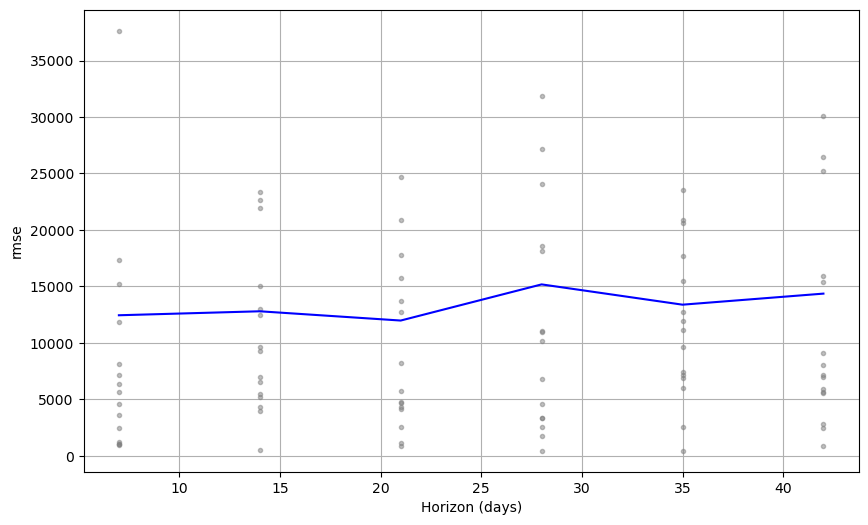

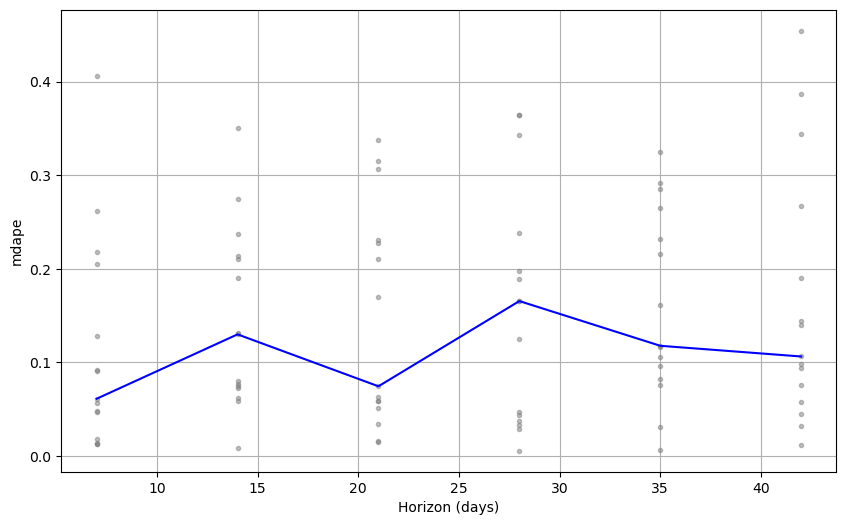

In [44]:
# To plot the RMSE from cross validation 
fig = plot_cross_validation_metric(df_cv_hol, metric='rmse')

# To plot the MDAPE from cross validation 
fig = plot_cross_validation_metric(df_cv_hol, metric='mdape')

## Re-run with refined hyperparameters

In [33]:
model_hols = Prophet(yearly_seasonality=True, weekly_seasonality=True, holidays=holidays_train,
                     changepoint_prior_scale= 0.5, seasonality_prior_scale= 0.1, holidays_prior_scale= 1)
model_hols.fit(prophet_train_weekly)

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Initial log joint probability = -4.89948


    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       236.735    0.00244212       13.8796           1           1      122   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     183       237.457    0.00072327       26.4924   5.576e-05       0.001      254  LS failed, Hessian reset 
     199       237.505   0.000472732       12.7558      0.7841      0.7841      270   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     261       237.675   0.000167127        14.357   1.779e-05       0.001      383  LS failed, Hessian reset 
     299        237.75    0.00227295       7.90355      0.5629           1      427   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     345       237.823   0.000336235       20.7567   4.102e-05       0.001      511  LS failed, Hessian reset 
     399       237.885   0.000176968  

In [34]:
# Need to provide a dataframe for the predict method, containing a `ds` column
forecast_hols = model_hols.predict(future_weekly)
forecast_hols[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()

,ds,yhat,yhat_lower,yhat_upper
1,2022-08-28,97008.201000,89314.781227,105382.344478
2,2022-09-04,90645.763162,82789.879063,97846.890919
3,2022-09-11,76442.060548,67918.501580,84059.576728
4,2022-09-18,72457.231115,64117.319084,80766.146027
5,2022-09-25,67303.139865,59402.965640,75620.508726


In [35]:
fig = plot_plotly(model_hols, forecast_hols) 
# plt.title('7 Day Forecast')
# plt.ylabel('Revenue (£)')
# plt.xlabel('Date')
fig.show()

In [37]:
fig = go.Figure()

# Add actual vs forecasted revenue 
fig.add_trace(go.Scatter(x=prophet_full_weekly['ds'], y=prophet_full_weekly['y'], mode='lines', name='Actual Revenue'))
fig.add_trace(go.Scatter(x=forecast_hols['ds'], y=forecast_hols['yhat'], mode='lines', name='Forecasted Revenue',
                         line={'dash': 'dash', 'color': 'red'}))

fig.update_xaxes(rangeslider_visible=True)
fig.update_layout(
    yaxis_title='Revenue (£)', 
    xaxis_title='Date',
    legend_title='',
    title='Model 4 - Tuned Hyperparameters with Special Days')

# fig.write_image('fbblank.png', scale=2)
fig.show()

In [38]:
bakery.full_accuracy_report(prophet_test_weekly['y'], forecast_hols['yhat'], 'weekly forecast')

The RMSE for the weekly forecast is: 14204.97

The MAE between the actual and weekly forecast revenue is 12871.17

The MAPE between the actual and weekly forecast revenue is 13.0%


# RMSE version

In [39]:
model_hols = Prophet(yearly_seasonality=True, weekly_seasonality=True, holidays=holidays_train,
                     changepoint_prior_scale= 0.5, seasonality_prior_scale= 0.1, holidays_prior_scale= 0.1)
model_hols.fit(prophet_train_weekly)

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


Initial log joint probability = -4.89948


    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
      99       236.249    0.00617947       29.6124           1           1      121   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     198       237.063   0.000209302       16.3629   5.756e-06       0.001      275  LS failed, Hessian reset 
     199        237.07    0.00086241       10.3417          10           1      277   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     299       237.298   1.46752e-05       7.37757      0.5311      0.5311      400   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     399       237.536    0.00102481        9.5669      0.7303      0.7303      518   
    Iter      log prob        ||dx||      ||grad||       alpha      alpha0  # evals  Notes 
     499       237.614   2.54335e-07        7.0874       0.669       0.669      6

In [40]:
# Need to provide a dataframe for the predict method, containing a `ds` column
forecast_hols = model_hols.predict(future_weekly)
forecast_hols[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()

,ds,yhat,yhat_lower,yhat_upper
1,2022-08-28,96747.849618,88546.616179,104868.891286
2,2022-09-04,90245.576003,82624.418008,98027.661752
3,2022-09-11,76423.079460,67763.589019,84547.391398
4,2022-09-18,72368.118250,64435.915190,79987.293528
5,2022-09-25,67156.502658,59596.614054,75170.100856


In [41]:
fig = plot_plotly(model_hols, forecast_hols) 
# plt.title('7 Day Forecast')
# plt.ylabel('Revenue (£)')
# plt.xlabel('Date')
fig.show()

In [42]:
fig = go.Figure()

# Add actual vs forecasted revenue 
fig.add_trace(go.Scatter(x=prophet_full_weekly['ds'], y=prophet_full_weekly['y'], mode='lines', name='Actual Revenue'))
fig.add_trace(go.Scatter(x=forecast_hols['ds'], y=forecast_hols['yhat'], mode='lines', name='Forecasted Revenue',
                         line={'dash': 'dash', 'color': 'red'}))

fig.update_xaxes(rangeslider_visible=True)
fig.update_layout(
    yaxis_title='Revenue (£)', 
    xaxis_title='Date',
    legend_title='',
    title='Model 5 - RMSE Tuned Special Dates')

# fig.write_image('fbblank.png', scale=2)
fig.show()

In [43]:
# To visulaise the forecast components 
fig2 = plot_components_plotly(model_hols, forecast_hols) 
fig2.show()

## Observations From Component Plots
The above plot provides interesting insights.

- The first plot shows that the daily revenue across the four bakeries has been linearly increasing over time.

- The second plot highlights the fact that the weekly revenue is at it's lowest on Tuesday and peaks the end of the eek and on the weekend.

- The third plot shows that the greatest revenue occurs during the holiday months of July and August. With additional peaks during April, October and June. These are most likely due to the school and bank holidays that generate more revenue than typical weeks. 

## Evaluating the Daily Forecast with Special Dates

In [44]:
bakery.full_accuracy_report(prophet_test_weekly['y'], forecast_hols['yhat'], 'weekly forecast')

The RMSE for the weekly forecast is: 14387.09

The MAE between the actual and weekly forecast revenue is 13040.66

The MAPE between the actual and weekly forecast revenue is 13.2%


## Determining the Best Daily Forecast
**UPDATE**

The performance_metrics utility can be used to compute some useful statistics of the prediction performance (yhat, yhat_lower, and yhat_upper compared to y), as a function of the distance from the cutoff (how far into the future the prediction was). The statistics computed are mean squared error (MSE), root mean squared error (RMSE), mean absolute error (MAE), mean absolute percent error (MAPE), median absolute percent error (MDAPE) and coverage of the yhat_lower and yhat_upper estimates. These are computed on a rolling window of the predictions in df_cv after sorting by horizon (ds minus cutoff). By default 10% of the predictions will be included in each window, but this can be changed with the rolling_window argument. **NOTES UPDATE**

**UPDATE** add_regressor

# Summary

# Next Steps

>[Return to Contents](#Contents)